
# Landslide Thickness Prediction

- [Config](#Config)
- [Read Data](#Read_Data)
    - [Read HMDB](#Read_hmdb)
    - [Read Spontane Rutschungen BE](#Read_BE)
    - [Read Storme](#Read_Storme)
- [Merging Data](#Merging_Data)
- [Data Exploration](#Data_Exploration)
    - [General Data Exploration](#Data_Exploration_general)
    - [Correlations](#Correlations)
- [Paper](#Paper)
    - [Model](#Paper_Model)
        - [Configuration](#Paper_Model_Configuration)
        - [Model Functions](#Model_Functions)
            - [General Functions](#General_Functions)
            - [Random Forests Functions](#Random_Forests_Functions)  
                - [Recursive Feature Elimination](#RFE_Functions)
                - [RF Variable Importance](#RF_Variable_Importance_Functions)
                - [Ranger Parameter Tuning](#Ranger_Parameter_Tuning)
            - [GAM Functions](#GAM_Functions)    
            - [Linear Regression functions](#Linear_Regression_Functions)        
        - [Variable Selection](#Paper_Model_Variable_Selection)
        - [Train/Test Dataset Setup](#Train_Test_Dataset_Setup)
        - [Sampling Point Tests](#Sampling_Point_Tests)
        - [Random Forest](#Paper_Model_Random_Forest)
        - [General Additive Model](#Paper_Model_GAM)
        - [Linear Model](#Paper_Model_LM)
        - [Simple Models](#Paper_Model_Simple_Models)
        - [Cumulative Distribution](#Cumulative_Distribution)
    - [Graphics](#Paper_Graphics)
        - [Result Summary](#Paper_Model_Result_Summary)
        - [Paper Plots](#Paper_Plots)

<a id="Config"></a>
# Config

In [1]:
R.Version()

$platform
[1] "x86_64-pc-linux-gnu"

$arch
[1] "x86_64"

$os
[1] "linux-gnu"

$system
[1] "x86_64, linux-gnu"

$status
[1] ""

$major
[1] "4"

$minor
[1] "1.2"

$year
[1] "2021"

$month
[1] "11"

$day
[1] "01"

$`svn rev`
[1] "81115"

$language
[1] "R"

$version.string
[1] "R version 4.1.2 (2021-11-01)"

$nickname
[1] "Bird Hippie"

In [2]:
R.home()

[1] "/usr/lib/R"

In [3]:
defaultW <- getOption("warn")
options(warn = -1)

# options(warn = defaultW)

In [4]:
library(dplyr)
library(ggplot2)
library(plotly)
library(ggpubr)
library(corrplot)
library(fastDummies)
library(Metrics)
library(kableExtra)
library(purrr)
library(measures)


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



Attaching package: ‘plotly’


The following object is masked from ‘package:ggplot2’:

    last_plot


The following object is masked from ‘package:stats’:

    filter


The following object is masked from ‘package:graphics’:

    layout


corrplot 0.92 loaded


Attaching package: ‘kableExtra’


The following object is masked from ‘package:dplyr’:

    group_rows




In [5]:
library(sf)
library(spdep)
library(gstat)

Linking to GEOS 3.10.2, GDAL 3.4.1, PROJ 8.2.1; sf_use_s2() is TRUE

Loading required package: spData

To access larger datasets in this package, install the spDataLarge
package with: `install.packages('spDataLarge',
repos='https://nowosad.github.io/drat/', type='source')`



<a id="Read_Data"></a>
# Read Data

<a id="Read_general"></a>
## Read General Data

Read general lookup data.

In [6]:
gk500_litho_path <-"./data/gk500_LITHO_mappings.csv"

gk500_litho.df <- read.csv(gk500_litho_path,sep=";",quot='"',stringsAsFactors = FALSE,fileEncoding="latin1", row.names=NULL)

In [7]:
ucd_litho_path <-"./data/gc_unconsolidated_deposits_LITHO_mappings.csv"

ucd_litho.df <- read.csv(ucd_litho_path,sep=";",quot='"',stringsAsFactors = FALSE,fileEncoding="UTF-8", row.names=NULL)

In [8]:
municipality_path <- "./data/swissboundaries_2013/swissBOUNDARIES3D_1_1_TLM_HOHEITSGEBIET.shp"

municipalities <- st_read(municipality_path)

Reading layer `swissBOUNDARIES3D_1_1_TLM_HOHEITSGEBIET' from data source 
  `/home/jupyter-slc4/Paper_2/data/swissboundaries_2013/swissBOUNDARIES3D_1_1_TLM_HOHEITSGEBIET.shp' 
  using driver `ESRI Shapefile'
Simple feature collection with 2564 features and 23 fields
Geometry type: POLYGON
Dimension:     XYZ
Bounding box:  xmin: 2485410 ymin: 1075270 xmax: 2833842 ymax: 1295934
z_range:       zmin: 0 zmax: 4605.63
Projected CRS: CH1903+ / LV95


<a id="Read_hmdb"></a>
## Read HMDB

Read data for the HMDB dataset.

In [9]:
slide_path <-"./data/hangmuren-export-2023-04-10-10-06_modified_20240223.csv"

hm.df <- read.csv(slide_path,sep=",",quot='"',stringsAsFactors = FALSE,fileEncoding="latin1", row.names=NULL)
#Clean column names
c_names <- colnames(hm.df)
c_names <- c_names[-301] # "geometry"
c_names <- c_names[-1] # "row.names"
#remove geom columns
hm.df <- dplyr::select(hm.df,1:299,302:(ncol(hm.df)))
colnames(hm.df) <- c_names


In [10]:
slide_out_path <-"./data/hangmuren-export-2023-04-10-10-06_modified_cleaned_20240223.csv"
write.csv(hm.df,slide_out_path, row.names = FALSE)


In [11]:
hm.df$Source <- "hmdb"
hm.df$Data_provider <- "WSL"

In [12]:
summary(hm.df$mittlere_Maechtigkeit)
data.frame(table(hm.df$mittlere_Maechtigkeit_MAO))


   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
 0.2000  0.5000  0.6000  0.6945  0.8000  2.7000     485 

Var1,Freq
<fct>,<int>
,330
A,200
M,230


In [13]:
hm.df$Landslide_thickness <- hm.df$mittlere_Maechtigkeit
hm.df$Landslide_thickness_vert <- hm.df$Anriss.Maechtigkeit
hm.df$Landslide_thickness_vert[is.na(hm.df$Landslide_thickness_vert)] <- hm.df$mittlere_Maechtigkeit/cos((hm.df$Neigung_oberhalb * pi) / (180))


hm.df$Landslide_thickness_perp <- hm.df$mittlere_Maechtigkeit
hm.df$Landslide_thickness_perp[is.na(hm.df$Landslide_thickness_perp)] <- hm.df$Volumen/hm.df$Anrissflaeche

hm.df$Deposit_height <- hm.df$`maximale_Maechtigkeit.1`

hm.df$Failure_volume <- hm.df$Volumen
hm.df$Failure_area <- hm.df$Anrissflaeche

hm.df$Landslide_thickness <- hm.df$Landslide_thickness_perp
hm.df$Landslide_thickness_MAO <- apply(hm.df[,c("mittlere_Maechtigkeit_MAO","mittlere_Maechtigkeit")],1,function(x){if(!is.na(x[2])&(x[1]=="M")) return("Measured") else return("Estimated")} ) 

In [14]:
print(paste0("Records with thickness overall: ", nrow(hm.df[!is.na(hm.df$Landslide_thickness), ])))
print(paste0("Records with thickness overall <2.5m:  ", nrow(hm.df[!is.na(hm.df$Landslide_thickness)&hm.df$Landslide_thickness<=2.5, ])))

print(paste0("Records with thickness recorded in database: ", nrow(hm.df[!is.na(hm.df$mittlere_Maechtigkeit), ])))
print(paste0("Records with measured thickness recorded in database: ", nrow(hm.df[!is.na(hm.df$mittlere_Maechtigkeit) & hm.df$mittlere_Maechtigkeit_MAO =="M" & hm.df$mittlere_Maechtigkeit<=2.5, ])))
print(paste0("Records with estimated thickness recorded in database: ", nrow(hm.df[!is.na(hm.df$mittlere_Maechtigkeit) & !hm.df$mittlere_Maechtigkeit_MAO =="M" & hm.df$mittlere_Maechtigkeit<=2.5, ])))

print(paste0("Records with volume estimated thickness: ", nrow(hm.df[is.na(hm.df$mittlere_Maechtigkeit) & !is.na(hm.df$Landslide_thickness) & !hm.df$Landslide_thickness_MAO =="Measured" & hm.df$Landslide_thickness<=2.5, ])))

print(paste0("Records with estimated thickness overall: ", nrow(hm.df[!is.na(hm.df$Landslide_thickness) & !hm.df$Landslide_thickness_MAO =="Measured" & hm.df$Landslide_thickness<=2.5, ])))


[1] "Records with thickness overall: 711"
[1] "Records with thickness overall <2.5m:  709"
[1] "Records with thickness recorded in database: 275"
[1] "Records with measured thickness recorded in database: 75"
[1] "Records with estimated thickness recorded in database: 199"
[1] "Records with volume estimated thickness: 435"
[1] "Records with estimated thickness overall: 634"


In [15]:
summary(hm.df$Landslide_thickness)
nrow(hm.df[!is.na(hm.df$Landslide_thickness),])
nrow(hm.df[!is.na(hm.df$Landslide_thickness)&hm.df$Landslide_thickness>2.5,])

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
 0.1500  0.4949  0.6000  0.6735  0.8000  2.7000      49 

[1] 711

[1] 2

In [16]:
#Exclude cases with thickness >2.5m
hm.df <- hm.df[!is.na(hm.df$Landslide_thickness)&hm.df$Landslide_thickness<=2.5,]

In [17]:
nrow(hm.df)

[1] 709

In [18]:
data.frame(table(hm.df$Landslide_thickness_MAO))

Var1,Freq
<fct>,<int>
Estimated,634
Measured,75


In [19]:
print(paste(colnames(hm.df), collapse = "', '"))

[1] "X.U.FEFF.Ereignis.Nr', 'Y.Koordinate_MAO', 'Genauigkeit_GPS', 'Lokalname', 'Gemeinde', 'Hoehe_MAO', 'Hoehe', 'Exposition_MAO', 'Exposition', 'Laenge__maximal_MAO', 'Laenge__maximal', 'Breite__maximal_MAO', 'Breite__maximal', 'Anrissflaeche_MAO', 'Anrissflaeche', 'maximale_Maechtigkeit_MAO', 'maximale_Maechtigkeit', 'mittlere_Maechtigkeit_MAO', 'mittlere_Maechtigkeit', 'Anriss.Maechtigkeit_MAO', 'Anriss.Maechtigkeit', 'Volumen_MAO', 'Volumen', 'Neigung_MAO', 'Neigung', 'Neigung_oberhalb_MAO', 'Neigung_oberhalb', 'Neigung_unterhalb_MAO', 'Neigung_unterhalb', 'maximale_Maechtigkeit_MAO.1', 'maximale_Maechtigkeit.1', 'mittlere_Maechtigkeit_MAO.1', 'mittlere_Maechtigkeit.1', 'Ablagerungsflaeche_MAO', 'Ablagerungsflaeche', 'Datum_MAO', 'Datum', 'Anrisszeitpunkt_first_move_MAO', 'Anrisszeitpunkt_first_move', 'Dauer_MAO', 'Dauer', 'Dateien', 'Lage_Geologie_Tektonik', 'Bemerkungen_2_1_Geologie', 'Morphologietyp', 'Anzeichen_alter_Rutschbewegungen', 'Auspraegung', 'Beschreibung', 'rezent', 

In [20]:
# Exclude unneeded columns
hm.df <- dplyr::select(hm.df,1:41,254,284:285, 300:(ncol(hm.df)))

In [21]:
hm_points_path <- "./data/hmdb_sampled_slope_unrestricted_proportional_modified_20231220.csv"
hm.purp.df <- read.csv(hm_points_path,sep=",",quot='"',stringsAsFactors = FALSE,fileEncoding="latin1", row.names=NULL)

#Clean column names
c_names <- colnames(hm.purp.df)
c_names <- c_names[-20] # "geometry"
c_names <- c_names[-1] # "row.names"

hm.purp.df <- dplyr::select(hm.purp.df,1:18,21:(ncol(hm.purp.df)))
colnames(hm.purp.df) <- c_names

<a id="Read_BE"></a>
## Read Spontane Rutschungen BE

Read data for the KtBE dataset.

In [22]:
spontrutschbe_path <- "./data/SpontRutschBE_20231017.csv"
spontrutschbe.df <- read.csv(spontrutschbe_path,sep=",",quot='"',stringsAsFactors = FALSE,fileEncoding="latin1", row.names=NULL)

#Clean column names
c_names <- colnames(spontrutschbe.df)
c_names <- c_names[-57] # "geometry"
c_names <- c_names[-1] # "row.names"
#remove geom columns
spontrutschbe.df <- dplyr::select(spontrutschbe.df,1:55,58:(ncol(spontrutschbe.df)))
colnames(spontrutschbe.df) <- c_names


In [23]:
#Correcting a wrong date value
spontrutschbe.df[!is.na(spontrutschbe.df$Datum)&spontrutschbe.df$Datum=="14.07.2038",]$Datum <- "28.07.2014"

#Deriving english date format 
spontrutschbe.df$Date <- lapply(spontrutschbe.df$Datum,function(x){if(!is.na(x) & x!=""){paste(substr(x,7,13),substr(x,4,5),substr(x,1,2),sep = "-")}})

In [24]:
spontrutschbe.df$Source <- "KtBE"
spontrutschbe.df$Data_provider <- "KtBE"
spontrutschbe.df$Local_name <- "BE"
spontrutschbe.df$Slide_width <- NA


spontrutschbe.df$Landslide_thickness <- spontrutschbe.df$Maechtigkeit_m_
spontrutschbe.df$Landslide_thickness_vert <- spontrutschbe.df$Maechtigkeit_m_/cos((spontrutschbe.df$mittlere_Neigung_Anrissflaeche * pi) / (180))

spontrutschbe.df$Landslide_thickness_MAO <- "Estimated"

spontrutschbe.df$Landslide_thickness_perp <- spontrutschbe.df$Maechtigkeit_m_

spontrutschbe.df$Deposit_height <- NA

spontrutschbe.df$Failure_volume <- spontrutschbe.df$Volumen_m3_
spontrutschbe.df$Failure_area <- spontrutschbe.df$Flaeche_Anriss_m2_ 

spontrutschbe.df$Rainfall_sum <- NA

In [25]:
summary(spontrutschbe.df$Landslide_thickness)
nrow(spontrutschbe.df[!is.na(spontrutschbe.df$Landslide_thickness),])
nrow(spontrutschbe.df[!is.na(spontrutschbe.df$Landslide_thickness)&spontrutschbe.df$Landslide_thickness>2.5,])

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
 0.2000  0.4000  0.5000  0.6591  0.8000  3.0000       1 

[1] 518

[1] 1

In [26]:
spontrutschbe.df <- spontrutschbe.df[!is.na(spontrutschbe.df$Landslide_thickness)&spontrutschbe.df$Landslide_thickness<=2.5,]

In [27]:
colnames(spontrutschbe.df)

[1] "ID"                                                     
  [2] "rid"                                                    
  [3] "source_id"                                              
  [4] "source_label.x"                                         
  [5] "x"                                                      
  [6] "y"                                                      
  [7] "Z_Min"                                                  
  [8] "Z_Max"                                                  
  [9] "NeigLine"                                               
 [10] "SHAPE_Leng"                                             
 [11] "ori_id"                                                 
 [12] "source_label.y"                                         
 [13] "Maechtigkeit_m_"                                        
 [14] "Volumen_m3_"                                            
 [15] "Umriss_m_"                                              
 [16] "Flaeche_Anriss_m2_"                                     
 [17] "Jahr"                                                   
 [18] "Datum"                                                  
 [19] "mittlere_Neigung_Anrissflaeche"                         
 [20] "maximale_Neigung_Anrissflaeche"                         
 [21] "mittlere_Neigung_Auslaufflaeche"                        
 [22] "minimale_Neigung_Auslaufflaeche"                        
 [23] "mittlere_Neigung_Anrisslinie"                           
 [24] "mittlere_Neigung_Auslauflinie"                          
 [25] "Pauschalgefaelle_"                                      
 [26] "Pauschalgefaelle_.1"                                    
 [27] "schraege_Laenge_Anriss_m_"                              
 [28] "schraege_Laenge_Auslauf_m_"                             
 [29] "Flaeche_Transit_und_Auslauf_m2_"                        
 [30] "maximale_Flowaccumulation_im_Anrissgebiet_m2_"          
 [31] "mittlere_Flowaccumulation_im_Anrissgebiet_m2_"          
 [32] "aufsummierte_Flowaccumulation_im_Anrissgebiet_m2_"      
 [33] "maximale_Flowaccumulation_im_Auslaufgebiet_m2_"         
 [34] "mittlere_Flowaccumulation_im_Auslaufgebiet_m2_"         
 [35] "aufsummierte_Flowaccumulation_im_Auslaufgebiet_m2_"     
 [36] "Anteil_Anrissgebiet_innerhalb_Oberflaechenabflusskarte" 
 [37] "Anteil_Auslaufgebiet_innerhalb_Oberflaechenabflusskarte"
 [38] "flaechiger_Mobilitaetsindex_"                           
 [39] "linearer_Mobilitaetsindex_"                             
 [40] "X.Koordinate"                                           
 [41] "Y.Koordinate"                                           
 [42] "OBJECTID"                                               
 [43] "EZGNR"                                                  
 [44] "TEILEZGNR"                                              
 [45] "H1"                                                     
 [46] "H2"                                                     
 [47] "Nebenarm"                                               
 [48] "InterneSenke"                                           
 [49] "Gewaessername"                                          
 [50] "TEZGNR40"                                               
 [51] "TEZGNR150"                                              
 [52] "TEZGNR1000"                                             
 [53] "Gebietsauslass"                                         
 [54] "SEE"                                                    
 [55] "FLUSSGB"                                                
 [56] "h_5"                                                    
 [57] "h_10"                                                   
 [58] "h_25"                                                   
 [59] "h_filled_5"                                             
 [60] "h_filled_10"                                            
 [61] "h_filled_25"                                            
 [62] "catchment_area_5"                                       
 [63] "catchment_area_10"         

In [28]:
be_points_path <- "./data/be_sampled_slope_unrestricted_proportional_modified_20231220.csv"
be.purp.df <- read.csv(be_points_path,sep=",",quot='"',stringsAsFactors = FALSE,fileEncoding="latin1", row.names=NULL)

#Clean column names
c_names <- colnames(be.purp.df)
c_names <- c_names[-20] # "geometry"
c_names <- c_names[-1] # "row.names"

be.purp.df <- dplyr::select(be.purp.df,1:18,21:(ncol(be.purp.df)))
colnames(be.purp.df) <- c_names

<a id="Read_Storme"></a>
## Read Storme

Read data for the StorMe dataset.

In [29]:
storme_path <- "./data/storme_interlis_merged_selection_modified_redux3_20231017.csv"
storme.df <- read.csv(storme_path,sep=",",quot='"',stringsAsFactors = FALSE,fileEncoding="latin1", row.names=NULL)
nrow(storme.df)

x.koord <- as.numeric(substr(storme.df[,119],3,30))
y.koord <- as.numeric(sub(")","",substr(storme.df[,120],2,30)))

#Clean column names
c_names <- colnames(storme.df)
c_names <- c_names[-120] # "geometry"
c_names <- c_names[-1] # "row.names"
#remove geom columns
storme.df <- dplyr::select(storme.df,1:118,121:(ncol(storme.df)))
colnames(storme.df) <- c_names
storme.df[,"X.Koordinate"] <- x.koord
storme.df[,"Y.Koordinate"] <- y.koord


[1] 8011

In [30]:
data.frame(table(storme.df$bi_BI_DATENHERR))
unique(storme.df$bi_BI_DATENHERR)

Var1,Freq
<fct>,<int>
AR,98
BE,4279
FL,5
FR,40
GL,15
GR,1243
LU,401
NW,435
OW,715


[1] "SZ"  "GR"  "FR"  "BE"  "NW"  "GL"  "SO"  "LU"  "OW"  "FL"  "ZG"  "SOB"
[13] "UR"  "SBB" "AR"  "TG"

In [31]:
storme_out_path <- "./data/storme_interlis_merged_selection_modified_redux_cleaned_20231017.csv"

write.csv(storme.df,storme_out_path, row.names = FALSE)

In [32]:
storme.df$Source <- "storme_merged"

In [33]:
colnames(storme.df)

[1] "TID"                                     
  [2] "PR_ID"                                   
  [3] "PR_BI_ID"                                
  [4] "PR_EVIDENZ"                              
  [5] "BI"                                      
  [6] "DI"                                      
  [7] "PR_R_PROZESS"                            
  [8] "PR_ERHEBUNGSART"                         
  [9] "PR_KARTIERUNG_DATUM"                     
 [10] "di_r_fid"                                
 [11] "di_r_TID"                                
 [12] "di_r_DI_ID"                              
 [13] "di_r_DI_BI_ID"                           
 [14] "di_r_BI"                                 
 [15] "di_r_DI_R_BEWEGTE_KUBATUR"               
 [16] "di_r_DI_R_BEWEGTE_KUBATUR_MAO"           
 [17] "di_r_DI_R_ABLAG_HOEHE"                   
 [18] "di_r_DI_R_ABLAG_HOEHE_MAO"               
 [19] "di_r_DI_R_AUSLOESUNG_WASSER"             
 [20] "di_r_DI_R_AUSLOESUNG_G_EROSION"          
 [21] "di_r_DI_R_AUSLOESUNG_KUENSTLICH"         
 [22] "di_r_DI_R_AUSLOESUNG_ANDERE"             
 [23] "di_r_DI_R_AUSLOESUNG_MAO"                
 [24] "di_r_DI_R_HANGNEIGUNG"                   
 [25] "di_r_DI_R_HANGNEIGUNG_MAO"               
 [26] "di_r_DI_R_ANRISS_BREITE"                 
 [27] "di_r_DI_R_ANRISS_BREITE_MAO"             
 [28] "di_r_DI_R_ANRISS_HOEHE"                  
 [29] "di_r_DI_R_ANRISS_HOEHE_MAO"              
 [30] "di_r_DI_R_MATERIAL"                      
 [31] "di_r_DI_R_MATERIAL_MAO"                  
 [32] "di_r_DI_R_GLEITFLA"                      
 [33] "di_r_DI_R_GLEITFLA_MAO"                  
 [34] "di_r_DI_R_GLEITFLA_TIEFE"                
 [35] "di_r_DI_R_GLEITFLA_TIEFE_MAO"            
 [36] "di_r_DI_R_EREIGNIS_MEMO"                 
 [37] "bi_fid"                                  
 [38] "bi_TID"                                  
 [39] "bi_BI_SE_ID"                             
 [40] "bi_BI_DATENHERR"                         
 [41] "bi_BI_STORME_NR.x"                       
 [42] "bi_BI_HP_WASSER"                         
 [43] "bi_BI_HP_RUTSCHUNG"                      
 [44] "bi_BI_HP_STURZ"                          
 [45] "bi_BI_HP_LAWINE"                         
 [46] "bi_BI_HP_EINSTURZ_ABSENKUNG"             
 [47] "bi_BI_HP_ANDERE"                         
 [48] "bi_BI_MASSGEBENDER_PROZESS"              
 [49] "bi_BI_DATUM"                             
 [50] "bi_BI_DATUM_GENAUIGKEIT"                 
 [51] "bi_BI_DAUER_TAG"                         
 [52] "bi_BI_DAUER_STD"                         
 [53] "bi_BI_DAUER_MIN"                         
 [54] "bi_BI_DAUER_MAO"                         
 [55] "bi_BI_ERHEBUNGSART"                      
 [56] "bi_BI_GLETSCHER"                         
 [57] "bi_BI_NAME_LOKALITAET"                   
 [58] "bi_BI_GEWAESSERNAME"                     
 [59] "bi_BI_GLETSCHERNAME"                     
 [60] "bi_BI_GEMEINDE"                          
 [61] "bi_BI_BEMERKUNGEN"                       
 [62] "bi_BI_STATUS"                            
 [63] "bi_SE"                                   
 [64] "bi_BI_ME_ID"                             
 [65] "bi_BI_ERFASSUNG_DATUM"                   
 [66] "bi_BI_ERFASSUNG_NACHNAME"                
 [67] "bi_BI_ERFASSUNG_VORNAME"                 
 [68] "bi_BI_ERFASSUNG_STELLE"                  
 [69] "bi_BI_MEMO"                              
 [70] "bi_BI_QUELLEN"                           
 [71] "bi_ME"                                   
 [72] "me_fid"                                  
 [73] "me_TID"                                  
 [74] "me_ME_WITTERUNG_DAUERREGEN"              
 [75] "me_ME_WITTERUNG_GEWITTER"                
 [76] "me_ME_WITTERUNG_HAGEL"                   
 [77] "me_ME_WITTERUNG_SCHNEEFALL"              
 [78] "me_ME_WITTERUNG_TEMPANSTIEG"             
 [79] "me_ME_WITTERUNG_TRIEBSCHNEE"             
 [80] "me_ME_WITTERUNG_SCHNEEFEUCHT"            
 [81] "me_ME_WITTERUNG_SCHNEESCHMELZE"          
 [82] "me_ME_WITTERUNG_FROST"    

In [34]:
unique(storme.df$di_r_DI_R_ANRISS_HOEHE_MAO)
sum(is.na(storme.df$di_r_DI_R_ANRISS_HOEHE_MAO) )
as.data.frame(table(storme.df$di_r_DI_R_ANRISS_HOEHE_MAO))

[1] "Annahme_Schaetzung"    "Messwert_Feststellung" NA

[1] 1

Var1,Freq
<fct>,<int>
Annahme_Schaetzung,3831
Messwert_Feststellung,4179


In [35]:
unique(storme.df$di_r_DI_R_GLEITFLA_TIEFE)
sum(is.na(storme.df$di_r_DI_R_GLEITFLA_TIEFE) )
as.data.frame(table(storme.df$di_r_DI_R_GLEITFLA_TIEFE))

[1] NA               "flachgruendig"  "mittelgruendig" ""              
[5] "tiefgruendig"

[1] 727

Var1,Freq
<fct>,<int>
,652
flachgruendig,5733
mittelgruendig,849
tiefgruendig,50


In [36]:
storme.df$Landslide_thickness <- storme.df$di_r_DI_R_ANRISS_HOEHE
storme.df$Landslide_thickness_vert <- storme.df$di_r_DI_R_ANRISS_HOEHE/cos((storme.df$di_r_DI_R_HANGNEIGUNG * pi) / (180))

storme.df$Landslide_thickness_perp <- storme.df$di_r_DI_R_ANRISS_HOEHE

storme.df$Landslide_thickness_MAO <- sapply(storme.df$di_r_DI_R_ANRISS_HOEHE_MAO, function(x){if(!is.na(x)&(x=="Messwert_Feststellung")) return("Measured") else return("Estimated")})
                                                                                                                                                                               
storme.df$Deposit_height <- storme.df$di_r_DI_R_ABLAG_HOEHE

storme.df$Failure_volume <- storme.df$di_r_DI_R_BEWEGTE_KUBATUR
storme.df$Failure_area <- storme.df$Failure_volume/storme.df$Landslide_thickness 


In [37]:
filter <- ( (!is.na(storme.df$di_r_DI_R_GLEITFLA_TIEFE)&storme.df$di_r_DI_R_GLEITFLA_TIEFE=="flachgruendig") 
           & (!is.na(storme.df$di_r_DI_R_ANRISS_HOEHE_MAO)&storme.df$di_r_DI_R_ANRISS_HOEHE_MAO=="Messwert_Feststellung") 
           & (!is.na(storme.df$di_r_DI_R_ANRISS_HOEHE)&storme.df$di_r_DI_R_ANRISS_HOEHE<=2.5&storme.df$di_r_DI_R_ANRISS_HOEHE>0)
           # & (!is.na(storme.df$di_r_DI_R_BEWEGTE_KUBATUR)&storme.df$di_r_DI_R_BEWEGTE_KUBATUR<6000)
          )
nrow(storme.df[filter,])

storme.df.filtered <- storme.df[filter,]

unique(storme.df.filtered$bi_BI_DATENHERR)
sum(is.na(storme.df.filtered$bi_BI_DATENHERR) )
as.data.frame(table(storme.df.filtered$bi_BI_DATENHERR))

summary(storme.df.filtered$di_r_DI_R_BEWEGTE_KUBATUR)

summary(storme.df.filtered$di_r_DI_R_ANRISS_HOEHE)
nrow(storme.df.filtered[!is.na(storme.df.filtered$di_r_DI_R_ANRISS_HOEHE),])


summary(storme.df.filtered$di_r_DI_R_ANRISS_BREITE)
nrow(storme.df.filtered[!is.na(storme.df.filtered$di_r_DI_R_ANRISS_BREITE),])



[1] 2988

[1] "SZ"  "GR"  "NW"  "BE"  "LU"  "OW"  "SO"  "ZG"  "FR"  "UR"  "AR"  "SBB"

[1] 0

Var1,Freq
<fct>,<int>
AR,12
BE,1965
FR,13
GR,427
LU,96
NW,53
OW,231
SBB,1
SO,28


    Min.  1st Qu.   Median     Mean  3rd Qu.     Max.     NA's 
     1.0     50.0    120.0    598.5    310.0 100000.0      251 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  0.100   0.500   1.000   1.037   1.500   2.500 

[1] 2988

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
   1.00   10.00   15.00   19.78   20.00  840.00     131 

[1] 2857

In [38]:
storme_points_path <- "./data/storme_sampled_slope_unrestricted_proportional_modified_20231220.csv"
storme.purp.df <- read.csv(storme_points_path,sep=",",quot='"',stringsAsFactors = FALSE,fileEncoding="latin1", row.names=NULL)

#Clean column names
c_names <- colnames(storme.purp.df)
c_names <- c_names[-20] # "geometry"
c_names <- c_names[-1] # "row.names"

storme.purp.df <- dplyr::select(storme.purp.df,1:18,21:(ncol(storme.purp.df)))
colnames(storme.purp.df) <- c_names

<a id="Merging_Data"></a>
# Merging Data

Merging the datasets to a single dataset for analysis purposes.

In [39]:
cols_hmdb <- c("Source","Data_provider","X.U.FEFF.Ereignis.Nr","Lokalname","Breite__maximal","Landslide_thickness","Landslide_thickness_MAO","Landslide_thickness_vert","Landslide_thickness_perp","Deposit_height","Anriss.Maechtigkeit","Neigung_oberhalb","Datum","Niederschlagssumme","Failure_volume","Failure_area","X.Koordinate","Y.Koordinate")
cols_storme <- c("Source","bi_BI_DATENHERR","bi_BI_STORME_NR.x","bi_BI_NAME_LOKALITAET","di_r_DI_R_ANRISS_BREITE","Landslide_thickness","Landslide_thickness_MAO","Landslide_thickness_vert","Landslide_thickness_perp","Deposit_height","di_r_DI_R_ANRISS_HOEHE","di_r_DI_R_HANGNEIGUNG","bi_BI_DATUM","me_ME_NS_SUMME","Failure_volume","Failure_area","X.Koordinate","Y.Koordinate")

cols_be <- c("Source","Data_provider","ID","Local_name","Slide_width","Landslide_thickness","Landslide_thickness_MAO","Landslide_thickness_vert","Landslide_thickness_perp","Deposit_height","Maechtigkeit_m_","mittlere_Neigung_Anrissflaeche","Date","Rainfall_sum","Volumen_m3_","Flaeche_Anriss_m2_","x","y")
cols_harmonized <- c("Source","Data_provider","OrigID","Local_name","Slide_width","Landslide_thickness","Landslide_thickness_MAO","Landslide_thickness_vert","Landslide_thickness_perp","Deposit_height","Landslide_thickness_ori","Slope_DB","Date","Rainfall_sum","Failure_volume","Failure_area","X","Y")

cols_geomorph <- c('h_5', 'h_10', 'h_25', 'twi_ori_5', 'h_filled_5', 'h_filled_10', 'h_filled_25', 
                    'catchment_area_5', 'catchment_area_10', 'catchment_area_25', 'catchment_slope_5', 'catchment_slope_10', 'catchment_slope_25', 
                    'modified_catchement_area_5', 'modified_catchement_area_10', 'modified_catchement_area_25', 
                    'twi_5', 'twi_10', 'twi_25', 'twi_ori_10', 'twi_ori_25', 'slope_5', 'slope_10', 'slope_25', 
                    'aspect_5', 'aspect_10', 'aspect_25', 'curvature_5', 'curvature_10', 'curvature_25', 'curvature_profile_5', 'curvature_profile_10', 
                    'curvature_profile_25', 'curvature_planar_5', 'curvature_planar_10', 'curvature_planar_25', 'openness_pos_20_5', 'openness_neg_20_5', 
                    'openness_pos_50_5', 'openness_neg_50_5', 'openness_pos_200_5', 'openness_neg_200_5', 'flow_accumulation_5', 'flow_accumulation_10', 
                    'flow_accumulation_25', 'elevation_percentile_50_5', 'elevation_percentile_200_5', 'tpi_15m_5', 'tpi_50m_10', 
                    'tpi_200m_10', 'tpi_500m_25', 'tpi_1km_25', 'tpi_2km_25', 'tpi_4km_25', 'mrvbf_5', 'mrvbf_10', 'mrvbf_25', 'mrrtf_5', 'mrrtf_10', 
                    'mrrtf_25', 'convergence_index_5', 'convergence_index_10', 'convergence_index_25', 'curv_upslope_5', 'curv_upslope_10', 
                    'curv_upslope_25', 'curv_downslope_5', 'curv_downslope_10', 'curv_downslope_25', 'mpi_r30_5', 'mpi_r30_10', 'mpi_r30_25', 
                    'vrm_r5_5', 'vrm_r5_10', 'vrm_r5_25', 'tri_r5_5', 'tri_r5_10', 'tri_r5_25', 'slope_height_5', 'slope_height_10', 'slope_height_25', 
                    'valley_depth_5', 'valley_depth_10', 'valley_depth_25', 'normalized_height_5', 'normalized_height_10', 'normalized_height_25', 
                    'standardized_height_5', 'standardized_height_10', 'standardized_height_25', 'mid_slope_pos_5', 'mid_slope_pos_10', 'mid_slope_pos_25',
                    'aspect_nness_5', 'aspect_nness_10', 'aspect_nness_25', 'aspect_eness_5', 'aspect_eness_10', 'aspect_eness_25', 'toposcale_5', 
                    'gc_5', 'geomorphon_50_5', 'geomorphon_200_5', 'susceptibility_unconsolidated_deposits_5', 'id_unconsolidated_deposits_5', 
                    'susceptibility_gk500_5', 'id_gk500_5', 'vhm_max_5', 'vhm_q3_5', 'vhm_max_10', 'vhm_q3_10', 'vhm_max_25', 'vhm_q3_25',
                    'prcp_60m_2a', 'prcp_60m_10a', 'prcp_60m_30a', 'prcp_60m_50a', 'prcp_60m_100a', 'prcp_60m_200a', 'prcp_60m_300a', 'prcp_24h_2a', 'prcp_24h_10a', 'prcp_24h_30a', 'prcp_24h_50a', 'prcp_24h_100a', 'prcp_24h_200a', 'prcp_24h_300a',
'prcp_60m_2a_0025', 'prcp_60m_10a_0025', 'prcp_60m_30a_0025', 'prcp_60m_50a_0025', 'prcp_60m_100a_0025', 'prcp_60m_200a_0025', 'prcp_60m_300a_0025', 'prcp_24h_2a_0025', 'prcp_24h_10a_0025', 'prcp_24h_30a_0025', 'prcp_24h_50a_0025', 'prcp_24h_100a_0025', 'prcp_24h_200a_0025', 'prcp_24h_300a_0025',
'prcp_60m_2a_0975', 'prcp_60m_10a_0975', 'prcp_60m_30a_0975', 'prcp_60m_50a_0975', 'prcp_60m_100a_0975', 'prcp_60m_200a_0975', 'prcp_60m_300a_0975', 'prcp_24h_2a_0975', 'prcp_24h_10a_0975', 'prcp_24h_30a_0975', 'prcp_24h_50a_0975', 'prcp_24h_100a_0975', 'prcp_24h_200a_0975', 'prcp_24h_300a_0975',
                   'soil_CECpot_depth_0_30', 'soil_CECpot_depth_0_30_err', 'soil_CECpot_depth_30_60', 'soil_CECpot_depth_30_60_err', 'soil_CECpot_depth_60_120', 'soil_CECpot_depth_60_120_err',
                   'soil_clay_depth_0_30', 'soil_clay_depth_0_30_err', 'soil_clay_depth_30_60', 'soil_clay_depth_30_60_err', 'soil_clay_depth_60_120', 'soil_clay_depth_60_120_err',
                   'soil_pH_depth_0_30', 'soil_pH_depth_0_30_err', 'soil_pH_depth_30_60', 'soil_pH_depth_30_60_err', 'soil_pH_depth_60_120', 'soil_pH_depth_60_120_err',
                   'soil_sand_depth_0_30', 'soil_sand_depth_0_30_err', 'soil_sand_depth_30_60', 'soil_sand_depth_30_60_err', 'soil_sand_depth_60_120', 'soil_sand_depth_60_120_err',
                   'soil_silt_depth_0_30', 'soil_silt_depth_0_30_err', 'soil_silt_depth_30_60', 'soil_silt_depth_30_60_err', 'soil_silt_depth_60_120', 'soil_silt_depth_60_120_err',
                   'soil_soc_depth_0_30', 'soil_soc_depth_0_30_err', 'soil_soc_depth_30_60', 'soil_soc_depth_30_60_err', 'soil_soc_depth_60_120', 'soil_soc_depth_60_120_err',
                  'dist2river_25', 'dist2lake_25','rockdensity_litho', 'rockdensity_litho_id', 'rhob_m', 'rhob_med', 'rhob_p05', 'rhob_p25', 'rhob_p75', 'rhob_p95')

In [40]:
hm.selection.df<- hm.df[,append(cols_hmdb,cols_geomorph)]

colnames(hm.selection.df) <- append(cols_harmonized,cols_geomorph)

In [41]:
# for (c in append(cols_be,cols_geomorph)){if(!c %in% colnames(spontrutschbe.df)){print(c)}}
be.selection.df <- spontrutschbe.df[,append(cols_be,cols_geomorph)]
colnames(be.selection.df) <- append(cols_harmonized,cols_geomorph)

In [42]:
storme.selection.df <- storme.df.filtered[,append(cols_storme,cols_geomorph)]
colnames(storme.selection.df) <- append(cols_harmonized,cols_geomorph)

In [43]:
merged.df <- rbind(hm.selection.df,storme.selection.df)
merged.df <- rbind(merged.df,be.selection.df)


In [44]:
# Set default values for points with 0 thickness generated in rock signature
setSamplePointColums <- function(df,source,id_prefix) {
    df[,"Source"] <- source
    df[,"Data_provider"] <- "BFH"
    df[,"Local_name"] <- df$gemeinde
    df[,"OrigID"] <- paste0(id_prefix,1:nrow(df))
    df[,"Slide_width"] <- 0
    df[,"Landslide_thickness"] <- 0
    df[,"Landslide_thickness_MAO"] <- "Estimated"
    df[,"Landslide_thickness_vert"] <- 0
    df[,"Landslide_thickness_perp"] <- 0
    df[,"Deposit_height"] <- 0
    df[,"Landslide_thickness_ori"] <- 0
    df[,"Slope_DB"] <- NA
    df[,"Date"] <- '2023-10-17'
    df[,"Rainfall_sum"] <- NA
    df[,"Failure_volume"] <- 0
    df[,"Failure_area"] <- 0
    df[,"X"] <- df$X.Koordinate
    df[,"Y"] <- df$Y.Koordinate
    
    return(df)
}


hm.purp.df <- setSamplePointColums(hm.purp.df,"hmdb_urp","BFH-HMDB-URP-2023-")
storme.purp.df <- setSamplePointColums(storme.purp.df,"storme_urp","BFH-STORME-URP-2023-")
be.purp.df <- setSamplePointColums(be.purp.df,"be_urp","BFH-BE-URP-2023-")




In [45]:
merged.df <- rbind(merged.df,hm.purp.df[,append(cols_harmonized,cols_geomorph)]) 

merged.df <- rbind(merged.df,storme.purp.df[,append(cols_harmonized,cols_geomorph)]) 

merged.df <- rbind(merged.df,be.purp.df[,append(cols_harmonized,cols_geomorph)]) 


In [46]:
merged.df$Month <- strtoi(substring(merged.df$Date,6,7), base=10L)

In [47]:
merged.df$Year <- strtoi(substring(merged.df$Date,1,4), base=10L)

In [48]:
unique(merged.df$gc_5)
table(merged.df$gc_5)

[1]  0 12  7  1 11  6 13 14 10  8  2


   0    1    2    6    7    8   10   11   12   13   14 
2924  262   26   12   41    5    1   13 1165   11   30 

In [49]:
merged.df$gc_5f <- as.factor(merged.df$gc_5)
# levels(merged.df$gc_5f) <- levels(as.factor(0:15))
levels(merged.df$gc_5f) <- levels(as.factor(c(0,1,2,6,7,8,10,11,12,13,14)))
    

merged.df <- dummy_cols(merged.df, select_columns = c('gc_5f'), remove_selected_columns = FALSE)


In [50]:
unique(merged.df$geomorphon_50_5)
table(merged.df$geomorphon_50_5)

[1]  6  5  7  9  3  1  2 10


   1    2    3    5    6    7    9   10 
   1   12  107  883 2756  660   70    1 

In [51]:
merged.df$geomorphon_50_5f <- as.factor(merged.df$geomorphon_50_5)
# levels(merged.df$geomorphon_50_5f) <- levels(as.factor(1:10))
levels(merged.df$geomorphon_50_5f) <- levels(as.factor(c(1,2,3,5,6,7,9,10) ))


merged.df <- dummy_cols(merged.df, select_columns = c('geomorphon_50_5f'), remove_selected_columns = FALSE)


In [52]:
unique(merged.df$geomorphon_200_5)
table(merged.df$geomorphon_200_5)

[1]  6  5  7  9  3  2  8 10


   2    3    5    6    7    8    9   10 
  17  124  963 2622  670    1   85    8 

In [53]:
merged.df$geomorphon_200_5f <- as.factor(merged.df$geomorphon_200_5)
# levels(merged.df$geomorphon_200_5f) <- levels(as.factor(1:10))
levels(merged.df$geomorphon_200_5f) <- levels(as.factor(c(2,3,5,6,7,8 ,9,10)))

merged.df <- dummy_cols(merged.df, select_columns = c('geomorphon_200_5f'), remove_selected_columns = FALSE)


In [54]:
unique(merged.df$susceptibility_unconsolidated_deposits_5)
table(merged.df$susceptibility_unconsolidated_deposits_5)

[1] 3 0 2 1


   0    1    2    3 
1720   15   50 2705 

In [55]:
merged.df[is.na(merged.df$susceptibility_unconsolidated_deposits_5),"susceptibility_unconsolidated_deposits_5"] <- 0
merged.df[merged.df$susceptibility_unconsolidated_deposits_5==-32768,"susceptibility_unconsolidated_deposits_5"] <- 0
# merged.df[merged.df$susceptibility_unconsolidated_deposits_5==-32768,"susceptibility_unconsolidated_deposits_5"] <- NA

merged.df$susceptibility_unconsolidated_deposits_5f <- as.factor(merged.df$susceptibility_unconsolidated_deposits_5)
levels(merged.df$susceptibility_unconsolidated_deposits_5f) <- levels(as.factor(0:3))

merged.df <- dummy_cols(merged.df, select_columns = c('susceptibility_unconsolidated_deposits_5f'), remove_selected_columns = FALSE)


In [56]:
unique(merged.df$susceptibility_unconsolidated_deposits_5)
table(merged.df$susceptibility_unconsolidated_deposits_5)

[1] 3 0 2 1


   0    1    2    3 
1720   15   50 2705 

In [57]:
unique(merged.df$id_unconsolidated_deposits_5)
table(merged.df$id_unconsolidated_deposits_5)

[1] 9 0 2 4 3 5 8 6


   0    2    3    4    5    6    8    9 
1724  779 1069  144   13    2    6  753 

In [58]:
merged.df[is.na(merged.df$id_unconsolidated_deposits_5),"id_unconsolidated_deposits_5"] <- 0
merged.df[merged.df$id_unconsolidated_deposits_5==-32768,"id_unconsolidated_deposits_5"] <- 0

merged.df$id_unconsolidated_deposits_5f <- as.factor(merged.df$id_unconsolidated_deposits_5)
# levels(merged.df$id_unconsolidated_deposits_5f) <- levels(as.factor(0:9))
levels(merged.df$id_unconsolidated_deposits_5f) <- levels(as.factor(c(0,2,3,4,5,6,8,9 )))


merged.df <- dummy_cols(merged.df, select_columns = c('id_unconsolidated_deposits_5f'), remove_selected_columns = FALSE)


In [59]:
unique(merged.df$id_unconsolidated_deposits_5)
table(merged.df$id_unconsolidated_deposits_5)

[1] 9 0 2 4 3 5 8 6


   0    2    3    4    5    6    8    9 
1724  779 1069  144   13    2    6  753 

In [60]:
unique(merged.df$susceptibility_gk500_5)
table(merged.df$susceptibility_gk500_5)

[1] 3 1 2 0


   0    1    2    3 
  15  155   28 4292 

In [61]:
merged.df[merged.df$susceptibility_gk500_5f==-32768,"susceptibility_gk500_5f"] <- 0
merged.df$susceptibility_gk500_5f <- as.factor(merged.df$susceptibility_gk500_5)
levels(merged.df$susceptibility_gk500_5f) <- levels(as.factor(0:3))

merged.df <- dummy_cols(merged.df, select_columns = c('susceptibility_gk500_5f'), remove_selected_columns = FALSE)



In [62]:
unique(merged.df$id_gk500_5)
table(merged.df$id_gk500_5)

[1] 35 43 11 32 25 18  1  6 44 34 38 21 42 17 16  2  8 36  9 13 12  4


   1    2    4    6    8    9   11   12   13   16   17   18   21   25   32   34 
  87   10    1   27    1   14   68    3   32    2   21   35   55   96   10   44 
  35   36   38   42   43   44 
3454    3    2    1  501   23 

In [63]:
merged.df[is.na(merged.df$id_gk500_5),"id_gk500_5"] <- 0
merged.df[merged.df$id_gk500_5==-32768,"id_gk500_5"] <- 0

merged.df$id_gk500_5f <- as.factor(merged.df$id_gk500_5)
# levels(merged.df$id_gk500_5f) <- levels(as.factor(0:44))
levels(merged.df$id_gk500_5f) <- levels(as.factor(c(1,2,4,6,8,9,11,12,13,16,17,18,21,25,32,34,35,36,38,42,43,44)))

 

merged.df <- dummy_cols(merged.df, select_columns = c('id_gk500_5f'), remove_selected_columns = FALSE)


In [64]:
merged.df$rockdensity_litho_idf <- as.factor(merged.df$rockdensity_litho_id)
levels(merged.df$rockdensity_litho_id) <- levels(as.factor(1:23))

merged.df <- dummy_cols(merged.df, select_columns = c('rockdensity_litho_idf'), remove_selected_columns = FALSE)



In [65]:
class_storme <- function(Landslide_thickness) {
    if (is.na(Landslide_thickness)){ return(NA)}
    else if(Landslide_thickness>=0 & Landslide_thickness<0.75) { return(0.5) }
    else if(Landslide_thickness>=0.75 & Landslide_thickness<1.25) { return(1) }
    else if(Landslide_thickness>=1.25 & Landslide_thickness<1.75) { return(1.5) }
    else { return(2) } 
}

merged.df$Landslide_thickness_class <- sapply(merged.df$Landslide_thickness,FUN=class_storme)
merged.df$Landslide_thickness_class_f <- factor(merged.df$Landslide_thickness_class,levels=c(0.5,1,1.5,2))

    
merged.df$Landslide_thickness_class25 <- (merged.df$Landslide_thickness*100)%/%25*25/100
# merged.df[merged.df$Landslide_thickness_class25==0&!is.na(merged.df$Landslide_thickness_class25==0),"Landslide_thickness_class25"] <- 0.25
merged.df$Landslide_thickness_class25_f <- factor(merged.df$Landslide_thickness_class25,levels=c(0,0.25,0.5,0.75,1,1.25,1.5,1.75,2,2.25,2.5))



In [66]:
vhm_vars <- c('vhm_max_5', 'vhm_q3_5', 'vhm_max_10', 'vhm_q3_10', 'vhm_max_25', 'vhm_q3_25')
for(var in vhm_vars) {
    merged.df[is.na(merged.df[,var]),var] <- 0
}


In [67]:
bin_width <- 5
merged.df$slope_5_class  <- as.factor(merged.df$slope_5  %/% bin_width * bin_width)
merged.df$slope_10_class <- as.factor(merged.df$slope_10 %/% bin_width * bin_width)
merged.df$slope_25_class <- as.factor(merged.df$slope_25 %/% bin_width * bin_width)
merged.df$Slope_DB_class <- as.factor(merged.df$Slope_DB %/% bin_width * bin_width)


In [68]:
merged.df$unconsolidated_deposits_label <- sapply(merged.df$id_unconsolidated_deposits_5,function(x) ucd_litho.df$Litho_L1_Label[ucd_litho.df$Litho_ID==x][1])
merged.df$unconsolidated_deposits_label[is.na(merged.df$unconsolidated_deposits_label)] <- "none"

merged.df$gk500_label <- sapply(merged.df$id_gk500_5,function(x) gk500_litho.df$LITHO[gk500_litho.df$Litho_ID==x][1]) 


In [69]:
merged.df$Dataset <- sapply(merged.df$Data_provider, function(x) {if(x=="WSL") return("HMDB") 
                                                                  else if(x=="KtBE") return("KtBE")
                                                                  else return("StorMe")})


In [70]:
merged.df[merged.df$Data_provider=="BFH",]$Dataset <- sapply(merged.df[merged.df$Data_provider=="BFH",]$Source, function(y) { x <- strsplit(y,split = "_")[[1]][1]
                                                                                                                             if(x=="hmdb") return("HMDB") 
                                                                  else if(x=="be") return("KtBE")
                                                                  else return("StorMe")})


In [71]:
epsg_lv95 <- 2056
crs_lv95 <- paste0("EPSG:",epsg_lv95)

merged.df.spdf <- merged.df[,c("X","Y")]
merged.df.spdf <- st_as_sf(merged.df.spdf, coords = c("X", "Y"), crs = crs_lv95)

merged.df.spdf$x <- merged.df.spdf$x
merged.df.spdf$Y <- merged.df.spdf$y


nrow(merged.df.spdf)
merged.df.spdf.joined <- st_join(x = merged.df.spdf, y = municipalities)
nrow(merged.df.spdf.joined)

merged.df$Gemeinde <- merged.df.spdf.joined$NAME
merged.df$KantonsNr <- merged.df.spdf.joined$KANTONSNUM

kanton_name <- c('Zürich','Bern','Luzern','Uri','Schwyz','Obwalden','Nidwalden','Glarus','Zug','Freiburg','Solothurn','Basel-Stadt','Basel-Landschaft','Schaffhausen','Appenzell A.Rh.','Appenzell I.Rh.','Sankt Gallen','Graubünden','Aargau','Thurgau','Tessin','Waadt','Wallis','Neuenburg','Genf','Jura')

merged.df$Kanton <- sapply(merged.df$KantonsNr, function(x) kanton_name[x])


[1] 4490

[1] 4490

In [72]:
# slide_out_path <-"./data/hangmuren_cleaned_merged.csv"

# merged.df.str <- apply(merged.df,2,as.character)
# write.csv(merged.df.str,slide_out_path, row.names = FALSE)


In [73]:
unique(merged.df[merged.df$Data_provider=="BFH",]$Source)

[1] "hmdb_urp"   "storme_urp" "be_urp"

In [74]:
# Inventory points
nrow(merged.df)
merged.df.hmdb <- merged.df[merged.df$Data_provider == "WSL",]
nrow(merged.df.hmdb)
merged.df.storme <- merged.df[merged.df$Data_provider != "WSL" & merged.df$Data_provider != "KtBE" & merged.df$Data_provider != "BFH",]
nrow(merged.df.storme)
merged.df.be <- merged.df[merged.df$Data_provider == "KtBE",]
nrow(merged.df.be)

# 0 thickness points in rock signature
merged.df.hmdb.urp <- merged.df[merged.df$Source == "hmdb_urp",]
merged.df.storme.urp <- merged.df[merged.df$Source == "storme_urp",]
merged.df.be.urp <- merged.df[merged.df$Source == "be_urp",]

# remove 0 thickness points
merged.df <- merged.df[merged.df$Data_provider != "BFH",]
nrow(merged.df[merged.df$Data_provider != "BFH",])
nrow(merged.df)

[1] 4490

[1] 709

[1] 2988

[1] 517

[1] 4214

[1] 4214

In [75]:
merged.df.hmdb <- rbind(merged.df.hmdb, merged.df.hmdb.urp)
merged.df.storme <- rbind(merged.df.storme, merged.df.storme.urp)
merged.df.be <- rbind(merged.df.be, merged.df.be.urp)


In [76]:
merged.df.hmdb_be <- rbind(merged.df.hmdb, merged.df.be)

<a id="Data_Exploration"></a>
# Data Exploration 

<a id="Data_Exploration_general"></a>
## General Data Exploration

General data exploration and analysis.

In [77]:
print("All")
summary(merged.df$Failure_area)
print("HMDB")
summary(merged.df.hmdb$Failure_area)
print("Storme")
summary(merged.df.storme$Failure_area)
print("BE")
summary(merged.df.be$Failure_area)


[1] "All"


    Min.  1st Qu.   Median     Mean  3rd Qu.     Max.     NA's 
    1.00    66.67   142.86   438.06   300.00 66666.67      343 

[1] "HMDB"


   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
    0.0    72.0   126.0   193.1   230.0  2600.0      92 

[1] "Storme"


    Min.  1st Qu.   Median     Mean  3rd Qu.     Max.     NA's 
    0.00    43.75   108.17   486.36   300.00 66666.67      251 

[1] "BE"


   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
    0.0    72.0   157.5   257.8   322.5  2588.0 

In [78]:
data.frame(table(merged.df$Data_provider))

Var1,Freq
<fct>,<int>
AR,12
BE,1965
FR,13
GR,427
KtBE,517
LU,96
NW,53
OW,231
SBB,1


In [79]:
for(var in cols_geomorph) {
    print(var)
    print(summary(merged.df.hmdb[,var]))
    if(class(merged.df.hmdb[,var])!='character') {
        print(quantile(merged.df.hmdb[,var], c(.05, .95,1),na.rm = TRUE))
    }
}

[1] "h_5"
   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  523.3   978.4  1209.5  1268.3  1461.8  3598.6 
       5%       95%      100% 
 825.1413 1850.1365 3598.6423 
[1] "h_10"
   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  524.3   978.0  1208.9  1268.5  1464.3  3598.8 
       5%       95%      100% 
 827.2101 1845.5251 3598.7939 
[1] "h_25"
   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  524.3   979.2  1206.9  1268.6  1463.8  3601.2 
      5%      95%     100% 
 824.832 1850.455 3601.241 
[1] "twi_ori_5"
   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
-0.0754  6.3940 11.0525  9.9677 13.3271 20.4196 
       5%       95%      100% 
 4.293982 14.989262 20.419563 
[1] "h_filled_5"
   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  523.3   978.4  1209.5  1268.3  1461.8  3598.6 
       5%       95%      100% 
 825.1413 1850.1365 3598.6423 
[1] "h_filled_10"
   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  524.5   978.0  1210.0  1268.2  1461.9  3598.8 
       5%       95%      

[1] "WSL 709"
[1] "SZ 60"


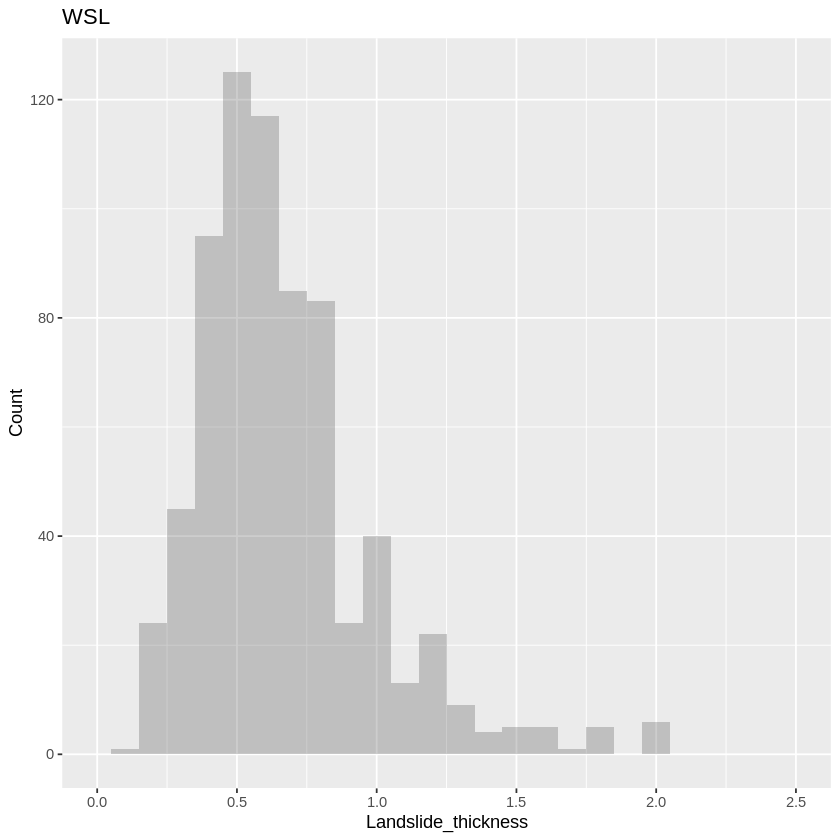

[1] "GR 427"


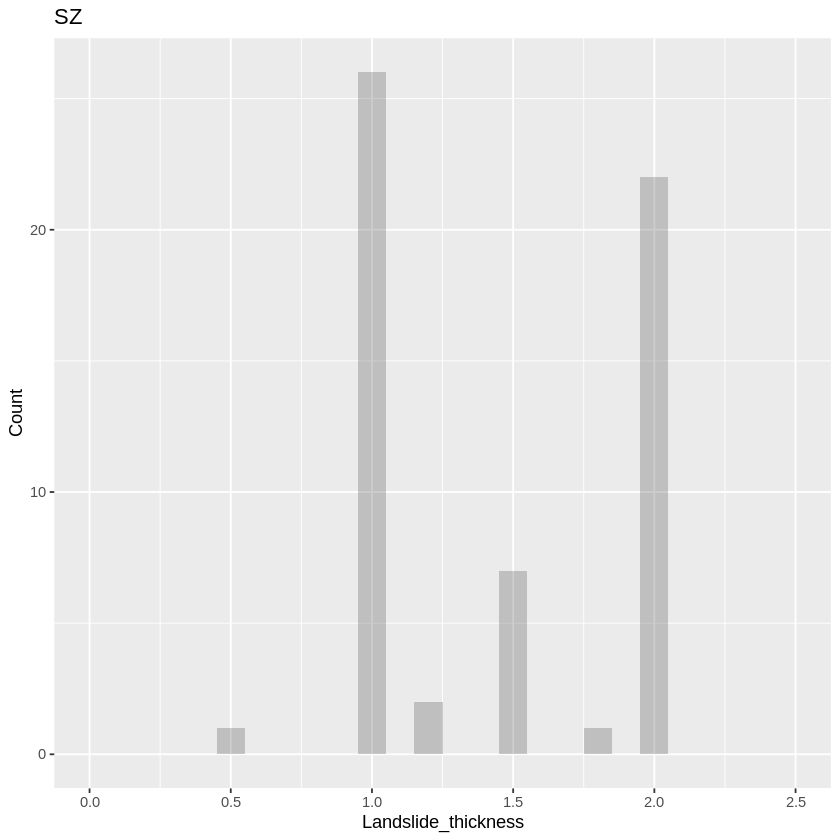

[1] "NW 53"


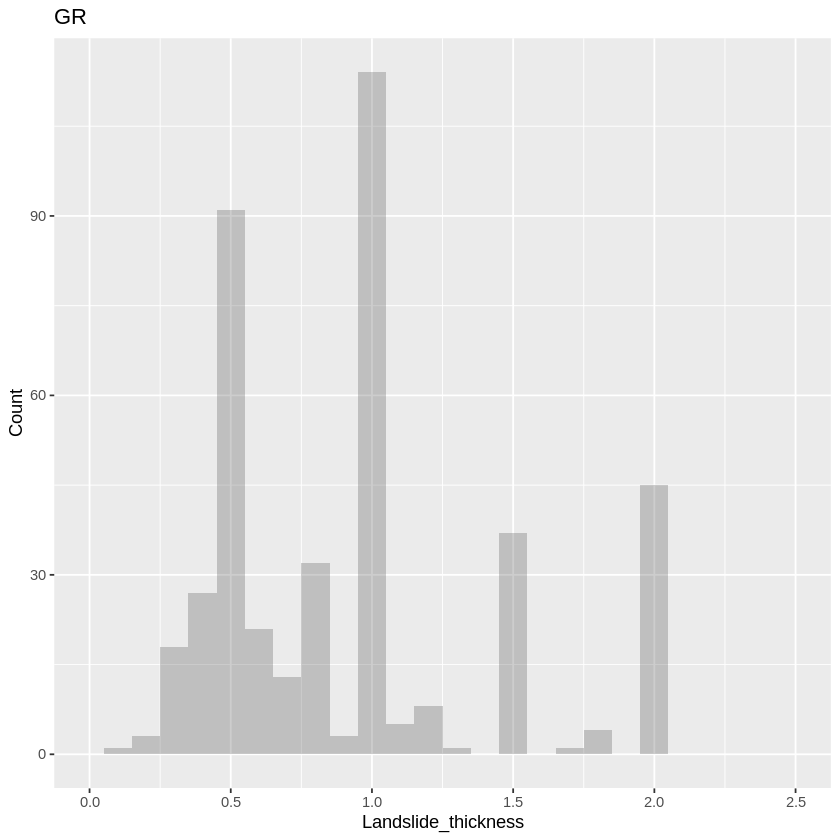

[1] "BE 1965"


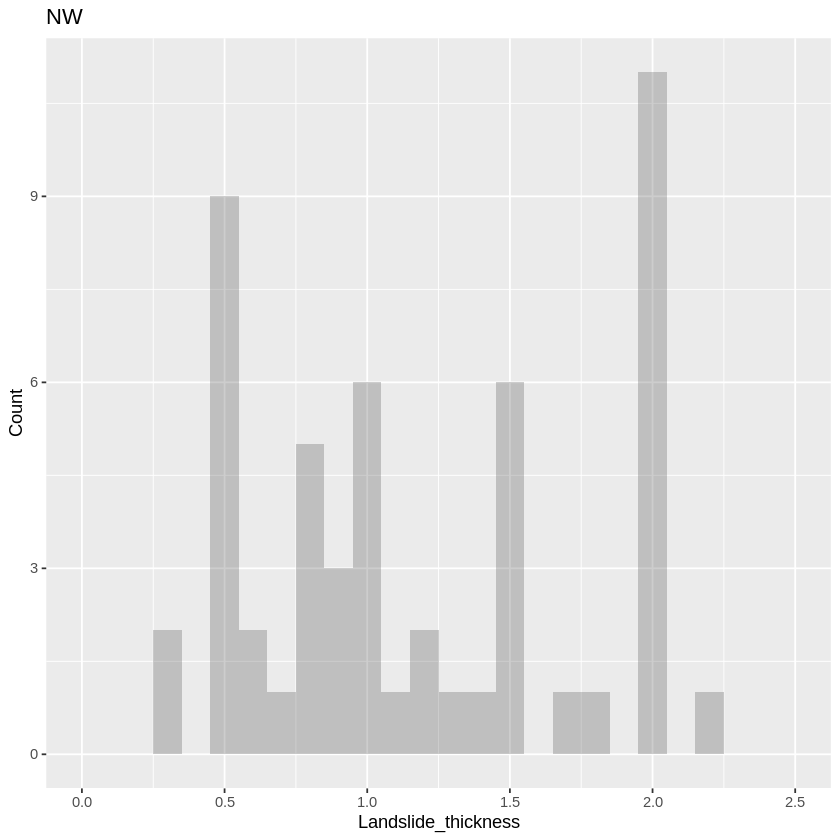

[1] "LU 96"


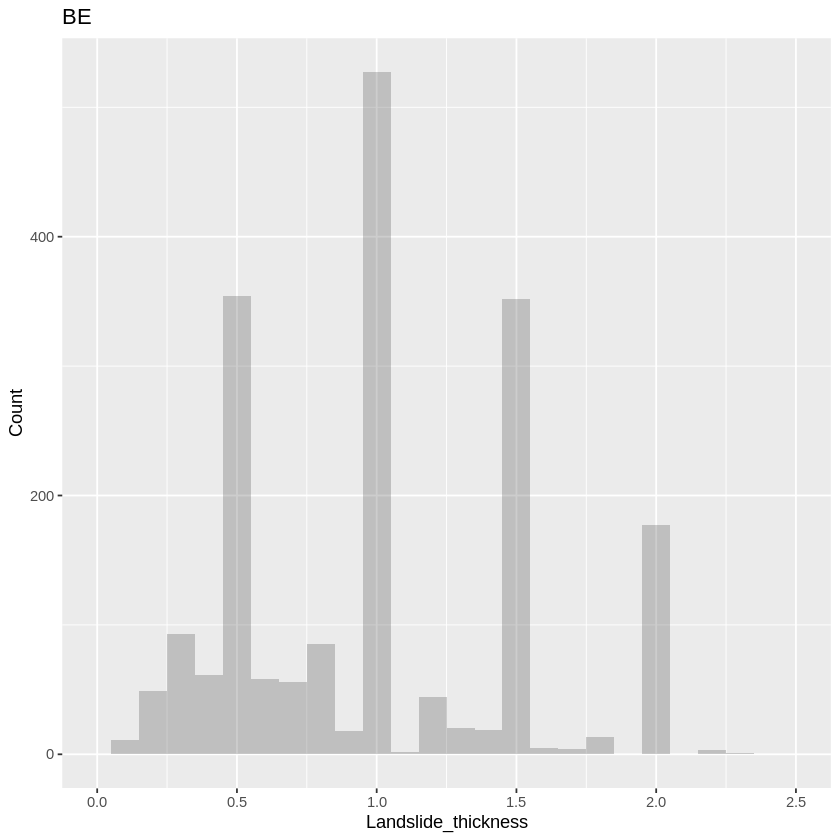

[1] "OW 231"


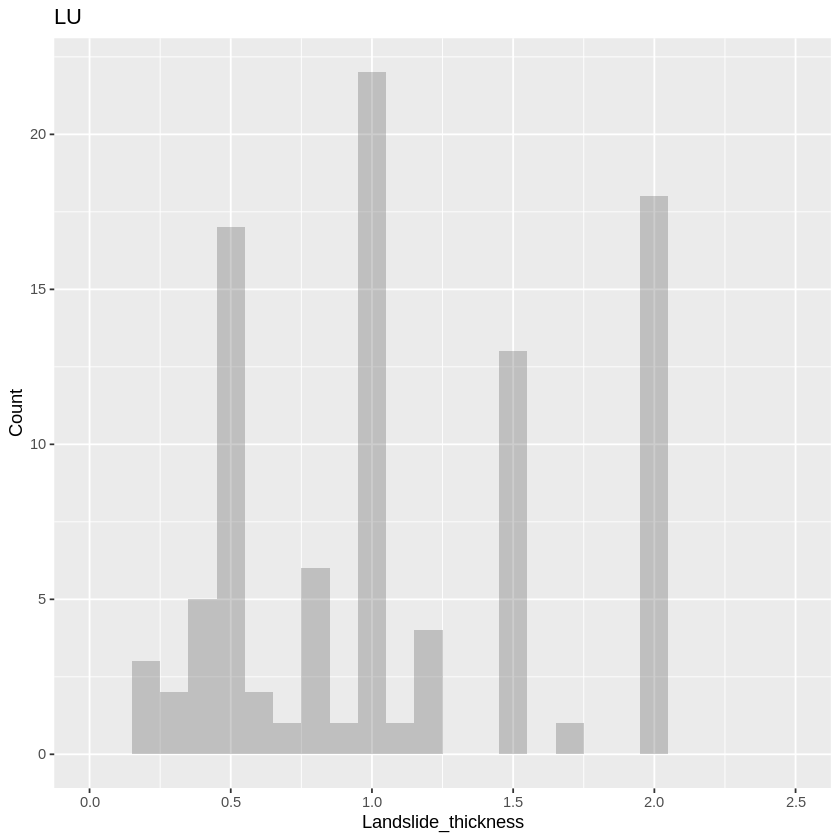

[1] "SO 28"


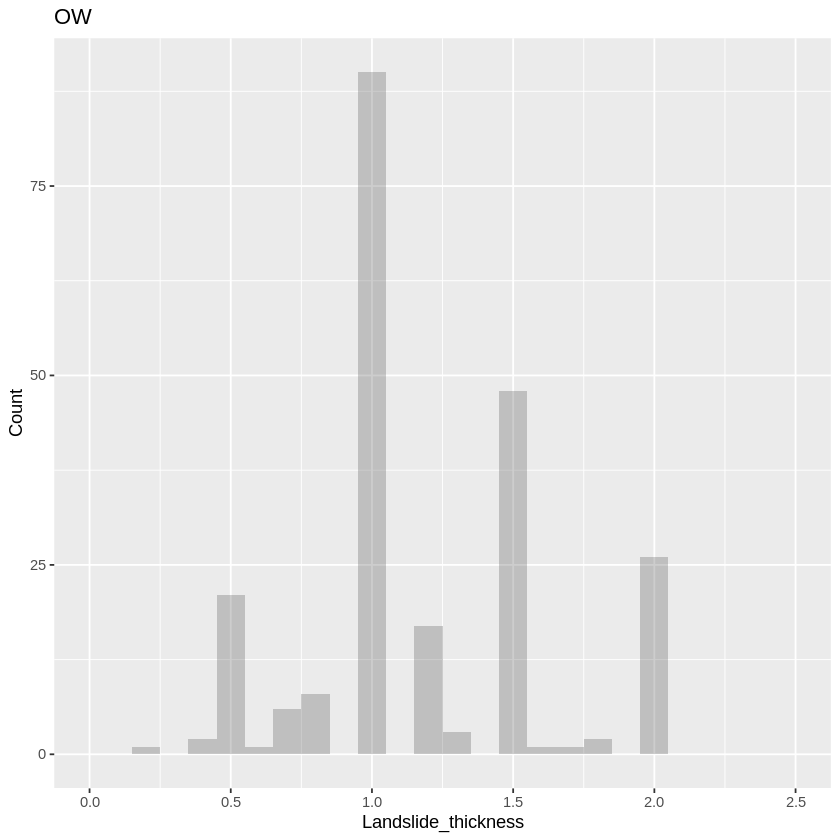

[1] "ZG 28"


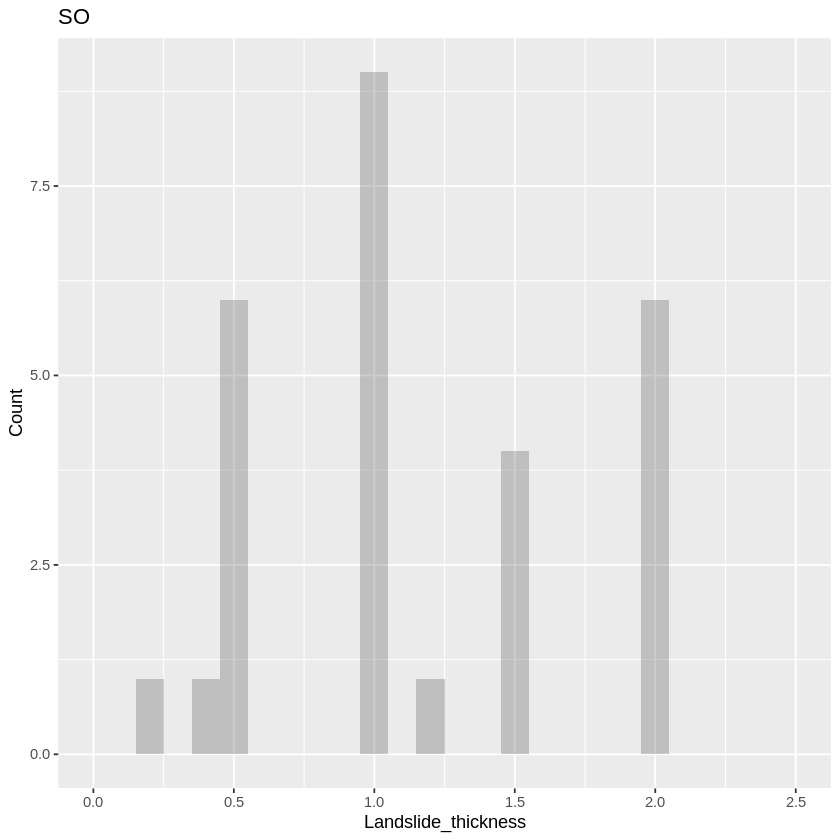

[1] "FR 13"


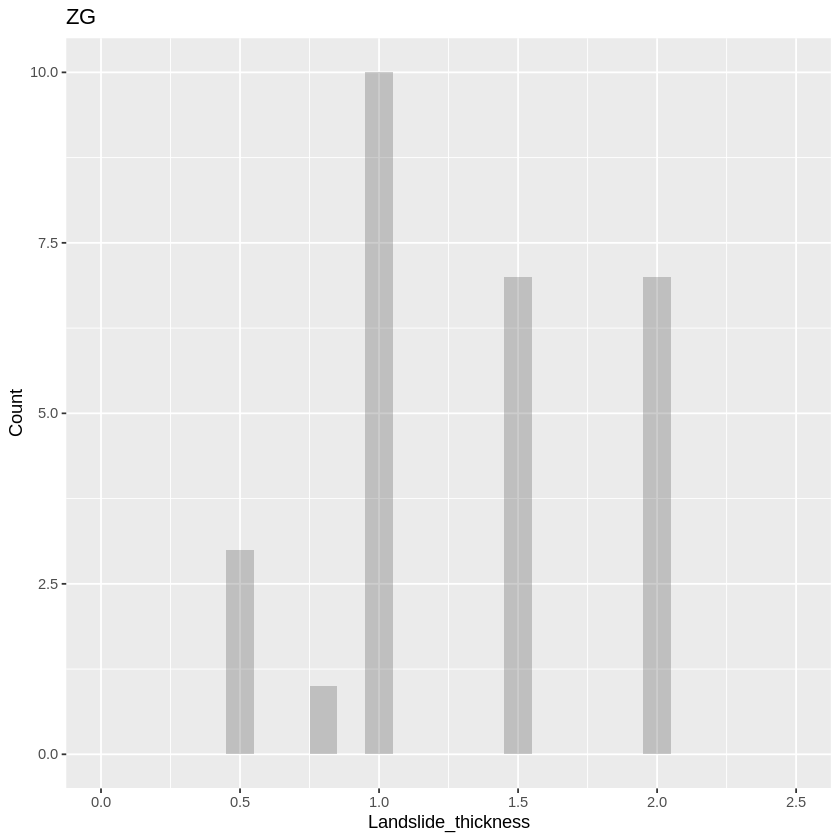

[1] "UR 74"


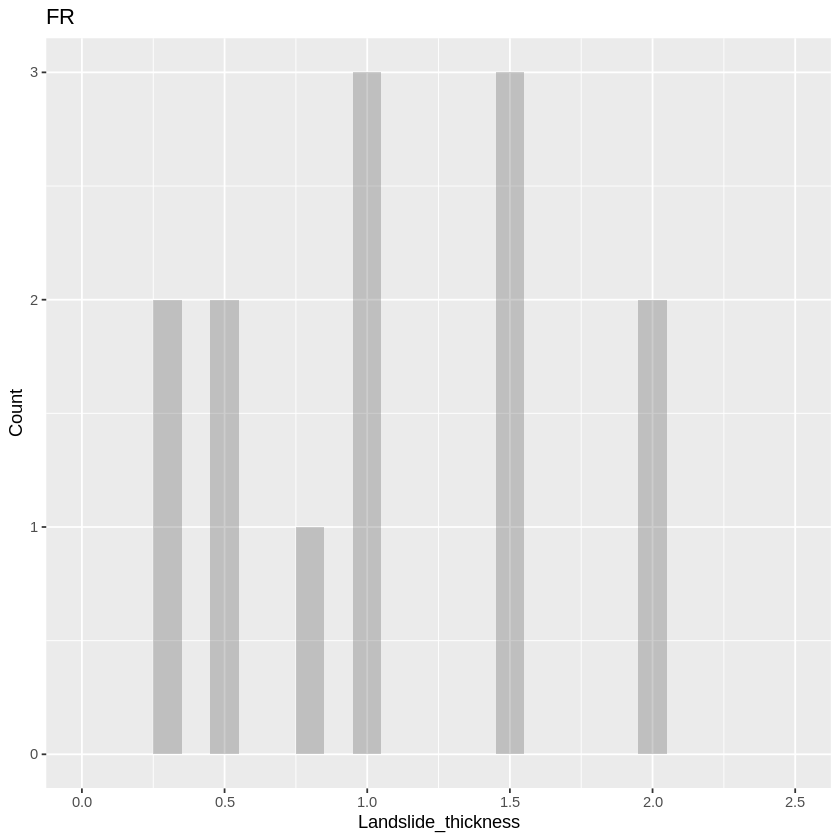

[1] "AR 12"


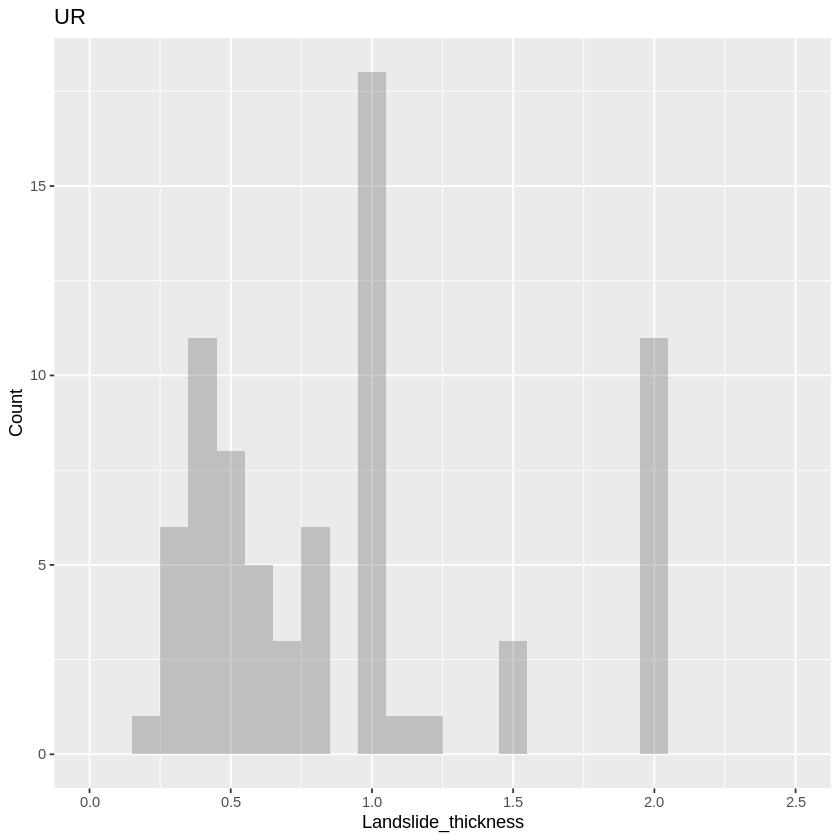

[1] "SBB 1"


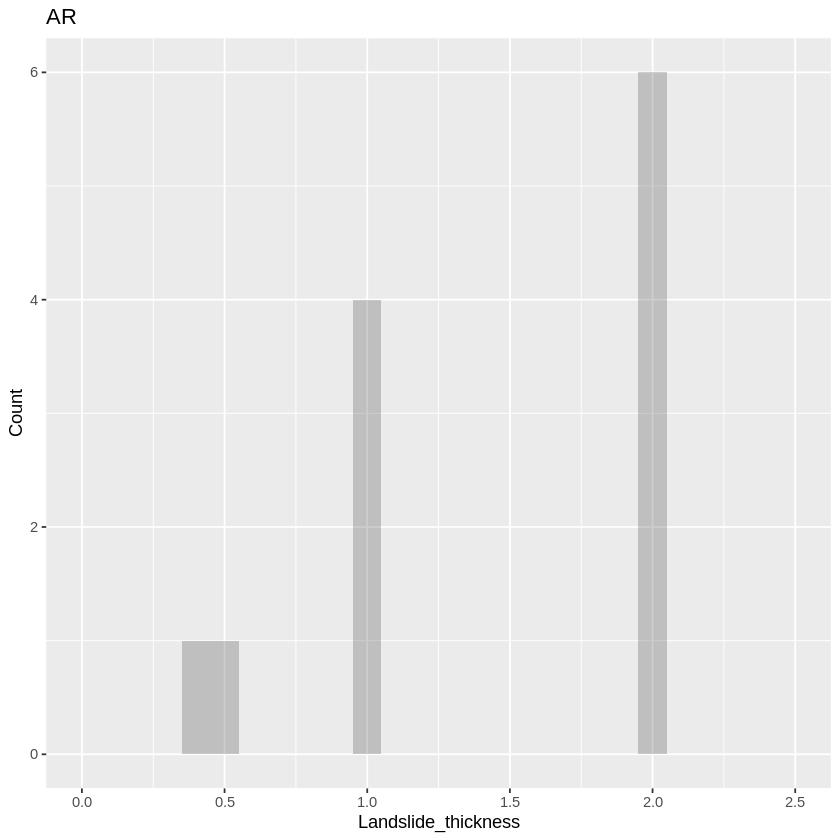

[1] "KtBE 517"


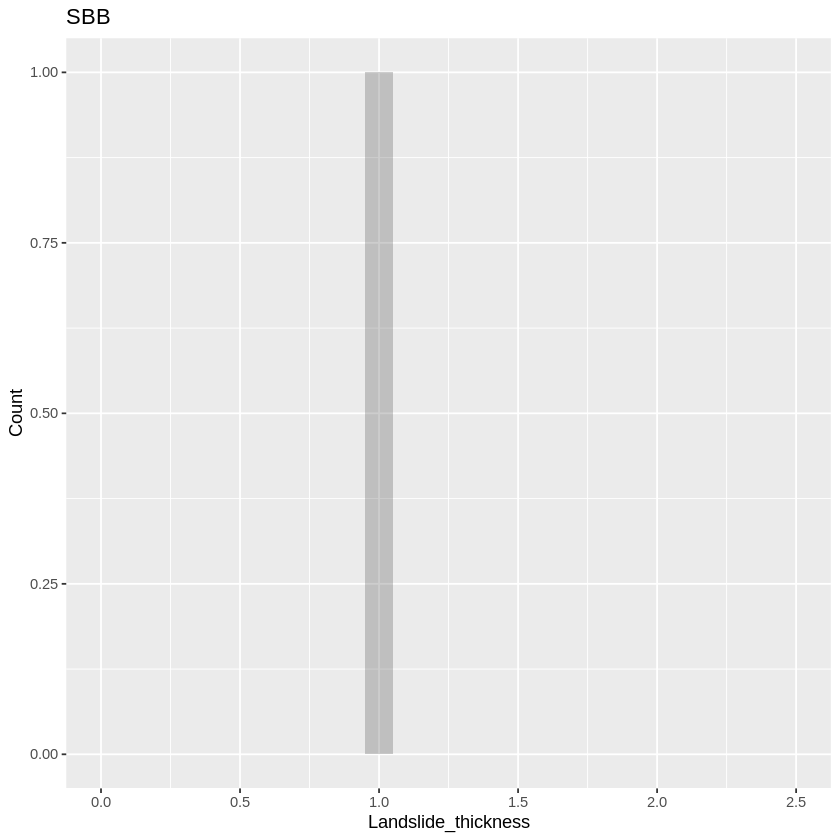

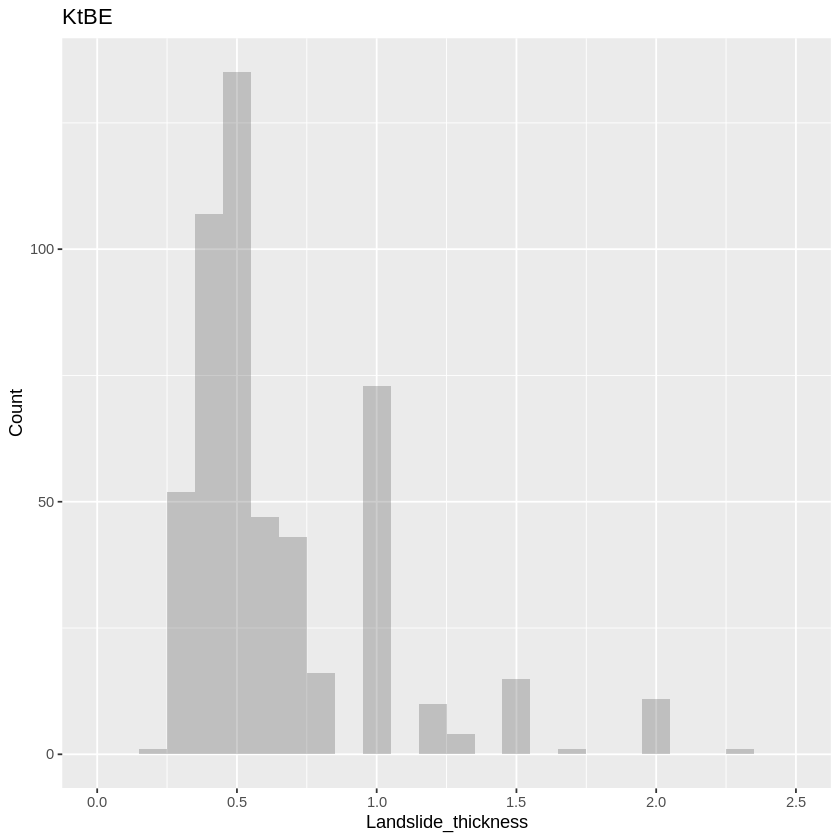

In [80]:
for(dh in  unique(merged.df$Data_provider))
{
    df <- merged.df[merged.df$Data_provider==dh,]
    print(paste(dh,nrow(df)))
    plt <- ggplot(df, aes(x=Landslide_thickness)) +
      geom_histogram(alpha=0.3, binwidth = 0.1, position="identity") +
      xlim(0,2.5) +
      ggtitle(dh)+
      ylab("Count")
    print(plt)
}

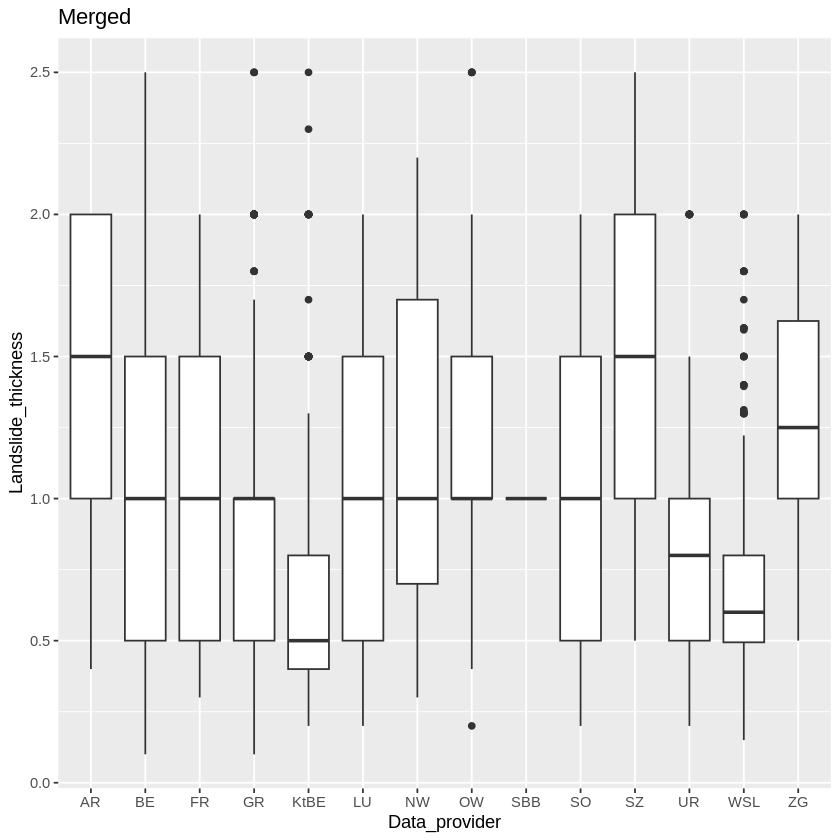

In [81]:
ggplot(merged.df, aes(x=Data_provider, y=Landslide_thickness)) + 
  geom_boxplot() +
  ggtitle("Merged")



In [82]:
print(paste0("Total count ",nrow(merged.df)))
print(paste0("non null Rainfall_sum ",sum(!is.na(merged.df$Rainfall_sum))))
print(paste0("non null Rainfall_sum HMDB ",sum(!is.na(hm.selection.df$Rainfall_sum))))
print(paste0("non null Rainfall_sum BE ",sum(!is.na(be.selection.df$Rainfall_sum))))
print(paste0("non null Rainfall_sum Storme ",sum(!is.na(storme.selection.df$Rainfall_sum))))



[1] "Total count 4214"
[1] "non null Rainfall_sum 2720"
[1] "non null Rainfall_sum HMDB 633"
[1] "non null Rainfall_sum BE 0"
[1] "non null Rainfall_sum Storme 2087"


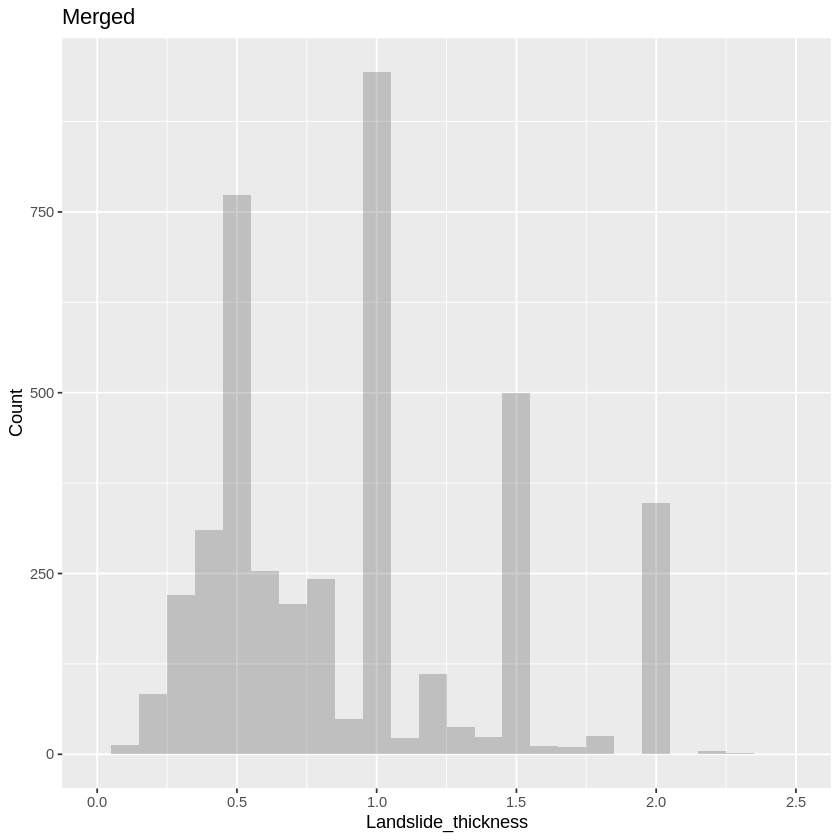

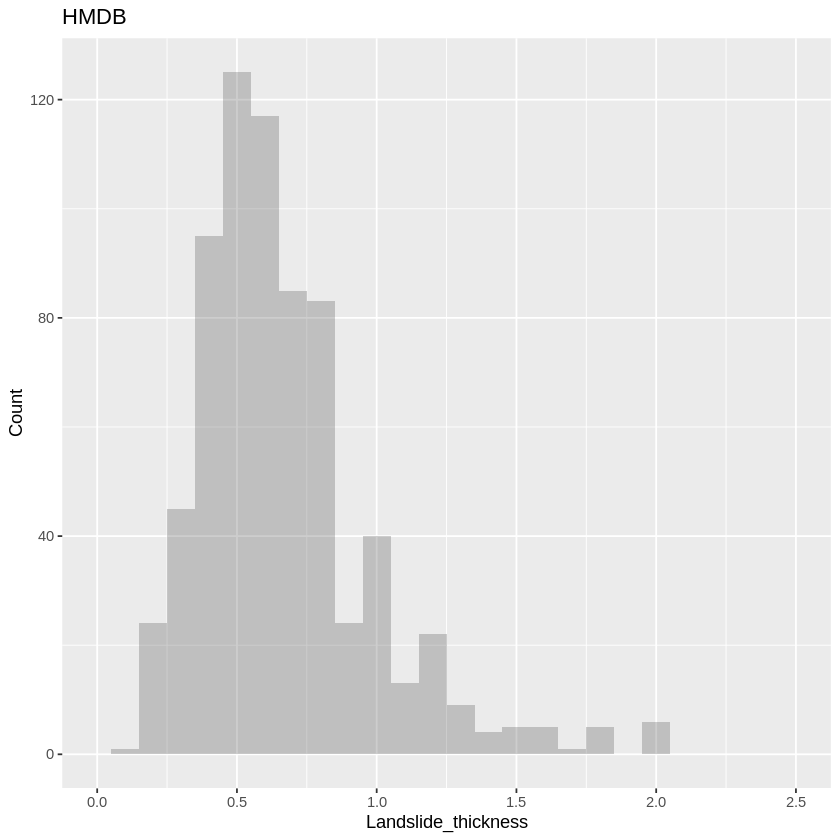

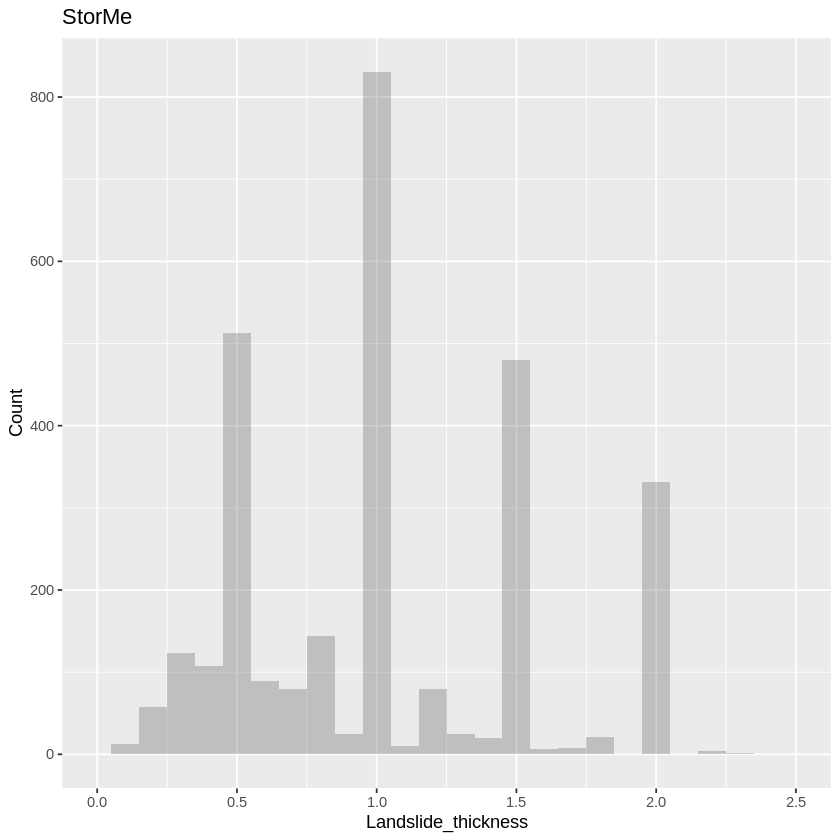

In [83]:

ggplot(merged.df, aes(x=Landslide_thickness)) +
      geom_histogram(alpha=0.3, binwidth = 0.1, position="identity") +
      xlim(0,2.5) +
      # ylim(0,6) +
      # xlab(actual_label) +
      ggtitle("Merged")+
      ylab("Count") 

ggplot(merged.df.hmdb, aes(x=Landslide_thickness)) +
      geom_histogram(alpha=0.3, binwidth = 0.1, position="identity") +
      xlim(0,2.5) +
      # ylim(0,6) +
      # xlab(actual_label) +
      ggtitle("HMDB")+
      ylab("Count") 

ggplot(merged.df.storme, aes(x=Landslide_thickness)) +
      geom_histogram(alpha=0.3, binwidth = 0.1, position="identity") +
      xlim(0,2.5) +
      # ylim(0,6) +
      # xlab(actual_label) +
      ggtitle("StorMe")+
      ylab("Count") 


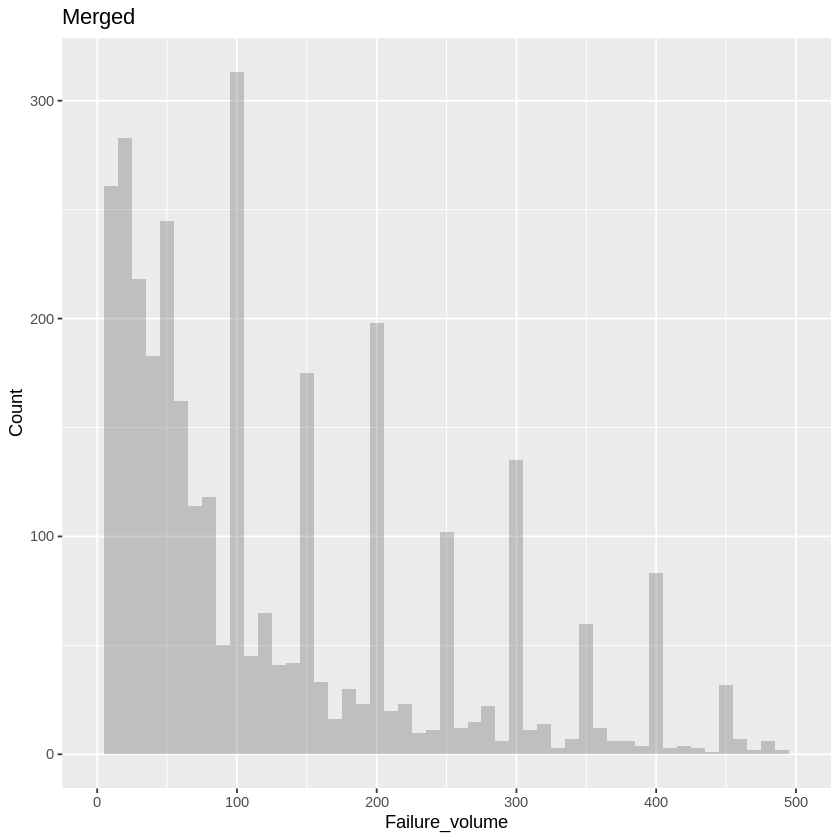

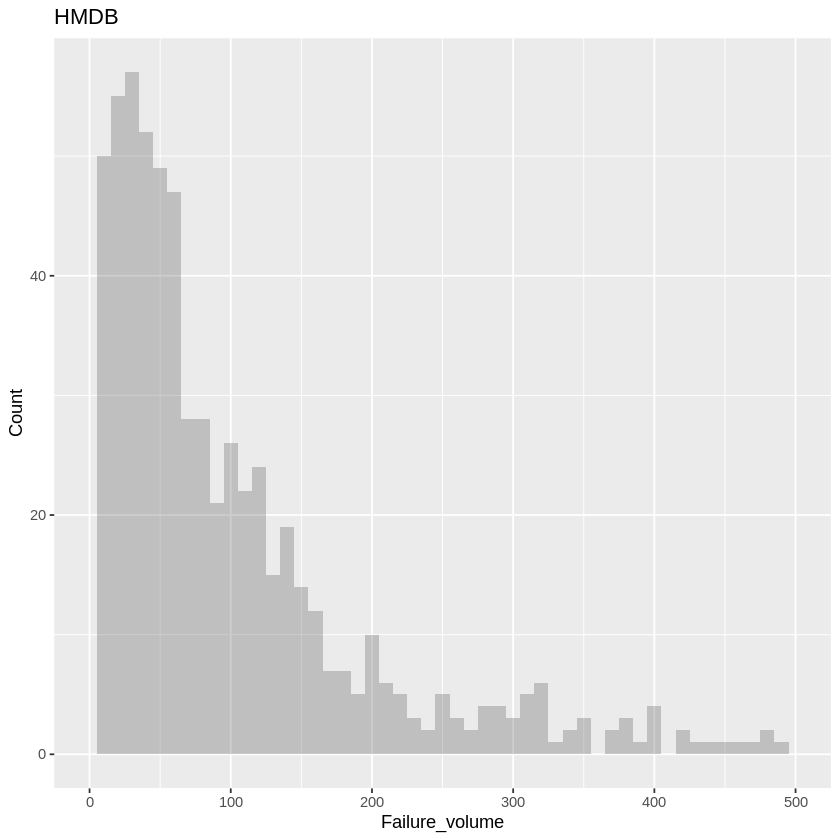

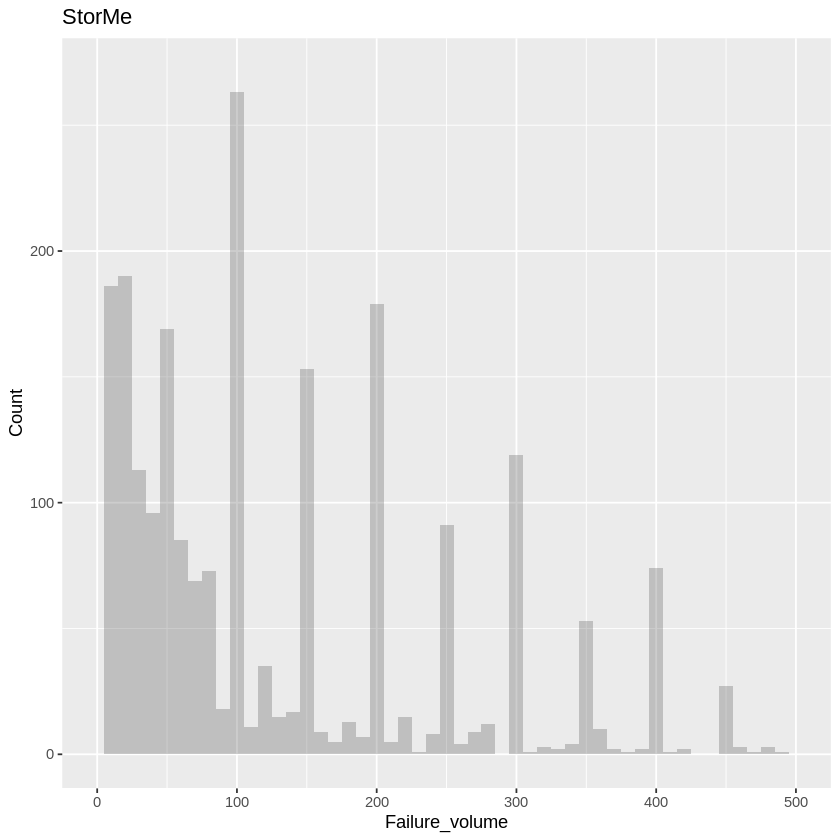

In [84]:

ggplot(merged.df, aes(x=Failure_volume)) +
      geom_histogram(alpha=0.3, binwidth = 10, position="identity") +
      xlim(0,500) +
      # ylim(0,6) +
      # xlab(actual_label) +
      ggtitle("Merged")+
      ylab("Count") 

ggplot(merged.df.hmdb, aes(x=Failure_volume)) +
      geom_histogram(alpha=0.3, binwidth = 10, position="identity") +
      xlim(0,500) +
      # ylim(0,6) +
      # xlab(actual_label) +
      ggtitle("HMDB")+
      ylab("Count") 

ggplot(merged.df.storme, aes(x=Failure_volume)) +
      geom_histogram(alpha=0.3, binwidth = 10, position="identity") +
      xlim(0,500) +
      # ylim(0,6) +
      # xlab(actual_label) +
      ggtitle("StorMe")+
      ylab("Count") 


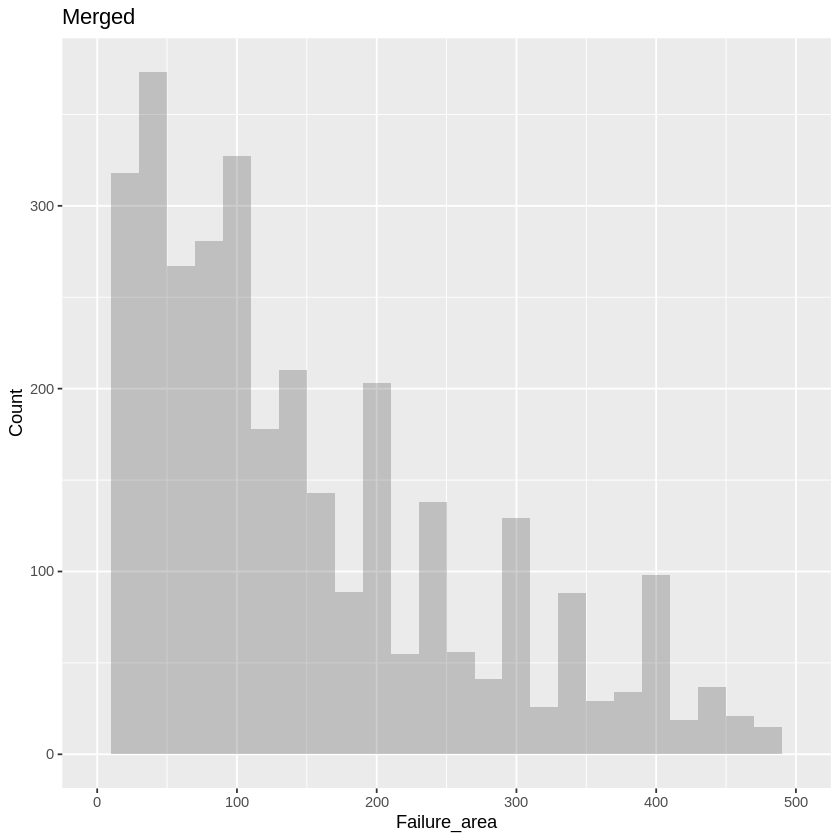

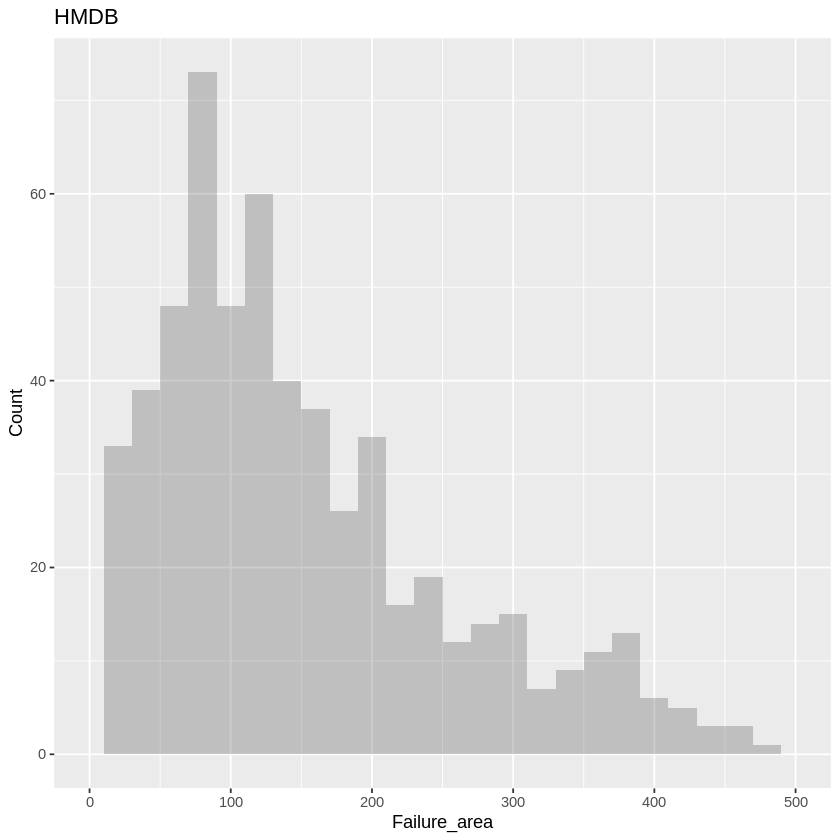

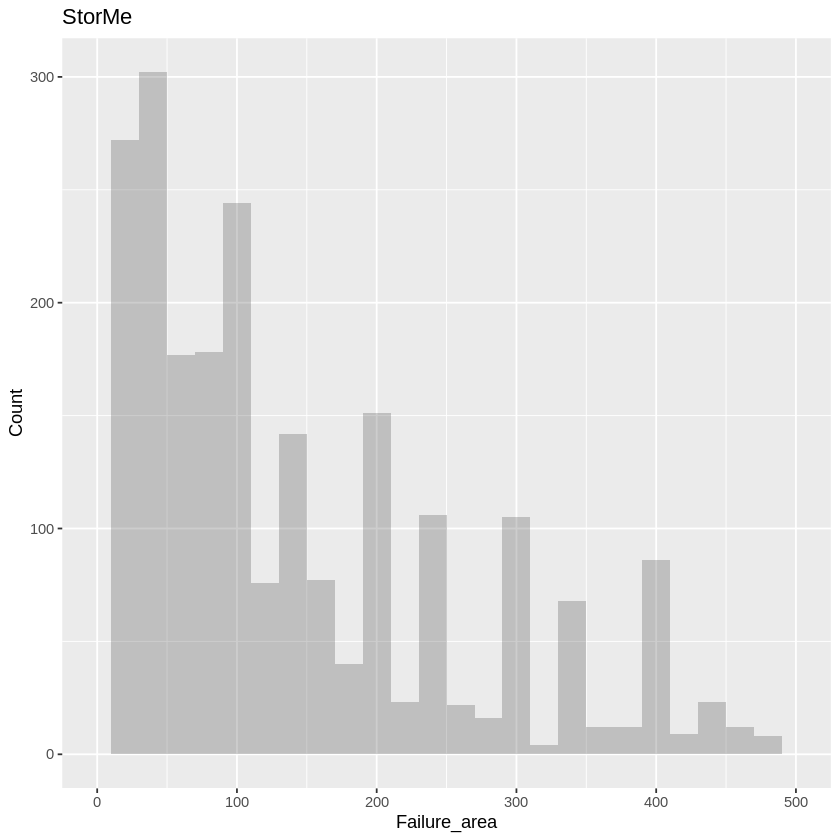

In [85]:

ggplot(merged.df, aes(x=Failure_area)) +
      geom_histogram(alpha=0.3, binwidth = 20, position="identity") +
      xlim(0,500) +
      # ylim(0,6) +
      # xlab(actual_label) +
      ggtitle("Merged")+
      ylab("Count") 

ggplot(merged.df.hmdb, aes(x=Failure_area)) +
      geom_histogram(alpha=0.3, binwidth = 20, position="identity") +
      xlim(0,500) +
      # ylim(0,6) +
      # xlab(actual_label) +
      ggtitle("HMDB")+
      ylab("Count") 

ggplot(merged.df.storme, aes(x=Failure_area)) +
      geom_histogram(alpha=0.3, binwidth = 20, position="identity") +
      xlim(0,500) +
      # ylim(0,6) +
      # xlab(actual_label) +
      ggtitle("StorMe")+
      ylab("Count") 


In [86]:
tidyr::pivot_wider(data = merged.df,
             id_cols = "unconsolidated_deposits_label",
                names_from = "Dataset",
                values_from = "Dataset",
                values_fn = list(Dataset = length))

tidyr::pivot_wider(data = merged.df,
             id_cols = "gk500_label",
                names_from = "Dataset",
                values_from = "Dataset",
                values_fn = list(Dataset = length))


unconsolidated_deposits_label,HMDB,StorMe,KtBE
<chr>,<int>,<int>,<int>
none,468,1541,210
"gravitative Sedimente und Verwitterungsbildungen, undifferenziert",126,497,149
fluviatiles Sediment,9,124,11
glazigenes Sediment,106,811,147
lakustrisches Sediment,NA,13,NA
hydrochemische Bildungen (Kalksinter),NA,2,NA


gk500_label,HMDB,StorMe,KtBE
<chr>,<int>,<int>,<int>
Sedimentgesteine,633,2237,433
"lehmige Kiese, Sande, Silte z.T. Bloecke (Moraene)",52,388,57
Gneise und Glimmerschiefer,2,38,NA
"Rhyolith, Dacit",5,4,NA
Metagranitoide,15,45,1
"Kiese, und Sande (Schotter)",1,34,NA
Alluvionen,1,79,7
"Bloecke, grobe Kiese, Sande (Hangschutt)",NA,21,6
vorwiegend Bloecke (Bergsturz),NA,21,NA


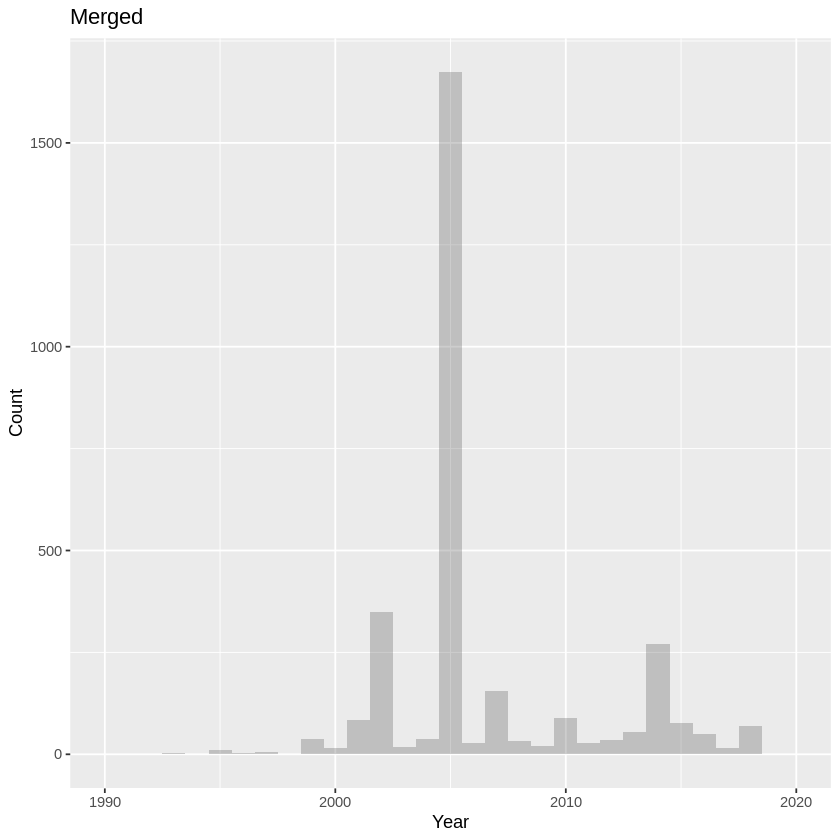

In [87]:

ggplot(merged.df, aes(x=Year)) +
      geom_histogram(alpha=0.3, binwidth = 1, position="identity") +
      xlim(1990,2020) +
      # ylim(0,6) +
      # xlab(actual_label) +
      ggtitle("Merged")+
      ylab("Count") 

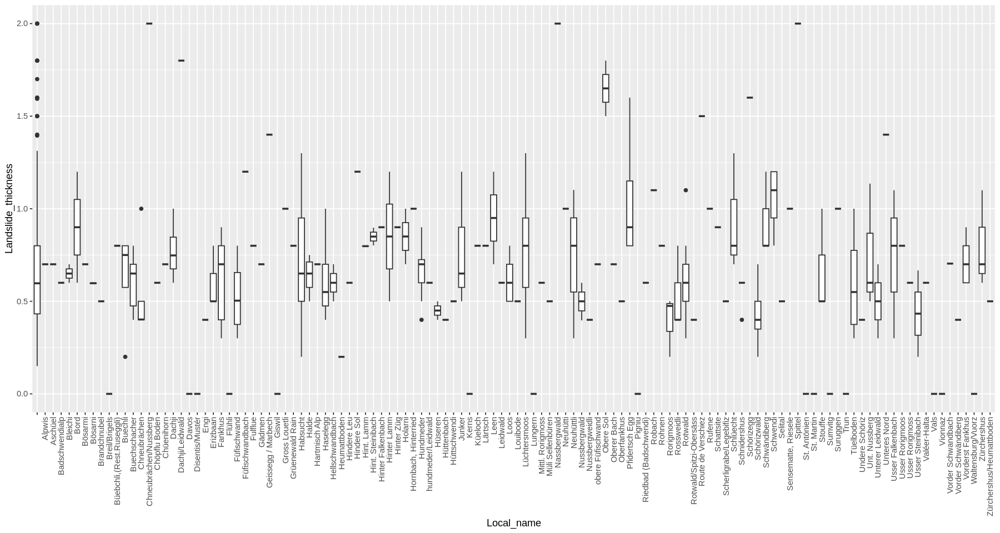

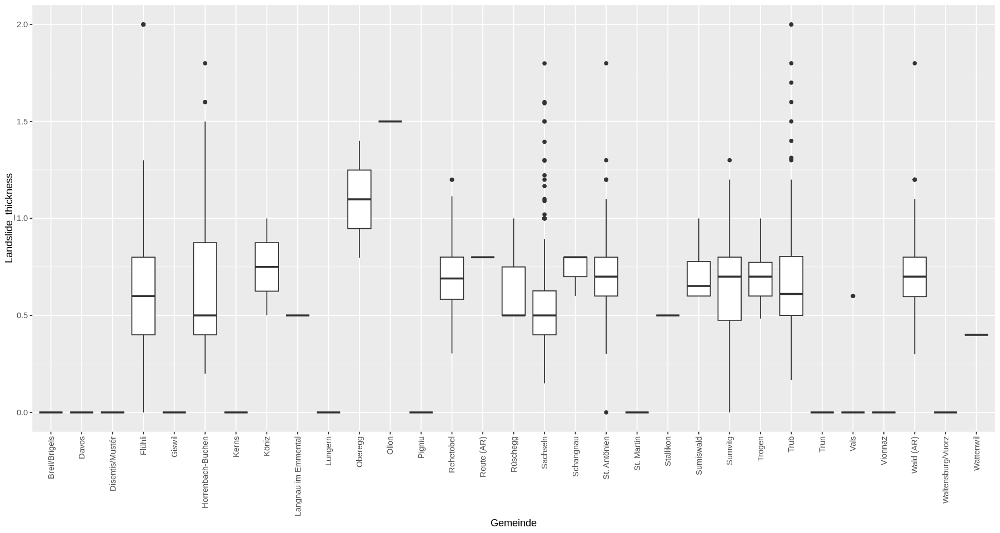

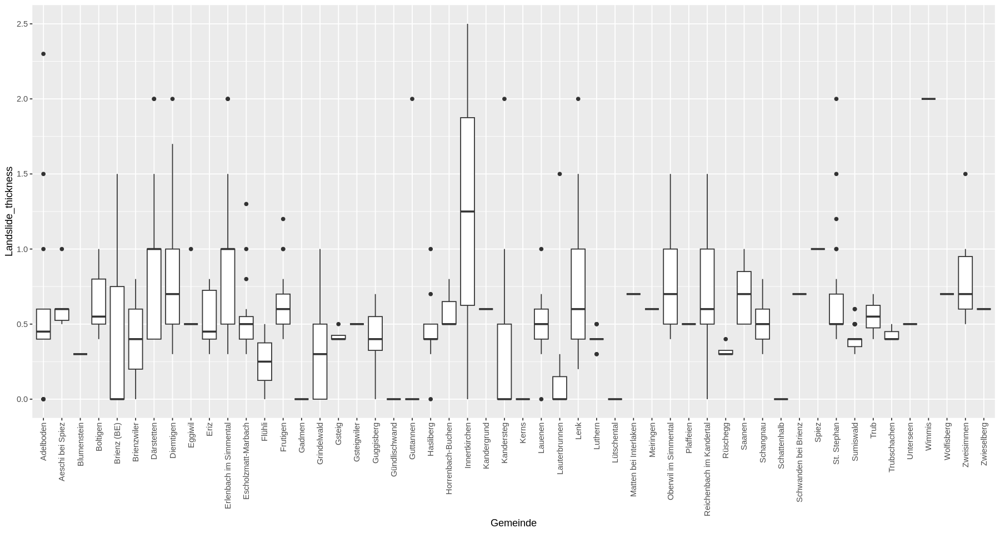

In [88]:
options(repr.plot.width=15, repr.plot.height=8)
ggplot(merged.df.hmdb, aes(x=Local_name,y=Landslide_thickness))+
    geom_boxplot()+
    theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))

ggplot(merged.df.hmdb,aes(x=Gemeinde,y=Landslide_thickness))+
    geom_boxplot()+
    theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))

ggplot(merged.df.be,aes(x=Gemeinde,y=Landslide_thickness))+
    geom_boxplot()+
    theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))



<a id="Correlations"></a>
## Correlations

Collelation plots with different selections of covariates to support variable selection.

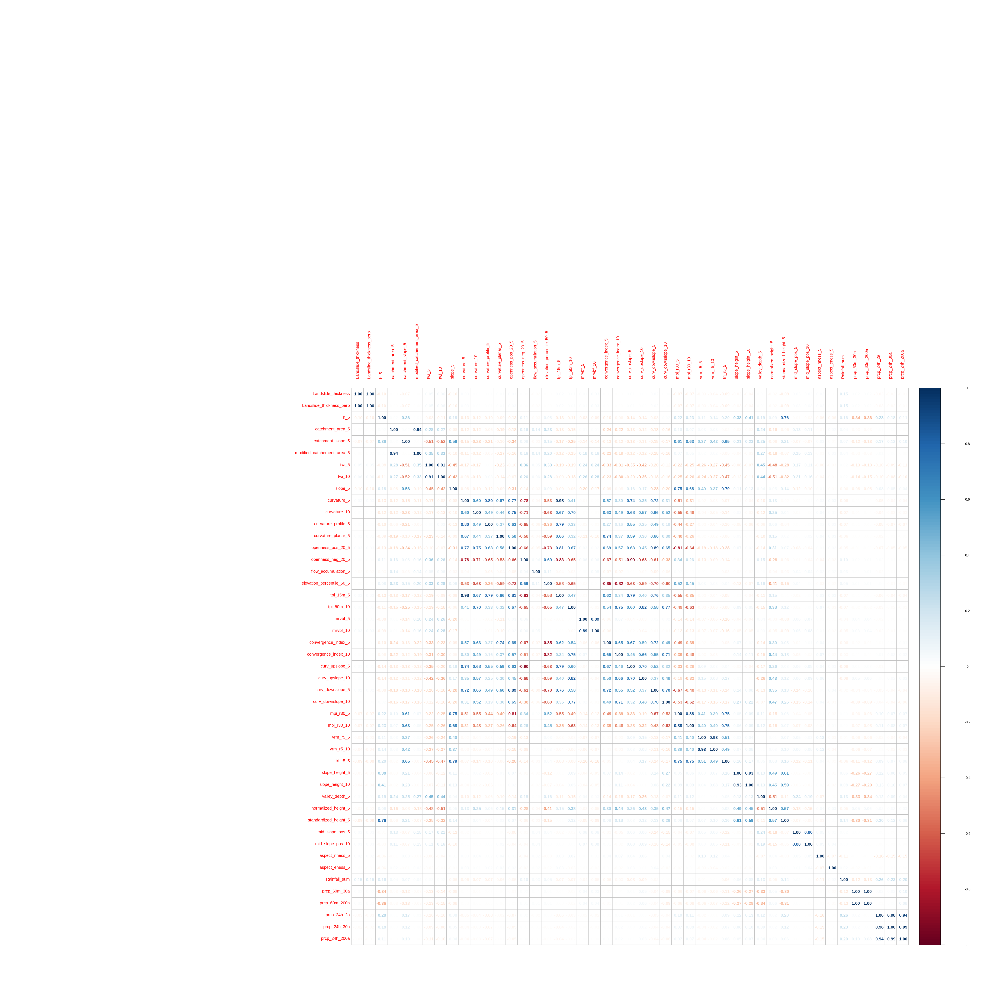

In [89]:
cor_cols <-c('Landslide_thickness', 'Landslide_thickness_perp', 
                     'h_5', 'catchment_area_5', 'catchment_slope_5', 
         'modified_catchement_area_5', 'twi_5', 'twi_10', 'slope_5', 'curvature_5', 'curvature_10', 
         'curvature_profile_5', 'curvature_planar_5', 'openness_pos_20_5', 'openness_neg_20_5',
        'flow_accumulation_5', 'elevation_percentile_50_5', 'tpi_15m_5', 'tpi_50m_10', 
        'mrvbf_5', 'mrvbf_10', 'convergence_index_5', 'convergence_index_10', 'curv_upslope_5', 'curv_upslope_10', 
         'curv_downslope_5', 'curv_downslope_10', 'mpi_r30_5', 'mpi_r30_10', 'vrm_r5_5', 'vrm_r5_10', 
        'tri_r5_5', 'slope_height_5', 'slope_height_10',
         'valley_depth_5', 'normalized_height_5', 'standardized_height_5',  
         'mid_slope_pos_5', 'mid_slope_pos_10', 'aspect_nness_5', 'aspect_eness_5',
                'Rainfall_sum',
                    'prcp_60m_30a', 'prcp_60m_200a', 'prcp_24h_2a', 'prcp_24h_30a', 'prcp_24h_200a')

options(repr.plot.width=40, repr.plot.height=40)
M = cor(merged.df[,cor_cols]
       ,use="pairwise.complete.obs")
corrplot(M, method = 'number') # colorful number


In [90]:
plot_correlation_by_dataset <- function(cor_cols, width=7, height=7) {
    options(repr.plot.width=width, repr.plot.height=height)

    M = cor(merged.df.hmdb[,cor_cols]
           ,use="pairwise.complete.obs")
    corrplot(M, method = 'number',title = "HMDB") # colorful number


    M = cor(merged.df.be[,cor_cols]
           ,use="pairwise.complete.obs")
    corrplot(M, method = 'number',title = "BE") # colorful number
}


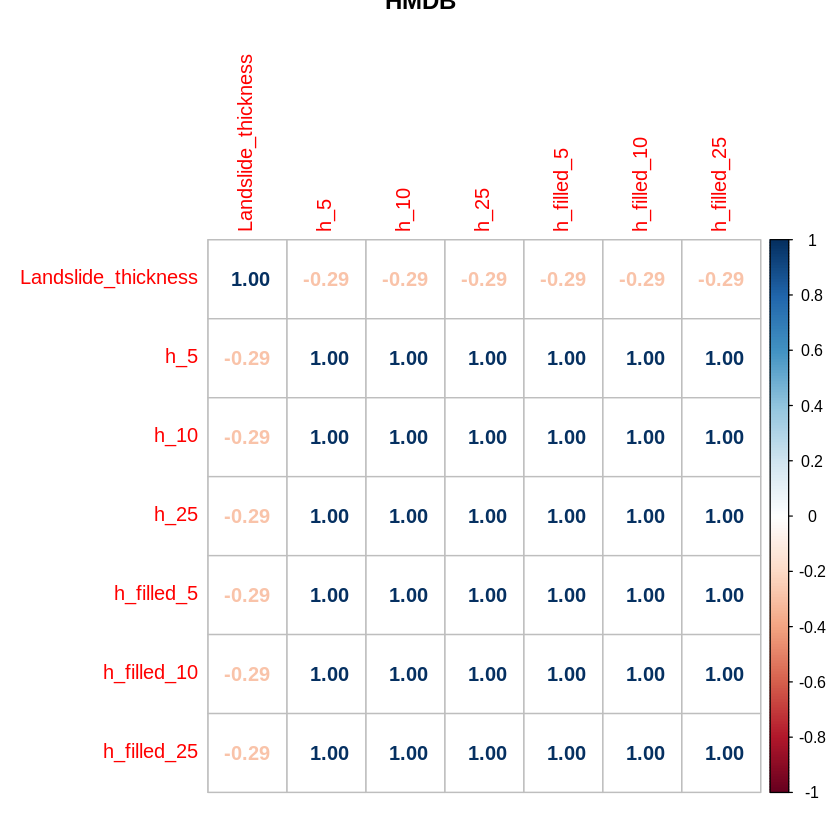

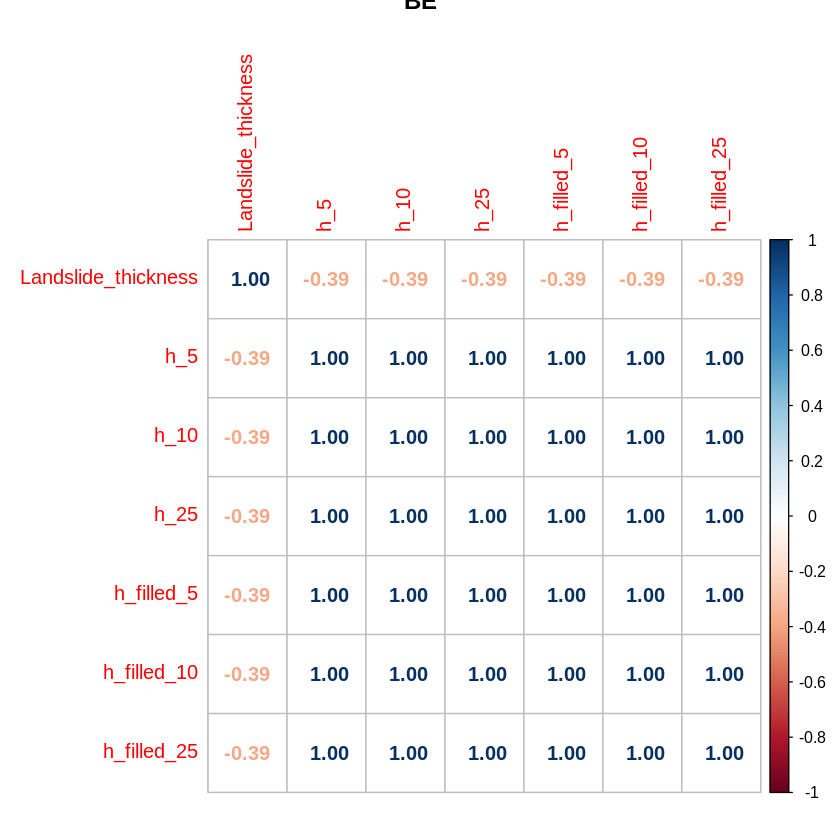

In [91]:
cor_cols <- c('Landslide_thickness','h_5', 'h_10', 'h_25','h_filled_5','h_filled_10','h_filled_25')
plot_correlation_by_dataset(cor_cols)

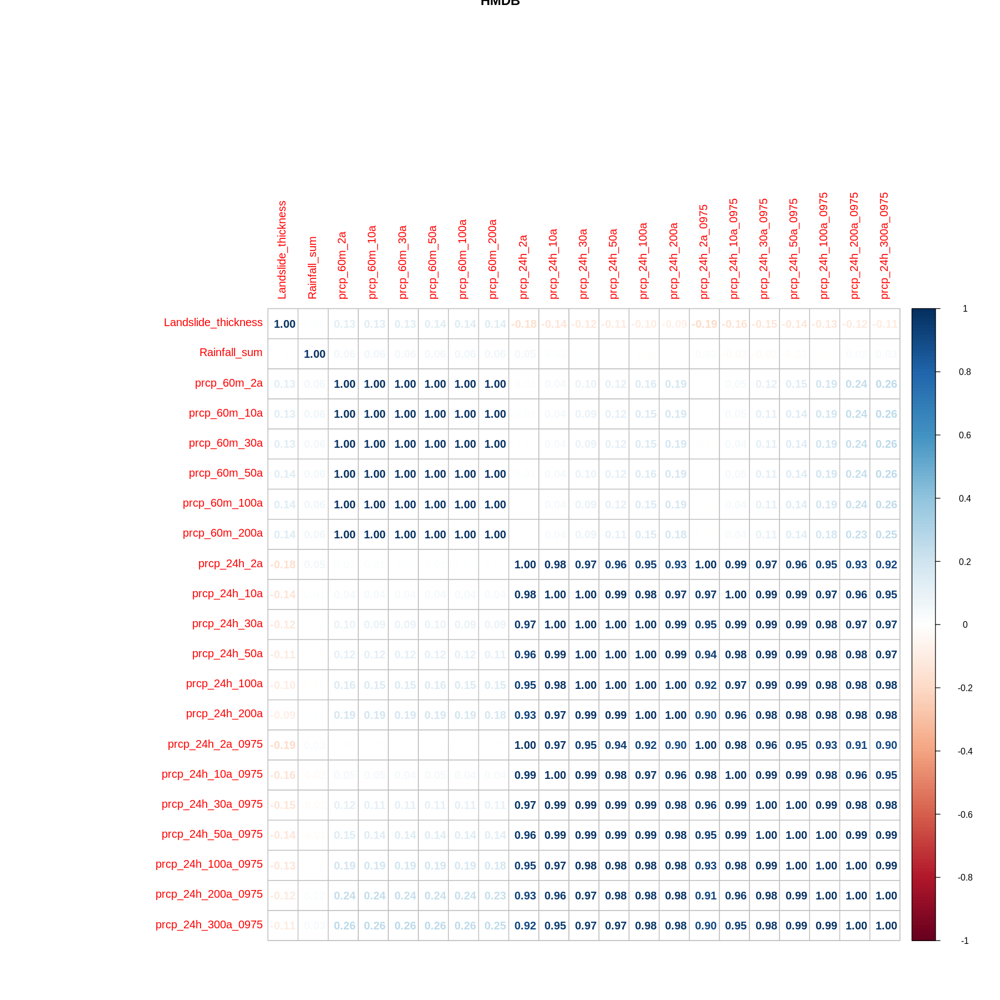

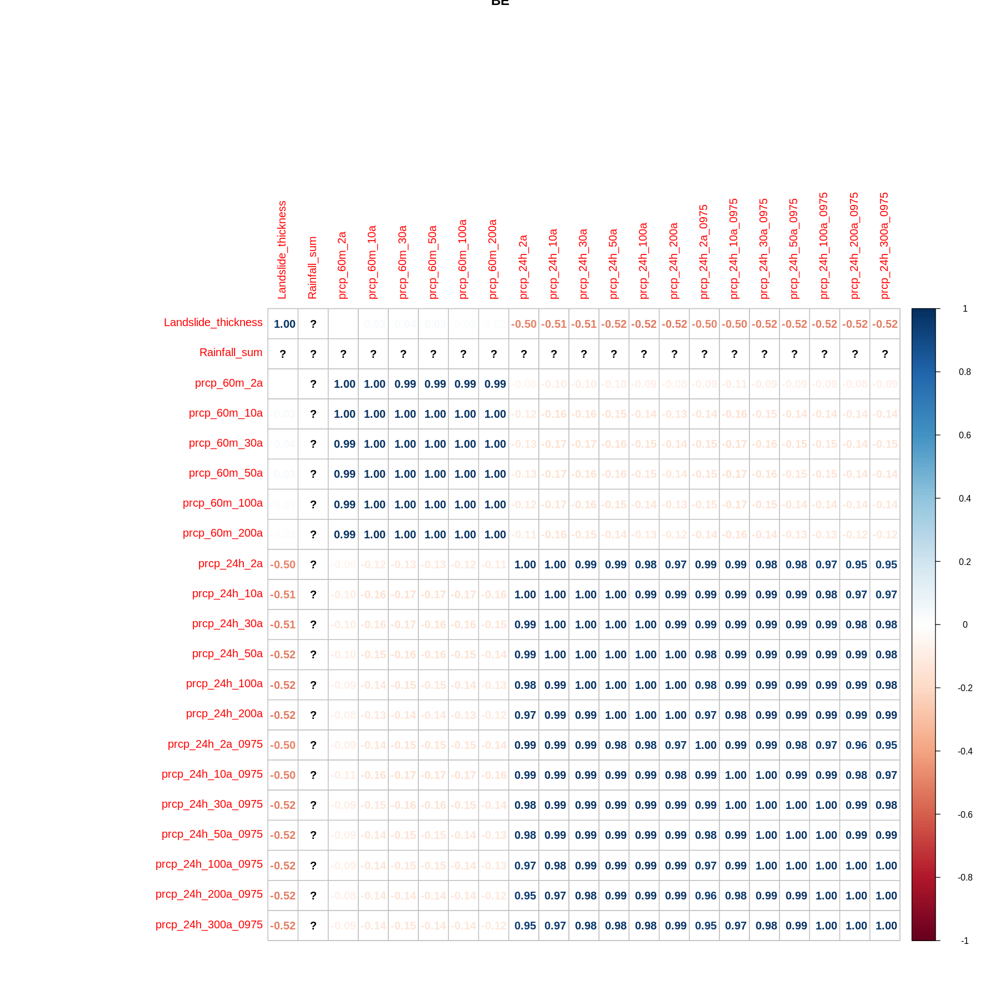

In [92]:
cor_cols <- c('Landslide_thickness','Rainfall_sum',
                    'prcp_60m_2a', 'prcp_60m_10a', 'prcp_60m_30a', 'prcp_60m_50a', 'prcp_60m_100a', 'prcp_60m_200a', 'prcp_24h_2a', 'prcp_24h_10a', 'prcp_24h_30a', 'prcp_24h_50a', 'prcp_24h_100a', 'prcp_24h_200a',
              'prcp_24h_2a_0975', 'prcp_24h_10a_0975', 'prcp_24h_30a_0975', 'prcp_24h_50a_0975', 'prcp_24h_100a_0975', 'prcp_24h_200a_0975', 'prcp_24h_300a_0975'
             )
plot_correlation_by_dataset(cor_cols,width=15,height=15)


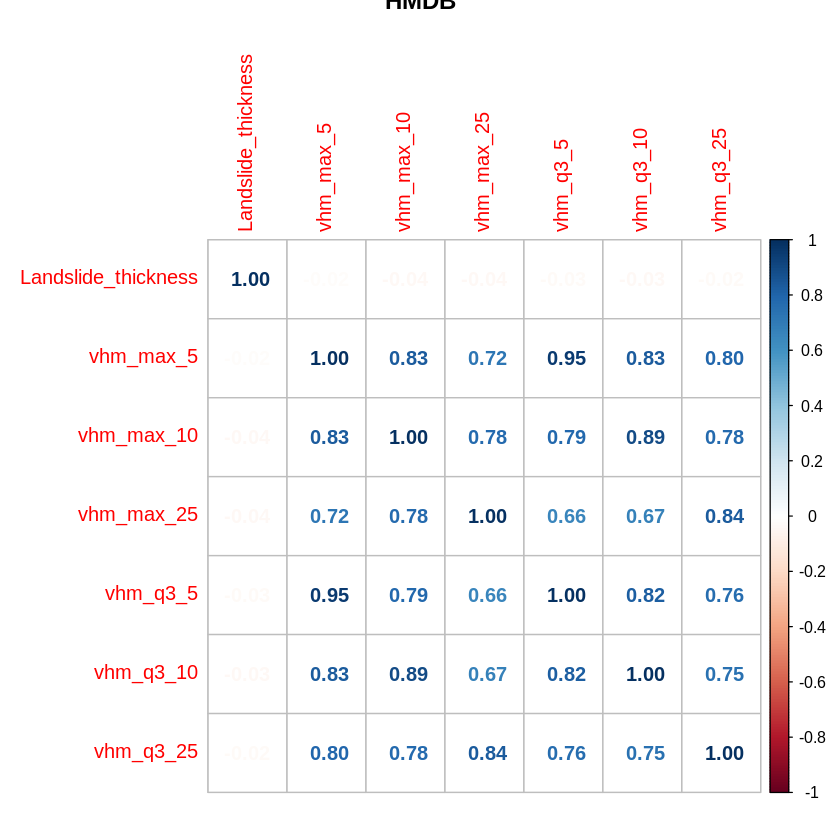

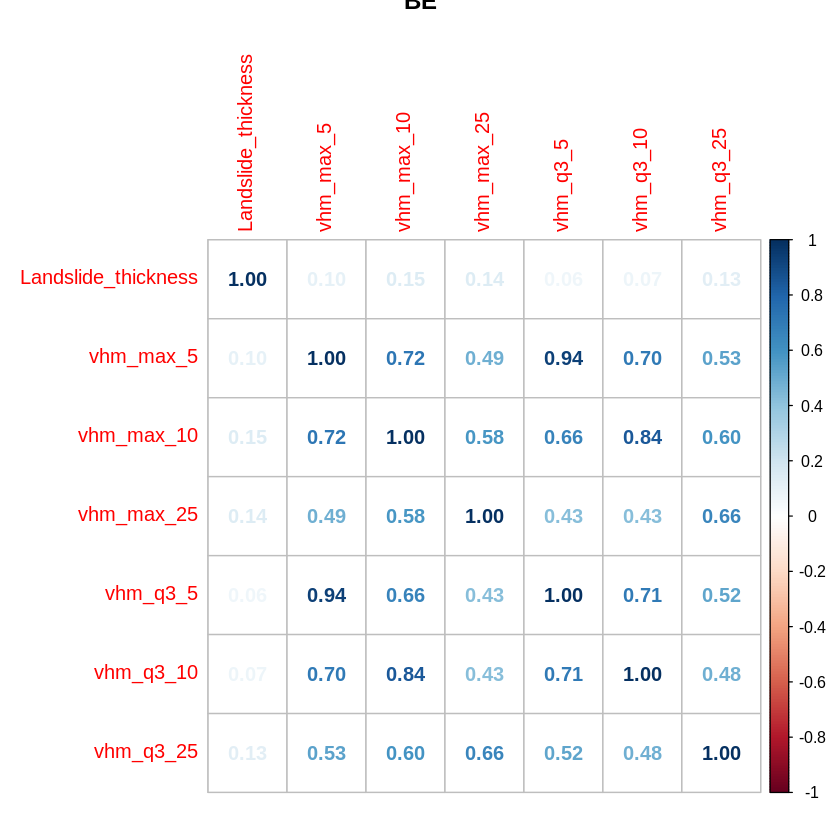

In [93]:
cor_cols <- c('Landslide_thickness','vhm_max_5', 'vhm_max_10', 'vhm_max_25',
         'vhm_q3_5', 'vhm_q3_10',  'vhm_q3_25')

plot_correlation_by_dataset(cor_cols)

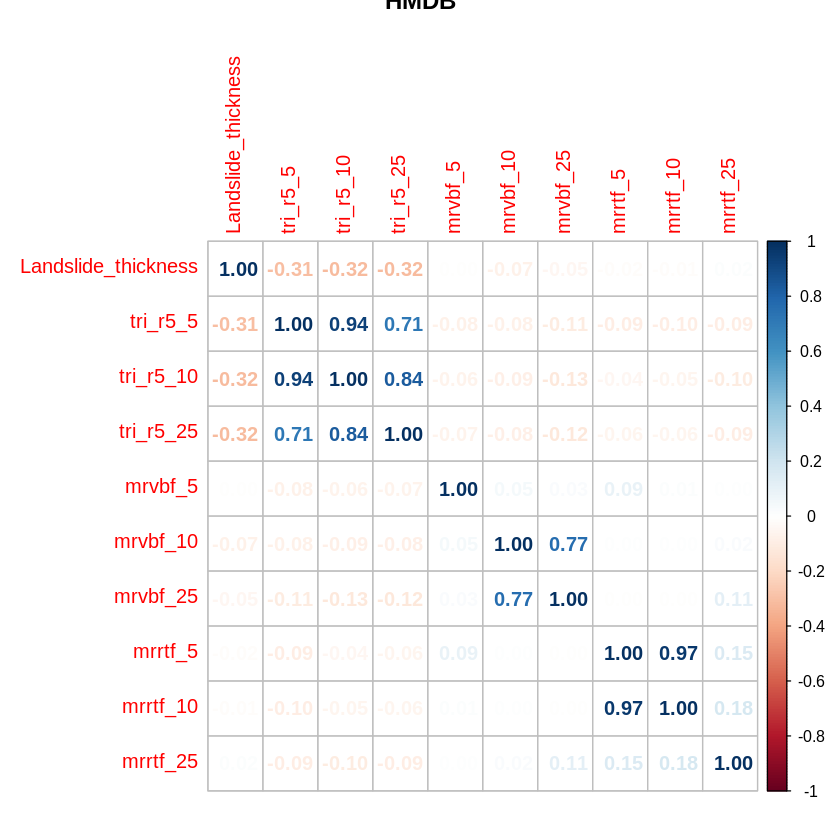

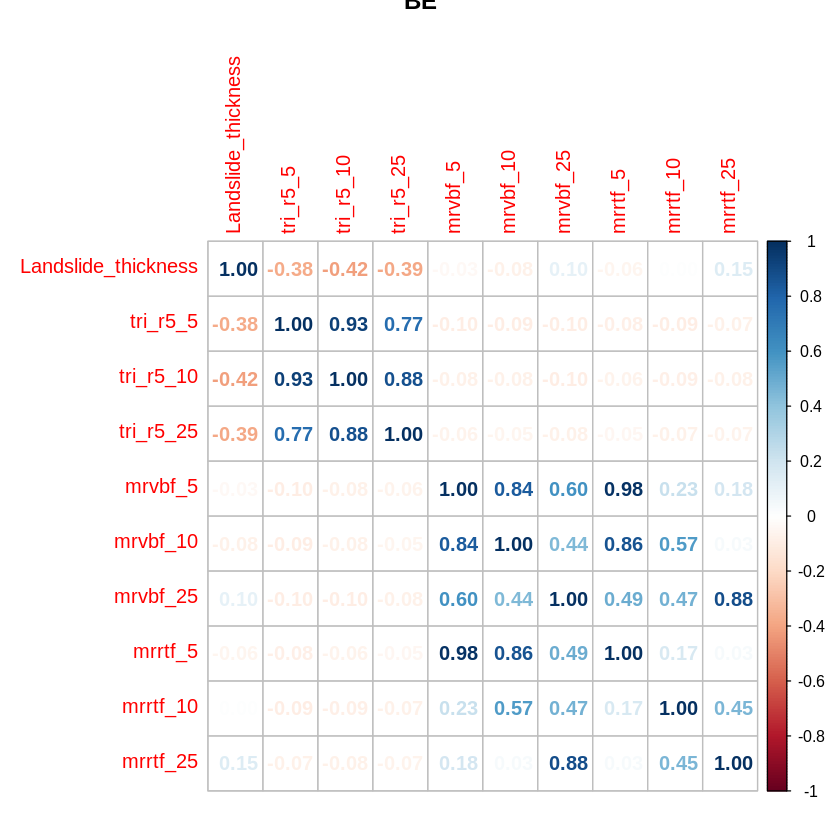

In [94]:

cor_cols <- c('Landslide_thickness','tri_r5_5', 'tri_r5_10', 'tri_r5_25',
                     'mrvbf_5', 'mrvbf_10', 'mrvbf_25', 'mrrtf_5', 'mrrtf_10', 
                    'mrrtf_25')

plot_correlation_by_dataset(cor_cols)

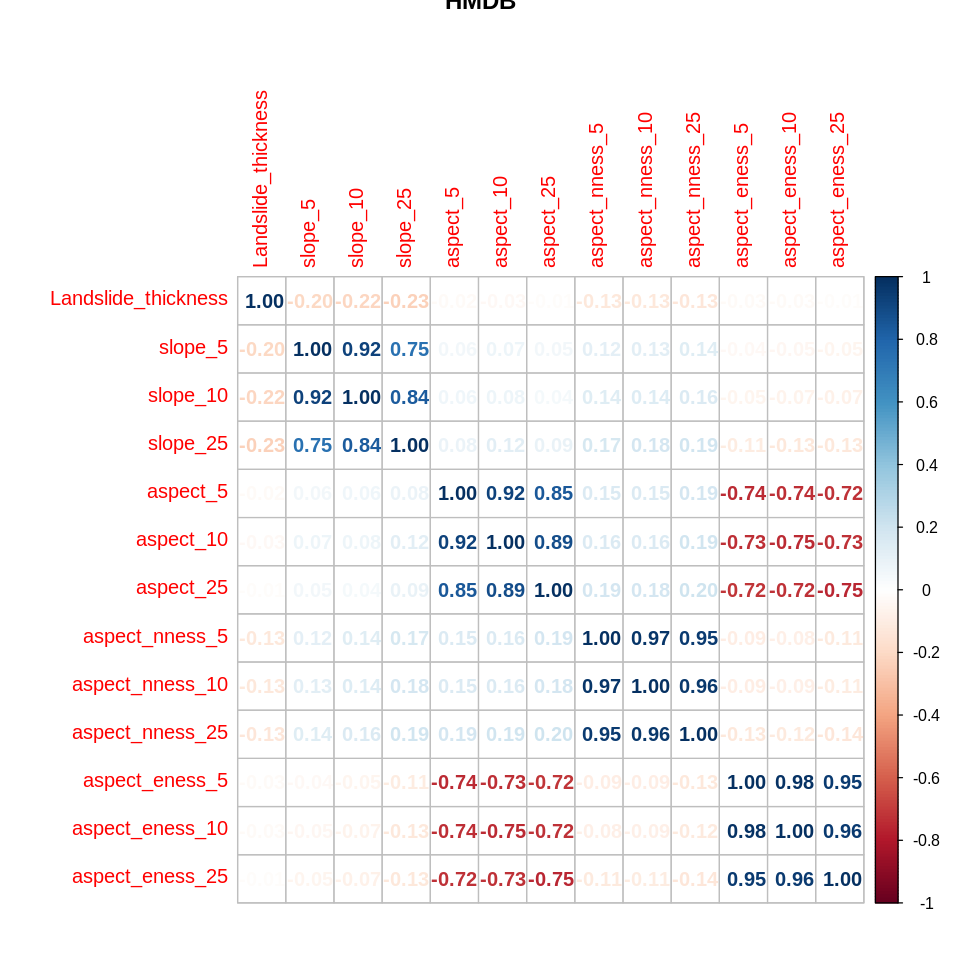

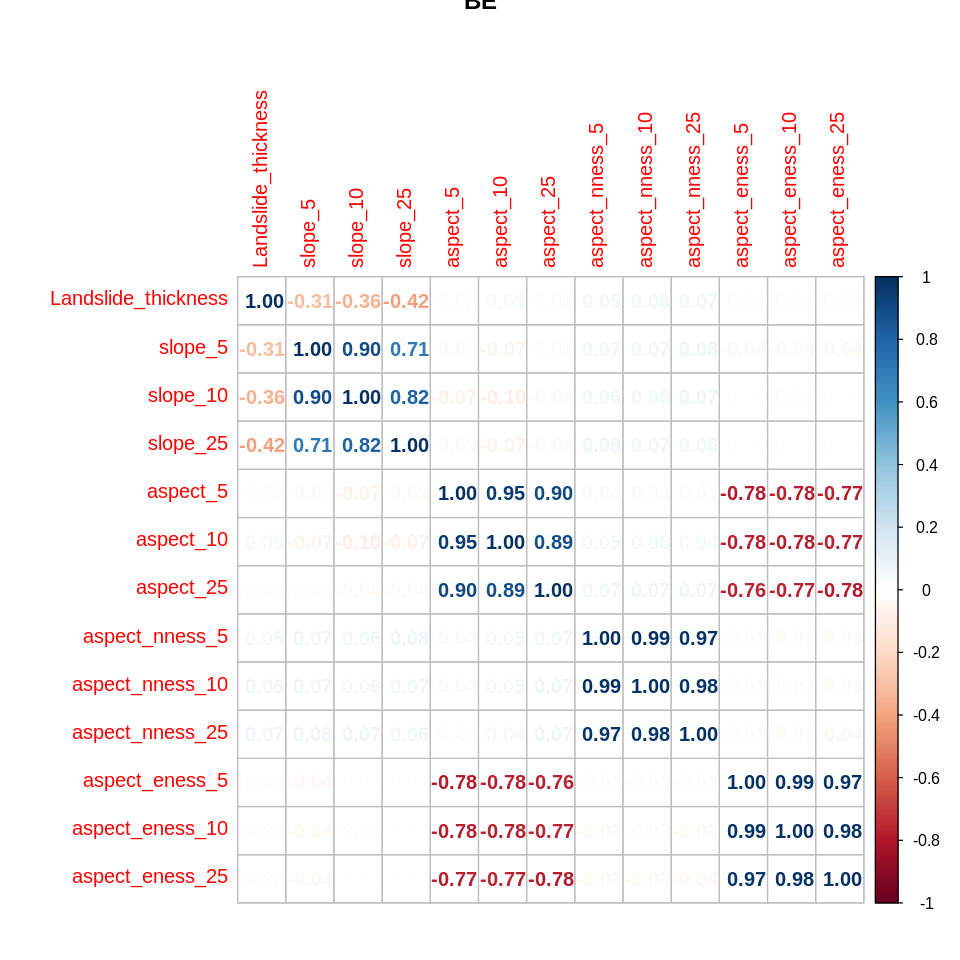

In [95]:

cor_cols <- c('Landslide_thickness','slope_5', 'slope_10', 'slope_25', 
                    'aspect_5', 'aspect_10', 'aspect_25', 
             'aspect_nness_5', 'aspect_nness_10', 'aspect_nness_25', 'aspect_eness_5', 'aspect_eness_10', 'aspect_eness_25')

plot_correlation_by_dataset(cor_cols,width=8,height=8)

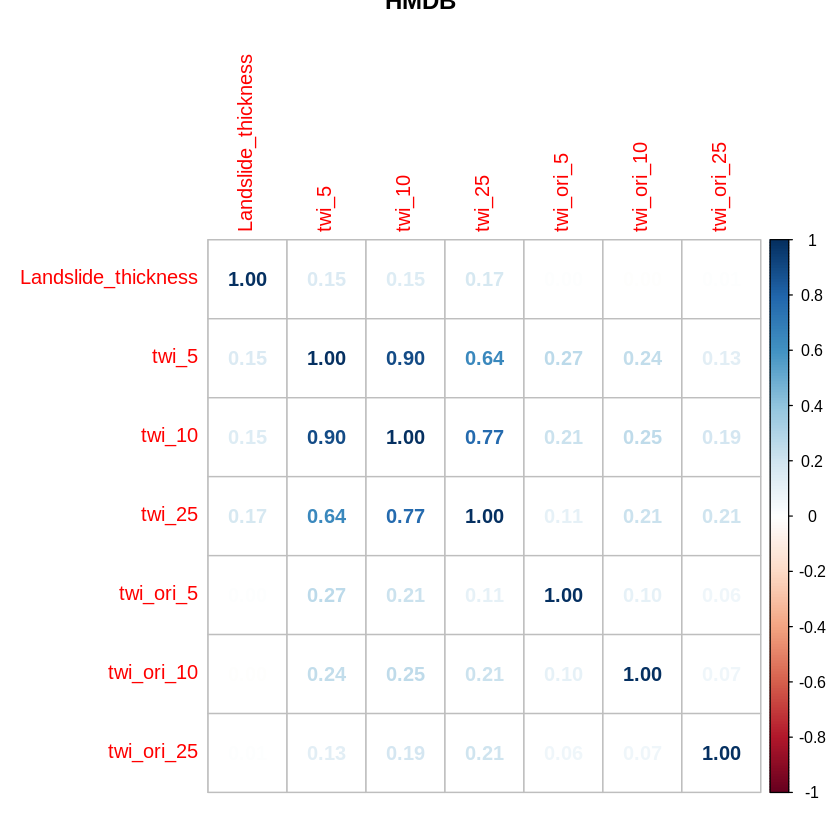

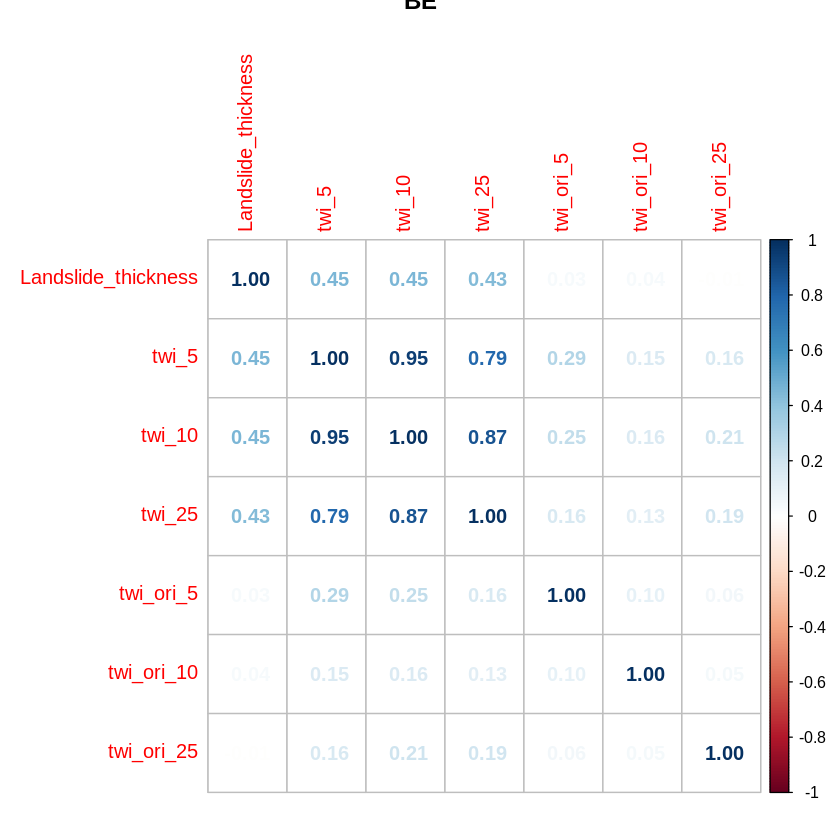

In [96]:
cor_cols <- c('Landslide_thickness','twi_5', 'twi_10', 'twi_25', 'twi_ori_5', 'twi_ori_10', 'twi_ori_25'
         )

plot_correlation_by_dataset(cor_cols)

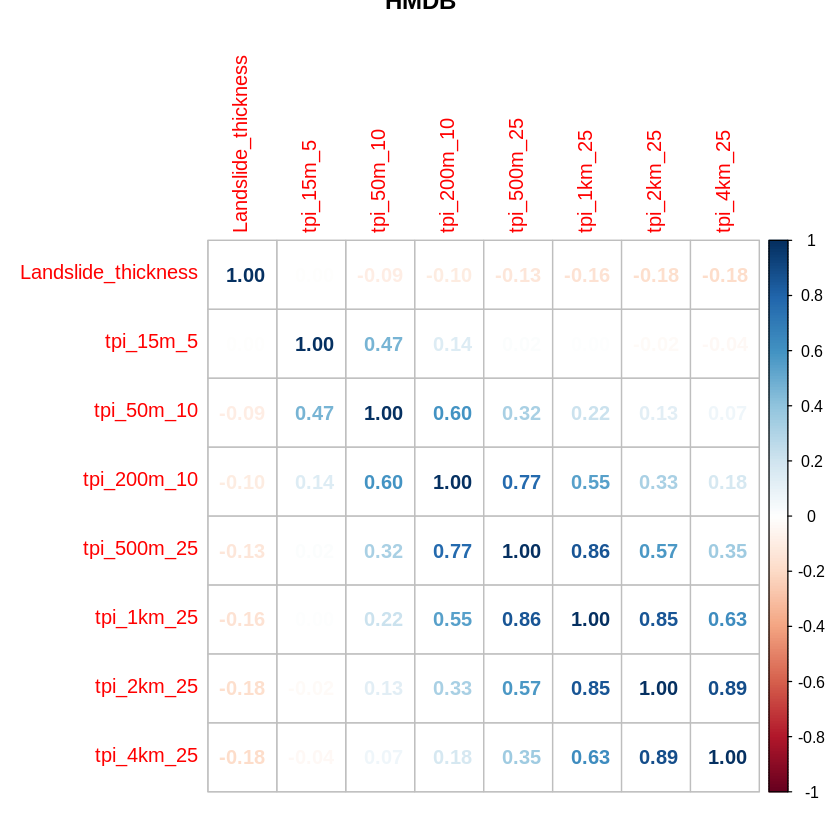

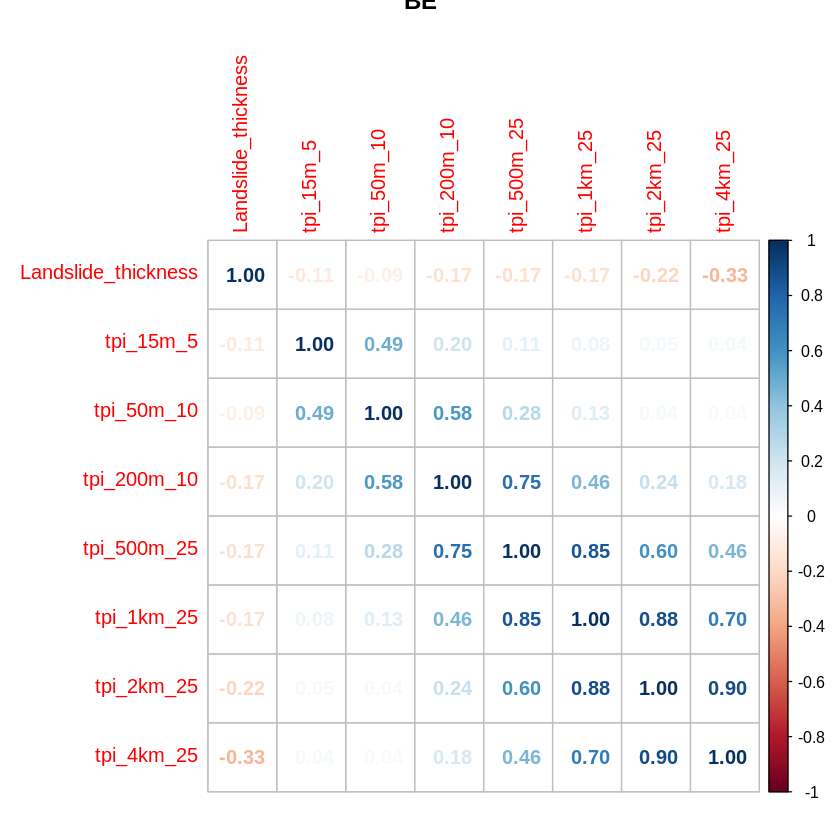

In [97]:
cor_cols <- c('Landslide_thickness','tpi_15m_5', 'tpi_50m_10', 
                    'tpi_200m_10', 'tpi_500m_25', 'tpi_1km_25', 'tpi_2km_25', 'tpi_4km_25'
         )

plot_correlation_by_dataset(cor_cols)

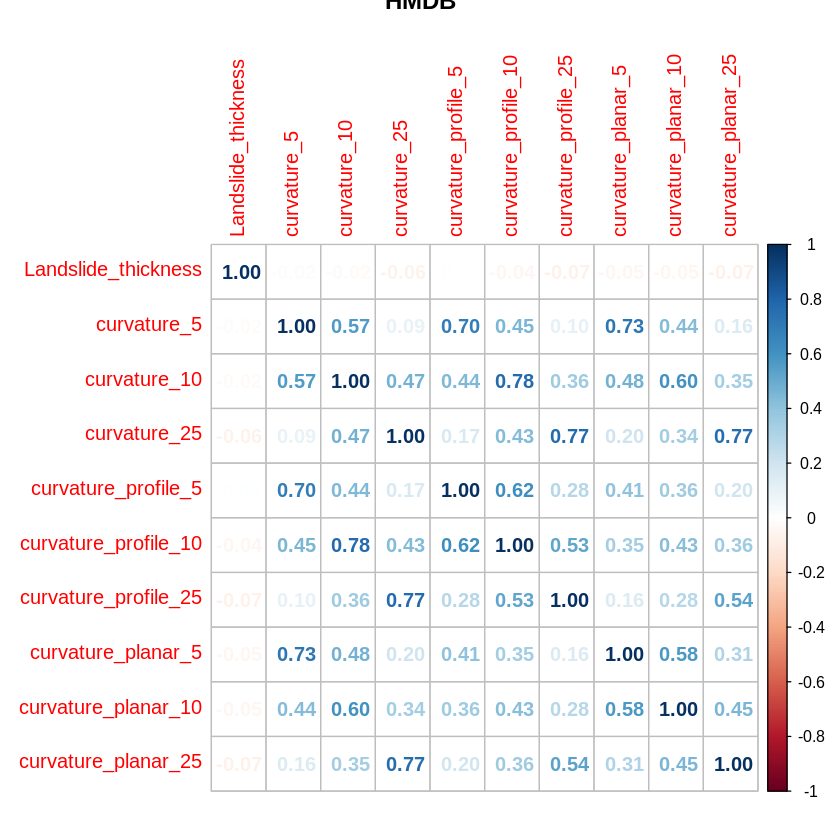

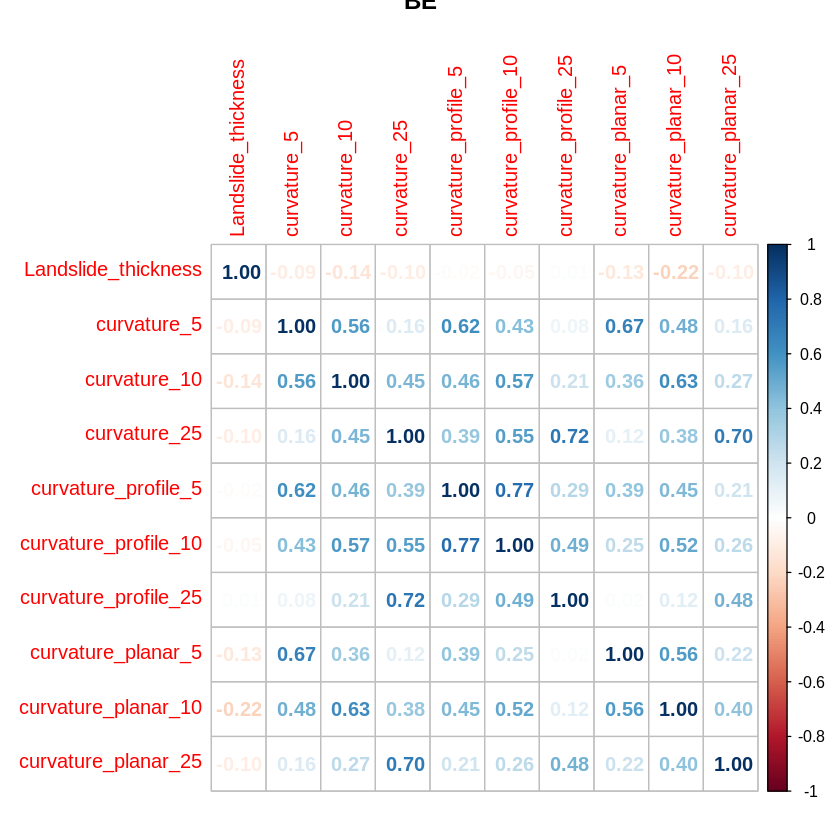

In [98]:
 
cor_cols <- c('Landslide_thickness','curvature_5', 'curvature_10', 'curvature_25', 'curvature_profile_5', 'curvature_profile_10',
                    'curvature_profile_25', 'curvature_planar_5', 'curvature_planar_10', 'curvature_planar_25'
         )

plot_correlation_by_dataset(cor_cols)

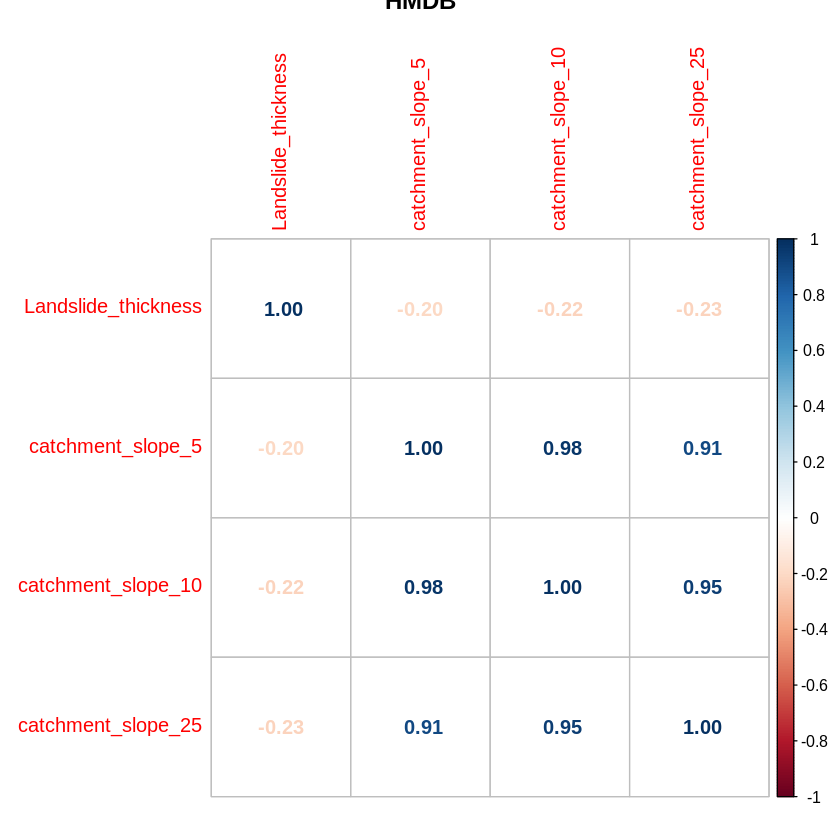

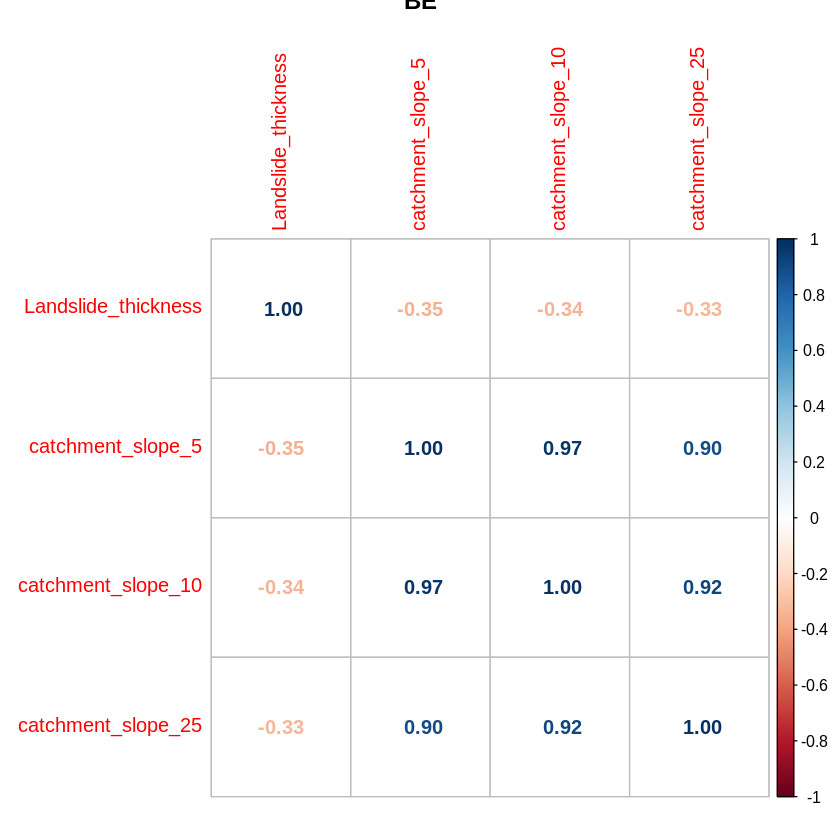

In [99]:
 
cor_cols <- c('Landslide_thickness','catchment_slope_5', 'catchment_slope_10', 'catchment_slope_25'
         )

plot_correlation_by_dataset(cor_cols)

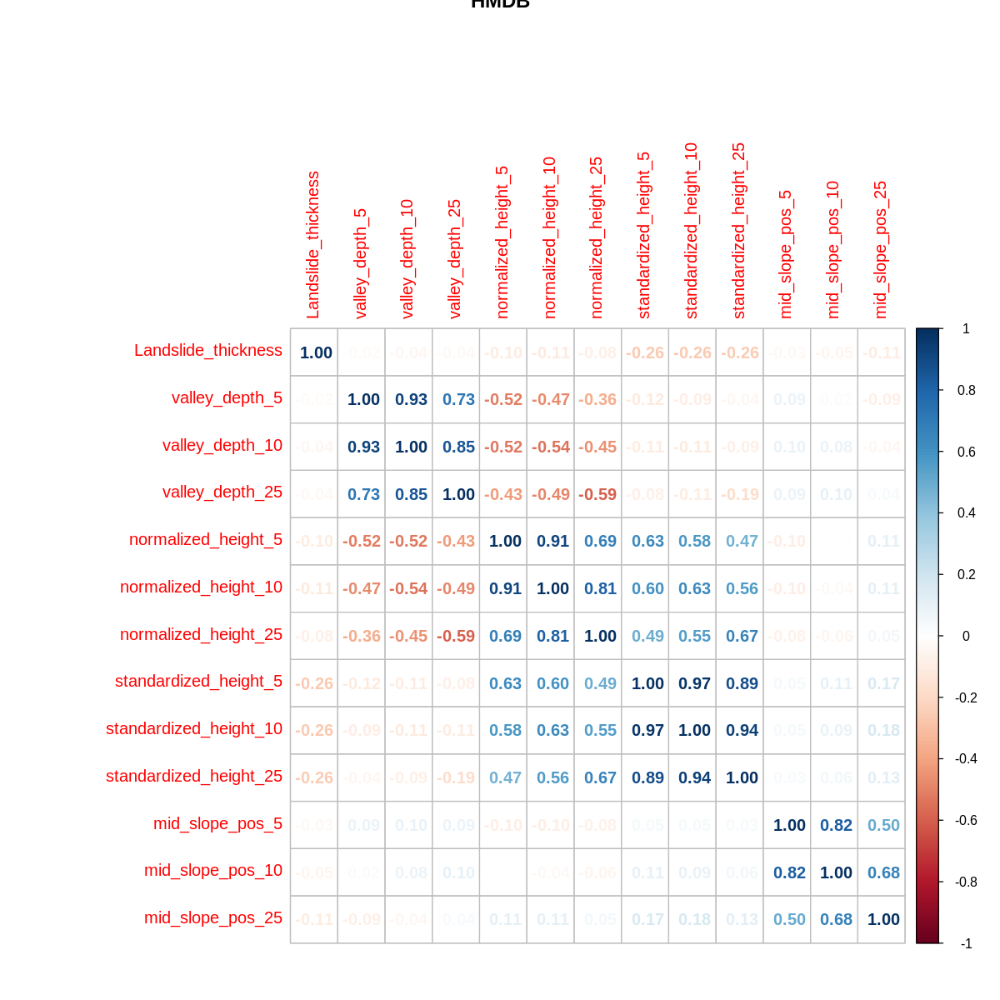

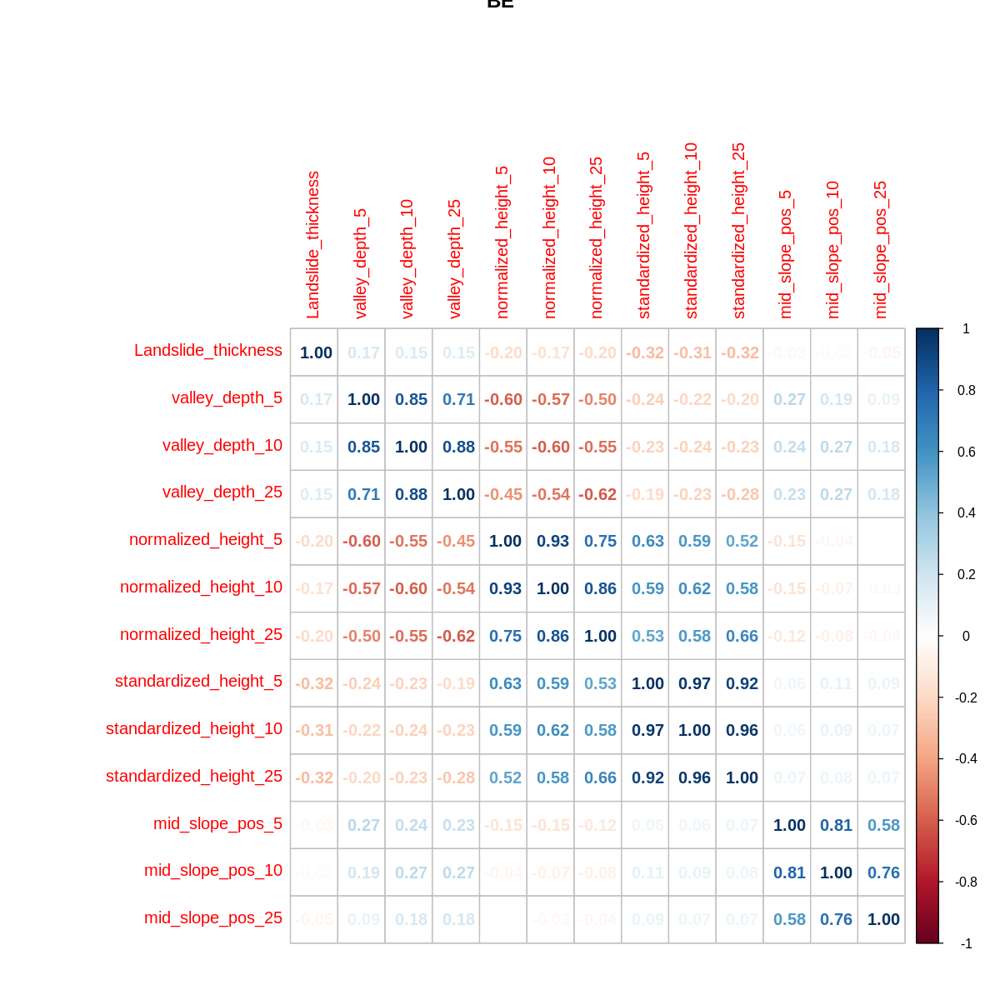

In [100]:
 
cor_cols <- c('Landslide_thickness',                    'valley_depth_5', 'valley_depth_10', 'valley_depth_25', 'normalized_height_5', 'normalized_height_10', 'normalized_height_25', 
                    'standardized_height_5', 'standardized_height_10', 'standardized_height_25', 'mid_slope_pos_5', 'mid_slope_pos_10', 'mid_slope_pos_25'

         )

plot_correlation_by_dataset(cor_cols,width=10,height=10)

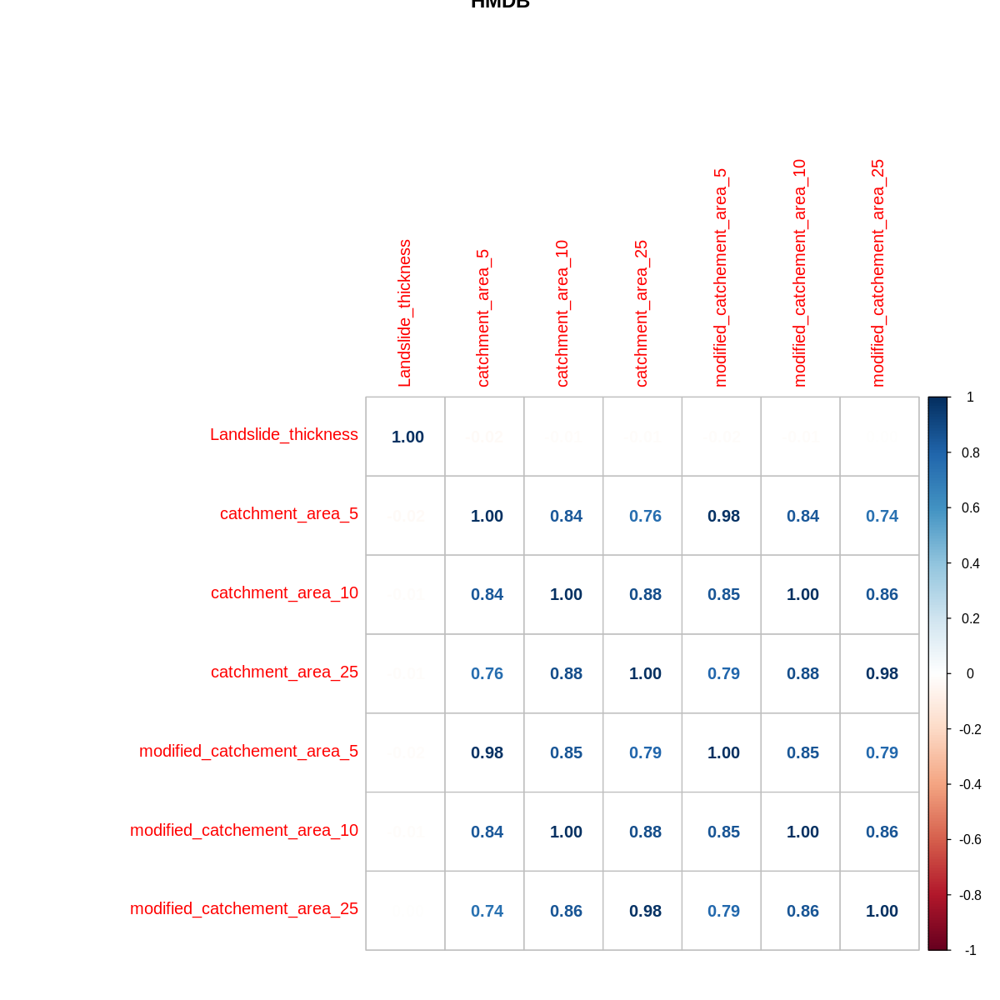

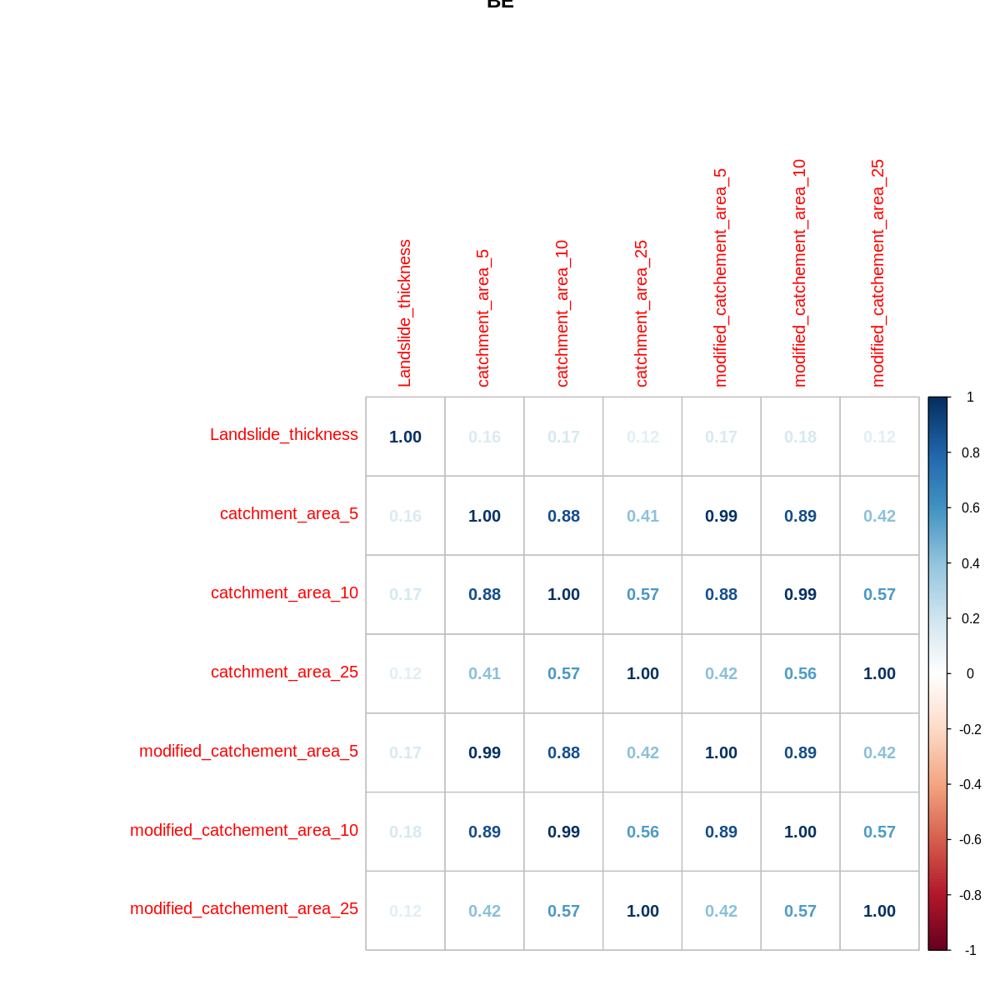

In [101]:
 
cor_cols <- c('Landslide_thickness',  
              'catchment_area_5', 'catchment_area_10', 'catchment_area_25', 
                    'modified_catchement_area_5', 'modified_catchement_area_10', 'modified_catchement_area_25'

         )

plot_correlation_by_dataset(cor_cols,width=10,height=10)

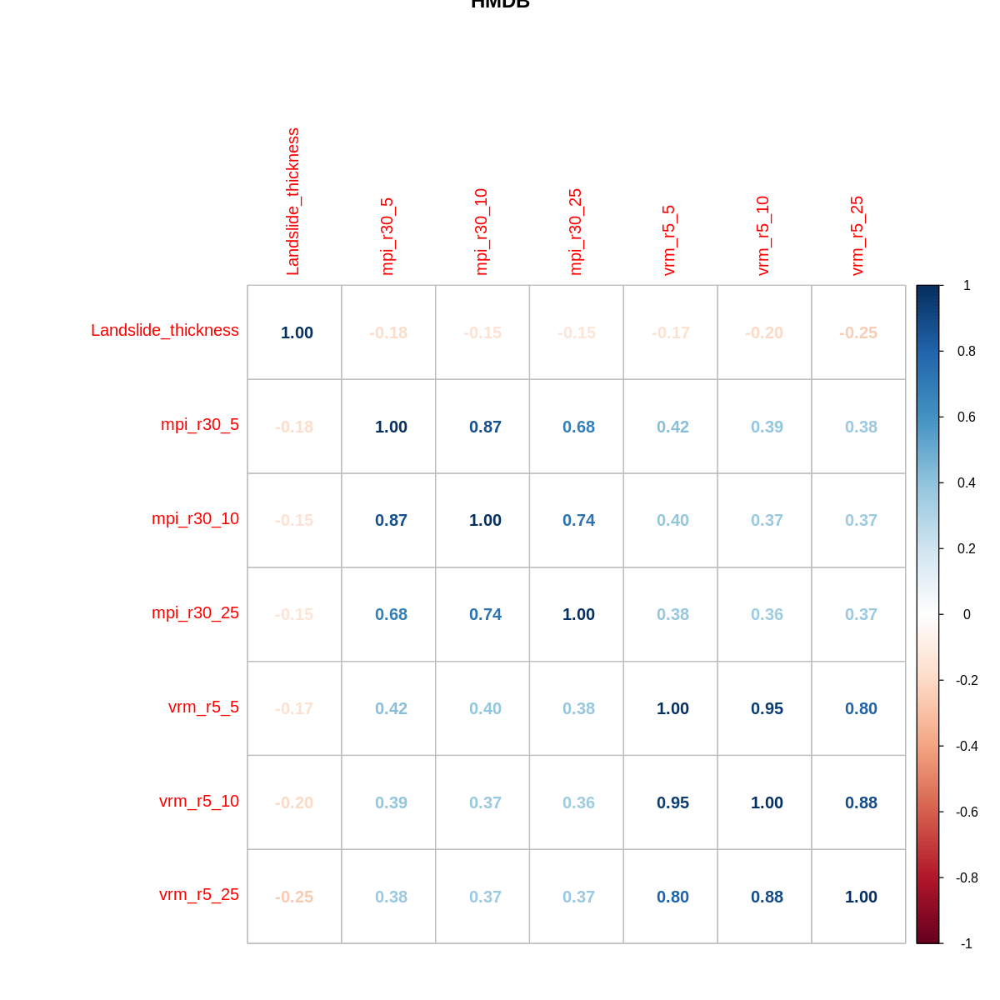

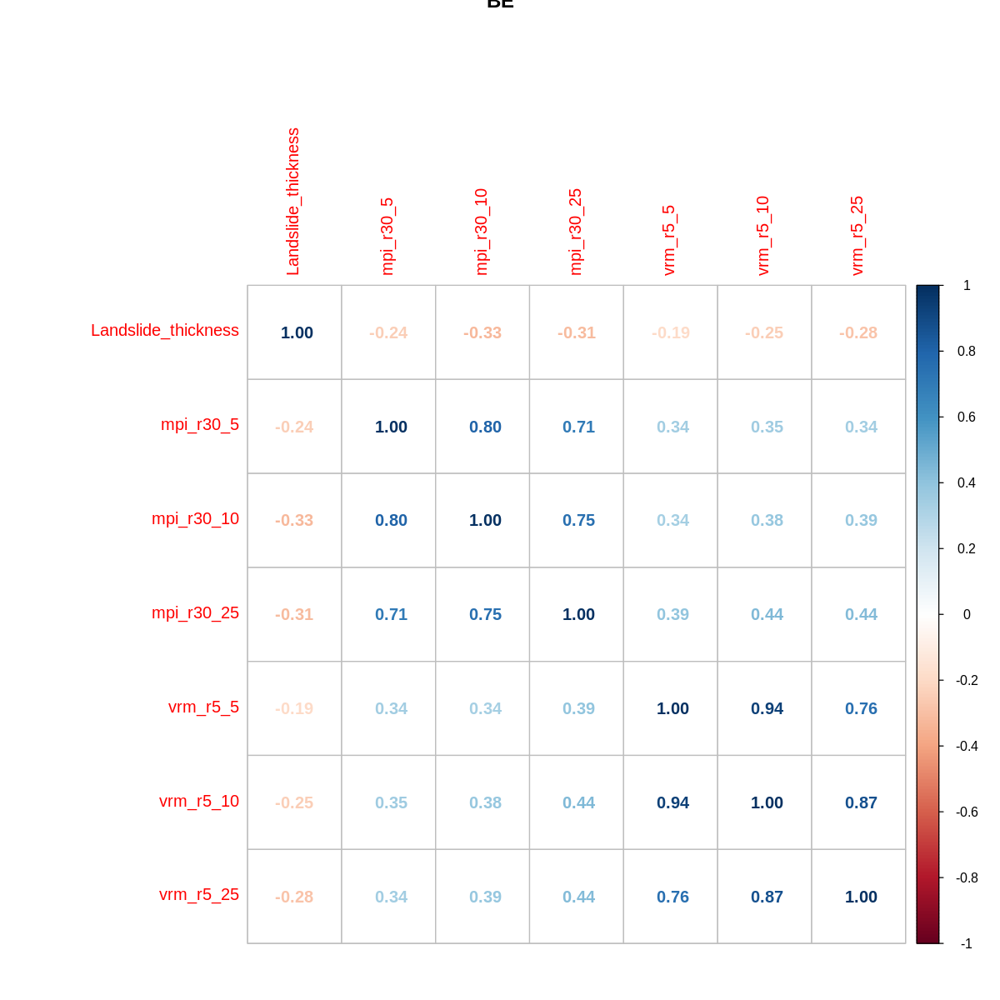

In [102]:
 
cor_cols <- c('Landslide_thickness',  
              'mpi_r30_5', 'mpi_r30_10', 'mpi_r30_25', 
                    'vrm_r5_5', 'vrm_r5_10', 'vrm_r5_25'

         )

plot_correlation_by_dataset(cor_cols,width=10,height=10)

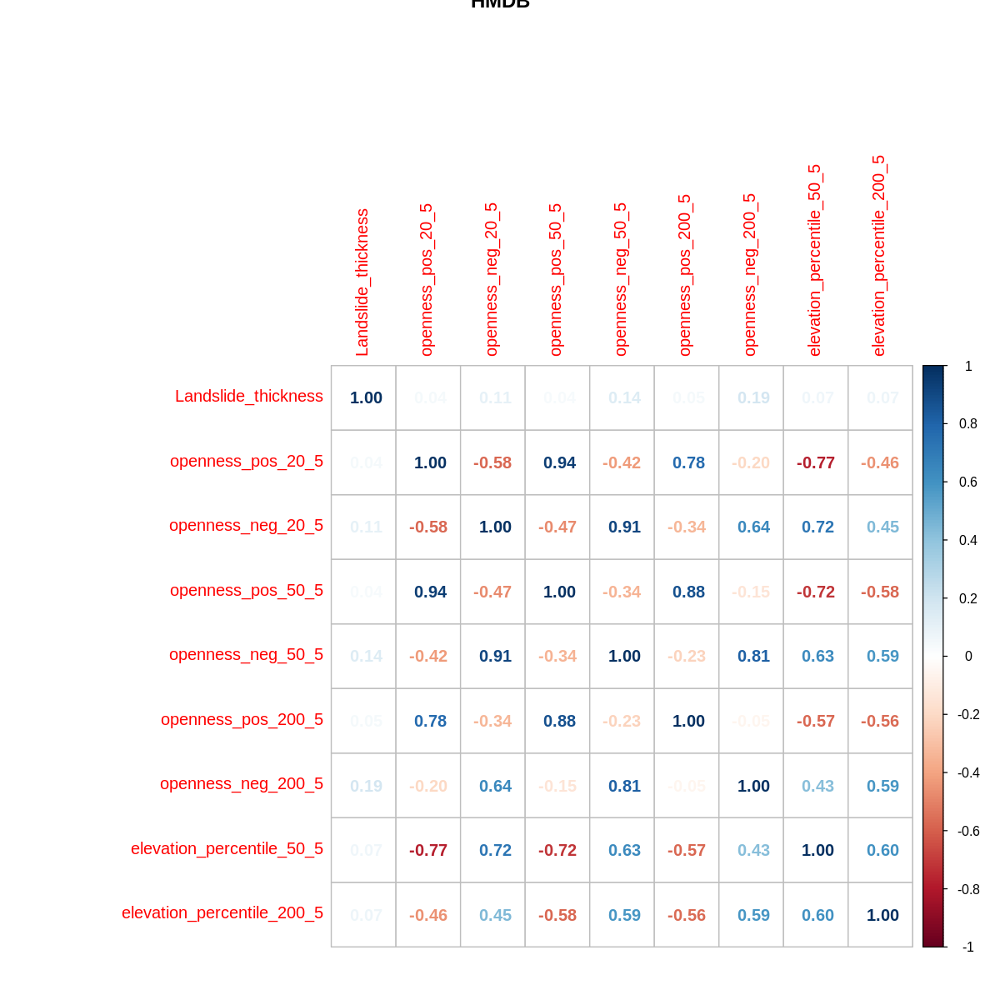

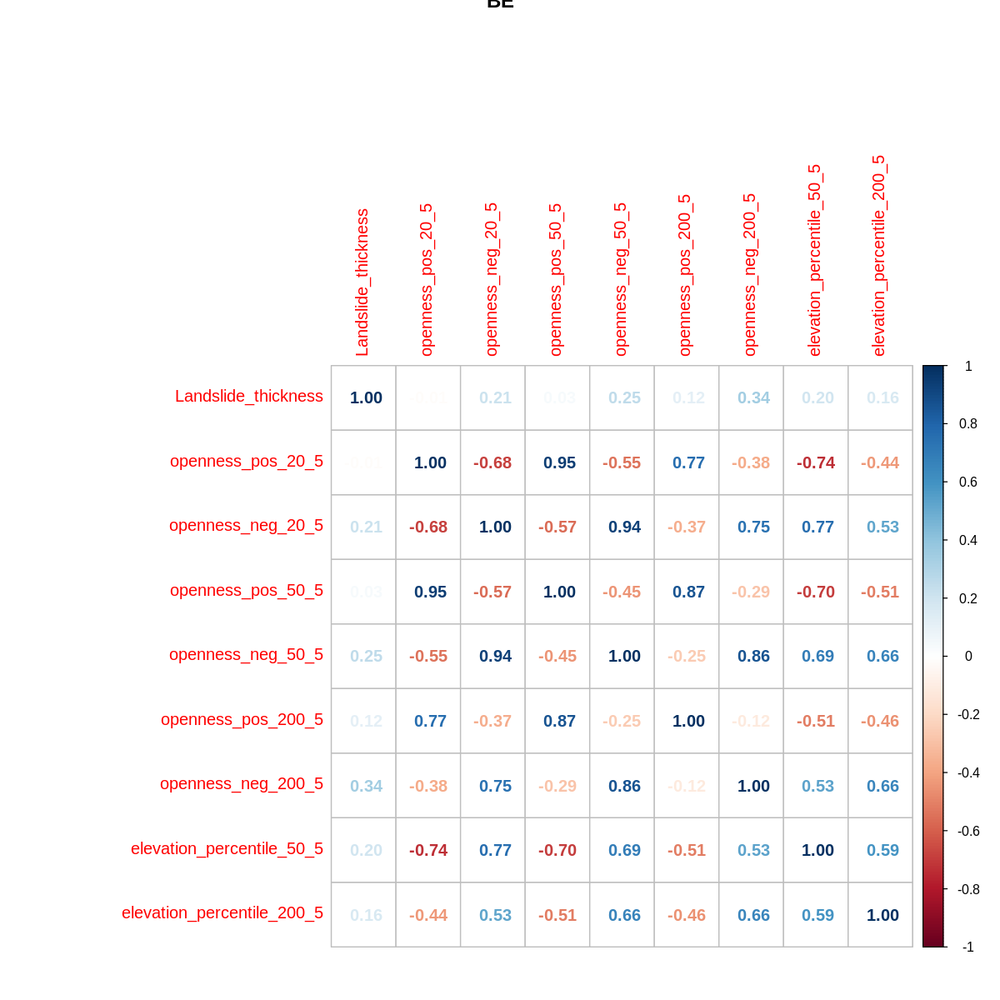

In [103]:
 
cor_cols <- c('Landslide_thickness',  
              'openness_pos_20_5', 'openness_neg_20_5', 
                    'openness_pos_50_5', 'openness_neg_50_5', 
                     'openness_pos_200_5', 'openness_neg_200_5', 
              'elevation_percentile_50_5', 'elevation_percentile_200_5'

         )

plot_correlation_by_dataset(cor_cols,width=10,height=10)

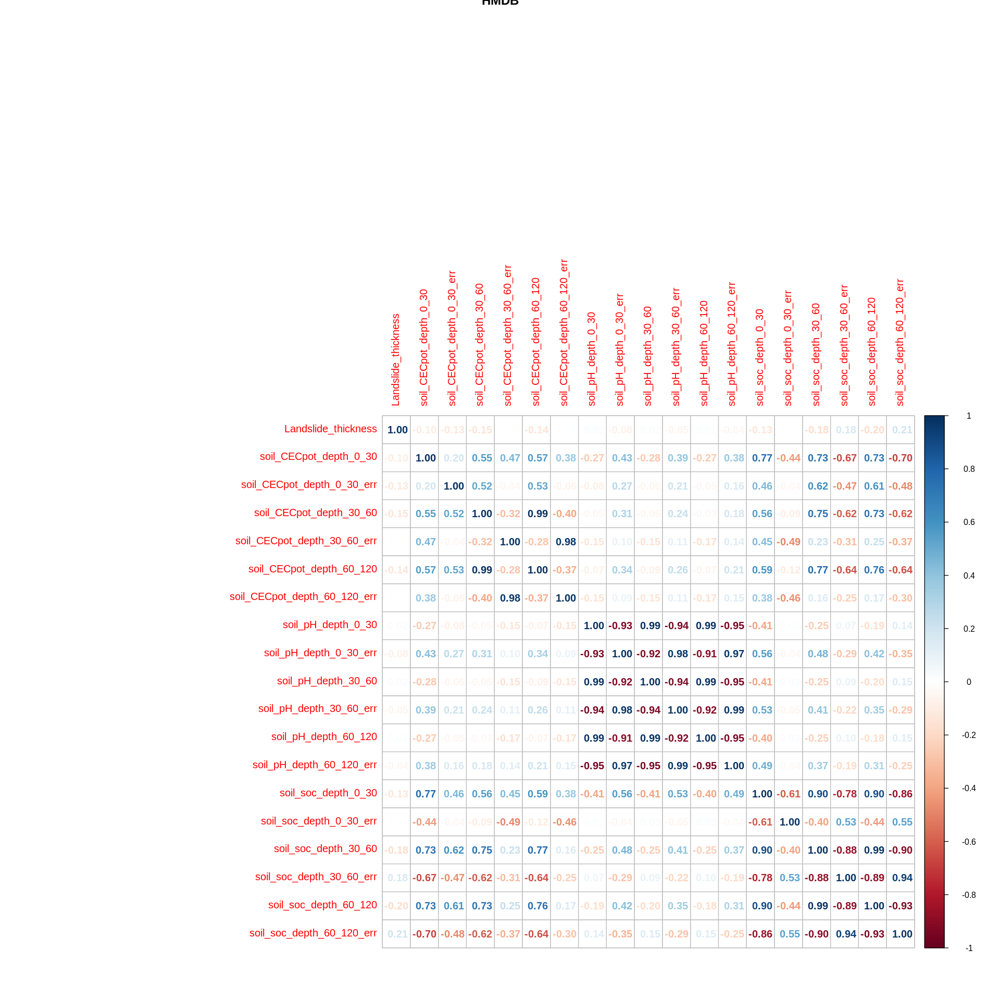

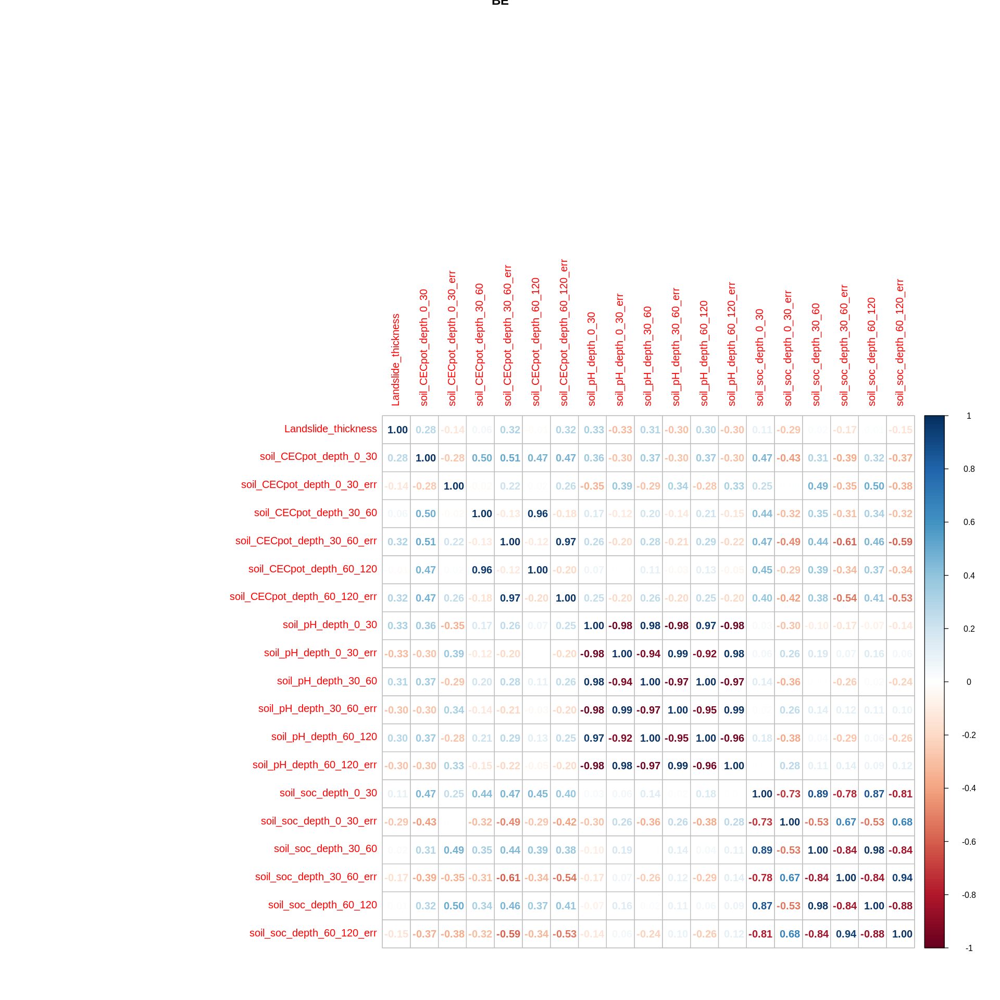

In [104]:
 
cor_cols <- c('Landslide_thickness',  
              'soil_CECpot_depth_0_30', 'soil_CECpot_depth_0_30_err', 'soil_CECpot_depth_30_60', 'soil_CECpot_depth_30_60_err', 'soil_CECpot_depth_60_120', 'soil_CECpot_depth_60_120_err',
                   'soil_pH_depth_0_30', 'soil_pH_depth_0_30_err', 'soil_pH_depth_30_60', 'soil_pH_depth_30_60_err', 'soil_pH_depth_60_120', 'soil_pH_depth_60_120_err',
                   'soil_soc_depth_0_30', 'soil_soc_depth_0_30_err', 'soil_soc_depth_30_60', 'soil_soc_depth_30_60_err', 'soil_soc_depth_60_120', 'soil_soc_depth_60_120_err'

         )

plot_correlation_by_dataset(cor_cols,width=16,height=16)



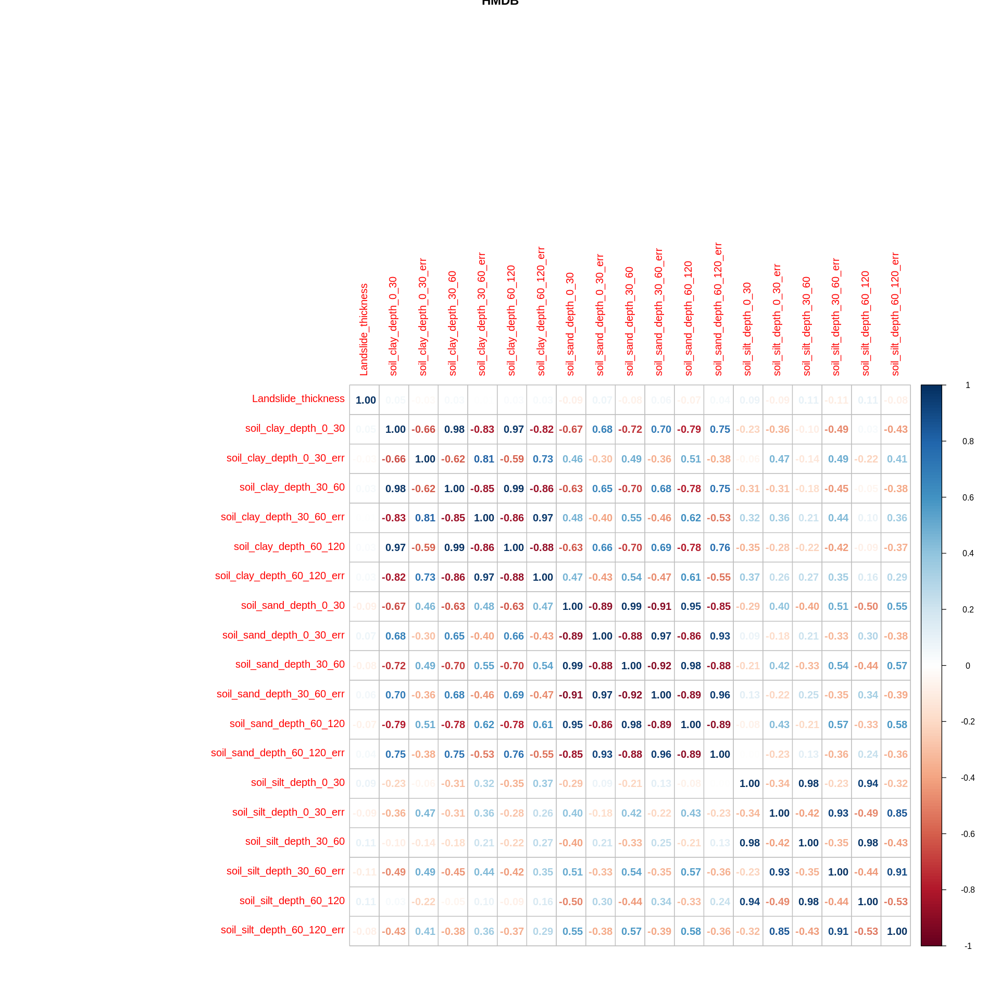

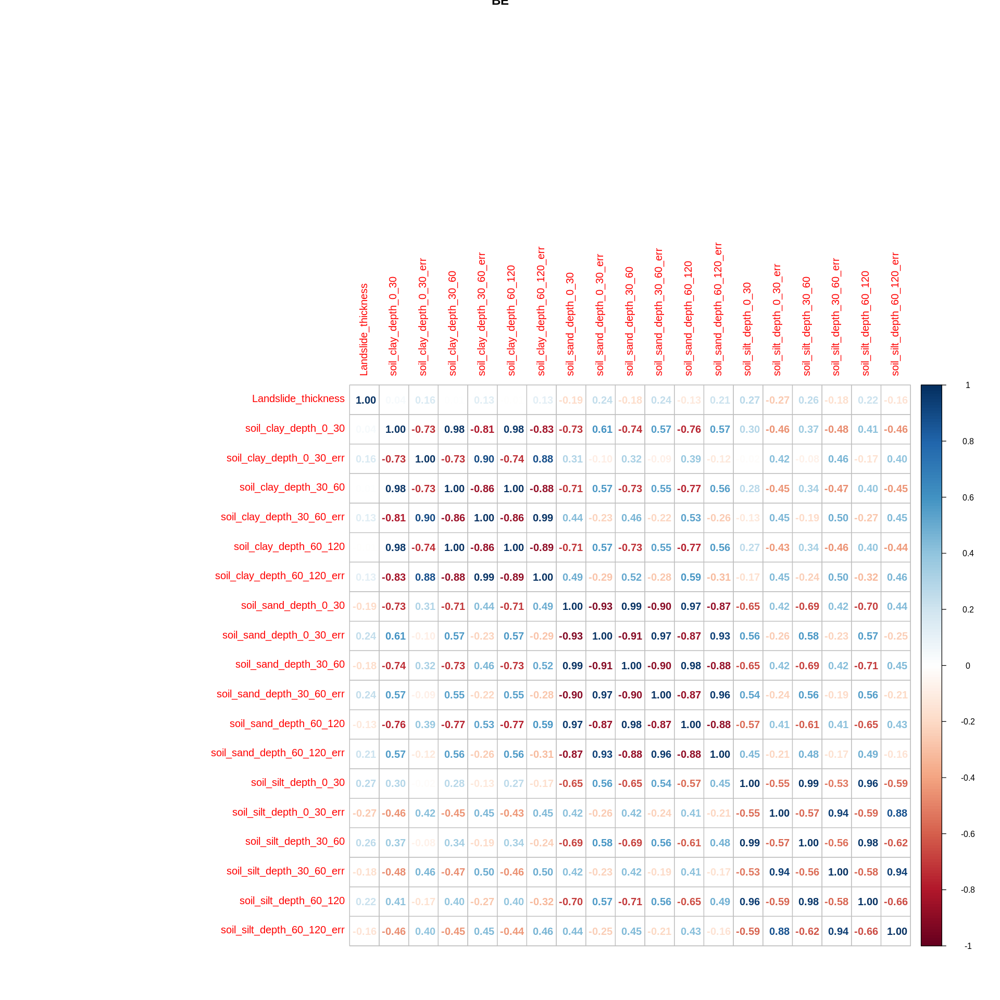

In [105]:
 
cor_cols <- c('Landslide_thickness',  
             'soil_clay_depth_0_30', 'soil_clay_depth_0_30_err', 'soil_clay_depth_30_60', 'soil_clay_depth_30_60_err', 'soil_clay_depth_60_120', 'soil_clay_depth_60_120_err',
                   'soil_sand_depth_0_30', 'soil_sand_depth_0_30_err', 'soil_sand_depth_30_60', 'soil_sand_depth_30_60_err', 'soil_sand_depth_60_120', 'soil_sand_depth_60_120_err',
                   'soil_silt_depth_0_30', 'soil_silt_depth_0_30_err', 'soil_silt_depth_30_60', 'soil_silt_depth_30_60_err', 'soil_silt_depth_60_120', 'soil_silt_depth_60_120_err'
         )

plot_correlation_by_dataset(cor_cols,width=16,height=16)



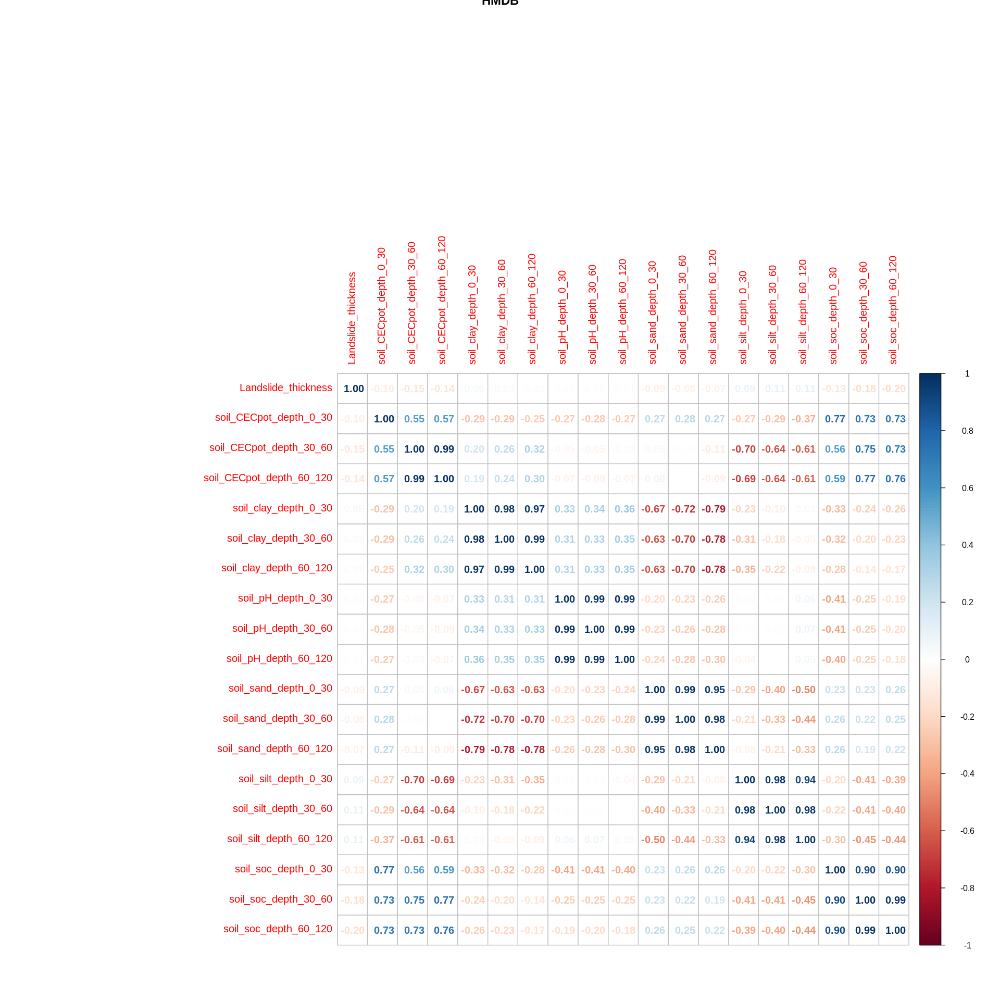

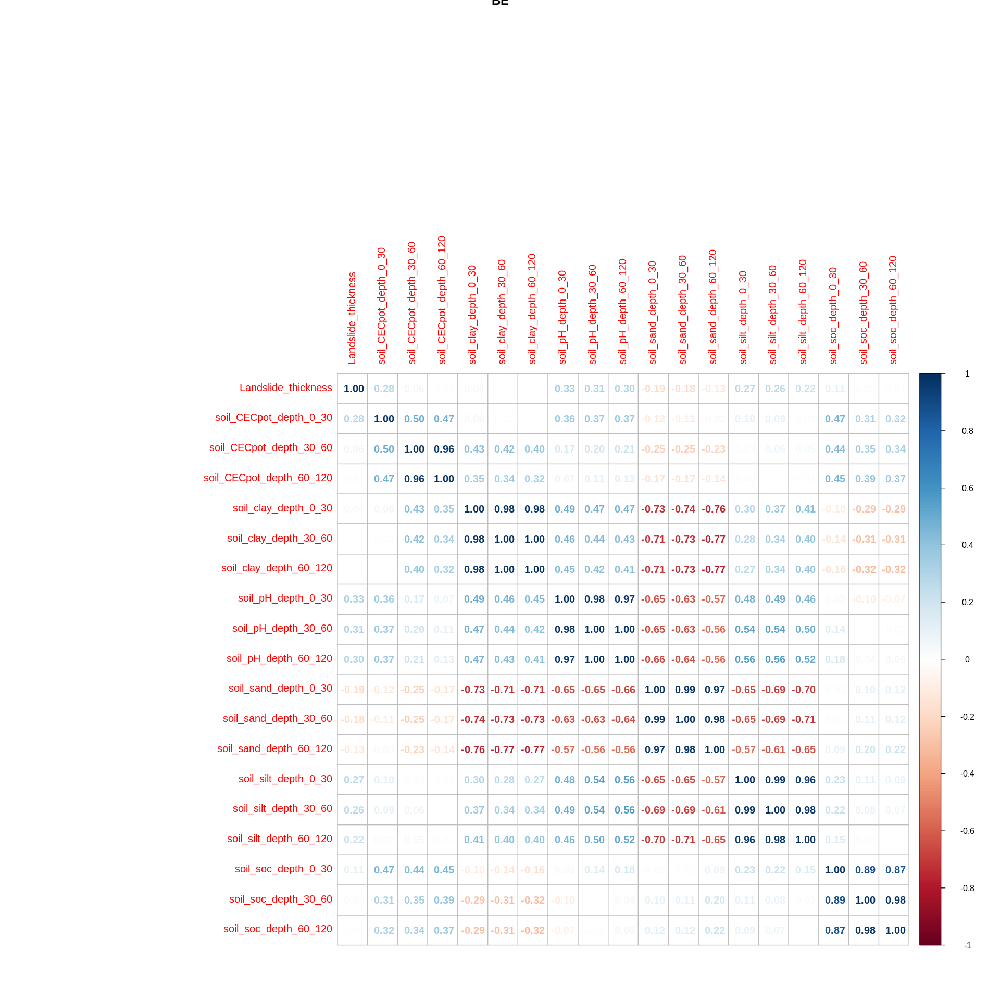

In [106]:
 
cor_cols <- c('Landslide_thickness',  
                                 'soil_CECpot_depth_0_30', 'soil_CECpot_depth_30_60', 'soil_CECpot_depth_60_120', 
                    'soil_clay_depth_0_30', 'soil_clay_depth_30_60', 'soil_clay_depth_60_120',
                    'soil_pH_depth_0_30',  'soil_pH_depth_30_60', 'soil_pH_depth_60_120', 
                    'soil_sand_depth_0_30', 'soil_sand_depth_30_60', 'soil_sand_depth_60_120', 
                    'soil_silt_depth_0_30', 'soil_silt_depth_30_60', 'soil_silt_depth_60_120', 
                    'soil_soc_depth_0_30',  'soil_soc_depth_30_60', 'soil_soc_depth_60_120'
         )

plot_correlation_by_dataset(cor_cols,width=16,height=16)



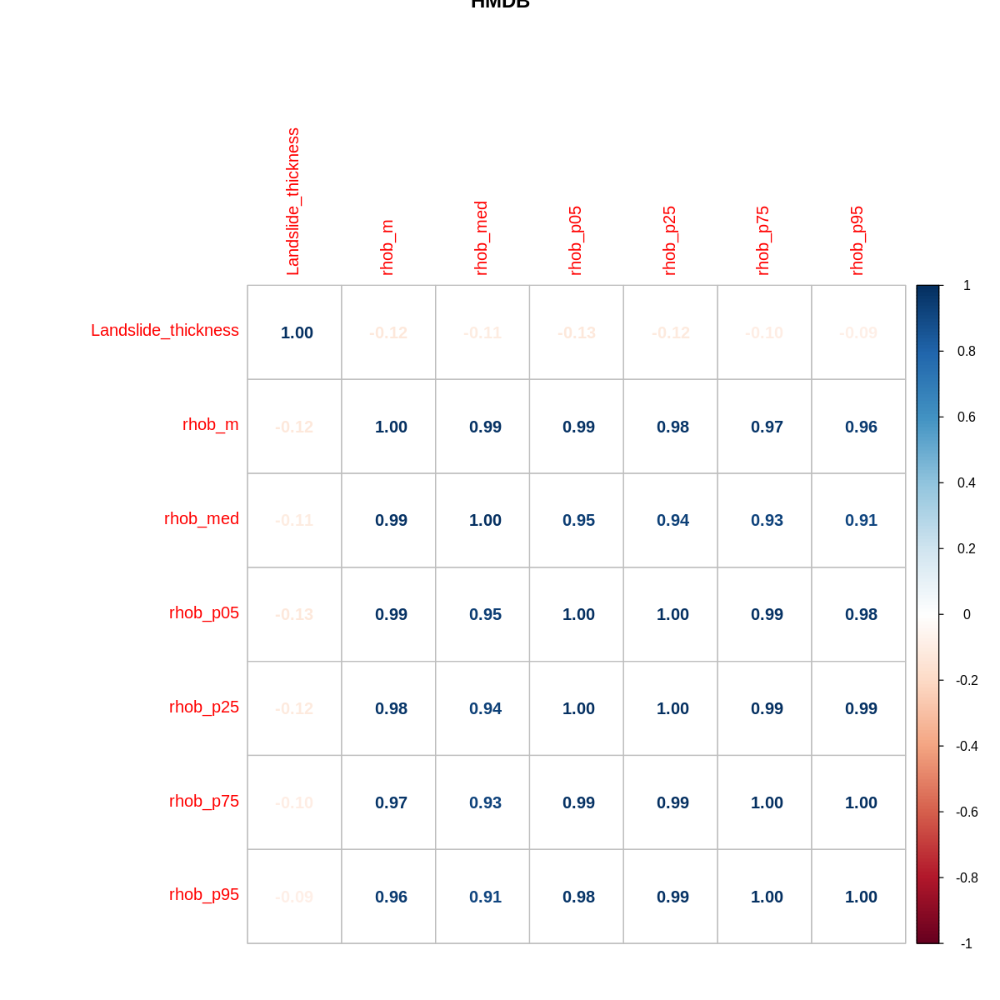

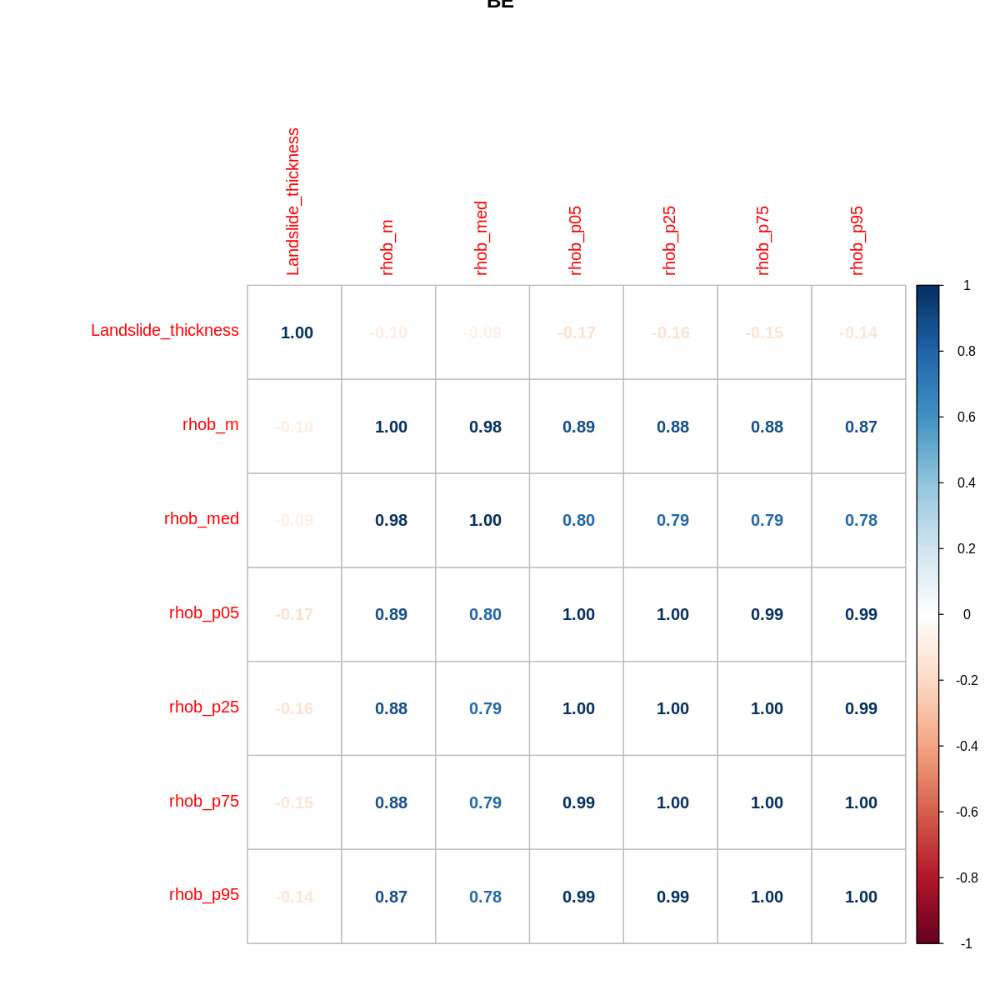

In [107]:
 
cor_cols <- c('Landslide_thickness',  
                                 'rhob_m', 'rhob_med', 'rhob_p05', 'rhob_p25', 'rhob_p75', 'rhob_p95'
         )

plot_correlation_by_dataset(cor_cols,width=10,height=10                           )



<a id="Paper"></a>
# Paper

<a id="Paper_Model"></a>
## Model

<a id="Paper_Model_Configuration"></a>
### Configuration

General configurations for the modelling part of the analysis.

In [108]:
library(caret) # for model tuning

library(ranger) # for random forest models
library(ggplot2) # for graphics 
library(pdp) # for partial dependence plots
library(gridExtra )

library(parallel)
library(mgcv)

Loading required package: lattice


Attaching package: ‘caret’


The following objects are masked from ‘package:measures’:

    MAE, RMSE


The following object is masked from ‘package:purrr’:

    lift


The following objects are masked from ‘package:Metrics’:

    precision, recall



Attaching package: ‘pdp’


The following object is masked from ‘package:purrr’:

    partial



Attaching package: ‘gridExtra’


The following object is masked from ‘package:dplyr’:

    combine


Loading required package: nlme


Attaching package: ‘nlme’


The following object is masked from ‘package:dplyr’:

    collapse


This is mgcv 1.8-39. For overview type 'help("mgcv-package")'.



In [109]:
seed <- 0
train_size <- 0.8

In [110]:
seq.mtry <- 1:(length(100) - 1)
# Only take every fifth mtry to speed up tuning
seq.mtry <- seq.mtry[ seq.mtry %% 5 == 0 ] 

rf.tune.grid <- expand.grid(mtry = seq.mtry
                      ,splitrule = c("variance")
                      ,min.node.size = c(5)
                      )

rf.tc.cv <- trainControl(method="cv", number = 10
                                 #, verboseIter = T
                                 #, classProbs = T
                                )

rf.tc.rcv <- trainControl(method = "repeatedcv",
                                 number = 10,
                                 repeats = 10,
                                 #, verboseIter = T
                                 #, classProbs = T
                                )

rf.tc.oob = trainControl(method="oob"
                                )


In [111]:
#Defining the column sets used for the analysis
y_col <- c('Landslide_thickness')
y_col_perp <- c('Landslide_thickness_perp')




<a id="Model_Functions"></a>
### Model Functions

Functions used to train and validate the models for landslide thickness prediction.

<a id="General_Functions"></a>
#### General Functions

In [112]:
r_square <- function(y_actual,y_predict){
  cor(y_actual,y_predict)^2
}

# rsq2 <- function(y_actual,y_predict){
#   1 - sum((y_actual-y_predict)^2)/sum((y_acual-mean(y_actual))^2)
# }

# cov2 <- function(y_actual,y_predict){
#   sum((y_actual-mean(y_actual))*(y_predict-mean(y_predict)))/length(y_actual)
# }

# cor2 <- function(y_actual,y_predict){
#   sum((y_actual-mean(y_actual))*(y_predict-mean(y_predict)))/(sqrt(sum((y_actual-mean(y_actual))^2))*sqrt(sum((y_predict-mean(y_predict))^2)))
# }

mase <- function(y_actual,y_predict){
  mean(abs(y_actual-y_predict)/mean(abs(y_predict-mean(y_actual))))
}

# smape <- function(y_actual, y_predict) {
#     2 * abs(y_actual-y_predict) / (abs(y_actual) + abs(y_predict)))
# }

In [113]:
# Calculating performance measures for the specified prediction results. Optionally plotting the results.
score_model <- function(actual, pred, actual_label = 'Landslide thickness', title = '', plot = TRUE, rm.na=FALSE, facet=NA){
    
    if (plot) {
        font_base_size <- 18

        if(!is.na(facet)){
            df <- data.frame(Actual=actual, Prediction=pred, mao=facet)
            options(repr.plot.width=18, repr.plot.height=14)

            sc1 <- ggplot(df, aes(x=Actual, y=Prediction)) +
              facet_grid(mao ~ .,scales="free_y")  +
              geom_abline(intercept = 0, slope = 1, color="red") +
              geom_point(alpha=0.1, color="black") +
              xlim(0,3) +
              ylim(0,3) +
              # theme(text = element_text(size = 18)) +
              theme_light(base_size = font_base_size) +
              theme(legend.position="none")+
              xlab(paste0(actual_label," Actual")) +
              ylab(paste0(actual_label," Predicted")) 

            # plot(sc1)
            # options(repr.plot.width=8, repr.plot.height=8)
            df <- rbind(data.frame(value=actual, variable="Actual",mao=facet),data.frame(value=pred, variable="Prediction",mao=facet))

            ylim_max <- ((max(aggregate(df$value, by=list(round(df$value/0.1,0)-1), FUN=length)$x)%/%5)*5)
            # print(ylim_max)

            hp2 <- ggplot(df, aes(x=value, fill=variable, color=variable)) +
              geom_histogram(alpha=0.3, binwidth = 0.1, position="identity") +
              facet_grid(mao ~ .,scales="free_y")  + 
              theme_light(base_size = font_base_size) +
              theme(legend.position = c(0.8, 0.8)) +
              xlab(actual_label) +
              ylab("Count") +
              labs(fill="Detection Method",col="Detection Method")

            # plot(hp2)
            # options(repr.plot.width=12, repr.plot.height=8)
            grid.arrange(sc1, hp2, nrow = 1, widths = c(1, 1.5), top=grid::textGrob(title))

            df <- data.frame(Actual=actual, Prediction=pred, mao=facet)
            df.grouped <- group_by(.data=df, mao)            
            df.summary <-summarise(df.grouped
                                   ,mae= measures::MAE(actual,pred),mape=measures::MAPE(actual,pred),rmse=measures::RMSE(actual,pred),r2=r_square(actual,pred),n=n()
                                  )
            print(df.summary)
        }
        else {
            df <- data.frame(Actual=actual, Prediction=pred)
            options(repr.plot.width=18, repr.plot.height=7)


            sc1 <- ggplot(df, aes(x=Actual, y=Prediction)) +
              geom_abline(intercept = 0, slope = 1, color="red") +
              geom_point(alpha=0.1, color="black") +
              xlim(0,3) +
              ylim(0,3) +
              # theme(text = element_text(size = 18)) +
              theme_light(base_size = font_base_size) +
              theme(legend.position="none")+
              xlab(paste0(actual_label," Actual")) +
              ylab(paste0(actual_label," Predicted")) 

            # plot(sc1)
            # options(repr.plot.width=8, repr.plot.height=8)
            df <- rbind(data.frame(value=actual, variable="Actual"),data.frame(value=pred, variable="Prediction"))

            ylim_max <- ((max(aggregate(df$value, by=list(round(df$value/0.1,0)-1), FUN=length)$x)%/%5)*5)
            # print(ylim_max)

            hp2 <- ggplot(df, aes(x=value, fill=variable, color=variable)) +
              geom_histogram(alpha=0.3, binwidth = 0.1, position="identity") +
              theme_light(base_size = font_base_size) +
              theme(legend.position = c(0.8, 0.8)) +
              xlab(actual_label) +
              ylab("Count") +
              labs(fill="Detection Method",col="Detection Method")

            # plot(hp2)
            # options(repr.plot.width=12, repr.plot.height=8)
            grid.arrange(sc1, hp2, nrow = 1, widths = c(1, 1.5), top=grid::textGrob(title))
        }
    }
    
    

    #RSQ  1 - mse(actual,pred)/ var(actual)
    ret <- data.frame(mae= measures::MAE(actual,pred),mape=measures::MAPE(actual,pred),smape=Metrics::smape(actual,pred),rmse=measures::RMSE(actual,pred),r2=r_square(actual,pred), min_pred=min(pred), max_pred=max(pred), min_err=min(actual-pred), max_err=max(actual-pred), ae_p90=quantile(abs(actual-pred), probs=(0.9)) ,n=length(actual))
    return(ret)
}

# Merging a train and test scoring result into one row/tibble
merge_score_results <- function(method_label, train_label, test_label, data_train, results_train, data_test, results_test) {
    res <- tibble(method=method_label,train_dataset=train_label,test_dataset=test_label,
                  n_train=nrow(data_train),train_mae=results_train$mae,train_mape=results_train$mape,train_smape=results_train$smape,train_rmse=results_train$rmse,train_r2=results_train$r2,train_rsq=results_train$rsq, train_min_pred=results_train$min_pred, train_max_pred=results_train$max_pred, train_min_err = results_train$min_err, train_max_err = results_train$max_err, train_ae_p90 = results_train$ae_p90,
                  n_test=nrow(data_test),test_mae=results_test$mae,test_mape=results_train$mape,test_smape=results_train$smape,test_rmse=results_test$rmse,test_r2=results_test$r2,test_rsq=results_test$rsq,  test_min_pred=results_test$min_pred, test_max_pred=results_test$max_pred,  test_min_err = results_test$min_err, test_max_err = results_test$max_err, test_ae_p90 = results_test$ae_p90)
    return(res)
}


In [114]:
# Box plots of the model results by slope categories.
model_box_plot <- function(actual,predict,slope,bin_width=5,plot_resid=TRUE,facet=NA){
    font_base_size <- 18
    give.n <- function(x){
       return(c(y = 1.5, label = length(x)))
    }

    df <- data.frame(actual=actual, predict=predict, slope=slope, slope_class=as.factor(slope  %/% bin_width * bin_width), resid=predict-actual, mao=facet)

    
    if (!is.na(facet)) {
        options(repr.plot.width=18, repr.plot.height=14)

        p1 <- ggplot(df, aes(x=slope_class, y=predict)) + 
          geom_boxplot() +
          facet_grid(mao ~ .,scales="free_y")  +
          stat_summary(fun.y="mean",color="red") +
          stat_summary(fun.data = give.n, geom = "text", color="blue")+
          theme_light(base_size = font_base_size)+
          # guides(fill=FALSE) +
          xlab("Slope") +
          ylab("Landslide thickness Predicted")+
          labs(fill="")

        p2 <- ggplot(df, aes(x=slope_class, y=resid)) + 
          geom_boxplot() +
          facet_grid(mao ~ .,scales="free_y")  +
          stat_summary(fun.y="mean",color="red") +
          stat_summary(fun.data = give.n, geom = "text", color="blue")+
          theme_light(base_size = font_base_size) +
          xlab("Slope") +
          ylab("Residuals")+
          labs(fill="")
        
        
        
        grid.arrange(p1, p2, nrow = 1, widths = c(1, 1))

    } else {
        options(repr.plot.width=18, repr.plot.height=7)

        p1 <- ggplot(df, aes(x=slope_class, y=predict)) + 
          geom_boxplot() +
          stat_summary(fun.y="mean",color="red") +
          stat_summary(fun.data = give.n, geom = "text", color="blue")+
          theme_light(base_size = font_base_size)+
          xlab("Slope") +
          ylab("Landslide thickness Predicted")

        p2 <- ggplot(df, aes(x=slope_class, y=resid)) + 
          geom_boxplot() +
          stat_summary(fun.y="mean",color="red") +
          stat_summary(fun.data = give.n, geom = "text", color="blue")+
          theme_light(base_size = font_base_size) +
          xlab("Slope") +
          ylab("Residuals")

        # print(p1)
        # print(p2)
        grid.arrange(p1, p2, nrow = 1, widths = c(1, 1))

    }
    
    
}


*Moran's I*
https://en.wikipedia.org/wiki/Moran%27s_I
Values of I usually range from −1 to +1. Values significantly below -1/(N-1) indicate negative spatial autocorrelation and values significantly above -1/(N-1) indicate positive spatial autocorrelation. For statistical hypothesis testing, Moran's I values can be transformed to z-scores. 

https://www.statisticshowto.com/morans-i/
- -1 is perfect clustering of dissimilar values (you can also think of this as perfect dispersion).
- 0 is no autocorrelation (perfect randomness.)
- +1 indicates perfect clustering of similar values (it’s the opposite of dispersion).

https://pro.arcgis.com/en/pro-app/latest/tool-reference/spatial-statistics/what-is-a-z-score-what-is-a-p-value.htm
|z-score (Standard Deviations)|p-value (Probability)|Confidence level|
|----|----|----|
|< -1.65 or > +1.65|< 0.10|90%|
|< -1.96 or > +1.96|< 0.05|95%|
|< -2.58 or > +2.58|< 0.01|99%|

https://pro.arcgis.com/en/pro-app/latest/tool-reference/spatial-statistics/h-how-spatial-autocorrelation-moran-s-i-spatial-st.htm

Null Hypothesis: the attribute being analyzed is randomly distributed among the features in your study area
 
|||
|-|-|
|The p-value is not statistically significant.|You cannot reject the null hypothesis. It is quite possible that the spatial distribution of feature values is the result of random spatial processes. The observed spatial pattern of feature values could very well be one of many, many possible versions of complete spatial randomness (CSR).|
|The p-value is statistically significant, and the z-score is positive.|You may reject the null hypothesis. The spatial distribution of high values and/or low values in the dataset is more spatially clustered than would be expected if underlying spatial processes were random.|
|The p-value is statistically significant, and the z-score is negative.|You may reject the null hypothesis. The spatial distribution of high values and low values in the dataset is more spatially dispersed than would be expected if underlying spatial processes were random. A dispersed spatial pattern often reflects some type of competitive process—a feature with a high value repels other features with high values; similarly, a feature with a low value repels other features with low values.|

*Geary's C*

https://en.wikipedia.org/wiki/Geary%27s_C

The value of Geary's C lies between 0 and some unspecified value greater than 1. Values significantly lower than 1 demonstrate increasing positive spatial autocorrelation, whilst values significantly higher than 1 illustrate increasing negative spatial autocorrelation. 

https://gis.stackexchange.com/questions/84134/help-interpreting-morans-i-and-gearys-c-results

As for Geary's C, it ranges from 0 to 2 where 1 is no spatial autocorrelation (values vary through space independent of one another or randomly). C values near 0 are positively spatially correlated while those near 2 are highly negatively autocorrelated.

In [115]:
test_autocorrelation <- function(spdf, actual, predicted, cutoff = 100000, model="Sph") {
    
    print(paste("Cutoff", cutoff/1000, "km"))
    options(repr.plot.width=10, repr.plot.height=8)

    
    spdf$resid <- actual - predicted
    # print(plot(variogram(resid~1, spdf)))
    vrgrm <- variogram(resid~1,spdf,cutoff=cutoff)
    vrgrm.model <- fit.variogram(vrgrm,vgm(1,model,cutoff,1))
    print(plot(vrgrm, model=vrgrm.model))

    vrgrm.model2<- vgm(psill = 0, model, range = cutoff,  anis=c(0,0.5))
    vrgrm.dir <- variogram(resid~1, spdf, alpha=c(0,45,90,135))
    print(plot(vrgrm.dir, model=vrgrm.model))
        
    # spdf.dists <- as.matrix(dist(cbind(spdf$X, spdf$Y)))
    # spdf.dists.inv <- 1/spdf.dists
    # diag(spdf.dists.inv) <- 0
    # spdf.weights <- mat2listw(spdf.dists.inv)

    dnn <- dnearneigh(cbind(spdf$X, spdf$Y), 0, cutoff)
    spdf.weights <- nb2listw(dnn)

    
    tryCatch(
        {
               print(moran.test(spdf$resid,spdf.weights))
        },
        error=function(cond) {
           message("could not calculate moran.test")
        }
    )   
    
    tryCatch(
        {
               print(moran.mc(spdf$resid, spdf.weights, nsim = 999))
        },
        error=function(cond) {
           message("could not calculate moran.mc")
        }
    )   
    
    tryCatch(
        {
               print(geary.test(spdf$resid,spdf.weights))
        },
        error=function(cond) {
           message("could not calculate geary.test")
        }
    )   
    
    tryCatch(
        {
             print(geary.mc(spdf$resid, spdf.weights, nsim = 999))
        },
        error=function(cond) {
           message("could not calculate geary.mc")
        }
    )   
    
    
   
}


<a id="Random_Forests_Functions"></a>
#### Random Forests Functions

In [116]:
train_test_ranger_caret <- function(data, x_columns, y_column, label="", data_test=NA, plot=TRUE, printDetails=TRUE, return_model=FALSE, train_size=0.8, seed = 0, partition_column = "Failure_volume"){
    print(label)
    set.seed(seed)
    
    if(is.na(data_test)) {
        data <- data[!is.na(data[,partition_column]),]
        in_train <- createDataPartition(data[,partition_column], p = train_size)
        data_train <- data[in_train[[1]],]
        data_test <- data[-in_train[[1]],]
        
        
    } else {
        data_train <- data        
    }

    data_train <- data_train[, append(x_columns, y_column)]
    data_test <- data_test[, append(x_columns, y_column)]

    data_train <- data_train[complete.cases(data_train),]
    data_test <- data_test[complete.cases(data_test),]
    
    print(nrow(data_train))
    print(nrow(data_test))
    
    data_train_y <- data_train[,y_column]
    data_train_x <- data_train[,x_columns]
    
    data_test_y <- data_test[,y_column]
    data_test_x <- data_test[,x_columns]
    
    set.seed(seed)
    fd.model.caret <- train(
                         x=data_train_x,
                         y=data_train_y,
                         method = "ranger",
                         trControl = rf.tc.rcv,
                         #tuneGrid = rf.tune.grid,
                         tuneGrid = expand.grid(mtry=c(2,4,10,60,70),splitrule = "variance", min.node.size=c(1,2,4,6)),
                         num.trees = 100,
                         importance = "permutation", 
                            # seed = seed, 
                         classification = FALSE
                    )

    if (printDetails) {
        print(fd.model.caret)

        print(varImp(fd.model.caret))
    }
    
    pred_train <- predict(fd.model.caret, data = data_train)

    res_train <- score_model(data_train_y,pred_train,actual_label = y_column,plot=plot, title='Train Data')
    
    pred_test <- predict(fd.model.caret$finalModel,data = data_test)
    res_test <- score_model(data_test_y,pred_test$predictions,actual_label = y_column,plot=plot, title='Test Data')

    if(return_model) {
        res_model <- list(fd.model.caret)
    } else {
        res_model <- NULL
    }
    
    return( merge_score_results(method_label=label, train_label="", test_label="", data_train, res_train, data_test, res_test))
}





<a id="RF_Variable_Importance_Functions"></a>
##### RF Variable Importance Functions

In [117]:
var_importance_ranger_pure <- function (df, x, y, name="Merged", seed = 0) {
    set.seed(seed)
    data <- df[,append(x,y)]
    data <- data[complete.cases(data),]

    rf.fd <- ranger(x = data[,x],
                    y = data[,y], 
                    importance = "permutation", seed = seed, #probability = T,
                    classification = FALSE)                

    d.imp <- data.frame(variable = names(rf.fd$variable.importance), 
                        importance = rf.fd$variable.importance)
    d.imp <- d.imp[order(d.imp$importance, decreasing = T), ] 
    d.imp$importance<-(d.imp$importance/max(d.imp$importance))*100

    return (list(model=rf.fd, importance=d.imp, name=name ))
}

In [118]:
var_importance_ranger_caret <- function (df, x, y, name="Merged", seed = 0) {
    set.seed(seed)
    data <- df[,append(x,y)]
    data <- data[complete.cases(data),]

    # fd.model.caret <- train(Landslide_thickness  ~ ., data = df,
    fd.model.caret <- train(x = data[,x], y = data[,y], 
                     method = "ranger",
                     trControl = rf.tc.cv,
                     tuneGrid = expand.grid(mtry=c(2,4,6,65),splitrule = "variance", min.node.size=c(1,2,4,6)),
                     num.trees = 400,
                     replace = FALSE,
                     max.depth = 30,
                     importance = "permutation",  classification = FALSE
                )
    
    rf.fd <- fd.model.caret$finalModel
    d.imp <- data.frame(variable = names(rf.fd$variable.importance), 
                    importance = rf.fd$variable.importance)
    d.imp <- d.imp[order(d.imp$importance, decreasing = T), ] 
    d.imp$importance<-(d.imp$importance/max(d.imp$importance))*100

    return (list(model=rf.fd, importance=d.imp, name=name ))
}



In [119]:
plot_importance <- function(imp_objects, width=10, height=20) {
    options(repr.plot.width=width, repr.plot.height=height)
   
    imp_plots <- lapply(imp_objects,function(imp_obj){
        d.imp <- imp_obj$importance
        
        imp_plot <- ggplot(d.imp[1:length(d.imp$variable),], aes(x = reorder(variable, importance), 
                                  y = importance, fill = importance)) + 
          geom_bar(stat = "identity", position = "dodge") + 
          geom_text(aes(label = round(importance, digits = 0)), size=3, hjust = 1.1) +
          coord_flip() +
          ylab(imp_obj$name) +
          xlab("") +
          theme(text = element_text(size = 12)) +     
          theme(legend.position = "none") +
          scale_fill_gradient(low = "springgreen", high = "springgreen4")  
        return(imp_plot)

        }
    )
    return(ggarrange(plotlist=imp_plots,
          #labels = c("Actual vs Predicted", "Actual vs Baseline"),
          ncol = length(imp_plots), nrow = 1))

    # do.call("grid.arrange", c(imp_plots, nrow=1))
    
}



merge_importance_df <- function(imp_objects) {
    
    imp_df <- data.frame(rank = seq(1:nrow(imp_objects[[1]]$importance)))
    for (imp_obj in imp_objects) {
        d.imp <- imp_obj$importance
        imp_df[paste0("variable_",imp_obj$name)] <- d.imp$variable
        imp_df[paste0("importance_",imp_obj$name)] <- d.imp$importance
    }
    return(imp_df)    
}


<a id="RFE_Functions"></a>
##### Recursive Feature Elimination Functions

In [120]:
get_ranger_rf_control <- function(usePickSizeBest = FALSE) {
    if(usePickSizeBest){
        size_selection <- caret::pickSizeBest
    } else { 
        size_selection <- caret::pickSizeTolerance
    }
    
    fit_func = function(x, y, first, last, ...) {
                       loadNamespace("ranger")
                       dat <- if(is.data.frame(x)) 
                         x else as.data.frame(x)
                       dat$.outcome <- y
                       ranger::ranger(.outcome ~ ., data = dat, 
                                      importance = "permutation", 
                                      classification = FALSE,
                                      # write.forest = TRUE,
                                      ...)

                     }

    rfr <-   list(summary = defaultSummary,
                         fit = fit_func,
                         pred = function(object, x)  {
                           if(!is.data.frame(x)) x <- as.data.frame(x)
                           out <- predict(object, x)$predictions
                           if(object$treetype == "Probability estimation") {
                             out <- cbind(pred = colnames(out)[apply(out, 1, which.max)],
                                          out)
                           } 
                           out
                         },
                         rank = function(object, x, y) {
                           if(length(object$variable.importance) == 0)
                             stop("No importance values available")
                           imps <- ranger:::importance(object)
                           vimp <- data.frame(Overall = as.vector(imps),
                                             var = names(imps))
                           rownames(vimp) <- names(imps)

                           vimp <- vimp[order(vimp$Overall, decreasing = TRUE),, drop = FALSE]
                           vimp
                         },
                         selectSize = size_selection,
                         selectVar = pickVars)
    return(rfr)
}

variable_selection_caret <- function (df, x, y, name="Merged", usePickSizeBest=FALSE, seed = 0) {
    set.seed(seed)
    
    rfe_ctrl <- get_ranger_rf_control(usePickSizeBest=usePickSizeBest)
    
    
    control <- rfeControl(functions =  rfe_ctrl ,
                          method = "repeatedcv",
                          repeats = 5, # number of repeats
                          number = 10, # number of folds
                          returnResamp = "all") 

    data <- df[,append(x,y)]
    data <- data[complete.cases(data),]

    x_data <- data[,x]
    y_data <- data[,y]

    result_rfe <- rfe(x=x_data, y=y_data, 
                       method="caret",
                       sizes = c(5:10, 15, 20, 25, 30, 40),
                       rfeControl = control)
    
    return(result_rfe)
}

plot_rfe <- function(rfe_result) {
    options(repr.plot.width=7, repr.plot.height=7)
    plot1 <- plot(rfe_result, type = c("g", "o"))
    plot2 <- plot(rfe_result, type = c("g", "o"), metric = "Rsquared")
    print(plot1, split=c(1,1,1,2), more=TRUE)
    print(plot2, split=c(1,2,1,2))

    plot1 <- xyplot(rfe_result, 
                    type = c("g", "p", "smooth"), 
                    ylab = "RMSE CV Estimates")
    plot2 <- densityplot(rfe_result, 
                         subset = Variables < 40, 
                         adjust = 1.25, 
                         as.table = TRUE, 
                         xlab = "RMSE CV Estimates", 
                         pch = "|")
    print(plot1, split=c(1,1,1,2), more=TRUE)
    print(plot2, split=c(1,2,1,2))
}

<a id="Ranger_Parameter_Tuning"></a>
##### Ranger Parameter Tuning

In [121]:
#Get caret::ranger() function
caret_ranger <- getModelInfo(model="ranger")
caret_ranger

#Save original definitions
caret_ranger_parameters_original <- caret_ranger$ranger$parameters
caret_ranger_fit_original <- caret_ranger$ranger$fit


#Add additional parameters to tuning grid
caret_ranger$ranger$parameters <- data.frame("parameter" = c("mtry", "splitrule", "min.node.size","num.trees"
                                                           ,"max.depth"
                                                          ),
                                           "class" = c("numeric", "character","numeric", "numeric"
                                                       , "numeric"
                                                      ),
                                           "label" = c("Selected Predictors", "Splitting Rule", "Minimal Node Size",
                                                       "Number of Trees"
                                                       , "Maximal tree depth"
                                                      ))


#Amend fit() function to include the new parameters
caret_ranger$ranger$fit <- function (x, y, wts, param, lev, last, classProbs, ...) 
{
    if ((!is.data.frame(x)) || dplyr::is.tbl(x)) 
        x <- as.data.frame(x, stringsAsFactors = TRUE)
    x$.outcome <- y
    if (!is.null(wts)) {
        out <- ranger::ranger(dependent.variable.name = ".outcome", 
            data = x, mtry = min(param$mtry, ncol(x)), min.node.size = param$min.node.size, 
            splitrule = as.character(param$splitrule), write.forest = TRUE,
            num.trees = param$num.trees, max.depth = param$max.depth, #new parameters
            probability = classProbs, case.weights = wts, ...)
    }
    else {
        out <- ranger::ranger(dependent.variable.name = ".outcome", 
            data = x, mtry = min(param$mtry, ncol(x)), min.node.size = param$min.node.size, 
            splitrule = as.character(param$splitrule), write.forest = TRUE, 
            num.trees = param$num.trees, max.depth = param$max.depth, #new parameters
            probability = classProbs, ...)
    }
    if (!last) 
        out$y <- y
    out
}


parameter,class,label
<chr>,<chr>,<chr>
mtry,numeric,#Randomly Selected Predictors
splitrule,character,Splitting Rule
min.node.size,numeric,Minimal Node Size


<a id="GAM_Functions"></a>
#### GAM Functions

In [122]:
# "Manual" 10-fold CV without caret.
train_test_gam_manual <- function(data, x_columns, y_column, label="", data_test=NA, plot=TRUE, printDetails=TRUE, return_model=FALSE, train_size=0.8, seed = 0){
    print(label)
    
    set.seed(seed)
        
    if(is.na(data_test)) {
        data <- data[!is.na(data[,y_column]),]
        in_train <- createDataPartition(data$Landslide_thickness, p = train_size)
        data_train <- data[in_train[[1]],]
        data_test <- data[-in_train[[1]],]
        
        
    } else {
        data_train <- data        
    }

    data_train <- data_train[, append(x_columns, y_column)]
    data_test <- data_test[, append(x_columns, y_column)]

    data_train <- data_train[complete.cases(data_train),]
    data_test <- data_test[complete.cases(data_test),]
    
    print(nrow(data_train))
    print(nrow(data_test))
    
    data_train_y <- data_train[,y_column, drop = FALSE]
    data_train_x <- data_train[,x_columns, drop = FALSE]
    
    data_test_y <- data_test[,y_column, drop = FALSE]
    data_test_x <- data_test[,x_columns, drop = FALSE]
    
    set.seed(seed)
    
    n_fold <- 10
    fold_column <- y_column
    
    #Create folds
    set.seed(seed) 
    folds <- createFolds(data[,fold_column], k = n_fold, list = FALSE)

    models <- list()
    mae_test <- list()
    mae_train <- list()

    rmse_test <- list()
    rmse_train <- list()

    gam_formula <- formula(paste0(y_column,'~','s(',paste(x_columns, collapse = ") + s("),")"))

    print(gam_formula)
    
    #Fit and score model for wach fold
    for (i in 1:n_fold) {
        #get indexes for fold i
        training_samples <- !(folds == i)

        #split training and test date based on indexes
        train_data <- data_train[training_samples,]
        test_data <- data_train[!training_samples,]

        x_train<-train_data[,x_columns]
        y_train<-train_data[,y_column]



        #Train model

        model.gam <- gam(gam_formula, data=train_data)

        models <- rbind(models, list(model.gam))



        #Predict and score model

        pred_train <- predict(model.gam ,train_data)
        mae_train<-rbind(mae_train,mae(train_data[,y_column],pred_train))
        rmse_train<-rbind(rmse_train,rmse(train_data[,y_column],pred_train))


        pred_test <- predict(model.gam ,test_data)
        mae_test<-rbind(mae_test,mae(test_data[,y_column],pred_test))
        rmse_test<-rbind(rmse_test,rmse(test_data[,y_column],pred_test))

    }
    
    min_index <- which.min(mae_train)
    final_model <- models[[min_index]]
    
    if(printDetails){
        print(summary(final_model))

        print(varImp(final_model))
    }
    
    pred_train <- predict(final_model, data = data_train)

    res_train <- plotscore_model_caret_model(data_train_y[,1],pred_train,actual_label = y_column,plot=plot)
    
    pred_test <- predict(final_model,newdata = data_test)
    res_test <- score_model(data_test_y[,1],pred_test,actual_label = y_column,plot=plot)
    
    if(return_model) {
        res_model <- list(fd.model.caret)
    } else {
        res_model <- NULL
    }
    
    return(tibble(label=label,n_train=nrow(data_train),train_mae=res_train$mae,train_rmse=res_train$rmse,train_r2=res_train$r2,train_rsq=res_train$rsq,n_test=nrow(data_test),test_mae=res_test$mae,test_rmse=res_test$rmse,test_r2=res_test$r2,test_rsq=res_test$rsq, model=res_model))
}

train_test_gam_caret <- function(data, x_columns, y_column, label="", data_test=NA, plot=TRUE, printDetails=TRUE, return_model=FALSE, train_size=0.8, seed = 0, partition_column = "Failure_volume"){
    print(label)
    
    set.seed(seed)
    
    if(is.na(data_test)) {
        data <- data[!is.na(data[,partition_column]),]
        in_train <- createDataPartition(data[,partition_column], p = train_size)
        data_train <- data[in_train[[1]],]
        data_test <- data[-in_train[[1]],]
    } else {
        data_train <- data        
    }

    data_train <- data_train[, append(x_columns, y_column)]
    data_test <- data_test[, append(x_columns, y_column)]

    data_train <- data_train[complete.cases(data_train),]
    data_test <- data_test[complete.cases(data_test),]
    
    print(nrow(data_train))
    print(nrow(data_test))
    
    data_train_y <- data_train[,y_column, drop = FALSE]
    data_train_x <- data_train[,x_columns, drop = FALSE]
    
    data_test_y <- data_test[,y_column, drop = FALSE]
    data_test_x <- data_test[,x_columns, drop = FALSE]
    
    set.seed(seed)
        
    fd.model.caret <- caret::train(
                     x=data_train_x,
                     y=data_train_y[,1],
                     method = "gam",
                     trControl = rf.tc.cv                     
                )
    
    if(printDetails){
        print(summary(fd.model.caret))

        print(varImp(fd.model.caret))
    }
    pred_train <- predict(fd.model.caret, data = data_train)

    res_train <- score_model(data_train_y[,1],pred_train,actual_label = y_column,plot=plot)
    
    pred_test <- predict(fd.model.caret$finalModel,newdata = data_test)
    res_test <- score_model(data_test_y[,1],pred_test,actual_label = y_column,plot=plot)
    
    if(return_model) {
        res_model <- list(fd.model.caret)
    } else {
        res_model <- NULL
    }
    
    return(tibble(label=label,n_train=nrow(data_train),train_mae=res_train$mae,train_rmse=res_train$rmse,train_r2=res_train$r2,train_rsq=res_train$rsq,n_test=nrow(data_test),test_mae=res_test$mae,test_rmse=res_test$rmse,test_r2=res_test$r2,test_rsq=res_test$rsq, model=res_model))

}



<a id="Linear_Regression_Functions"></a>
#### Linear Regression Functions

In [123]:
train_test_lm_caret <- function(data, x_columns, y_column, label="", data_test=NA, plot=TRUE, printDetails=TRUE, return_model=FALSE, train_size=0.8, seed = 0, partition_column = "Failure_volume"){
    print(label)
    set.seed(seed)
    
    if(is.na(data_test)) {
        data <- data[!is.na(data[,partition_column]),]
        in_train <- createDataPartition(data[,partition_column], p = train_size)
        data_train <- data[in_train[[1]],]
        data_test <- data[-in_train[[1]],]
        
        
    } else {
        data_train <- data        
    }

    data_train <- data_train[, append(x_columns, y_column)]
    data_test <- data_test[, append(x_columns, y_column)]

    data_train <- data_train[complete.cases(data_train),]
    data_test <- data_test[complete.cases(data_test),]
    
    print(nrow(data_train))
    print(nrow(data_test))
    
    data_train_y <- data_train[,y_column]
    data_train_x <- data_train[,x_columns]
    
    data_test_y <- data_test[,y_column]
    data_test_x <- data_test[,x_columns]
    
    set.seed(seed)
    fd.model.caret <- train(
                         x=data_train_x,
                         y=data_train_y,
                         method = "lm",
                         trControl = rf.tc.cv                 
        
                    )

    if (printDetails) {
        print(fd.model.caret)

        print(varImp(fd.model.caret))
    }
    
    pred_train <- predict(fd.model.caret, data = data_train)
    # rmse(data_cust$Landslide_thickness,pred)
    res_train <- score_model(data_train_y,pred_train,actual_label = y_column,plot=plot, title='Train Data')
    
    pred_test <- predict(fd.model.caret$finalModel,newdata = data_test)
    res_test <- score_model(data_test_y,pred_test,actual_label = y_column,plot=plot, title='Test Data')

    if(return_model) {
        res_model <- list(fd.model.caret)
    } else {
        res_model <- NULL
    }
    print(measures::MAPE(data_test_y,pred_test)  )
    
    # return(list(label=label,n_train=nrow(data_train),train_mae=res_train$mae,train_rmse=res_train$rmse,n_test=nrow(data_test),test_mae=res_test$mae,test_rmse=res_test$rmse,model = fd.model.caret))
    return(tibble(label=label,n_train=nrow(data_train),train_nna_actual = sum(is.na(data_train_y)), train_nna_pred = sum(is.na(pred_train)),train_mae=res_train$mae,train_mape=res_train$mape,train_rmse=res_train$rmse,train_r2=res_train$r2,train_rsq=res_train$rsq,
                  n_test=nrow(data_test),test_nna_actual = sum(is.na(data_test_y)), test_nna_pred = sum(is.na(pred_test)),test_mae=res_test$mae,test_mape=res_test$mape,test_rmse=res_test$rmse,test_r2=res_test$r2,test_rsq=res_test$rsq, model=res_model))
}





<a id="Paper_Model_Variable_Selection"></a>
### Variable Selection

Various analyses to choose the covariates for the final machine learning models.

Which slope variable has the best correspondence with the DB values.

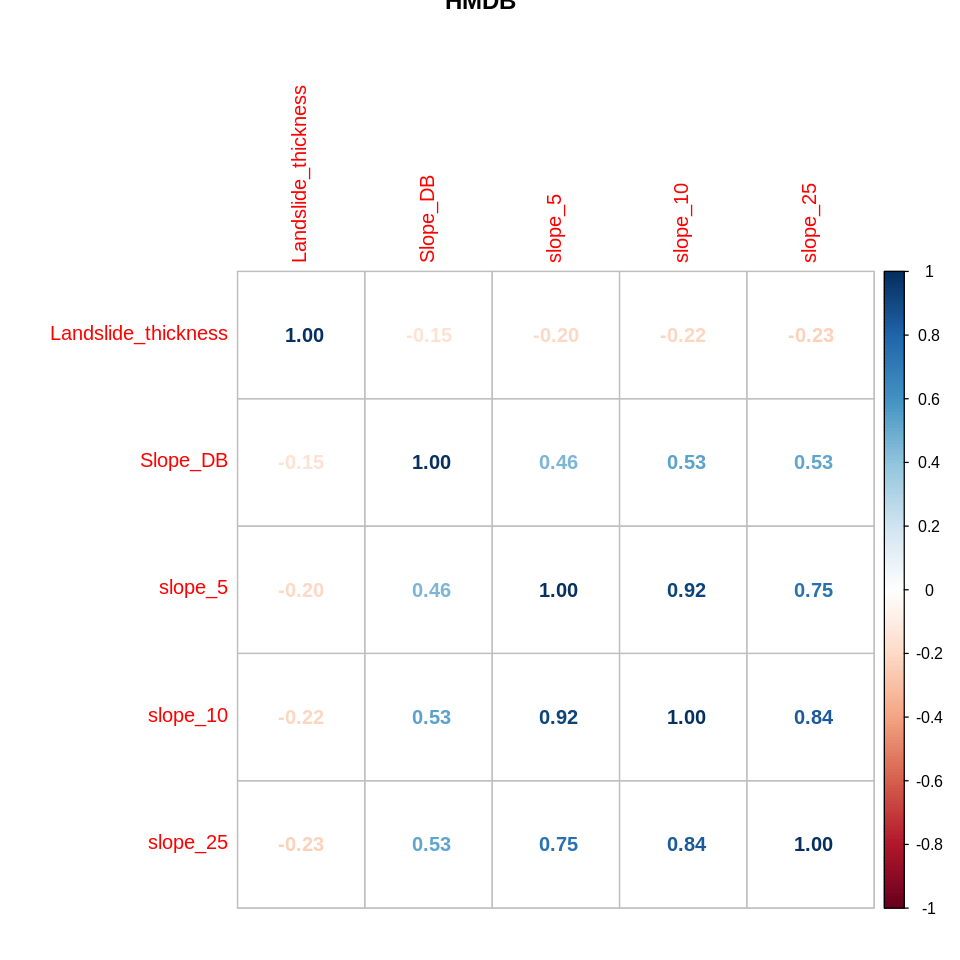

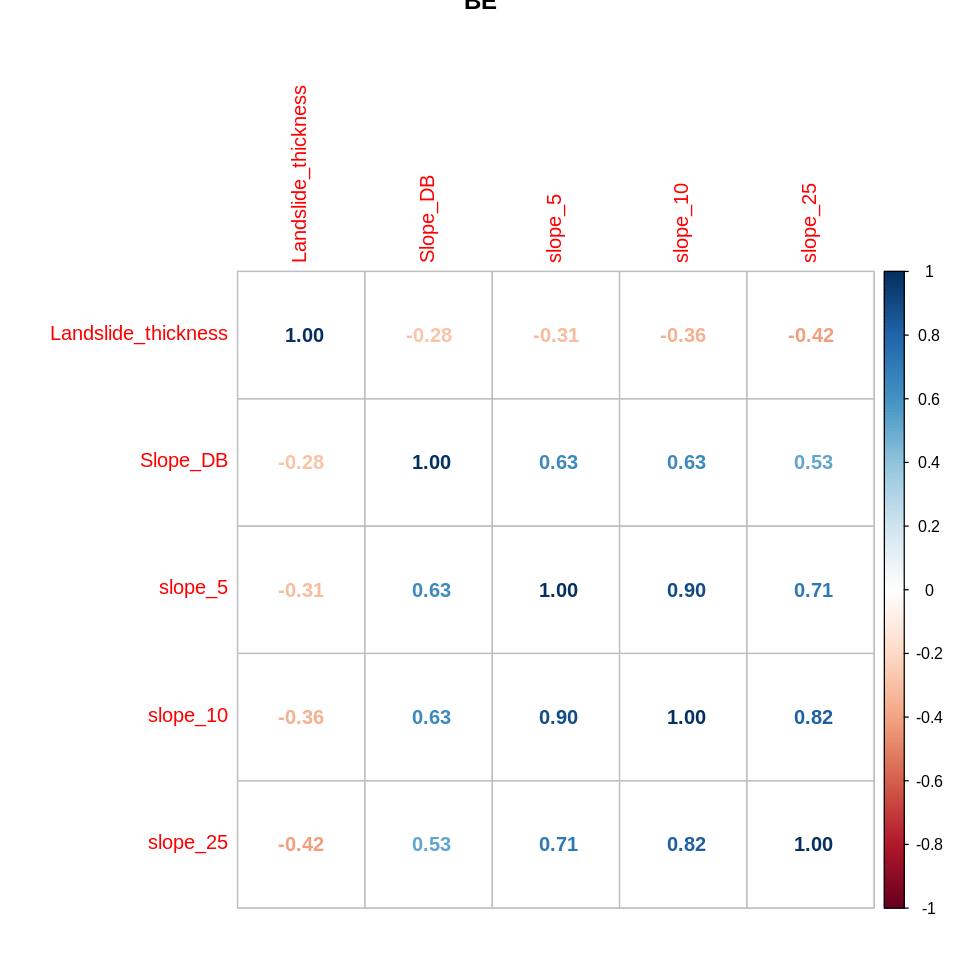

In [124]:
cor_cols <- c('Landslide_thickness', 'Slope_DB', 'slope_5', 'slope_10', 'slope_25')

plot_correlation_by_dataset(cor_cols,width=8,height=8)

[1] 8.024915

[1] 7.64444

[1] 7.670773

[1] 5.67787

[1] 5.262689

[1] 5.336715


Call:
lm(formula = Slope_DB ~ slope_5, data = merged.df.hmdb)

Residuals:
    Min      1Q  Median      3Q     Max 
-29.037  -4.073   0.359   3.830  43.359 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept) 16.24509    1.47264   11.03   <2e-16 ***
slope_5      0.56056    0.04273   13.12   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 8.037 on 646 degrees of freedom
  (95 observations deleted due to missingness)
Multiple R-squared:  0.2103,	Adjusted R-squared:  0.2091 
F-statistic: 172.1 on 1 and 646 DF,  p-value: < 2.2e-16



Call:
lm(formula = Slope_DB ~ slope_10, data = merged.df.hmdb)

Residuals:
    Min      1Q  Median      3Q     Max 
-29.323  -3.308  -0.127   3.320  42.327 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept) 12.77524    1.42941   8.937   <2e-16 ***
slope_10     0.67686    0.04234  15.985   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 7.656 on 646 degrees of freedom
  (95 observations deleted due to missingness)
Multiple R-squared:  0.2834,	Adjusted R-squared:  0.2823 
F-statistic: 255.5 on 1 and 646 DF,  p-value: < 2.2e-16



Call:
lm(formula = Slope_DB ~ slope_25, data = merged.df.hmdb)

Residuals:
    Min      1Q  Median      3Q     Max 
-28.378  -3.779  -0.581   3.122  42.529 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept) 14.26829    1.35413   10.54   <2e-16 ***
slope_25     0.66735    0.04226   15.79   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 7.683 on 646 degrees of freedom
  (95 observations deleted due to missingness)
Multiple R-squared:  0.2785,	Adjusted R-squared:  0.2774 
F-statistic: 249.4 on 1 and 646 DF,  p-value: < 2.2e-16


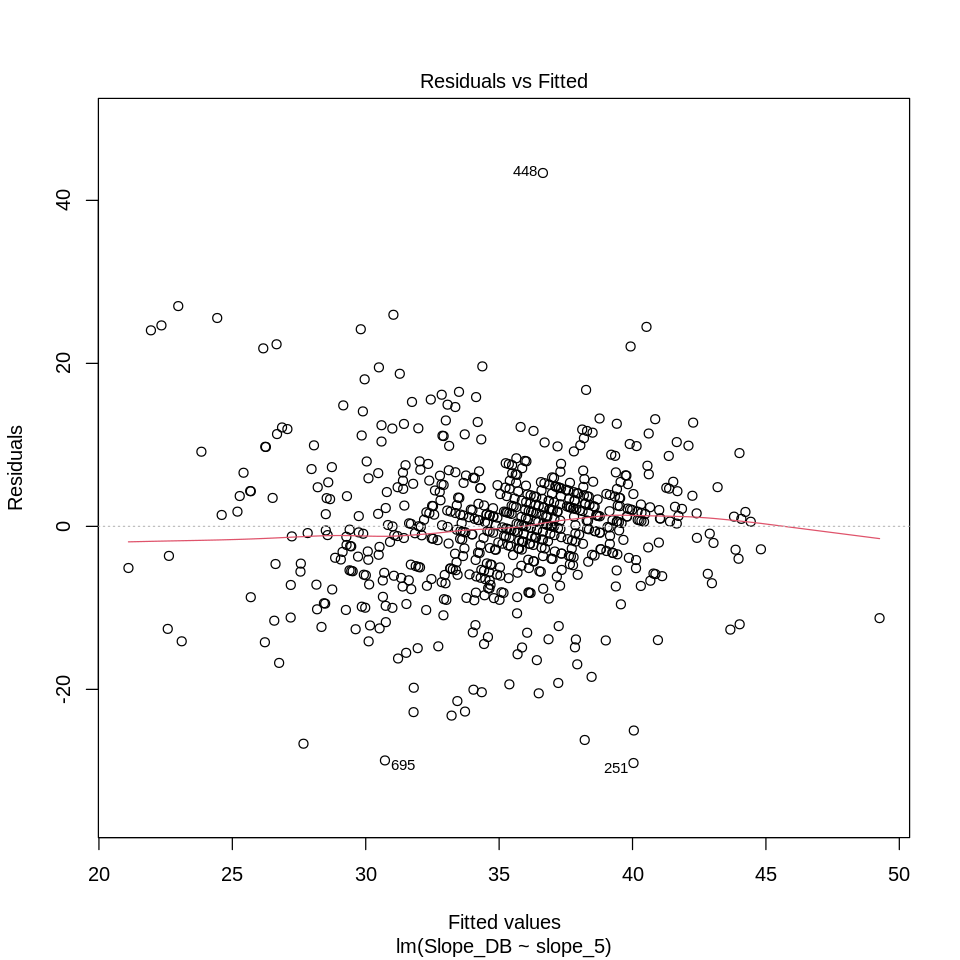

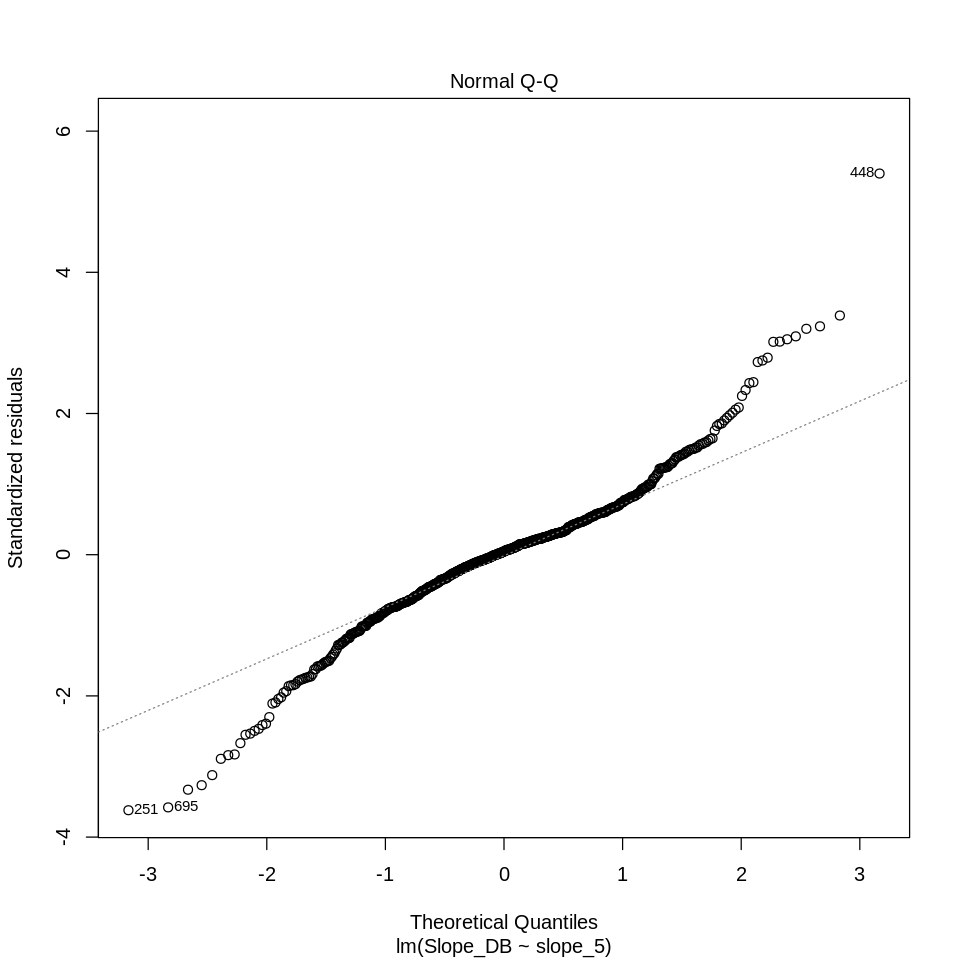

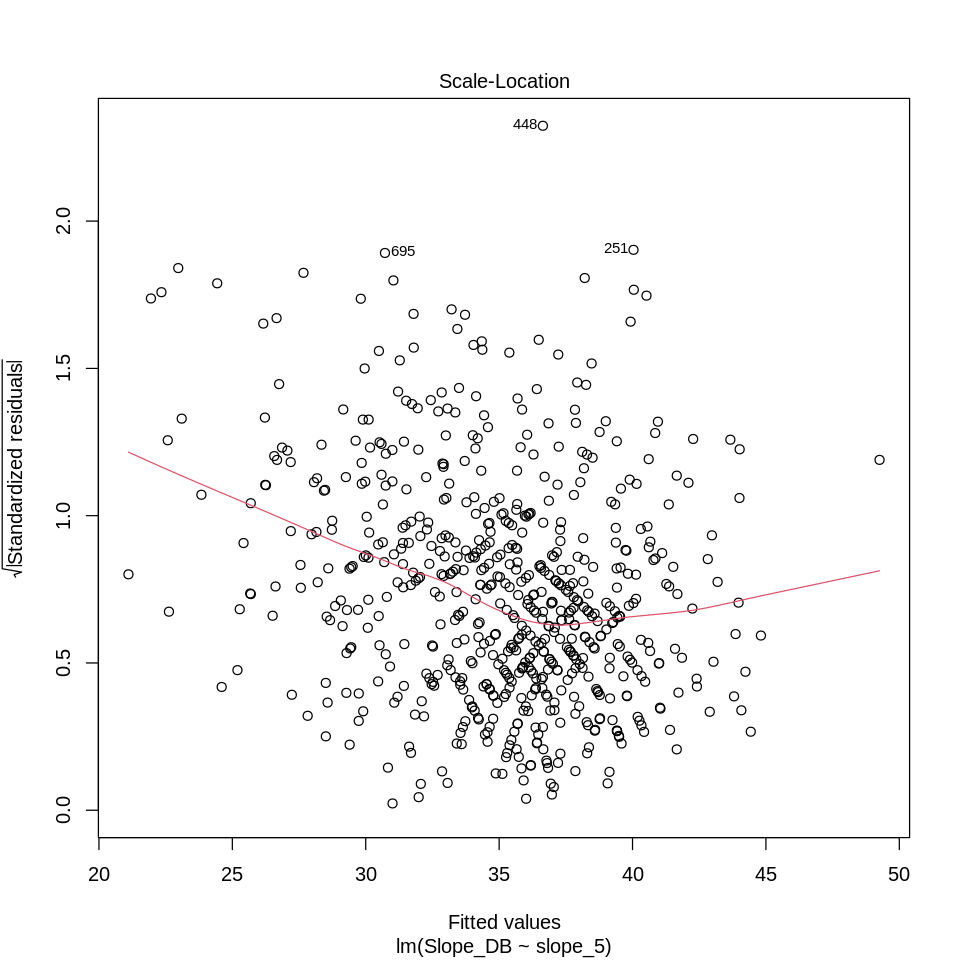

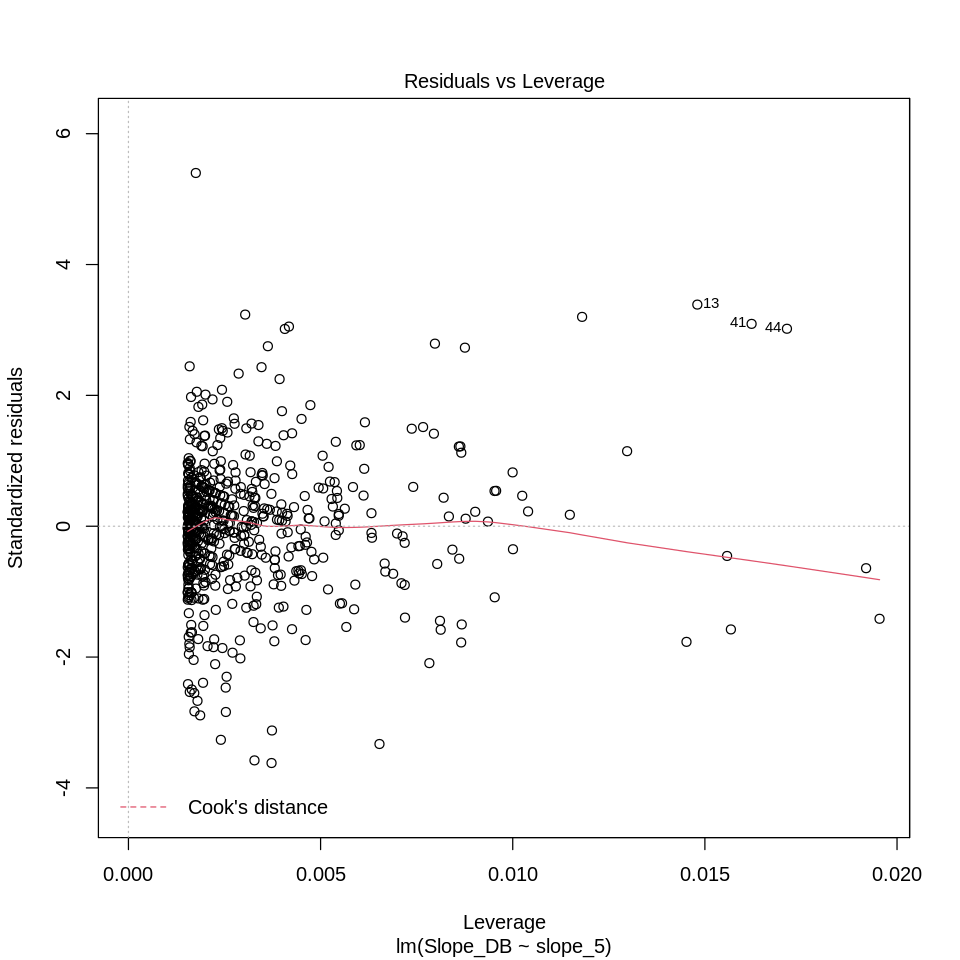

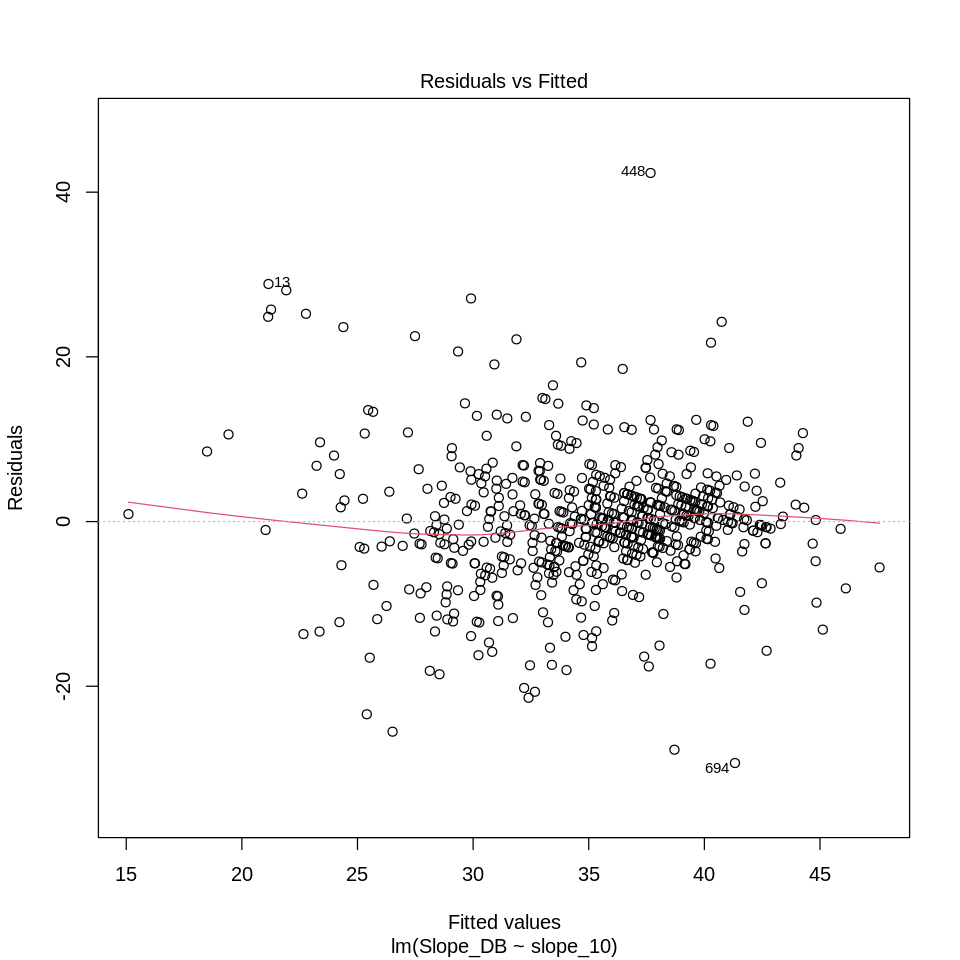

...

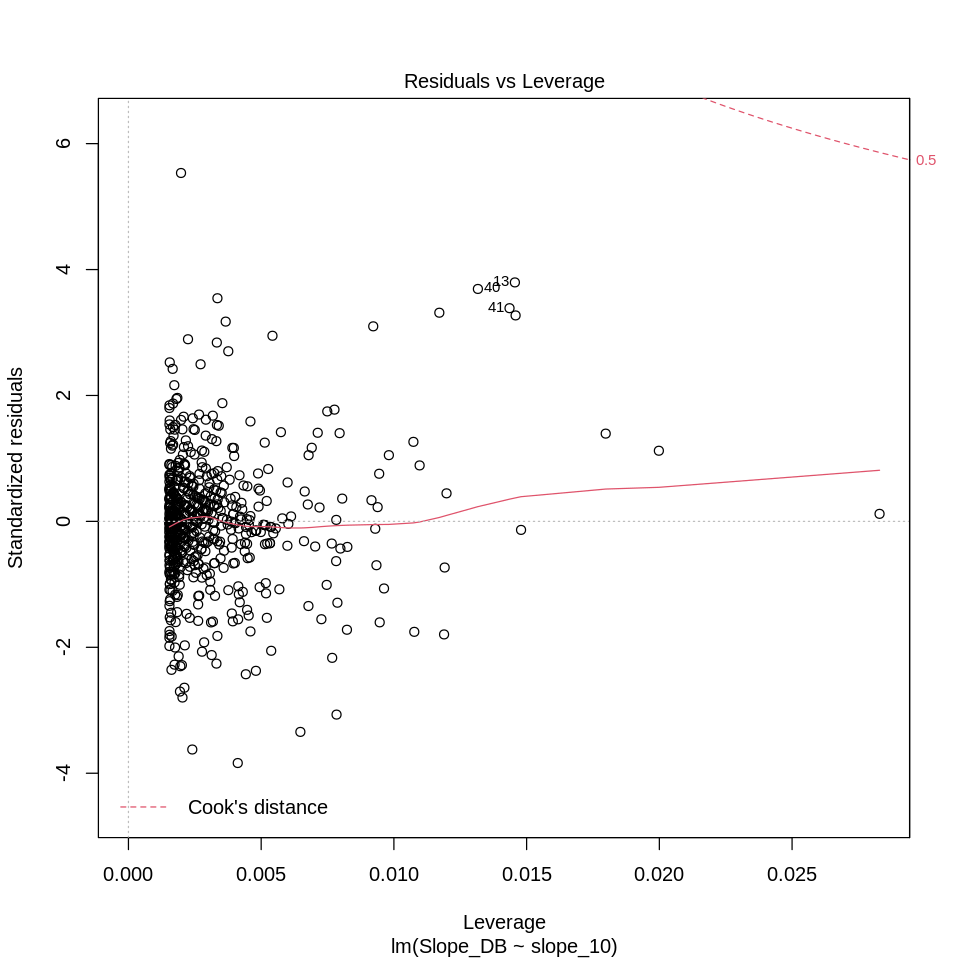

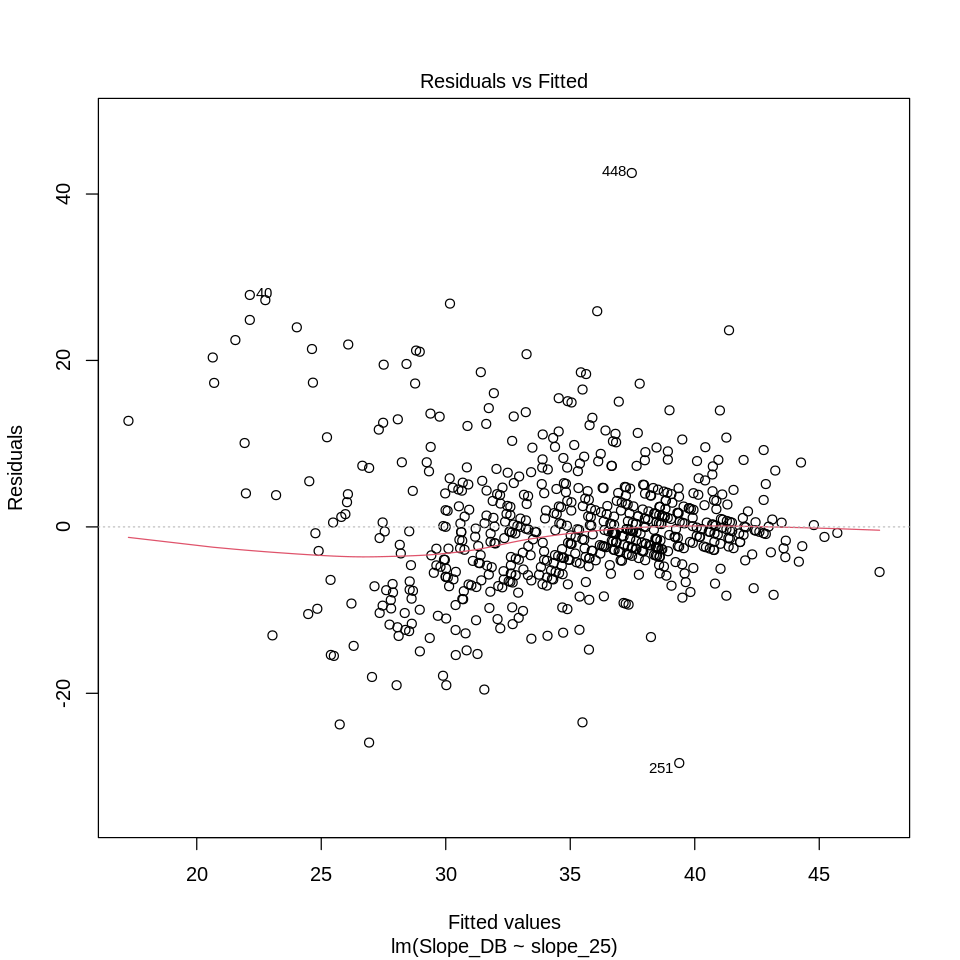

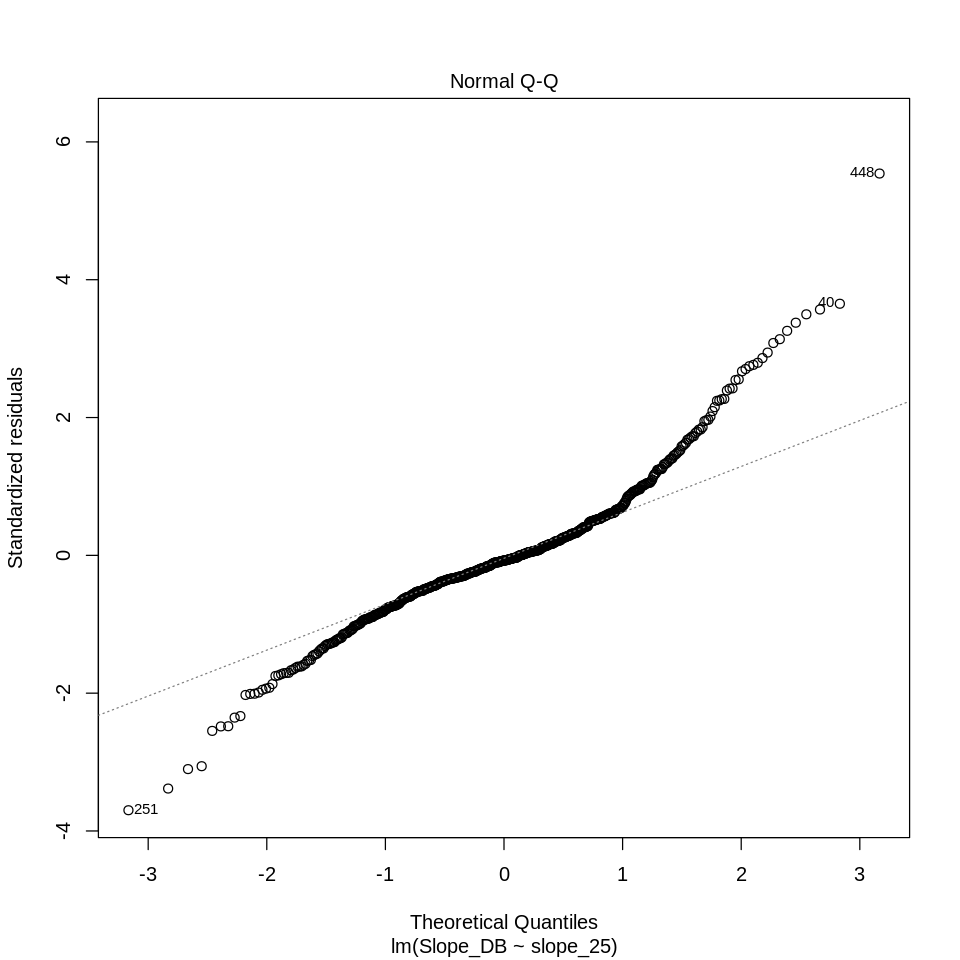

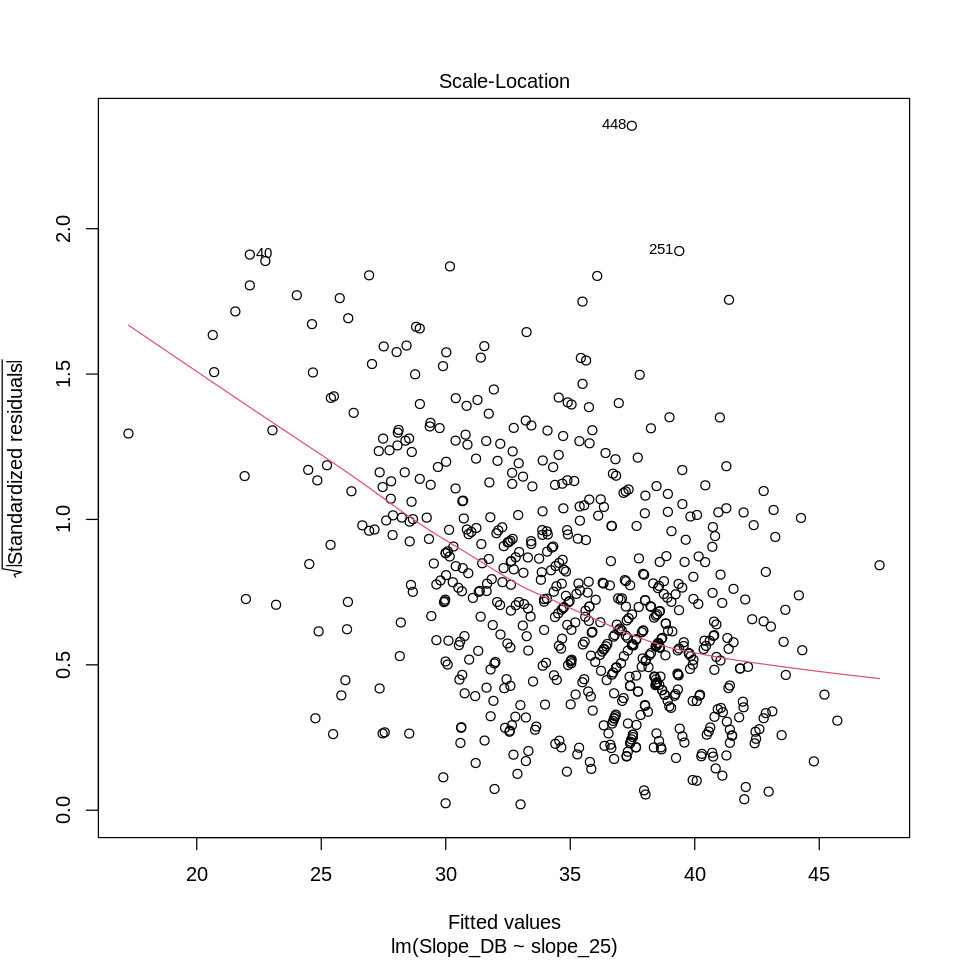

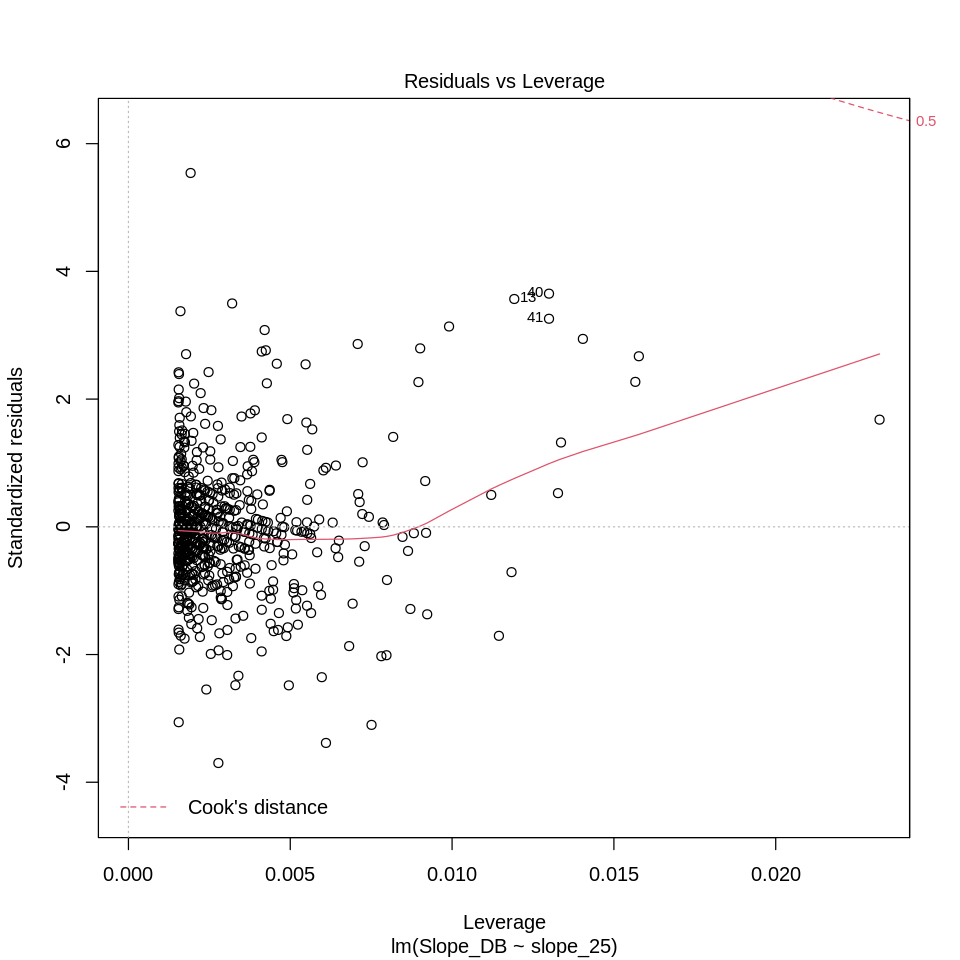

In [125]:
lm_5  <- lm(Slope_DB~slope_5,  data = merged.df.hmdb)
lm_10 <- lm(Slope_DB~slope_10, data = merged.df.hmdb)
lm_25 <- lm(Slope_DB~slope_25, data = merged.df.hmdb)

sqrt(mean(lm_5$residuals^2))
sqrt(mean(lm_10$residuals^2))
sqrt(mean(lm_25$residuals^2))
mean(abs(lm_5$residuals))
mean(abs(lm_10$residuals))
mean(abs(lm_25$residuals))
summary(lm_5)
summary(lm_10)
summary(lm_25)
plot(lm_5)
plot(lm_10)
plot(lm_25)


[1] 4.509524

[1] 4.517875

[1] 4.94896

[1] 3.370734

[1] 3.27106

[1] 3.735379


Call:
lm(formula = Slope_DB ~ slope_5, data = merged.df.be)

Residuals:
    Min      1Q  Median      3Q     Max 
-22.460  -2.695  -0.010   2.487  20.567 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept) 13.61475    0.95913    14.2   <2e-16 ***
slope_5      0.55458    0.02998    18.5   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 4.518 on 515 degrees of freedom
  (53 observations deleted due to missingness)
Multiple R-squared:  0.3993,	Adjusted R-squared:  0.3981 
F-statistic: 342.3 on 1 and 515 DF,  p-value: < 2.2e-16



Call:
lm(formula = Slope_DB ~ slope_10, data = merged.df.be)

Residuals:
     Min       1Q   Median       3Q      Max 
-18.6833  -2.4977  -0.1553   2.3932  21.9482 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept) 12.10571    1.04380   11.60   <2e-16 ***
slope_10     0.62776    0.03409   18.41   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 4.527 on 515 degrees of freedom
  (53 observations deleted due to missingness)
Multiple R-squared:  0.397,	Adjusted R-squared:  0.3959 
F-statistic: 339.1 on 1 and 515 DF,  p-value: < 2.2e-16



Call:
lm(formula = Slope_DB ~ slope_25, data = merged.df.be)

Residuals:
     Min       1Q   Median       3Q      Max 
-18.5953  -2.9320  -0.4497   2.6222  18.5938 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept) 15.61784    1.11618   13.99   <2e-16 ***
slope_25     0.54383    0.03877   14.03   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 4.959 on 515 degrees of freedom
  (53 observations deleted due to missingness)
Multiple R-squared:  0.2765,	Adjusted R-squared:  0.2751 
F-statistic: 196.8 on 1 and 515 DF,  p-value: < 2.2e-16


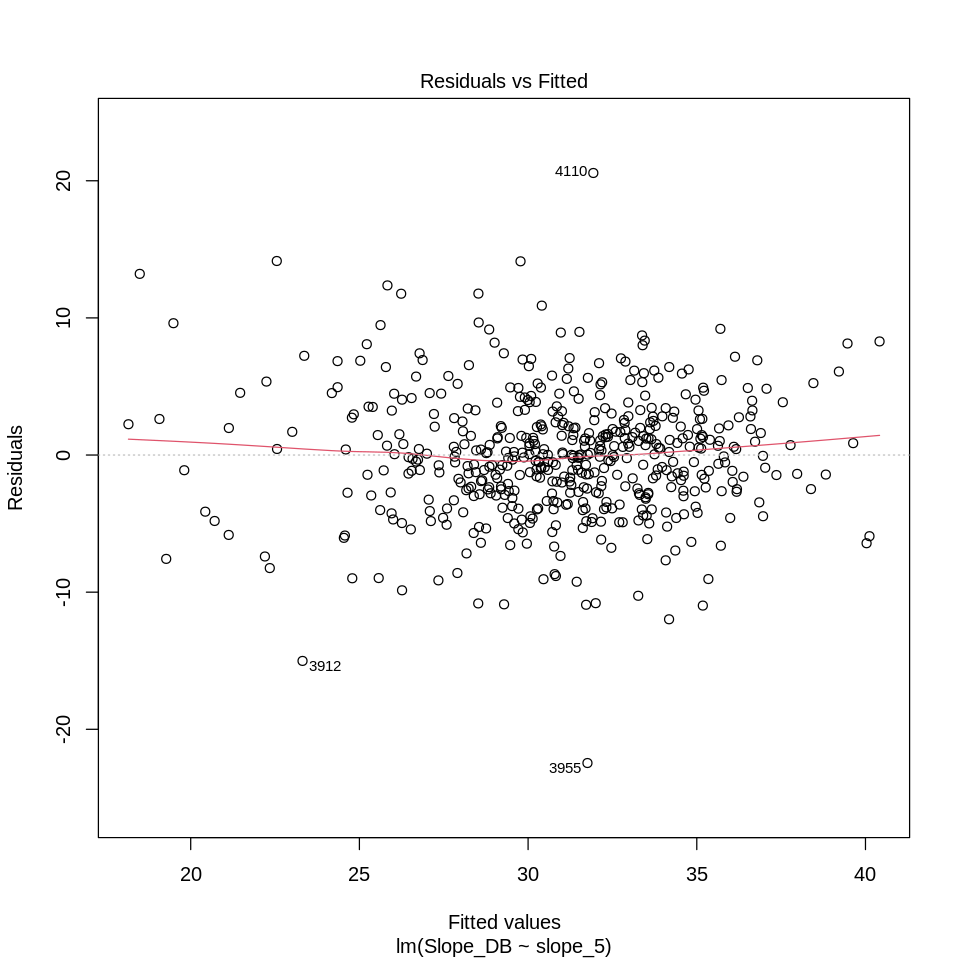

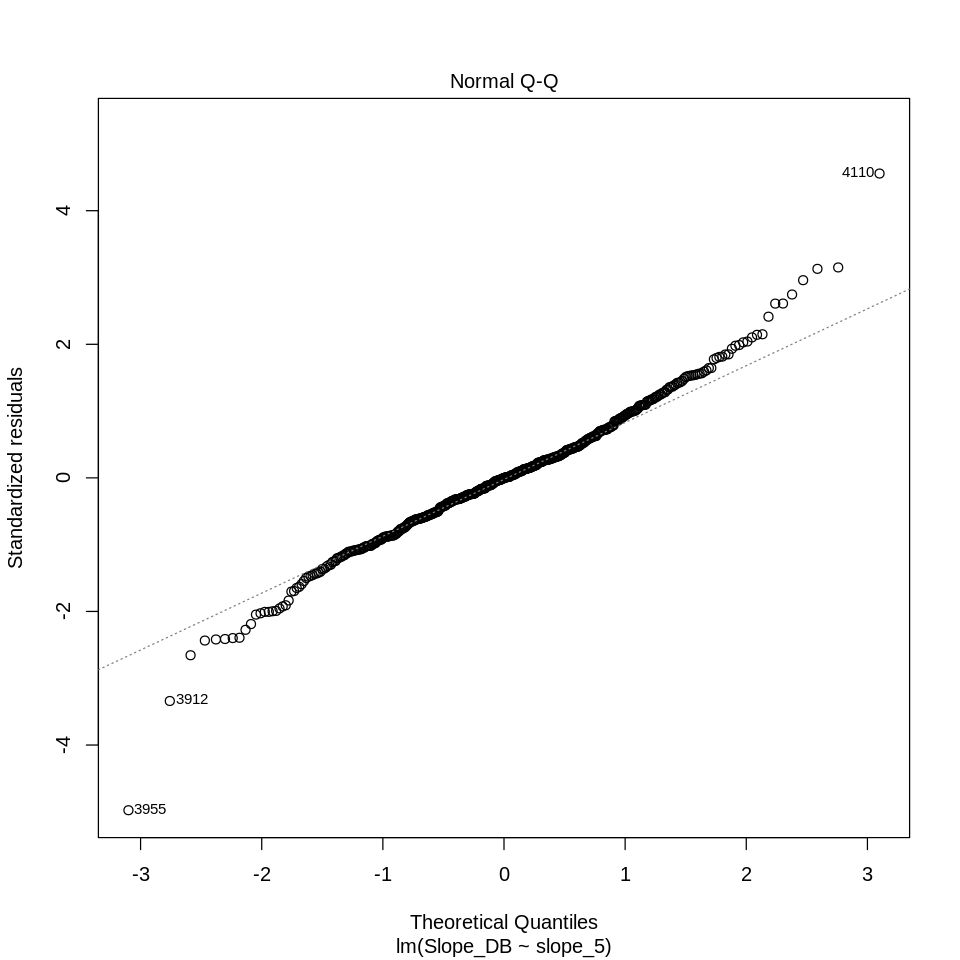

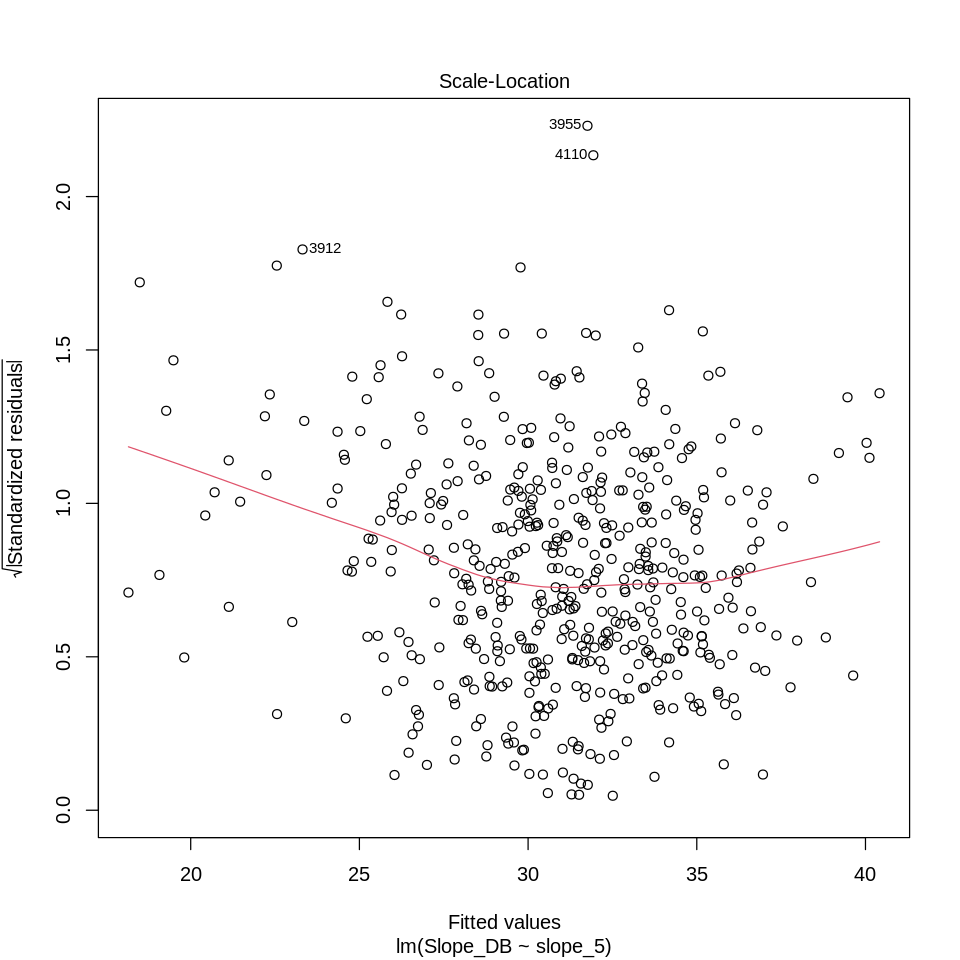

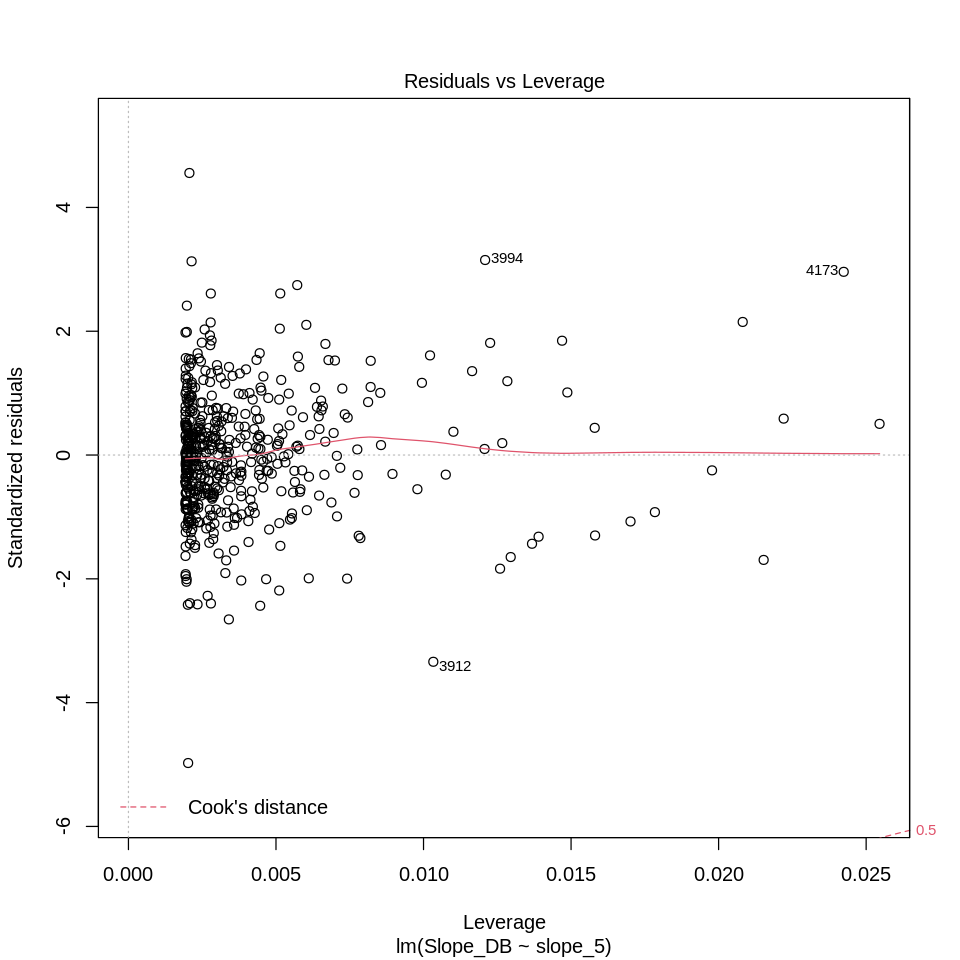

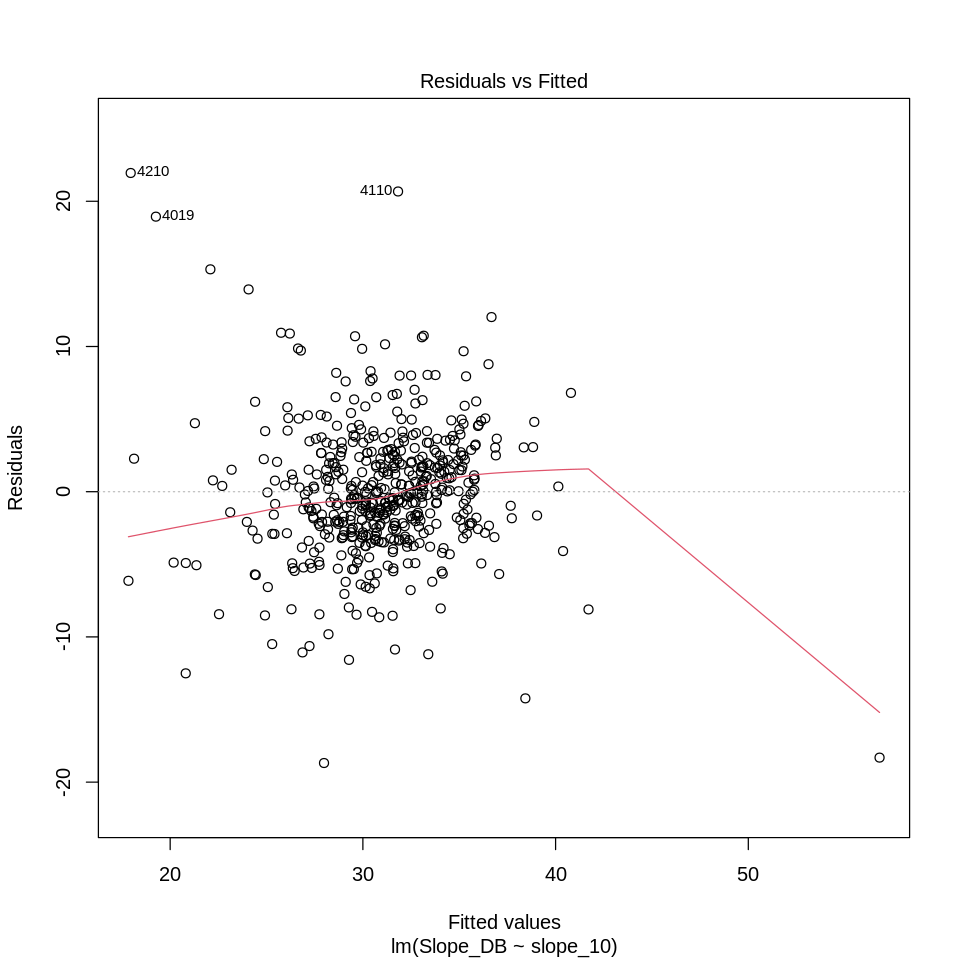

...

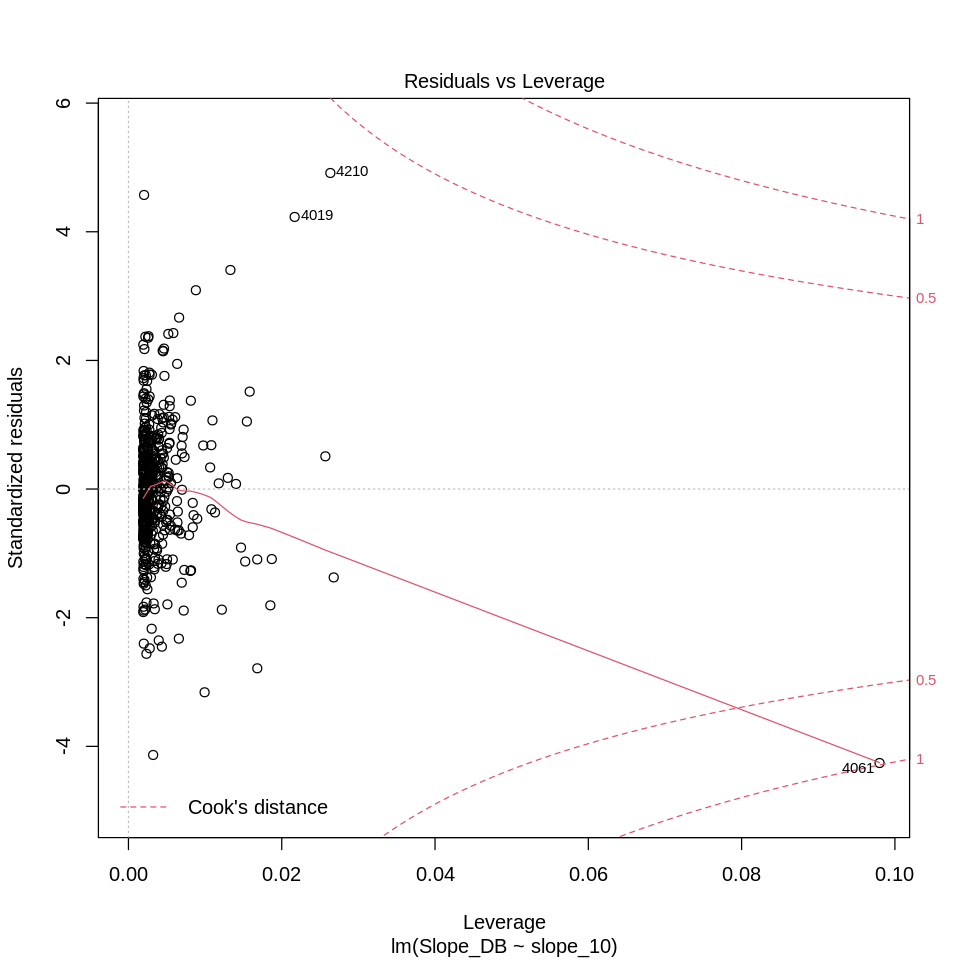

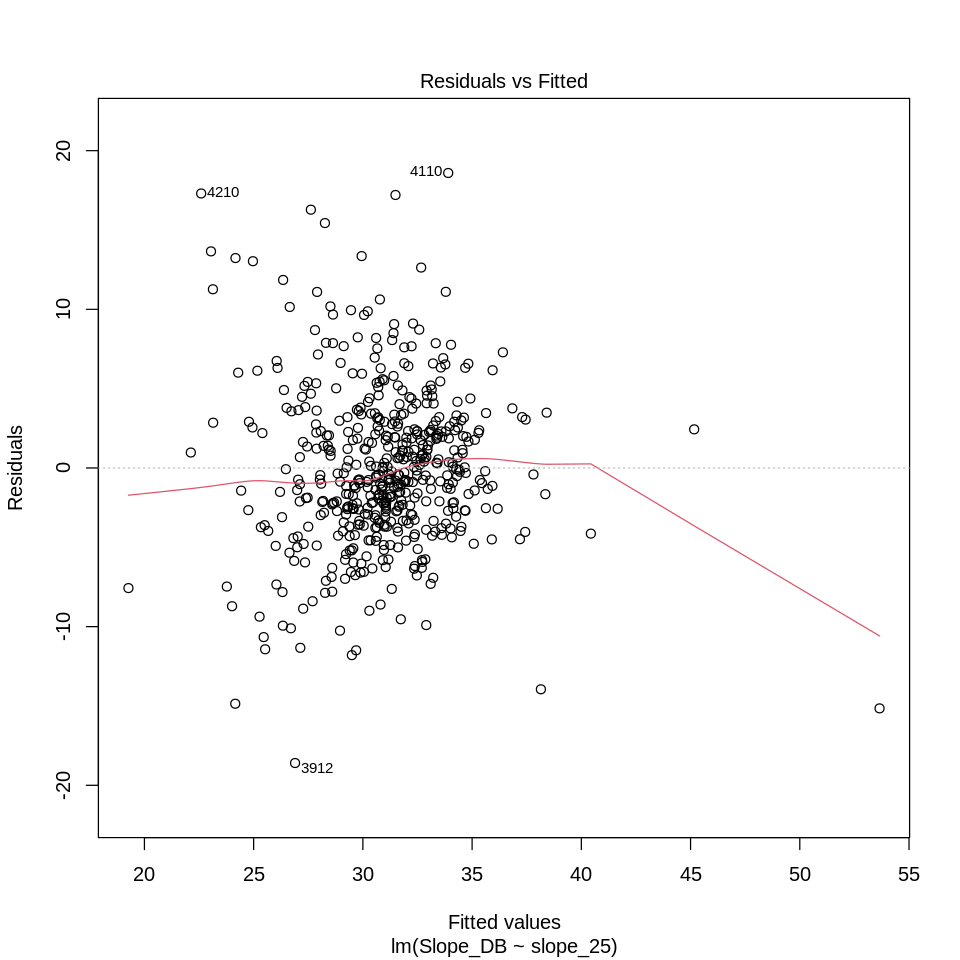

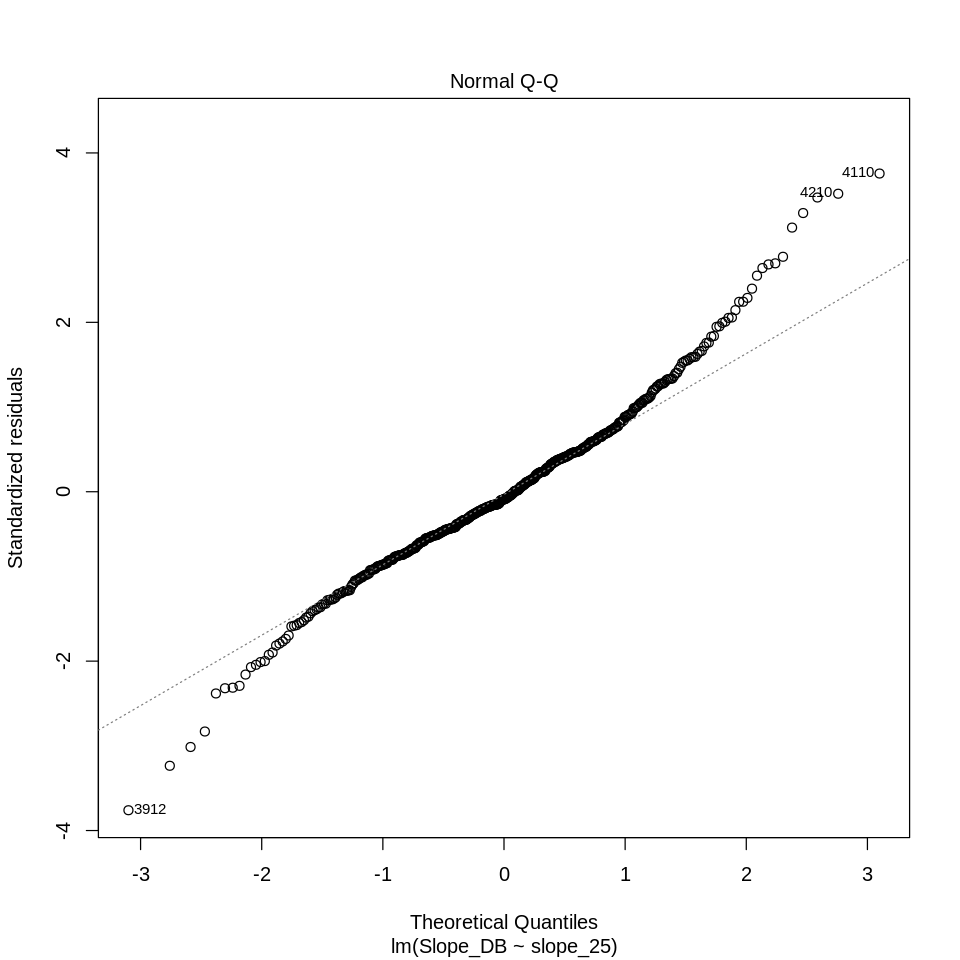

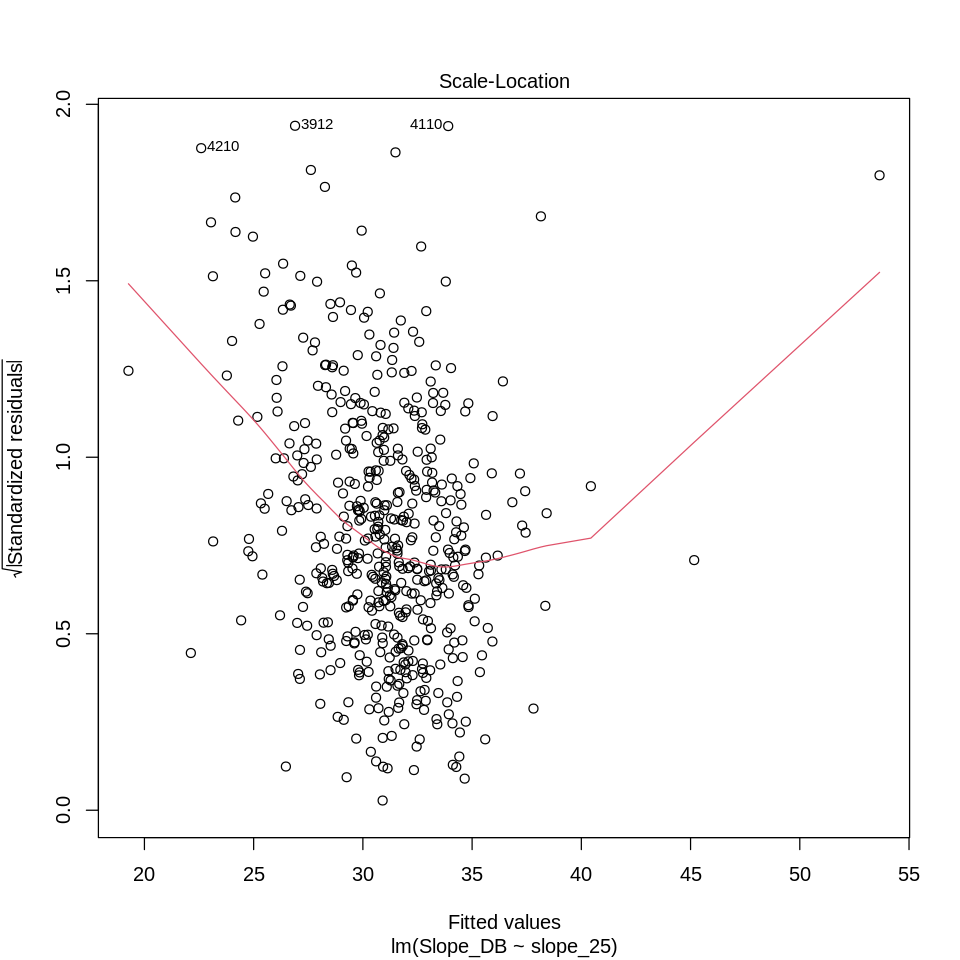

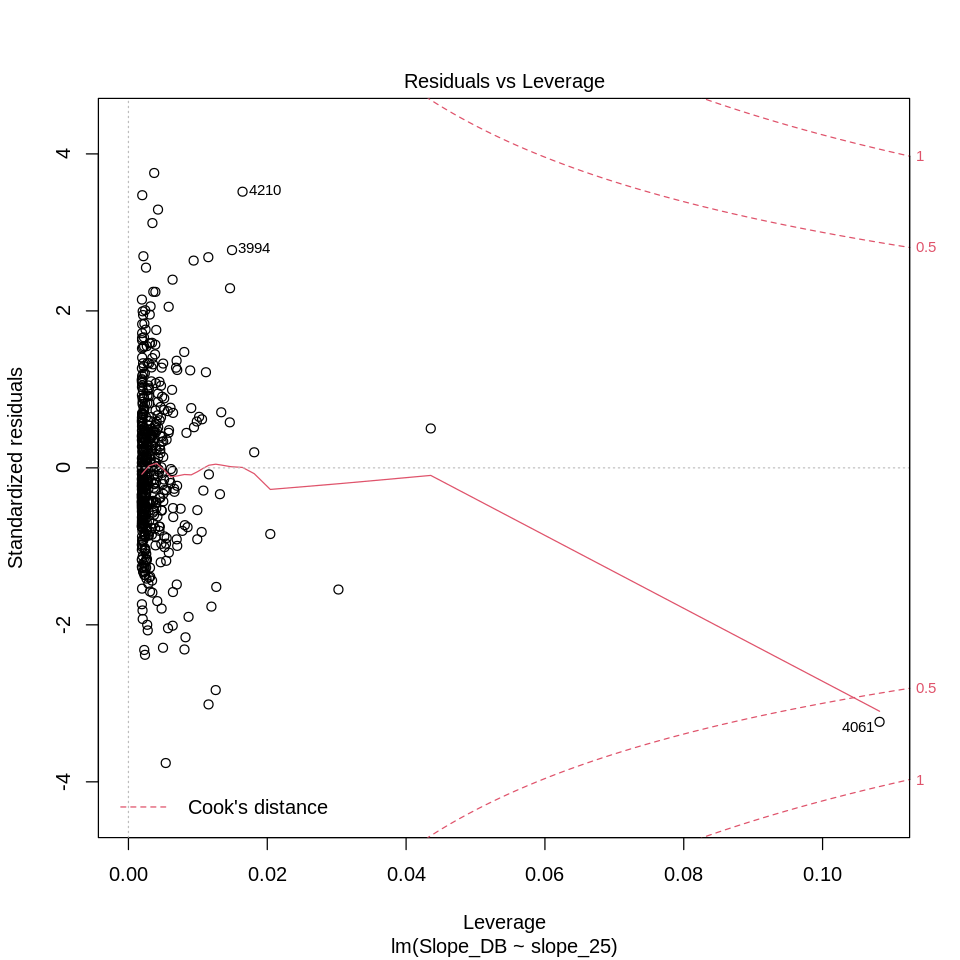

In [126]:
lm_5  <- lm(Slope_DB~slope_5,  data = merged.df.be)
lm_10 <- lm(Slope_DB~slope_10, data = merged.df.be)
lm_25 <- lm(Slope_DB~slope_25, data = merged.df.be)

sqrt(mean(lm_5$residuals^2))
sqrt(mean(lm_10$residuals^2))
sqrt(mean(lm_25$residuals^2))
mean(abs(lm_5$residuals))
mean(abs(lm_10$residuals))
mean(abs(lm_25$residuals))
summary(lm_5)
summary(lm_10)
summary(lm_25)
plot(lm_5)
plot(lm_10)
plot(lm_25)


Which Rainfall Variabe seems to give the best results.

In [127]:
x_cols_test_template <- x_cols_manual <- c( 

                 'tri_r5_10'
                 ,'tri_r5_5'
                 ,'tpi_4km_25'
                 ,'tpi_500m_25'
                 ,'vhm_max_5'
                 ,'h_5'
                 ,'vrm_r5_25'
                 ,'mrvbf_25'#,'mrvbf_10'
                 ,'mrrtf_25'#,'mrrtf_10'
                 ,'slope_height_25'
    
                 ,'catchment_slope_25'#,'catchment_slope_5'
                 ,'valley_depth_25'
                 ,'standardized_height_25'
                 ,'slope_25'#,'slope_5'
    ,'aspect_nness_10'
                 ,'twi_25'
                 ,'curvature_10'
                 ,'curvature_profile_25'
                 ,'catchment_area_25'
                 ,'openness_pos_200_5'
    # ,'susceptibility_unconsolidated_deposits_5'
    # ,'susceptibility_gk500_5'
        ,'susceptibility_unconsolidated_deposits_5f_0'
    ,'susceptibility_unconsolidated_deposits_5f_1'
    ,'susceptibility_unconsolidated_deposits_5f_2'
    ,'susceptibility_unconsolidated_deposits_5f_3'
    ,'susceptibility_gk500_5f_0'
    ,'susceptibility_gk500_5f_1'
    ,'susceptibility_gk500_5f_2'
    ,'susceptibility_gk500_5f_3'
                )


x_cols_test_4 <- x_cols_manual <- c( 
                 'prcp_60m_30a_0975'
                 ,'prcp_60m_100a_0975'
                 ,'prcp_24h_30a_0975' 
                ,'prcp_24h_100a_0975'
                 ,'tri_r5_10'
                 ,'tri_r5_5'
                 ,'tpi_4km_25'
                 ,'tpi_500m_25'
                 ,'vhm_max_5'
                 ,'h_5'
                 ,'vrm_r5_25'
                 ,'mrvbf_25'#,'mrvbf_10'
                 ,'mrrtf_25'#,'mrrtf_10'
                 ,'slope_height_25'
    
                 ,'catchment_slope_25'#,'catchment_slope_5'
                 ,'valley_depth_25'
                 ,'standardized_height_25'
                 ,'slope_25'#,'slope_5'
    ,'aspect_nness_10'
                 ,'twi_25'
                 ,'curvature_10'
                 ,'curvature_profile_25'
                 ,'catchment_area_25'
                 ,'openness_pos_200_5'
    # ,'susceptibility_unconsolidated_deposits_5'
    # ,'susceptibility_gk500_5'
        ,'susceptibility_unconsolidated_deposits_5f_0'
    ,'susceptibility_unconsolidated_deposits_5f_1'
    ,'susceptibility_unconsolidated_deposits_5f_2'
    ,'susceptibility_unconsolidated_deposits_5f_3'
    ,'susceptibility_gk500_5f_0'
    ,'susceptibility_gk500_5f_1'
    ,'susceptibility_gk500_5f_2'
    ,'susceptibility_gk500_5f_3'
                )





test_res <- NULL
res <- train_test_ranger_caret(merged.df.hmdb , x_cols_test_4, y_col, label="All 4", plot=FALSE, data_test=NA, train_size=0.8, seed = 0 )
test_res <- rbind(test_res,res)

rain_var <- list(   
'prcp_60m_30a', 'prcp_24h_30a', 'prcp_60m_2a', 'prcp_60m_10a',  'prcp_60m_50a', 'prcp_60m_100a', 'prcp_60m_200a', 'prcp_24h_2a', 'prcp_24h_10a',  'prcp_24h_50a', 'prcp_24h_100a', 'prcp_24h_200a'
                     ,'prcp_60m_2a_0025', 'prcp_60m_10a_0025', 'prcp_60m_30a_0025', 'prcp_60m_50a_0025', 'prcp_60m_100a_0025', 'prcp_60m_200a_0025', 'prcp_24h_2a_0025', 'prcp_24h_10a_0025', 'prcp_24h_30a_0025', 'prcp_24h_50a_0025', 'prcp_24h_100a_0025', 'prcp_24h_200a_0025', 'prcp_24h_300a_0025'
                    ,
                       'prcp_60m_30a_0975', 'prcp_24h_30a_0975', 'prcp_60m_100a_0975', 'prcp_24h_100a_0975' , 'prcp_60m_2a_0975', 'prcp_60m_10a_0975', 'prcp_60m_50a_0975',  'prcp_60m_200a_0975', 'prcp_24h_2a_0975', 'prcp_24h_10a_0975', 'prcp_24h_50a_0975',  'prcp_24h_200a_0975'
)
for(rv in rain_var) {
    print(rv)
    x_cols_test_1 <- append(x_cols_test_template, rv)
    res <- train_test_ranger_caret(merged.df.hmdb , x_cols_test_1, y_col, label=rv, plot=FALSE, data_test=NA, train_size=0.8, seed = 0 )
    test_res <- rbind(test_res,res)
}

# test_res


[1] "All 4"
[1] 560
[1] 138
Random Forest 

560 samples
 32 predictor

No pre-processing
Resampling: Cross-Validated (10 fold, repeated 10 times) 
Summary of sample sizes: 504, 503, 504, 505, 505, 504, ... 
Resampling results across tuning parameters:

  mtry  min.node.size  RMSE       Rsquared   MAE      
   2    1              0.2928098  0.2133291  0.2105718
   2    2              0.2923777  0.2160397  0.2101854
   2    4              0.2928149  0.2133302  0.2105219
   2    6              0.2929062  0.2136843  0.2110734
   4    1              0.2937167  0.2083646  0.2110500
   4    2              0.2939534  0.2075973  0.2113004
   4    4              0.2937248  0.2083673  0.2109485
   4    6              0.2937832  0.2084520  0.2110020
  10    1              0.2951713  0.2031602  0.2112787
  10    2              0.2960916  0.1987977  0.2122617
  10    4              0.2961899  0.1980410  0.2125294
  10    6              0.2956974  0.2002652  0.2119302
  60    1                    NaN

In [128]:
test_res[ order(test_res$test_mae),]

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
prcp_24h_10a_0975,,,560,0.1089301,NA,0.2740472,0.1529840,0.8948984,0.005719363,⋯,0.2460240,NA,0.2740472,0.3536056,0.11450502,0.01553538,0.9214815,-0.5671666,1.353684,0.5188135
prcp_24h_100a,,,560,0.1101604,NA,0.2757563,0.1547777,0.8916625,0.005719363,⋯,0.2465928,NA,0.2757563,0.3532673,0.11719036,0.03215601,0.9251751,-0.5497939,1.341306,0.5268639
prcp_24h_200a,,,560,0.1089418,NA,0.2740300,0.1532450,0.8946818,0.005719363,⋯,0.2472344,NA,0.2740300,0.3537702,0.11532155,0.04164936,0.9218524,-0.5483291,1.356743,0.5210143
prcp_24h_50a,,,560,0.1099011,NA,0.2753352,0.1549027,0.8905475,0.005719363,⋯,0.2475416,NA,0.2753352,0.3542230,0.10969168,0.02704820,0.9303684,-0.5655875,1.342294,0.5343363
prcp_24h_30a,,,560,0.1101964,NA,0.2759052,0.1548737,0.8910116,0.005719363,⋯,0.2475803,NA,0.2759052,0.3538656,0.10965637,0.02704820,0.9279578,-0.5772643,1.338017,0.5209252
prcp_24h_100a_0975,,,560,0.1094372,NA,0.2746100,0.1546862,0.8932264,0.006274918,⋯,0.2477839,NA,0.2746100,0.3547749,0.10916648,0.02533977,0.9173639,-0.5688872,1.398926,0.5441972
prcp_24h_50a_0975,,,560,0.1100288,NA,0.2757327,0.1552724,0.8909348,0.006274918,⋯,0.2481349,NA,0.2757327,0.3535389,0.11329913,0.02025760,0.9081412,-0.5344268,1.372797,0.5155143
All 4,,,560,0.1052981,NA,0.2683500,0.1485779,0.9061214,0.011684010,⋯,0.2488351,NA,0.2683500,0.3548503,0.10896928,0.02887712,0.9151407,-0.4836346,1.296684,0.5106237
prcp_60m_200a_0975,,,560,0.1088036,NA,0.2736604,0.1537970,0.8925494,0.007908242,⋯,0.2490678,NA,0.2736604,0.3564264,0.10116428,0.02955570,0.9004636,-0.5622225,1.327317,0.5492507


Which rock density variable to use.

In [129]:
x_cols_test_template <- x_cols_manual <- c( 

                 'tri_r5_10'
                 ,'tri_r5_5'
                 ,'tpi_4km_25'
                 ,'tpi_500m_25'
                 ,'vhm_max_5'
                 ,'h_5'
                 ,'vrm_r5_25'
                 ,'mrvbf_25'#,'mrvbf_10'
                 ,'mrrtf_25'#,'mrrtf_10'
                 ,'slope_height_25'
    
                 ,'catchment_slope_25'#,'catchment_slope_5'
                 ,'valley_depth_25'
                 ,'standardized_height_25'
                 ,'slope_25'#,'slope_5'
    ,'aspect_nness_10'
                 ,'twi_25'
                 ,'curvature_10'
                 ,'curvature_profile_25'
                 ,'catchment_area_25'
                 ,'openness_neg_200_5'
    # ,'susceptibility_unconsolidated_deposits_5'
    # ,'susceptibility_gk500_5'
       
                )




test_res <- NULL

rho_var <- list(   
'rhob_m', 'rhob_med', 'rhob_p05', 'rhob_p25', 'rhob_p75', 'rhob_p95'
)
for(rv in rho_var) {
    print(rv)
    x_cols_test_1 <- append(x_cols_test_template, rv)
    res <- train_test_ranger_caret(merged.df.hmdb , x_cols_test_1, y_col, label=rv, plot=FALSE, data_test=NA, train_size=0.8, seed = 0 )
    test_res <- rbind(test_res,res)
}

#test_res



[1] "rhob_m"
[1] "rhob_m"
[1] 560
[1] 138
Random Forest 

560 samples
 21 predictor

No pre-processing
Resampling: Cross-Validated (10 fold, repeated 10 times) 
Summary of sample sizes: 504, 503, 504, 505, 505, 504, ... 
Resampling results across tuning parameters:

  mtry  min.node.size  RMSE       Rsquared   MAE      
   2    1              0.2961185  0.1966147  0.2127600
   2    2              0.2965609  0.1942541  0.2133441
   2    4              0.2963406  0.1942877  0.2132315
   2    6              0.2965668  0.1950280  0.2134330
   4    1              0.2976301  0.1891301  0.2136416
   4    2              0.2972313  0.1921993  0.2136839
   4    4              0.2976854  0.1884414  0.2137758
   4    6              0.2978598  0.1875982  0.2138208
  10    1              0.2997704  0.1818694  0.2146756
  10    2              0.2999938  0.1800437  0.2143503
  10    4              0.3000907  0.1798608  0.2145844
  10    6              0.2991468  0.1827316  0.2138596
  60    1         

In [130]:
test_res

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
rhob_m,,,560,0.07892391,NA,0.2300908,0.1129933,0.9485153,0.006555556,⋯,0.2498120,NA,0.2300908,0.3543439,0.10314817,0.07140054,0.9584111,-0.5550230,1.339345,0.5611790
rhob_med,,,560,0.08955648,NA,0.2452148,0.1300497,0.9265959,0.007375000,⋯,0.2559978,NA,0.2452148,0.3581883,0.08639595,0.08558285,0.8297645,-0.6141536,1.361349,0.5523743
rhob_p05,,,560,0.08202330,NA,0.2350148,0.1183202,0.9415481,0.009500000,⋯,0.2472272,NA,0.2350148,0.3490140,0.13132500,0.06818882,0.8958318,-0.5172913,1.306673,0.5254189
rhob_p25,,,560,0.08188207,NA,0.2349027,0.1178993,0.9424641,0.009500000,⋯,0.2469596,NA,0.2349027,0.3487133,0.13263473,0.06812092,0.8968318,-0.5150171,1.305643,0.5237520
rhob_p75,,,560,0.07902989,NA,0.2298432,0.1132554,0.9486625,0.004166667,⋯,0.2502270,NA,0.2298432,0.3545688,0.10411505,0.07222071,0.9622282,-0.5378677,1.324018,0.5479463
rhob_p95,,,560,0.08090556,NA,0.2328176,0.1173041,0.9438831,0.009500000,⋯,0.2480520,NA,0.2328176,0.3536734,0.10769293,0.06123203,0.9096206,-0.5834793,1.305309,0.5320799


Determining the variable importance for a 10-fold CV fit of a ranger model using all variables. Additionally, a Recursive Feature Elimination (RFE) procedure is performed for thode variables using different datasets as input in order to get an idea for a possible selection of variables for the fial model.

rank,variable_Merged,importance_Merged,variable_HMDB,importance_HMDB,variable_BE,importance_BE
<int>,<chr>,<dbl>,<chr>,<dbl>,<chr>,<dbl>
1,prcp_24h_200a,100.00000,prcp_60m_100a,100.00000,prcp_24h_200a,100.00000
2,prcp_24h_200a_0975,89.43915,prcp_60m_2a,81.04524,prcp_24h_30a,94.43206
3,tri_r5_5,70.38003,prcp_60m_200a_0975,77.32451,prcp_24h_50a,93.19544
4,prcp_24h_100a_0975,69.76753,catchment_slope_25,75.33196,prcp_24h_10a,91.29580
5,prcp_24h_50a_0975,69.14004,mrrtf_25,74.12378,prcp_24h_50a_0975,89.61216
6,tri_r5_10,68.64745,prcp_60m_50a_0975,72.26617,prcp_24h_200a_0975,84.12716
7,h_25,68.37441,prcp_60m_2a_0975,70.12375,prcp_24h_100a,80.22449
8,mrvbf_25,67.73810,tri_r5_10,63.87474,prcp_24h_30a_0975,79.89818
9,prcp_24h_50a,66.55612,h_filled_10,59.11617,prcp_24h_2a,78.44205


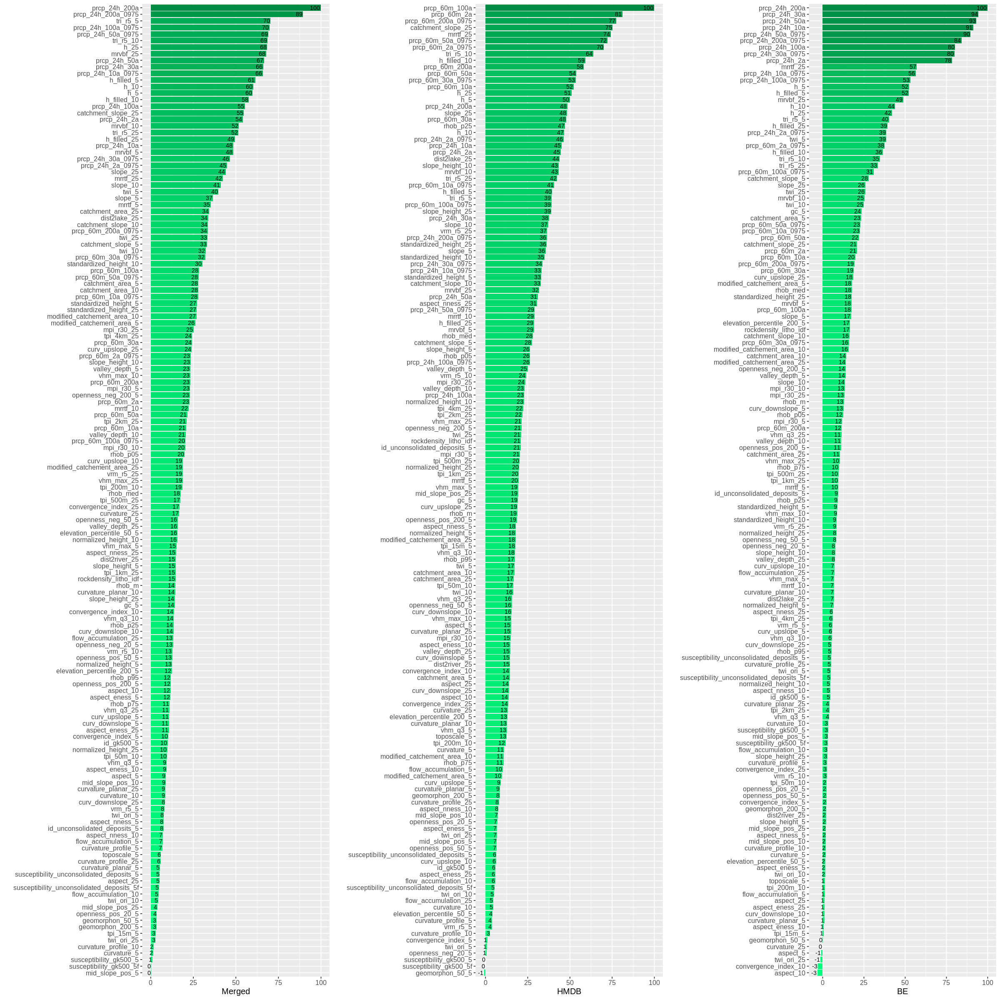

In [131]:
# Initial dataset with only few exluded variables
x_cols_reduced0 <- c('h_5', 'h_10', 'h_25', 'twi_ori_5', 'h_filled_5', 'h_filled_10', 'h_filled_25', 
                    'catchment_area_5', 'catchment_area_10', 'catchment_area_25', 'catchment_slope_5', 'catchment_slope_10', 'catchment_slope_25', 
                    'modified_catchement_area_5', 'modified_catchement_area_10', 'modified_catchement_area_25', 
                    'twi_5', 'twi_10', 'twi_25', 'twi_ori_10', 'twi_ori_25', 
                    'slope_5', 'slope_10', 'slope_25', 
                    'aspect_5', 'aspect_10', 'aspect_25', 'aspect_nness_5', 'aspect_nness_10', 'aspect_nness_25', 'aspect_eness_5', 'aspect_eness_10', 'aspect_eness_25', 
                    'curvature_5', 'curvature_10', 'curvature_25', 'curvature_profile_5', 'curvature_profile_10', 
                    'curvature_profile_25', 'curvature_planar_5', 'curvature_planar_10', 'curvature_planar_25', 'openness_pos_20_5', 'openness_neg_20_5', 
                    'openness_pos_50_5', 'openness_neg_50_5', 'openness_pos_200_5', 'openness_neg_200_5', 'flow_accumulation_5', 'flow_accumulation_10', 
                    'flow_accumulation_25', 'elevation_percentile_50_5', 'elevation_percentile_200_5', 'tpi_15m_5', 'tpi_50m_10', 
                    'tpi_200m_10', 'tpi_500m_25', 'tpi_1km_25', 'tpi_2km_25', 'tpi_4km_25', 'mrvbf_5', 'mrvbf_10', 'mrvbf_25', 'mrrtf_5', 'mrrtf_10', 
                    'mrrtf_25', 'convergence_index_5', 'convergence_index_10', 'convergence_index_25', 'curv_upslope_5', 'curv_upslope_10', 
                    'curv_upslope_25', 'curv_downslope_5', 'curv_downslope_10', 'curv_downslope_25', 'mpi_r30_5', 'mpi_r30_10', 'mpi_r30_25', 
                    'vrm_r5_5', 'vrm_r5_10', 'vrm_r5_25', 'tri_r5_5', 'tri_r5_10', 'tri_r5_25', 'slope_height_5', 'slope_height_10', 'slope_height_25', 
                    'valley_depth_5', 'valley_depth_10', 'valley_depth_25', 'normalized_height_5', 'normalized_height_10', 'normalized_height_25', 
                    'standardized_height_5', 'standardized_height_10', 'standardized_height_25', 'mid_slope_pos_5', 'mid_slope_pos_10', 'mid_slope_pos_25',
                    'toposcale_5', 
                    'gc_5', 'geomorphon_50_5', 'geomorphon_200_5', 'susceptibility_unconsolidated_deposits_5', 'id_unconsolidated_deposits_5', 
                    'susceptibility_gk500_5', 'id_gk500_5', 
                     'susceptibility_unconsolidated_deposits_5f','susceptibility_gk500_5f',
                     'vhm_max_5', 'vhm_q3_5', 'vhm_max_10', 'vhm_q3_10', 'vhm_max_25', 'vhm_q3_25',
                    'prcp_60m_30a', 'prcp_24h_30a', 'prcp_60m_2a', 'prcp_60m_10a',  'prcp_60m_50a', 'prcp_60m_100a', 'prcp_60m_200a', 'prcp_24h_2a', 'prcp_24h_10a',  'prcp_24h_50a', 'prcp_24h_100a', 
                     'prcp_24h_200a',
                    #'prcp_60m_2a_0025', 'prcp_60m_10a_0025', 'prcp_60m_30a_0025', 'prcp_60m_50a_0025', 'prcp_60m_100a_0025', 'prcp_60m_200a_0025', 'prcp_24h_2a_0025', 'prcp_24h_10a_0025', 'prcp_24h_30a_0025', 'prcp_24h_50a_0025', 'prcp_24h_100a_0025', 'prcp_24h_200a_0025', 'prcp_24h_300a_0025',
                    'prcp_60m_30a_0975', 'prcp_24h_30a_0975', 'prcp_60m_100a_0975', 'prcp_24h_100a_0975' , 'prcp_60m_2a_0975', 'prcp_60m_10a_0975', 'prcp_60m_50a_0975',  'prcp_60m_200a_0975', 'prcp_24h_2a_0975', 'prcp_24h_10a_0975', 'prcp_24h_50a_0975',  'prcp_24h_200a_0975'#,'prcp_24h_0975_match'
                     ,'dist2river_25', 'dist2lake_25'
                     ,'rockdensity_litho_idf', 'rhob_m', 'rhob_med', 'rhob_p05', 'rhob_p25', 'rhob_p75', 'rhob_p95'
                     )


imp_caret_merged <- var_importance_ranger_caret(merged.df.hmdb_be, x_cols_reduced0, y_col, name="Merged", seed = 0)
imp_caret_hmdb <- var_importance_ranger_caret(merged.df.hmdb, x_cols_reduced0, y_col, name="HMDB", seed = 0)
imp_caret_be <- var_importance_ranger_caret(merged.df.be, x_cols_reduced0, y_col, name="BE", seed = 0)


imp_list_caret <- list(imp_caret_merged,imp_caret_hmdb,imp_caret_be)
plot_importance(imp_list_caret, width=20, height=20) 
merge_importance_df(imp_list_caret)



In [132]:
rfe_merged_all <- variable_selection_caret(merged.df.hmdb_be, x=x_cols_reduced0, usePickSizeBest=FALSE, y=y_col, name="Merged", seed=seed)
rfe_hmdb_all <- variable_selection_caret(merged.df.hmdb, x=x_cols_reduced0, usePickSizeBest=FALSE, y=y_col, name="HMDB", seed=seed)
rfe_be_all <- variable_selection_caret(merged.df.be, x=x_cols_reduced0, usePickSizeBest=FALSE, y=y_col, name="BE", seed=seed)

rfe_merged_all
rfe_hmdb_all
rfe_be_all

rfe_merged_all$optVariables
rfe_hmdb_all$optVariables
rfe_be_all$optVariables

# plot_rfe(rfe_merged_all)
# plot_rfe(rfe_hmdb_all)
# plot_rfe(rfe_be_all)



Recursive feature selection

Outer resampling method: Cross-Validated (10 fold, repeated 5 times) 

Resampling performance over subset size:

 Variables   RMSE Rsquared    MAE  RMSESD RsquaredSD   MAESD Selected
         5 0.3178   0.2528 0.2208 0.03069    0.08272 0.01775         
         6 0.3154   0.2624 0.2186 0.02899    0.07825 0.01599         
         7 0.3145   0.2658 0.2176 0.02874    0.07689 0.01590         
         8 0.3128   0.2723 0.2161 0.02796    0.07609 0.01507         
         9 0.3110   0.2800 0.2151 0.02823    0.07403 0.01572         
        10 0.3108   0.2803 0.2143 0.02784    0.07304 0.01590         
        15 0.3082   0.2904 0.2125 0.02654    0.07189 0.01527         
        20 0.3067   0.2973 0.2117 0.02723    0.07792 0.01613        *
        25 0.3066   0.2976 0.2119 0.02656    0.07680 0.01551         
        30 0.3053   0.3024 0.2119 0.02694    0.07697 0.01551         
        40 0.3043   0.3061 0.2124 0.02631    0.07573 0.01548         
       148 0.3031


Recursive feature selection

Outer resampling method: Cross-Validated (10 fold, repeated 5 times) 

Resampling performance over subset size:

 Variables   RMSE Rsquared    MAE  RMSESD RsquaredSD   MAESD Selected
         5 0.3256   0.1010 0.2351 0.03106    0.06458 0.01870         
         6 0.3203   0.1208 0.2311 0.03133    0.06520 0.01969         
         7 0.3172   0.1327 0.2288 0.03084    0.07181 0.01801         
         8 0.3147   0.1424 0.2270 0.03095    0.07350 0.01848         
         9 0.3140   0.1480 0.2268 0.03160    0.06954 0.01851         
        10 0.3125   0.1545 0.2257 0.03216    0.07277 0.01880         
        15 0.3088   0.1704 0.2237 0.03093    0.07252 0.01721         
        20 0.3081   0.1745 0.2228 0.03133    0.07553 0.01829         
        25 0.3072   0.1787 0.2216 0.03142    0.07323 0.01827        *
        30 0.3066   0.1812 0.2207 0.03116    0.07428 0.01825         
        40 0.3047   0.1899 0.2197 0.03120    0.07624 0.01802         
       148 0.3034


Recursive feature selection

Outer resampling method: Cross-Validated (10 fold, repeated 5 times) 

Resampling performance over subset size:

 Variables   RMSE Rsquared    MAE  RMSESD RsquaredSD   MAESD Selected
         5 0.3289   0.3366 0.2106 0.05276    0.13027 0.02487         
         6 0.3288   0.3358 0.2103 0.05301    0.13134 0.02469         
         7 0.3284   0.3373 0.2103 0.05296    0.13104 0.02418         
         8 0.3289   0.3354 0.2106 0.05283    0.13210 0.02439         
         9 0.3294   0.3347 0.2101 0.05325    0.13375 0.02391         
        10 0.3278   0.3396 0.2085 0.05261    0.13323 0.02431         
        15 0.3043   0.4213 0.1938 0.04952    0.11385 0.02283         
        20 0.2997   0.4383 0.1912 0.04815    0.10467 0.02274        *
        25 0.2962   0.4514 0.1896 0.04553    0.09752 0.02257         
        30 0.2959   0.4520 0.1905 0.04326    0.08855 0.02215         
        40 0.2968   0.4488 0.1919 0.04195    0.08394 0.02111         
       148 0.2975

[1] "prcp_24h_200a"      "tri_r5_10"          "mrvbf_25"          
 [4] "prcp_24h_100a"      "h_filled_25"        "h_10"              
 [7] "h_5"                "h_25"               "h_filled_10"       
[10] "h_filled_5"         "prcp_24h_50a_0975"  "prcp_24h_200a_0975"
[13] "prcp_24h_50a"       "prcp_24h_100a_0975" "prcp_24h_30a_0975" 
[16] "tri_r5_5"           "prcp_24h_30a"       "mrvbf_10"          
[19] "prcp_24h_10a_0975"  "tri_r5_25"

[1] "tri_r5_10"          "mrvbf_25"           "tri_r5_25"         
 [4] "slope_25"           "mrrtf_25"           "prcp_60m_50a_0975" 
 [7] "catchment_slope_25" "prcp_60m_30a_0975"  "h_filled_10"       
[10] "h_10"               "slope_10"           "h_5"               
[13] "h_filled_25"        "h_25"               "h_filled_5"        
[16] "tri_r5_5"           "vrm_r5_25"          "mrvbf_10"          
[19] "mrvbf_5"            "prcp_24h_2a_0975"   "prcp_24h_200a"     
[22] "prcp_24h_30a"       "prcp_60m_100a_0975" "prcp_24h_2a"       
[25] "vhm_max_25"

[1] "prcp_24h_200a"      "prcp_24h_100a"      "prcp_24h_30a"      
 [4] "prcp_24h_50a"       "prcp_24h_50a_0975"  "prcp_24h_30a_0975" 
 [7] "prcp_24h_100a_0975" "prcp_24h_200a_0975" "prcp_24h_10a"      
[10] "prcp_24h_2a"        "prcp_24h_10a_0975"  "tri_r5_10"         
[13] "h_filled_10"        "h_25"               "h_5"               
[16] "prcp_24h_2a_0975"   "h_filled_5"         "h_filled_25"       
[19] "h_10"               "mrvbf_25"

A fitting test with one of the RFE results.

[1] "hmdb reduced0 hmdb"
[1] 560
[1] 138
Random Forest 

560 samples
 25 predictor

No pre-processing
Resampling: Cross-Validated (10 fold, repeated 10 times) 
Summary of sample sizes: 504, 503, 504, 505, 505, 504, ... 
Resampling results across tuning parameters:

  mtry  min.node.size  RMSE       Rsquared   MAE      
   2    1              0.2944821  0.2067005  0.2094639
   2    2              0.2935231  0.2096945  0.2085546
   2    4              0.2945837  0.2046260  0.2095563
   2    6              0.2937968  0.2072764  0.2093425
   4    1              0.2966927  0.1972605  0.2116075
   4    2              0.2962570  0.1975512  0.2111768
   4    4              0.2962357  0.1967672  0.2113635
   4    6              0.2963403  0.1970660  0.2113832
  10    1              0.2999097  0.1821860  0.2149015
  10    2              0.2992608  0.1844476  0.2148796
  10    4              0.2993656  0.1844646  0.2142495
  10    6              0.2999023  0.1803112  0.2149475
  60    1          

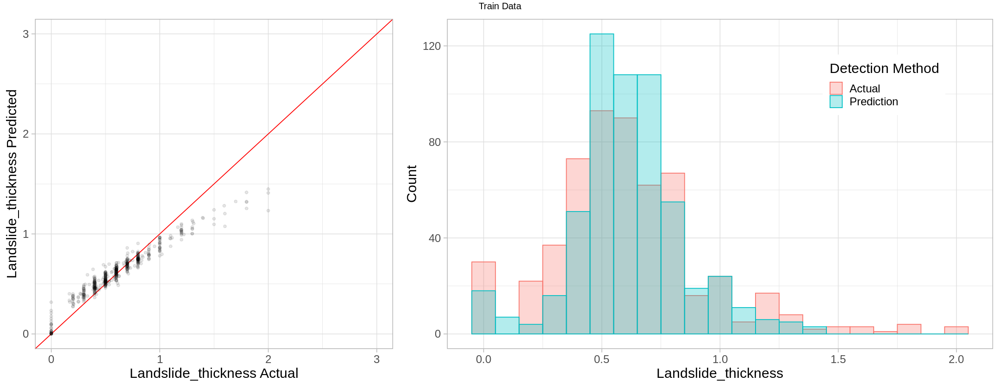

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
hmdb reduced0 hmdb,,,560,0.08176194,NA,NaN,0.1188756,0.9311075,0,⋯,0.250591,NA,NaN,0.3453914,0.1598718,0.0361105,1.001979,-0.5379893,1.359323,0.5333362


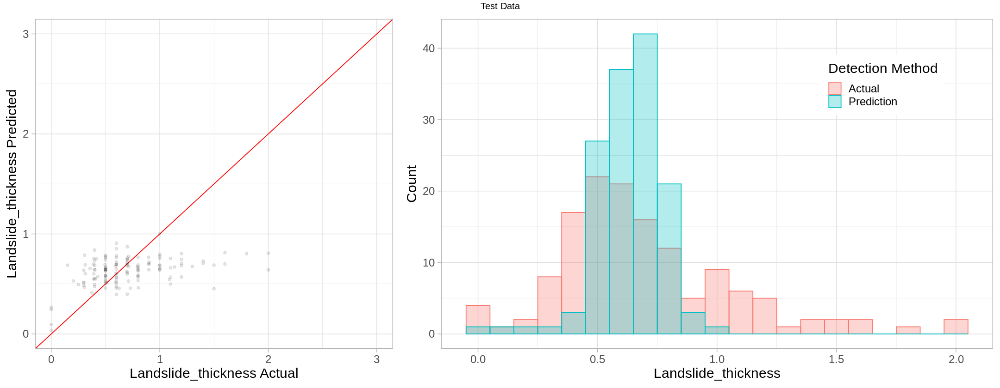

In [133]:
res <- train_test_ranger_caret(merged.df.hmdb , rfe_hmdb_all$optVariables, y_col, label="hmdb reduced0 hmdb", plot=TRUE, data_test=NA, train_size=0.8, seed = 0)
res


Repeating the variable importance and RFE procedures with a reduced set of variables. The reduction was done in an iterative process based on the resutls of the variable importance and analysis of correlations between the variables.

rank,variable_Merged,importance_Merged,variable_HMDB,importance_HMDB,variable_BE,importance_BE
<int>,<chr>,<dbl>,<chr>,<dbl>,<chr>,<dbl>
1,h_5,100.00000,tri_r5_10,100.00000,prcp_24h_200a,100.000000
2,tri_r5_10,88.92002,prcp_60m_100a,96.56819,prcp_24h_200a_0975,82.015959
3,prcp_24h_200a_0975,79.55264,prcp_60m_100a_0975,90.06511,prcp_24h_100a,70.664113
4,prcp_24h_100a_0975,78.90887,prcp_60m_200a,78.84545,prcp_24h_100a_0975,64.732160
5,prcp_24h_200a,76.40737,h_5,72.79553,tri_r5_10,43.768462
6,prcp_24h_100a,66.13175,vrm_r5_25,64.97416,h_5,37.027937
7,mrvbf_10,51.98723,mrvbf_10,63.95191,gc_5,27.699198
8,mrrtf_10,48.27490,prcp_60m_200a_0975,59.23676,twi_5,24.824521
9,slope_5,40.76356,prcp_24h_200a,54.31066,mrrtf_10,24.123162


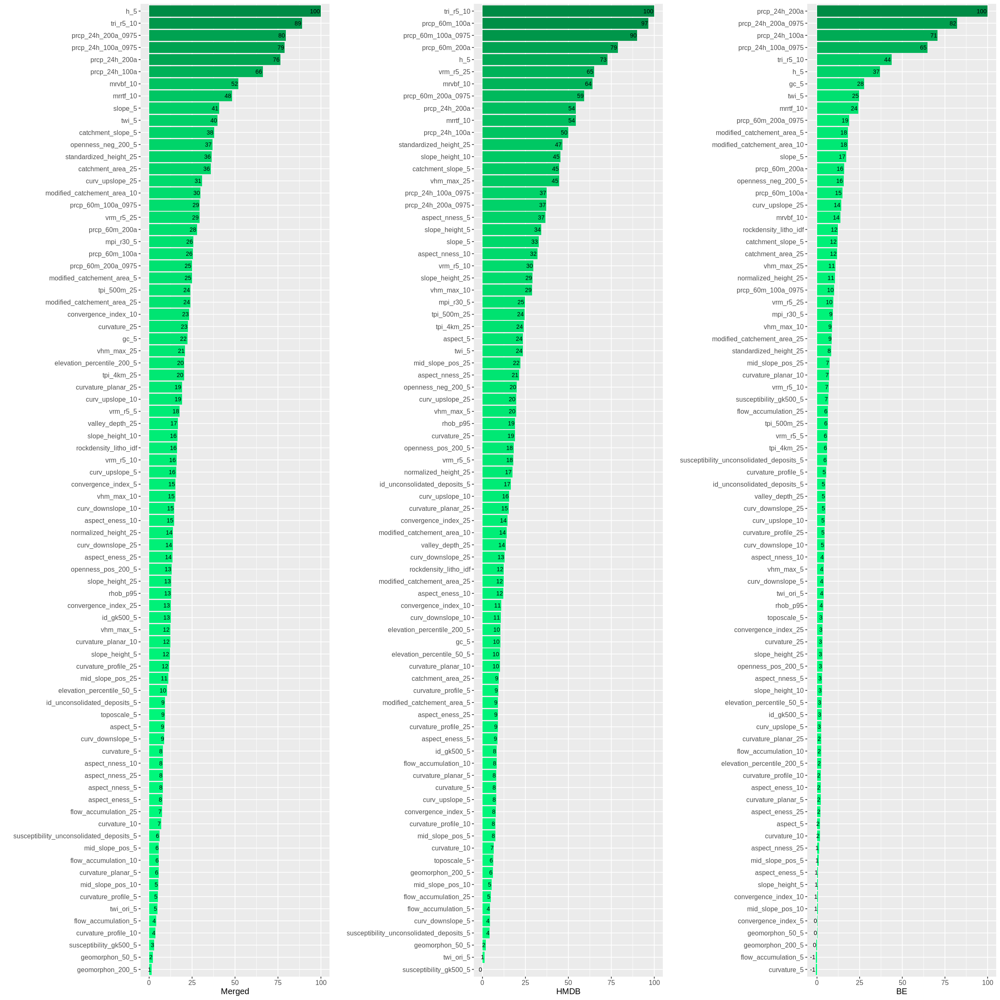

In [134]:
x_cols_reduced1 <- c('h_5', #'h_10', 'h_25',  'h_filled_5', 'h_filled_10', 'h_filled_25', 
                     'twi_ori_5',
                     'catchment_area_25', #'catchment_area_5', 'catchment_area_10',  
                     'catchment_slope_5', #'catchment_slope_10', 'catchment_slope_25', 
                    'modified_catchement_area_5', 'modified_catchement_area_10', 'modified_catchement_area_25', 
                    'twi_5', #'twi_10', 'twi_25', 'twi_ori_10', 'twi_ori_25', 
                     'slope_5',# 'slope_10', 'slope_25', 
                    'aspect_5', #'aspect_10', 'aspect_25',  
                     'aspect_nness_5', 'aspect_nness_10', 'aspect_nness_25', 'aspect_eness_5', 'aspect_eness_10', 'aspect_eness_25',
                     'curvature_5', 'curvature_10', 'curvature_25', 'curvature_profile_5', 'curvature_profile_10',
                    'curvature_profile_25', 'curvature_planar_5', 'curvature_planar_10', 'curvature_planar_25', 
                     # 'openness_pos_20_5', 'openness_neg_20_5', 
                    # 'openness_pos_50_5', 'openness_neg_50_5', 
                     'openness_pos_200_5', 'openness_neg_200_5', 
                     'flow_accumulation_5', 'flow_accumulation_10', 'flow_accumulation_25', 
                      
                     'elevation_percentile_50_5', 'elevation_percentile_200_5', 
                     'tpi_4km_25', 'tpi_500m_25', #  'tpi_15m_5', 'tpi_50m_10', 'tpi_200m_10',  'tpi_1km_25', 'tpi_2km_25', 
                     'mrvbf_10', #'mrvbf_5', 'mrvbf_25', 
                     'mrrtf_10', #'mrrtf_5',  'mrrtf_25', 
                     'convergence_index_5', 'convergence_index_10', 'convergence_index_25', 'curv_upslope_5', 'curv_upslope_10', 
                    'curv_upslope_25', 'curv_downslope_5', 'curv_downslope_10', 'curv_downslope_25', 
                    'mpi_r30_5', #'mpi_r30_10', 'mpi_r30_25', 
                    'vrm_r5_5', 'vrm_r5_10', 'vrm_r5_25', 
                     'tri_r5_10',  #'tri_r5_5', 'tri_r5_25', 
                     'slope_height_5', 'slope_height_10', 'slope_height_25', 
                     'valley_depth_25', #'valley_depth_5', 'valley_depth_10', 
                     'normalized_height_25', #'normalized_height_5', 'normalized_height_10',  
                     'standardized_height_25', #'standardized_height_5', 'standardized_height_10',  
                     'mid_slope_pos_5', 'mid_slope_pos_10', 'mid_slope_pos_25',
                     'toposcale_5', 
                    'gc_5', 'geomorphon_50_5', 'geomorphon_200_5', 'susceptibility_unconsolidated_deposits_5', 'id_unconsolidated_deposits_5', 
                    'susceptibility_gk500_5', 'id_gk500_5', 
                     # 'susceptibility_unconsolidated_deposits_5f','susceptibility_gk500_5f',
                     'vhm_max_25', 'vhm_max_5', 'vhm_max_10', #'vhm_max_5', 'vhm_q3_5', 'vhm_max_10', 'vhm_q3_10',  'vhm_q3_25',
                    'prcp_24h_200a','prcp_24h_200a_0975','prcp_24h_100a','prcp_24h_100a_0975'
                     ,'prcp_60m_100a', 'prcp_60m_200a','prcp_60m_100a_0975','prcp_60m_200a_0975'
                     ,'rockdensity_litho_idf', 'rhob_p95'
                     
                    )

imp_caret_merged <- var_importance_ranger_caret(merged.df.hmdb_be, x_cols_reduced1, y_col, name="Merged", seed = 0)
imp_caret_hmdb <- var_importance_ranger_caret(merged.df.hmdb, x_cols_reduced1, y_col, name="HMDB", seed = 0)
imp_caret_be <- var_importance_ranger_caret(merged.df.be, x_cols_reduced1, y_col, name="BE", seed = 0)


imp_list_caret <- list(imp_caret_merged,imp_caret_hmdb,imp_caret_be)
plot_importance(imp_list_caret, width=20, height=20) 
merge_importance_df(imp_list_caret)



In [135]:
rfe_merged_all <- variable_selection_caret(merged.df.hmdb_be, x=x_cols_reduced1, usePickSizeBest=FALSE,  y=y_col, name="Merged", seed=seed)
rfe_hmdb_all <- variable_selection_caret(merged.df.hmdb, x=x_cols_reduced1, usePickSizeBest=FALSE, y=y_col, name="HMDB", seed=seed)
rfe_be_all <- variable_selection_caret(merged.df.be, x=x_cols_reduced1, usePickSizeBest=FALSE, y=y_col, name="BE", seed=seed)

rfe_merged_all
rfe_hmdb_all
rfe_be_all

rfe_merged_all$optVariables
rfe_hmdb_all$optVariables
rfe_be_all$optVariables

# plot_rfe(rfe_merged_all)
# plot_rfe(rfe_hmdb_all)
# plot_rfe(rfe_be_all)




Recursive feature selection

Outer resampling method: Cross-Validated (10 fold, repeated 5 times) 

Resampling performance over subset size:

 Variables   RMSE Rsquared    MAE  RMSESD RsquaredSD   MAESD Selected
         5 0.3064   0.2995 0.2102 0.02644    0.07611 0.01592        *
         6 0.3063   0.2996 0.2097 0.02637    0.07673 0.01583         
         7 0.3049   0.3049 0.2099 0.02695    0.07798 0.01591         
         8 0.3044   0.3066 0.2098 0.02670    0.07847 0.01545         
         9 0.3048   0.3049 0.2115 0.02725    0.07614 0.01587         
        10 0.3038   0.3085 0.2117 0.02668    0.07315 0.01568         
        15 0.3029   0.3115 0.2126 0.02560    0.07207 0.01462         
        20 0.3033   0.3103 0.2138 0.02590    0.07185 0.01500         
        25 0.3038   0.3082 0.2143 0.02518    0.06918 0.01433         
        30 0.3033   0.3107 0.2141 0.02537    0.07086 0.01427         
        40 0.3042   0.3068 0.2153 0.02435    0.07058 0.01367         
        80 0.3069


Recursive feature selection

Outer resampling method: Cross-Validated (10 fold, repeated 5 times) 

Resampling performance over subset size:

 Variables   RMSE Rsquared    MAE  RMSESD RsquaredSD   MAESD Selected
         5 0.3152   0.1505 0.2272 0.03331    0.07005 0.01995         
         6 0.3113   0.1657 0.2242 0.03383    0.07945 0.02006         
         7 0.3110   0.1677 0.2240 0.03297    0.07835 0.01967         
         8 0.3092   0.1752 0.2231 0.03386    0.08442 0.01982         
         9 0.3102   0.1717 0.2233 0.03317    0.07899 0.01950         
        10 0.3090   0.1764 0.2228 0.03247    0.07949 0.01922         
        15 0.3064   0.1842 0.2211 0.03152    0.07758 0.01818        *
        20 0.3066   0.1809 0.2210 0.03162    0.07977 0.01737         
        25 0.3055   0.1854 0.2208 0.03153    0.07823 0.01759         
        30 0.3045   0.1888 0.2199 0.03074    0.07315 0.01675         
        40 0.3032   0.1950 0.2186 0.03101    0.07611 0.01654         
        80 0.3047


Recursive feature selection

Outer resampling method: Cross-Validated (10 fold, repeated 5 times) 

Resampling performance over subset size:

 Variables   RMSE Rsquared    MAE  RMSESD RsquaredSD   MAESD Selected
         5 0.3075   0.4092 0.1967 0.05100    0.11452 0.02461         
         6 0.2990   0.4413 0.1892 0.04944    0.10917 0.02219         
         7 0.2931   0.4608 0.1857 0.05047    0.11084 0.02287        *
         8 0.2925   0.4632 0.1856 0.04904    0.10974 0.02266         
         9 0.2953   0.4540 0.1875 0.04559    0.10368 0.02190         
        10 0.2958   0.4519 0.1881 0.04519    0.10123 0.02201         
        15 0.2955   0.4528 0.1910 0.04406    0.09918 0.02244         
        20 0.2955   0.4526 0.1922 0.04358    0.09329 0.02214         
        25 0.2974   0.4460 0.1943 0.04196    0.09343 0.02192         
        30 0.2977   0.4436 0.1948 0.04386    0.09470 0.02209         
        40 0.2981   0.4425 0.1958 0.04376    0.09621 0.02177         
        80 0.2987

[1] "h_5"                "tri_r5_10"          "prcp_24h_100a_0975"
[4] "prcp_24h_200a_0975" "prcp_24h_200a"

[1] "tri_r5_10"              "h_5"                    "prcp_60m_100a_0975"    
 [4] "mrvbf_10"               "vrm_r5_25"              "prcp_60m_100a"         
 [7] "prcp_60m_200a"          "prcp_60m_200a_0975"     "prcp_24h_100a"         
[10] "prcp_24h_200a"          "mrrtf_10"               "standardized_height_25"
[13] "prcp_24h_100a_0975"     "vhm_max_25"             "catchment_slope_5"

[1] "prcp_24h_200a"      "prcp_24h_100a"      "prcp_24h_200a_0975"
[4] "prcp_24h_100a_0975" "tri_r5_10"          "h_5"               
[7] "gc_5"

A test fitting based on the RFE result and some visualizations of results/errors.

[1] "hmdb reduced1 hmdb"
[1] 560
[1] 138
Random Forest 

560 samples
  5 predictor

No pre-processing
Resampling: Cross-Validated (10 fold, repeated 10 times) 
Summary of sample sizes: 504, 503, 504, 505, 505, 504, ... 
Resampling results across tuning parameters:

  mtry  min.node.size  RMSE       Rsquared   MAE      
   2    1              0.3064987  0.1700023  0.2187012
   2    2              0.3056007  0.1718965  0.2178843
   2    4              0.3049147  0.1728992  0.2180034
   2    6              0.3044891  0.1711287  0.2173577
   4    1              0.3112354  0.1524686  0.2229078
   4    2              0.3120560  0.1494473  0.2232693
   4    4              0.3104320  0.1536723  0.2220220
   4    6              0.3098133  0.1526354  0.2216069
  10    1                    NaN        NaN        NaN
  10    2                    NaN        NaN        NaN
  10    4                    NaN        NaN        NaN
  10    6                    NaN        NaN        NaN
  60    1          

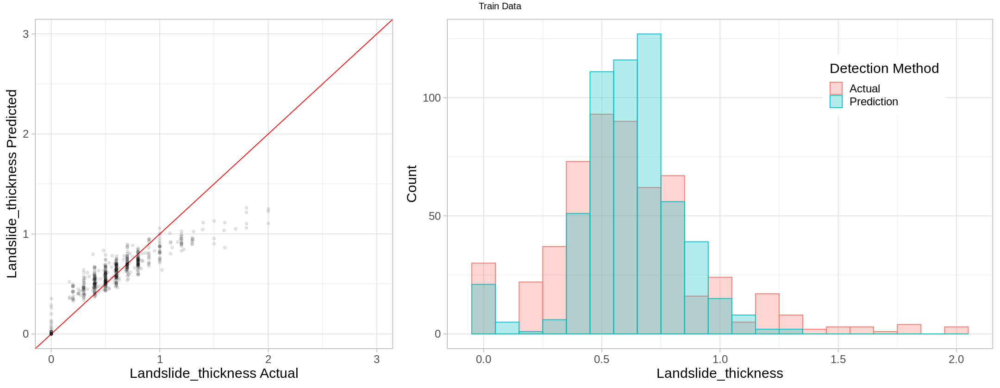

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
hmdb reduced1 hmdb,,,560,0.12009,NA,NaN,0.1713191,0.7899651,0,⋯,0.2505145,NA,NaN,0.3479122,0.1505982,0.01919444,1.041997,-0.6839923,1.343768,0.5554571


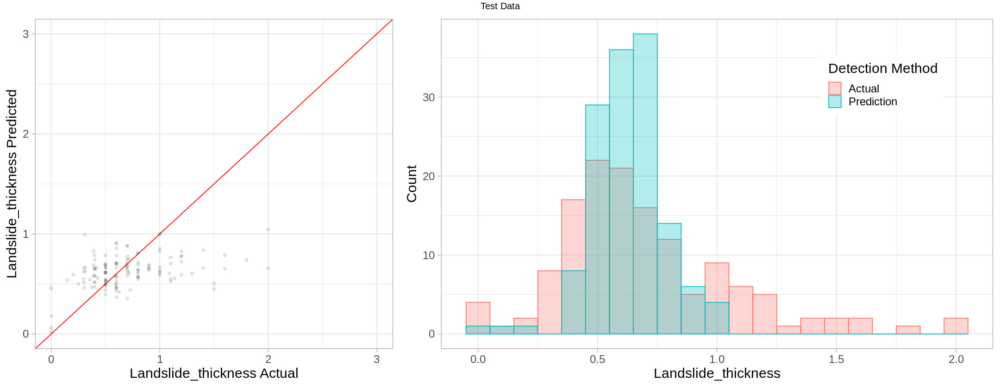

In [136]:
res <- train_test_ranger_caret(merged.df.hmdb , rfe_merged_all$optVariables, y_col, label="hmdb reduced1 hmdb", plot=TRUE, data_test=NA, train_size=0.8, seed = 0, return_model=TRUE)

res


rank,variable_Merged,importance_Merged,variable_HMDB,importance_HMDB,variable_BE,importance_BE
<int>,<chr>,<dbl>,<chr>,<dbl>,<chr>,<dbl>
1,h_5,100.00000,tri_r5_10,100.00000,h_5,100.000000
2,tri_r5_10,93.23530,h_5,60.43756,tri_r5_10,51.943126
3,mrvbf_10,57.21481,vrm_r5_25,54.70934,twi_5,45.478055
4,mrrtf_10,53.46155,standardized_height_25,47.85780,gc_5,30.679389
5,twi_5,52.52038,mrvbf_10,42.47929,rockdensity_litho_idf,28.492079
6,standardized_height_25,47.54440,aspect_nness_10,39.80840,modified_catchement_area_10,23.347293
7,catchment_slope_5,43.95308,slope_height_5,39.55149,mrvbf_10,21.422974
8,gc_5,41.15270,mrrtf_10,39.49665,modified_catchement_area_5,13.118844
9,catchment_area_25,37.43611,aspect_nness_5,37.90926,openness_neg_200_5,11.375704


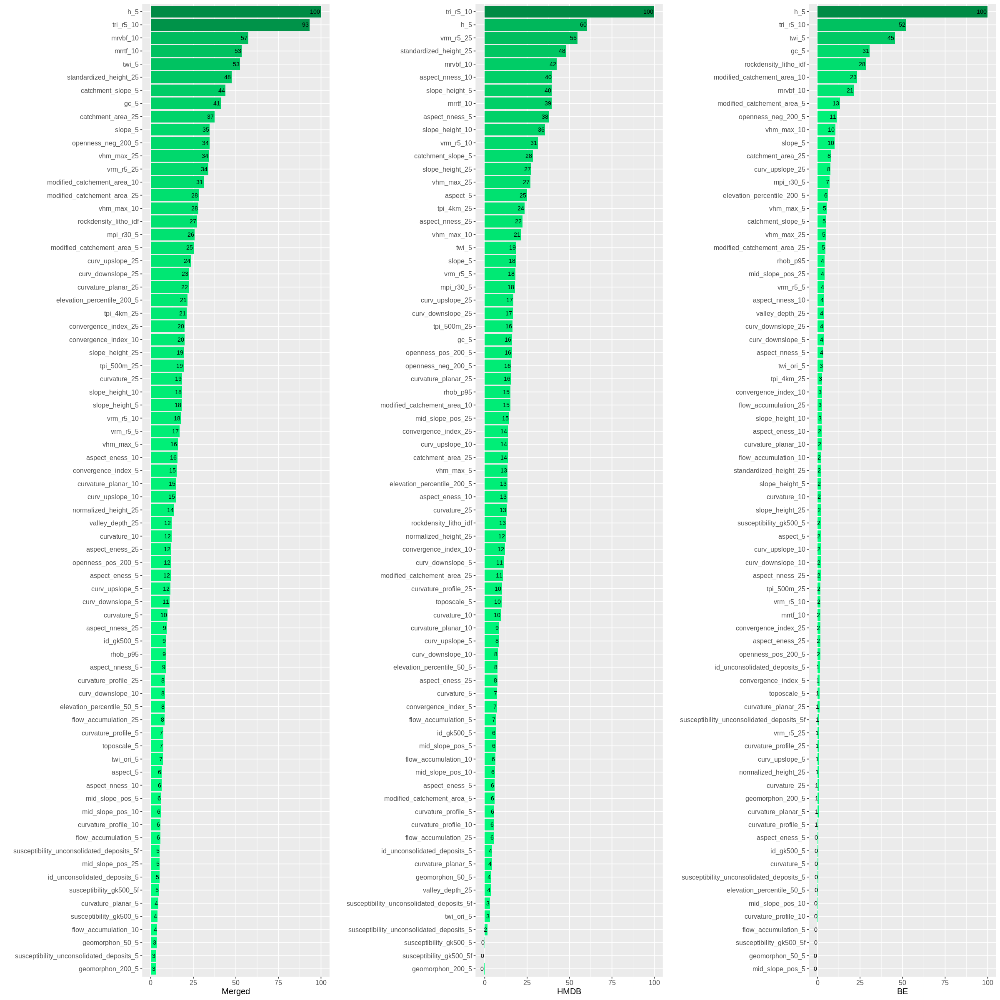

In [137]:
x_cols_reduced2 <- c('h_5', #'h_10', 'h_25',  'h_filled_5', 'h_filled_10', 'h_filled_25', 
                     'twi_ori_5',
                     'catchment_area_25', #'catchment_area_5', 'catchment_area_10',  
                     'catchment_slope_5', #'catchment_slope_10', 'catchment_slope_25', 
                    'modified_catchement_area_5', 'modified_catchement_area_10', 'modified_catchement_area_25', 
                    'twi_5', #'twi_10', 'twi_25', 'twi_ori_10', 'twi_ori_25', 
                     'slope_5',# 'slope_10', 'slope_25', 
                    'aspect_5', #'aspect_10', 'aspect_25',  
                     'aspect_nness_5', 'aspect_nness_10', 'aspect_nness_25', 'aspect_eness_5', 'aspect_eness_10', 'aspect_eness_25',
                     'curvature_5', 'curvature_10', 'curvature_25', 'curvature_profile_5', 'curvature_profile_10',
                    'curvature_profile_25', 'curvature_planar_5', 'curvature_planar_10', 'curvature_planar_25', 
                     # 'openness_pos_20_5', 'openness_neg_20_5', 
                    # 'openness_pos_50_5', 'openness_neg_50_5', 
                     'openness_pos_200_5', 'openness_neg_200_5', 
                     'flow_accumulation_5', 'flow_accumulation_10', 'flow_accumulation_25', 
                      
                     'elevation_percentile_50_5', 'elevation_percentile_200_5', 
                     'tpi_4km_25', 'tpi_500m_25', #  'tpi_15m_5', 'tpi_50m_10', 'tpi_200m_10',  'tpi_1km_25', 'tpi_2km_25', 
                     'mrvbf_10', #'mrvbf_5', 'mrvbf_25', 
                     'mrrtf_10', #'mrrtf_5',  'mrrtf_25', 
                     'convergence_index_5', 'convergence_index_10', 'convergence_index_25', 'curv_upslope_5', 'curv_upslope_10', 
                    'curv_upslope_25', 'curv_downslope_5', 'curv_downslope_10', 'curv_downslope_25', 
                    'mpi_r30_5', #'mpi_r30_10', 'mpi_r30_25', 
                    'vrm_r5_5', 'vrm_r5_10', 'vrm_r5_25', 
                     'tri_r5_10',  #'tri_r5_5', 'tri_r5_25', 
                     'slope_height_5', 'slope_height_10', 'slope_height_25', 
                     'valley_depth_25', #'valley_depth_5', 'valley_depth_10', 
                     'normalized_height_25', #'normalized_height_5', 'normalized_height_10',  
                     'standardized_height_25', #'standardized_height_5', 'standardized_height_10',  
                     'mid_slope_pos_5', 'mid_slope_pos_10', 'mid_slope_pos_25',
                     'toposcale_5', 
                    'gc_5', 'geomorphon_50_5', 'geomorphon_200_5', 'susceptibility_unconsolidated_deposits_5', 'id_unconsolidated_deposits_5', 
                    'susceptibility_gk500_5', 'id_gk500_5',
                     'susceptibility_unconsolidated_deposits_5f','susceptibility_gk500_5f',
                     'vhm_max_25', 'vhm_max_5', 'vhm_max_10'#, 'vhm_q3_5',  'vhm_q3_10',  'vhm_q3_25',

                     ,'rockdensity_litho_idf', 'rhob_p95'
                    )



imp_caret_merged <- var_importance_ranger_caret(merged.df.hmdb_be, x_cols_reduced2, y_col, name="Merged", seed = 0)
imp_caret_hmdb <- var_importance_ranger_caret(merged.df.hmdb, x_cols_reduced2, y_col, name="HMDB", seed = 0)
imp_caret_be <- var_importance_ranger_caret(merged.df.be, x_cols_reduced2, y_col, name="BE", seed = 0)


imp_list_caret <- list(imp_caret_merged,imp_caret_hmdb,imp_caret_be)
plot_importance(imp_list_caret, width=20, height=20) 
merge_importance_df(imp_list_caret)


In [138]:
rfe_merged_all <- variable_selection_caret(merged.df.hmdb_be, x=x_cols_reduced2, usePickSizeBest=FALSE, y=y_col, name="Merged", seed=seed)
rfe_hmdb_all <- variable_selection_caret(merged.df.hmdb, x=x_cols_reduced2, usePickSizeBest=FALSE, y=y_col, name="HMDB", seed=seed)
rfe_be_all <- variable_selection_caret(merged.df.be, x=x_cols_reduced2, usePickSizeBest=FALSE, y=y_col, name="BE", seed=seed)

rfe_merged_all
rfe_hmdb_all
rfe_be_all

rfe_merged_all$optVariables
rfe_hmdb_all$optVariables
rfe_be_all$optVariables

# plot_rfe(rfe_merged_all)
# plot_rfe(rfe_hmdb_all)
# plot_rfe(rfe_be_all)




Recursive feature selection

Outer resampling method: Cross-Validated (10 fold, repeated 5 times) 

Resampling performance over subset size:

 Variables   RMSE Rsquared    MAE  RMSESD RsquaredSD   MAESD Selected
         5 0.3262   0.2058 0.2325 0.02358    0.05774 0.01383         
         6 0.3242   0.2131 0.2317 0.02389    0.05835 0.01360         
         7 0.3231   0.2163 0.2316 0.02431    0.05753 0.01374         
         8 0.3221   0.2201 0.2307 0.02442    0.05569 0.01342         
         9 0.3221   0.2217 0.2307 0.02414    0.06046 0.01413         
        10 0.3214   0.2245 0.2301 0.02399    0.05845 0.01365         
        15 0.3205   0.2285 0.2296 0.02341    0.05932 0.01295        *
        20 0.3184   0.2381 0.2277 0.02335    0.05550 0.01315         
        25 0.3171   0.2441 0.2263 0.02316    0.05881 0.01346         
        30 0.3166   0.2476 0.2260 0.02434    0.06235 0.01347         
        40 0.3176   0.2428 0.2278 0.02328    0.06331 0.01272         
        74 0.3167


Recursive feature selection

Outer resampling method: Cross-Validated (10 fold, repeated 5 times) 

Resampling performance over subset size:

 Variables   RMSE Rsquared    MAE  RMSESD RsquaredSD   MAESD Selected
         5 0.3148   0.1423 0.2262 0.03098    0.07430 0.01788         
         6 0.3139   0.1450 0.2255 0.03201    0.07456 0.01762         
         7 0.3131   0.1464 0.2253 0.03233    0.07457 0.01753        *
         8 0.3119   0.1518 0.2250 0.03315    0.07962 0.01773         
         9 0.3127   0.1496 0.2253 0.03395    0.07807 0.01825         
        10 0.3121   0.1510 0.2254 0.03348    0.07732 0.01773         
        15 0.3101   0.1597 0.2242 0.03278    0.07790 0.01745         
        20 0.3093   0.1637 0.2235 0.03339    0.08000 0.01713         
        25 0.3096   0.1618 0.2237 0.03264    0.08010 0.01758         
        30 0.3088   0.1658 0.2233 0.03217    0.07920 0.01671         
        40 0.3087   0.1662 0.2233 0.03197    0.08022 0.01677         
        74 0.3086


Recursive feature selection

Outer resampling method: Cross-Validated (10 fold, repeated 5 times) 

Resampling performance over subset size:

 Variables   RMSE Rsquared    MAE  RMSESD RsquaredSD   MAESD Selected
         5 0.3217   0.3503 0.2188 0.04009     0.1087 0.02593         
         6 0.3183   0.3651 0.2158 0.04202     0.1089 0.02700        *
         7 0.3181   0.3633 0.2157 0.04442     0.1161 0.02790         
         8 0.3160   0.3708 0.2142 0.04628     0.1219 0.02924         
         9 0.3139   0.3797 0.2121 0.04414     0.1131 0.02726         
        10 0.3152   0.3749 0.2136 0.04458     0.1143 0.02752         
        15 0.3157   0.3735 0.2142 0.04483     0.1089 0.02674         
        20 0.3163   0.3694 0.2156 0.04410     0.1048 0.02556         
        25 0.3157   0.3730 0.2161 0.04439     0.1042 0.02532         
        30 0.3162   0.3720 0.2165 0.04514     0.1072 0.02594         
        40 0.3136   0.3845 0.2161 0.04484     0.1032 0.02593         
        74 0.3140

[1] "h_5"                         "tri_r5_10"                  
 [3] "mrvbf_10"                    "mrrtf_10"                   
 [5] "twi_5"                       "standardized_height_25"     
 [7] "catchment_slope_5"           "slope_5"                    
 [9] "catchment_area_25"           "openness_neg_200_5"         
[11] "vrm_r5_25"                   "modified_catchement_area_10"
[13] "modified_catchement_area_25" "vhm_max_25"                 
[15] "modified_catchement_area_5"

[1] "tri_r5_10"              "h_5"                    "mrvbf_10"              
[4] "vrm_r5_25"              "standardized_height_25" "mrrtf_10"              
[7] "slope_height_10"

[1] "h_5"                   "tri_r5_10"             "twi_5"                
[4] "mrvbf_10"              "gc_5"                  "rockdensity_litho_idf"

Some Test fittings with variable selections based on the importance, RFE results and exper input.

In [139]:
x_cols_test_1 <- c( 

 'prcp_60m_10a_0975'
                 ,'tri_r5_10'
                 ,'tri_r5_5'
                 ,'tpi_4km_25'
                 ,'tpi_500m_25'
                 ,'vhm_max_5'
                 ,'h_5'
                 ,'vrm_r5_25'
                 ,'mrvbf_10'#,'mrvbf_10'
                 ,'mrrtf_25'#,'mrrtf_10'
                 ,'slope_height_25'
                 ,'catchment_slope_25'#,'catchment_slope_5'
                 ,'valley_depth_25'
                 ,'standardized_height_25'
                 ,'slope_10'#,'slope_5'
                 ,'aspect_nness_10'
                 ,'twi_5'
                 ,'curvature_10'
                 ,'curvature_profile_25'
                 ,'catchment_area_25'
                 ,'openness_pos_200_5'
                ,'rhob_p95'
                )

x_cols_test_2 <- c( 
              
 'prcp_60m_10a_0975'
                 ,'tri_r5_10'
                 ,'tri_r5_5'
                 ,'tpi_4km_25'
                 ,'tpi_500m_25'
                 ,'vhm_max_5'
                 ,'h_5'
                 ,'vrm_r5_25'
                 ,'mrvbf_10'#,'mrvbf_10'
                 ,'mrrtf_25'#,'mrrtf_10'
                 ,'slope_height_25'
                 ,'catchment_slope_25'#,'catchment_slope_5'
                 ,'valley_depth_25'
                 ,'standardized_height_25'
                 ,'slope_10'#,'slope_5'
                 ,'aspect_nness_10'
                 ,'twi_5'
                 ,'curvature_10'
                 ,'curvature_profile_25'
                 ,'catchment_area_25'
                 ,'openness_pos_200_5'
                ,'rhob_med'
                )

x_cols_test_3 <- c( 
 'prcp_60m_10a_0975'
                 ,'tri_r5_10'
                 ,'tri_r5_5'
                 ,'tpi_4km_25'
                 ,'tpi_500m_25'
                 ,'vhm_max_5'
                 ,'h_5'
                 ,'mrvbf_10'#,'mrvbf_10'
                 ,'mrrtf_25'#,'mrrtf_10'
                 ,'slope_height_25'
                 ,'catchment_slope_25'#,'catchment_slope_5'
                 ,'valley_depth_25'
                 ,'standardized_height_25'
                 ,'slope_10'#,'slope_5'
                 ,'aspect_nness_10'
                 ,'twi_5'
                 ,'curvature_10'
                 ,'curvature_profile_25'
                 ,'catchment_area_25'
                 ,'openness_pos_200_5'
                ,'rhob_m'
    
                )




test_res <- NULL
res <- train_test_ranger_caret(merged.df.hmdb , x_cols_test_1, y_col, label="hmdb test hmdb", plot=FALSE, data_test=NA, train_size=0.8, seed = 0 )
test_res <- rbind(test_res,res)
res <- train_test_ranger_caret(merged.df.hmdb , x_cols_test_2, y_col, label="hmdb test hmdb", plot=FALSE, data_test=NA, train_size=0.8, seed = 0 )
test_res <- rbind(test_res,res)
res <- train_test_ranger_caret(merged.df.hmdb , x_cols_test_3, y_col, label="hmdb test hmdb", plot=FALSE, data_test=NA, train_size=0.8, seed = 0 )
test_res <- rbind(test_res,res)

test_res


[1] "hmdb test hmdb"
[1] 560
[1] 138
Random Forest 

560 samples
 22 predictor

No pre-processing
Resampling: Cross-Validated (10 fold, repeated 10 times) 
Summary of sample sizes: 504, 503, 504, 505, 505, 504, ... 
Resampling results across tuning parameters:

  mtry  min.node.size  RMSE       Rsquared   MAE      
   2    1              0.2957233  0.1981846  0.2124329
   2    2              0.2952632  0.2010577  0.2124955
   2    4              0.2956585  0.1996797  0.2121344
   2    6              0.2948205  0.2034878  0.2120067
   4    1              0.2964397  0.1964177  0.2131113
   4    2              0.2961173  0.1968518  0.2126301
   4    4              0.2954353  0.2005438  0.2124553
   4    6              0.2959254  0.1983770  0.2124613
  10    1              0.2973322  0.1936726  0.2123523
  10    2              0.2983426  0.1879839  0.2138232
  10    4              0.2977991  0.1915985  0.2130100
  10    6              0.2975055  0.1919324  0.2128726
  60    1              

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
hmdb test hmdb,,,560,0.09941545,NA,0.2596978,0.1457404,0.9031664,0.01395572,⋯,0.2510361,NA,0.2596978,0.3597034,0.08116295,0.04528811,0.8781314,-0.5764327,1.399598,0.5226677
hmdb test hmdb,,,560,0.09870877,NA,0.2587848,0.1446679,0.9037374,0.00860000,⋯,0.2528602,NA,0.2587848,0.3595781,0.08120066,0.05269527,0.8925832,-0.6103489,1.415126,0.5268986
hmdb test hmdb,,,560,0.08004028,NA,0.2324169,0.1132538,0.9507303,0.00500000,⋯,0.2529864,NA,0.2324169,0.3573949,0.08654488,0.07332394,0.8950840,-0.5996820,1.356677,0.5268553


<a id="Train_Test_Dataset_Setup"></a>
### Train/Test Dataset Setup

Setting the set of variables for the final model.

In [140]:
x_cols_manual <- c( 
                 # 'prcp_60m_10a_0975',
                 'tri_r5_10'
                 ,'tri_r5_5'
                 ,'tpi_4km_25'
                 ,'tpi_500m_25'
                 ,'vhm_max_5'
                 ,'h_5'
                 ,'vrm_r5_25'
                 ,'mrvbf_10'#,'mrvbf_10'
                 ,'mrrtf_25'#,'mrrtf_10'
                 ,'slope_height_25'
                 ,'catchment_slope_25'#,'catchment_slope_5'
                 ,'valley_depth_25'
                 ,'standardized_height_25'
                 ,'slope_10'#,'slope_5'
                 ,'aspect_nness_10'
                 ,'twi_5'
                 ,'curvature_10'
                 ,'curvature_profile_25'
                 ,'catchment_area_25'
                 ,'openness_neg_200_5'
                ,'rhob_m'
                )

rank,variable_HMDB,importance_HMDB,variable_BE,importance_BE
<int>,<chr>,<dbl>,<chr>,<dbl>
1,tri_r5_10,100.00000,h_5,100.000000
2,mrrtf_25,65.48127,tri_r5_10,75.452037
3,slope_10,61.67587,twi_5,57.812580
4,tri_r5_5,60.51916,tri_r5_5,49.880000
5,mrvbf_10,59.61591,rhob_m,46.135961
6,catchment_slope_25,56.89589,mrrtf_25,27.654941
7,h_5,52.96775,catchment_slope_25,24.752547
8,standardized_height_25,42.81570,catchment_area_25,23.762653
9,vrm_r5_25,42.15765,openness_neg_200_5,21.578856


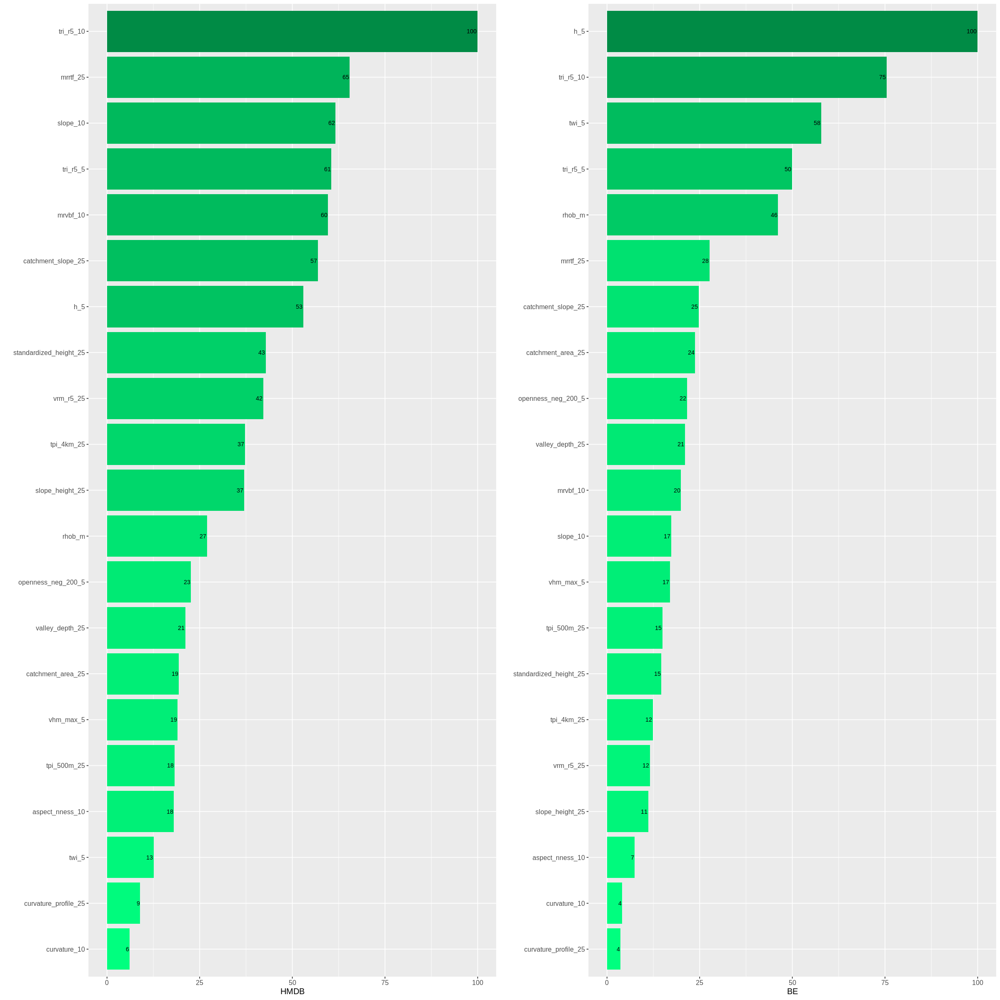

In [141]:
imp_caret_hmdb <- var_importance_ranger_caret(merged.df.hmdb, x_cols_manual, y_col, name="HMDB", seed = 0)
imp_caret_be <- var_importance_ranger_caret(merged.df.be, x_cols_manual, y_col, name="BE", seed = 0)


imp_list_caret <- list(imp_caret_hmdb,imp_caret_be)
plot_importance(imp_list_caret, width=20, height=20) 
merge_importance_df(imp_list_caret)



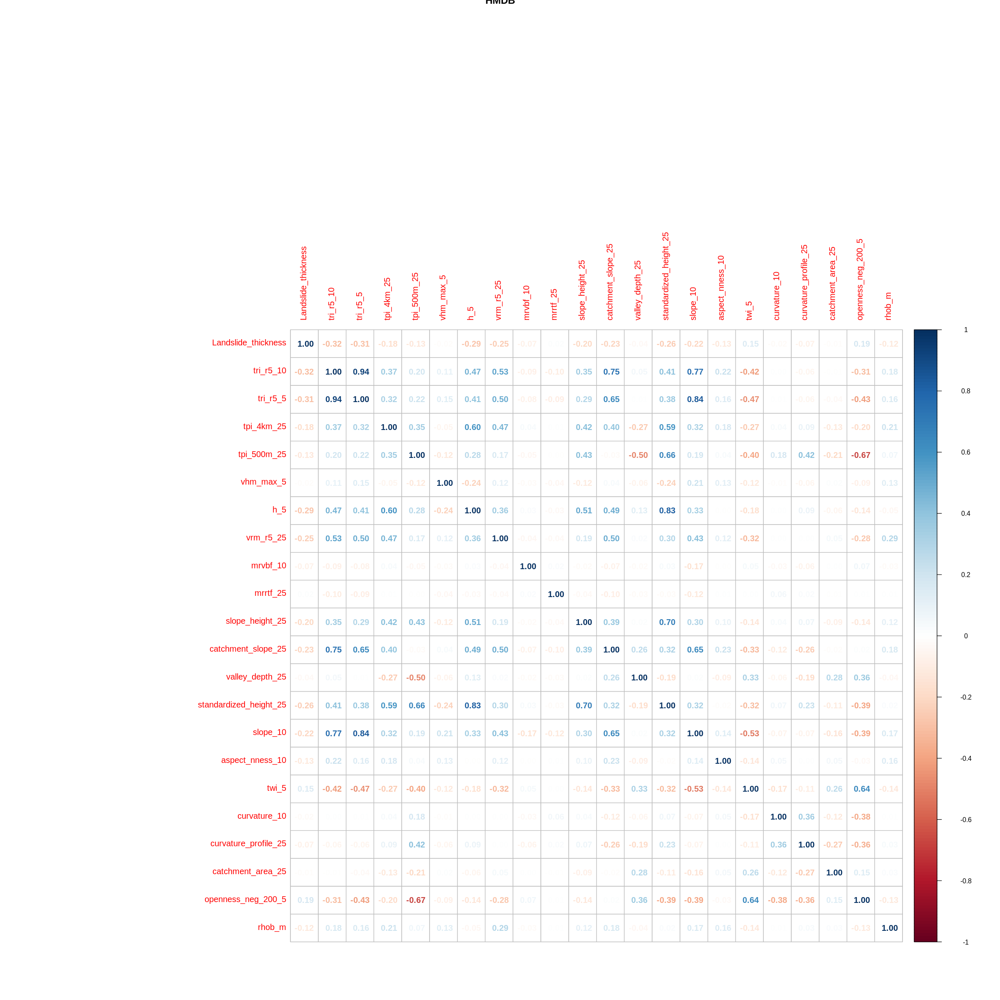

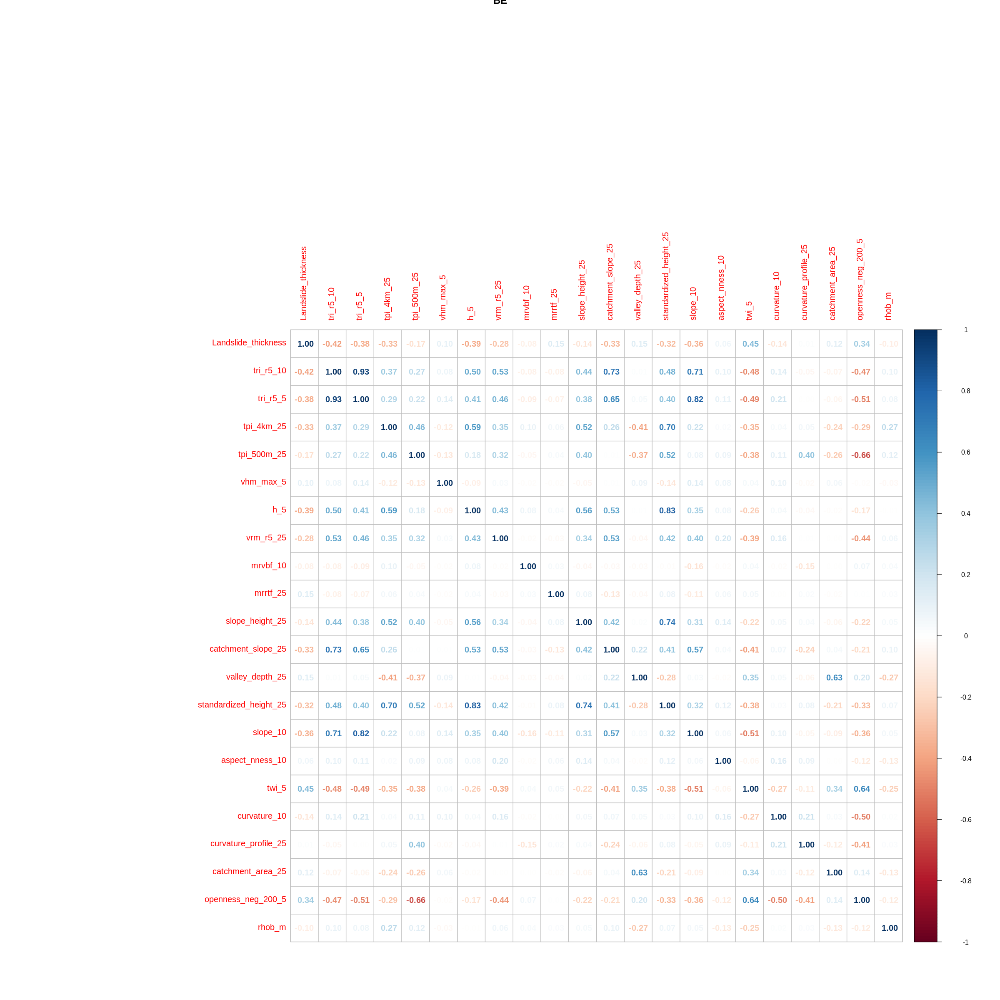

In [142]:
cor_cols <- append(y_col, x_cols_manual)

plot_correlation_by_dataset(cor_cols,width=20,height=20)

In [143]:
for(var in x_cols_manual) {
    print(var)
    print(summary(merged.df.hmdb[,var]))
    print(quantile(merged.df.hmdb[,var], c(.05, .95, 0.99, 1),na.rm=TRUE))
}

[1] "tri_r5_10"
   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  4.378  13.047  16.236  16.481  19.186  64.567 
       5%       95%       99%      100% 
 9.381899 23.783427 33.886530 64.566849 
[1] "tri_r5_5"
   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  2.534   6.980   8.622   8.772  10.004  38.391 
       5%       95%       99%      100% 
 4.939071 12.376182 20.686680 38.391068 
[1] "tpi_4km_25"
    Min.  1st Qu.   Median     Mean  3rd Qu.     Max. 
-407.883  -60.564    6.449   36.541  123.614  830.753 
       5%       95%       99%      100% 
-188.9000  320.7896  422.9916  830.7527 
[1] "tpi_500m_25"
   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
-68.509 -12.928   1.723   3.603  17.083 145.385 
       5%       95%       99%      100% 
-34.37178  45.80454  72.47536 145.38522 
[1] "vhm_max_5"
   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
   0.00    0.21    5.15   10.84   20.36   44.91 
     5%     95%     99%    100% 
 0.0000 34.4320 39.7396 44.9100 
[1] "h_5"
   Min. 1st 

In [144]:
partition_column <- "Failure_volume"
x_columns <-  x_cols_manual
y_column <- y_col
y_column_perp <- y_col_perp



In [145]:
# Setup HMDB
set.seed(seed)

data <- merged.df.hmdb
data <- data[!is.na(data[,partition_column]),]
in_train_hmdb <- createDataPartition(data[,partition_column], p = train_size)
data_train_hmdb <- data[in_train_hmdb[[1]],]
data_test_hmdb <- data[-in_train_hmdb[[1]],]

# data_train_hmdb <- data_train_hmdb[, append(x_columns, y_column)]
# data_test_hmdb <- data_test_hmdb[, append(x_columns, y_column)]

data_train_hmdb <- data_train_hmdb[complete.cases(data_train_hmdb[, append(x_columns, y_column)]),]
data_test_hmdb <- data_test_hmdb[complete.cases(data_test_hmdb[, append(x_columns, y_column)]),]

print(nrow(data_train_hmdb))
print(nrow(data_test_hmdb))

data_train_hmdb_y <- data_train_hmdb[,y_column]
data_train_hmdb_x <- data_train_hmdb[,x_columns]

data_test_hmdb_y <- data_test_hmdb[,y_column]
data_test_hmdb_x <- data_test_hmdb[,x_columns]


[1] 560
[1] 138


In [146]:
# Setup StorMe
set.seed(seed)

data <- merged.df.storme
data <- data[!is.na(data[,partition_column]),]
in_train_storme <- createDataPartition(data[,partition_column], p = train_size)
data_train_storme <- data[in_train_storme[[1]],]
data_test_storme <- data[-in_train_storme[[1]],]

# data_train_storme <- data_train_storme[, append(x_columns, y_column)]
# data_test_storme <- data_test_storme[, append(x_columns, y_column)]

data_train_storme <- data_train_storme[complete.cases(data_train_storme[, append(x_columns, y_column)]),]
data_test_storme <- data_test_storme[complete.cases(data_test_storme[, append(x_columns, y_column)]),]

print(nrow(data_train_storme))
print(nrow(data_test_storme))

data_train_storme_y <- data_train_storme[,y_column]
data_train_storme_x <- data_train_storme[,x_columns]

data_test_storme_y <- data_test_storme[,y_column]
data_test_storme_x <- data_test_storme[,x_columns]



[1] 2341
[1] 583


In [147]:
#Setup BE
set.seed(seed)

data <- merged.df.be
data <- data[!is.na(data[,partition_column]),]
in_train_be <- createDataPartition(data[,partition_column], p = train_size)
data_train_be <- data[in_train_be[[1]],]
data_test_be <- data[-in_train_be[[1]],]

# data_train_be <- data_train_be[, append(x_columns, y_column)]
# data_test_be <- data_test_be[, append(x_columns, y_column)]

data_train_be <- data_train_be[complete.cases(data_train_be[, append(x_columns, y_column)]),]
data_test_be <- data_test_be[complete.cases(data_test_be[, append(x_columns, y_column)]),]

print(nrow(data_train_be))
print(nrow(data_test_be))

data_train_be_y <- data_train_be[,y_column]
data_train_be_x <- data_train_be[,x_columns]

data_test_be_y <- data_test_be[,y_column]
data_test_be_x <- data_test_be[,x_columns]







[1] 458
[1] 112


In [148]:
# Setup HMDB StorMe cross test
data_train_hmdb_storme <- data_train_hmdb
data_test_hmdb_storme <- merged.df.storme

data_train_hmdb_storme <- data_train_hmdb_storme[complete.cases(data_train_hmdb_storme[, append(x_columns, y_column)]),]
data_test_hmdb_storme <- data_test_hmdb_storme[complete.cases(data_test_hmdb_storme[, append(x_columns, y_column)]),]

print(nrow(data_train_hmdb_storme))
print(nrow(data_test_hmdb_storme))

data_train_hmdb_storme_y <- data_train_hmdb_storme[,y_column]
data_train_hmdb_storme_x <- data_train_hmdb_storme[,x_columns]

data_test_hmdb_storme_y <- data_test_hmdb_storme[,y_column]
data_test_hmdb_storme_x <- data_test_hmdb_storme[,x_columns]

# Setup BE HMDB cross test
data_train_be_hmdb <- data_train_be
data_test_be_hmdb <- merged.df.hmdb

data_train_be_hmdb <- data_train_be_hmdb[complete.cases(data_train_be_hmdb[, append(x_columns, y_column)]),]
data_test_be_hmdb <- data_test_be_hmdb[complete.cases(data_test_be_hmdb[, append(x_columns, y_column)]),]

print(nrow(data_train_be_hmdb))
print(nrow(data_test_be_hmdb))

data_train_be_hmdb_y <- data_train_be_hmdb[,y_column]
data_train_be_hmdb_x <- data_train_be_hmdb[,x_columns]

data_test_be_hmdb_y <- data_test_be_hmdb[,y_column]
data_test_be_hmdb_x <- data_test_be_hmdb[,x_columns]

# Setup HMDB BE cross test
data_train_hmdb_be <- data_train_hmdb
data_test_hmdb_be <- merged.df.be

data_train_hmdb_be <- data_train_hmdb_be[complete.cases(data_train_hmdb_be[, append(x_columns, y_column)]),]
data_test_hmdb_be <- data_test_hmdb_be[complete.cases(data_test_hmdb_be[, append(x_columns, y_column)]),]

print(nrow(data_train_hmdb_be))
print(nrow(data_test_hmdb_be))

data_train_hmdb_be_y <- data_train_hmdb_be[,y_column]
data_train_hmdb_be_x <- data_train_hmdb_be[,x_columns]

data_test_hmdb_be_y <- data_test_hmdb_be[,y_column]
data_test_hmdb_be_x <- data_test_hmdb_be[,x_columns]


[1] 560
[1] 3175
[1] 458
[1] 743
[1] 560
[1] 570


In [149]:
crs.lv95 <- st_crs("EPSG:2056")
merged.spdf <- st_as_sf(merged.df, coords = c("X", "Y"), crs = crs.lv95, remove=FALSE)
merged.spdf.hmdb <- st_as_sf(merged.df.hmdb, coords = c("X", "Y"), crs = crs.lv95, remove=FALSE)
merged.spdf.storme <- st_as_sf(merged.df.storme, coords = c("X", "Y"), crs = crs.lv95, remove=FALSE)
merged.spdf.be <- st_as_sf(merged.df.be, coords = c("X", "Y"), crs = crs.lv95, remove=FALSE)

data_train_hmdb.spdf <-  st_as_sf(data_train_hmdb, coords = c("X", "Y"), crs = crs.lv95, remove=FALSE)
data_test_hmdb.spdf <-  st_as_sf(data_test_hmdb, coords = c("X", "Y"), crs = crs.lv95, remove=FALSE)

data_train_storme.spdf <-  st_as_sf(data_train_storme, coords = c("X", "Y"), crs = crs.lv95, remove=FALSE)
data_test_storme.spdf <-  st_as_sf(data_test_storme, coords = c("X", "Y"), crs = crs.lv95, remove=FALSE)

data_train_be.spdf <-  st_as_sf(data_train_be, coords = c("X", "Y"), crs = crs.lv95, remove=FALSE)
data_test_be.spdf <-  st_as_sf(data_test_be, coords = c("X", "Y"), crs = crs.lv95, remove=FALSE)

data_train_hmdb_storme.spdf <-  st_as_sf(data_train_hmdb_storme, coords = c("X", "Y"), crs = crs.lv95, remove=FALSE)
data_test_hmdb_storme.spdf <-  st_as_sf(data_test_hmdb_storme, coords = c("X", "Y"), crs = crs.lv95, remove=FALSE)

data_train_be_hmdb.spdf <-  st_as_sf(data_train_be_hmdb, coords = c("X", "Y"), crs = crs.lv95, remove=FALSE)
data_test_be_hmdb.spdf <-  st_as_sf(data_test_be_hmdb, coords = c("X", "Y"), crs = crs.lv95, remove=FALSE)

data_train_hmdb_be.spdf <-  st_as_sf(data_train_hmdb_be, coords = c("X", "Y"), crs = crs.lv95, remove=FALSE)
data_test_hmdb_be.spdf <-  st_as_sf(data_test_hmdb_be, coords = c("X", "Y"), crs = crs.lv95, remove=FALSE)


<a id="Paper_Model_Random_Forest"></a>
### Random Forest

Preparing the parameter grid for the hyperparameter tuning. Tuning of 1) mtry, and 2) numtrees shows the most influence. Out of the Box only mtry, splitrule, and min.node.size are tunable. Therefore, a modified function that additionally supports tuning the num.trees and max.depth parameters parameters is used.

In [150]:
seq.num.trees <- c(25,50,100,150,200,250,300,400,500)
seq.num.trees 

seq.max.depth <- c(20,70,120,170,220,270) 
seq.max.depth

seq.min.node.size <- c(2, 4, 6, 8, 10, 12)
seq.min.node.size  

seq.mtry <- c(2,4,6,8,10,14,18,22,26)
seq.mtry

split.rule <- c("variance","extratrees","maxstat")
split.rule

rf.tune.grid <- expand.grid(
                       
                      mtry = seq.mtry
                      ,splitrule = split.rule
                      ,min.node.size = seq.min.node.size
                      ,num.trees = seq.num.trees
                      ,max.depth = seq.max.depth
)

nrow(rf.tune.grid)

seq.num.trees <- c(50,100,200)
seq.num.trees 

seq.max.depth <- c(50,100,150,200,250) 
seq.max.depth

seq.min.node.size <- c(2, 6, 8, 10, 12)
seq.min.node.size  

seq.mtry <- c(2,6,8,10,22)
seq.mtry

split.rule <- c("variance","extratrees","maxstat")
split.rule

rf.tune.grid <- expand.grid(
                      mtry = seq.mtry
                      ,splitrule = split.rule
                      ,min.node.size = seq.min.node.size
                      ,num.trees = seq.num.trees
                      ,max.depth = seq.max.depth
)

nrow(rf.tune.grid)


[1]  25  50 100 150 200 250 300 400 500

[1]  20  70 120 170 220 270

[1]  2  4  6  8 10 12

[1]  2  4  6  8 10 14 18 22 26

[1] "variance"   "extratrees" "maxstat"

[1] 8748

[1]  50 100 200

[1]  50 100 150 200 250

[1]  2  6  8 10 12

[1]  2  6  8 10 22

[1] "variance"   "extratrees" "maxstat"

[1] 1125

[1] "Random Forest HMDB HMDB"
Time difference of 6.312903 mins
custom variable importance

  only 20 most important variables shown (out of 21)

                       Overall
tri_r5_10              100.000
catchment_slope_25      74.945
h_5                     67.345
slope_10                49.425
mrrtf_25                49.077
mrvbf_10                48.377
standardized_height_25  34.588
vhm_max_5               25.150
tri_r5_5                24.790
tpi_4km_25              23.174
slope_height_25         20.549
rhob_m                  18.722
aspect_nness_10         12.982
openness_neg_200_5      12.392
catchment_area_25       11.726
vrm_r5_25               10.396
curvature_profile_25    10.109
valley_depth_25          5.961
tpi_500m_25              4.625
twi_5                    2.993


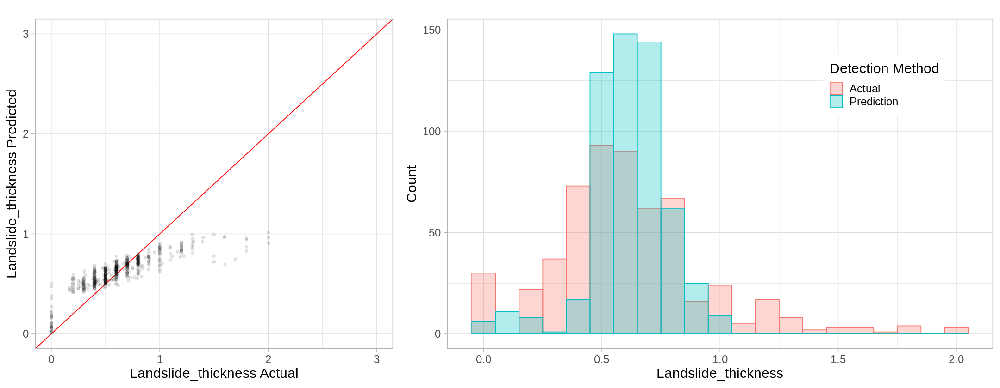

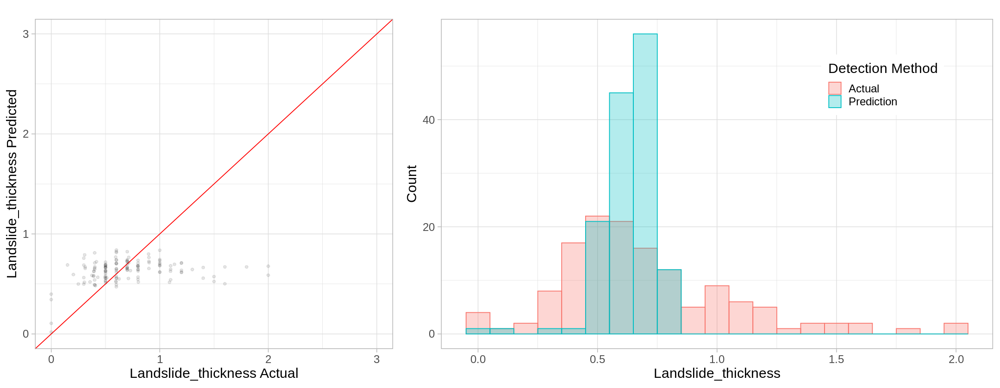

# A tibble: 2 × 6
  mao         mae  mape  rmse     r2     n
  <chr>     <dbl> <dbl> <dbl>  <dbl> <int>
1 Estimated 0.254    NA 0.364 0.0646   124
2 Measured  0.254    NA 0.364 0.0646    14


,mae,mape,smape,rmse,r2,min_pred,max_pred,min_err,max_err,ae_p90,n
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>
90%,0.2535956,NA,0.3967769,0.3638145,0.06457725,0.01951438,0.8391896,-0.5399454,1.412734,0.5597222,138


method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Random Forest,HMDB,HMDB,560,0.1428479,NA,0.3198725,0.2099668,0.7124872,0.01437605,⋯,0.2535956,NA,0.3198725,0.3638145,0.06457725,0.01951438,0.8391896,-0.5399454,1.412734,0.5597222


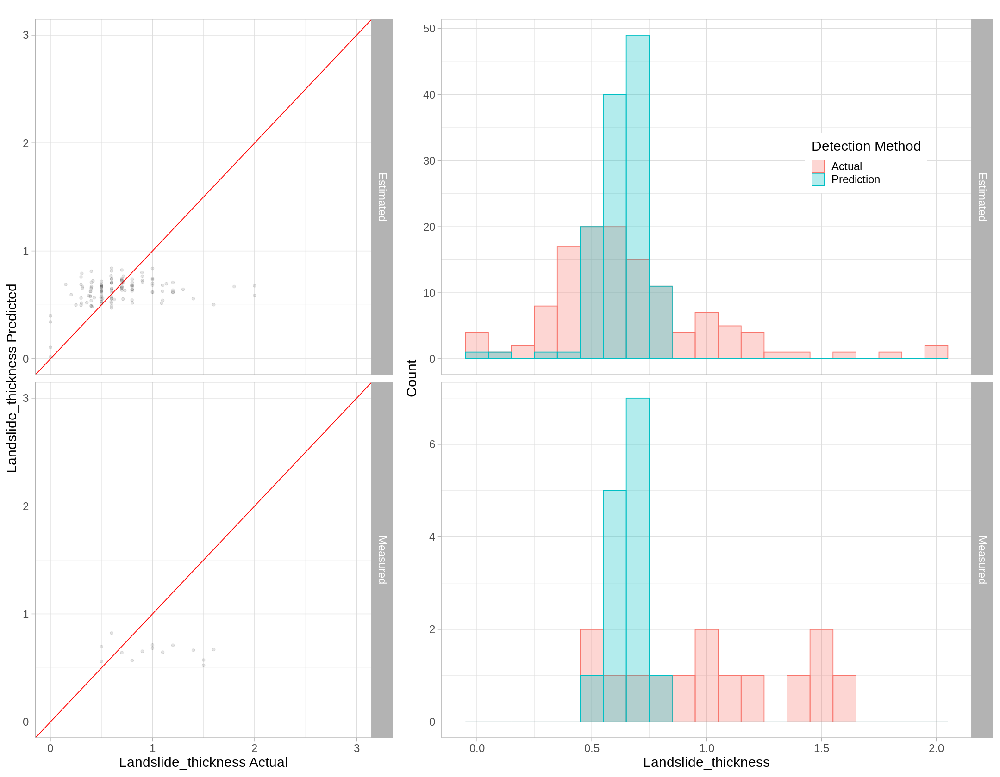

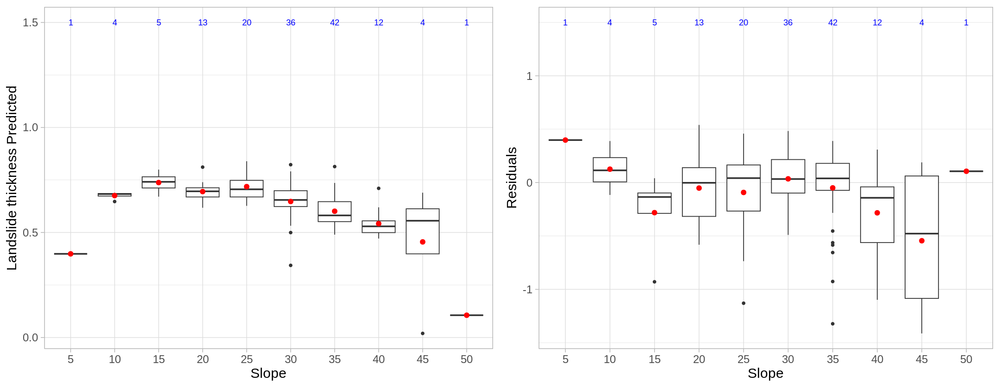

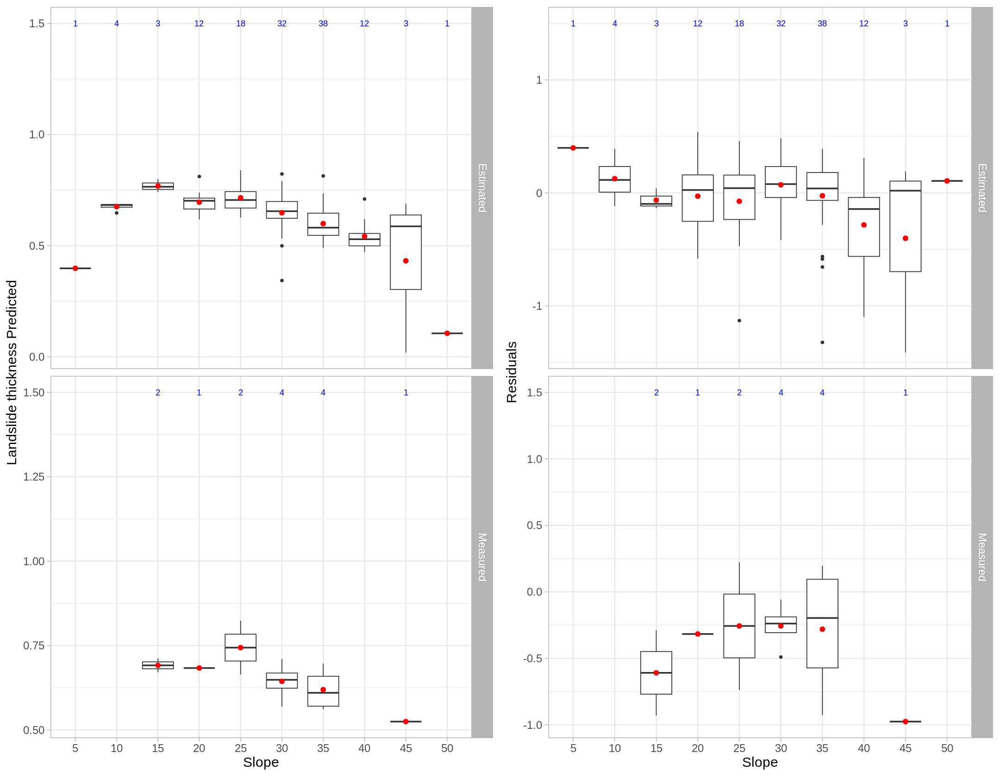

In [151]:
x_columns <- x_cols_manual
y_column <- y_col
method_label <- "Random Forest"
train_label <- "HMDB"
test_label <- "HMDB"

print(paste(method_label,train_label,test_label))
# "MAE"               "0.250654211965207" 1706
# "MAE"               "0.249262153761026" 177
# "MAE"              "0.24893686398536" 615


set.seed(seed)

t_start <- Sys.time()
rf_model_hmdb <- train(
                     x=data_train_hmdb_x,
                     y=data_train_hmdb_y,
                     method = caret_ranger$ranger,
                     metric = "MAE",
                     trControl = rf.tc.cv,
                     tuneGrid = rf.tune.grid,
                     seed = seed,
                     replace = TRUE,
                     importance = "permutation",  classification = FALSE
                )
t_end <- Sys.time()
print(t_end-t_start)



# print(rf_model_hmdb)
print(varImp(rf_model_hmdb))

pred_train_rf_hmdb <- predict(rf_model_hmdb, data = data_train_hmdb)
res_train <- score_model(data_train_hmdb_y,pred_train_rf_hmdb,actual_label = y_column,plot=TRUE)

pred_test_rf_hmdb <- predict(rf_model_hmdb$finalModel,data = data_test_hmdb)
res_test <- score_model(data_test_hmdb_y,pred_test_rf_hmdb$predictions,actual_label = y_column,plot=TRUE)
score_model(data_test_hmdb_y,pred_test_rf_hmdb$predictions,actual_label = y_column,plot=TRUE,facet=data_test_hmdb$Landslide_thickness_MAO)

res.rf.hmdb <- merge_score_results(method_label, train_label, test_label, data_train_hmdb, res_train, data_test_hmdb, res_test) 
res.rf.hmdb


model_box_plot(data_test_hmdb_y,pred_test_rf_hmdb$predictions,data_test_hmdb$slope_10,bin_width=5,plot_resid=TRUE)
model_box_plot(data_test_hmdb_y,pred_test_rf_hmdb$predictions,data_test_hmdb$slope_10,bin_width=5,plot_resid=TRUE,facet=data_test_hmdb$Landslide_thickness_MAO)

save(rf_model_hmdb, file="rf_model_hmdb.RData")

[1] "Cutoff 100 km"


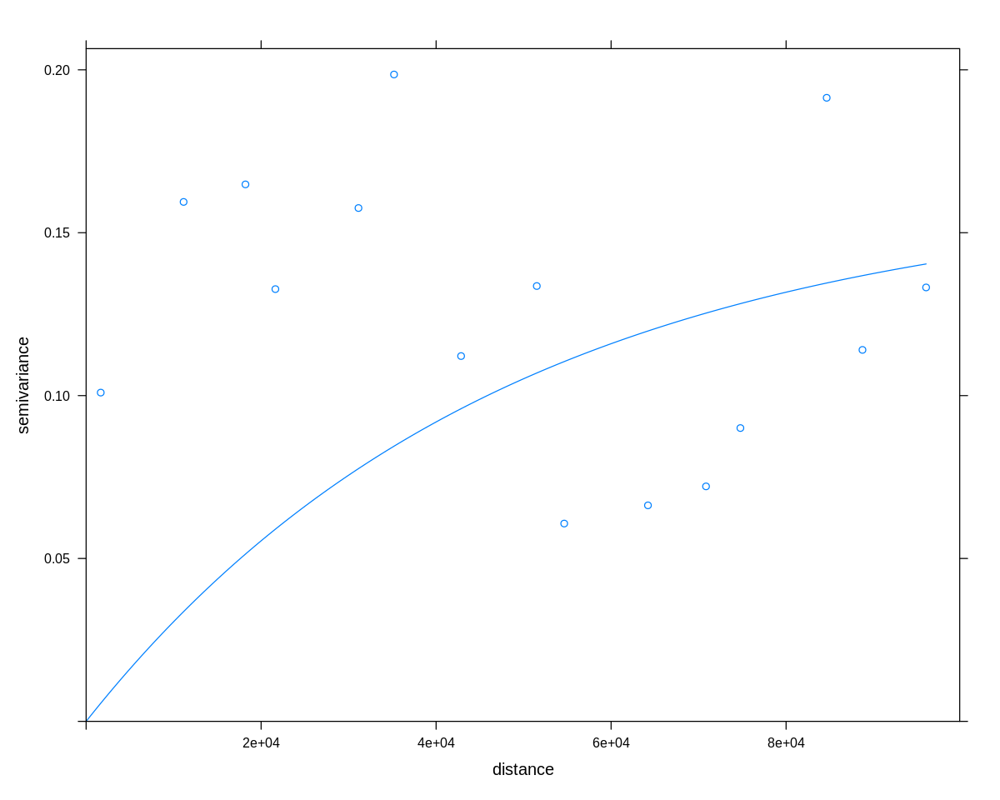


	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = 2.0614, p-value = 0.01963
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
     1.237983e-02     -7.299270e-03      9.113804e-05 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = 0.01238, observed rank = 960, p-value = 0.04
alternative hypothesis: greater


	Geary C test under randomisation

data:  spdf$resid 
weights: spdf.weights 

Geary C statistic standard deviate = 1.8732, p-value = 0.03052
alternative hypothesis: Expectation greater than statistic
sample estimates:
Geary C statistic       Expectation          Variance 
     0.9644041726      1.0000000000      0.0003610881 


	Monte-Carlo simulation of Geary C

data:  spdf$resid 
weights: spdf.weights 
number of simulations + 1: 1000 

statistic = 0.9644, observed rank = 32, p-valu

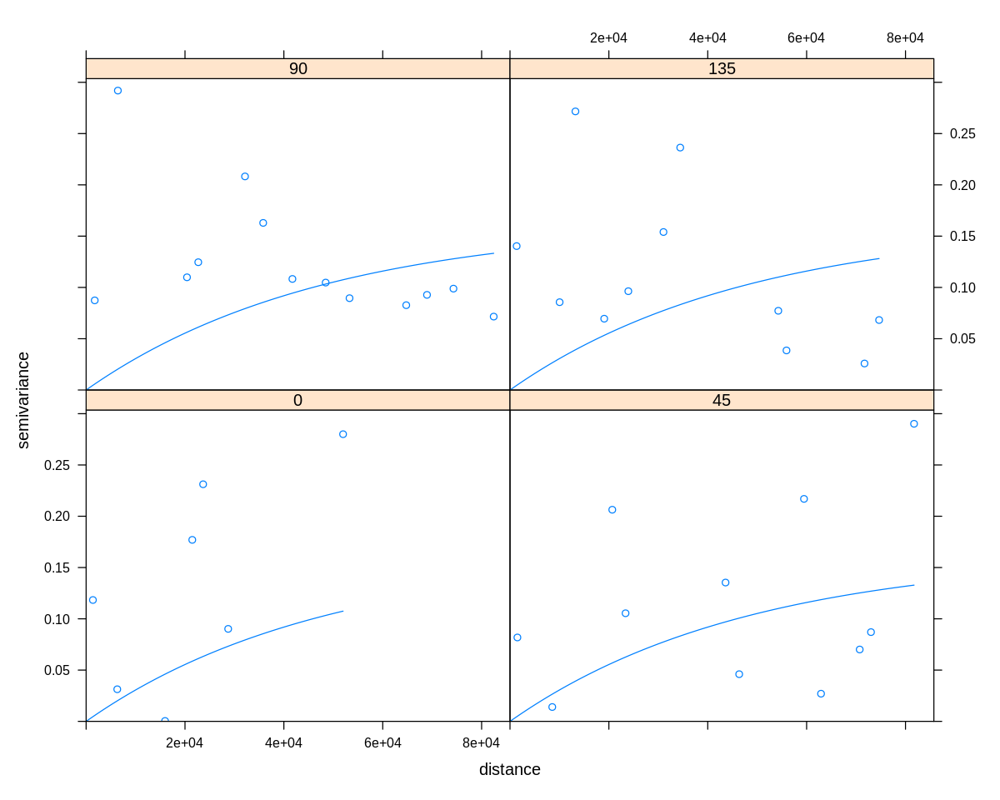

In [152]:
test_autocorrelation(data_test_hmdb.spdf,data_test_hmdb_y,pred_test_rf_hmdb$predictions,cutoff=100000,model="Exp")

[1] "Random Forest StorMe StorMe"
Time difference of 19.25443 mins
custom variable importance

  only 20 most important variables shown (out of 21)

                        Overall
h_5                    100.0000
standardized_height_25  35.3462
rhob_m                  23.0763
tri_r5_10               16.8780
mrvbf_10                14.8666
tri_r5_5                11.4007
mrrtf_25                 9.3845
vrm_r5_25                8.2207
catchment_slope_25       7.8149
slope_10                 6.5120
vhm_max_5                6.1899
slope_height_25          5.5314
tpi_500m_25              4.4592
tpi_4km_25               4.1089
twi_5                    3.9483
curvature_profile_25     3.6901
curvature_10             2.9310
valley_depth_25          2.6470
openness_neg_200_5       0.5320
catchment_area_25        0.1897


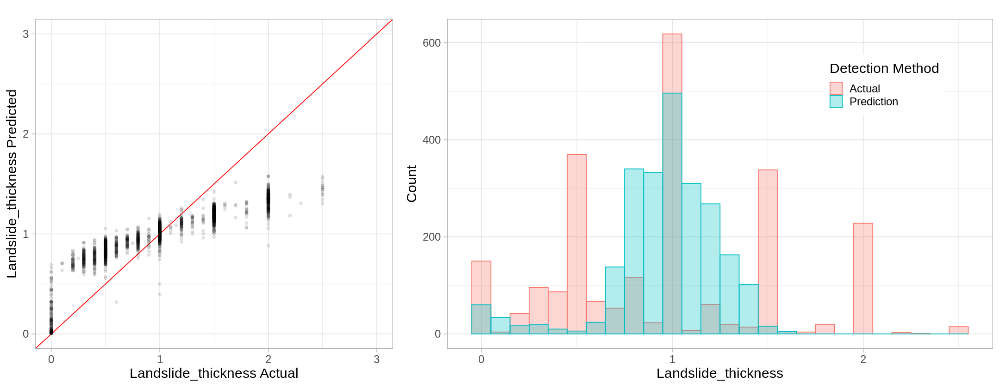

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Random Forest,StorMe,StorMe,2341,0.2683106,NA,0.411352,0.3433442,0.7670438,0.005804555,⋯,0.4214707,NA,0.411352,0.5279958,0.1407533,0.006231317,1.258389,-1.050756,1.55225,0.8800612


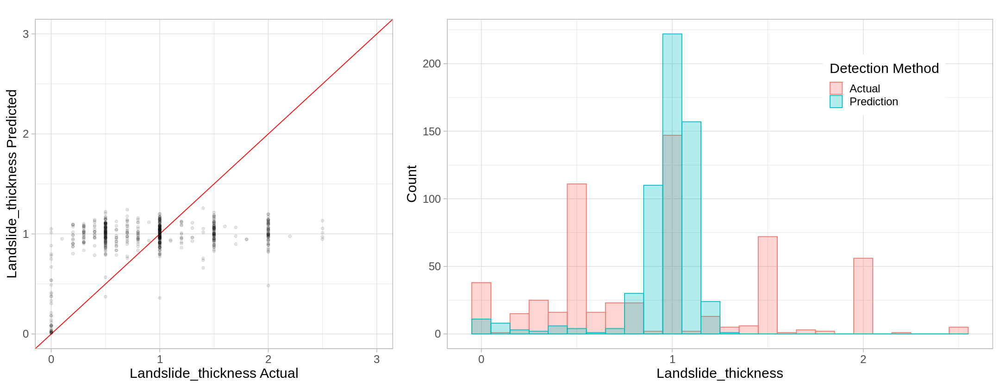

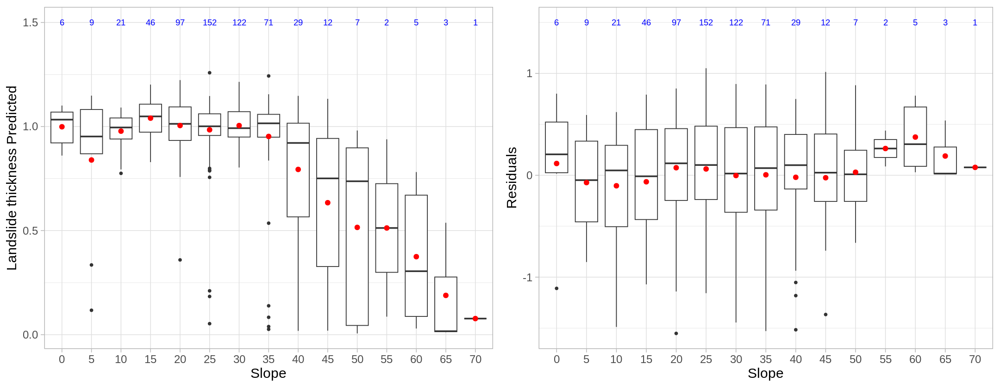

In [153]:
x_columns <- x_cols_manual
y_column <- y_col
method_label <- "Random Forest"
train_label <- "StorMe"
test_label <- "StorMe"

print(paste(method_label,train_label,test_label))

set.seed(seed)

t_start <- Sys.time()
rf_model_storme <- train(
                     x=data_train_storme_x,
                     y=data_train_storme_y,
                     method = caret_ranger$ranger,
                     metric = "MAE",
                     trControl = rf.tc.cv,
                     tuneGrid = rf.tune.grid,
                     seed = seed,
                     replace = TRUE,
                     importance = "permutation",  classification = FALSE
                )
t_end <- Sys.time()
print(t_end-t_start)


# print(rf_model_storme)
print(varImp(rf_model_storme))

pred_train_rf_storme <- predict(rf_model_storme, newdata = data_train_storme)
res_train <- score_model(data_train_storme_y,pred_train_rf_storme,actual_label = y_column,plot=TRUE)

pred_test_rf_storme <- predict(rf_model_storme$finalModel,data = data_test_storme)
res_test <- score_model(data_test_storme_y,pred_test_rf_storme$predictions,actual_label = y_column,plot=TRUE)

res.rf.storme <- merge_score_results(method_label, train_label, test_label, data_train_storme, res_train, data_test_storme, res_test) 
res.rf.storme 

model_box_plot(data_test_storme_y,pred_test_rf_storme$predictions,data_test_storme$slope_10,bin_width=5,plot_resid=TRUE)


[1] "Cutoff 100 km"


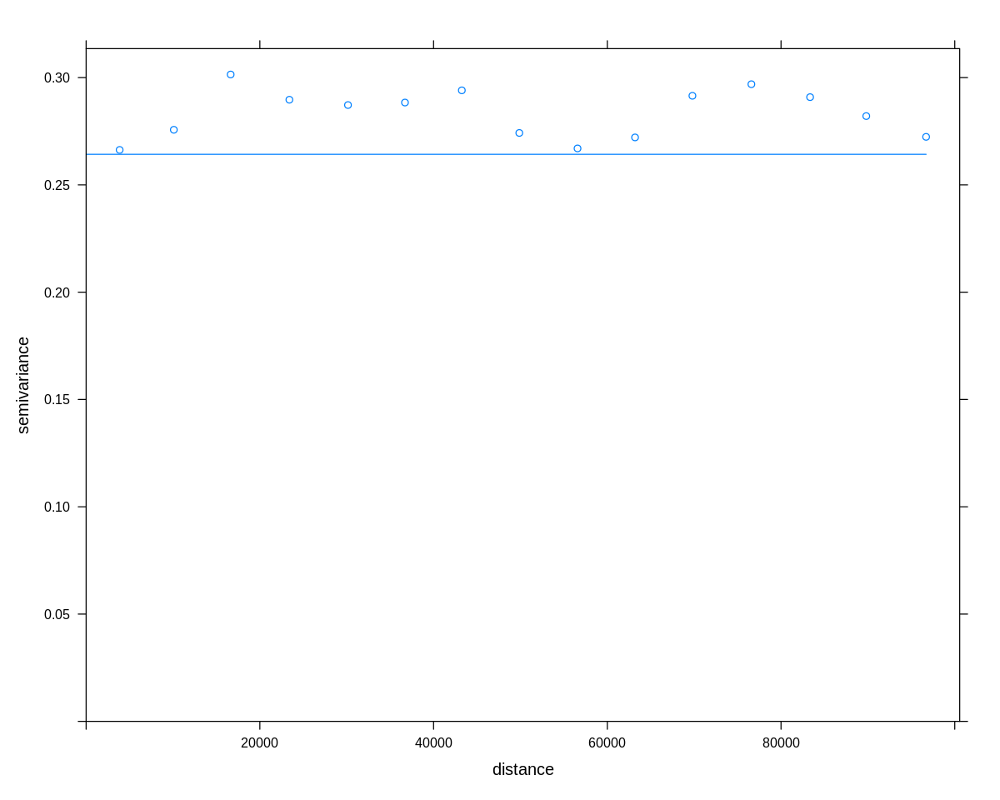


	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = -0.72674, p-value = 0.7663
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
    -2.768963e-03     -1.718213e-03      2.090434e-06 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = -0.002769, observed rank = 193, p-value = 0.807
alternative hypothesis: greater


	Geary C test under randomisation

data:  spdf$resid 
weights: spdf.weights 

Geary C statistic standard deviate = -2.2573, p-value = 0.988
alternative hypothesis: Expectation greater than statistic
sample estimates:
Geary C statistic       Expectation          Variance 
     1.011233e+00      1.000000e+00      2.476503e-05 


	Monte-Carlo simulation of Geary C

data:  spdf$resid 
weights: spdf.weights 
number of simulations + 1: 1000 

statistic = 1.0112, observed rank = 988, p-

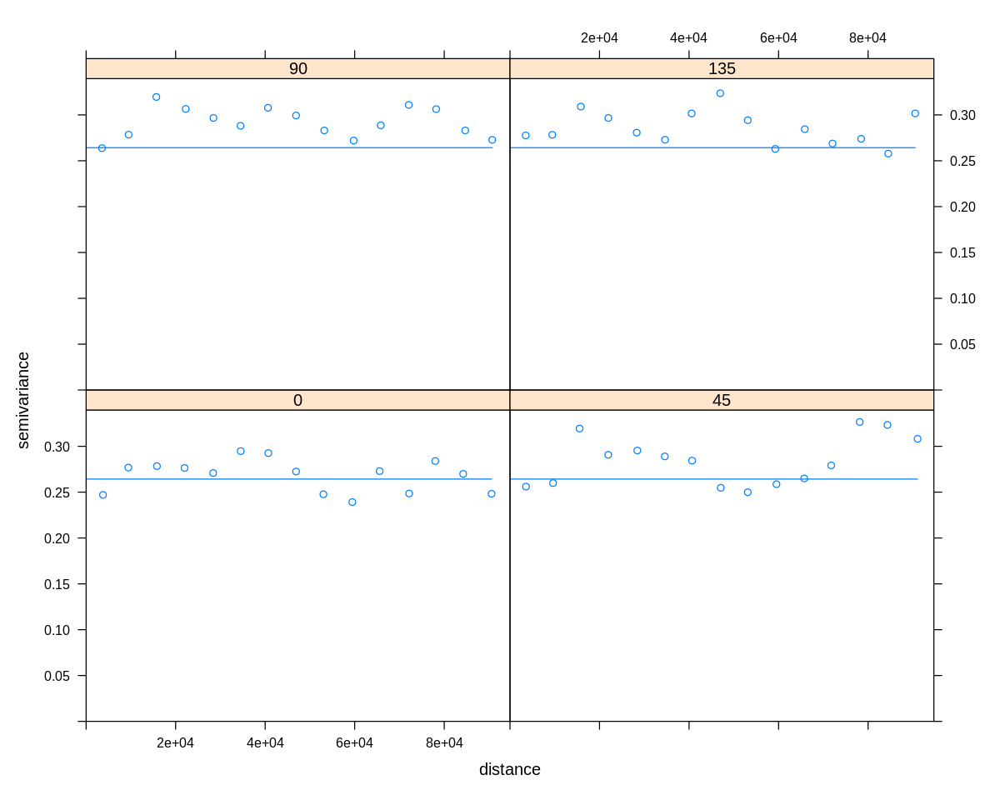

In [154]:
test_autocorrelation(data_test_storme.spdf,data_test_storme_y,pred_test_rf_storme$predictions,cutoff=100000)


[1] "Random Forest BE BE"
Time difference of 5.664808 mins
custom variable importance

  only 20 most important variables shown (out of 21)

                       Overall
h_5                    100.000
rhob_m                  92.111
tri_r5_10               78.874
twi_5                   45.442
tri_r5_5                45.005
mrrtf_25                21.303
openness_neg_200_5      18.603
standardized_height_25  16.616
valley_depth_25         14.374
catchment_slope_25      13.988
tpi_500m_25             13.986
slope_10                12.562
catchment_area_25       11.699
mrvbf_10                11.399
vhm_max_5               10.849
tpi_4km_25               8.115
aspect_nness_10          6.267
vrm_r5_25                2.825
curvature_10             1.834
slope_height_25          1.017


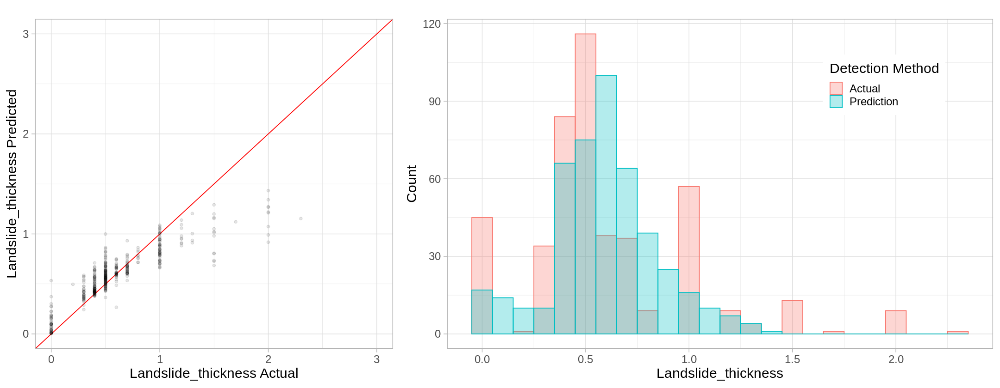

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Random Forest,BE,BE,458,0.1335114,NA,0.3681979,0.2108394,0.7688596,0.005495427,⋯,0.1877475,NA,0.3681979,0.3023669,0.4674087,0.008495427,1.125565,-0.5759328,1.666493,0.3705817


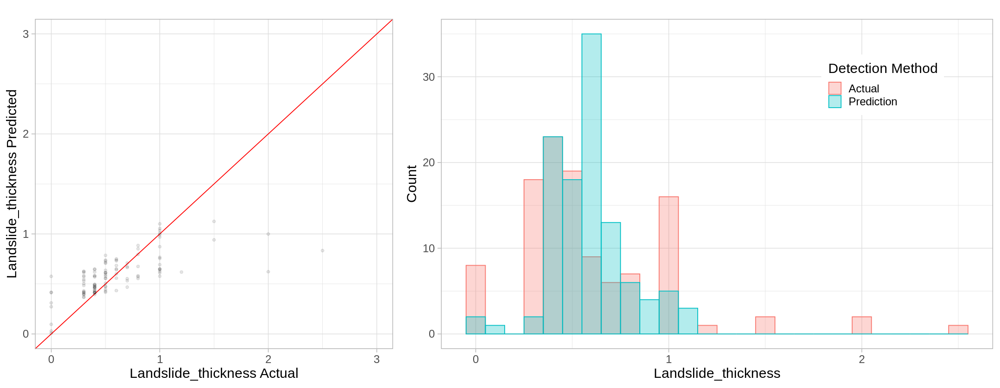

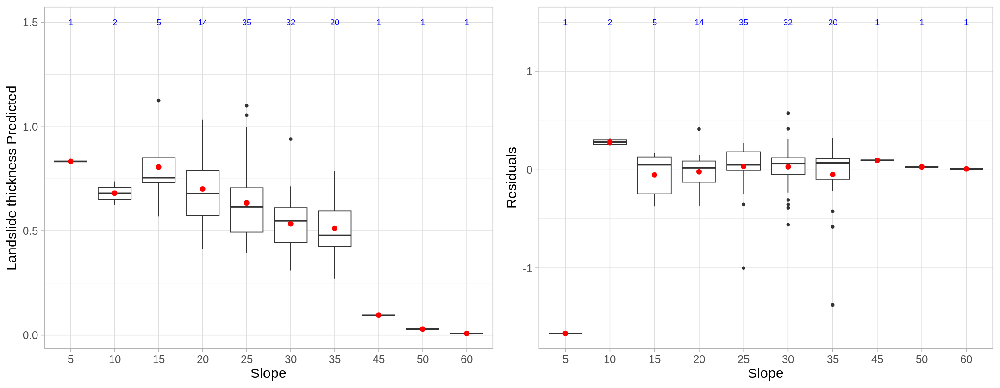

In [155]:
x_columns <- x_cols_manual
y_column <- y_col
method_label <- "Random Forest"
train_label <- "BE"
test_label <- "BE"

print(paste(method_label,train_label,test_label))

set.seed(seed)

t_start <- Sys.time()
rf_model_be <- train(
                     x=data_train_be_x,
                     y=data_train_be_y,
                     method = caret_ranger$ranger,
                     metric = "MAE",
                     trControl = rf.tc.cv,
                     tuneGrid = rf.tune.grid,
                     seed = seed,
                     replace = TRUE,
                     importance = "permutation",  classification = FALSE
                )
t_end <- Sys.time()
print(t_end-t_start)


# print(rf_model_be)
print(varImp(rf_model_be))

pred_train_rf_be <- predict(rf_model_be, newdata = data_train_be)
res_train <- score_model(data_train_be_y,pred_train_rf_be,actual_label = y_column,plot=TRUE)

pred_test_rf_be <- predict(rf_model_be$finalModel,data = data_test_be)
res_test <- score_model(data_test_be_y,pred_test_rf_be$predictions,actual_label = y_column,plot=TRUE)

res.rf.be <- merge_score_results(method_label, train_label, test_label, data_train_be, res_train, data_test_be, res_test) 
res.rf.be 

model_box_plot(data_test_be_y,pred_test_rf_be$predictions,data_test_be$slope_10,bin_width=5,plot_resid=TRUE)


save(rf_model_be, file="rf_model_be.RData")

[1] "Cutoff 100 km"


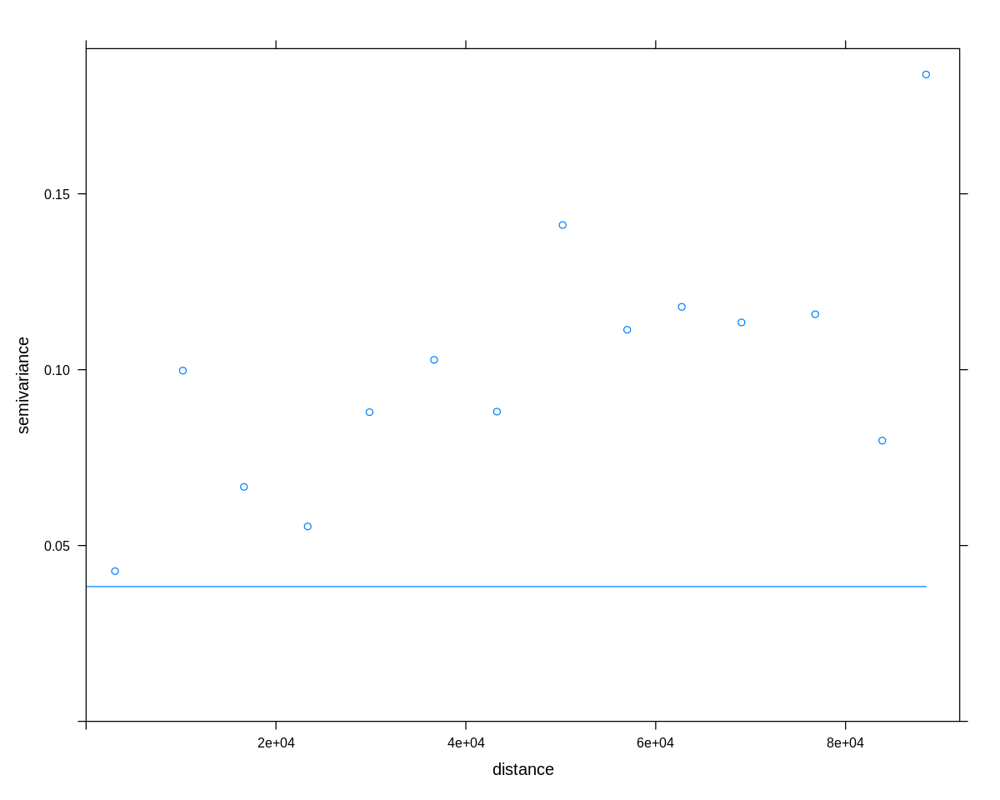


	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = NaN, p-value = NA
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
    -9.009009e-03     -9.009009e-03     -5.804547e-17 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = -0.009009, observed rank = 791, p-value = 0.209
alternative hypothesis: greater


	Geary C test under randomisation

data:  spdf$resid 
weights: spdf.weights 

Geary C statistic standard deviate = 0, p-value = 0.5
alternative hypothesis: Expectation greater than statistic
sample estimates:
Geary C statistic       Expectation          Variance 
     1.000000e+00      1.000000e+00      1.273824e-16 


	Monte-Carlo simulation of Geary C

data:  spdf$resid 
weights: spdf.weights 
number of simulations + 1: 1000 

statistic = 1, observed rank = 436, p-value = 0.436
alternat

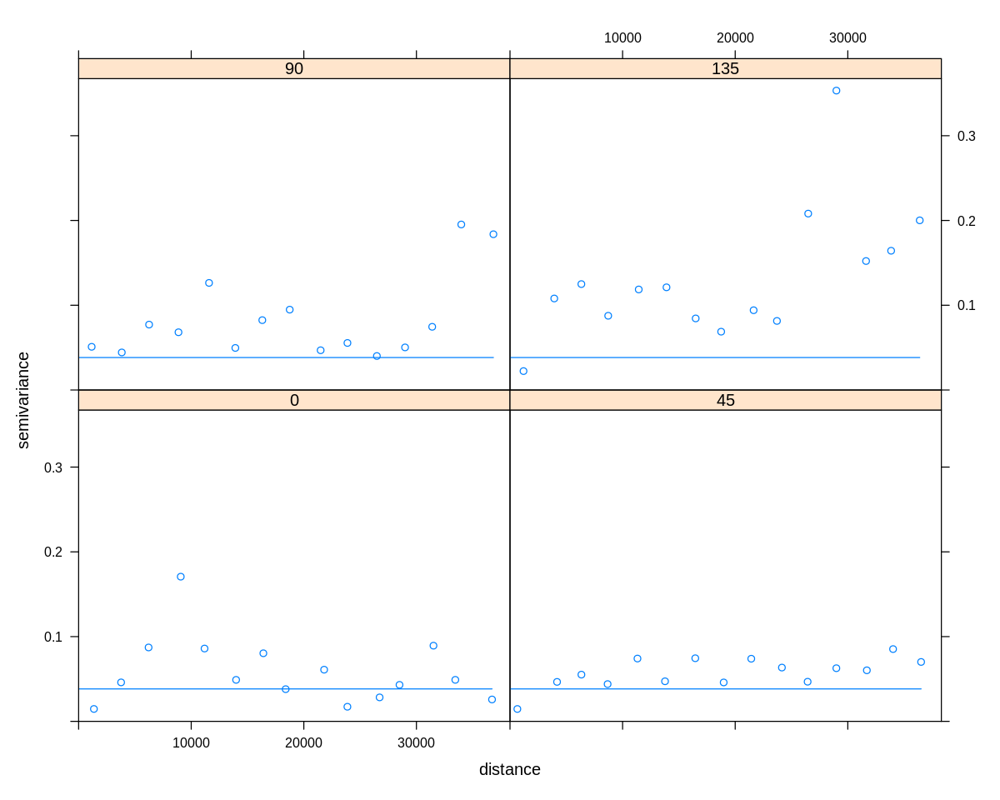

In [156]:
test_autocorrelation(data_test_be.spdf,data_test_be_y,pred_test_rf_be$predictions,cutoff=100000)


[1] "Random Forest BE HMDB"


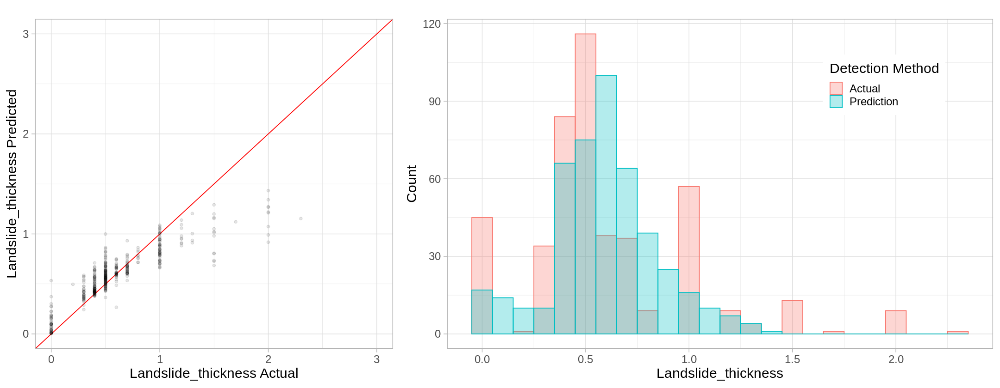

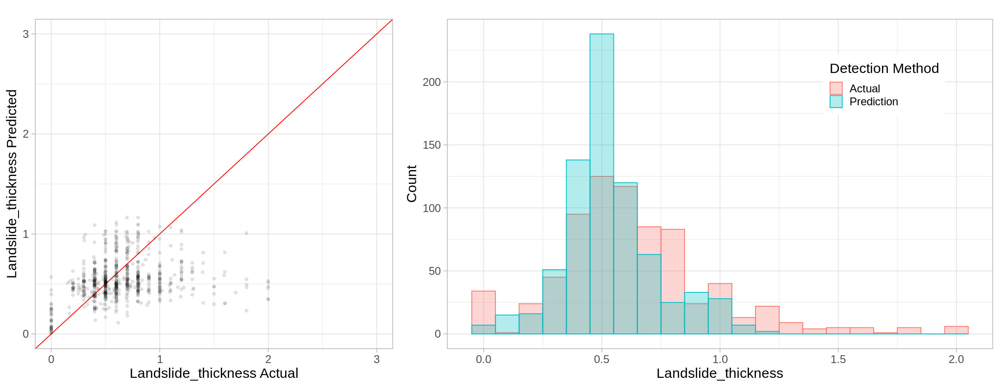

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Random Forest,BE,HMDB,458,0.1335114,NA,0.3681979,0.2108394,0.7688596,0.005495427,⋯,0.254918,NA,0.3681979,0.3589404,0.06628428,0.005495427,1.164475,-0.6881773,1.652997,0.5454216


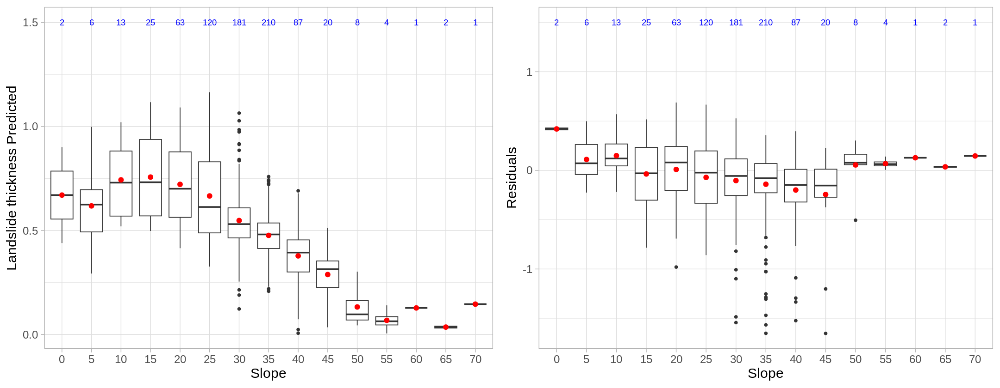

In [157]:
x_columns <- x_cols_manual
y_column <- y_col

method_label <- "Random Forest"
train_label <- "BE"
test_label <- "HMDB"

print(paste(method_label,train_label,test_label))

pred_train_rf_be_hmdb <- predict(rf_model_be, newdata = data_train_be_hmdb)
res_train <- score_model(data_train_be_hmdb_y,pred_train_rf_be_hmdb,actual_label = y_column,plot=TRUE)

pred_test_rf_be_hmdb <- predict(rf_model_be$finalModel,data = data_test_be_hmdb)
res_test <- score_model(data_test_be_hmdb_y,pred_test_rf_be_hmdb$predictions,actual_label = y_column,plot=TRUE)

model_box_plot(data_test_be_hmdb_y,pred_test_rf_be_hmdb$predictions,data_test_be_hmdb$slope_10,bin_width=5,plot_resid=TRUE)


res.rf.be_hmdb <- merge_score_results(method_label, train_label, test_label, data_train_be_hmdb, res_train, data_test_be_hmdb, res_test) 
res.rf.be_hmdb 

[1] "Cutoff 100 km"


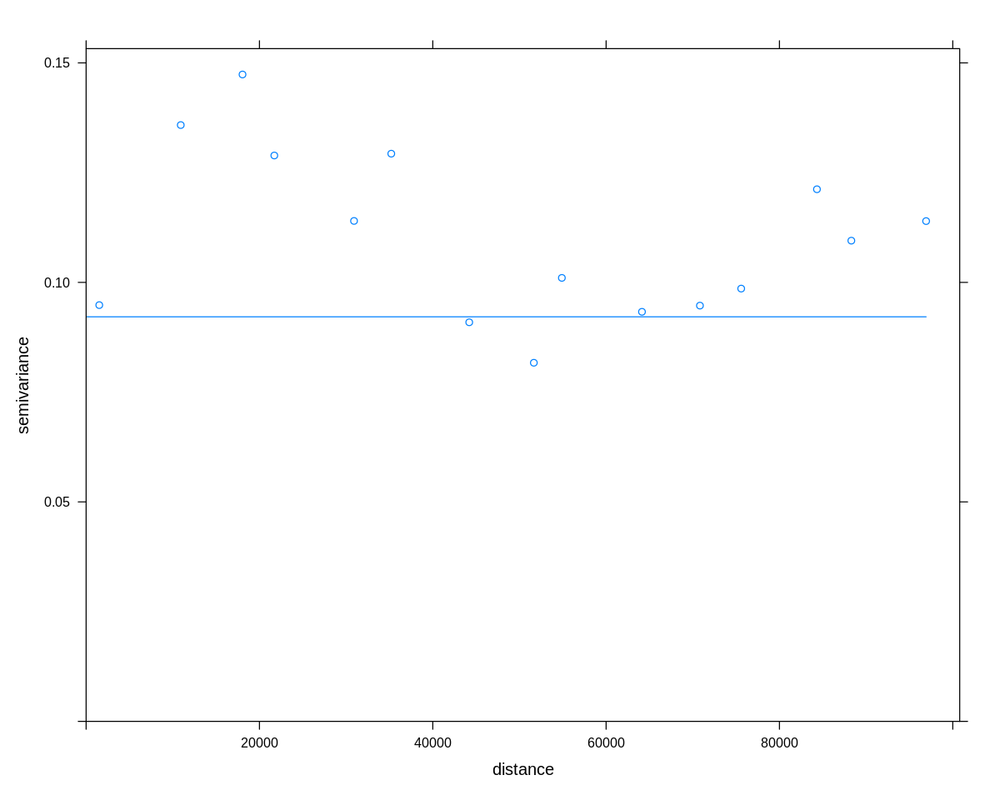


	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = 35.698, p-value < 2.2e-16
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
     5.517672e-02     -1.347709e-03      2.507154e-06 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = 0.055177, observed rank = 1000, p-value = 0.001
alternative hypothesis: greater


	Geary C test under randomisation

data:  spdf$resid 
weights: spdf.weights 

Geary C statistic standard deviate = 8.0566, p-value = 3.922e-16
alternative hypothesis: Expectation greater than statistic
sample estimates:
Geary C statistic       Expectation          Variance 
     9.269640e-01      1.000000e+00      8.218027e-05 


	Monte-Carlo simulation of Geary C

data:  spdf$resid 
weights: spdf.weights 
number of simulations + 1: 1000 

statistic = 0.92696, observed rank = 1, p

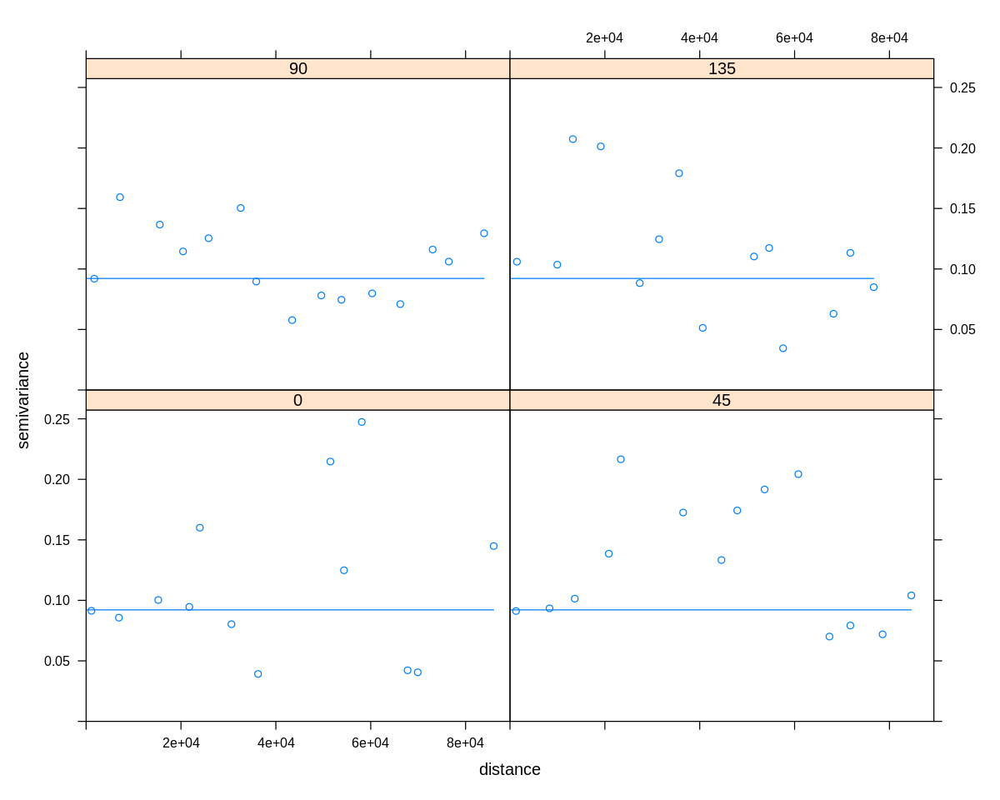

In [158]:
test_autocorrelation(data_test_be_hmdb.spdf,data_test_be_hmdb_y,pred_test_rf_be_hmdb$predictions,cutoff=100000)


[1] "Random Forest HMDB BE"


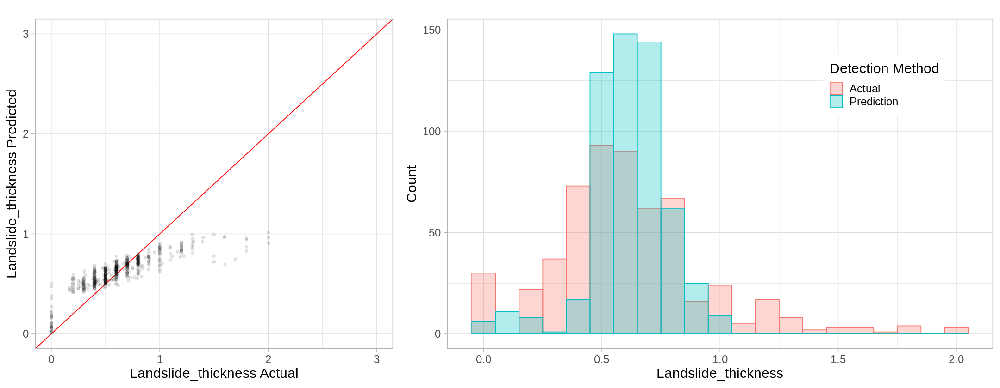

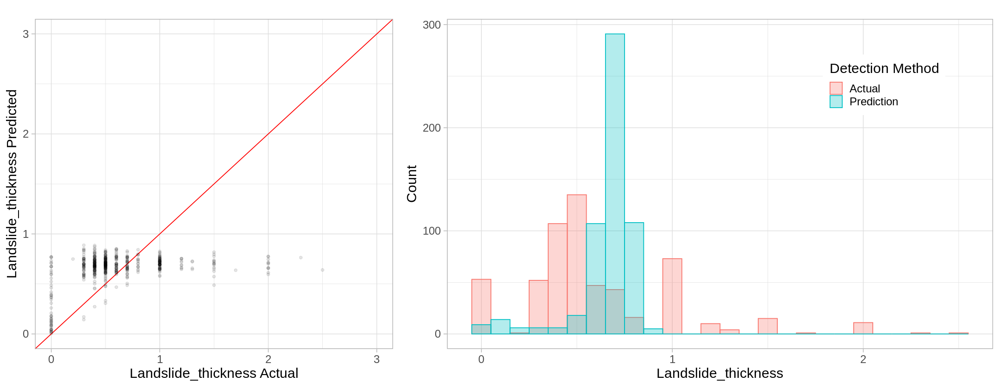

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Random Forest,HMDB,BE,560,0.1428479,NA,0.3198725,0.2099668,0.7124872,0.01437605,⋯,0.2863202,NA,0.3198725,0.3738933,0.1334415,0.004396218,0.8873586,-0.7703911,1.860058,0.5181365


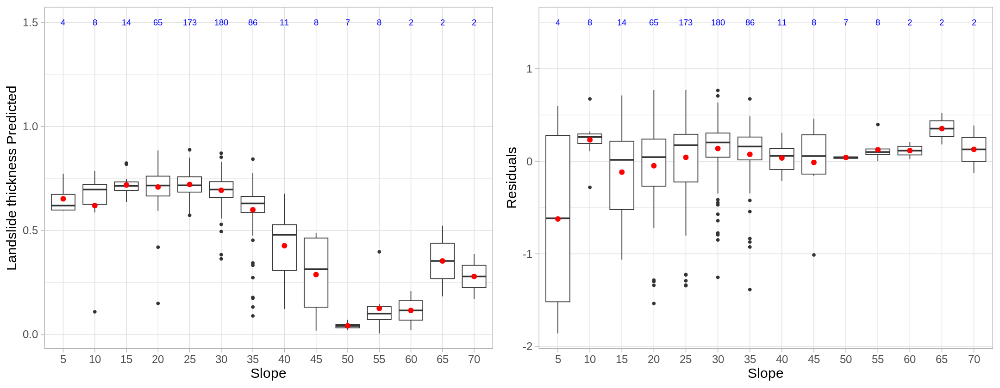

In [159]:
x_columns <- x_cols_manual
y_column <- y_col

method_label <- "Random Forest"
train_label <- "HMDB"
test_label <- "BE"

print(paste(method_label,train_label,test_label))

pred_train_rf_hmdb_be <- predict(rf_model_hmdb, newdata = data_train_hmdb_be)
res_train <- score_model(data_train_hmdb_be_y,pred_train_rf_hmdb_be,actual_label = y_column,plot=TRUE)

pred_test_rf_hmdb_be <- predict(rf_model_hmdb$finalModel,data = data_test_hmdb_be)
res_test <- score_model(data_test_hmdb_be_y,pred_test_rf_hmdb_be$predictions,actual_label = y_column,plot=TRUE)

model_box_plot(data_test_hmdb_be_y,pred_test_rf_hmdb_be$predictions,data_test_hmdb_be$slope_10,bin_width=5,plot_resid=TRUE)


res.rf.hmdb_be <- merge_score_results(method_label, train_label, test_label, data_train_hmdb_be, res_train, data_test_hmdb_be, res_test) 
res.rf.hmdb_be 

[1] "Cutoff 100 km"


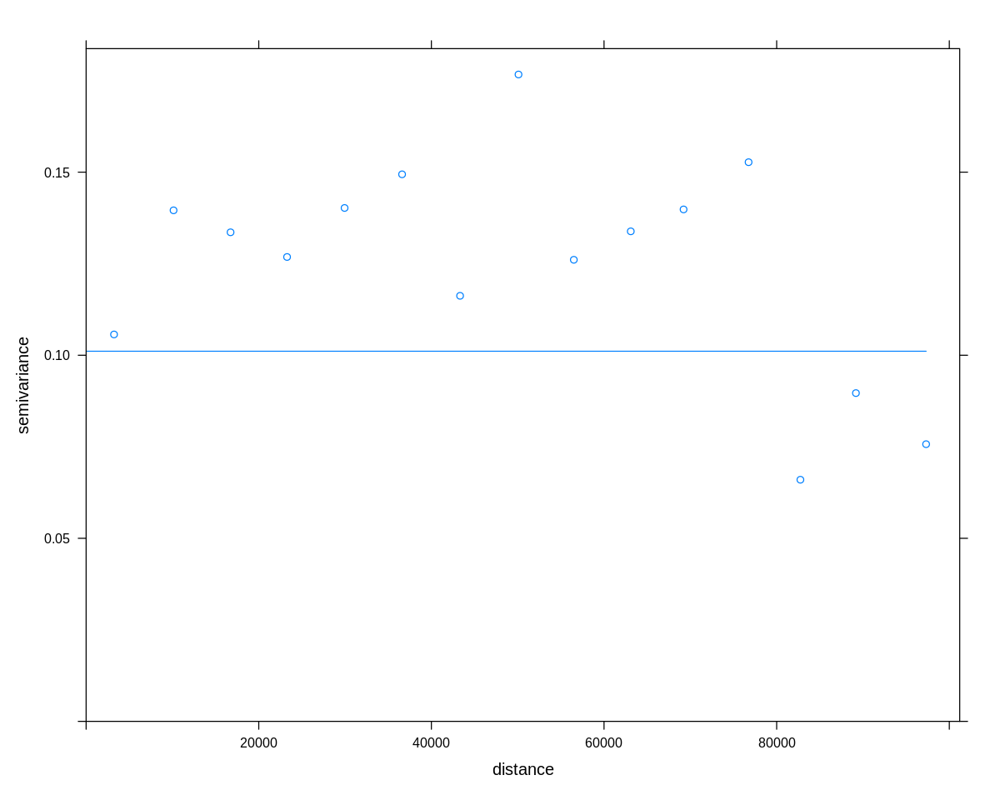


	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = 0.39157, p-value = 0.3477
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
    -1.751577e-03     -1.757469e-03      2.264121e-10 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = -0.0017516, observed rank = 805, p-value = 0.195
alternative hypothesis: greater


	Geary C test under randomisation

data:  spdf$resid 
weights: spdf.weights 

Geary C statistic standard deviate = -0.16347, p-value = 0.5649
alternative hypothesis: Expectation greater than statistic
sample estimates:
Geary C statistic       Expectation          Variance 
     1.000005e+00      1.000000e+00      8.645850e-10 


	Monte-Carlo simulation of Geary C

data:  spdf$resid 
weights: spdf.weights 
number of simulations + 1: 1000 

statistic = 1, observed rank = 402, p-val

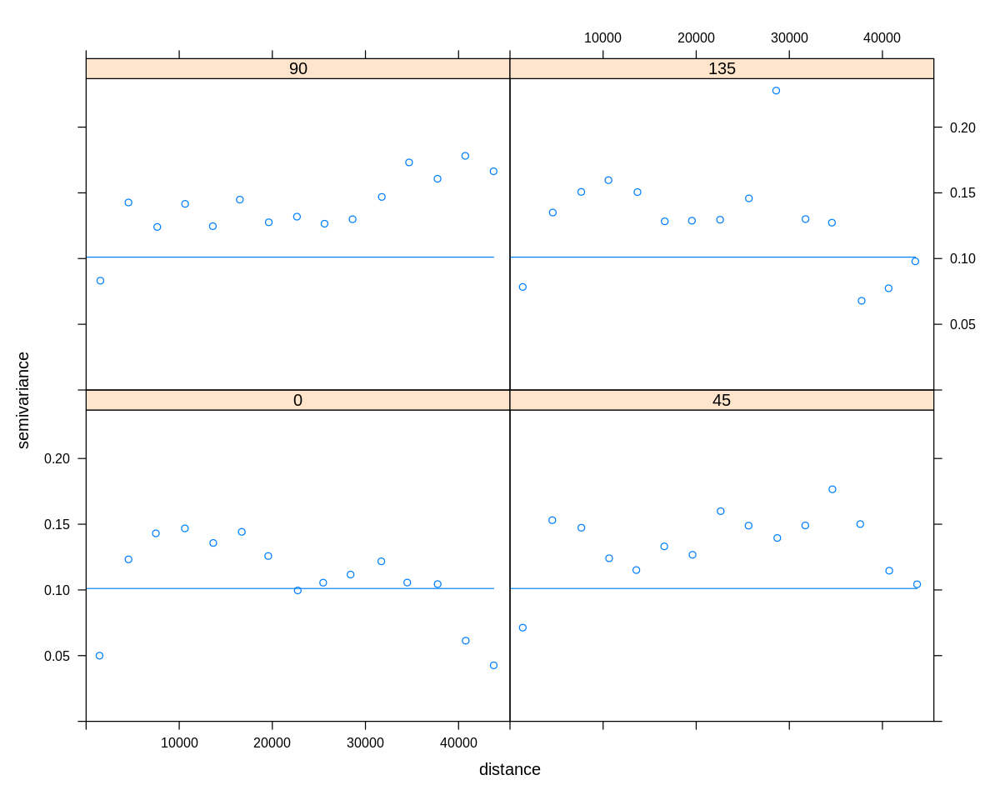

In [160]:
test_autocorrelation(data_test_hmdb_be.spdf,data_test_hmdb_be_y,pred_test_rf_hmdb_be$predictions,cutoff=100000)


[1] "Random Forest HMDB StorMe"


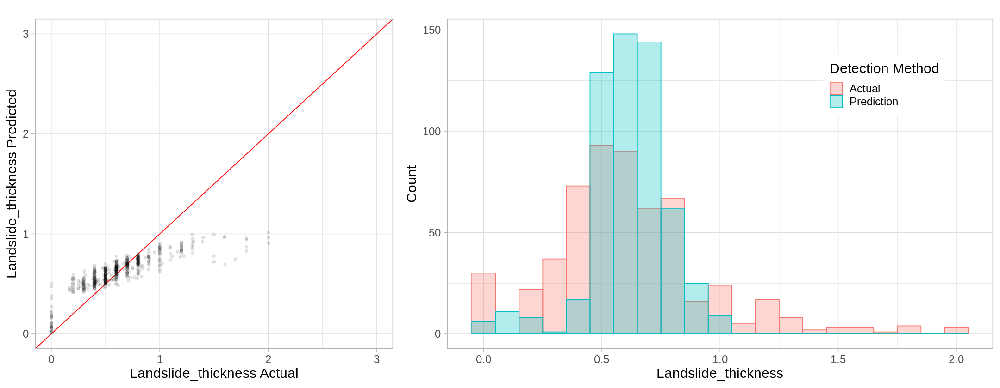

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Random Forest,HMDB,StorMe,560,0.1428479,NA,0.3198725,0.2099668,0.7124872,0.01437605,⋯,0.4873297,NA,0.3198725,0.6263476,0.09007608,0.004396218,0.9564362,-0.8544441,1.90189,1.241205


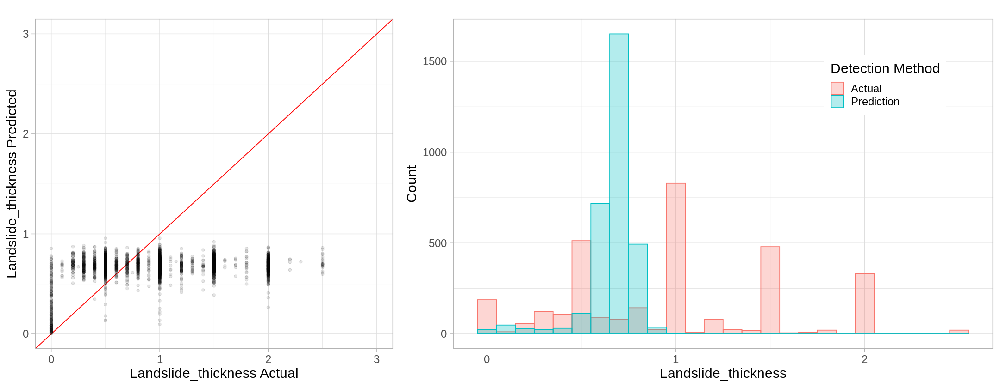

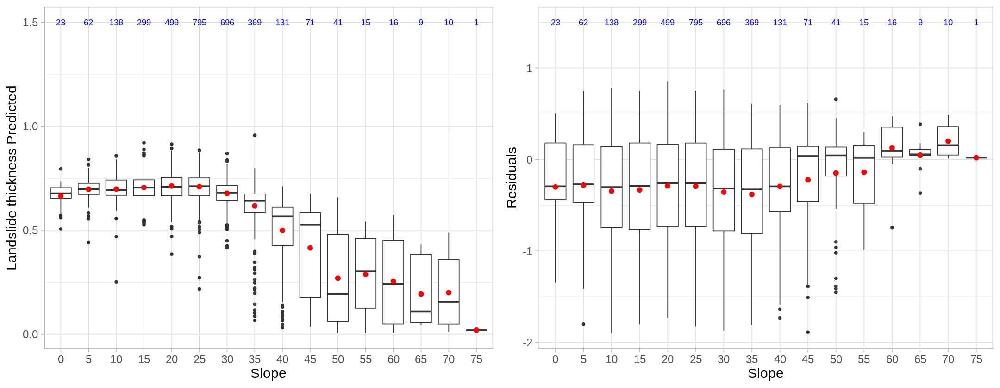

In [161]:
x_columns <- x_cols_manual
y_column <- y_col

method_label <- "Random Forest"
train_label <- "HMDB"
test_label <- "StorMe"

print(paste(method_label,train_label,test_label))

pred_train_rf_hmdb_storme <- predict(rf_model_hmdb, newdata = data_train_hmdb_storme)
res_train <- score_model(data_train_hmdb_storme_y,pred_train_rf_hmdb_storme,actual_label = y_column,plot=TRUE)

pred_test_rf_hmdb_storme <- predict(rf_model_hmdb$finalModel,data = data_test_hmdb_storme)
res_test <- score_model(data_test_hmdb_storme_y,pred_test_rf_hmdb_storme$predictions,actual_label = y_column,plot=TRUE)

res.rf.hmdb_storme <- merge_score_results(method_label, train_label, test_label, data_train_hmdb_storme, res_train, data_test_hmdb_storme, res_test) 
res.rf.hmdb_storme 

model_box_plot(data_test_hmdb_storme_y,pred_test_rf_hmdb_storme$predictions,data_test_hmdb_storme$slope_10,bin_width=5,plot_resid=TRUE)


[1] "Cutoff 100 km"


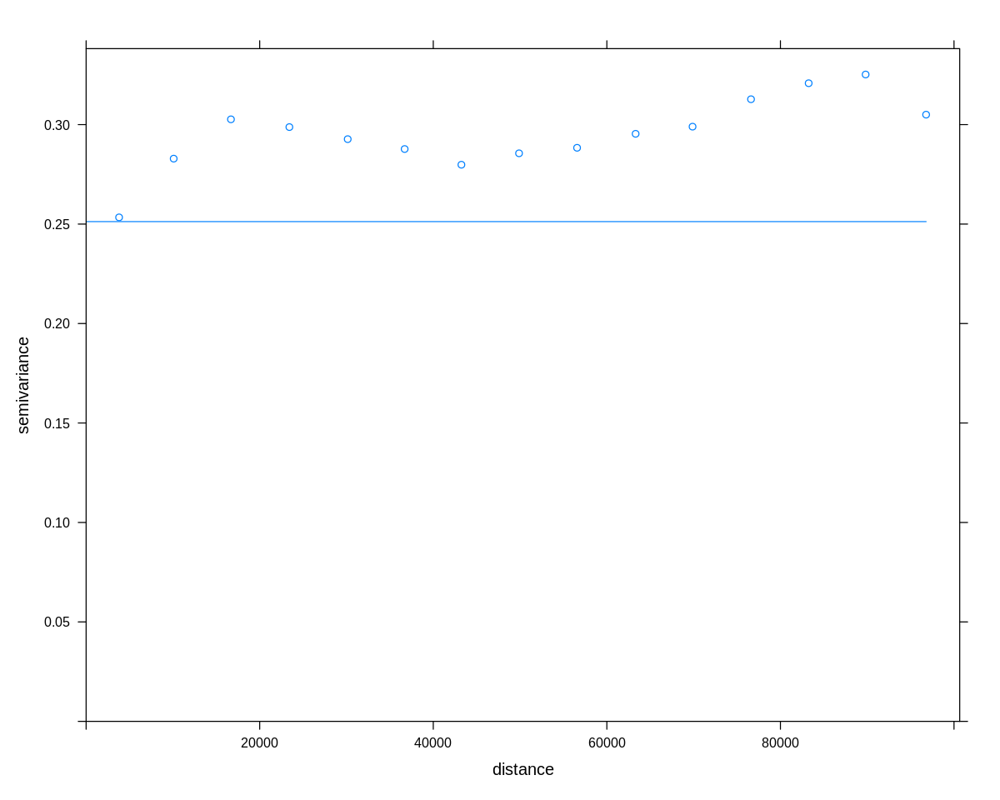


	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = 13.693, p-value < 2.2e-16
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
     3.439517e-03     -3.150599e-04      7.518526e-08 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = 0.0034395, observed rank = 1000, p-value = 0.001
alternative hypothesis: greater


	Geary C test under randomisation

data:  spdf$resid 
weights: spdf.weights 

Geary C statistic standard deviate = 1.1258, p-value = 0.1301
alternative hypothesis: Expectation greater than statistic
sample estimates:
Geary C statistic       Expectation          Variance 
     9.979382e-01      1.000000e+00      3.354279e-06 


	Monte-Carlo simulation of Geary C

data:  spdf$resid 
weights: spdf.weights 
number of simulations + 1: 1000 

statistic = 0.99794, observed rank = 126, p

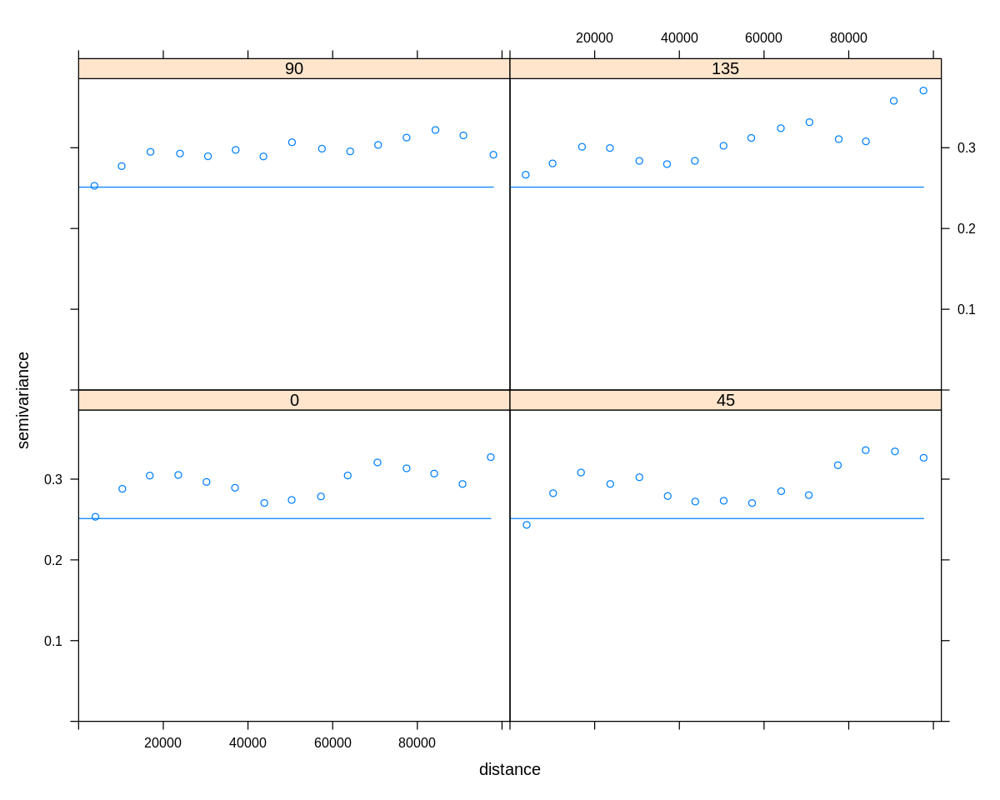

In [162]:
test_autocorrelation(data_test_hmdb_storme.spdf,data_test_hmdb_storme_y,pred_test_rf_hmdb_storme$predictions,cutoff=100000)


<a id="Paper_Model_GAM"></a>
### General Additive Model

In [163]:
plot <- TRUE

In [164]:
gam.tune.grid = data.frame(method = c("GCV.Cp","REML"), select = c(FALSE,TRUE))


[1] "GAM HMDB HMDB"
[1] 560
[1] 138

Family: gaussian 
Link function: identity 

Formula:
.outcome ~ s(rhob_m) + s(vhm_max_5) + s(mrrtf_25) + s(tpi_4km_25) + 
    s(tpi_500m_25) + s(vrm_r5_25) + s(slope_height_25) + s(catchment_slope_25) + 
    s(valley_depth_25) + s(standardized_height_25) + s(curvature_profile_25) + 
    s(catchment_area_25) + s(mrvbf_10) + s(curvature_10) + s(tri_r5_10) + 
    s(tri_r5_5) + s(h_5) + s(slope_10) + s(aspect_nness_10) + 
    s(twi_5) + s(openness_neg_200_5)

Parametric coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.6149     0.0124    49.6   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Approximate significance of smooth terms:
                                edf Ref.df     F p-value    
s(rhob_m)                 3.663e-01      9 0.064 0.19992    
s(vhm_max_5)              1.555e-05      9 0.000 0.86445    
s(mrrtf_25)               1.244e-05      9 0.000 0.93512    
s(tpi_4km_25)     

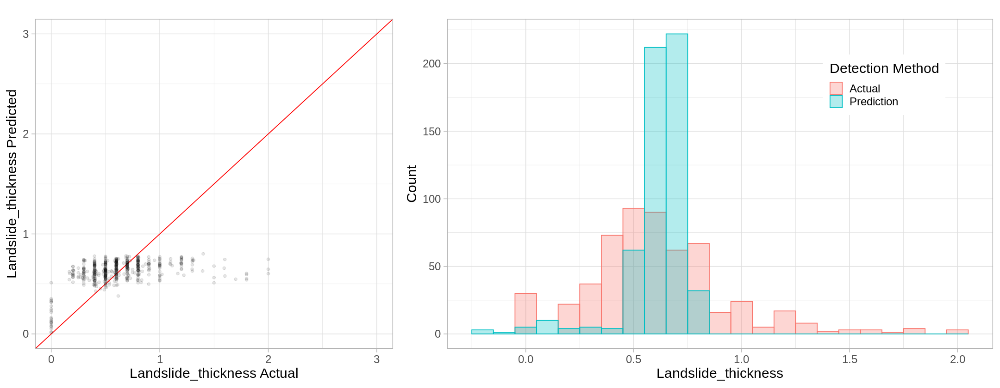

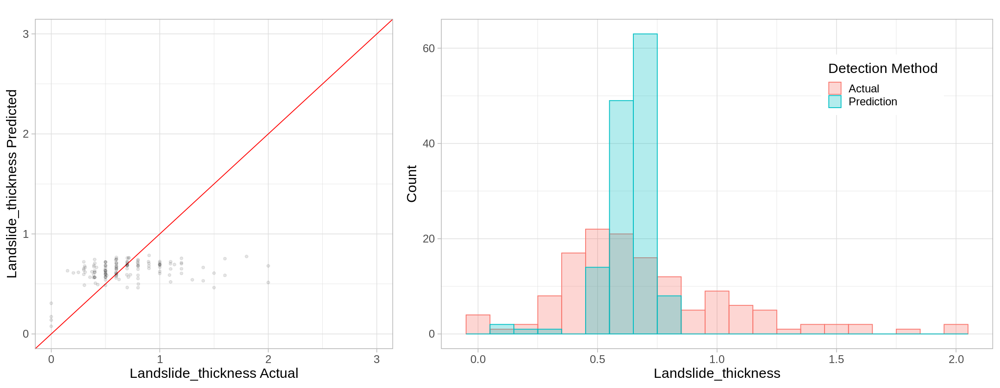

# A tibble: 2 × 6
  mao         mae  mape  rmse     r2     n
  <chr>     <dbl> <dbl> <dbl>  <dbl> <int>
1 Estimated 0.249    NA 0.359 0.0899   124
2 Measured  0.249    NA 0.359 0.0899    14


,mae,mape,smape,rmse,r2,min_pred,max_pred,min_err,max_err,ae_p90,n
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>
90%,0.2492609,NA,0.3945287,0.3587569,0.08993831,0.07693728,0.7858869,-0.4815611,1.485242,0.4988124,138


method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
GAM,HMDB,HMDB,560,0.2058405,NA,0.4096095,0.2902076,0.224345,-0.205891,⋯,0.2492609,NA,0.4096095,0.3587569,0.08993831,0.07693728,0.7858869,-0.4815611,1.485242,0.4988124


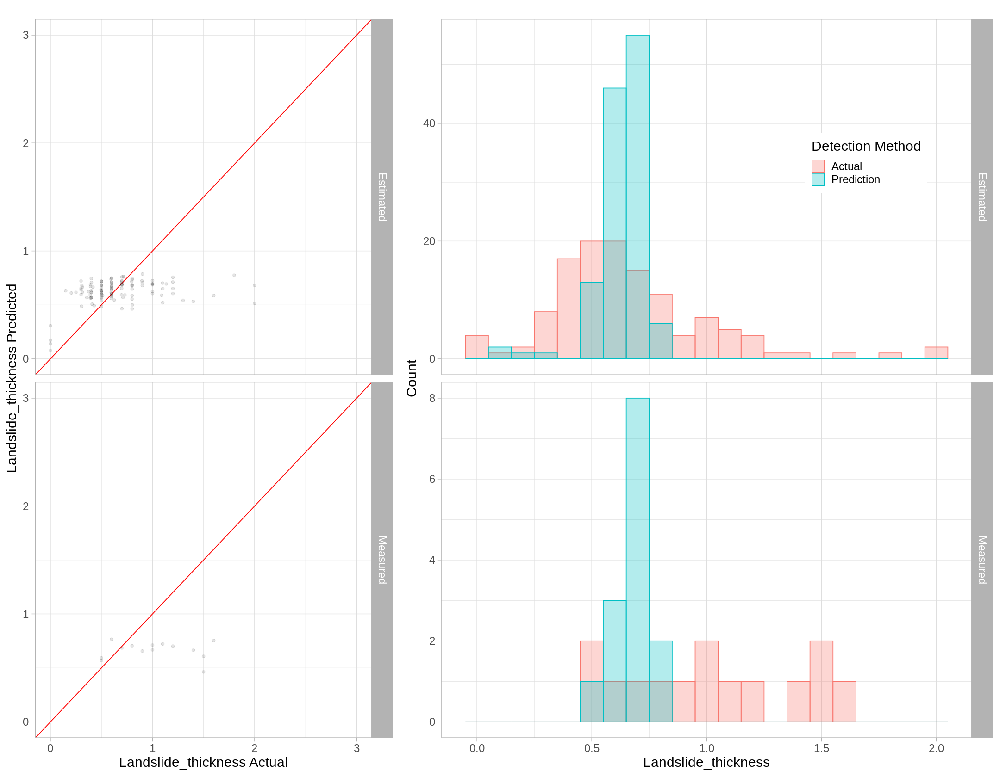

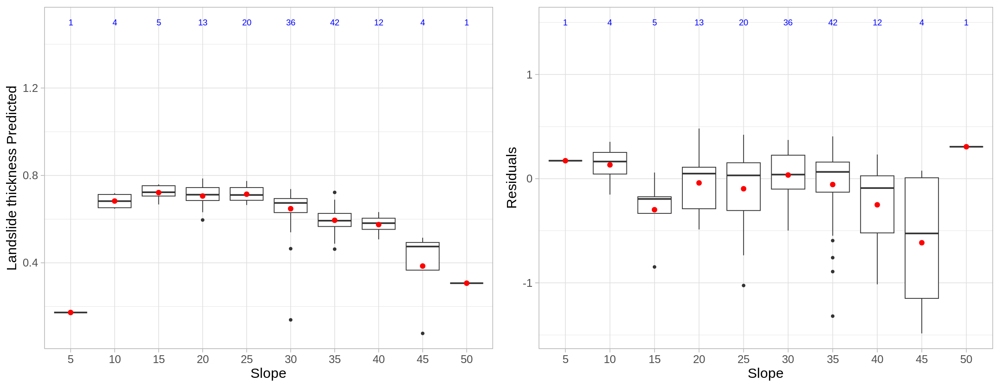

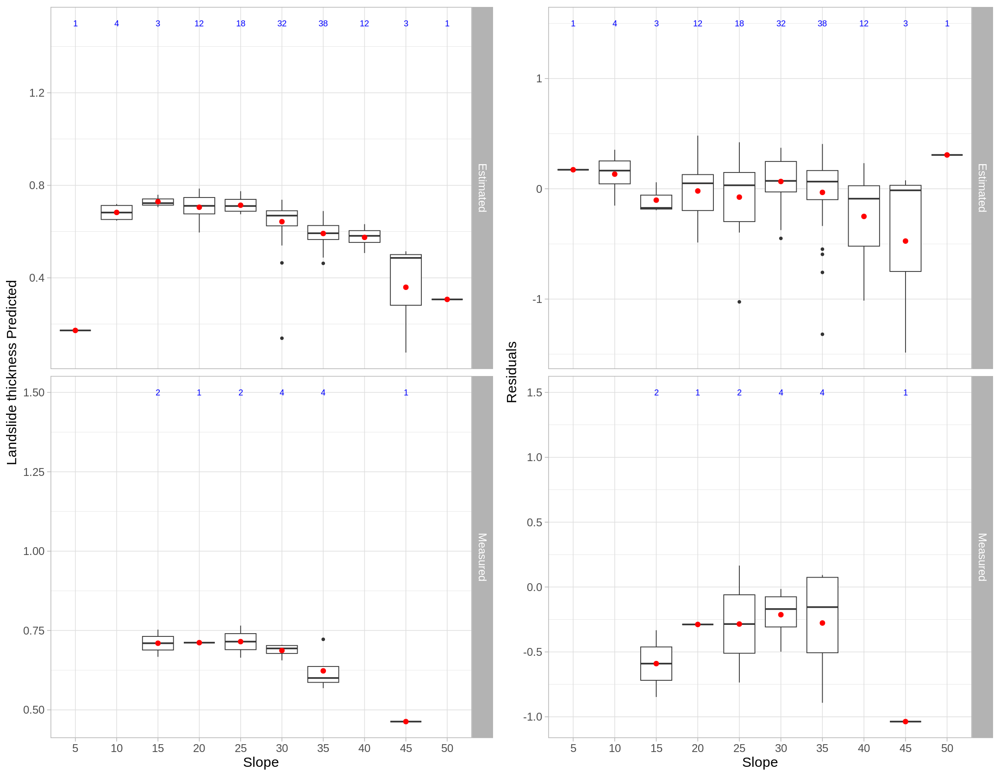

In [165]:
x_columns <- x_cols_manual
y_column <- y_col
method_label <- "GAM"
train_label <- "HMDB"
test_label <- "HMDB"



print(paste(method_label,train_label,test_label))
set.seed(seed)

print(nrow(data_train_hmdb))
print(nrow(data_test_hmdb))

set.seed(seed)

gam_model_hmdb <- caret::train(
                     x=data_train_hmdb_x,
                     y=data_train_hmdb_y,
                     method = "gam",
                     tuneGrid = gam.tune.grid,
                     trControl = rf.tc.cv                     
                  )

print(summary(gam_model_hmdb))
print(varImp(gam_model_hmdb))

pred_train_gam_hmdb <- predict(gam_model_hmdb, data = data_train_hmdb)

res_train <- score_model(data_train_hmdb_y,pred_train_gam_hmdb,actual_label = y_column,plot=plot)

pred_test_gam_hmdb <- predict(gam_model_hmdb$finalModel,newdata = data_test_hmdb)
res_test <- score_model(data_test_hmdb_y,pred_test_gam_hmdb,actual_label = y_column,plot=plot)
score_model(data_test_hmdb_y,pred_test_gam_hmdb,actual_label = y_column,plot=plot,facet=data_test_hmdb$Landslide_thickness_MAO)

res.gam.hmdb <- merge_score_results(method_label, train_label, test_label, data_train_hmdb, res_train, data_test_hmdb, res_test) 
res.gam.hmdb

model_box_plot(data_test_hmdb_y,pred_test_gam_hmdb,data_test_hmdb$slope_10,bin_width=5,plot_resid=TRUE)
model_box_plot(data_test_hmdb_y,pred_test_gam_hmdb,data_test_hmdb$slope_10,bin_width=5,plot_resid=TRUE,facet=data_test_hmdb$Landslide_thickness_MAO)

save(gam_model_hmdb, file="gam_model_hmdb.RData")

[1] "Cutoff 100 km"

	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = 1.8873, p-value = 0.02956
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
     1.070242e-02     -7.299270e-03      9.098099e-05 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = 0.010702, observed rank = 946, p-value = 0.054
alternative hypothesis: greater



could not calculate geary.test

could not calculate geary.mc



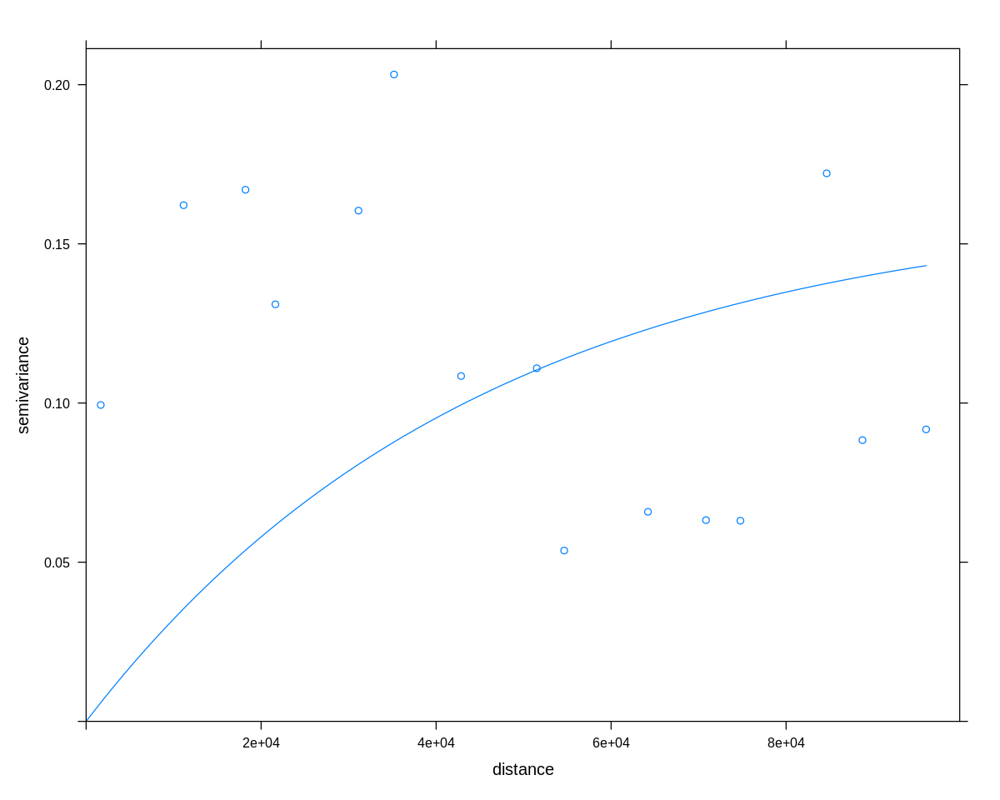

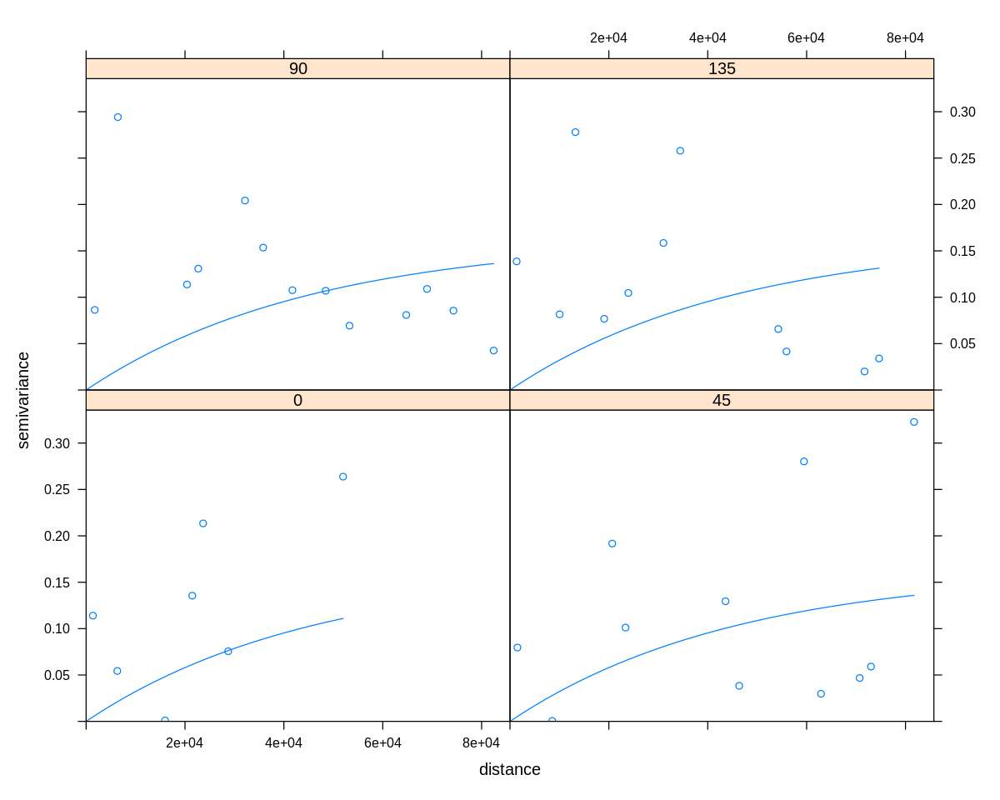

In [166]:
test_autocorrelation(data_test_hmdb.spdf,data_test_hmdb_y,pred_test_gam_hmdb,cutoff=100000,model="Exp")

[1] "GAM StorMe StorMe"
[1] 2341
[1] 583

Family: gaussian 
Link function: identity 

Formula:
.outcome ~ s(rhob_m) + s(vhm_max_5) + s(mrvbf_10) + s(mrrtf_25) + 
    s(catchment_area_25) + s(tpi_4km_25) + s(tpi_500m_25) + s(vrm_r5_25) + 
    s(slope_height_25) + s(catchment_slope_25) + s(valley_depth_25) + 
    s(standardized_height_25) + s(curvature_10) + s(curvature_profile_25) + 
    s(tri_r5_10) + s(tri_r5_5) + s(h_5) + s(slope_10) + s(aspect_nness_10) + 
    s(twi_5) + s(openness_neg_200_5)

Parametric coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  0.96166    0.01066   90.19   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Approximate significance of smooth terms:
                                edf Ref.df      F p-value    
s(rhob_m)                 1.1075519      9  0.371  0.0540 .  
s(vhm_max_5)              0.0001626      9  0.000  0.9477    
s(mrvbf_10)               0.0004318      9  0.000  0.9243    
s(mrrtf_2

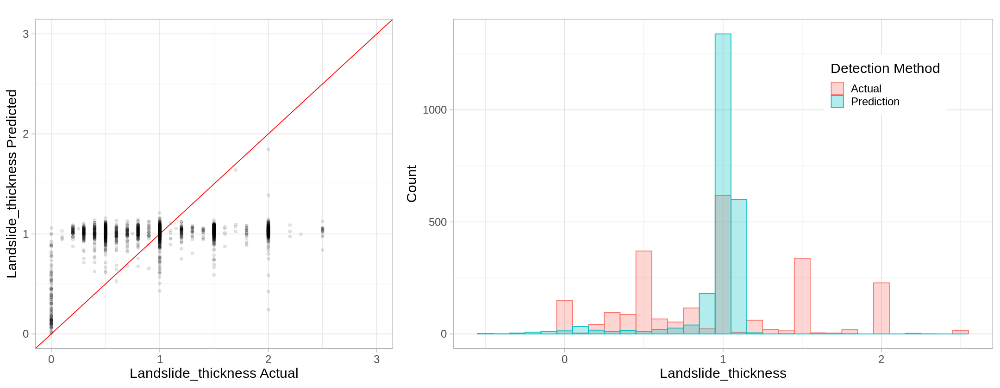

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
GAM,StorMe,StorMe,2341,0.4057482,NA,0.5264647,0.5134826,0.169103,-0.5459363,⋯,0.4229199,NA,0.5264647,0.5295705,0.137116,-0.5373122,1.122516,-0.8859795,1.54163,0.9082918


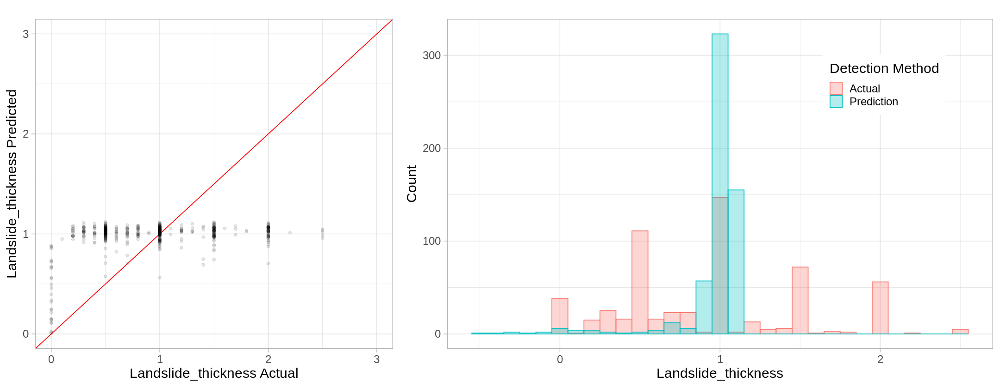

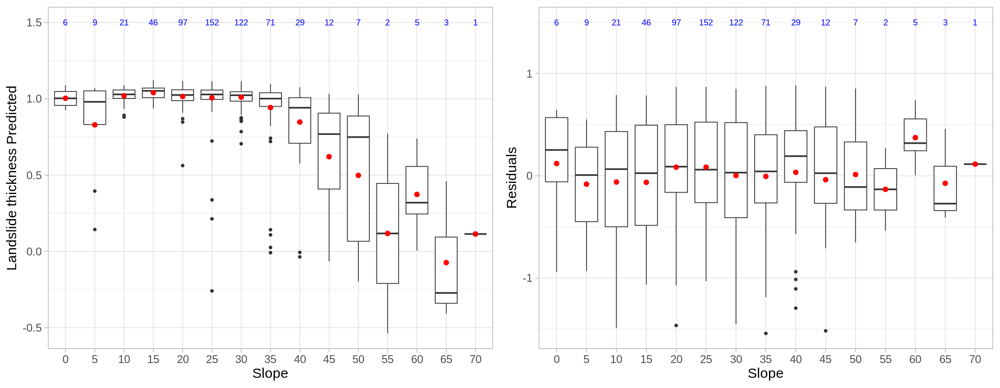

In [167]:
x_columns <- x_cols_manual
y_column <- y_col
method_label <- "GAM"
train_label <- "StorMe"
test_label <- "StorMe"

print(paste(method_label,train_label,test_label))
set.seed(seed)

print(nrow(data_train_storme))
print(nrow(data_test_storme))

set.seed(seed)

gam_model_storme <- caret::train(
                     x=data_train_storme_x,
                     y=data_train_storme_y,
                     method = "gam",
                     tuneGrid = gam.tune.grid,
                     trControl = rf.tc.cv                     
                  )

print(summary(gam_model_storme))
print(varImp(gam_model_storme))

pred_train_gam_storme <- predict(gam_model_storme, data = data_train_storme)

res_train <- score_model(data_train_storme_y,pred_train_gam_storme,actual_label = y_column,plot=plot)

pred_test_gam_storme <- predict(gam_model_storme$finalModel,newdata = data_test_storme)
res_test <- score_model(data_test_storme_y,pred_test_gam_storme,actual_label = y_column,plot=plot)

res.gam.storme <- merge_score_results(method_label, train_label, test_label, data_train_storme, res_train, data_test_storme, res_test) 
res.gam.storme

model_box_plot(data_test_storme_y,pred_test_gam_storme,data_test_storme$slope_10,bin_width=5,plot_resid=TRUE)


[1] "Cutoff 100 km"

	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = -1.198, p-value = 0.8845
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
    -3.450394e-03     -1.718213e-03      2.090744e-06 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = -0.0034504, observed rank = 60, p-value = 0.94
alternative hypothesis: greater



could not calculate geary.test

could not calculate geary.mc



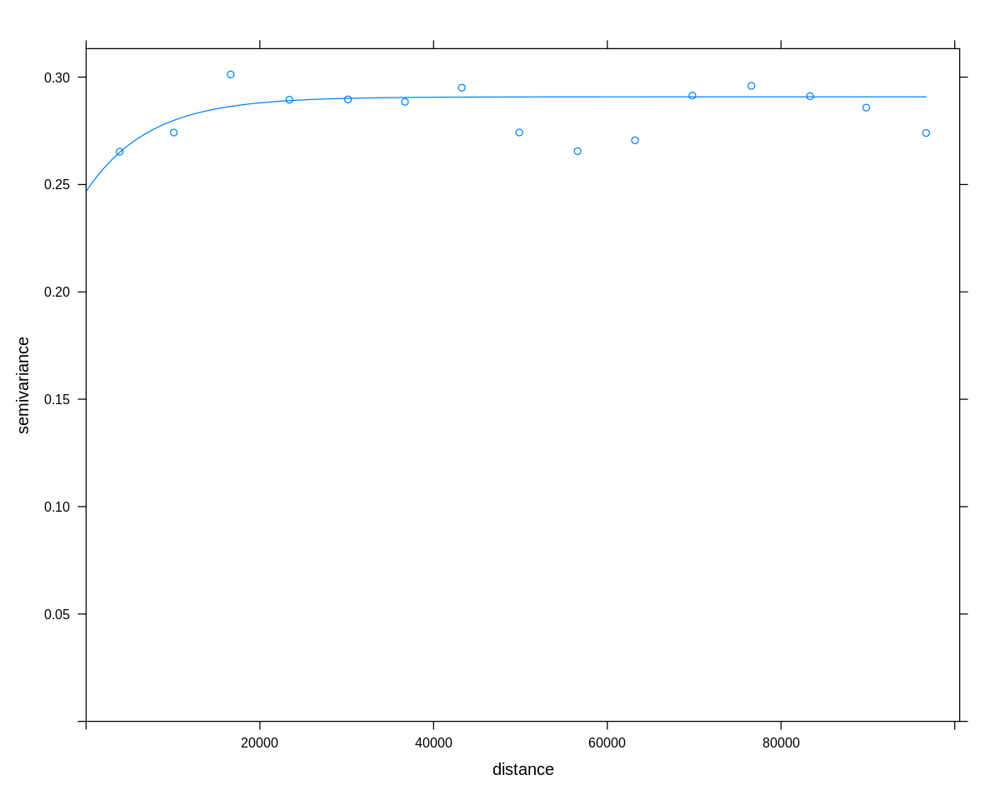

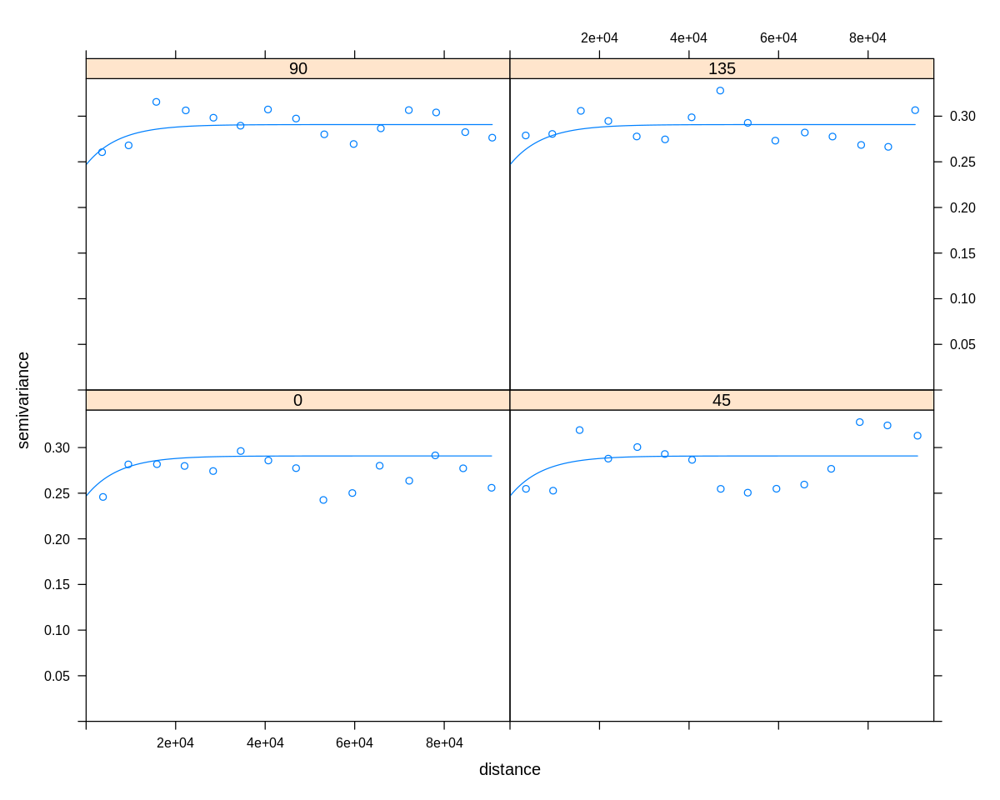

In [168]:
test_autocorrelation(data_test_storme.spdf,data_test_storme_y,pred_test_gam_storme,cutoff=100000,model="Exp")

[1] "GAM BE BE"
[1] 458
[1] 112

Family: gaussian 
Link function: identity 

Formula:
.outcome ~ s(rhob_m) + s(vhm_max_5) + s(mrvbf_10) + s(mrrtf_25) + 
    s(tpi_4km_25) + s(tpi_500m_25) + s(vrm_r5_25) + s(slope_height_25) + 
    s(catchment_slope_25) + s(valley_depth_25) + s(standardized_height_25) + 
    s(curvature_profile_25) + s(catchment_area_25) + s(tri_r5_10) + 
    s(tri_r5_5) + s(h_5) + s(slope_10) + s(aspect_nness_10) + 
    s(twi_5) + s(curvature_10) + s(openness_neg_200_5)

Parametric coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  0.59476    0.01353   43.96   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Approximate significance of smooth terms:
                                edf Ref.df     F  p-value    
s(rhob_m)                 1.977e+00      9 1.169 0.002563 ** 
s(vhm_max_5)              2.086e+00      9 1.565 0.000445 ***
s(mrvbf_10)               6.834e-05      9 0.000 0.470341    
s(mrrtf_25)       

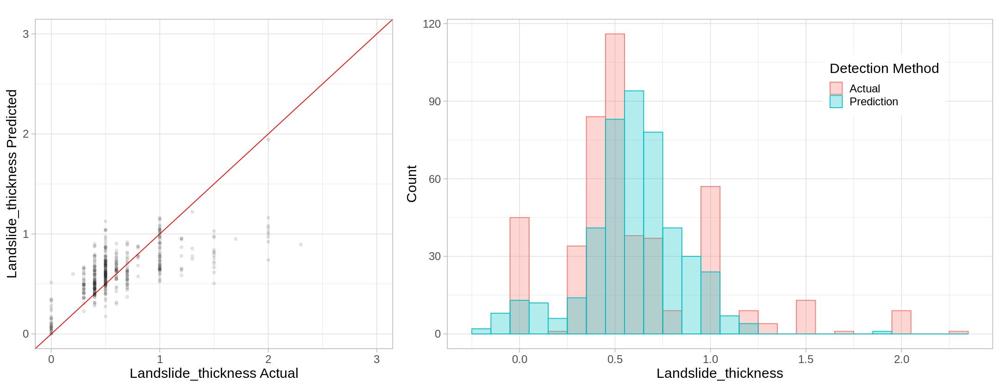

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
GAM,BE,BE,458,0.1961832,NA,0.4629394,0.2821881,0.4896579,-0.1748368,⋯,0.1983808,NA,0.4629394,0.3261354,0.3392231,-0.1845285,1.170829,-0.4216493,2.051407,0.3908963


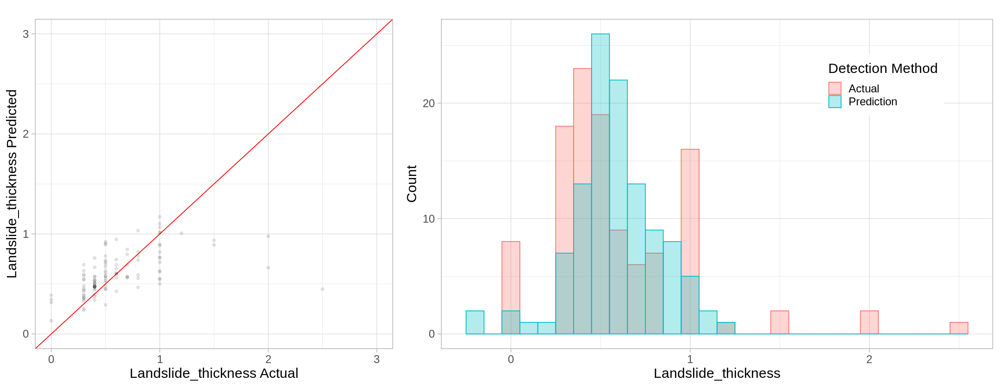

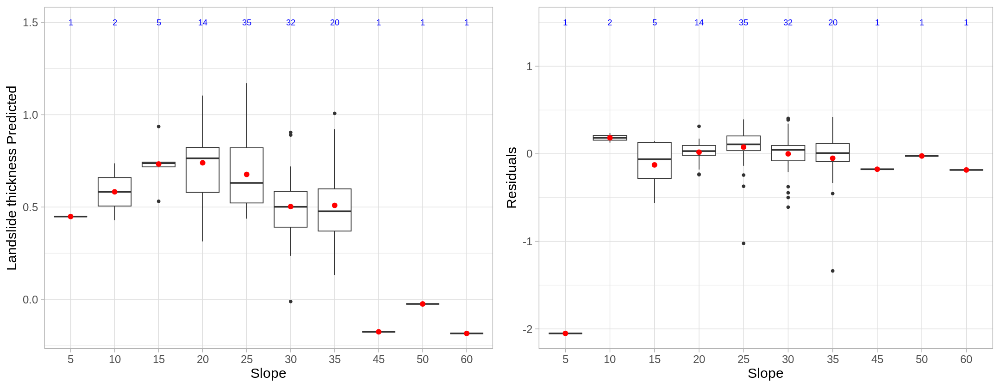

In [169]:
x_columns <- x_cols_manual
y_column <- y_col
method_label <- "GAM"
train_label <- "BE"
test_label <- "BE"

print(paste(method_label,train_label,test_label))
set.seed(seed)

print(nrow(data_train_be))
print(nrow(data_test_be))

set.seed(seed)

gam_model_be <- caret::train(
                     x=data_train_be_x,
                     y=data_train_be_y,
                     method = "gam",
                     tuneGrid = gam.tune.grid,
                     trControl = rf.tc.cv                     
                  )

print(summary(gam_model_be))
print(varImp(gam_model_be))

pred_train_gam_be <- predict(gam_model_be, data = data_train_be)

res_train <- score_model(data_train_be_y,pred_train_gam_be,actual_label = y_column,plot=plot)

pred_test_gam_be <- predict(gam_model_be$finalModel,newdata = data_test_be)
res_test <- score_model(data_test_be_y,pred_test_gam_be,actual_label = y_column,plot=plot)

res.gam.be <- merge_score_results(method_label, train_label, test_label, data_train_be, res_train, data_test_be, res_test) 
res.gam.be

model_box_plot(data_test_be_y,pred_test_gam_be,data_test_be$slope_10,bin_width=5,plot_resid=TRUE)


save(gam_model_be, file="gam_model_be.RData")

[1] "Cutoff 100 km"

	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = NaN, p-value = NA
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
    -9.009009e-03     -9.009009e-03     -5.566023e-17 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = -0.009009, observed rank = 306, p-value = 0.694
alternative hypothesis: greater



could not calculate geary.test

could not calculate geary.mc



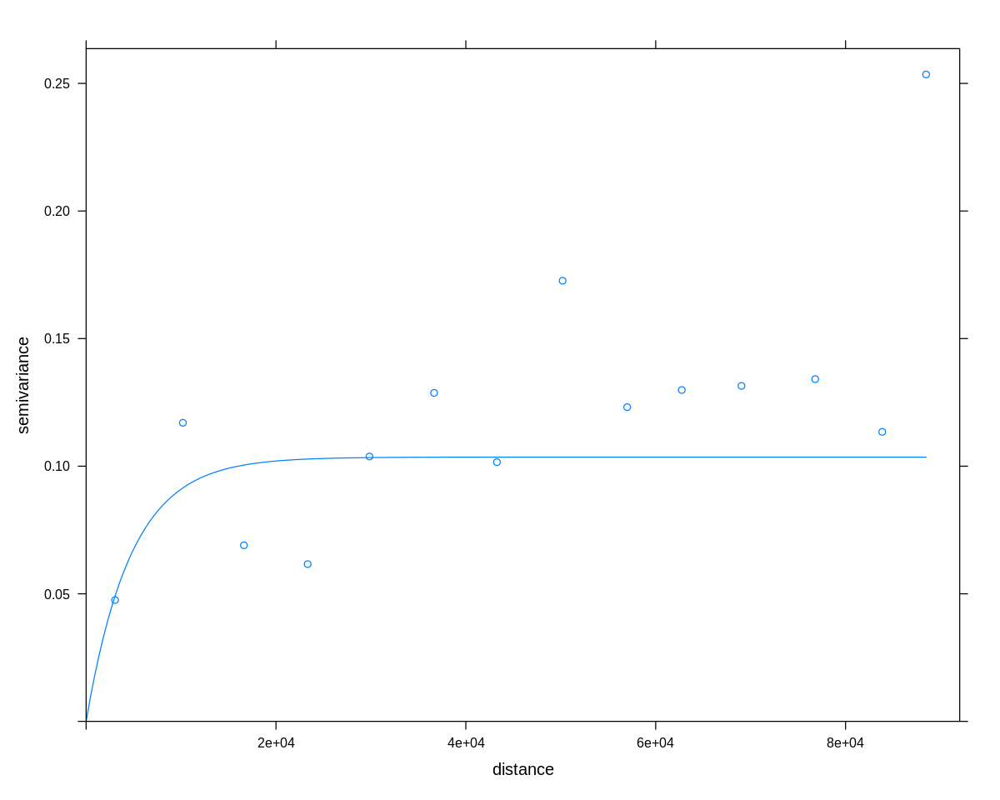

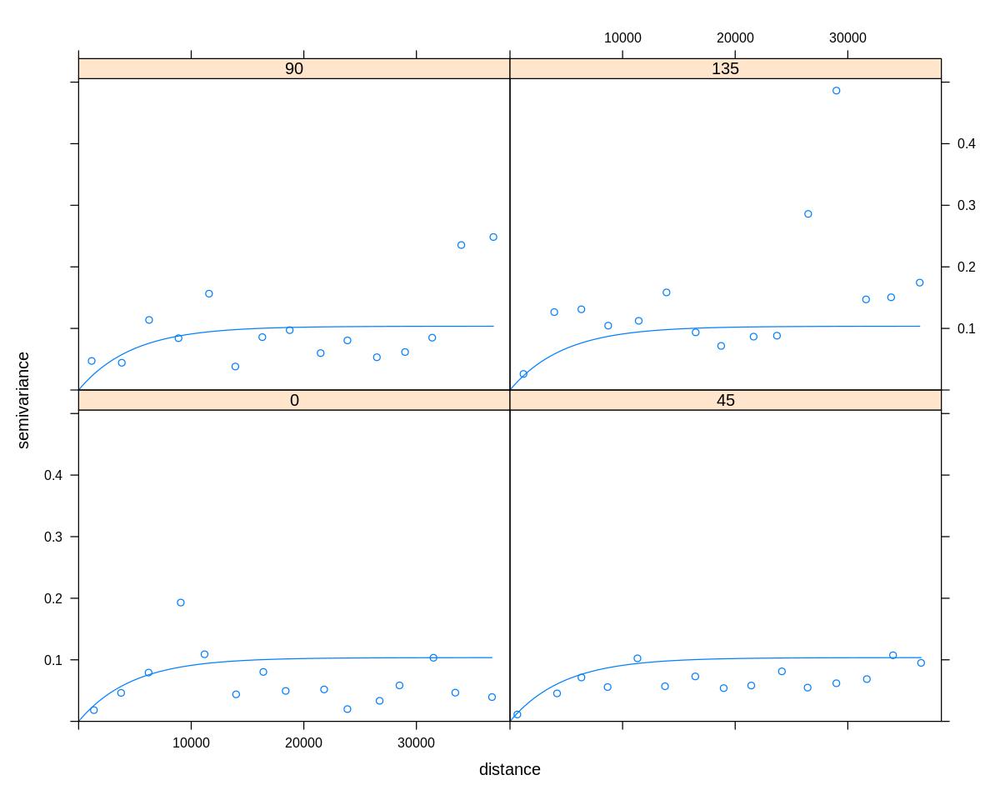

In [170]:
test_autocorrelation(data_test_be.spdf,data_test_be_y,pred_test_gam_be,cutoff=100000,model="Exp")

[1] "GAM BE HMDB"


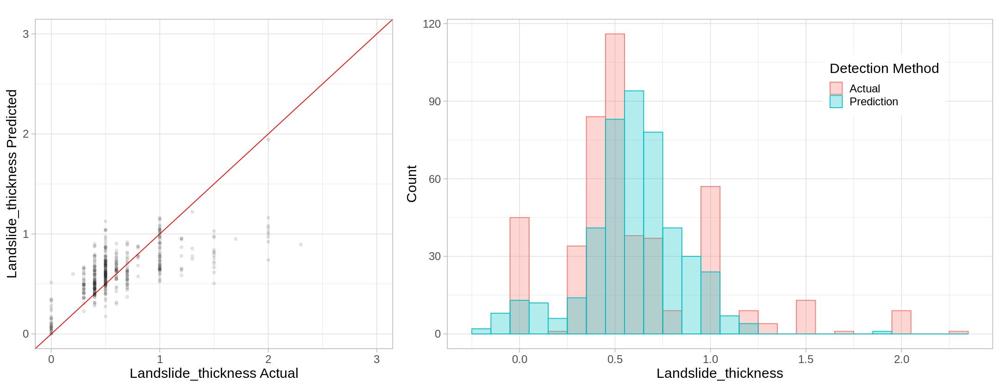

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
GAM,BE,HMDB,458,0.1961832,NA,0.4629394,0.2821881,0.4896579,-0.1748368,⋯,0.258591,NA,0.4629394,0.3718696,0.06368968,-0.2955292,2.727187,-2.054583,1.602097,0.5680674


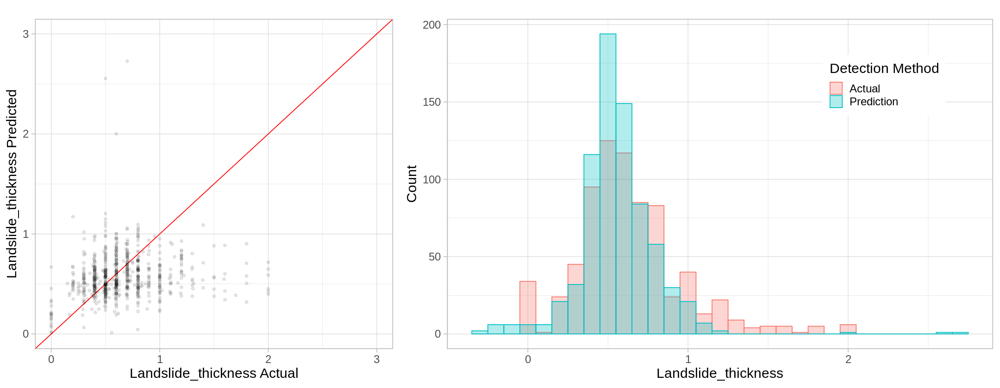

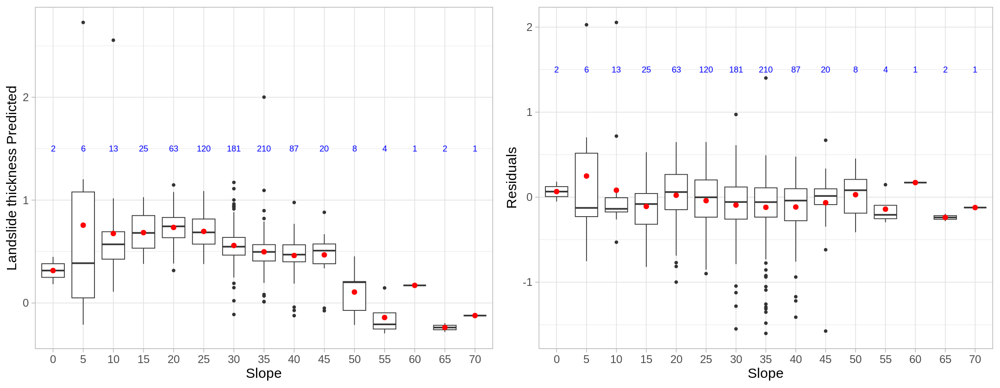

In [171]:
x_columns <- x_cols_manual
y_column <- y_col
method_label <- "GAM"
train_label <- "BE"
test_label <- "HMDB"

print(paste(method_label,train_label,test_label))
set.seed(seed)

pred_train_gam_be_hmdb <- predict(gam_model_be, data = data_train_be_hmdb)
res_train <- score_model(data_train_be_hmdb_y,pred_train_gam_be_hmdb,actual_label = y_column,plot=plot)

pred_test_gam_be_hmdb <- predict(gam_model_be$finalModel,newdata = data_test_be_hmdb)
res_test <- score_model(data_test_be_hmdb_y,pred_test_gam_be_hmdb,actual_label = y_column,plot=plot)


res.gam.be_hmdb <- merge_score_results(method_label, train_label, test_label, data_train_be_hmdb, res_train, data_test_be_hmdb, res_test) 
res.gam.be_hmdb

model_box_plot(data_test_be_hmdb_y,pred_test_gam_be_hmdb,data_test_be_hmdb$slope_10,bin_width=5,plot_resid=TRUE)


[1] "Cutoff 100 km"

	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = 11.487, p-value < 2.2e-16
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
     1.681888e-02     -1.347709e-03      2.500917e-06 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = 0.016819, observed rank = 1000, p-value = 0.001
alternative hypothesis: greater



could not calculate geary.test

could not calculate geary.mc



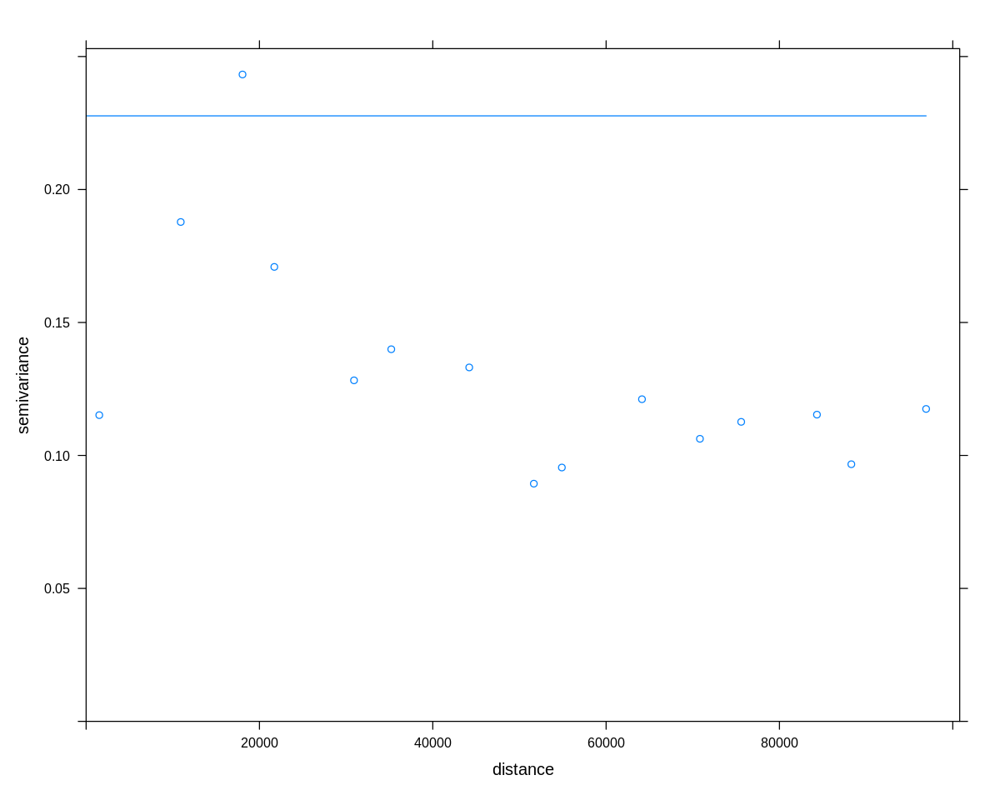

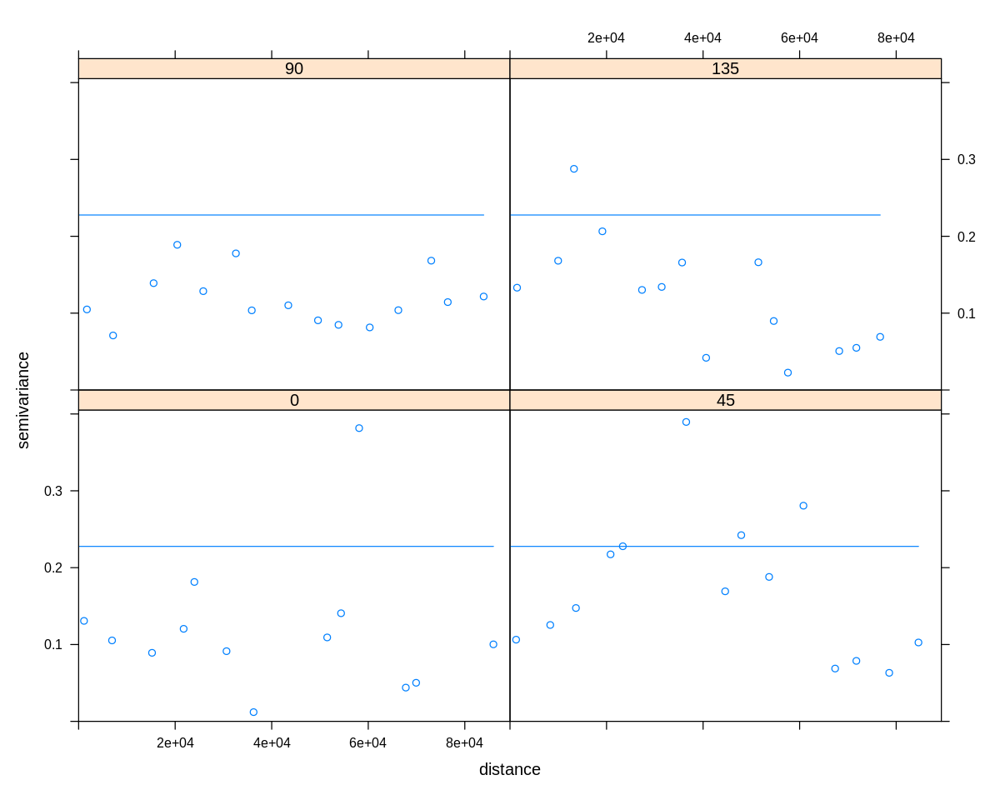

In [172]:
test_autocorrelation(data_test_be_hmdb.spdf,data_test_be_hmdb_y,pred_test_gam_be_hmdb,cutoff=100000)


[1] "GAM HMDB BE"


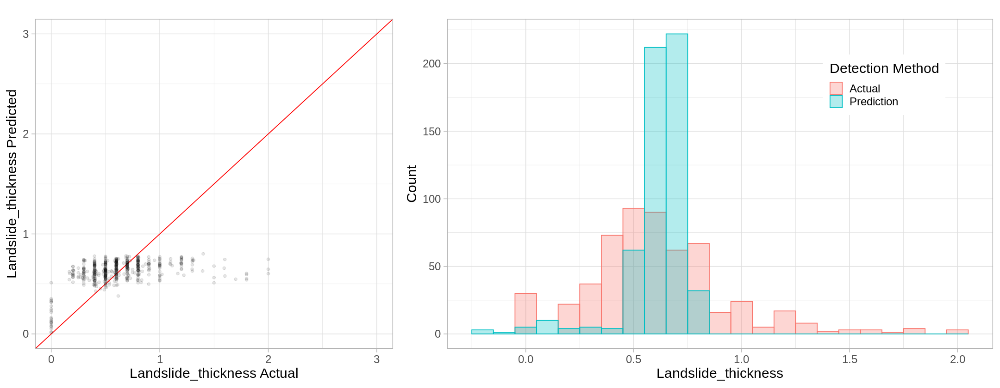

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
GAM,HMDB,BE,560,0.2058405,NA,0.4096095,0.2902076,0.224345,-0.205891,⋯,0.2691997,NA,0.4096095,0.3573741,0.1928429,-0.2869751,0.8034294,-0.6438314,1.977424,0.4214911


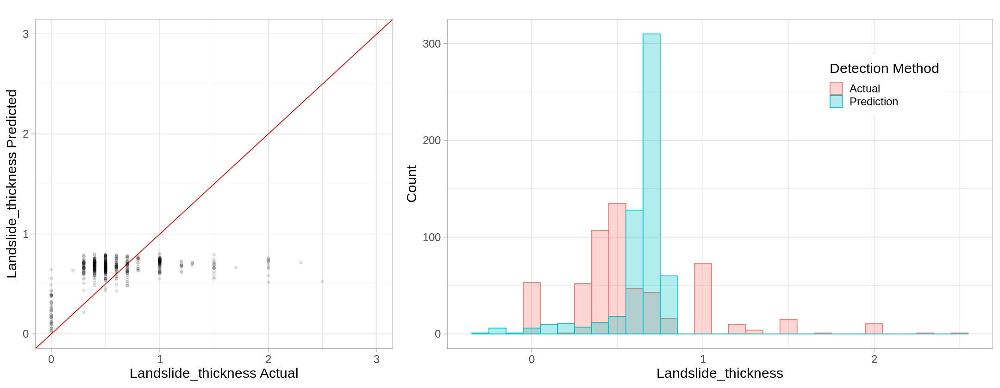

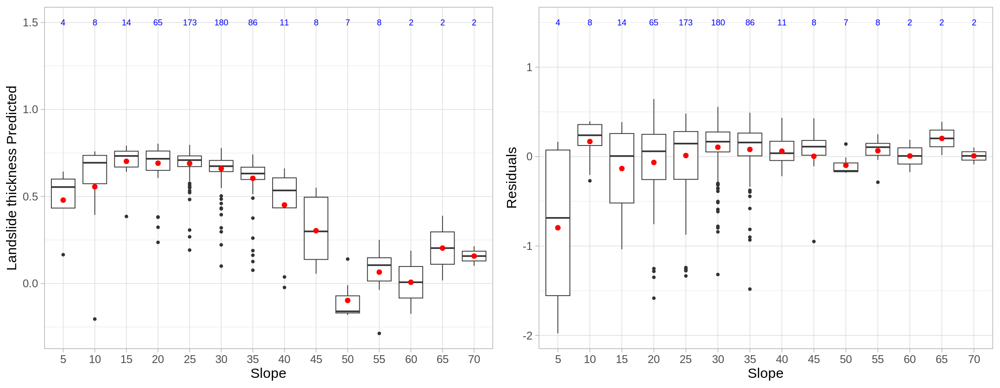

In [173]:
x_columns <- x_cols_manual
y_column <- y_col
method_label <- "GAM"
train_label <- "HMDB"
test_label <- "BE"

print(paste(method_label,train_label,test_label))
set.seed(seed)

pred_train_gam_hmdb_be <- predict(gam_model_hmdb, data = data_train_hmdb_be)
res_train <- score_model(data_train_hmdb_be_y,pred_train_gam_hmdb_be,actual_label = y_column,plot=plot)

pred_test_gam_hmdb_be <- predict(gam_model_hmdb$finalModel,newdata = data_test_hmdb_be)
res_test <- score_model(data_test_hmdb_be_y,pred_test_gam_hmdb_be,actual_label = y_column,plot=plot)


res.gam.hmdb_be <- merge_score_results(method_label, train_label, test_label, data_train_hmdb_be, res_train, data_test_hmdb_be, res_test) 
res.gam.hmdb_be

model_box_plot(data_test_hmdb_be_y,pred_test_gam_hmdb_be,data_test_hmdb_be$slope_10,bin_width=5,plot_resid=TRUE)


[1] "Cutoff 100 km"

	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = 0.024575, p-value = 0.4902
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
    -1.757100e-03     -1.757469e-03      2.260402e-10 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = -0.0017571, observed rank = 530, p-value = 0.47
alternative hypothesis: greater



could not calculate geary.test

could not calculate geary.mc



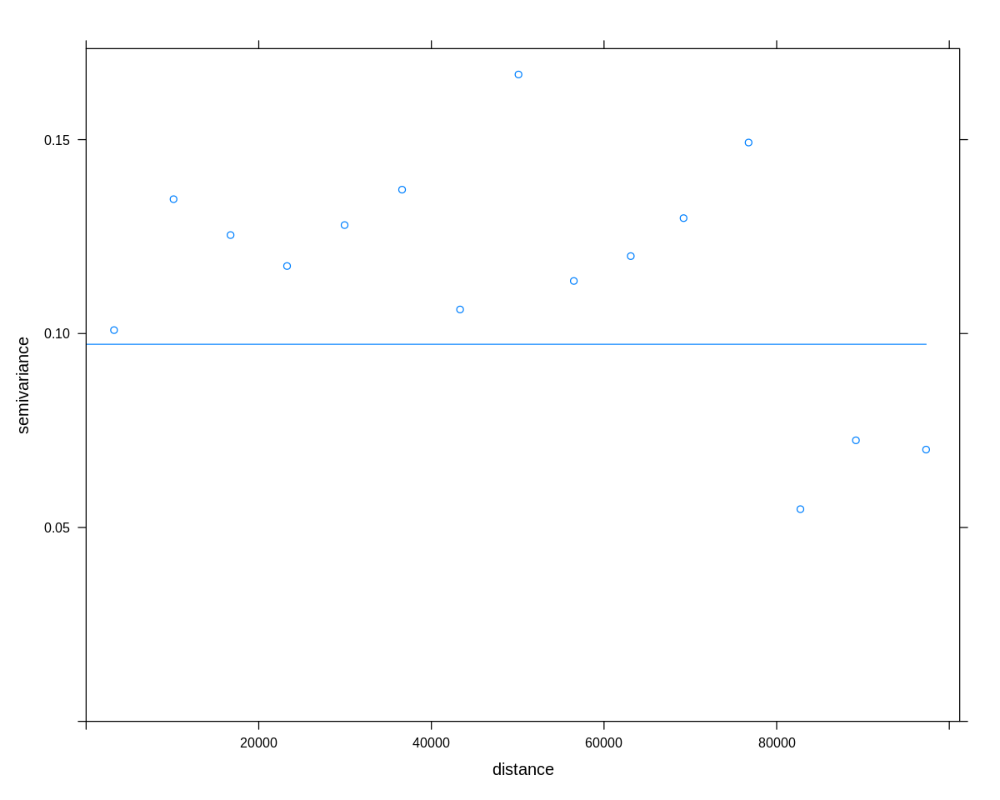

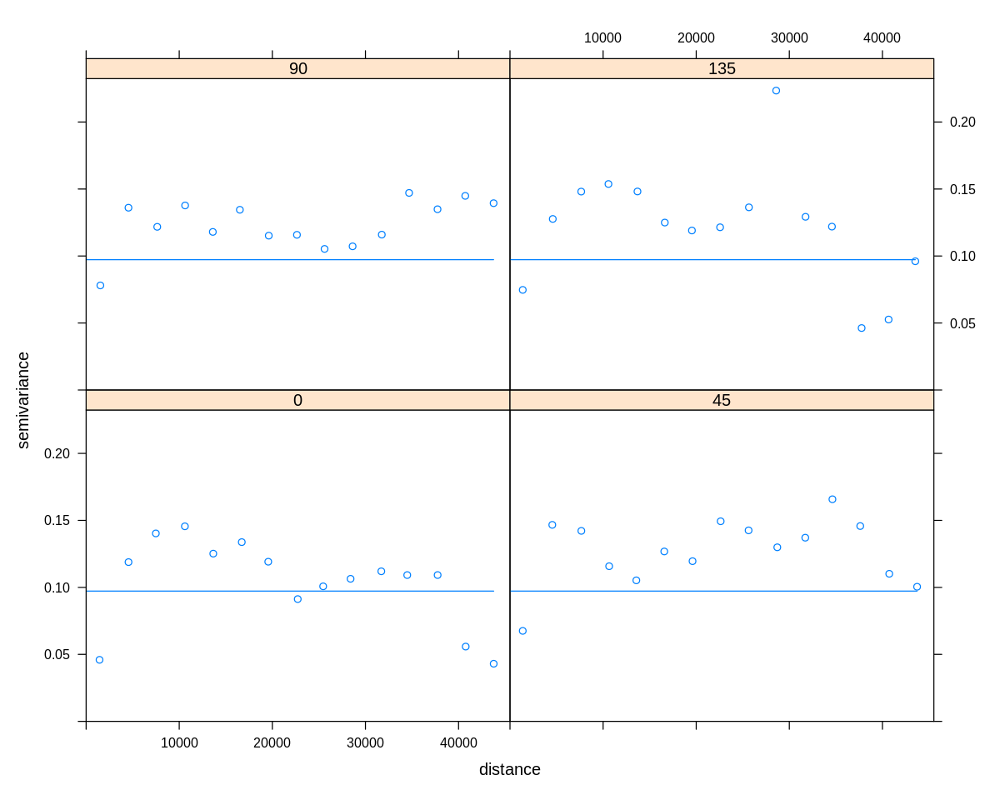

In [174]:
test_autocorrelation(data_test_hmdb_be.spdf,data_test_hmdb_be_y,pred_test_gam_hmdb_be,cutoff=100000)


[1] "GAM HMDB StorMe"


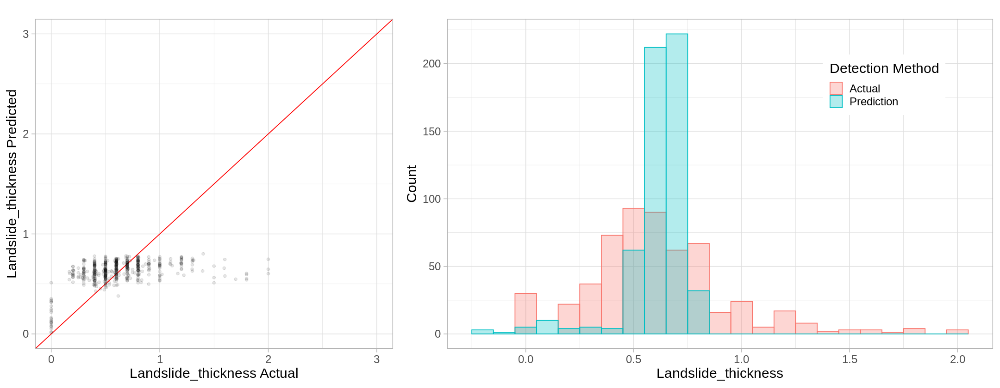

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
GAM,HMDB,StorMe,560,0.2058405,NA,0.4096095,0.2902076,0.224345,-0.205891,⋯,0.4930201,NA,0.4096095,0.6381249,0.08664336,-1.639952,0.8211107,-0.6924836,3.639952,1.258114


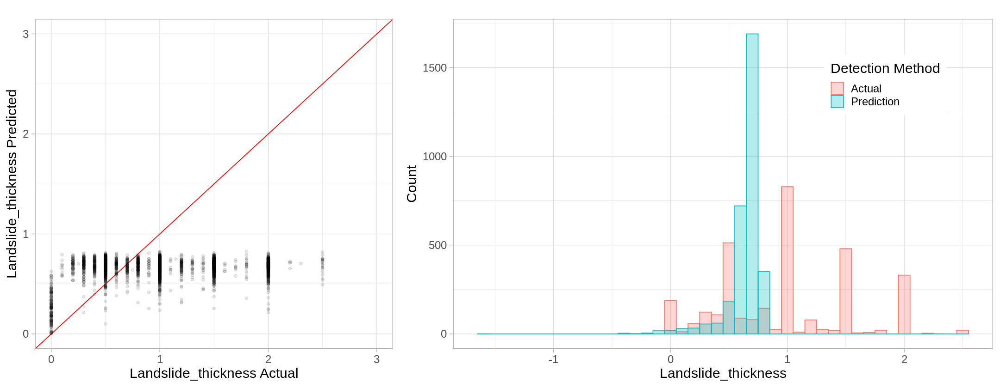

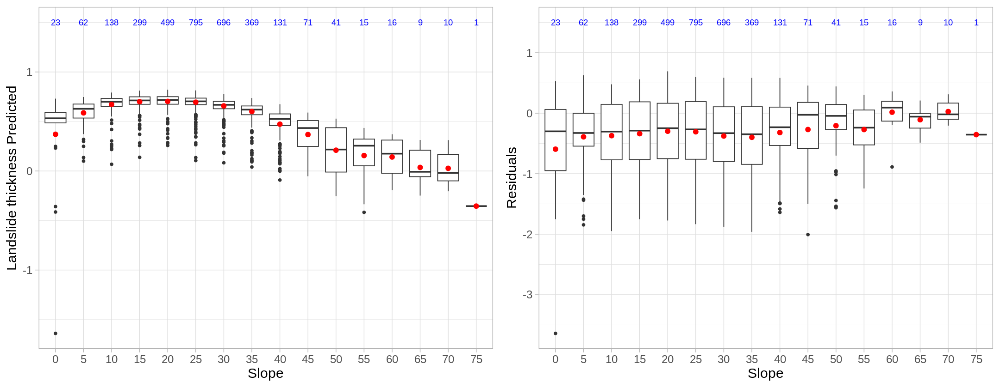

In [175]:
x_columns <- x_cols_manual
y_column <- y_col
method_label <- "GAM"
train_label <- "HMDB"
test_label <- "StorMe"

print(paste(method_label,train_label,test_label))
set.seed(seed)

pred_train_gam_hmdb_storme <- predict(gam_model_hmdb, data = data_train_hmdb_storme)
res_train <- score_model(data_train_hmdb_storme_y,pred_train_gam_hmdb_storme,actual_label = y_column,plot=plot)

pred_test_gam_hmdb_storme <- predict(gam_model_hmdb$finalModel,newdata = data_test_hmdb_storme)
res_test <- score_model(data_test_hmdb_storme_y,pred_test_gam_hmdb_storme,actual_label = y_column,plot=plot)

res.gam.hmdb_storme <- merge_score_results(method_label, train_label, test_label, data_train_hmdb_storme, res_train, data_test_hmdb_storme, res_test) 
res.gam.hmdb_storme

model_box_plot(data_test_hmdb_storme_y,pred_test_gam_hmdb_storme,data_test_hmdb_storme$slope_10,bin_width=5,plot_resid=TRUE)


[1] "Cutoff 100 km"

	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = 9.5903, p-value < 2.2e-16
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
     2.314451e-03     -3.150599e-04      7.517674e-08 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = 0.0023145, observed rank = 1000, p-value = 0.001
alternative hypothesis: greater



could not calculate geary.test

could not calculate geary.mc



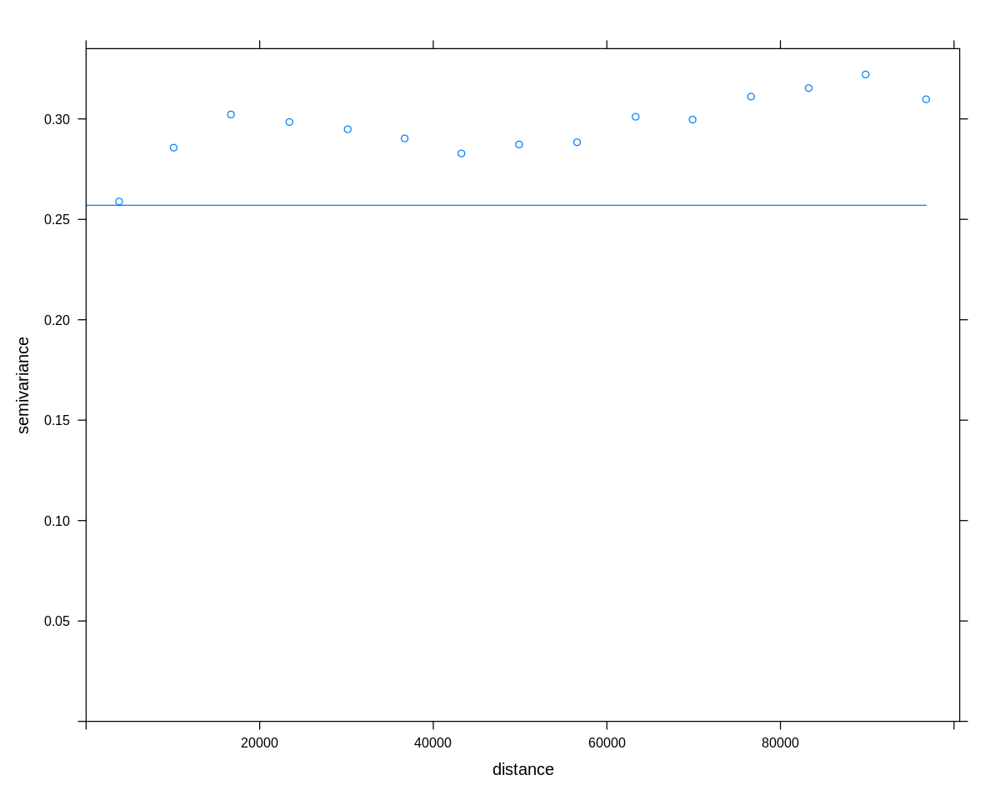

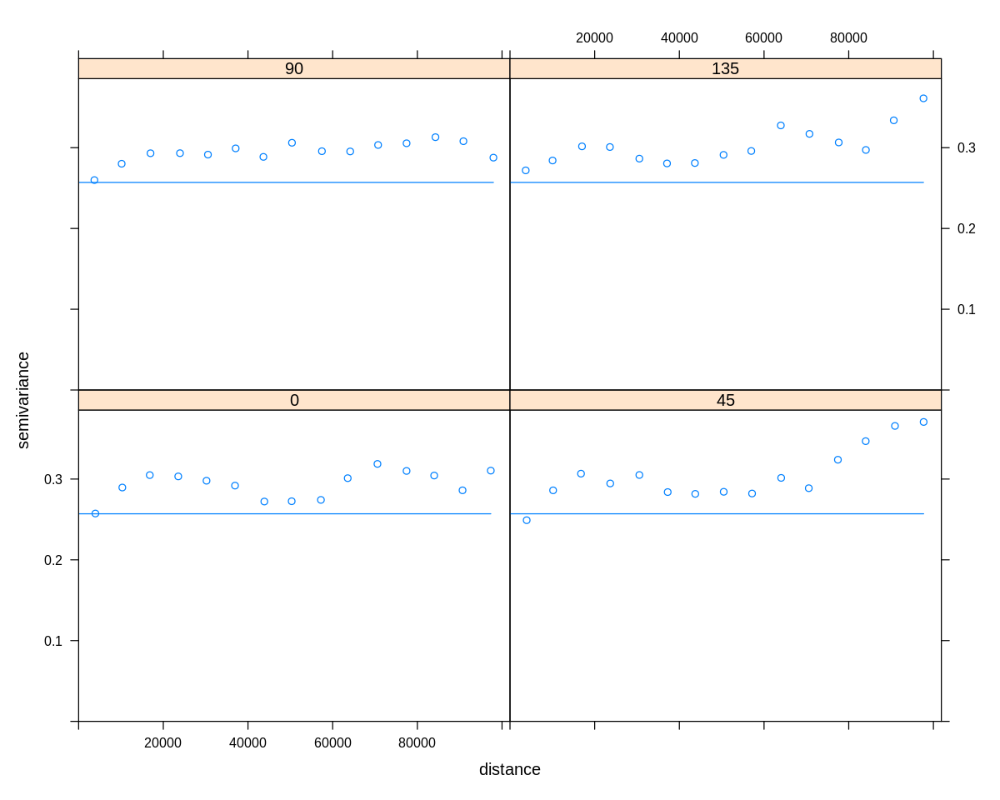

In [176]:
test_autocorrelation(data_test_hmdb_storme.spdf,data_test_hmdb_storme_y,pred_test_gam_hmdb_storme,cutoff=100000)


<a id="Paper_Model_LM"></a>
### Linear Model

In [177]:
plot <- TRUE

In [178]:
lm.tune.grid <- expand.grid(intercept = c(FALSE,TRUE))   


[1] "LM HMDB HMDB"

Call:
lm(formula = .outcome ~ 0 + ., data = dat)

Residuals:
    Min      1Q  Median      3Q     Max 
-0.5076 -0.1823 -0.0534  0.1197  1.4215 

Coefficients:
                         Estimate Std. Error t value Pr(>|t|)    
tri_r5_10              -4.856e-03  8.080e-03  -0.601   0.5481    
tri_r5_5               -6.642e-03  1.551e-02  -0.428   0.6687    
tpi_4km_25              1.342e-04  1.319e-04   1.018   0.3093    
tpi_500m_25             1.557e-03  1.038e-03   1.500   0.1341    
vhm_max_5              -1.654e-04  1.156e-03  -0.143   0.8863    
h_5                    -1.478e-04  1.042e-04  -1.418   0.1567    
vrm_r5_25              -2.048e-01  2.890e-01  -0.709   0.4789    
mrvbf_10               -7.675e-01  3.540e-01  -2.168   0.0306 *  
mrrtf_25               -4.893e-01  6.106e+00  -0.080   0.9362    
slope_height_25        -2.738e-04  1.992e-04  -1.375   0.1697    
catchment_slope_25      3.969e-02  2.016e-01   0.197   0.8440    
valley_depth_25        -1.039e

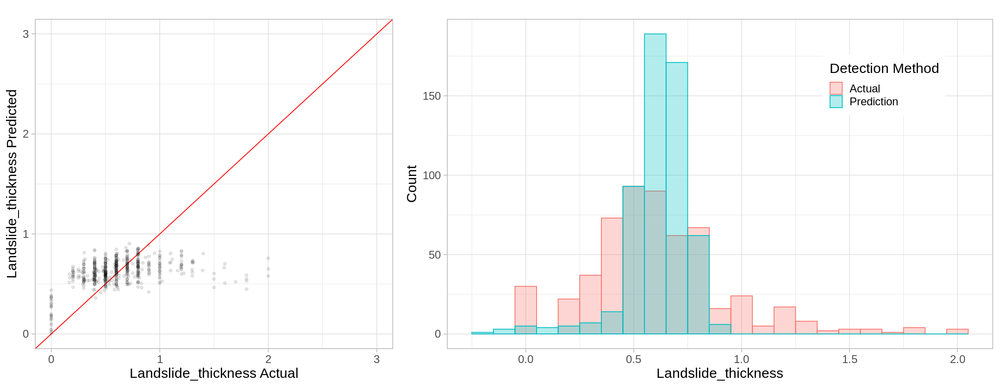

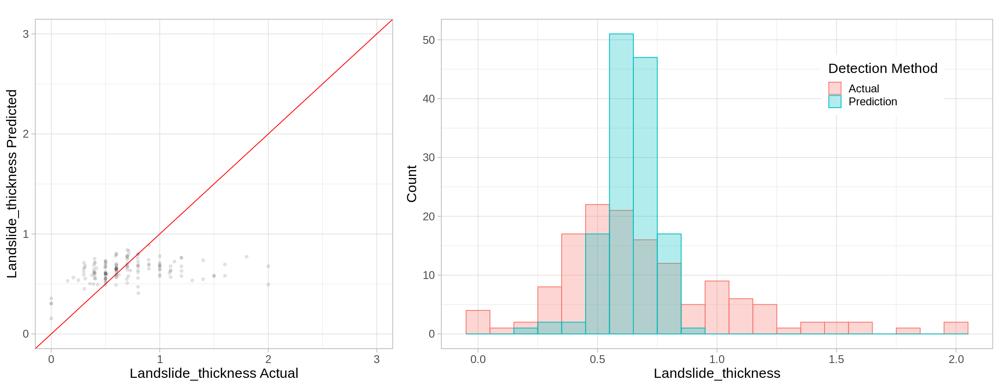

# A tibble: 2 × 6
  mao         mae  mape  rmse     r2     n
  <chr>     <dbl> <dbl> <dbl>  <dbl> <int>
1 Estimated 0.250    NA 0.359 0.0869   124
2 Measured  0.250    NA 0.359 0.0869    14


,mae,mape,smape,rmse,r2,min_pred,max_pred,min_err,max_err,ae_p90,n
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>
90%,0.2497297,NA,0.3901862,0.3588504,0.08690701,0.1556054,0.8854671,-0.4128305,1.505945,0.4941453,138


method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
LM,HMDB,HMDB,560,0.2102958,NA,0.413874,0.2962727,0.1903138,-0.223697,⋯,0.2497297,NA,0.413874,0.3588504,0.08690701,0.1556054,0.8854671,-0.4128305,1.505945,0.4941453


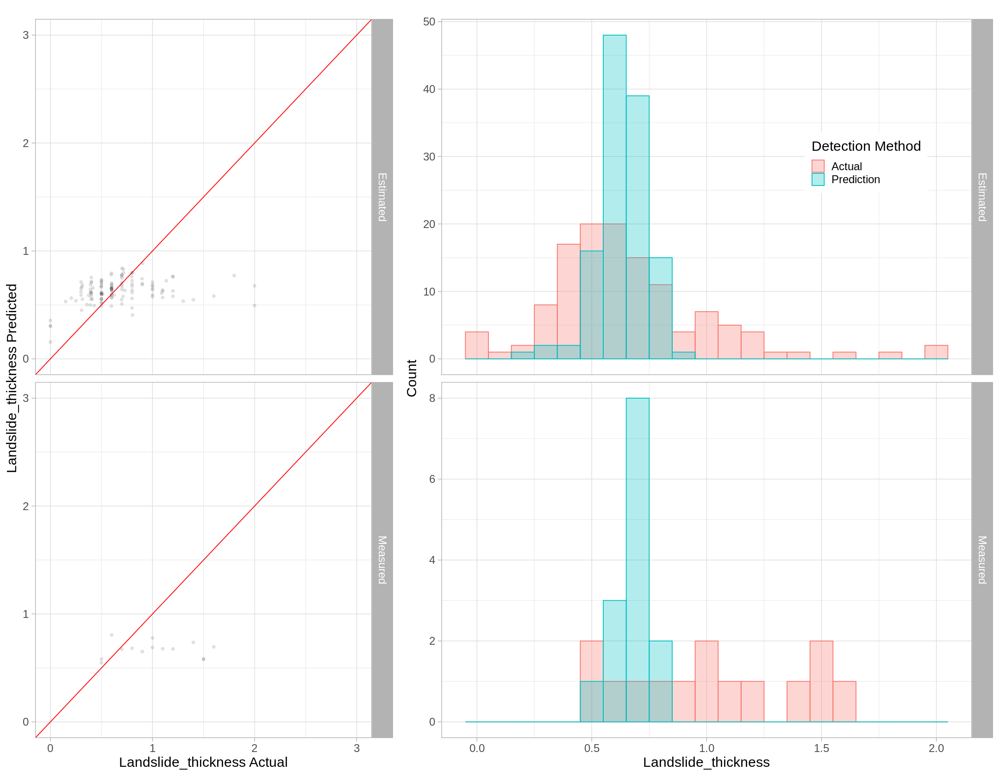

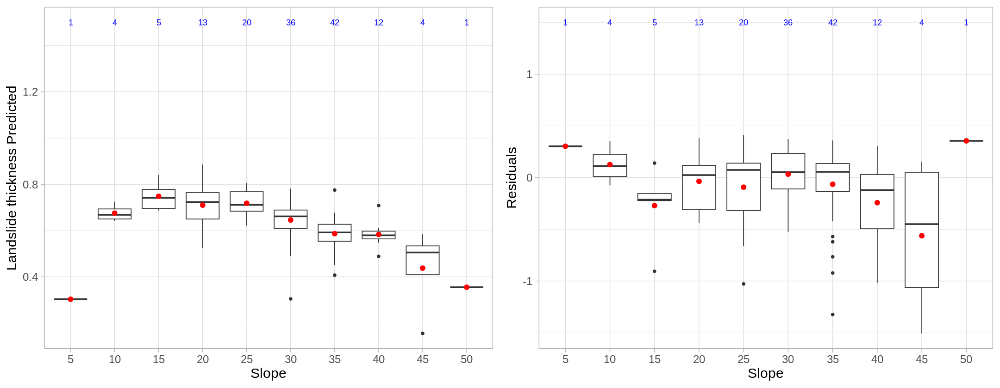

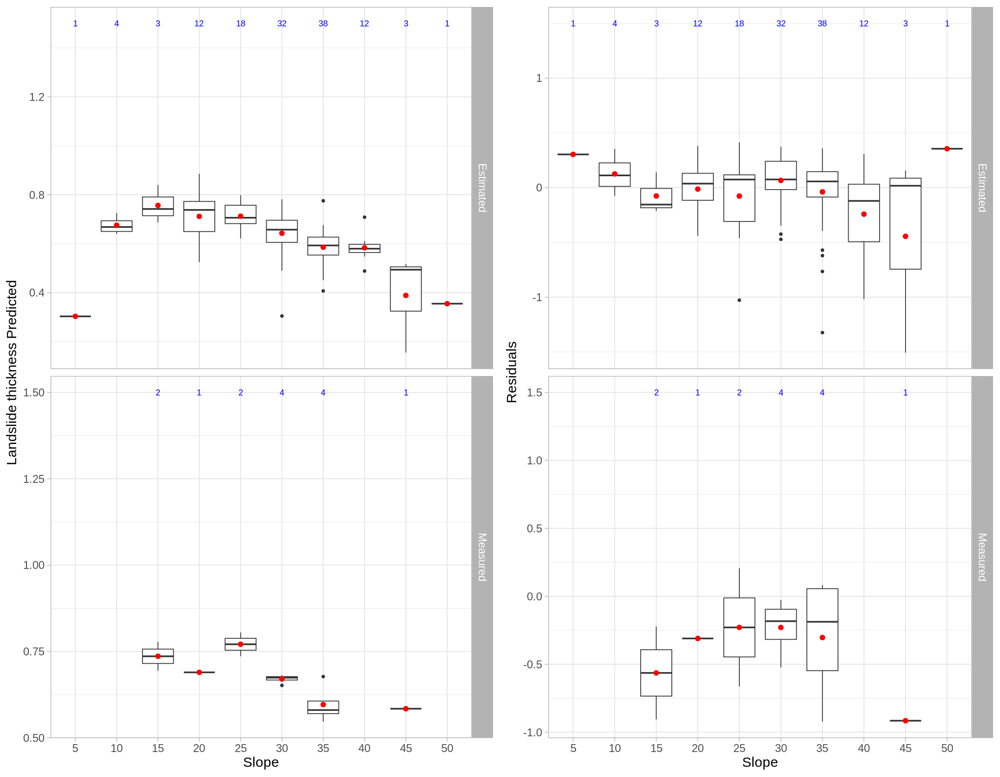

In [179]:
x_columns <- x_cols_manual
y_column <- y_col
method_label <- "LM"
train_label <- "HMDB"
test_label <- "HMDB"

print(paste(method_label,train_label,test_label))
    
set.seed(seed)
lm_model_hmdb <- train(
                y=data_train_hmdb_y, 
                x=data_train_hmdb_x, 
                 method = "lm",
                 trControl = rf.tc.cv,
                 tuneGrid  = lm.tune.grid
)


print(summary(lm_model_hmdb))
print(varImp(lm_model_hmdb))

pred_train_lm_hmdb <- predict(lm_model_hmdb, newdata = data_train_hmdb)

res_train <- score_model(data_train_hmdb_y,pred_train_lm_hmdb,actual_label = y_column,plot=plot)

pred_test_lm_hmdb <- predict(lm_model_hmdb, newdata = data_test_hmdb)
res_test <- score_model(data_test_hmdb_y,pred_test_lm_hmdb,actual_label = y_column,plot=plot)
score_model(data_test_hmdb_y,pred_test_lm_hmdb,actual_label = y_column,plot=plot,facet=data_test_hmdb$Landslide_thickness_MAO)

res.lm.hmdb <- merge_score_results(method_label, train_label, test_label, data_train_hmdb, res_train, data_test_hmdb, res_test) 
res.lm.hmdb

model_box_plot(data_test_hmdb_y,pred_test_lm_hmdb,data_test_hmdb$slope_10,bin_width=5,plot_resid=TRUE)
model_box_plot(data_test_hmdb_y,pred_test_lm_hmdb,data_test_hmdb$slope_10,bin_width=5,plot_resid=TRUE,facet=data_test_hmdb$Landslide_thickness_MAO)

save(lm_model_hmdb, file="lm_model_hmdb.RData")

[1] "Cutoff 100 km"


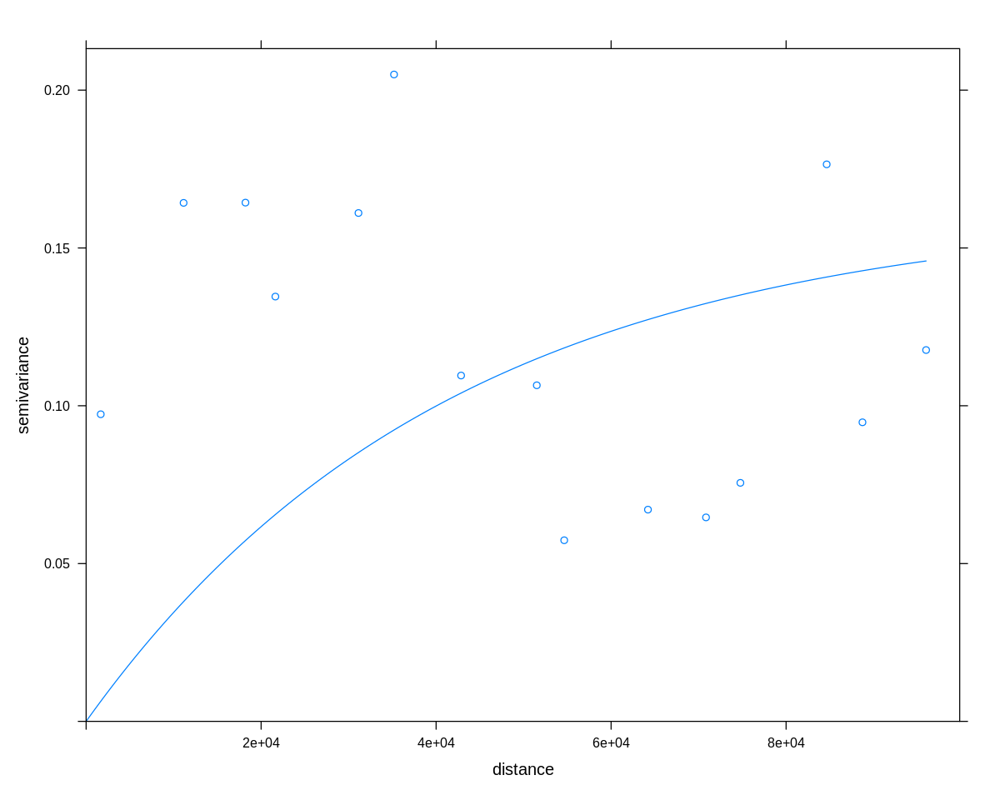


	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = 2.1047, p-value = 0.01766
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
     1.277473e-02     -7.299270e-03      9.097081e-05 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = 0.012775, observed rank = 955, p-value = 0.045
alternative hypothesis: greater


	Geary C test under randomisation

data:  spdf$resid 
weights: spdf.weights 

Geary C statistic standard deviate = 1.9148, p-value = 0.02776
alternative hypothesis: Expectation greater than statistic
sample estimates:
Geary C statistic       Expectation          Variance 
     0.9628528010      1.0000000000      0.0003763803 


	Monte-Carlo simulation of Geary C

data:  spdf$resid 
weights: spdf.weights 
number of simulations + 1: 1000 

statistic = 0.96285, observed rank = 27, p-v

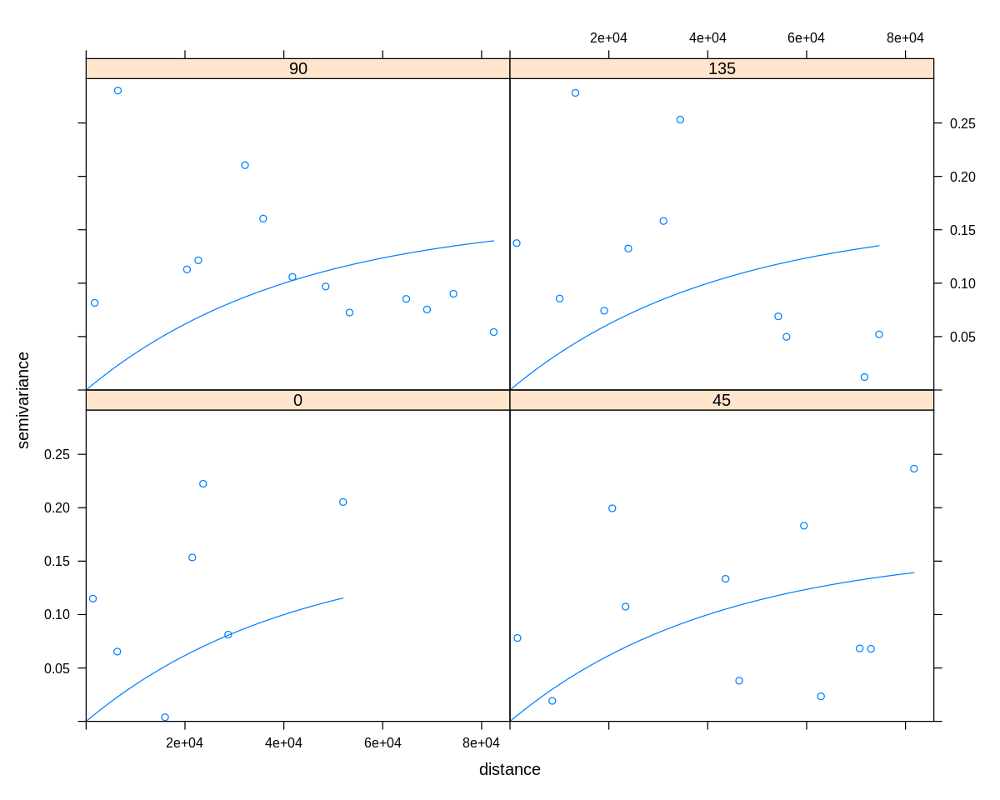

In [180]:
test_autocorrelation(data_test_hmdb.spdf,data_test_hmdb_y,pred_test_lm_hmdb,cutoff=100000,model="Exp")

[1] "LM StorMe StorMe"

Call:
lm(formula = .outcome ~ ., data = dat)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.06857 -0.43851 -0.05683  0.38562  1.71724 

Coefficients:
                         Estimate Std. Error t value Pr(>|t|)   
(Intercept)             8.270e-01  2.923e-01   2.829  0.00471 **
tri_r5_10              -1.014e-02  6.356e-03  -1.596  0.11060   
tri_r5_5               -1.504e-02  1.045e-02  -1.438  0.15044   
tpi_4km_25             -2.036e-06  1.014e-04  -0.020  0.98399   
tpi_500m_25             1.279e-03  8.389e-04   1.525  0.12740   
vhm_max_5               1.407e-03  1.117e-03   1.260  0.20794   
h_5                    -1.847e-04  6.035e-05  -3.061  0.00223 **
vrm_r5_25               1.051e-01  3.050e-01   0.345  0.73032   
mrvbf_10                2.150e-02  1.382e-01   0.156  0.87642   
mrrtf_25                1.669e-01  1.895e-01   0.881  0.37851   
slope_height_25         3.566e-04  1.638e-04   2.177  0.02956 * 
catchment_slope_25      2.255e-0

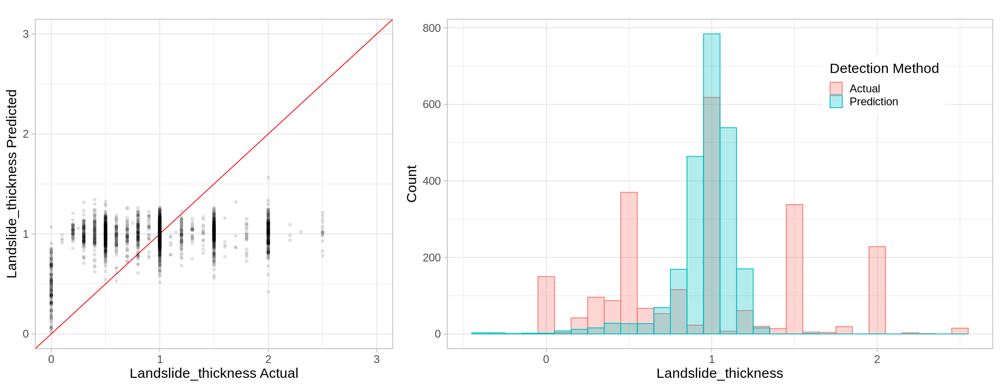

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
LM,StorMe,StorMe,2341,0.4287956,NA,0.5384047,0.529351,0.1165723,-0.4327307,⋯,0.4319608,NA,0.5384047,0.5342857,0.1207023,-0.1293991,1.236068,-0.8821355,1.839206,0.8643799


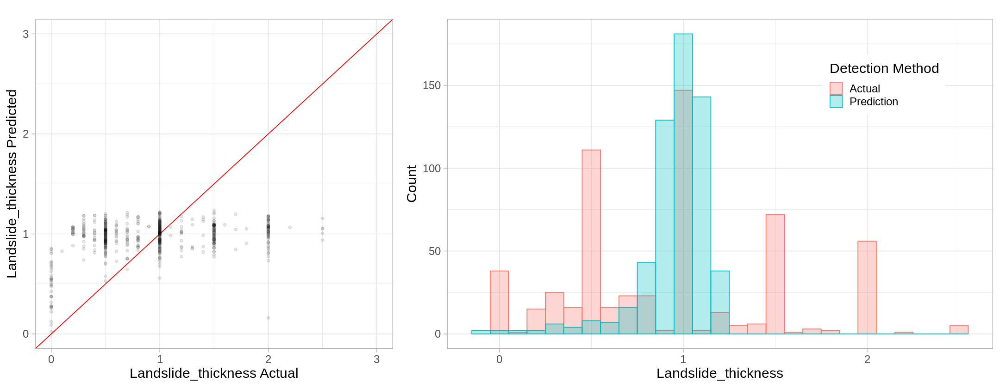

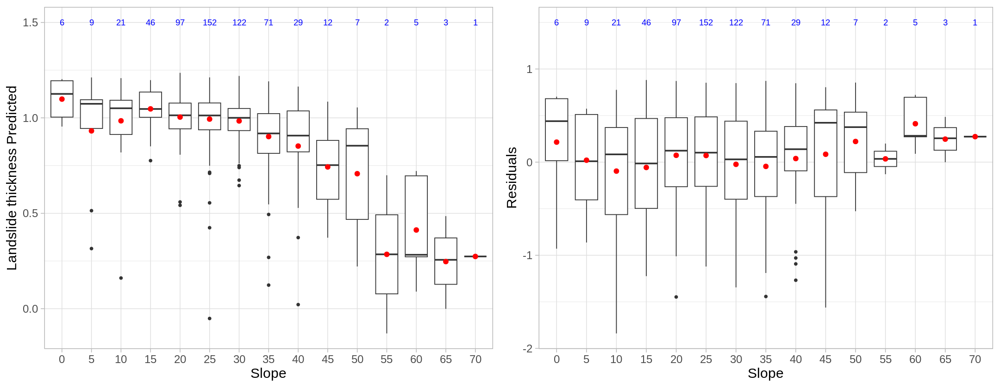

In [181]:
x_columns <- x_cols_manual
y_column <- y_col
method_label <- "LM"
train_label <- "StorMe"
test_label <- "StorMe"

print(paste(method_label,train_label,test_label))
    
set.seed(seed)
lm_model_storme <- train(
                 y=data_train_storme_y, 
                 x=data_train_storme_x, 
                 method = "lm",
                 trControl = rf.tc.cv,
                 tuneGrid  = lm.tune.grid
            )

print(summary(lm_model_storme))
print(varImp(lm_model_storme))

pred_train_lm_storme <- predict(lm_model_storme, newdata = data_train_storme)

res_train <- score_model(data_train_storme_y,pred_train_lm_storme,actual_label = y_column,plot=plot)

pred_test_lm_storme <- predict(lm_model_storme, newdata = data_test_storme)
res_test <- score_model(data_test_storme_y,pred_test_lm_storme,actual_label = y_column,plot=plot)

res.lm.storme <- merge_score_results(method_label, train_label, test_label, data_train_storme, res_train, data_test_storme, res_test) 
res.lm.storme

model_box_plot(data_test_storme_y,pred_test_lm_storme,data_test_storme$slope_10,bin_width=5,plot_resid=TRUE)


[1] "Cutoff 100 km"


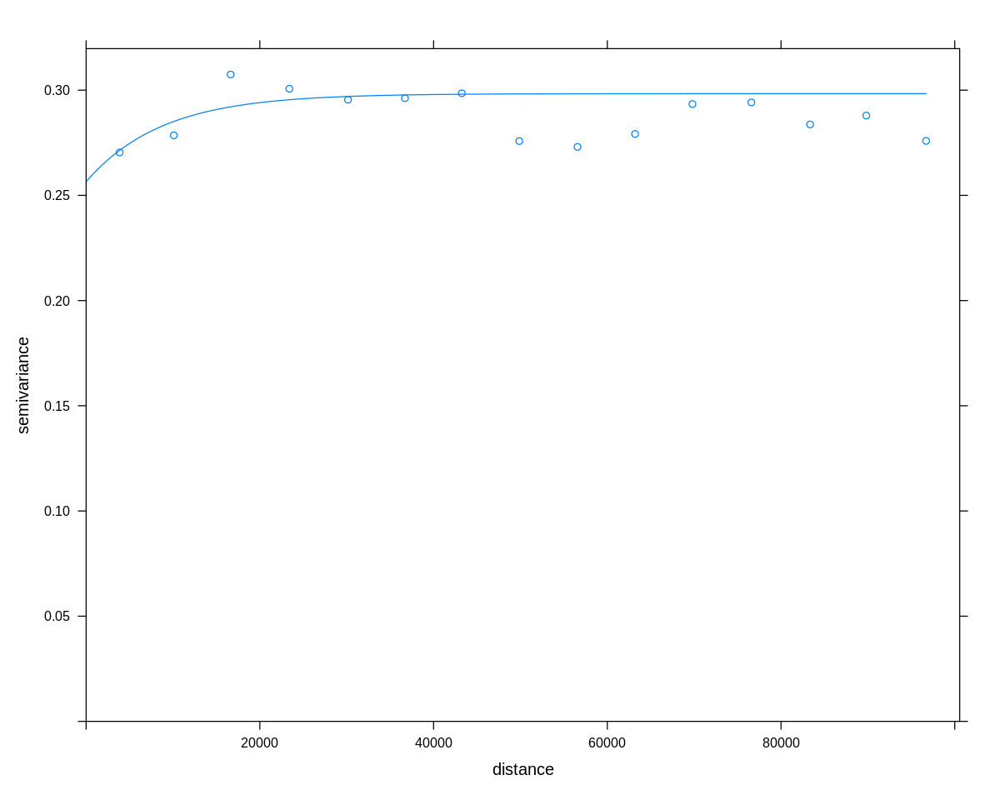


	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = -0.42478, p-value = 0.6645
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
    -2.332357e-03     -1.718213e-03      2.090324e-06 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = -0.0023324, observed rank = 361, p-value = 0.639
alternative hypothesis: greater


	Geary C test under randomisation

data:  spdf$resid 
weights: spdf.weights 

Geary C statistic standard deviate = -1.4823, p-value = 0.9309
alternative hypothesis: Expectation greater than statistic
sample estimates:
Geary C statistic       Expectation          Variance 
     1.007436e+00      1.000000e+00      2.516909e-05 


	Monte-Carlo simulation of Geary C

data:  spdf$resid 
weights: spdf.weights 
number of simulations + 1: 1000 

statistic = 1.0074, observed rank = 941, 

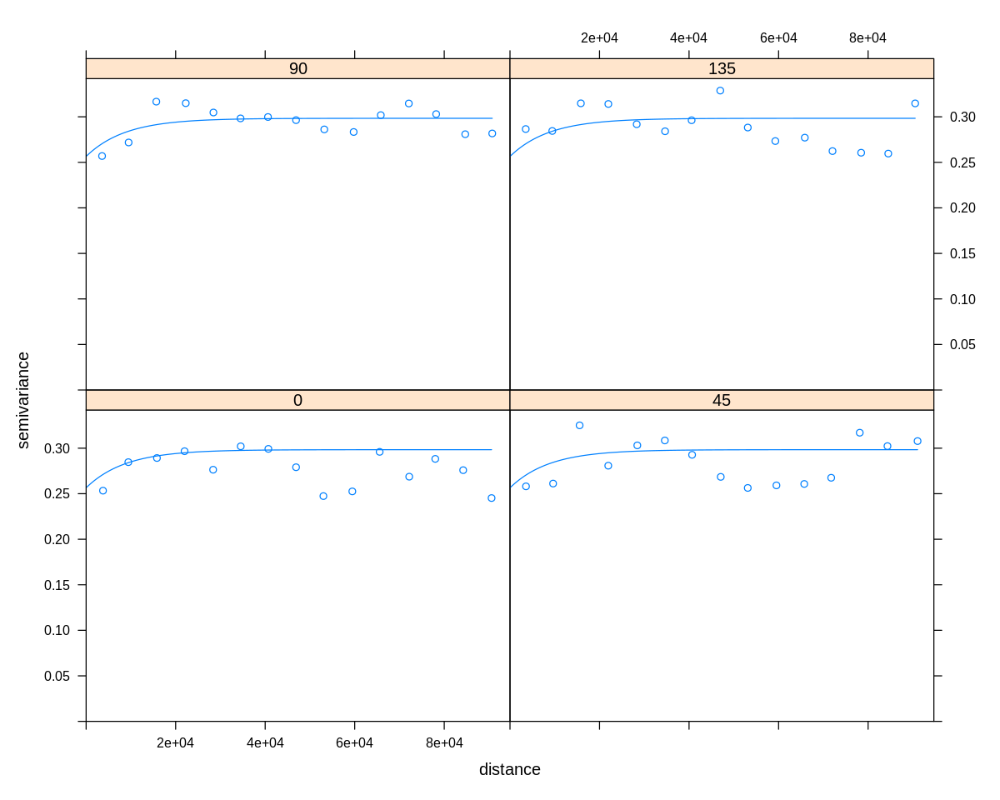

In [182]:
test_autocorrelation(data_test_storme.spdf,data_test_storme_y,pred_test_lm_storme,cutoff=100000,model="Exp")

[1] "LM BE BE"

Call:
lm(formula = .outcome ~ ., data = dat)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.62110 -0.18624 -0.06548  0.11765  1.57926 

Coefficients:
                         Estimate Std. Error t value Pr(>|t|)    
(Intercept)            -1.777e-02  4.457e-01  -0.040 0.968210    
tri_r5_10              -1.575e-02  8.856e-03  -1.779 0.075949 .  
tri_r5_5                1.901e-02  1.712e-02   1.111 0.267334    
tpi_4km_25             -3.457e-04  1.523e-04  -2.270 0.023692 *  
tpi_500m_25            -3.259e-04  1.378e-03  -0.236 0.813172    
vhm_max_5               4.340e-03  2.718e-03   1.597 0.111043    
h_5                    -2.858e-04  8.335e-05  -3.429 0.000663 ***
vrm_r5_25               3.816e-01  3.831e-01   0.996 0.319732    
mrvbf_10               -8.027e-01  4.701e-01  -1.707 0.088451 .  
mrrtf_25                1.980e+00  6.127e-01   3.233 0.001320 ** 
slope_height_25         2.647e-04  2.265e-04   1.169 0.243093    
catchment_slope_25     -3.12

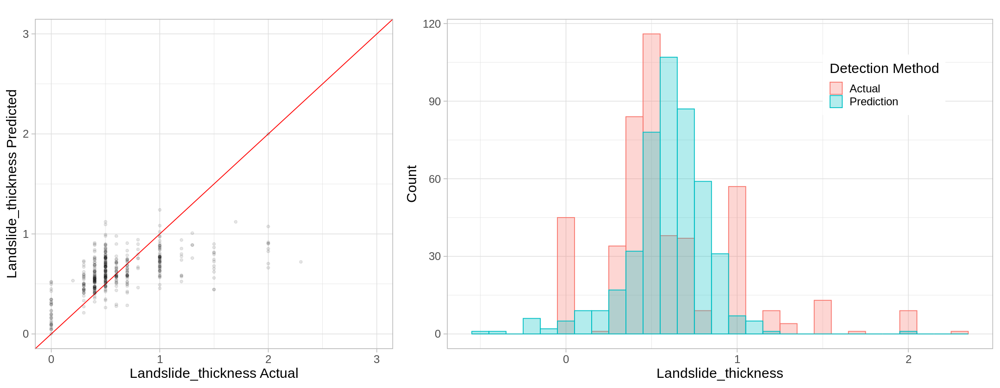

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
LM,BE,BE,458,0.2244116,NA,0.4874195,0.3140241,0.366098,-0.4627733,⋯,0.2176749,NA,0.4874195,0.327464,0.3379606,-0.2848187,0.9841139,-0.5360794,1.58461,0.4292501


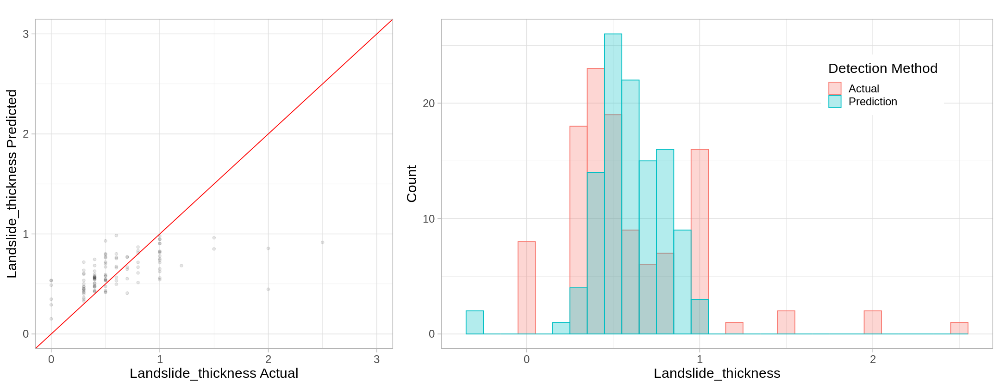

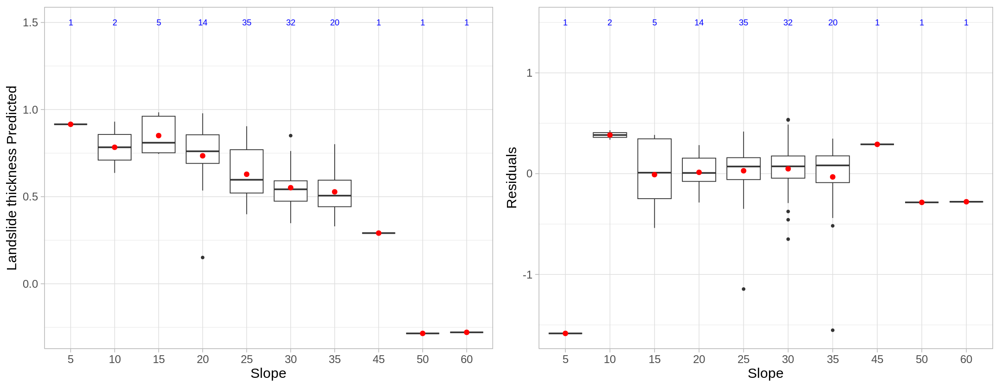

In [183]:
x_columns <- x_cols_manual
y_column <- y_col
method_label <- "LM"
train_label <- "BE"
test_label <- "BE"

print(paste(method_label,train_label,test_label))

set.seed(seed)
lm_model_be <- train(
                 y=data_train_be_y, 
                 x=data_train_be_x, 
                 method = "lm",
                 trControl = rf.tc.cv,
                 tuneGrid  = lm.tune.grid
            )

print(summary(lm_model_be))
print(varImp(lm_model_be))

pred_train_lm_be <- predict(lm_model_be, newdata = data_train_be)

res_train <- score_model(data_train_be_y,pred_train_lm_be,actual_label = y_column,plot=plot)

pred_test_lm_be <- predict(lm_model_be, newdata = data_test_be)
res_test <- score_model(data_test_be_y,pred_test_lm_be,actual_label = y_column,plot=plot)

res.lm.be <- merge_score_results(method_label, train_label, test_label, data_train_be, res_train, data_test_be, res_test) 
res.lm.be

model_box_plot(data_test_be_y,pred_test_lm_be,data_test_be$slope_10,bin_width=5,plot_resid=TRUE)


save(lm_model_be, file="lm_model_be.RData")

[1] "Cutoff 100 km"


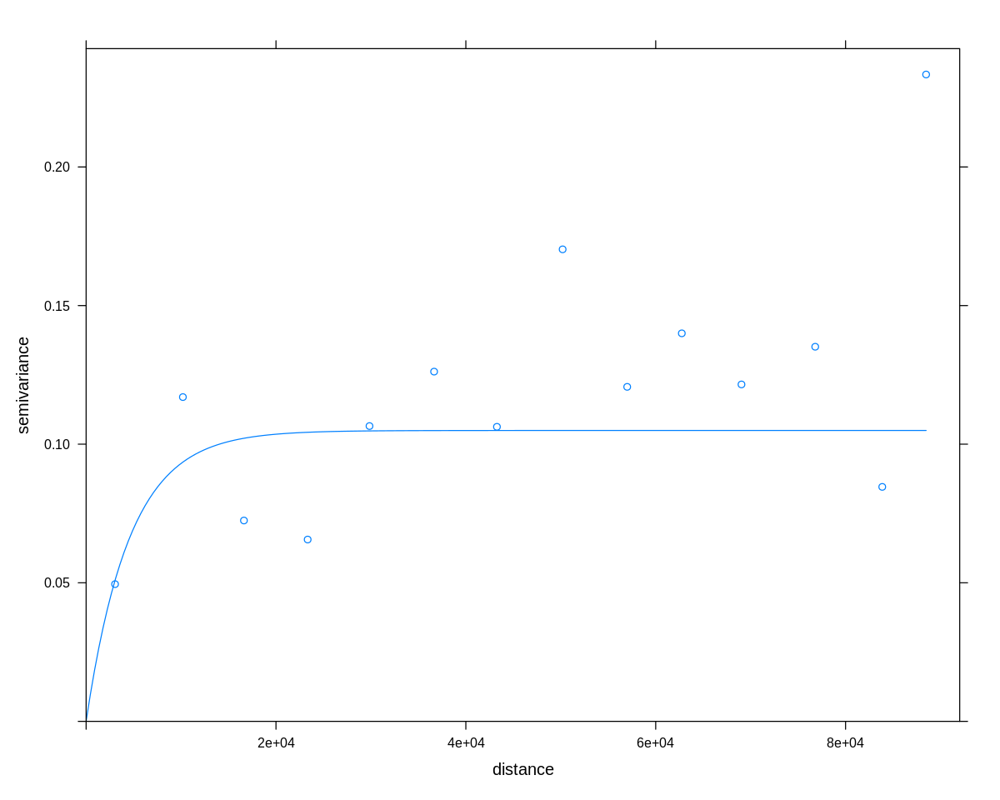


	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = NaN, p-value = NA
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
    -9.009009e-03     -9.009009e-03     -5.927875e-17 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = -0.009009, observed rank = 400.5, p-value = 0.5995
alternative hypothesis: greater


	Geary C test under randomisation

data:  spdf$resid 
weights: spdf.weights 

Geary C statistic standard deviate = 0, p-value = 0.5
alternative hypothesis: Expectation greater than statistic
sample estimates:
Geary C statistic       Expectation          Variance 
     1.000000e+00      1.000000e+00      1.132288e-16 


	Monte-Carlo simulation of Geary C

data:  spdf$resid 
weights: spdf.weights 
number of simulations + 1: 1000 

statistic = 1, observed rank = 502.5, p-value = 0.5025
al

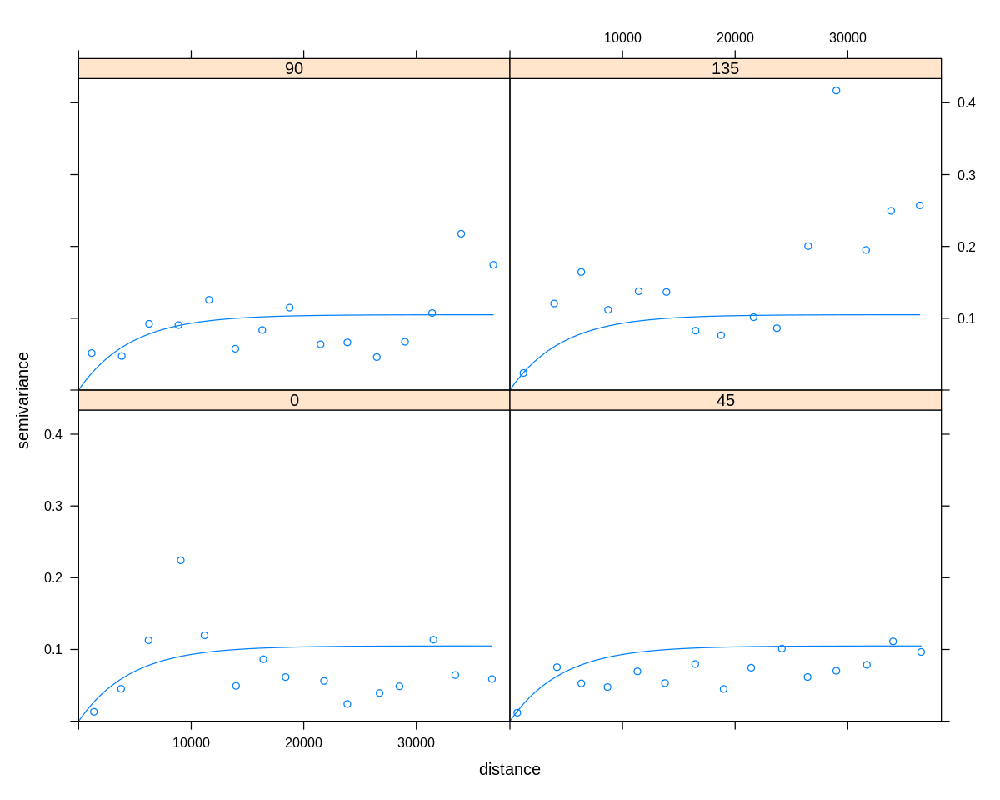

In [184]:
test_autocorrelation(data_test_be.spdf,data_test_be_y,pred_test_lm_be,cutoff=100000,model="Exp")

[1] "LM BE HMDB"


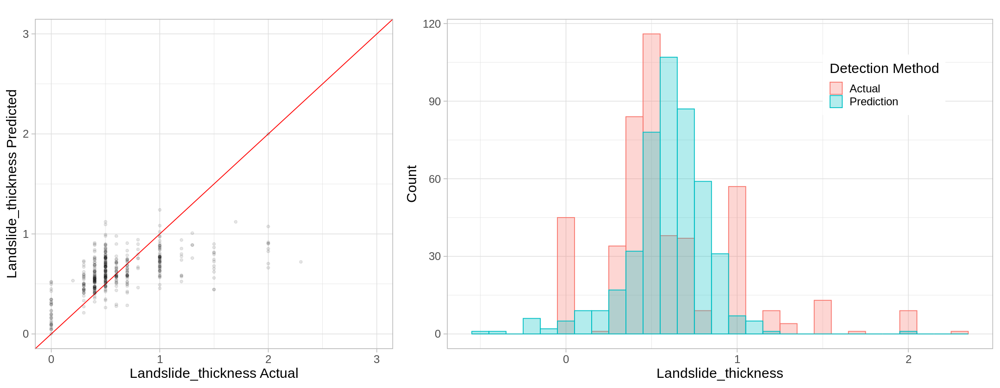

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
LM,BE,HMDB,458,0.2244116,NA,0.4874195,0.3140241,0.366098,-0.4627733,⋯,0.2604801,NA,0.4874195,0.4182157,0.0264878,-0.4286013,4.794553,-4.094553,1.675419,0.5099538


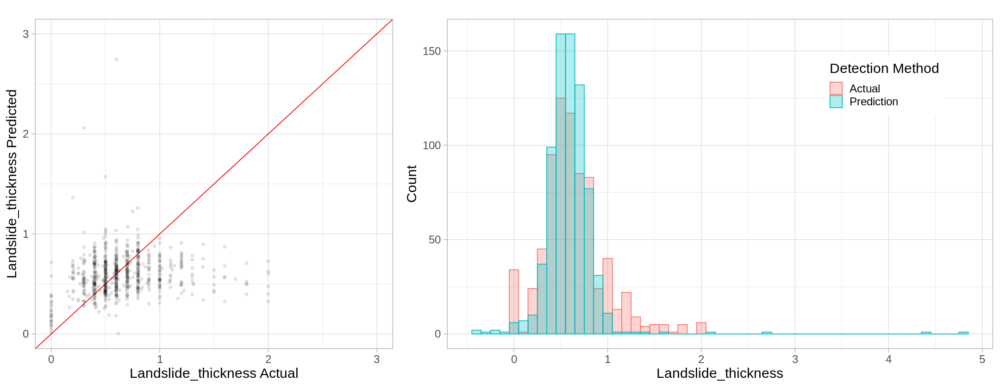

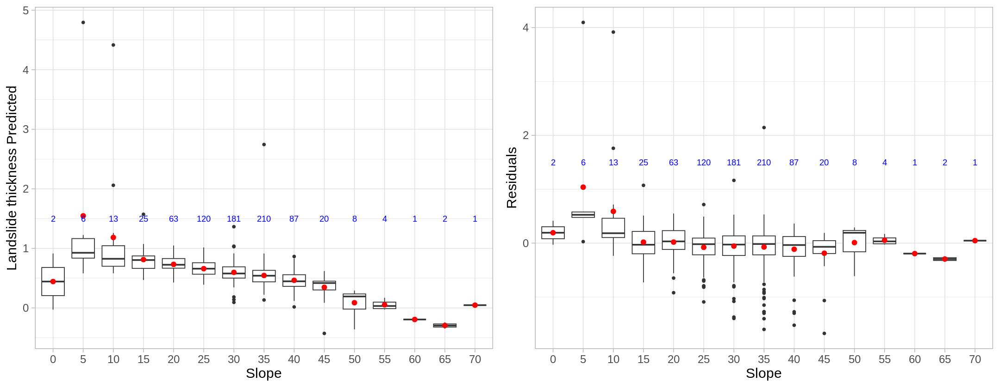

In [185]:
x_columns <- x_cols_manual
y_column <- y_col
method_label <- "LM"
train_label <- "BE"
test_label <- "HMDB"

print(paste(method_label,train_label,test_label))

pred_train_lm_be_hmdb <- predict(lm_model_be, newdata = data_train_be_hmdb)
res_train <- score_model(data_train_be_hmdb_y,pred_train_lm_be_hmdb,actual_label = y_column,plot=plot)

pred_test_lm_be_hmdb <- predict(lm_model_be, newdata = data_test_be_hmdb)
res_test <- score_model(data_test_be_hmdb_y,pred_test_lm_be_hmdb,actual_label = y_column,plot=plot)


res.lm.be_hmdb <- merge_score_results(method_label, train_label, test_label, data_train_be_hmdb, res_train, data_test_be_hmdb, res_test) 
res.lm.be_hmdb

model_box_plot(data_test_be_hmdb_y,pred_test_lm_be_hmdb,data_test_be_hmdb$slope_10,bin_width=5,plot_resid=TRUE)


[1] "Cutoff 100 km"


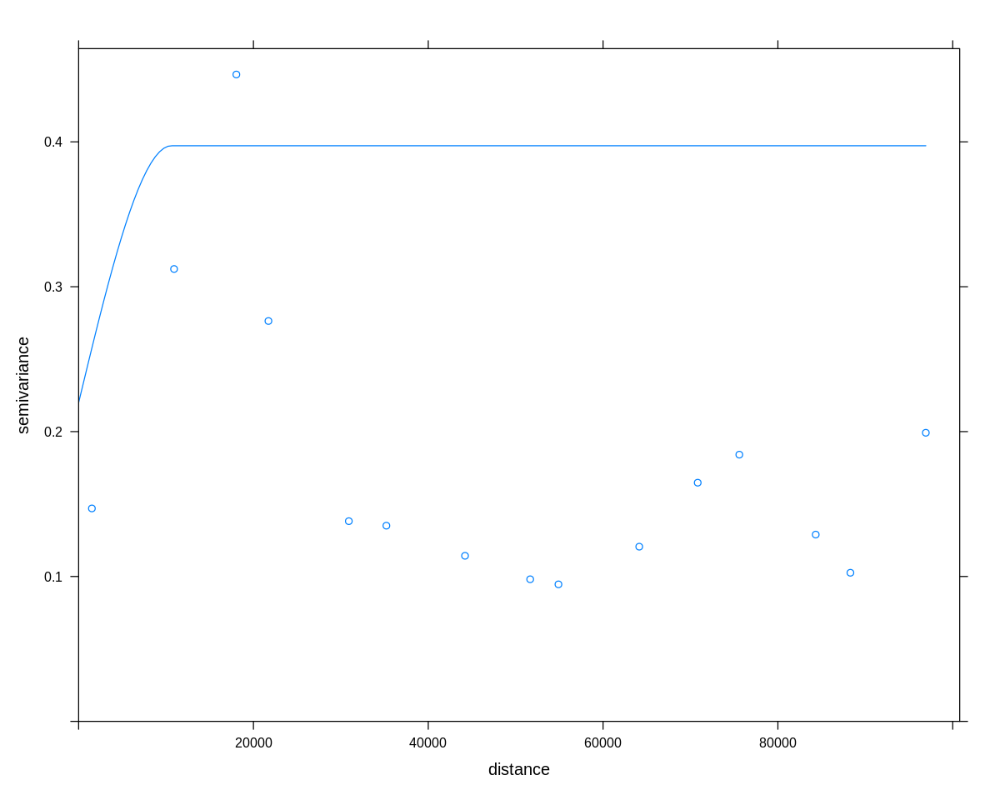


	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = 1.8282, p-value = 0.03376
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
     1.503620e-03     -1.347709e-03      2.432369e-06 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = 0.0015036, observed rank = 925, p-value = 0.075
alternative hypothesis: greater


	Geary C test under randomisation

data:  spdf$resid 
weights: spdf.weights 

Geary C statistic standard deviate = 0.54474, p-value = 0.293
alternative hypothesis: Expectation greater than statistic
sample estimates:
Geary C statistic       Expectation          Variance 
     0.9885891767      1.0000000000      0.0004387932 


	Monte-Carlo simulation of Geary C

data:  spdf$resid 
weights: spdf.weights 
number of simulations + 1: 1000 

statistic = 0.98859, observed rank = 274, p-

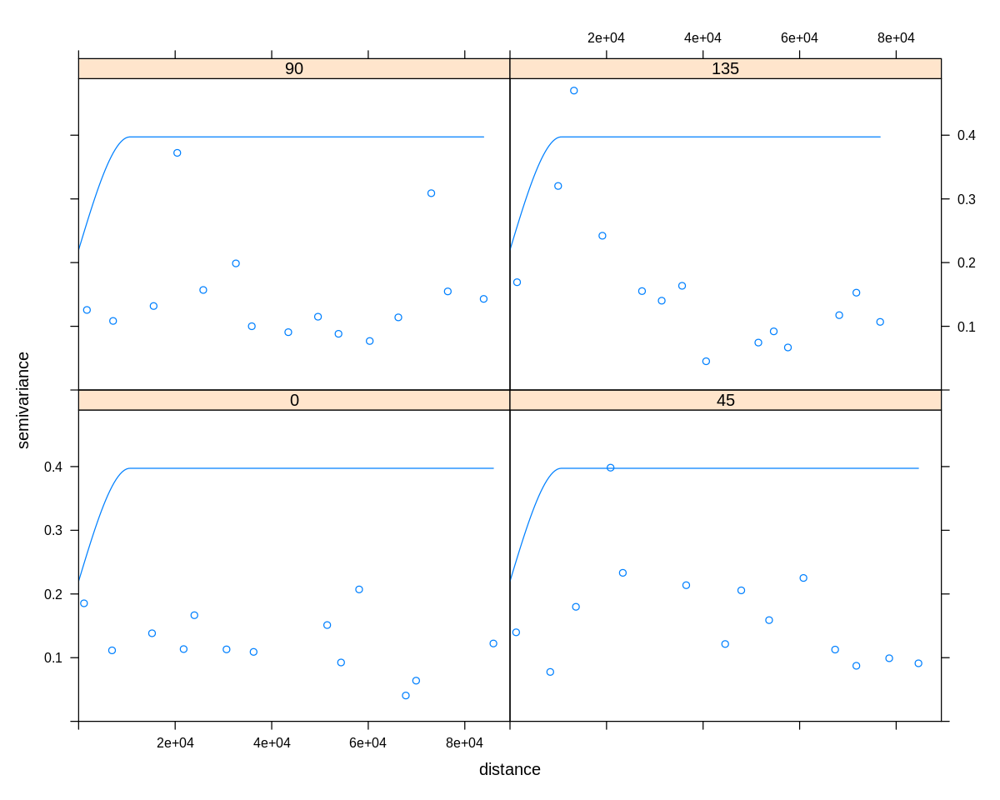

In [186]:
test_autocorrelation(data_test_be_hmdb.spdf,data_test_be_hmdb_y,pred_test_lm_be_hmdb,cutoff=100000)


[1] "LM HMDB BE"


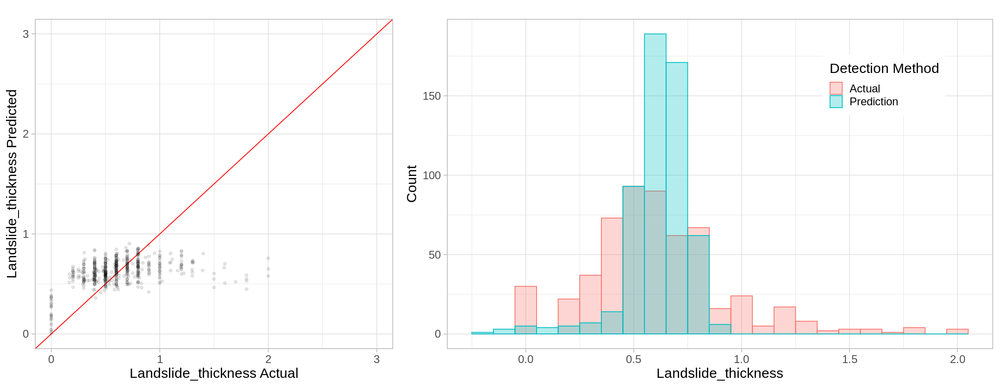

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
LM,HMDB,BE,560,0.2102958,NA,0.413874,0.2962727,0.1903138,-0.223697,⋯,0.2703072,NA,0.413874,0.3634233,0.1656192,-0.4465493,0.9332682,-0.6759994,2.011352,0.4637228


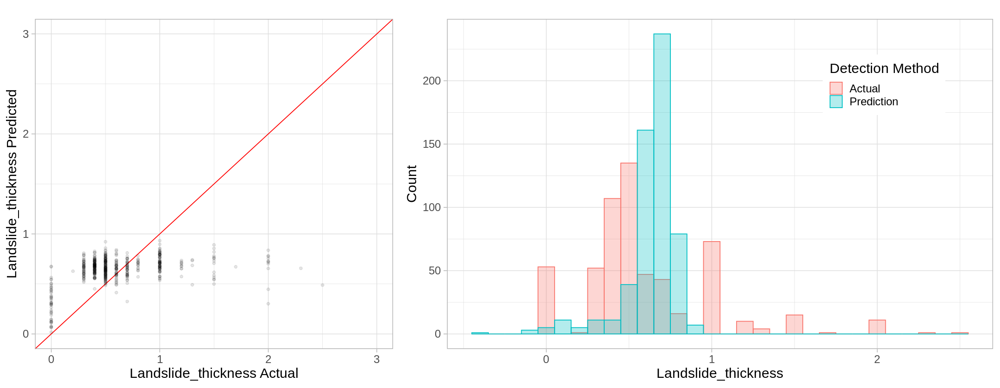

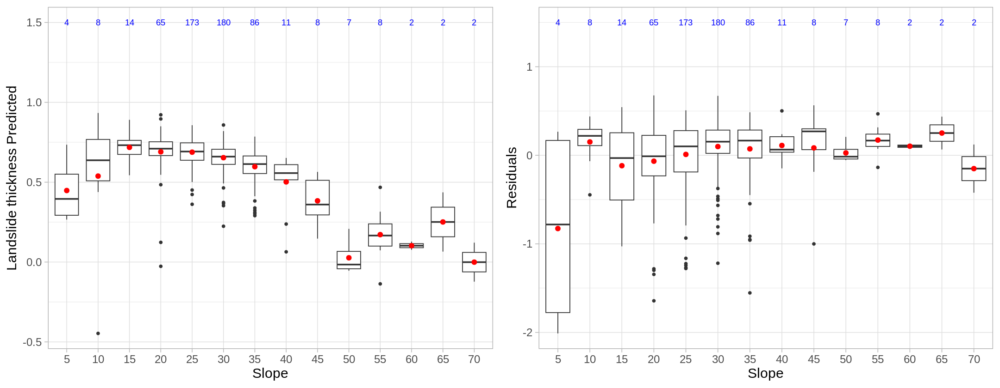

In [187]:
x_columns <- x_cols_manual
y_column <- y_col
method_label <- "LM"
train_label <- "HMDB"
test_label <- "BE"

print(paste(method_label,train_label,test_label))

pred_train_lm_hmdb_be <- predict(lm_model_hmdb, newdata = data_train_hmdb_be)
res_train <- score_model(data_train_hmdb_be_y,pred_train_lm_hmdb_be,actual_label = y_column,plot=plot)

pred_test_lm_hmdb_be <- predict(lm_model_hmdb, newdata = data_test_hmdb_be)
res_test <- score_model(data_test_hmdb_be_y,pred_test_lm_hmdb_be,actual_label = y_column,plot=plot)


res.lm.hmdb_be <- merge_score_results(method_label, train_label, test_label, data_train_hmdb_be, res_train, data_test_hmdb_be, res_test) 
res.lm.hmdb_be

model_box_plot(data_test_hmdb_be_y,pred_test_lm_hmdb_be,data_test_hmdb_be$slope_10,bin_width=5,plot_resid=TRUE)


[1] "Cutoff 100 km"


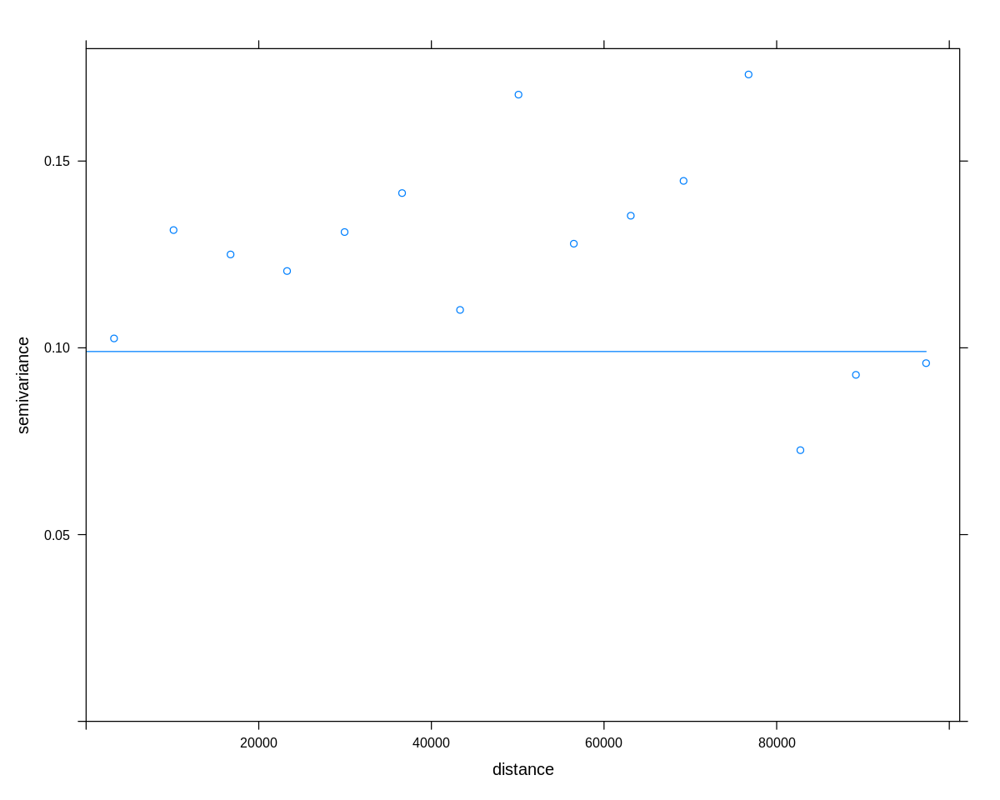


	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = -0.14992, p-value = 0.5596
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
    -1.759723e-03     -1.757469e-03      2.259760e-10 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = -0.0017597, observed rank = 332, p-value = 0.668
alternative hypothesis: greater


	Geary C test under randomisation

data:  spdf$resid 
weights: spdf.weights 

Geary C statistic standard deviate = -0.47766, p-value = 0.6836
alternative hypothesis: Expectation greater than statistic
sample estimates:
Geary C statistic       Expectation          Variance 
     1.000015e+00      1.000000e+00      9.732124e-10 


	Monte-Carlo simulation of Geary C

data:  spdf$resid 
weights: spdf.weights 
number of simulations + 1: 1000 

statistic = 1, observed rank = 730, p-va

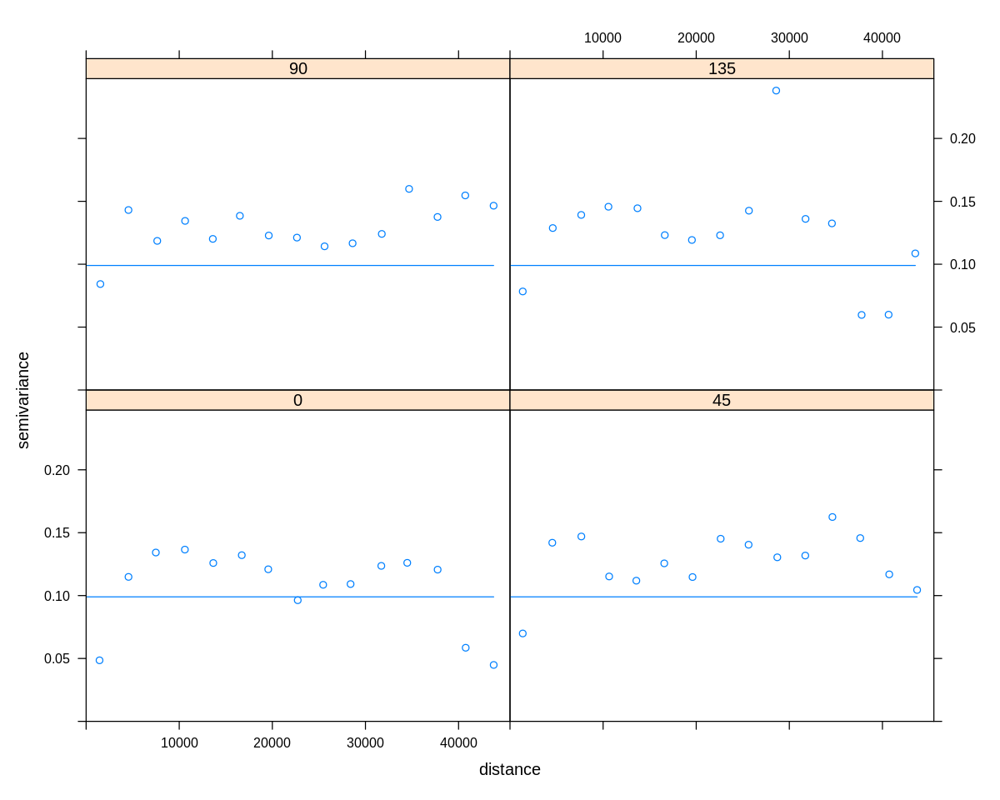

In [188]:
test_autocorrelation(data_test_hmdb_be.spdf,data_test_hmdb_be_y,pred_test_lm_hmdb_be,cutoff=100000)


[1] "LM HMDB StorMe"


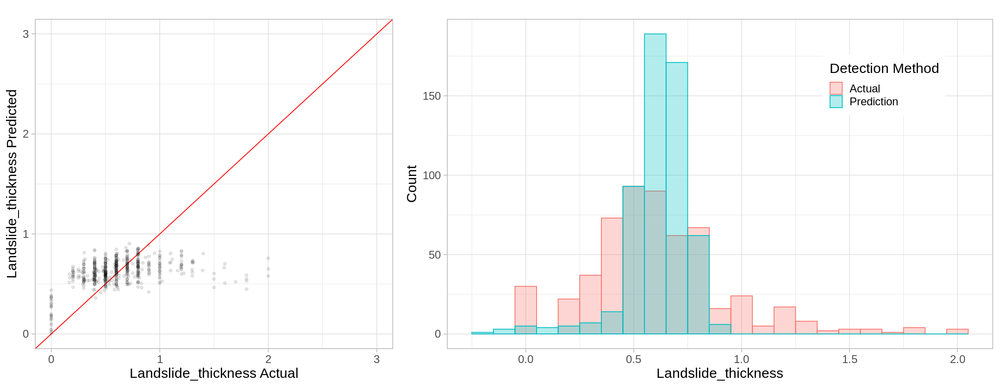

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
LM,HMDB,StorMe,560,0.2102958,NA,0.413874,0.2962727,0.1903138,-0.223697,⋯,0.492656,NA,0.413874,0.6377085,0.05497197,-2.922874,0.9799711,-0.7223885,4.922874,1.205344


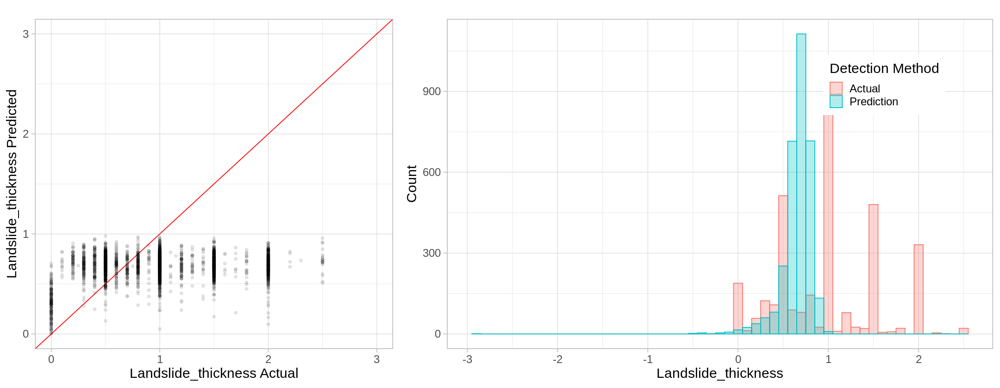

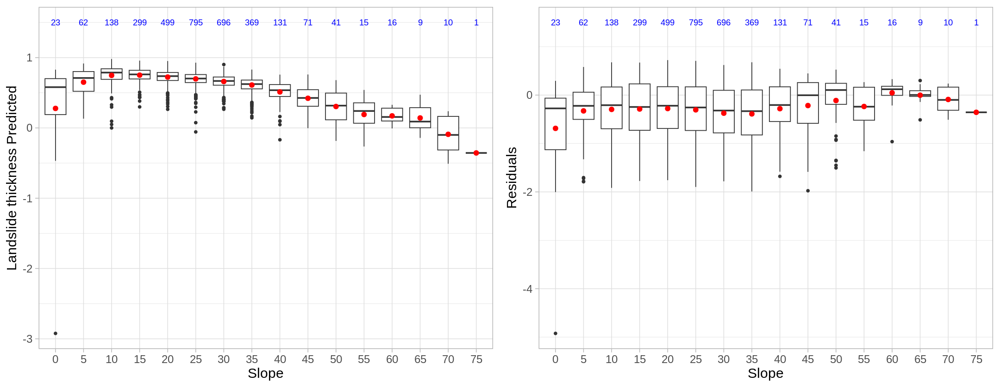

In [189]:
x_columns <- x_cols_manual
y_column <- y_col
method_label <- "LM"
train_label <- "HMDB"
test_label <- "StorMe"

print(paste(method_label,train_label,test_label))

pred_train_lm_hmdb_storme <- predict(lm_model_hmdb, newdata = data_train_hmdb_storme)
res_train <- score_model(data_train_hmdb_storme_y,pred_train_lm_hmdb_storme,actual_label = y_column,plot=plot)

pred_test_lm_hmdb_storme <- predict(lm_model_hmdb, newdata = data_test_hmdb_storme)
res_test <- score_model(data_test_hmdb_storme_y,pred_test_lm_hmdb_storme,actual_label = y_column,plot=plot)

res.lm.hmdb_storme <- merge_score_results(method_label, train_label, test_label, data_train_hmdb_storme, res_train, data_test_hmdb_storme, res_test) 
res.lm.hmdb_storme

model_box_plot(data_test_hmdb_storme_y,pred_test_lm_hmdb_storme,data_test_hmdb_storme$slope_10,bin_width=5,plot_resid=TRUE)


[1] "Cutoff 100 km"


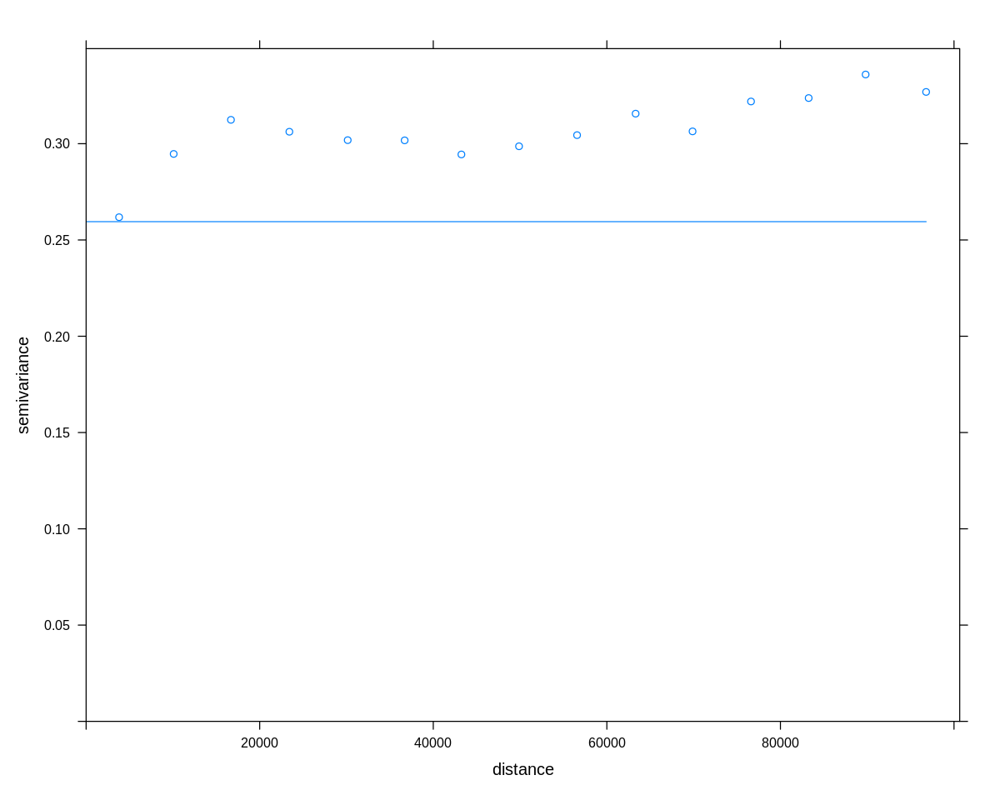


	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = 5.5439, p-value = 1.479e-08
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
     1.204746e-03     -3.150599e-04      7.515312e-08 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = 0.0012047, observed rank = 1000, p-value = 0.001
alternative hypothesis: greater


	Geary C test under randomisation

data:  spdf$resid 
weights: spdf.weights 

Geary C statistic standard deviate = -0.026992, p-value = 0.5108
alternative hypothesis: Expectation greater than statistic
sample estimates:
Geary C statistic       Expectation          Variance 
     1.000069e+00      1.000000e+00      6.442388e-06 


	Monte-Carlo simulation of Geary C

data:  spdf$resid 
weights: spdf.weights 
number of simulations + 1: 1000 

statistic = 1.0001, observed rank = 47

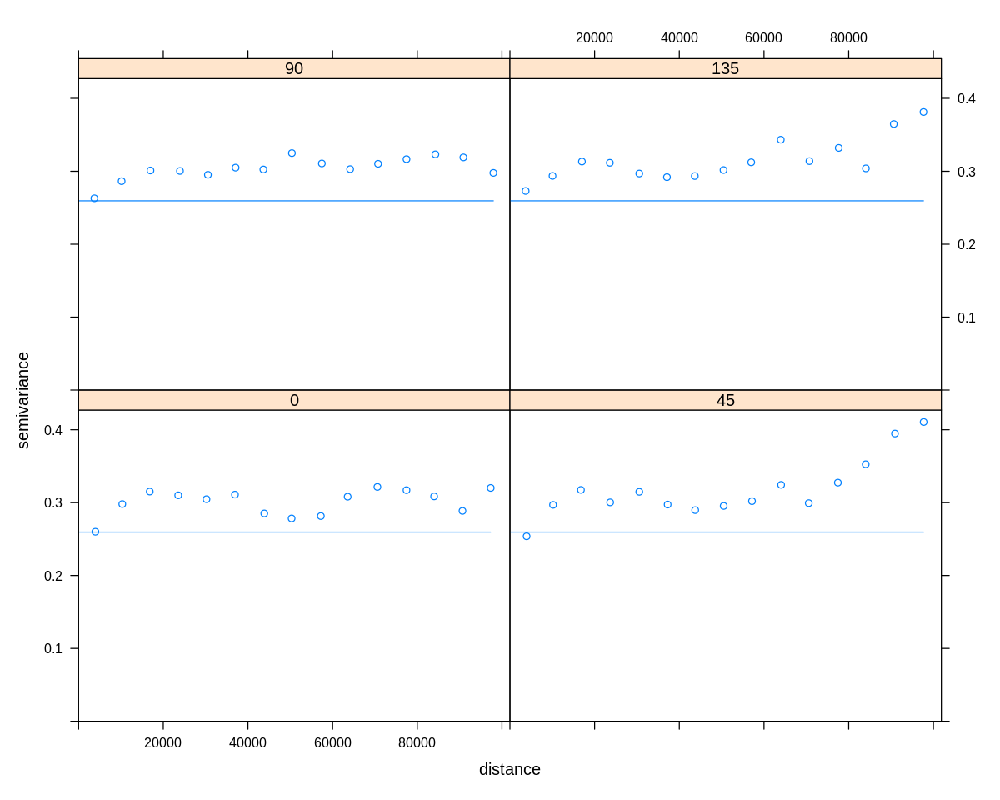

In [190]:
test_autocorrelation(data_test_hmdb_storme.spdf,data_test_hmdb_storme_y,pred_test_lm_hmdb_storme,cutoff=100000)


<a id="Paper_Model_Simple_Models"></a>
### Simple Models

Simple models for predicting the soil depth based on elevation and slope proposed by Saulnier et.al. (1997) as specified in Catani et.al. (2010). It must me noted that these models are intended for a more localized context with less variation than in our reference data.

In [191]:
#Z-model 
h_z <- function(z_i,z_max,z_min,h_max,h_min) {
    return(h_max-((z_i-z_min)/(z_max-z_min))*(h_max-h_min))
}

#S-model
h_s <- function(s_i,s_max,s_min,h_max,h_min) {
    return(h_max-((s_i-s_min)/(s_max-s_min))*(1-(h_min/h_max)))
}
 

In [192]:
train_h_z_cv <- function(data_train, n_folds=10, seed = 0 ){
    
    set.seed(seed)
    
    folds <- createFolds(data_train$Landslide_thickness, k=n_folds)

    models <- NA
    res <- NA
    for(i in 1:n_folds) {
        data_trn <- data_train[-folds[[i]],]
        data_tst <- data_train[folds[[i]],]
        
        data_trn <- data_trn[!is.na(data_trn$Landslide_thickness),]
        data_tst <- data_tst[!is.na(data_tst$Landslide_thickness),]        
        
        h_z_m <- purrr::partial(h_z,z_max=max(data_trn$h_5,na.rm=TRUE),z_min=min(data_trn$h_5,na.rm=TRUE),h_max=max(data_trn$Landslide_thickness,na.rm=TRUE),h_min=min(data_trn$Landslide_thickness,na.rm=TRUE))
        models <- rbind(models,list(h_z_m))

        pred_tst_h_z_m <- h_z_m(data_tst$h_5)
        res_tst <- score_model(data_tst$Landslide_thickness,pred_tst_h_z_m,actual_label="",plot=FALSE)
        res <- rbind(res,res_tst)
    }
    
    best_i <- which.min(res$mae)
        
    return(models[[best_i]])
}

train_h_s_cv <- function(data_train, n_folds=10, seed = 0 ){
    
    set.seed(seed)
    
    folds <- createFolds(data_train$Landslide_thickness, k=n_folds)

    models <- NA
    res <- NA
    for(i in 1:n_folds) {
        data_trn <- data_train[-folds[[i]],]
        data_tst <- data_train[folds[[i]],]
        
        data_trn <- data_trn[!is.na(data_trn$Landslide_thickness),]
        data_tst <- data_tst[!is.na(data_tst$Landslide_thickness),]     
        
        h_s_m <- purrr::partial(h_s,s_max=max(data_trn$slope_10,na.rm=TRUE),s_min=min(data_trn$slope_10,na.rm=TRUE),h_max=max(data_trn$Landslide_thickness,na.rm=TRUE),h_min=min(data_trn$Landslide_thickness,na.rm=TRUE))

        models <- rbind(models,list(h_s_m))

        pred_tst_h_s_m <- h_s_m(data_tst$slope_10)
        res_tst <- score_model(data_tst$Landslide_thickness,pred_tst_h_s_m,actual_label="",plot=FALSE)
        res <- rbind(res,res_tst)
    }
    
    best_i <- which.min(res$mae)
    
    return(models[[best_i]])
}

In [193]:
h_z_hmdb <- purrr::partial(h_z,z_max=max(data_train_hmdb$h_5,na.rm=TRUE),z_min=min(data_train_hmdb$h_5,na.rm=TRUE),h_max=max(data_train_hmdb$Landslide_thickness,na.rm=TRUE),h_min=min(data_train_hmdb$Landslide_thickness,na.rm=TRUE))
h_s_hmdb <- purrr::partial(h_s,s_max=max(data_train_hmdb$slope_10,na.rm=TRUE),s_min=min(data_train_hmdb$slope_10,na.rm=TRUE),h_max=max(data_train_hmdb$Landslide_thickness,na.rm=TRUE),h_min=min(data_train_hmdb$Landslide_thickness,na.rm=TRUE))

h_z_storme <- purrr::partial(h_z,z_max=max(data_train_storme$h_5,na.rm=TRUE),z_min=min(data_train_storme$h_5,na.rm=TRUE),h_max=max(data_train_storme$Landslide_thickness,na.rm=TRUE),h_min=min(data_train_storme$Landslide_thickness,na.rm=TRUE))
h_s_storme <- purrr::partial(h_s,s_max=max(data_train_storme$slope_10,na.rm=TRUE),s_min=min(data_train_storme$slope_10,na.rm=TRUE),h_max=max(data_train_storme$Landslide_thickness,na.rm=TRUE),h_min=min(data_train_storme$Landslide_thickness,na.rm=TRUE))

h_z_be <- purrr::partial(h_z,z_max=max(data_train_be$h_5,na.rm=TRUE),z_min=min(data_train_be$h_5,na.rm=TRUE),h_max=max(data_train_be$Landslide_thickness,na.rm=TRUE),h_min=min(data_train_be$Landslide_thickness,na.rm=TRUE))
h_s_be <- purrr::partial(h_s,s_max=max(data_train_be$slope_10,na.rm=TRUE),s_min=min(data_train_be$slope_10,na.rm=TRUE),h_max=max(data_train_be$Landslide_thickness,na.rm=TRUE),h_min=min(data_train_be$Landslide_thickness,na.rm=TRUE))


In [194]:
h_z_hmdb <- train_h_z_cv(data_train=data_train_hmdb, n_folds=10, seed = seed) 
h_s_hmdb <- train_h_s_cv(data_train=data_train_hmdb, n_folds=10, seed = seed)  

h_z_storme <- train_h_z_cv(data_train=data_train_storme, n_folds=10, seed = seed) 
h_s_storme <- train_h_s_cv(data_train=data_train_storme, n_folds=10, seed = seed) 

h_z_be <- train_h_z_cv(data_train=data_train_be, n_folds=10, seed = seed) 
h_s_be <- train_h_s_cv(data_train=data_train_be, n_folds=10, seed = seed) 

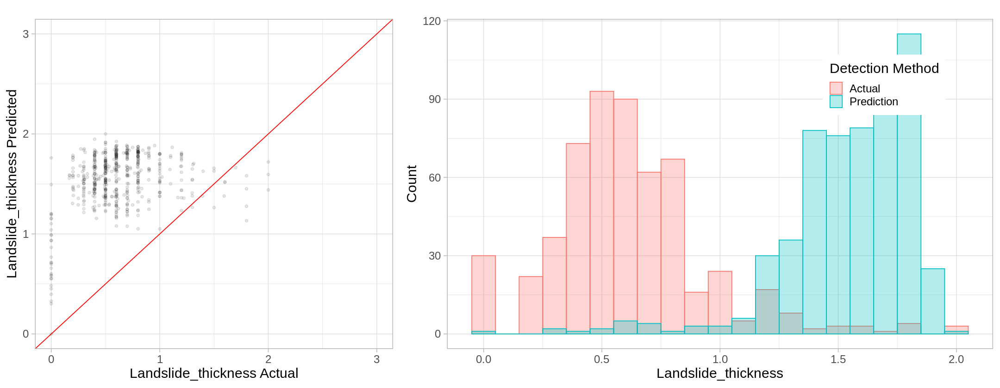

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Simple-Z,HMDB,HMDB,560,0.9444475,NA,NaN,0.9977073,0.09017431,0,⋯,0.8744218,NA,NaN,0.9392362,0.08881824,0.5010624,2.006618,-1.463341,0.4214198,1.314967


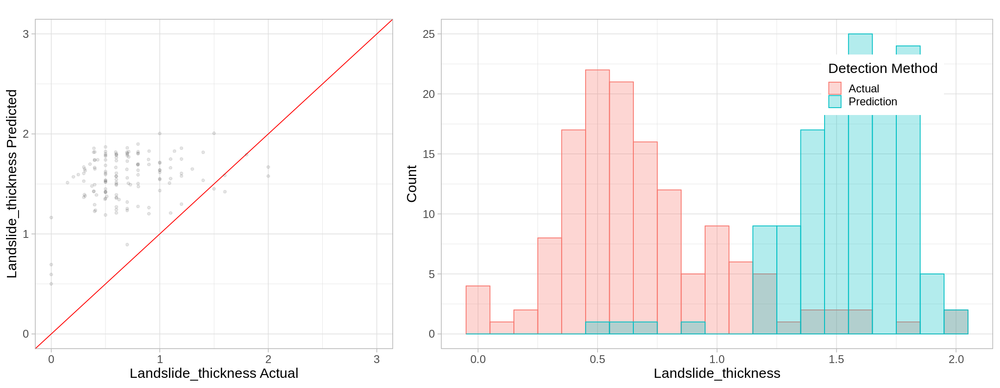

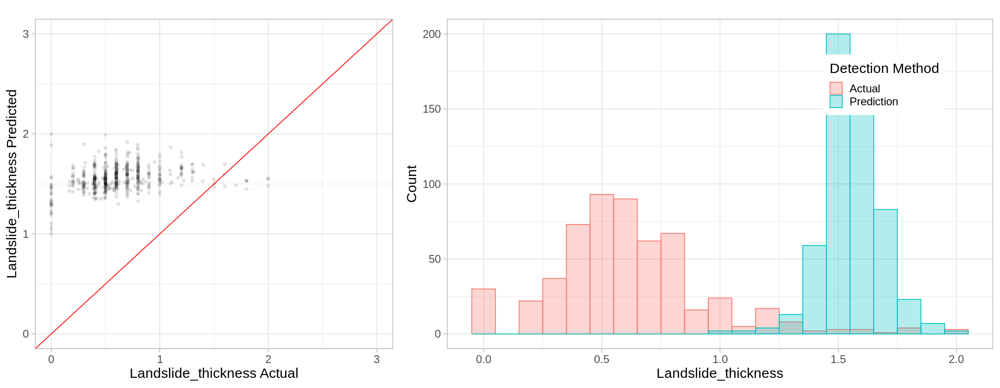

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Simple-S,HMDB,HMDB,560,0.9513217,NA,0.9402447,0.9925838,0.08380879,1,⋯,0.8956622,NA,0.9402447,0.9533194,0.0001288752,1.260293,1.93137,-1.93137,0.6277088,1.2453


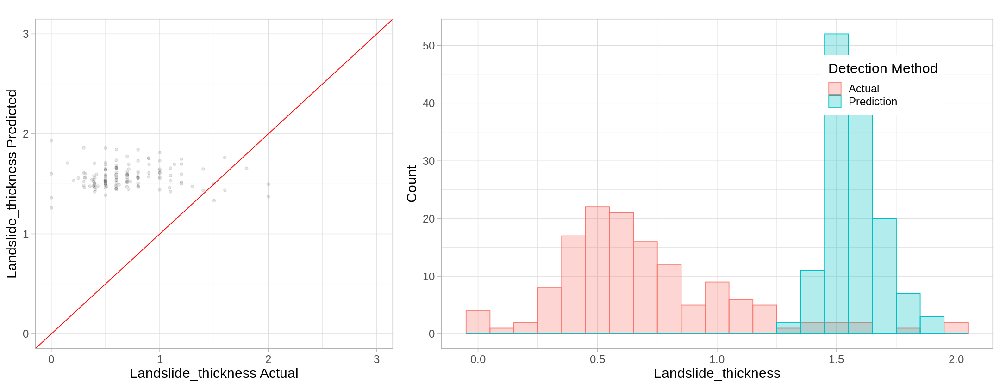

In [195]:
method_label <- "Simple-Z"
train_label <- "HMDB"
test_label <- "HMDB"

pred_train_h_z_hmdb <- h_z_hmdb(data_train_hmdb$h_5)
res_train <- score_model(data_train_hmdb_y,pred_train_h_z_hmdb,actual_label = y_column,plot=plot)

pred_test_h_z_hmdb <- h_z_hmdb(data_test_hmdb$h_5)
res_test <- score_model(data_test_hmdb_y,pred_test_h_z_hmdb,actual_label = y_column,plot=plot)

res.h_z.hmdb <- merge_score_results(method_label, train_label, test_label, data_train_hmdb, res_train, data_test_hmdb, res_test) 
res.h_z.hmdb


method_label <- "Simple-S"
train_label <- "HMDB"
test_label <- "HMDB"

pred_train_h_s_hmdb <- h_s_hmdb(data_train_hmdb$slope_10)
res_train <- score_model(data_train_hmdb_y,pred_train_h_s_hmdb,actual_label = y_column,plot=plot)

pred_test_h_s_hmdb <- h_s_hmdb(data_test_hmdb$slope_10)
res_test <- score_model(data_test_hmdb_y,pred_test_h_s_hmdb,actual_label = y_column,plot=plot)

res.h_s.hmdb <- merge_score_results(method_label, train_label, test_label, data_train_hmdb, res_train, data_test_hmdb, res_test) 
res.h_s.hmdb

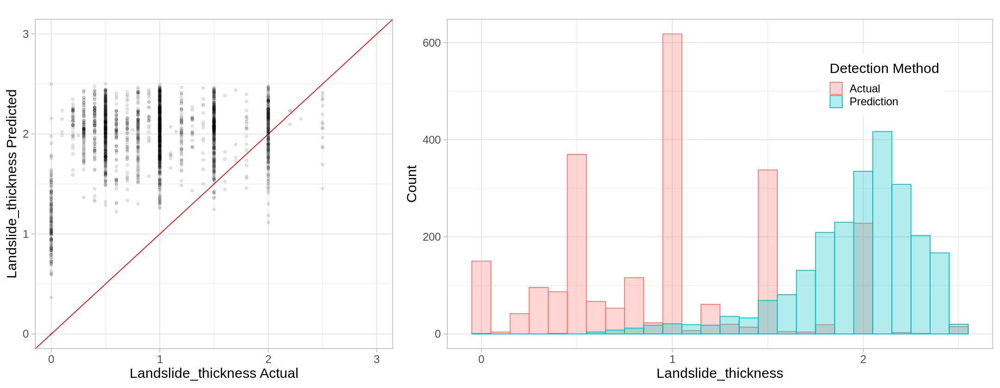

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Simple-Z,StorMe,StorMe,2341,1.030583,NA,NaN,1.153187,0.08360437,0,⋯,1.057739,NA,NaN,1.176428,0.1017821,0.5661223,2.470616,-2.187208,0.5314737,1.730536


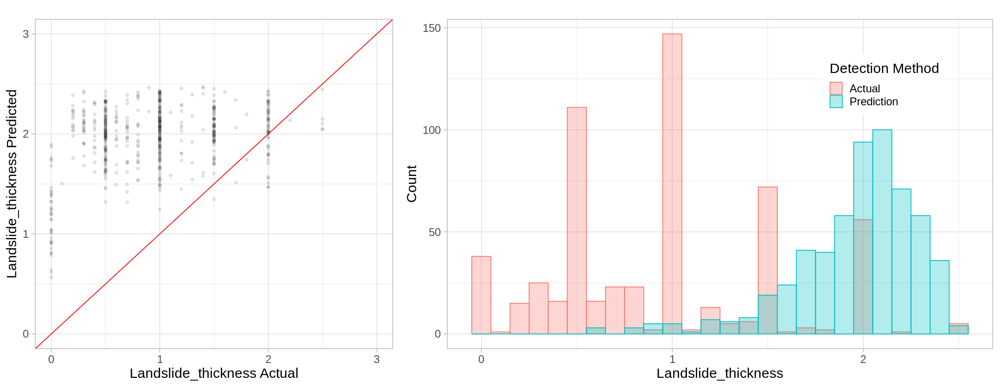

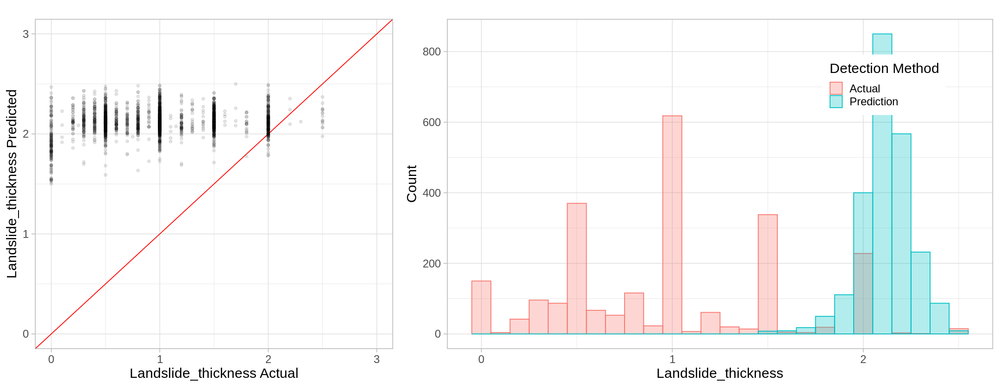

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Simple-S,StorMe,StorMe,2341,1.160921,NA,0.849656,1.281935,0.02918188,1.5,⋯,1.188057,NA,0.849656,1.305405,0.03695859,1.550255,2.485304,-2.423418,0.6004751,1.823807


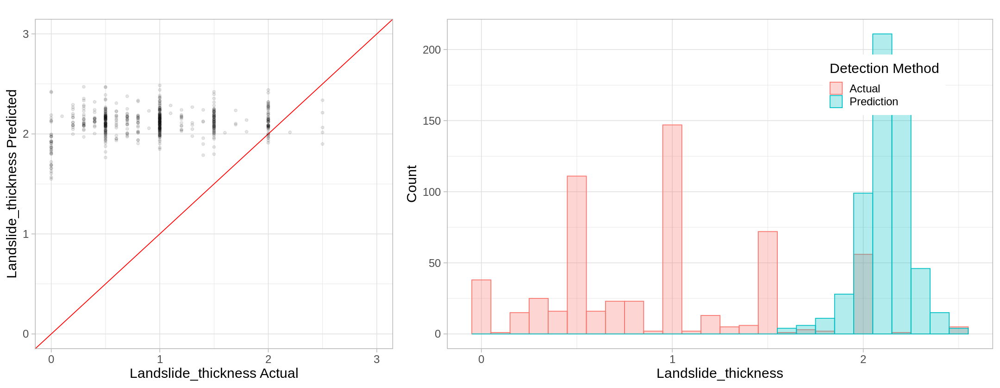

In [196]:
method_label <- "Simple-Z"
train_label <- "StorMe"
test_label <- "StorMe"

pred_train_h_z_storme <- h_z_storme(data_train_storme$h_5)
res_train <- score_model(data_train_storme_y,pred_train_h_z_storme,actual_label = y_column,plot=plot)

pred_test_h_z_storme <- h_z_storme(data_test_storme$h_5)
res_test <- score_model(data_test_storme_y,pred_test_h_z_storme,actual_label = y_column,plot=plot)

res.h_z.storme <- merge_score_results(method_label, train_label, test_label, data_train_storme, res_train, data_test_storme, res_test) 
res.h_z.storme


method_label <- "Simple-S"
train_label <- "StorMe"
test_label <- "StorMe"

pred_train_h_s_storme <- h_s_storme(data_train_storme$slope_10)
res_train <- score_model(data_train_storme_y,pred_train_h_s_storme,actual_label = y_column,plot=plot)

pred_test_h_s_storme <- h_s_storme(data_test_storme$slope_10)
res_test <- score_model(data_test_storme_y,pred_test_h_s_storme,actual_label = y_column,plot=plot)

res.h_s.storme <- merge_score_results(method_label, train_label, test_label, data_train_storme, res_train, data_test_storme, res_test) 
res.h_s.storme

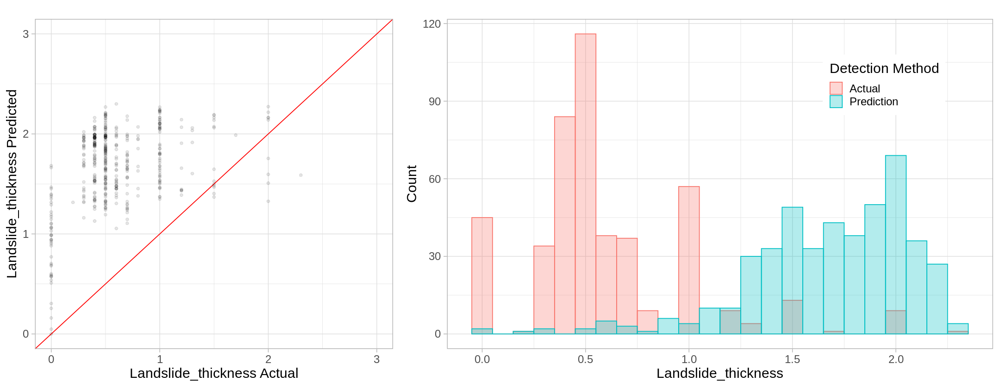

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Simple-Z,BE,BE,458,1.094992,NA,NaN,1.166766,0.142884,0,⋯,1.108377,NA,NaN,1.166234,0.1758942,0.1437627,2.238775,-1.727059,0.6558474,1.583845


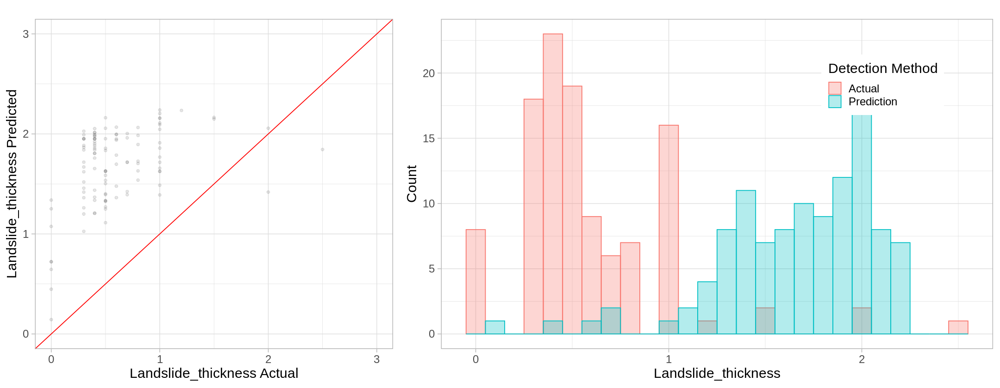

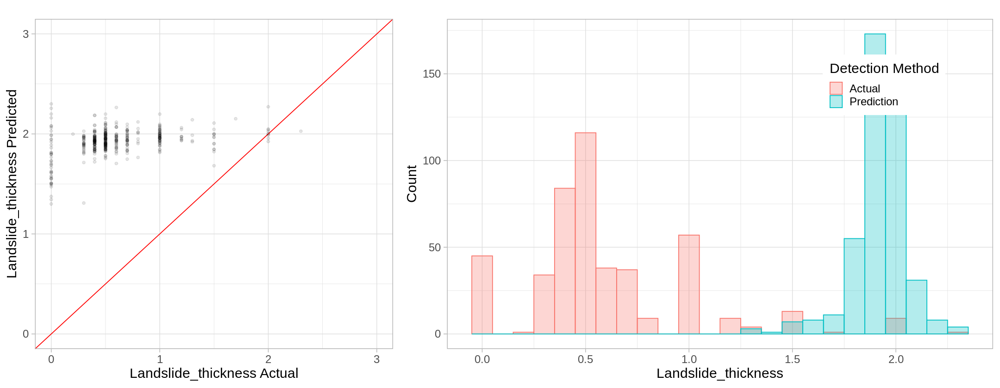

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Simple-S,BE,BE,458,1.331741,NA,1.130227,1.380116,0.1272523,1.3,⋯,1.368584,NA,1.130227,1.41213,0.1333996,1.458612,2.268803,-2.081535,0.2311972,1.685993


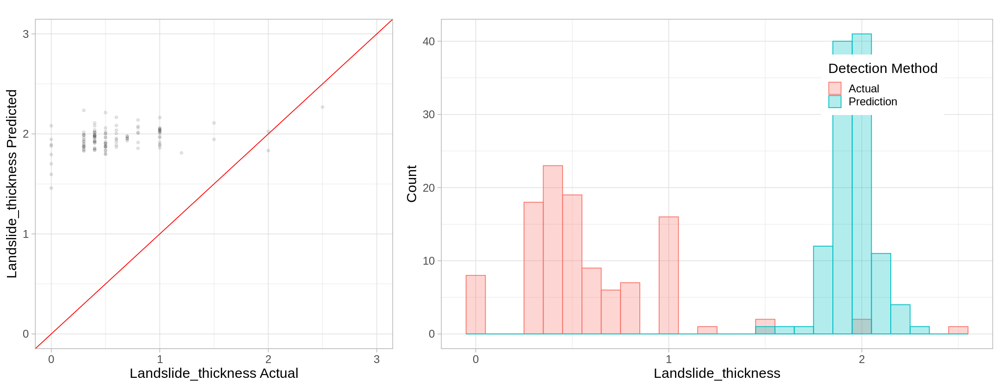

In [197]:
method_label <- "Simple-Z"
train_label <- "BE"
test_label <- "BE"

pred_train_h_z_be <- h_z_be(data_train_be$h_5)
res_train <- score_model(data_train_be_y,pred_train_h_z_be,actual_label = y_column,plot=plot)

pred_test_h_z_be <- h_z_be(data_test_be$h_5)
res_test <- score_model(data_test_be_y,pred_test_h_z_be,actual_label = y_column,plot=plot)

res.h_z.be <- merge_score_results(method_label, train_label, test_label, data_train_be, res_train, data_test_be, res_test) 
res.h_z.be

method_label <- "Simple-S"
train_label <- "BE"
test_label <- "BE"

pred_train_h_s_be <- h_s_be(data_train_be$slope_10)
res_train <- score_model(data_train_be_y,pred_train_h_s_be,actual_label = y_column,plot=plot)

pred_test_h_s_be <- h_s_be(data_test_be$slope_10)
res_test <- score_model(data_test_be_y,pred_test_h_s_be,actual_label = y_column,plot=plot)

res.h_s.be <- merge_score_results(method_label, train_label, test_label, data_train_be, res_train, data_test_be, res_test) 
res.h_s.be

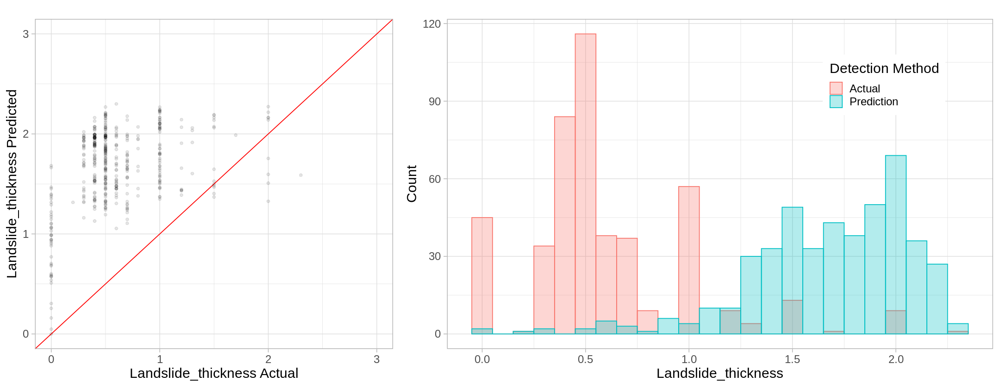

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Simple-Z,BE,HMDB,458,1.094992,NA,NaN,1.166766,0.142884,0,⋯,1.173758,NA,NaN,1.22991,0.08389749,0.02304673,2.376755,-2.04665,0.475826,1.590005


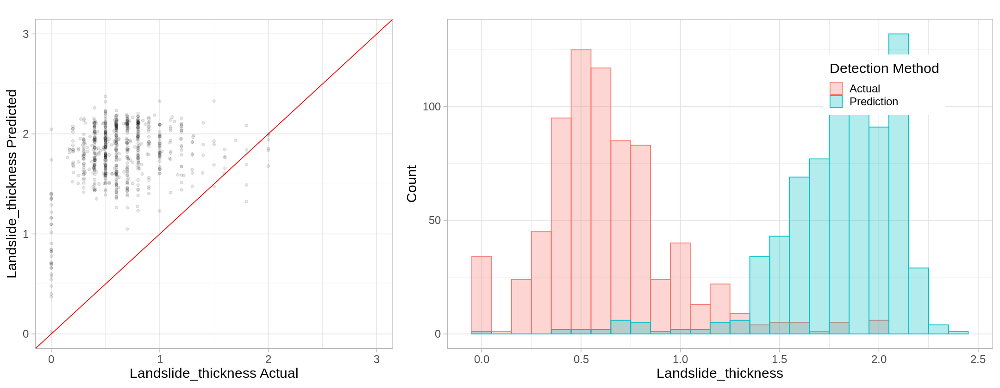

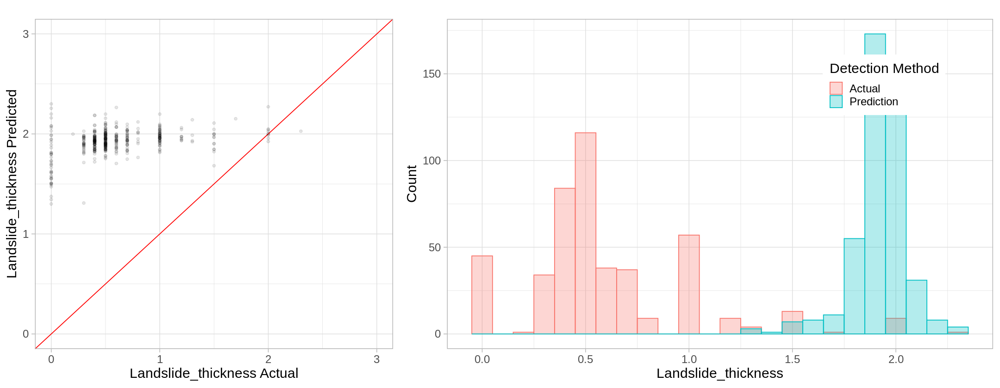

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Simple-S,BE,HMDB,458,1.331741,NA,1.130227,1.380116,0.1272523,1.3,⋯,1.264132,NA,1.130227,1.304328,0.04830978,1.295815,2.371185,-2.371185,0.3038343,1.617177


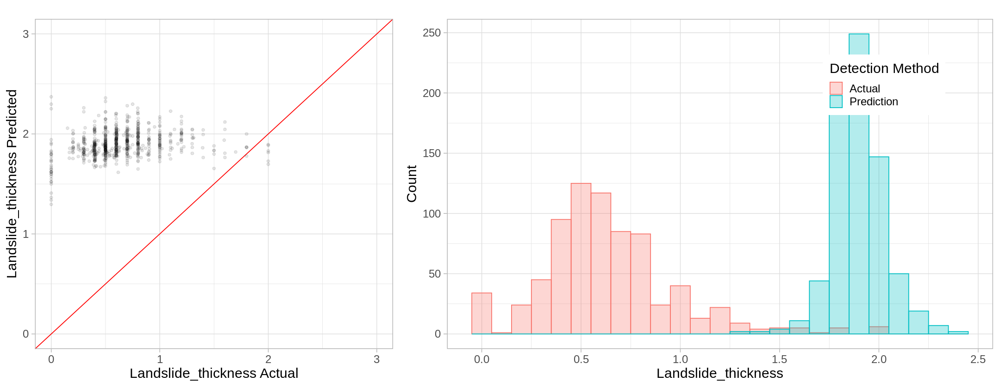

In [198]:
method_label <- "Simple-Z"
train_label <- "BE"
test_label <- "HMDB"

pred_train_h_z_be_hmdb <- h_z_be(data_train_be_hmdb$h_5)
res_train <- score_model(data_train_be_hmdb_y,pred_train_h_z_be_hmdb,actual_label = y_column,plot=plot)

pred_test_h_z_be_hmdb <- h_z_be(data_test_be_hmdb$h_5)
res_test <- score_model(data_test_be_hmdb_y,pred_test_h_z_be_hmdb,actual_label = y_column,plot=plot)

res.h_z.be_hmdb <- merge_score_results(method_label, train_label, test_label, data_train_be_hmdb, res_train, data_test_be_hmdb, res_test) 
res.h_z.be_hmdb


method_label <- "Simple-S"
train_label <- "BE"
test_label <- "HMDB"

pred_train_h_s_be_hmdb <- h_s_be(data_train_be_hmdb$slope_10)
res_train <- score_model(data_train_be_hmdb_y,pred_train_h_s_be_hmdb,actual_label = y_column,plot=plot)

pred_test_h_s_be_hmdb <- h_s_be(data_test_be_hmdb$slope_10)
res_test <- score_model(data_test_be_hmdb_y,pred_test_h_s_be_hmdb,actual_label = y_column,plot=plot)

res.h_s.be_hmdb <- merge_score_results(method_label, train_label, test_label, data_train_be_hmdb, res_train, data_test_be_hmdb, res_test) 
res.h_s.be_hmdb






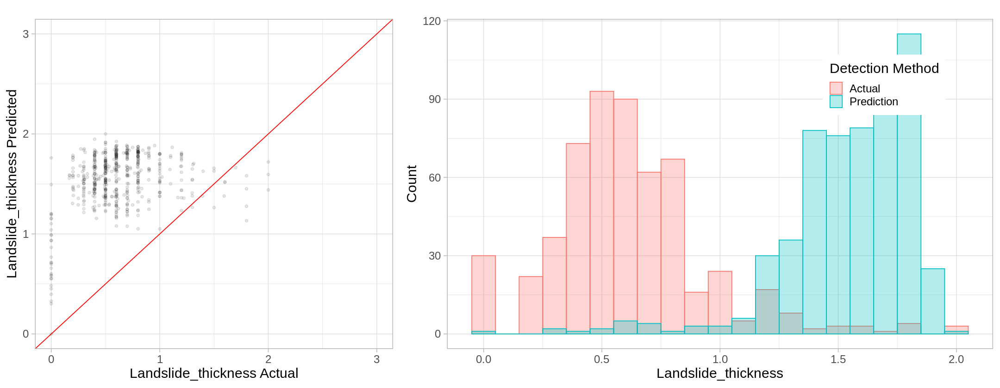

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Simple-Z,HMDB,BE,560,0.9444475,NA,NaN,0.9977073,0.09017431,0,⋯,0.8728062,NA,NaN,0.9388746,0.1491987,-0.02005352,1.981233,-1.461754,0.938519,1.305778


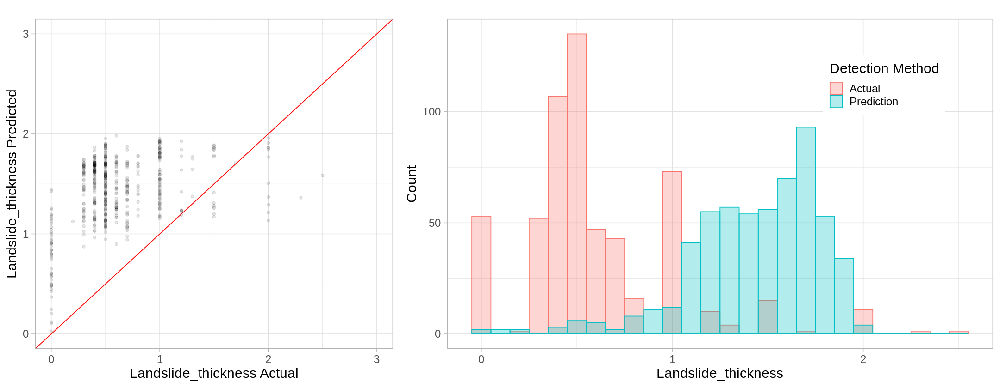

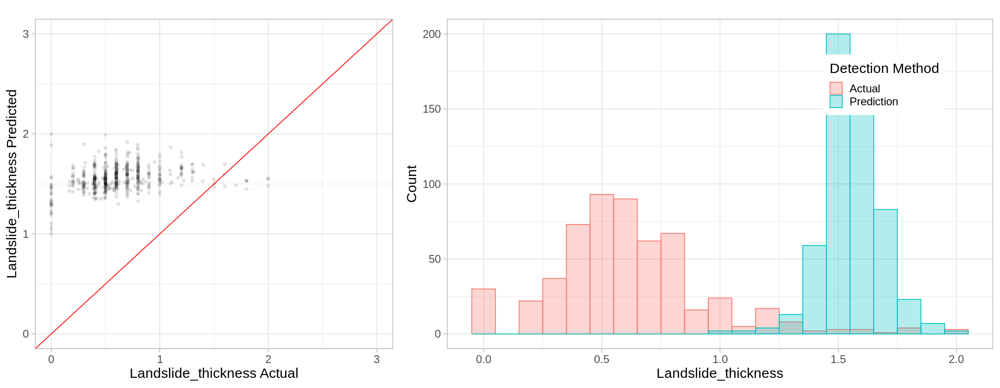

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Simple-S,HMDB,BE,560,0.9513217,NA,0.9402447,0.9925838,0.08380879,1,⋯,1.013638,NA,0.9402447,1.062616,0.1267652,1.003892,1.933804,-1.933804,0.6201799,1.312703


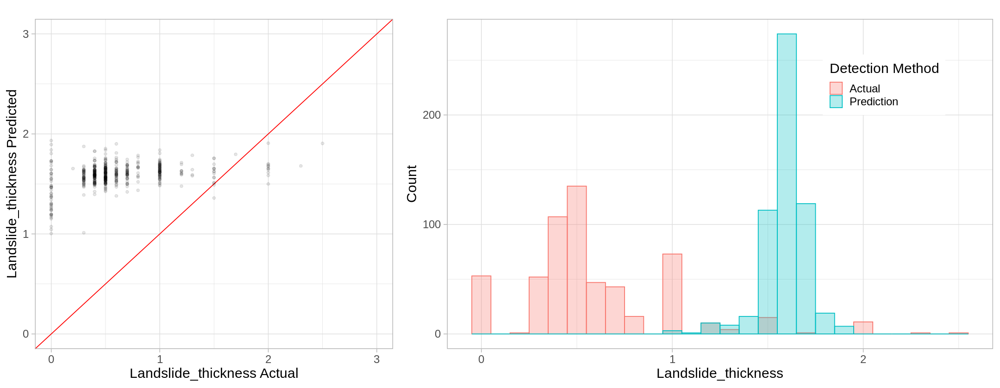

In [199]:
method_label <- "Simple-Z"
train_label <- "HMDB"
test_label <- "BE"

pred_train_h_z_hmdb_be <- h_z_hmdb(data_train_hmdb_be$h_5)
res_train <- score_model(data_train_hmdb_be_y,pred_train_h_z_hmdb_be,actual_label = y_column,plot=plot)

pred_test_h_z_hmdb_be <- h_z_hmdb(data_test_hmdb_be$h_5)
res_test <- score_model(data_test_hmdb_be_y,pred_test_h_z_hmdb_be,actual_label = y_column,plot=plot)

res.h_z.hmdb_be <- merge_score_results(method_label, train_label, test_label, data_train_hmdb_be, res_train, data_test_hmdb_be, res_test) 
res.h_z.hmdb_be


method_label <- "Simple-S"
train_label <- "HMDB"
test_label <- "BE"

pred_train_h_s_hmdb_be <- h_s_hmdb(data_train_hmdb_be$slope_10)
res_train <- score_model(data_train_hmdb_be_y,pred_train_h_s_hmdb_be,actual_label = y_column,plot=plot)

pred_test_h_s_hmdb_be <- h_s_hmdb(data_test_hmdb_be$slope_10)
res_test <- score_model(data_test_hmdb_be_y,pred_test_h_s_hmdb_be,actual_label = y_column,plot=plot)

res.h_s.hmdb_be <- merge_score_results(method_label, train_label, test_label, data_train_hmdb_be, res_train, data_test_hmdb_be, res_test) 
res.h_s.hmdb_be






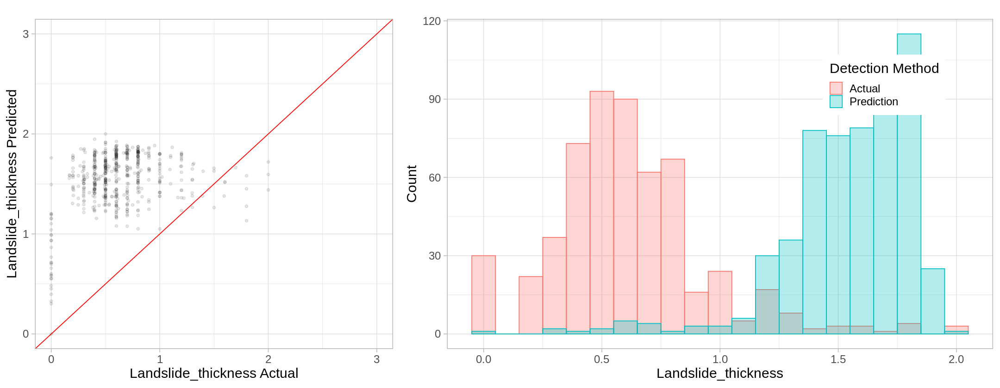

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Simple-Z,HMDB,StorMe,560,0.9444475,NA,NaN,0.9977073,0.09017431,0,⋯,0.7448162,NA,NaN,0.86579,0.07677491,-0.2393474,2.133212,-2.130185,1.357899,1.371899


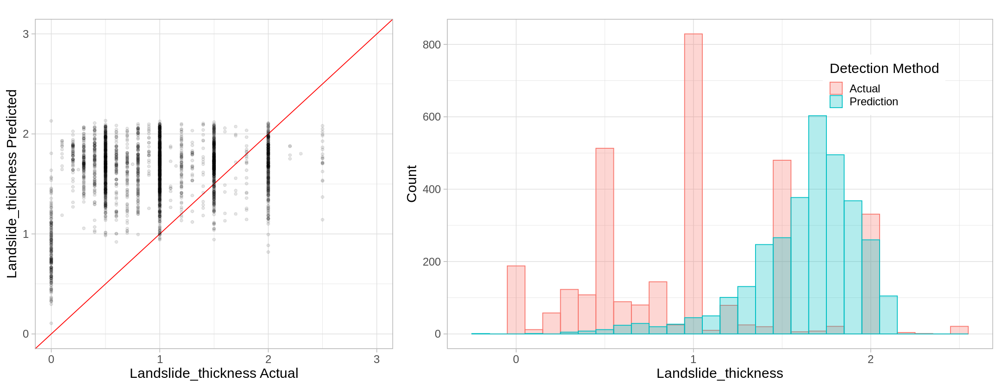

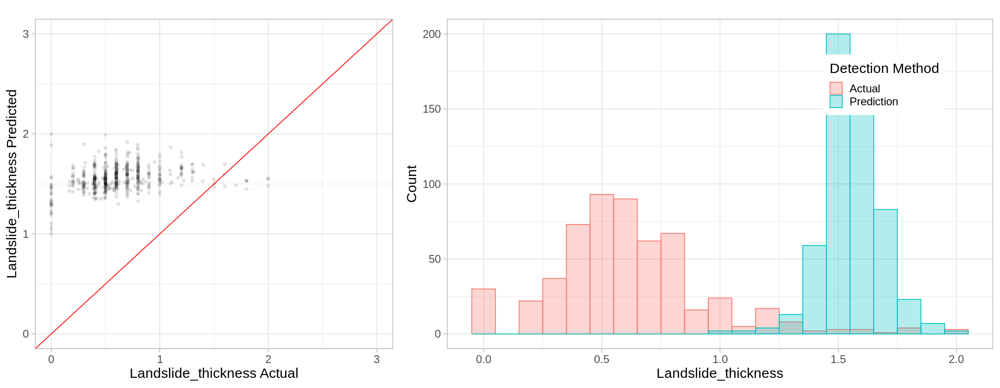

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Simple-S,HMDB,StorMe,560,0.9513217,NA,0.9402447,0.9925838,0.08380879,1,⋯,0.7415026,NA,0.9402447,0.8571615,0.02814672,0.9562186,2.038082,-2.004135,1.11155,1.318436


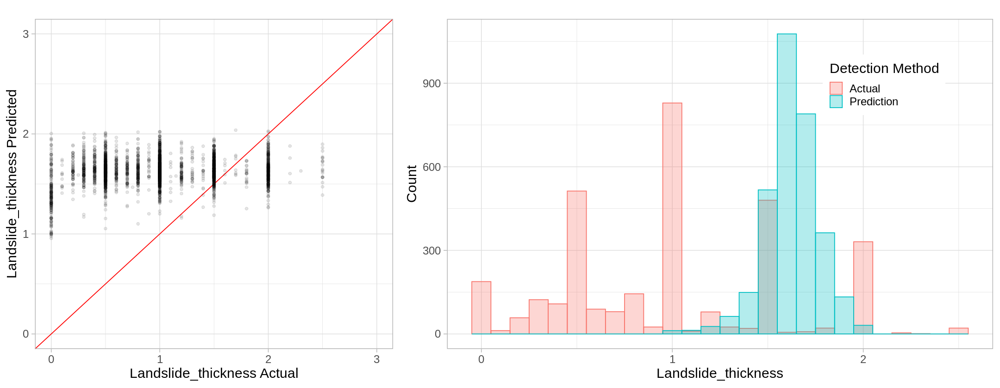

In [200]:
method_label <- "Simple-Z"
train_label <- "HMDB"
test_label <- "StorMe"

pred_train_h_z_hmdb_storme <- h_z_hmdb(data_train_hmdb_storme$h_5)
res_train <- score_model(data_train_hmdb_storme_y,pred_train_h_z_hmdb_storme,actual_label = y_column,plot=plot)

pred_test_h_z_hmdb_storme <- h_z_hmdb(data_test_hmdb_storme$h_5)
res_test <- score_model(data_test_hmdb_storme_y,pred_test_h_z_hmdb_storme,actual_label = y_column,plot=plot)

res.h_z.hmdb_storme <- merge_score_results(method_label, train_label, test_label, data_train_hmdb_storme, res_train, data_test_hmdb_storme, res_test) 
res.h_z.hmdb_storme


method_label <- "Simple-S"
train_label <- "HMDB"
test_label <- "StorMe"

pred_train_h_s_hmdb_storme <- h_s_hmdb(data_train_hmdb_storme$slope_10)
res_train <- score_model(data_train_hmdb_storme_y,pred_train_h_s_hmdb_storme,actual_label = y_column,plot=plot)

pred_test_h_s_hmdb_storme <- h_s_hmdb(data_test_hmdb_storme$slope_10)
res_test <- score_model(data_test_hmdb_storme_y,pred_test_h_s_hmdb_storme,actual_label = y_column,plot=plot)

res.h_s.hmdb_storme <- merge_score_results(method_label, train_label, test_label, data_train_hmdb_storme, res_train, data_test_hmdb_storme, res_test) 
res.h_s.hmdb_storme






<a id="Cumulative_Distribution"></a>
### Cumulative Distribution

Reproduction of van Zandelhoff et al. (2022) using the HMDB Data

[1] 1000000
[1] 1000000
[1] 0.637213
[1] 0.6371518
[1] -0.9656319
[1] 0.04388607
[1] 2.285504
[1] 5.574499
[1] 0.3370317
[1] 0.3372072


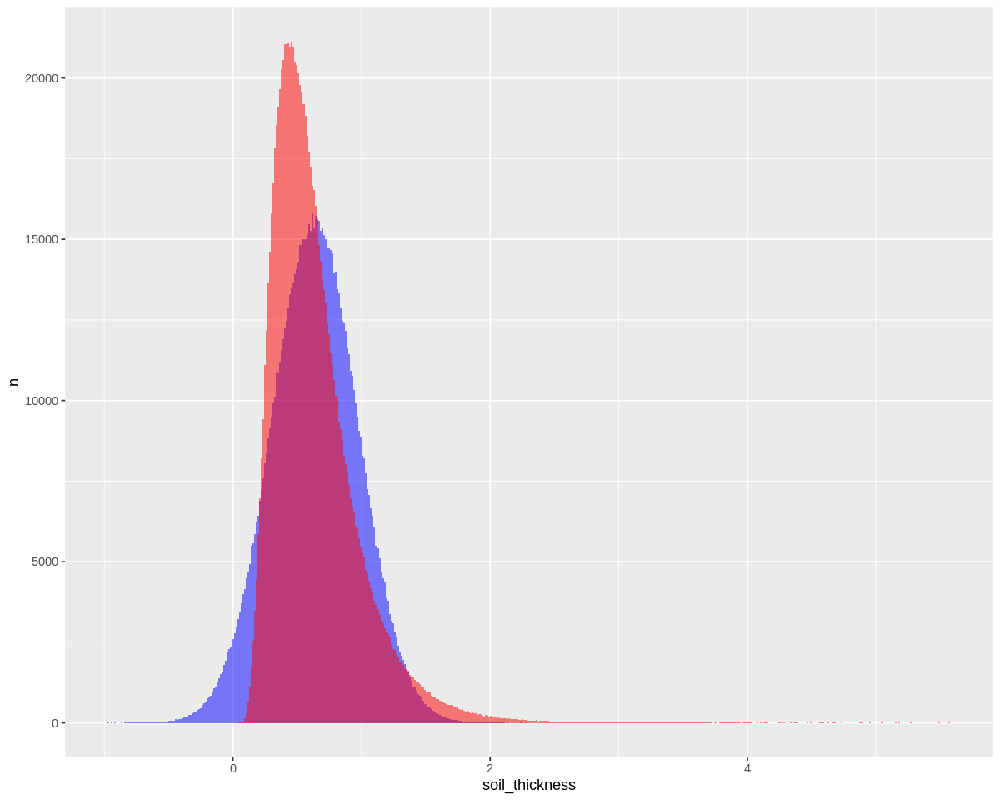

The normal distribution MSE is 0.9423 
The lognormal distribution MSE is 0.869 


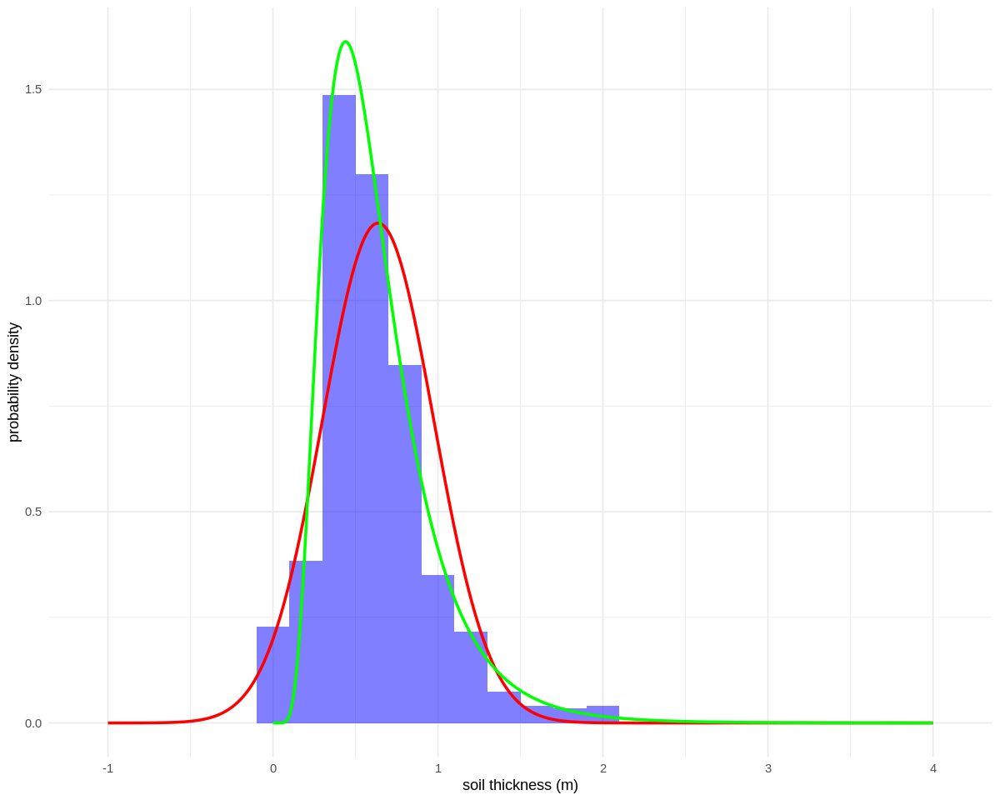

In [201]:
soil_thickness_obs <- merged.df.hmdb$Landslide_thickness[!is.na(merged.df.hmdb$Landslide_thickness)]

m <- mean(soil_thickness_obs)
v <- var(soil_thickness_obs)
phi <- sqrt(v + m^2)
mu <- log(m^2/phi)
sigma <- sqrt(log(phi^2/m^2))
n <- 1000000

normalVals <- rnorm(n, m, sqrt(v))
LognormalVals <- exp(rnorm(n, mu, sigma))

options(repr.plot.width=10, repr.plot.height=8)
ggplot() +
  geom_histogram(data = data.frame(x = normalVals), aes(x = x), bins = 500, fill = "blue", alpha = 0.5) +
  geom_histogram(data = data.frame(x = LognormalVals), aes(x = x), bins = 500, fill = "red", alpha = 0.5) +
  xlab("soil_thickness") +
  ylab("n")

print(length(normalVals))
print(length(LognormalVals))
print(mean(normalVals))
print(mean(LognormalVals))
print(min(normalVals))
print(min(LognormalVals))
print(max(normalVals))
print(max(LognormalVals))
print(sd(normalVals))
print(sd(LognormalVals))

x <- seq(-1, 4, length.out = 5000)
pdf_log <- (exp(-(log(x) - mu)^2 / (2 * sigma^2)) / (x * sigma * sqrt(2 * pi)))
points <- hist(soil_thickness_obs, breaks = as.integer((max(soil_thickness_obs)-min(soil_thickness_obs))/0.2), plot = FALSE, density = TRUE)
df <- data.frame(x = x, y1 = dnorm(x, m, sqrt(v)), y2 = pdf_log)

ggplot(NULL) +
  # geom_histogram(aes(x = soil_thickness_obs), bins=11) +
  geom_histogram(aes(x = soil_thickness_obs,after_stat(density)), binwidth = 0.2, density = TRUE, fill = "blue", alpha = 0.5) +
  geom_line(aes(x = df$x, y = df$y1), color = "red", size = 1) +
  geom_line(aes(x = df$x, y = df$y2), color = "green", size = 1) +
  theme_minimal() +
  labs(x = "soil thickness (m)", y = "probability density") +
  scale_fill_manual(values = "blue") +
  scale_alpha_manual(values = 0.5) +
  guides(fill = FALSE, alpha = FALSE) 

LS_x <- seq(0.1, 2.9, length.out = 15)
LS_lognormals <- ifelse(is.nan((exp(-(log(LS_x) - mu)^2 / (2 * sigma^2)) / (LS_x * sigma * sqrt(2 * pi)))), 0, (exp(-(log(LS_x) - mu)^2 / (2 * sigma^2)) / (LS_x * sigma * sqrt(2 * pi))))
LS_normals <- dnorm(LS_x, m, sqrt(v))

MSE_normal <- mean((points$counts/100 - LS_normals)^2)
MSE_lognormal <- mean((points$counts/100 - LS_lognormals)^2)
cat("The normal distribution MSE is", round(MSE_normal, 4), "\n")
cat("The lognormal distribution MSE is", round(MSE_lognormal, 4), "\n")

  0:     13.016747:  1.50000  1.35000 0.750000
  1:     3.7527352:  1.93629  1.68195  1.63736
  2:     1.2937239:  1.88396  2.11703  1.17948
  3:    0.89683774:  1.90636  2.04095 0.387985
  4:    0.73748722:  1.90483  2.10132 0.562184
  5:    0.72151328:  1.89894  2.09502 0.495744
  6:    0.71741430:  1.90046  2.09869 0.465824
  7:    0.71574132:  1.89719  2.10214 0.448625
  8:    0.71493830:  1.89504  2.10420 0.436231
  9:    0.71455130:  1.89354  2.10570 0.427968
 10:    0.71436408:  1.89251  2.10672 0.422227
 11:    0.71427342:  1.89179  2.10743 0.418280
 12:    0.71422948:  1.89130  2.10792 0.415543
 13:    0.71420817:  1.89095  2.10826 0.413646
 14:    0.71419783:  1.89071  2.10850 0.412327
 15:    0.71419281:  1.89055  2.10867 0.411411
 16:    0.71419038:  1.89043  2.10878 0.410773
 17:    0.71418919:  1.89035  2.10887 0.410329
 18:    0.71418862:  1.89029  2.10892 0.410020
 19:    0.71418834:  1.89025  2.10896 0.409804
 20:    0.71418820:  1.89022  2.10899 0.409654
 21:    0.714

a         b         c 
1.8901633 2.1090485 0.4093181

[1] 2341

[1] 2341

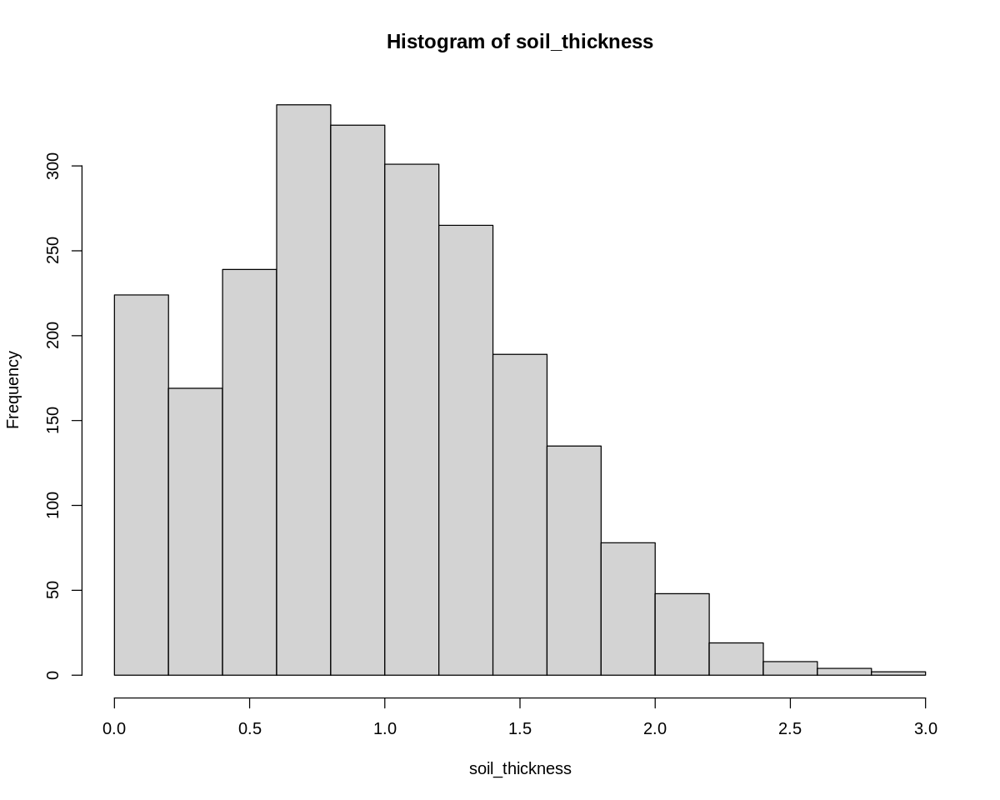

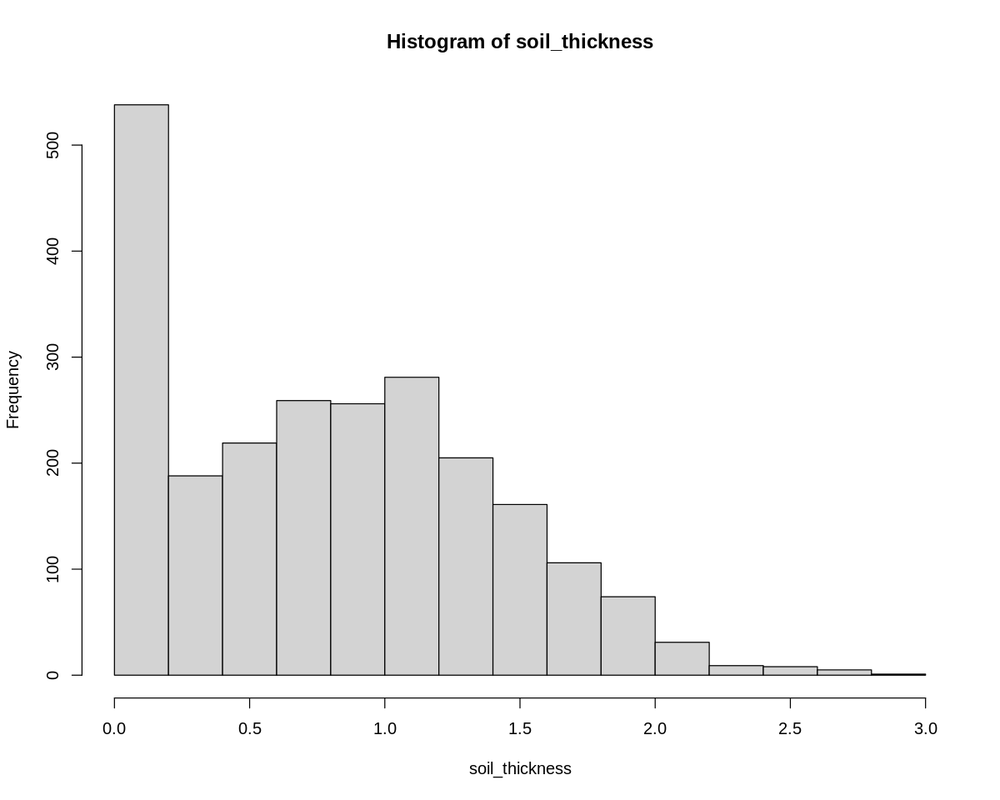

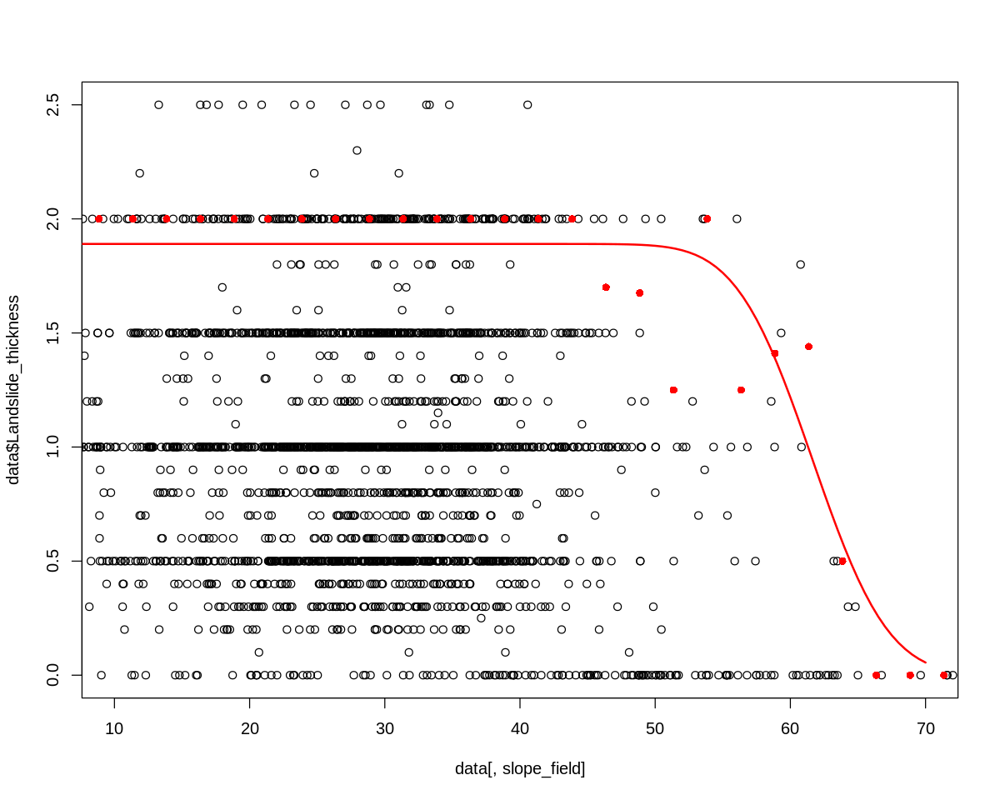

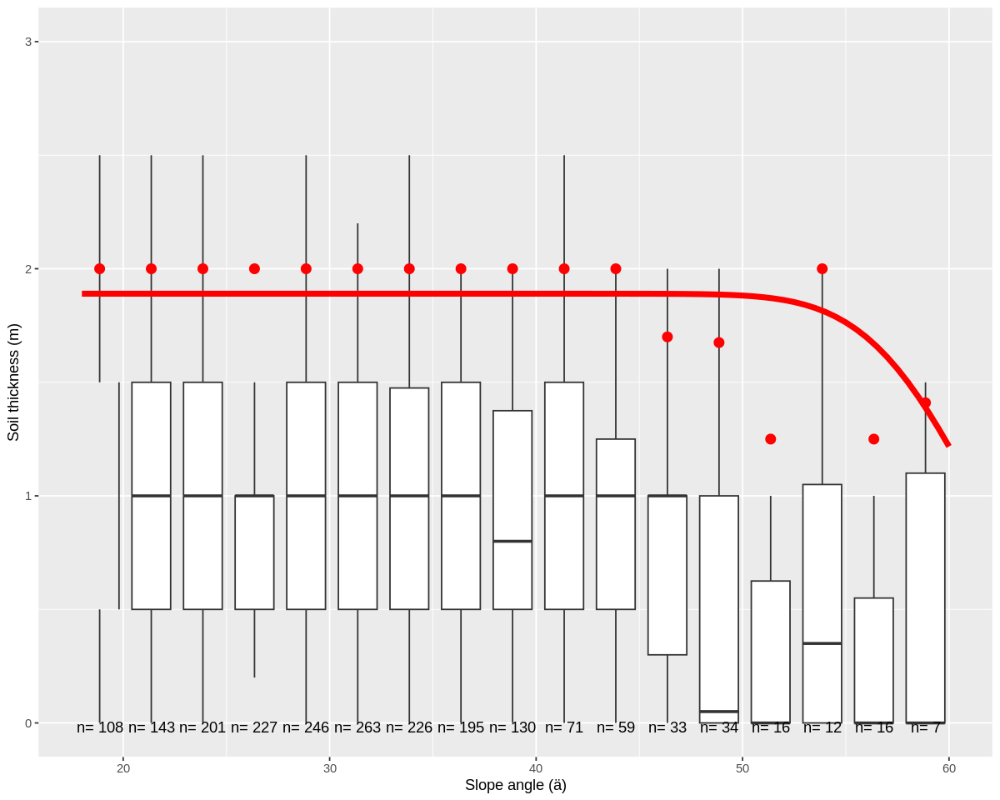

In [202]:
data <- merged.df.storme
data <- data_train_be
data <- data_train_storme
# data <- data[!is.na(data$Landslide_thickness)&!is.na(data$slope25),]


slope_field <- "slope_5"
data <- data[!is.na(data[,slope_field]),]
slope_range <- range(data[,slope_field],na.rm=TRUE)
step <- 2.5
quant <- 0.95
n_steps <-ceiling((slope_range[2]-slope_range[1])/2.5)
step_sets <- lapply(1:n_steps, function(x) subset(data, data[,slope_field] > (slope_range[1] + (x-1)*step) & data[,slope_field] < (slope_range[1] + x*step)))

step_quants <- unlist(lapply(step_sets,function(x) quantile(x$Landslide_thickness, probs = c(.95),na.rm=TRUE)))

step_slope <- seq(slope_range[1]+step/2,length.out=n_steps,by=step)
# step_sets <- step_sets[!is.na(step_quants)]
# step_quants <- step_quants[!is.na(step_quants)]                  
mean_Slope <- mean(data[,slope_field])
sd_Slope <- sd(data[,slope_field])
mean_thickness <- mean(data$Landslide_thickness,na.rm=TRUE)   
sd_thickness <- sd(data$Landslide_thickness,na.rm=TRUE)
                             
fitmodel <- nls(step_quants ~ a * (1 - pnorm(step_slope, b * mean_Slope, c * sd_Slope)),
                start=list(a=1.5, b=1.35, c=0.75),      
                trace=TRUE,
                algorithm="port",
                control = list(maxiter = 50000, minFactor = 1/2000, warnOnly = TRUE),
                na.action = na.omit,
                lower=c(0.2,0.2,0.2),
                upper=c(3,3,3)
    # ,control = list(scaleOffset = 1)
               )

jpw_95.est <- coef(fitmodel)
jpw_95.est

soil_thickness<-rnorm(length(data[,slope_field]),mean_thickness,sd_thickness) * (1-pnorm(data[,slope_field],jpw_95.est[2] *mean_Slope,jpw_95.est[3]*sd_Slope)) 		# Feldaufnahme mean(data_slope), sd(data_slope) Rutschkörpermächtigkeit/-tiefe [m], pnorm serve ad evitare che ci siano frane in zone ripide!
  soil_thickness[which(soil_thickness<0)]<-0.01
                             length(soil_thickness)
hist(soil_thickness                 )

soil_thickness<-rnorm(length(data[,slope_field]),mean_thickness,sd_thickness) * (1-pnorm(step_slope,jpw_95.est[2] *mean_Slope,jpw_95.est[3]*sd_Slope)) 		# Feldaufnahme mean(data_slope), sd(data_slope) Rutschkörpermächtigkeit/-tiefe [m], pnorm serve ad evitare che ci siano frane in zone ripide!
  soil_thickness[which(soil_thickness<0)]<-0.01
                                                          length(soil_thickness)
hist(soil_thickness                 )

                             
# general function
fitFunction <- function(x,jpw,slope) {
  jpw[1] * (1 - pnorm(x, jpw[2] * mean(slope), jpw[3] * sd(slope)))
}
plotseq = seq(0,70,0.5)

df_all <- data.frame(data[,slope_field],data$Landslide_thickness)

df_95 <- data.frame(step_slope,step_quants)

df_fit <- data.frame("plotseq" = plotseq, "plotseq_fit" = fitFunction(plotseq,jpw_95.est,data[,slope_field]))


plot(data[,slope_field], data$Landslide_thickness,xlim = c(10, 70))
points(step_slope,step_quants,col = 'red', pch = 16)

lines(plotseq,fitFunction(plotseq,jpw_95.est,data[,slope_field]), col="red", lwd=2)

# boxplot plot
sets_list <- lapply(step_sets,function(x)x$Landslide_thickness)
sets_c <- simplify(sets_list)
sets_lengths <- lengths(sets_list)
sets_reps <- simplify(lapply(1:length(step_slope),function(x) rep(step_slope[x],sets_lengths[x])))
sets_class <- simplify(lapply(1:length(step_slope),function(x) rep(as.character(step_slope[x]),sets_lengths[x]))) 

                              
plot_data <- data.frame(loc=sets_reps,
                      value=sets_c,
                      class=sets_class)

stat_box_data <- function(x, upper_limit = 3) {
  return( 
    data.frame(
      y = 0,#0.95 * upper_limit,
      label = paste('n=', 
                    format(length(x), big.mark = ",", decimal.mark = ".", scientific = FALSE)) 
                    #'\n',
                    #'m=', 
                    #format(round(mean(x), 1), big.mark = ",", decimal.mark = ".", scientific = FALSE))
    )
  )
}

p <- ggplot(plot_data,aes(x=loc,y=value,group=class)) +
geom_boxplot(position = "identity", outlier.shape = NA) +
xlim(18, 60) + 
ylim(0,3) + 
stat_summary(
  fun.data = stat_box_data, 
  geom = "text", 
  hjust = 0.5,
  vjust = 0.9
)
p + geom_point(data = df_95, aes(x=step_slope, y=step_quants, group = step_quants), color = 'red', size = 3) + 
geom_line(data = df_fit, aes(x=plotseq, y=plotseq_fit, group = '1'), color = "red", size = 2) +
labs(y= "Soil thickness (m)", x = "Slope angle (ä)")
                     

In [203]:
#SlideforMAP-model 
h_sfm <- function(slope, mean_thickness, sd_thickness, mean_slope, sd_slope, a, b, seed=42) {
    set.seed(seed)
    soil_thickness<-rnorm(length(slope),mean_thickness,sd_thickness) * (1-pnorm(slope,a * mean_slope,b*sd_slope))
    soil_thickness[which(soil_thickness<0)]<-0.01
    return(soil_thickness)
}

fit_h_sfm <- function(data, slope_field="slope_25", depth_field="Landslide_thickness", seed=42, plot_graphics=TRUE) {
    # data <- data[!is.na(data$Landslide_thickness)&!is.na(data$slope25),]
    data <- data[!is.na(data[,slope_field]),]
    slope_range <- range(data[,slope_field],na.rm=TRUE)
    step <- 2.5
    quant <- 0.95
    n_steps <-ceiling((slope_range[2]-slope_range[1])/2.5)
    step_sets <- lapply(1:n_steps, function(x) subset(data, data[,slope_field] > (slope_range[1] + (x-1)*step) & data[,slope_field] < (slope_range[1] + x*step)))
    step_quants <- unlist(lapply(step_sets,function(x) quantile(x[,depth_field], probs = c(.95),na.rm=TRUE)))

    step_slope <- seq(slope_range[1]+step/2,length.out=n_steps,by=step)
    # step_sets <- step_sets[!is.na(step_quants)]
    # step_quants <- step_quants[!is.na(step_quants)]                  
    mean_slope <- mean(data[,slope_field])
    sd_slope <- sd(data[,slope_field])
    mean_thickness <- mean(data[,depth_field],na.rm=TRUE)   
    sd_thickness <- sd(data[,depth_field],na.rm=TRUE)

    set.seed(seed)
    fitmodel <- nls(step_quants ~ a * (1 - pnorm(step_slope, b * mean_slope, c * sd_slope)),
                    start=list(a=1.5, b=1.35, c=0.75),      
                    trace=FALSE,
                    algorithm="port",
                    na.action = na.omit,
                    control = list(maxiter = 50000, minFactor = 1/2000, warnOnly = TRUE),
                    lower=c(0.2,0.2,0.2),
                    upper=c(3,3,3))

    jpw_95.est <- coef(fitmodel)
    print(jpw_95.est)
                                 
    func <- purrr::partial(h_sfm,mean_thickness=mean_thickness, sd_thickness=sd_thickness, mean_slope=mean_slope, sd_slope=sd_slope, a=jpw_95.est[2], b=jpw_95.est[3], seed=seed)
    if(plot_graphics){
        # general function
        fitFunction <- function(x,jpw,slope) {
          jpw[1] * (1 - pnorm(x, jpw[2] * mean(slope), jpw[3] * sd(slope)))
        }
        plotseq = seq(0,70,0.5)

        df_all <- data.frame(data[,slope_field],data[,depth_field])

        df_95 <- data.frame(step_slope,step_quants)

        df_fit <- data.frame("plotseq" = plotseq, "plotseq_fit" = fitFunction(plotseq,jpw_95.est,data[,slope_field]))

        plot(data[,slope_field], data[,depth_field],xlim = c(10, 70))
        points(step_slope,step_quants,col = 'red', pch = 16)

        lines(plotseq,fitFunction(plotseq,jpw_95.est,data[,slope_field]), col="red", lwd=2)

        # boxplot plot
        sets_list <- lapply(step_sets,function(x)x[,depth_field])
        sets_c <- simplify(sets_list)
        sets_lengths <- lengths(sets_list)
        sets_reps <- simplify(lapply(1:length(step_slope),function(x) rep(step_slope[x],sets_lengths[x])))
        sets_class <- simplify(lapply(1:length(step_slope),function(x) rep(as.character(step_slope[x]),sets_lengths[x]))) 


        plot_data <- data.frame(loc=sets_reps,
                              value=sets_c,
                              class=sets_class)

        stat_box_data <- function(x, upper_limit = 3) {
          return( 
            data.frame(
              y = 0,#0.95 * upper_limit,
              label = paste('n=', 
                            format(length(x), big.mark = ",", decimal.mark = ".", scientific = FALSE)) 
                            #'\n',
                            #'m=', 
                            #format(round(mean(x), 1), big.mark = ",", decimal.mark = ".", scientific = FALSE))
            )
          )
        }

        p <- ggplot(plot_data,aes(x=loc,y=value,group=class)) +
        geom_boxplot(position = "identity", outlier.shape = NA) +
        xlim(18, 60) + 
        ylim(0,3) + 
        stat_summary(
          fun.data = stat_box_data, 
          geom = "text", 
          hjust = 0.5,
          vjust = 0.9
        )
        p <- p + geom_point(data = df_95, aes(x=step_slope, y=step_quants, group = step_quants), color = 'red', size = 3) + 
        geom_line(data = df_fit, aes(x=plotseq, y=plotseq_fit, group = '1'), color = "red", size = 2) +
        labs(y= "Soil thickness (m)", x = "Slope angle (ä)")
        show(p)
    }
    return(func)
}

In [204]:
train_h_sfm_cv <- function(data_train, n_folds=10, seed = 0 ){
    
    set.seed(seed)
    
    folds <- createFolds(data_train$Landslide_thickness, k=n_folds)

    models <- NA
    res <- NA
    for(i in 1:n_folds) {
        data_trn <- data_train[-folds[[i]],]
        data_tst <- data_train[folds[[i]],]
        
        data_trn <- data_trn[!is.na(data_trn$Landslide_thickness),]
        data_tst <- data_tst[!is.na(data_tst$Landslide_thickness),]     
        
        h_sfm_m <- fit_h_sfm(data_trn,seed=seed, slope_field="slope_10")

        models <- rbind(models,list(h_sfm_m))

        pred_tst_h_sfm_m <- h_sfm_m(data_tst$slope_10)
        res_tst <- score_model(data_tst$Landslide_thickness,pred_tst_h_sfm_m,actual_label="",plot=FALSE)
        res <- rbind(res,res_tst)
    }
    
    best_i <- which.min(res$mae)
    print(paste0("Best result : Nr.", best_i))
    
    return(models[[best_i]])
}

        a         b         c 
1.0834001 1.4778888 0.5828395 


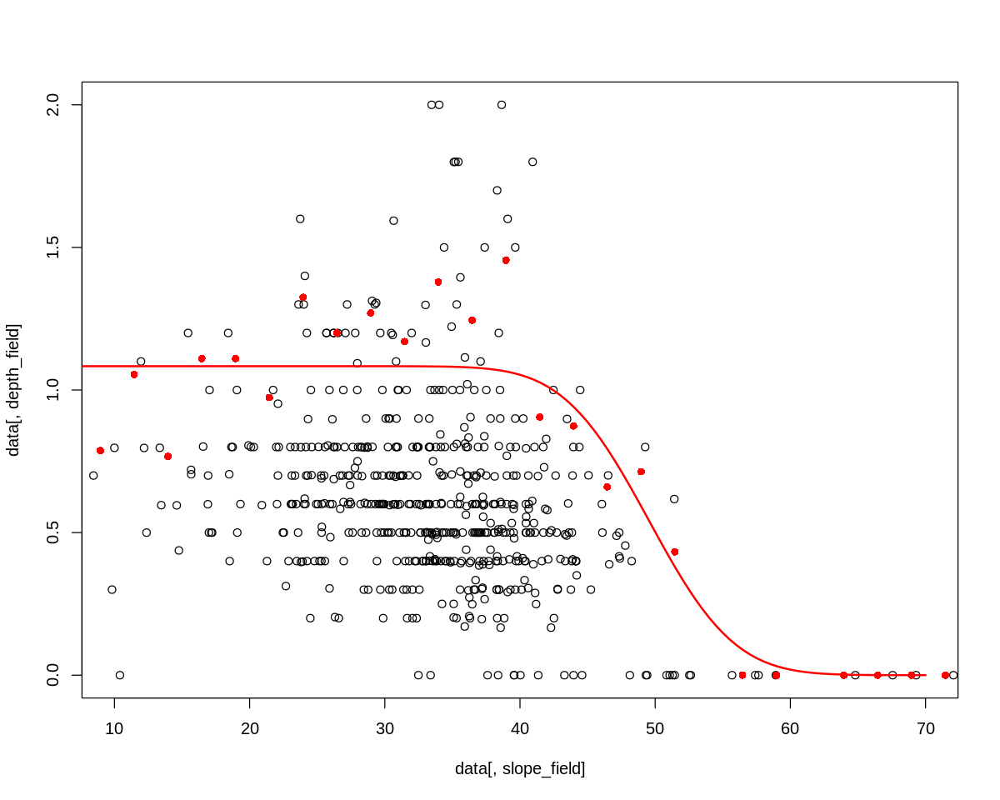

        a         b         c 
1.9392056 2.0574453 0.8984001 


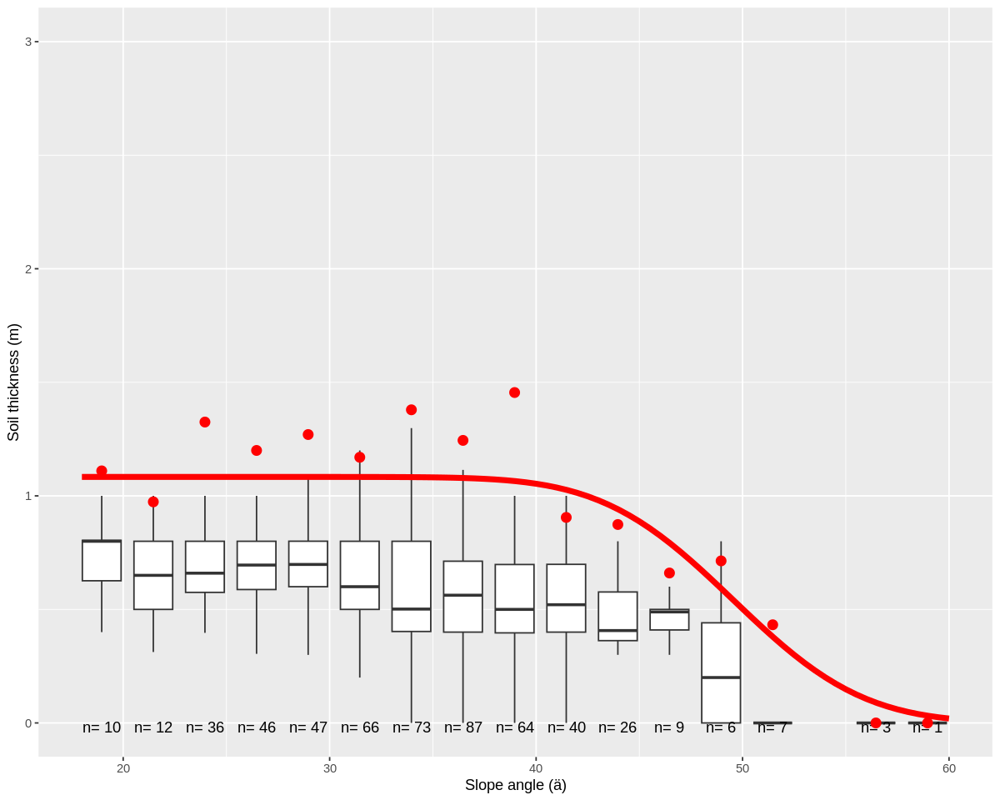

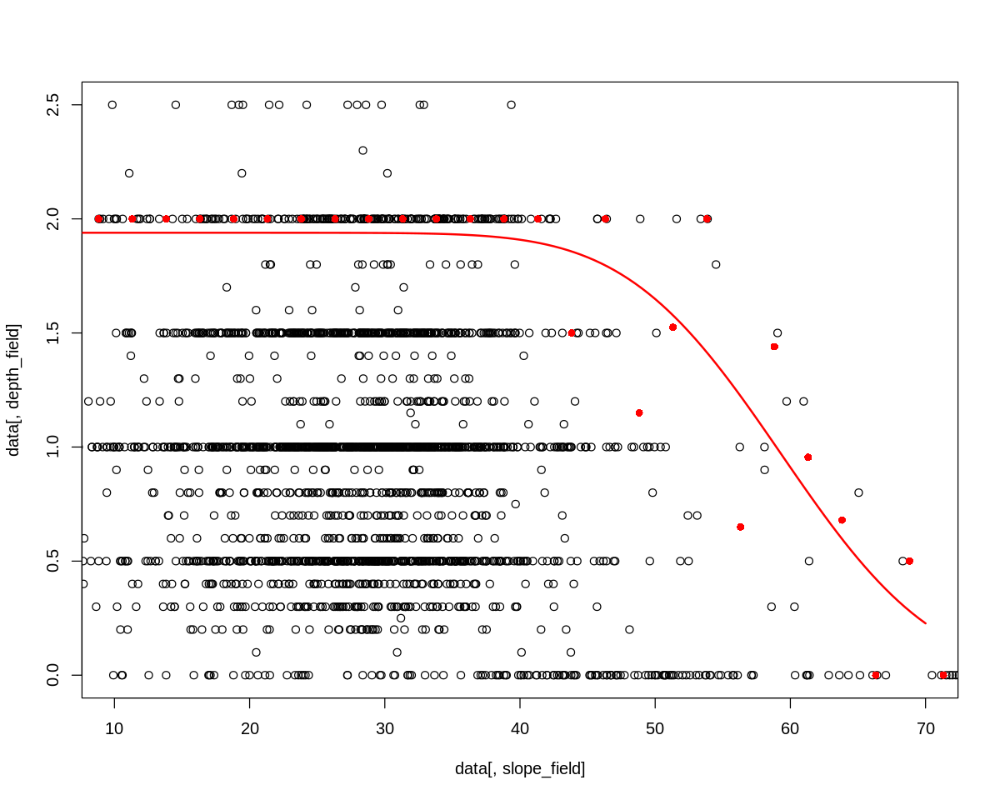

        a         b         c 
1.2927823 1.3987393 0.8480054 


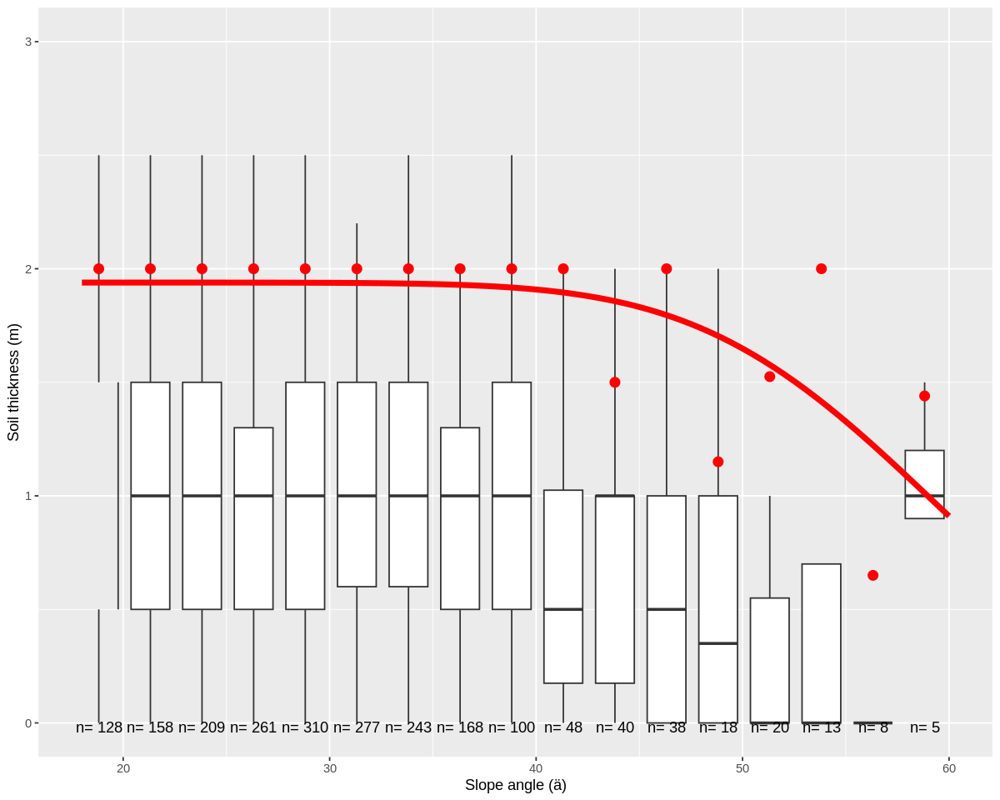

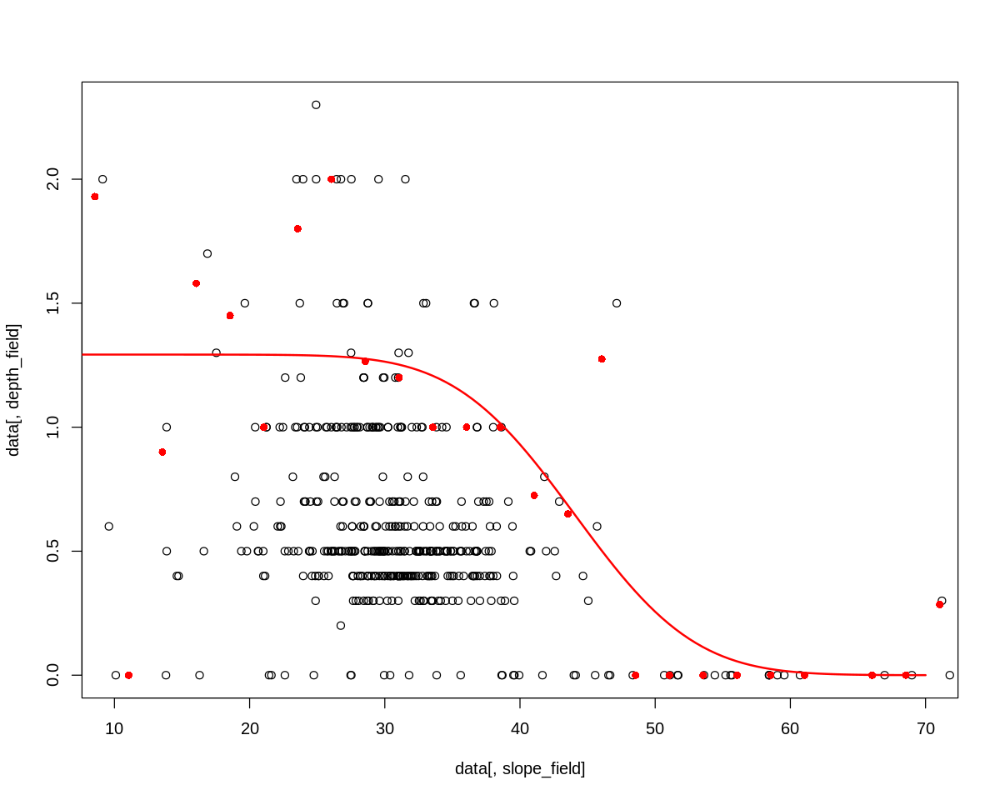

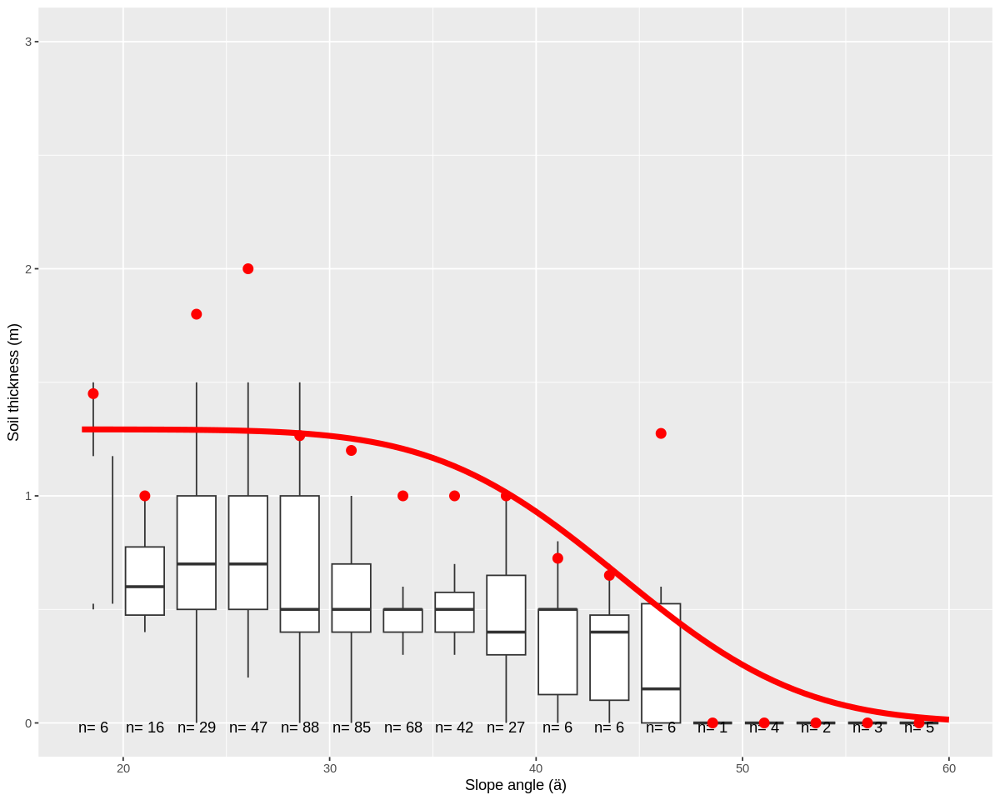

In [205]:
h_sfm_hmdb <- fit_h_sfm(data_train_hmdb,seed=seed, slope_field="slope_10")
h_sfm_storme <- fit_h_sfm(data_train_storme,seed=seed, slope_field="slope_10")
h_sfm_be <- fit_h_sfm(data_train_be,seed=seed, slope_field="slope_10")

        a         b         c 
1.0736329 1.4871360 0.5551847 


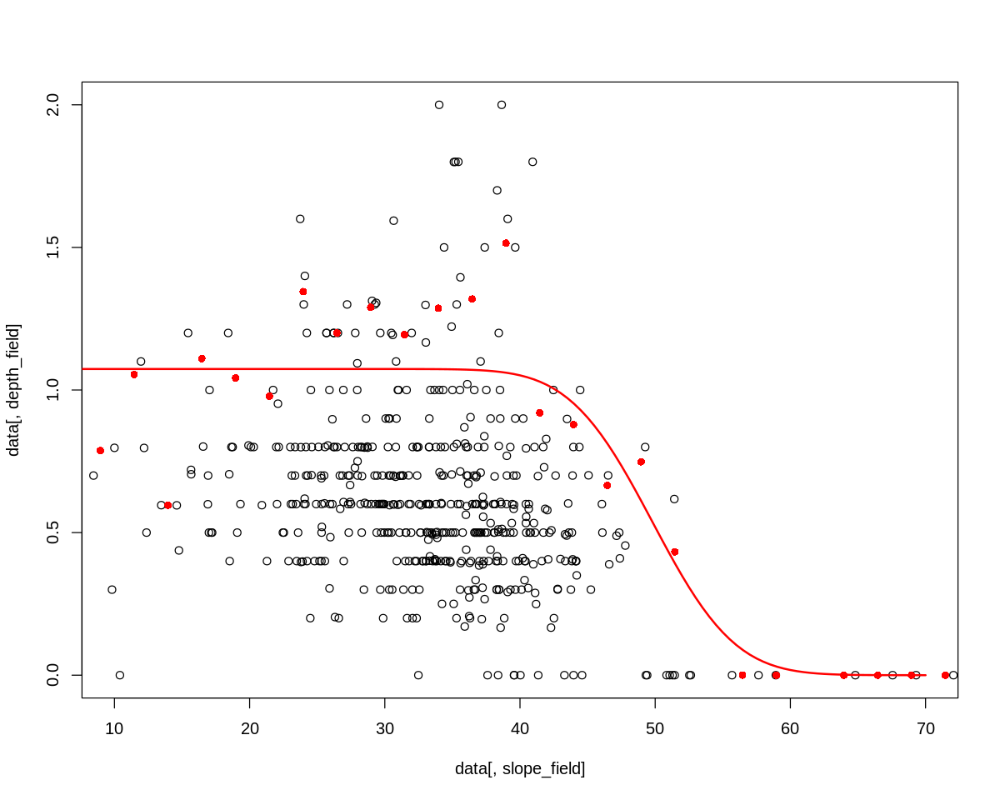

       a        b        c 
1.101947 1.487027 0.552684 


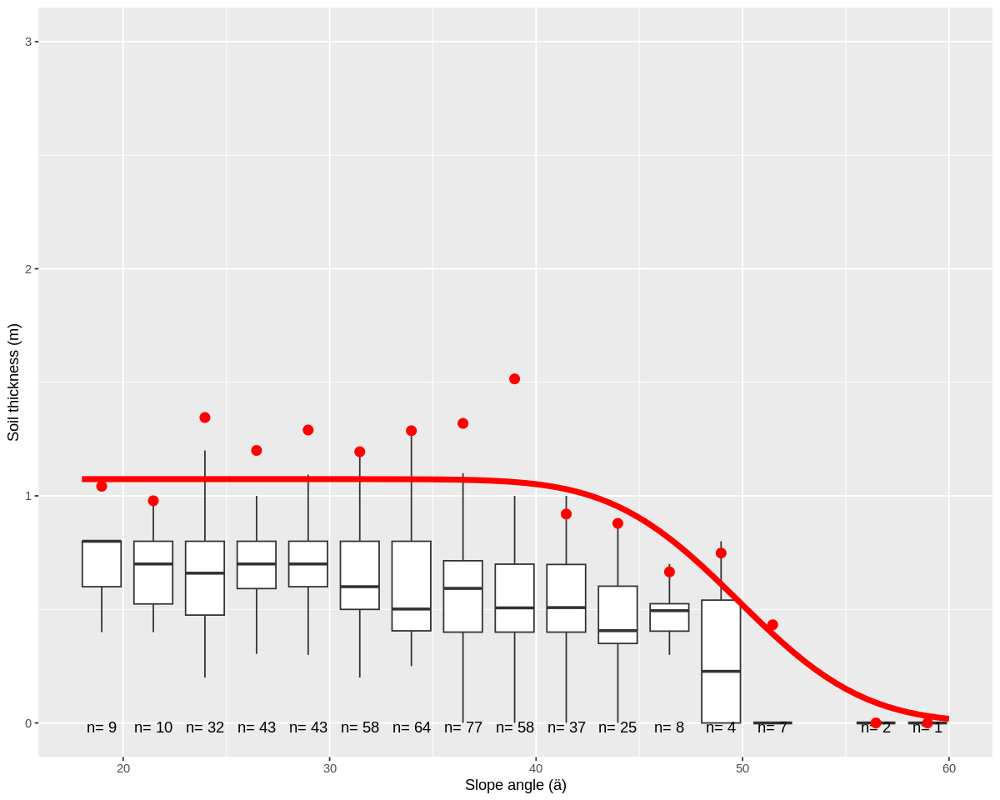

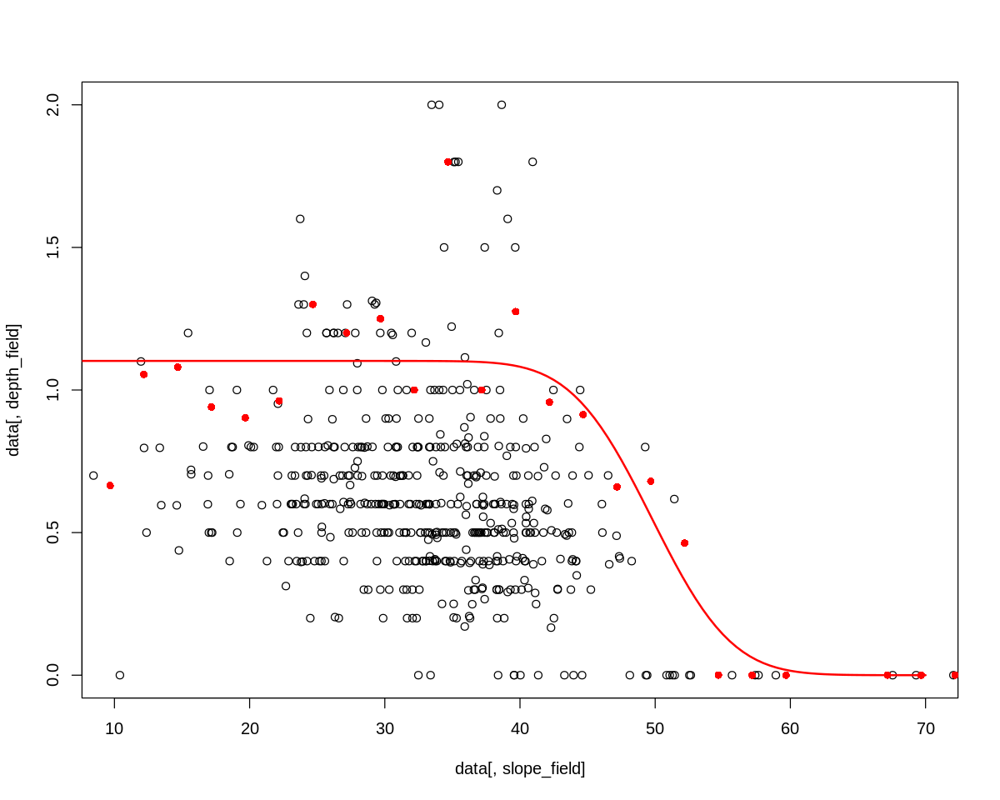

       a        b        c 
1.087170 1.486262 0.597576 


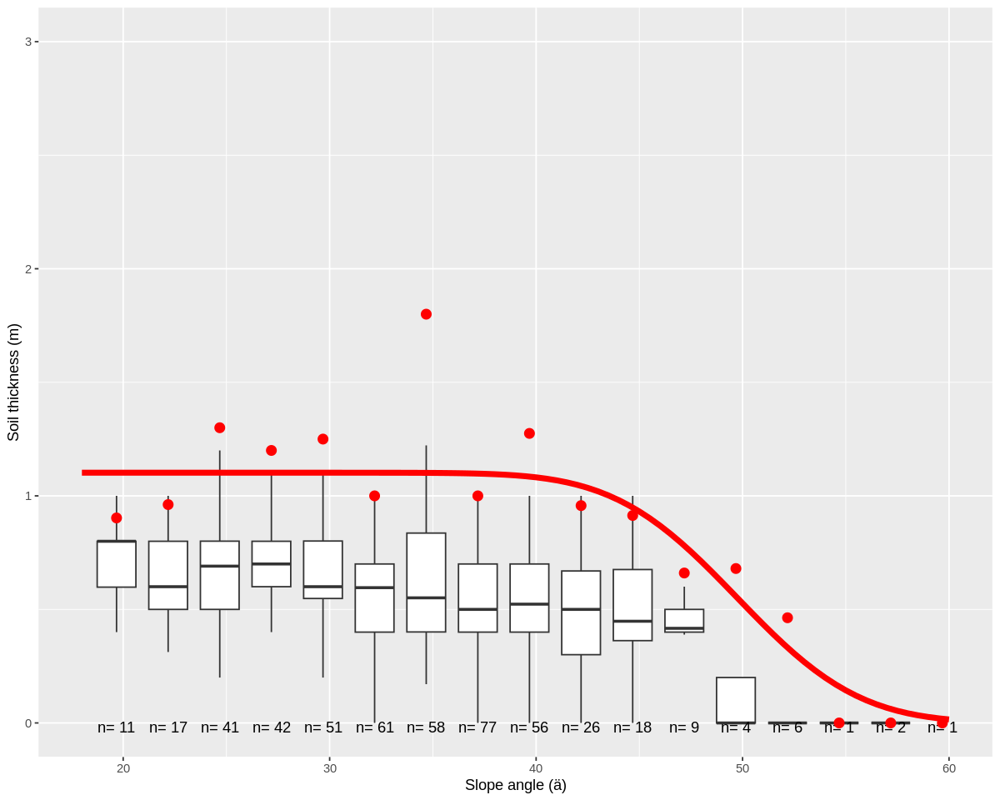

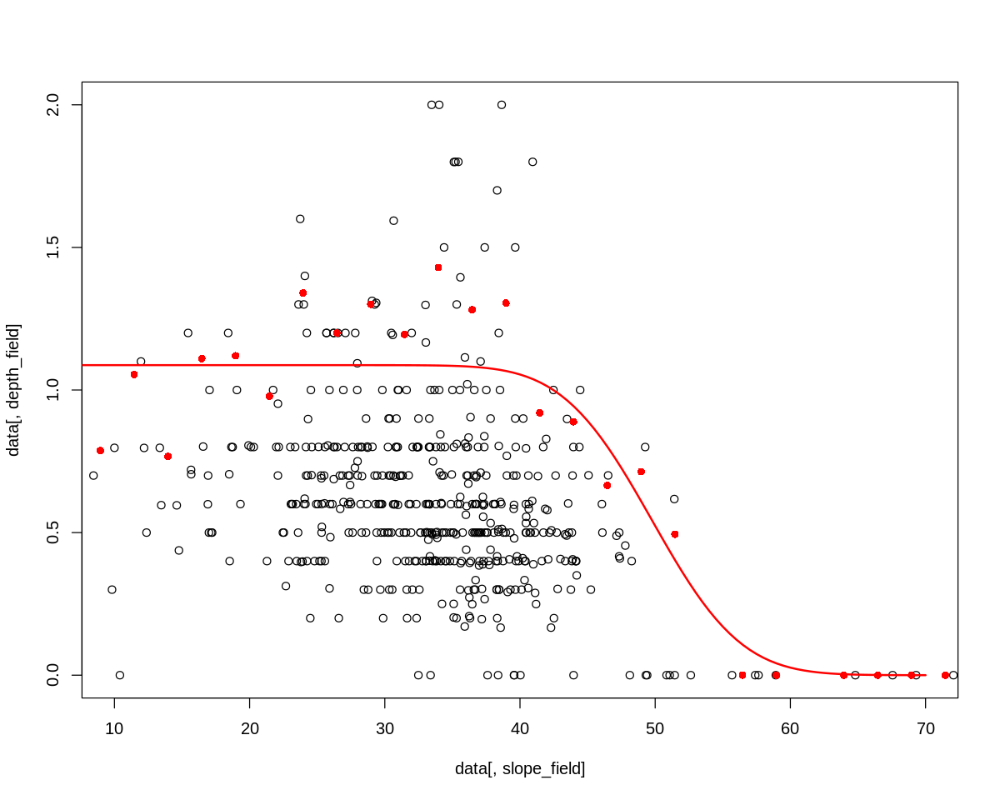

        a         b         c 
1.0769893 1.4695485 0.6237852 


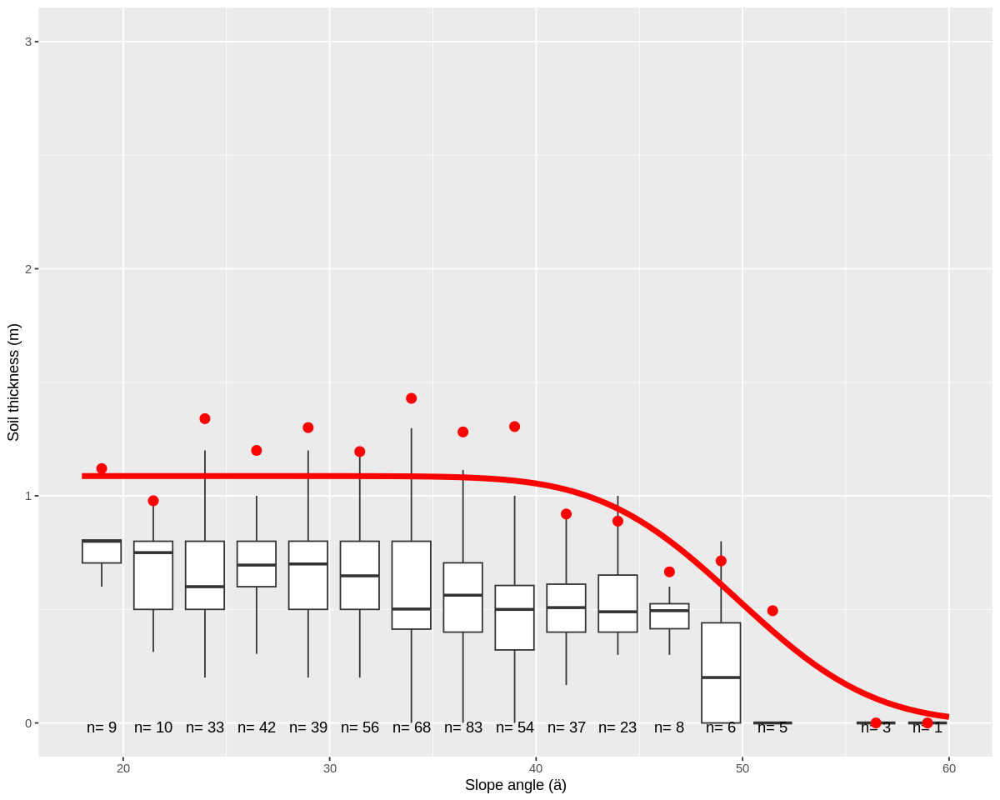

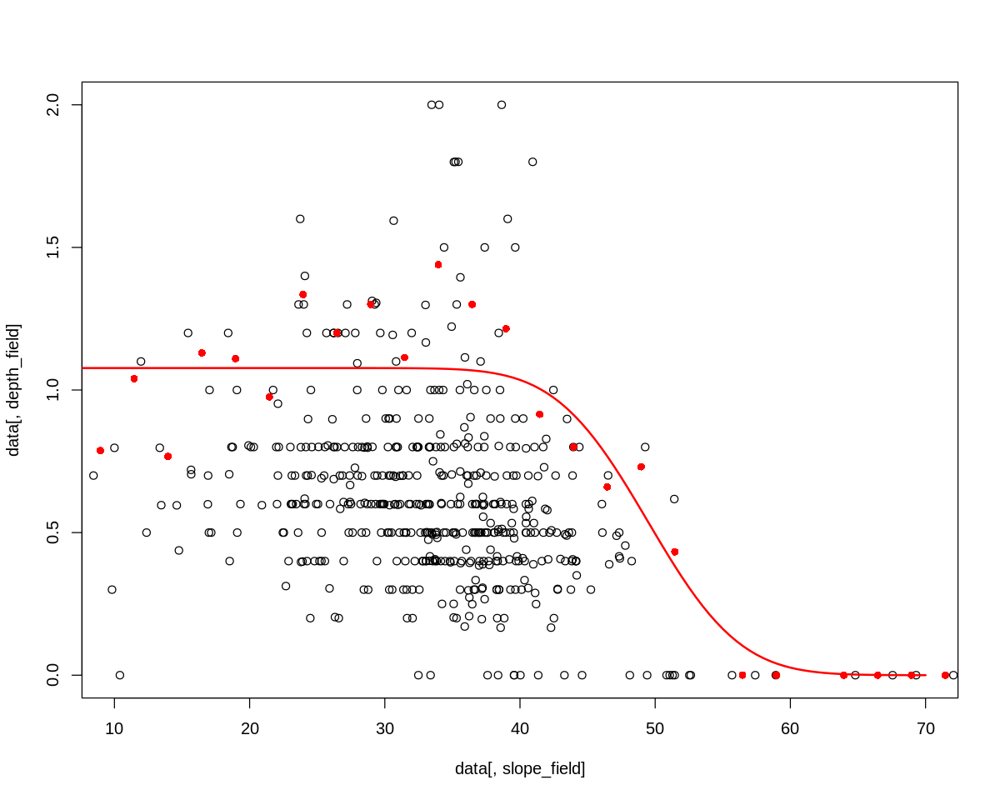

        a         b         c 
1.0617991 1.4837471 0.5950339 


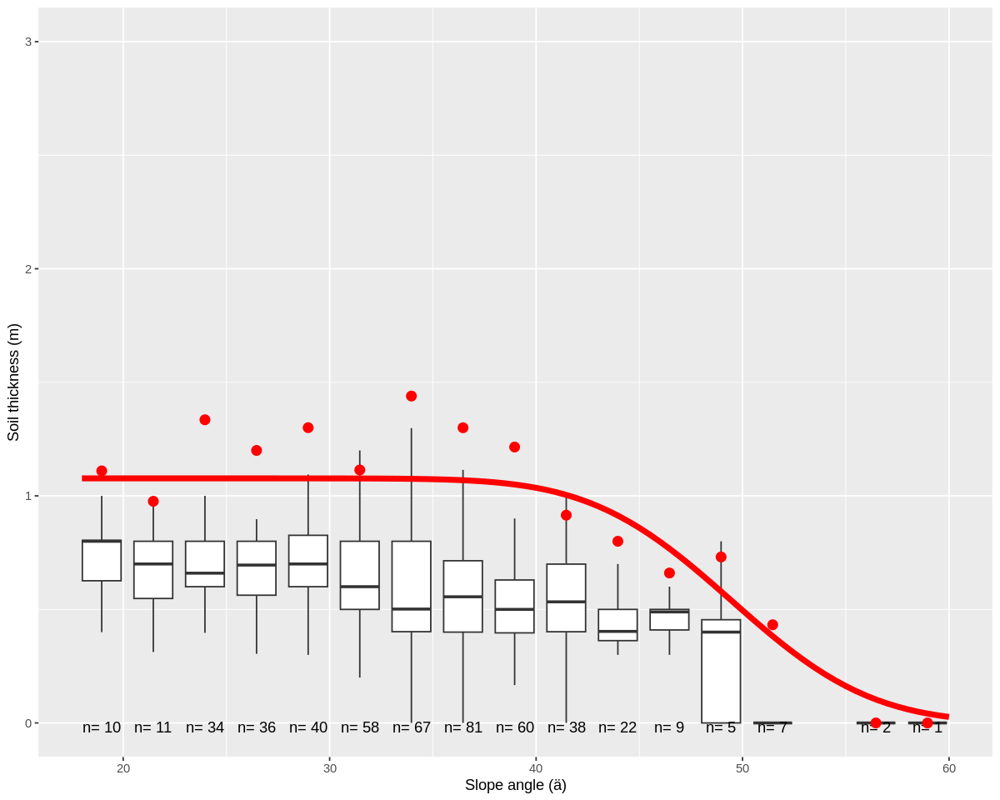

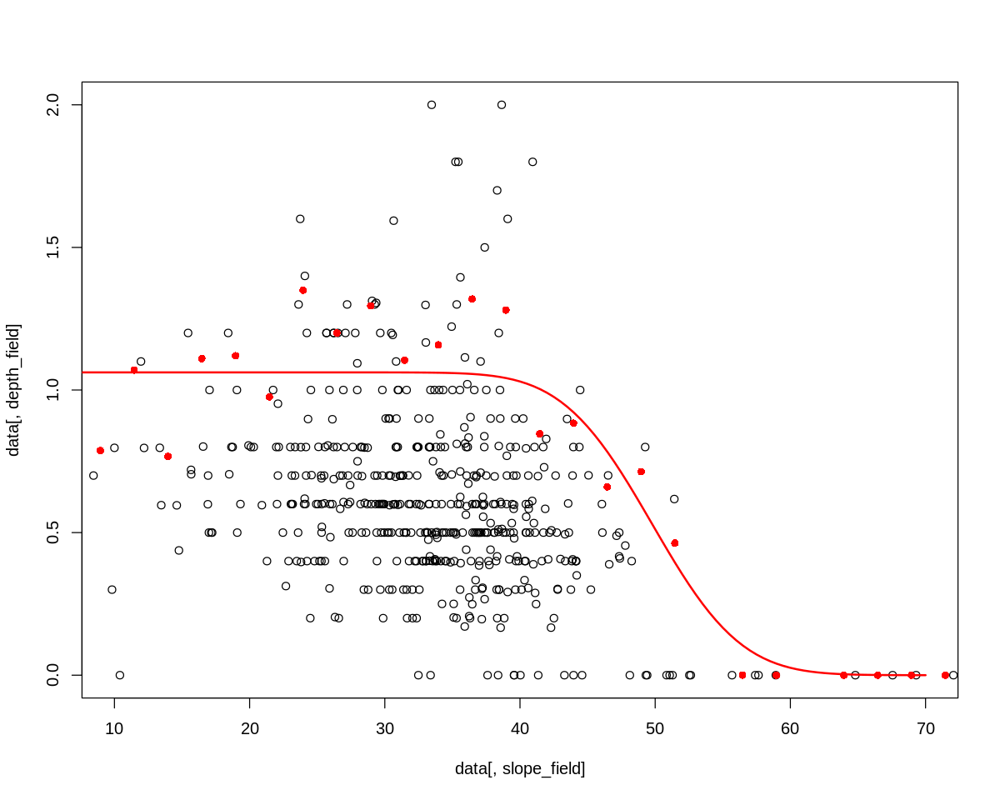

        a         b         c 
1.0665546 1.4941469 0.5885479 


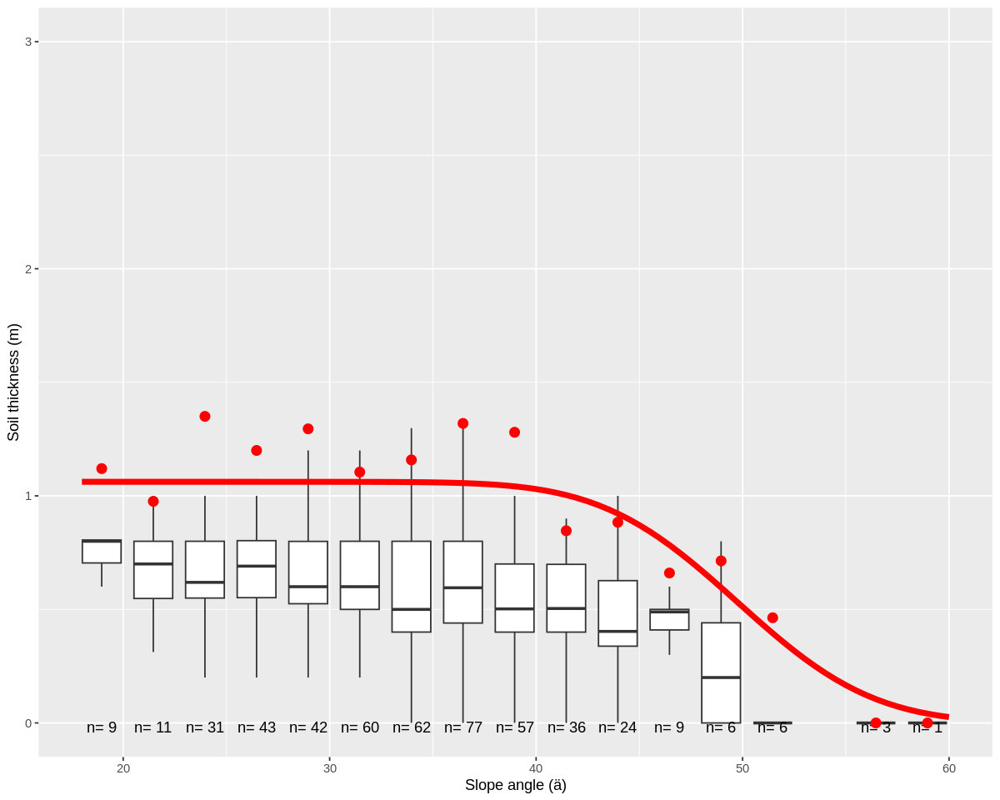

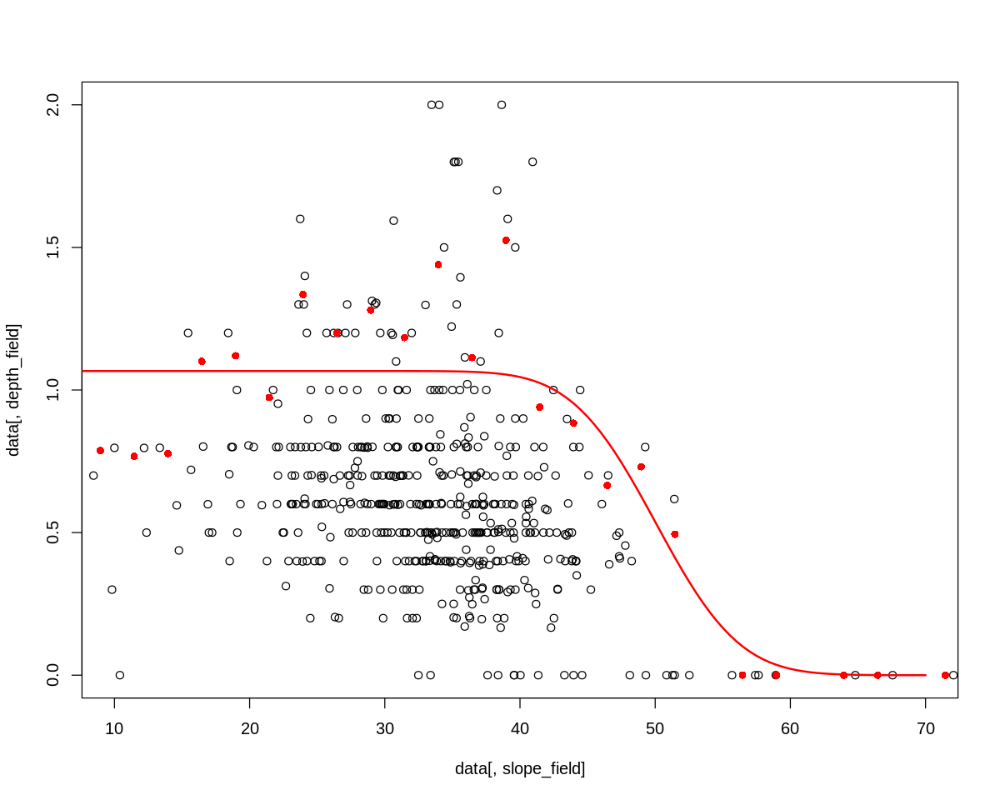

        a         b         c 
1.1363243 1.4281733 0.5899528 


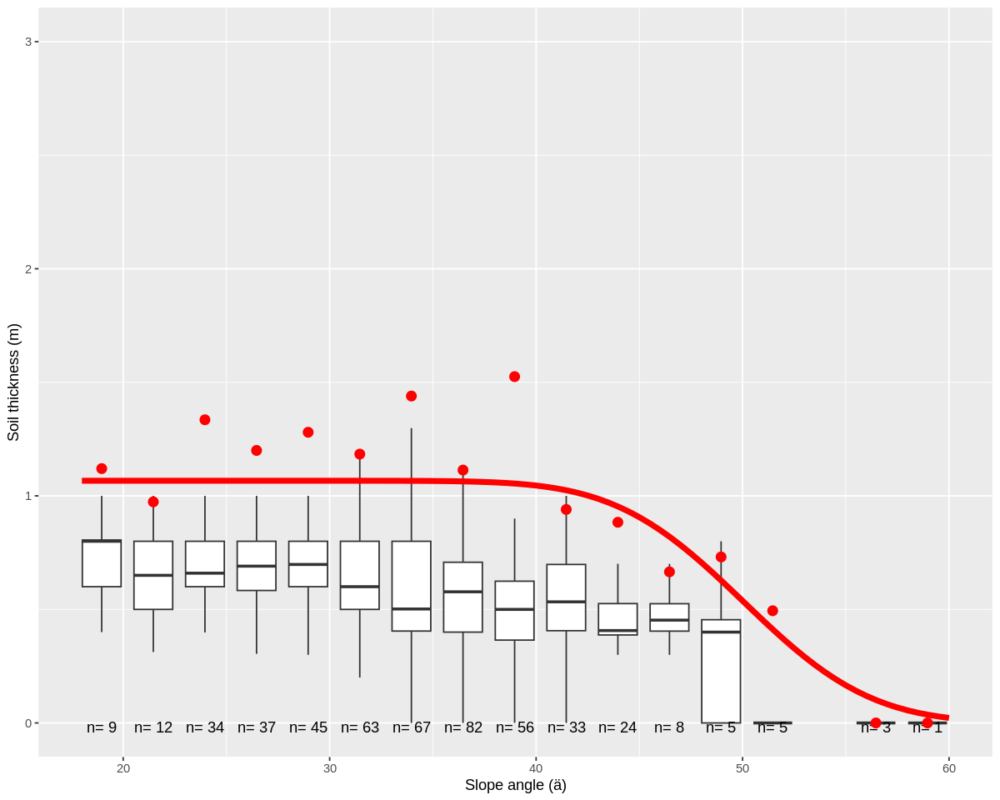

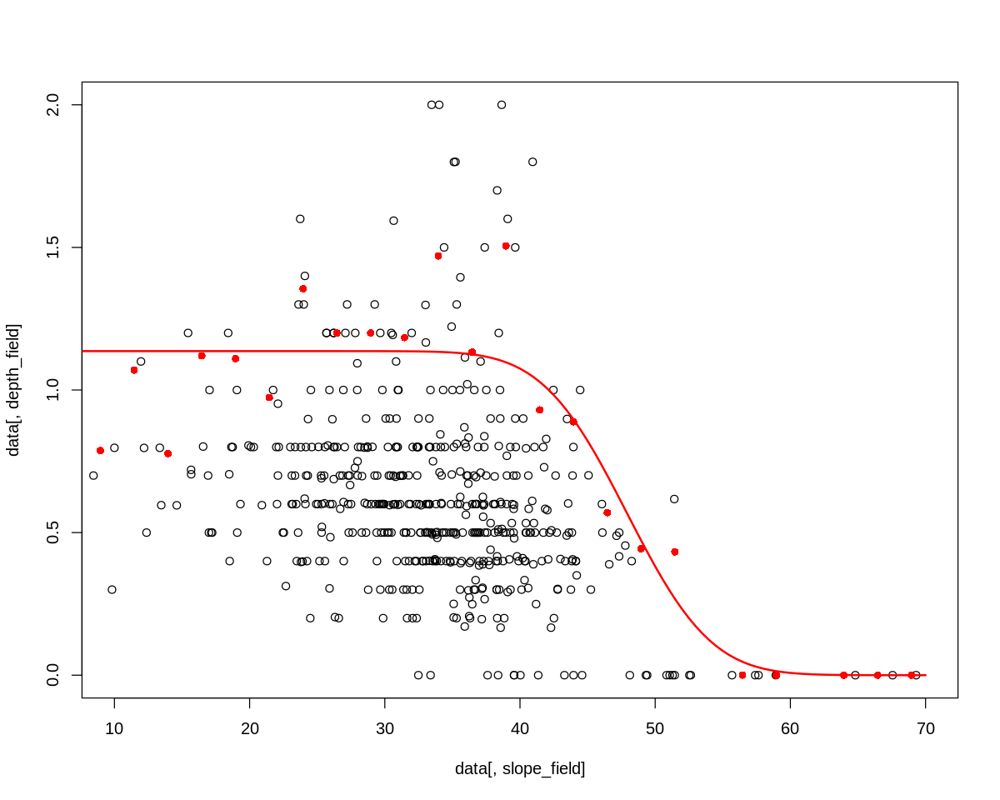

        a         b         c 
1.0907802 1.4382374 0.4370589 


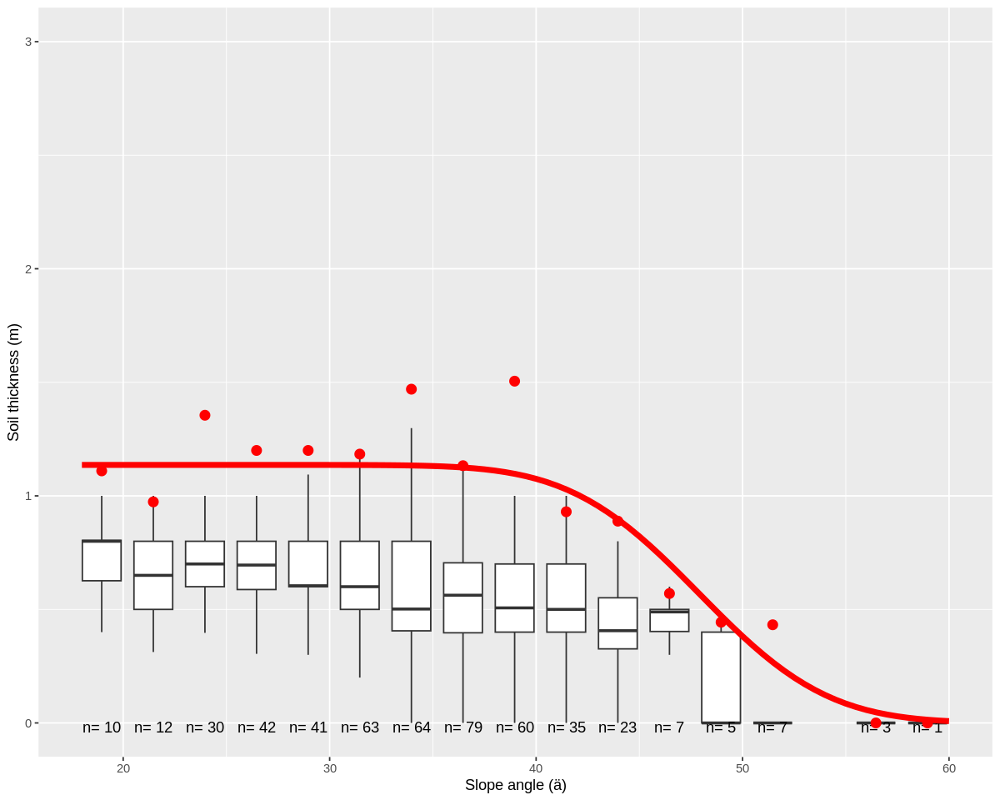

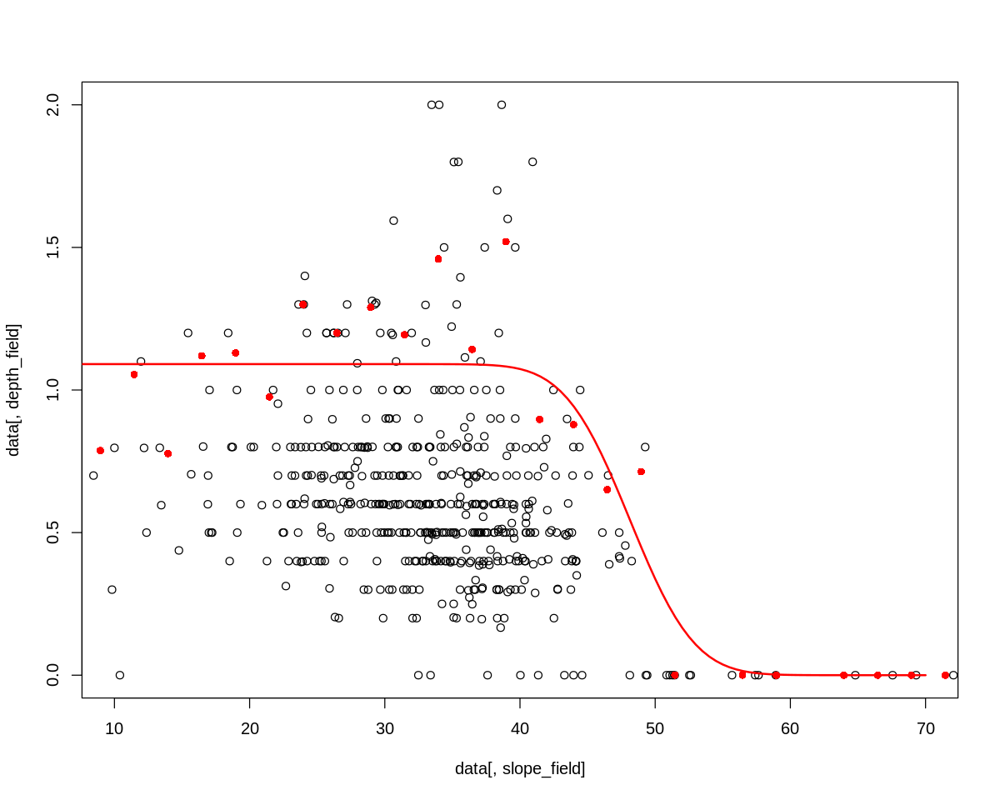

        a         b         c 
1.0803264 1.4804938 0.6036705 


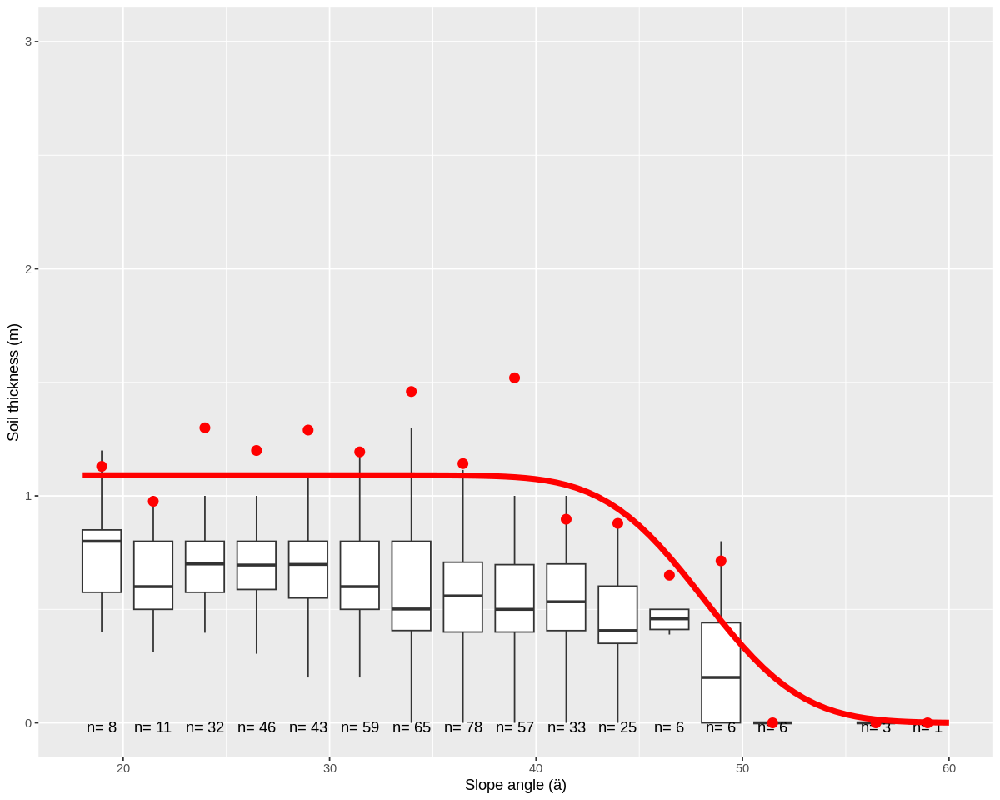

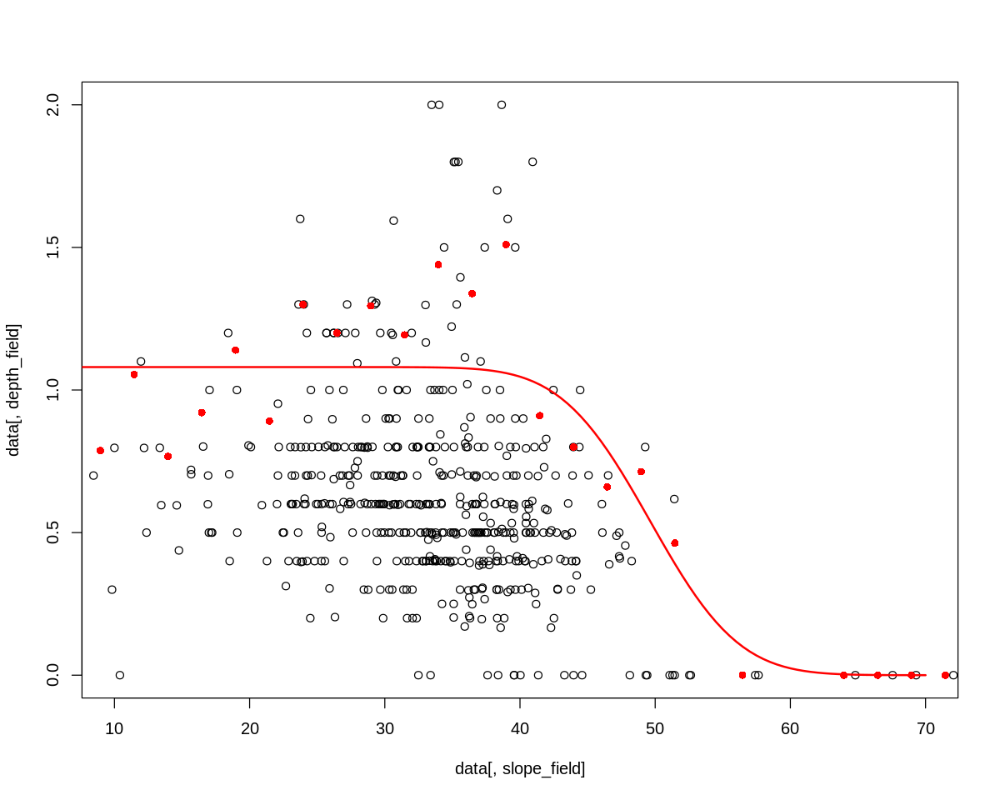

        a         b         c 
1.0653628 1.4770976 0.6017591 


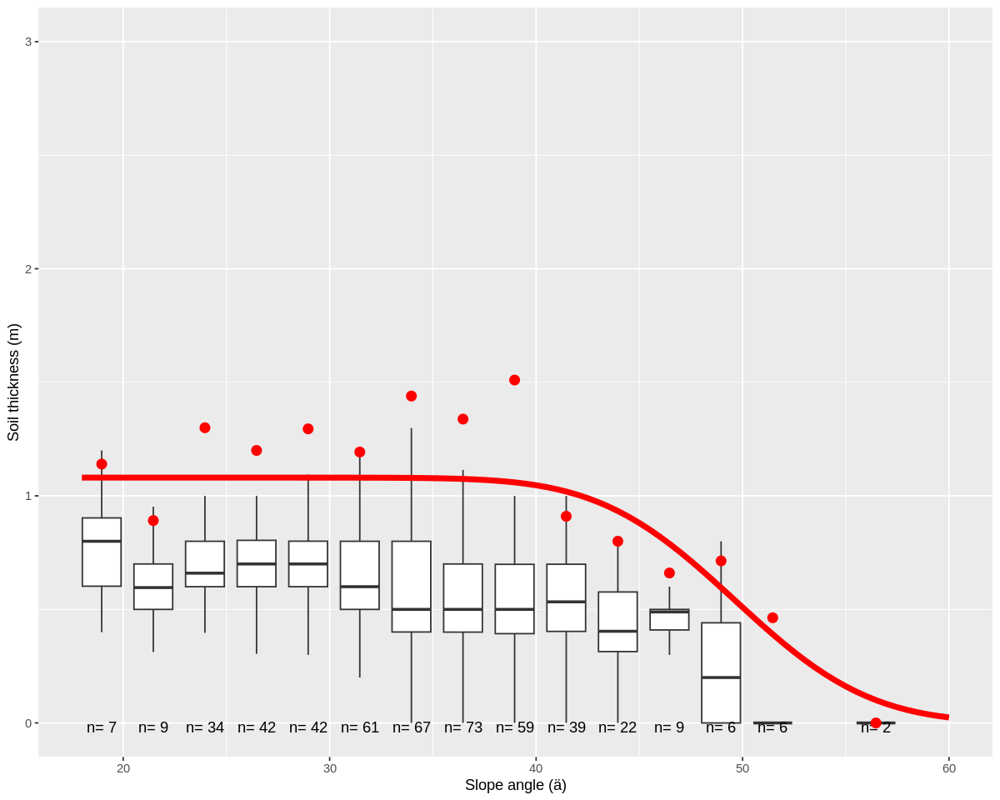

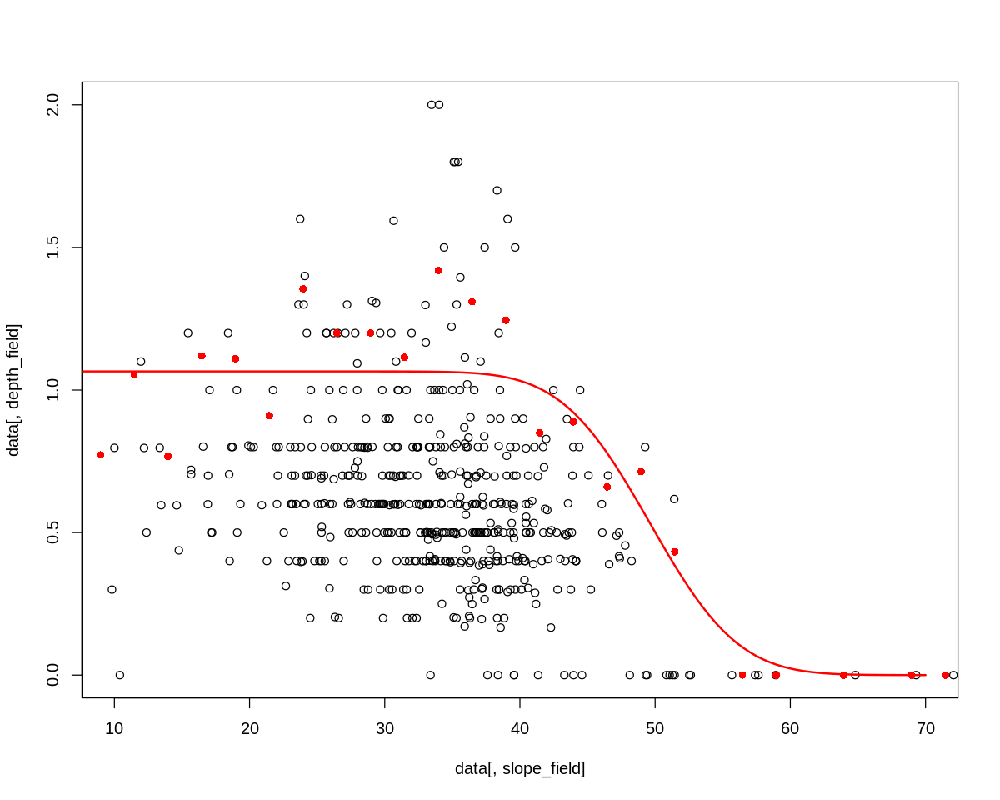

[1] "Best result : Nr.10"
       a        b        c 
1.956981 2.015697 1.053331 


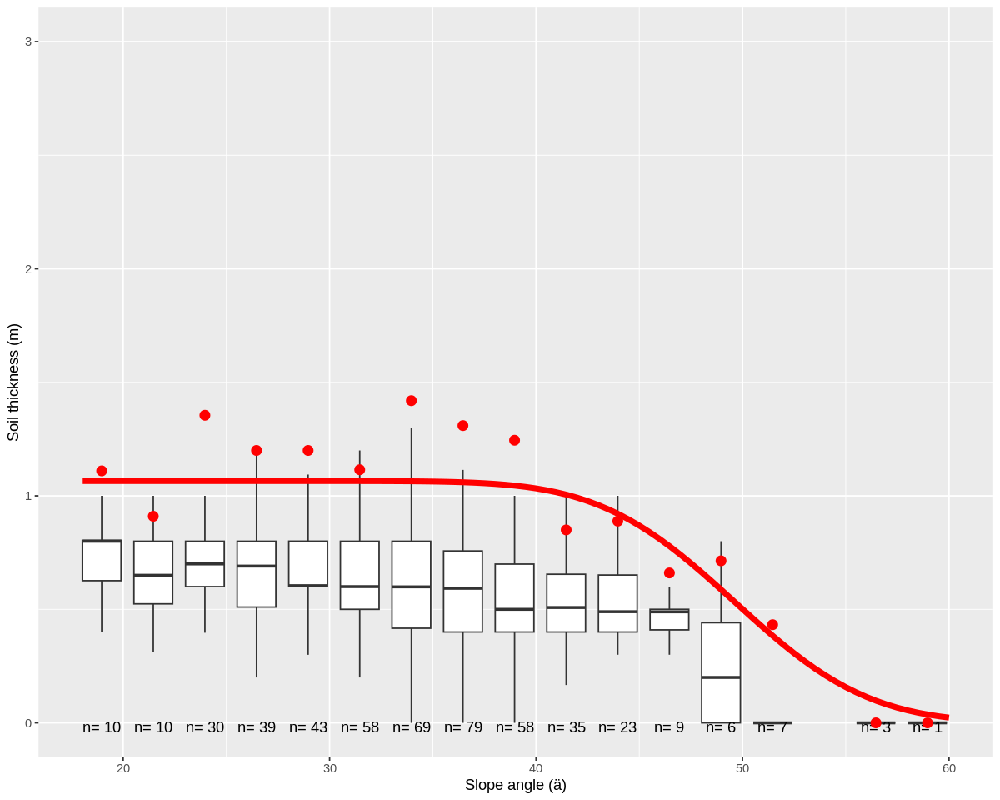

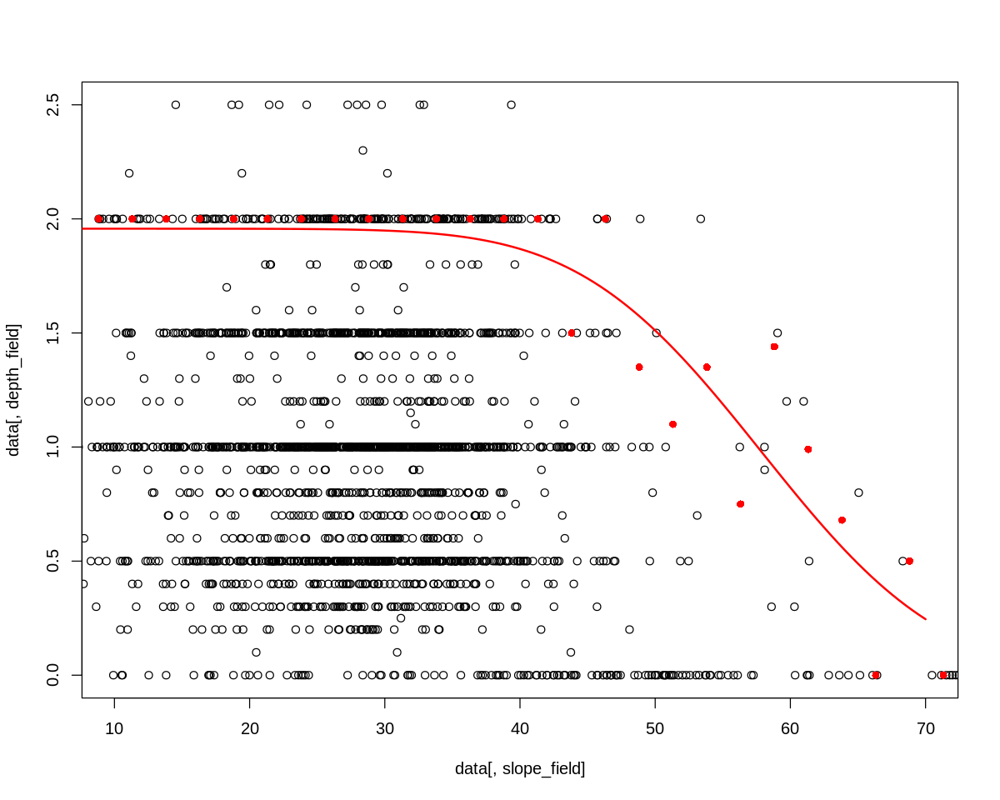

        a         b         c 
1.8918160 2.0403645 0.7255204 


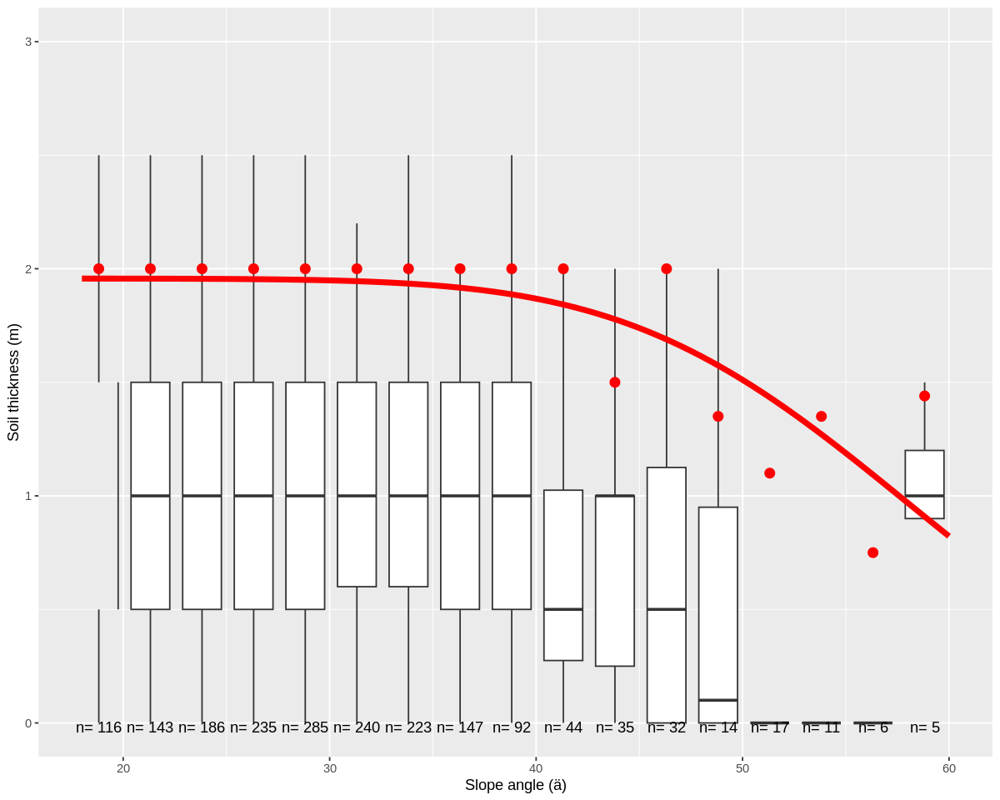

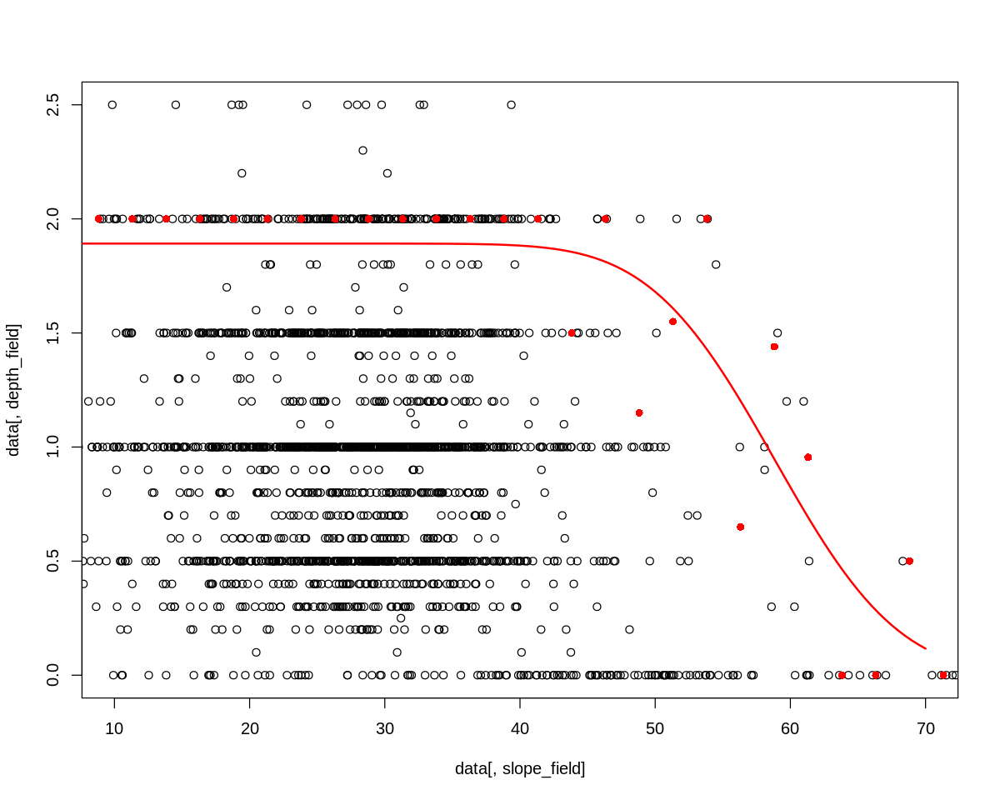

        a         b         c 
1.9387819 2.0657214 0.8688324 


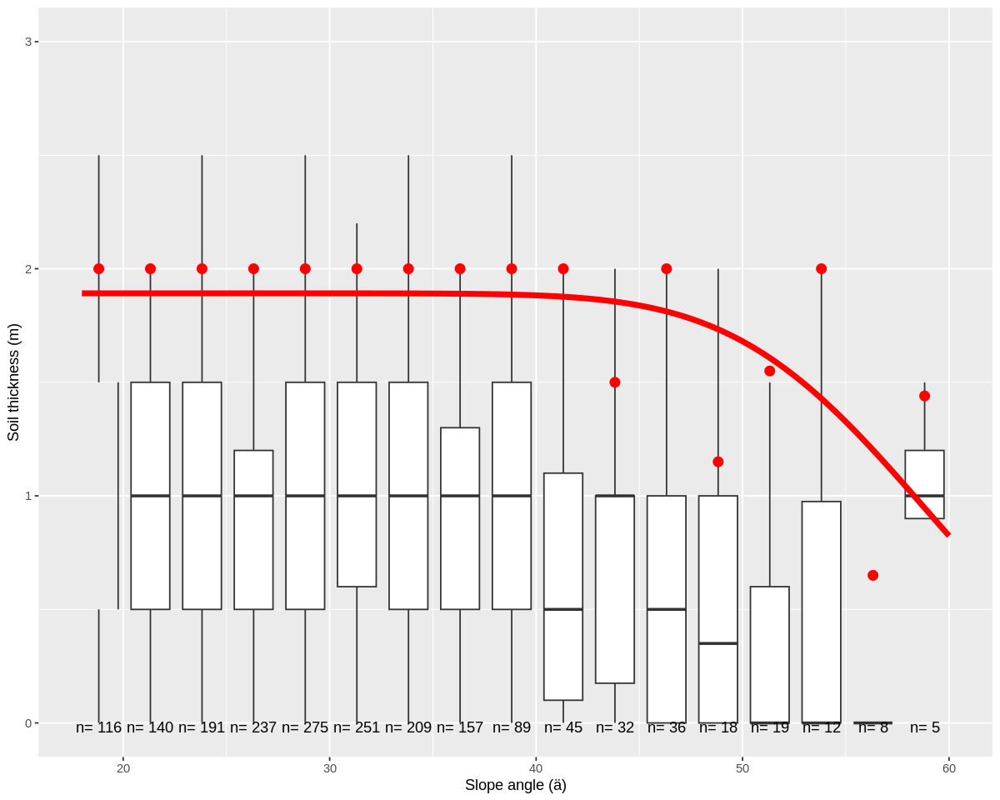

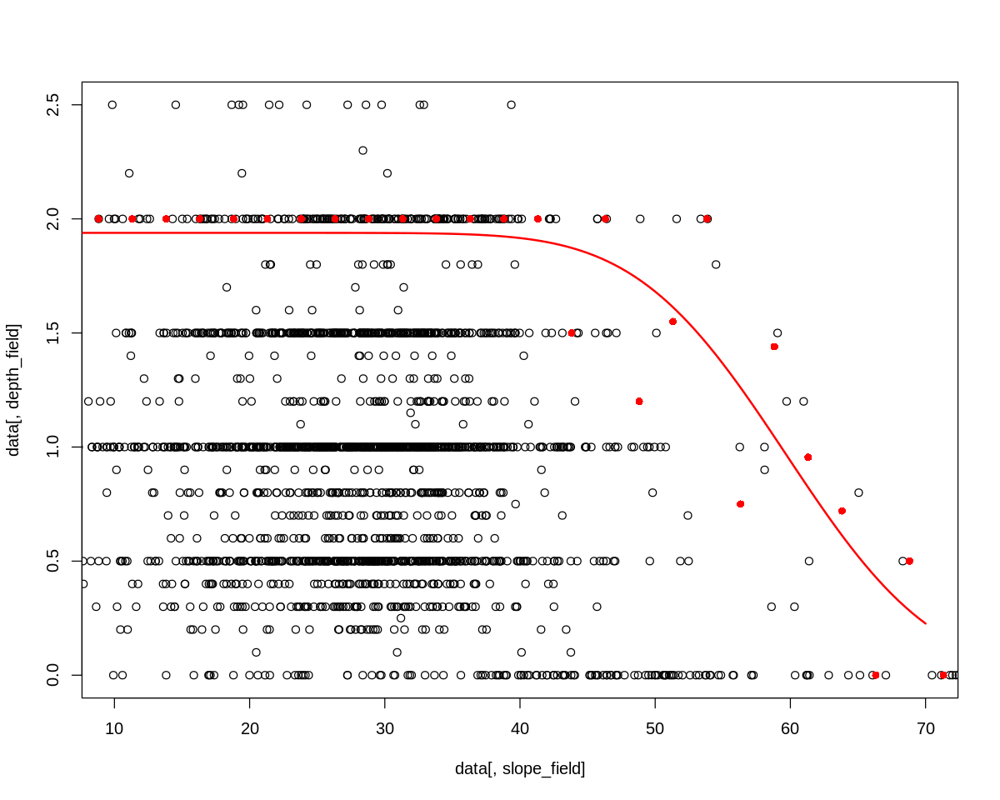

        a         b         c 
1.8940096 2.1065087 0.6270308 


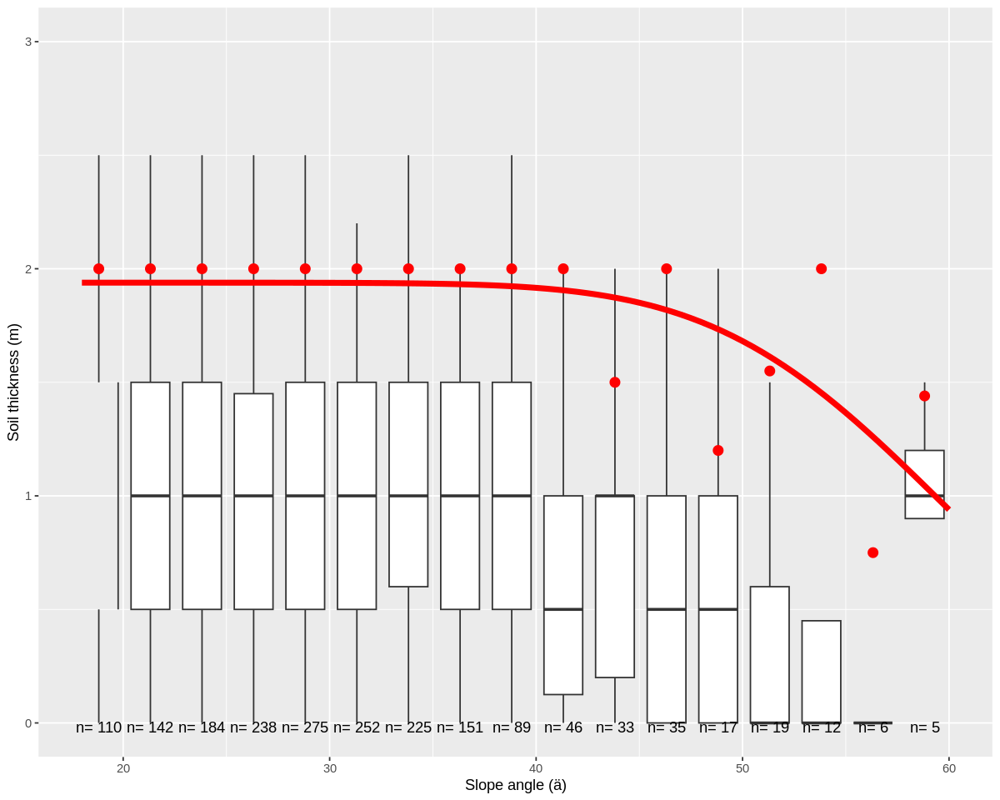

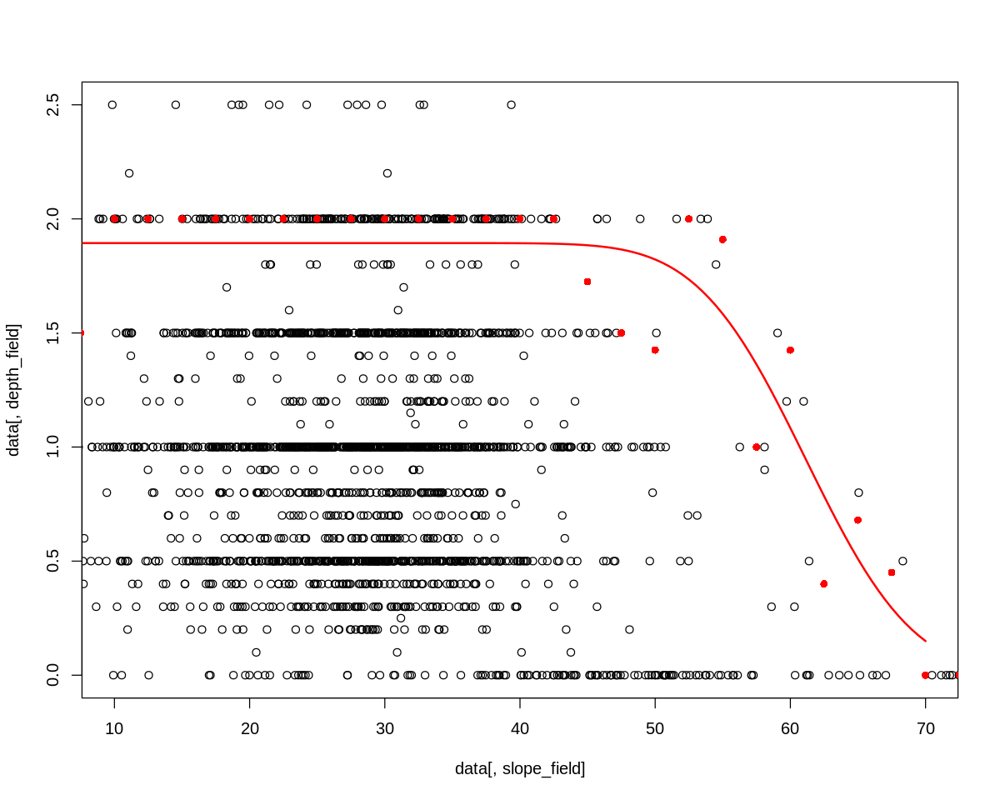

        a         b         c 
1.9331321 2.0555470 0.8376845 


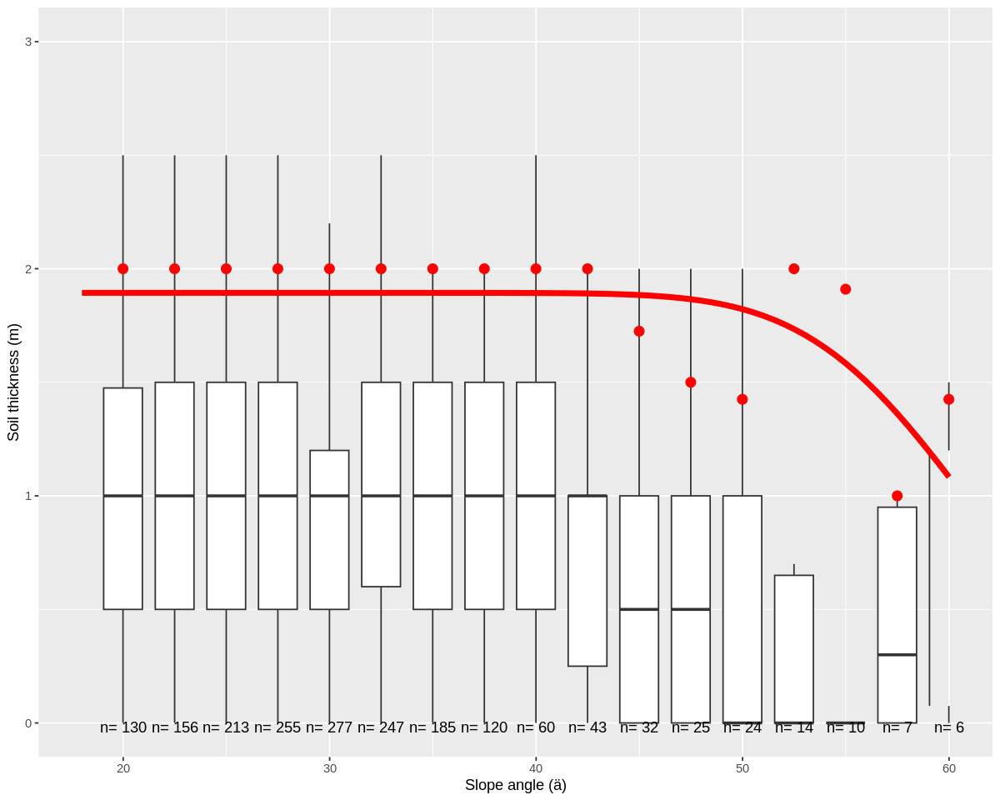

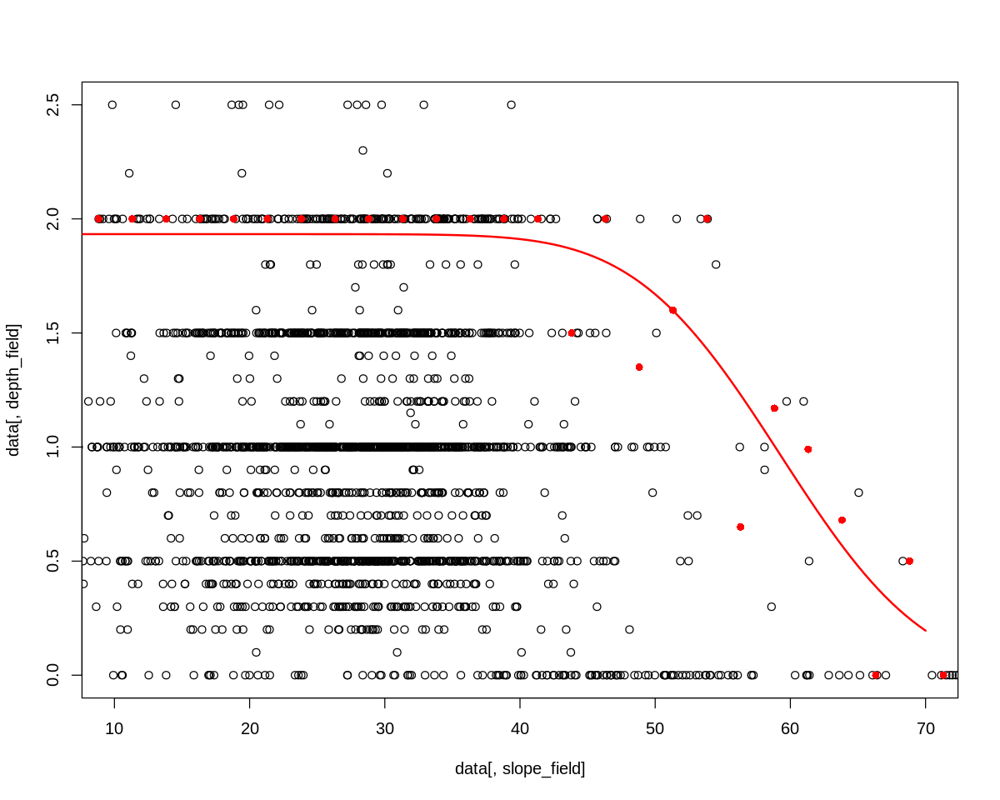

        a         b         c 
1.9455838 2.0473392 0.9118621 


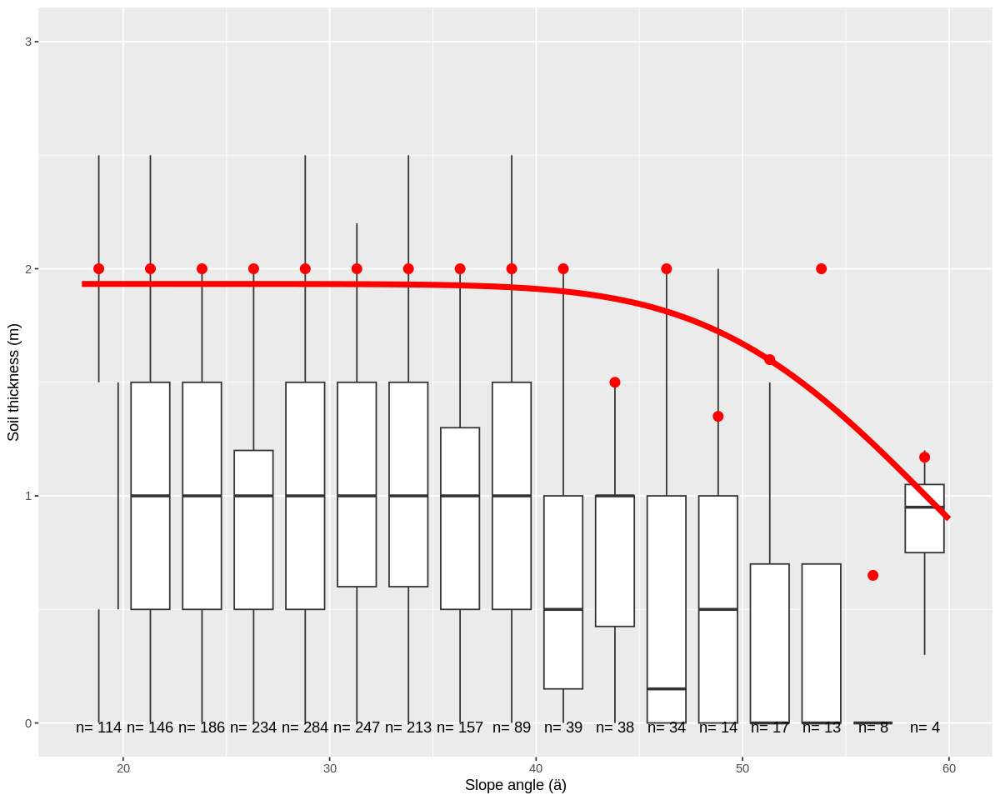

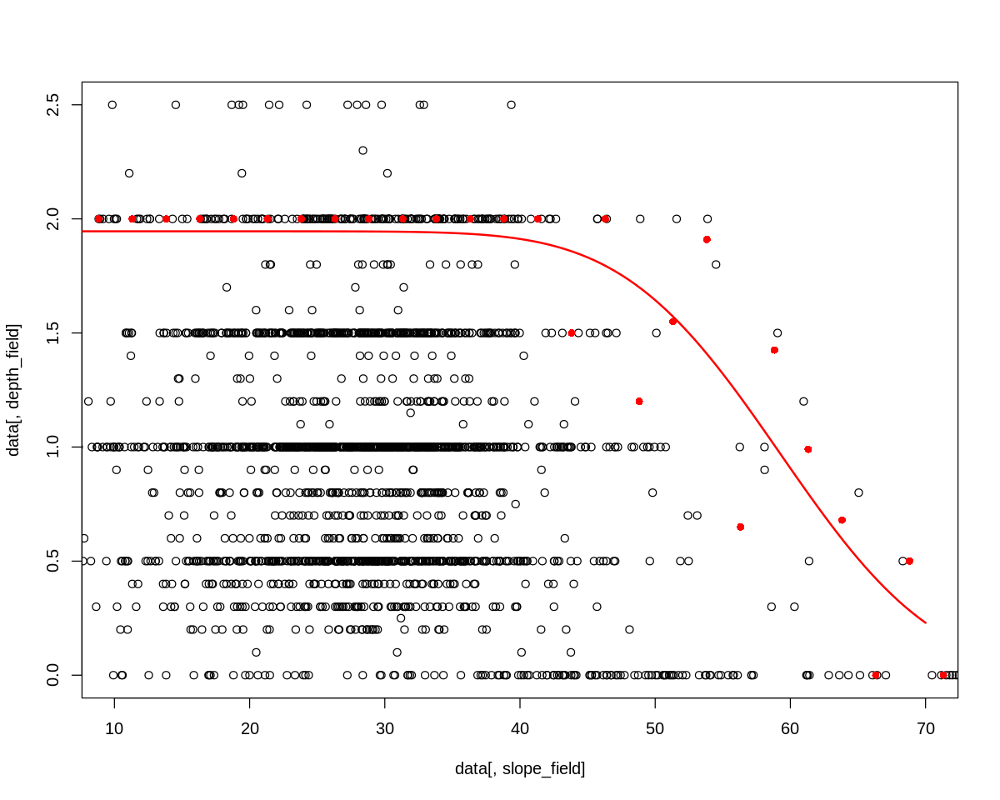

        a         b         c 
1.9574112 2.0404469 0.9379636 


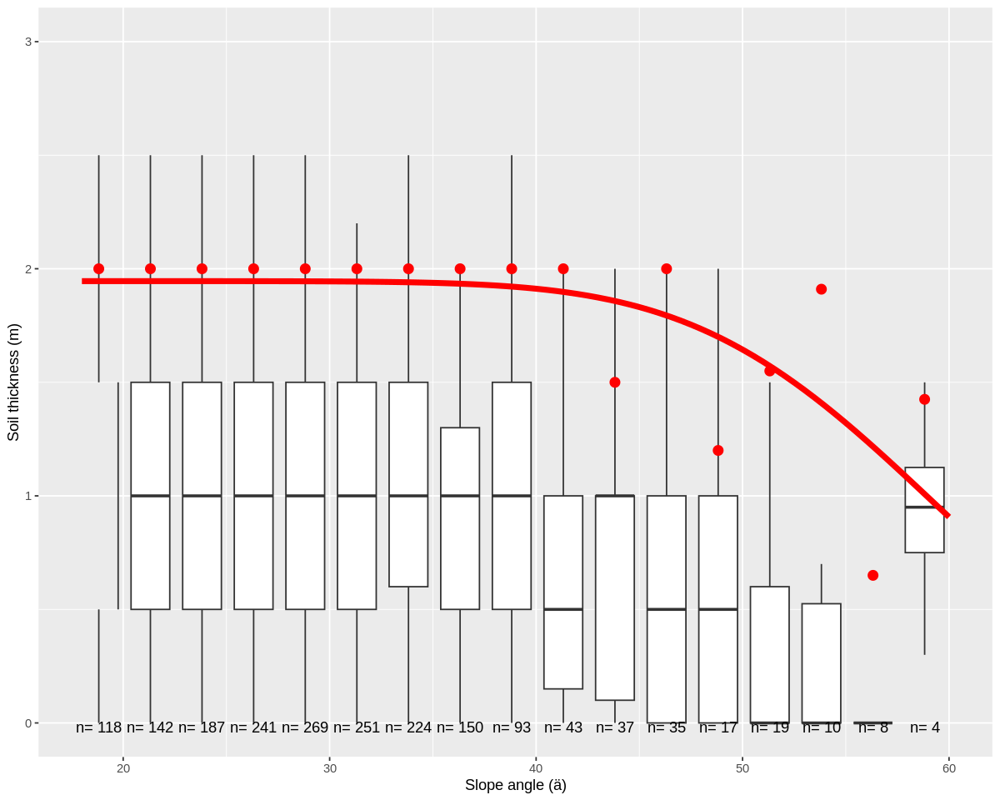

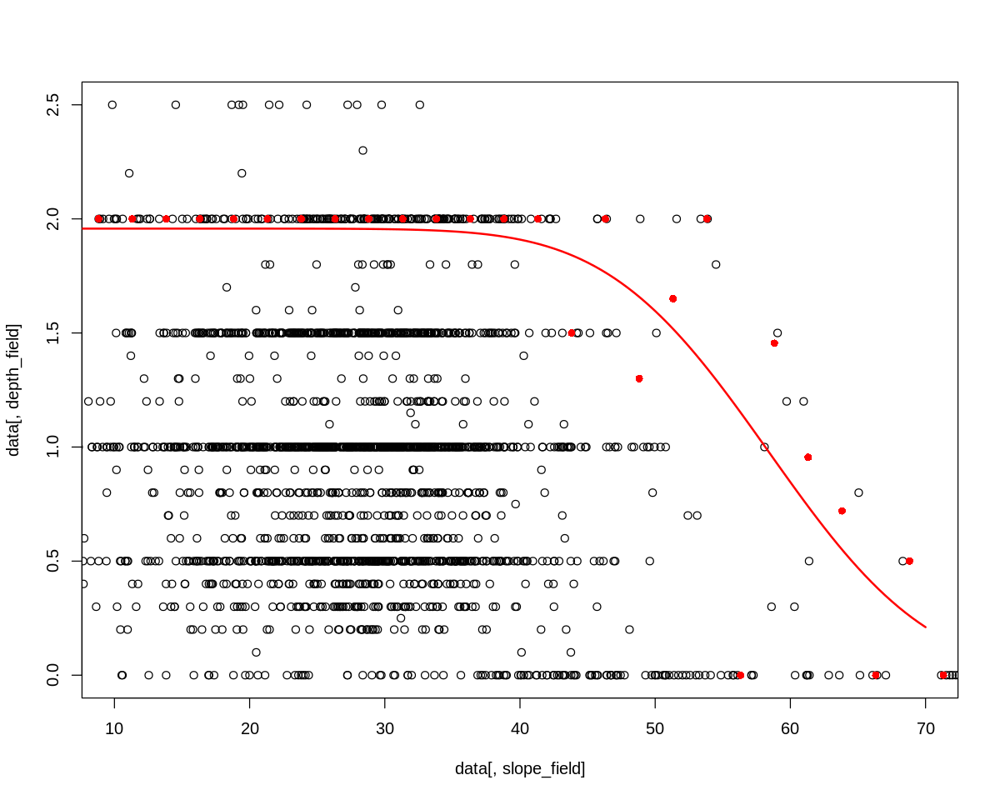

       a        b        c 
1.949462 2.041104 1.078105 


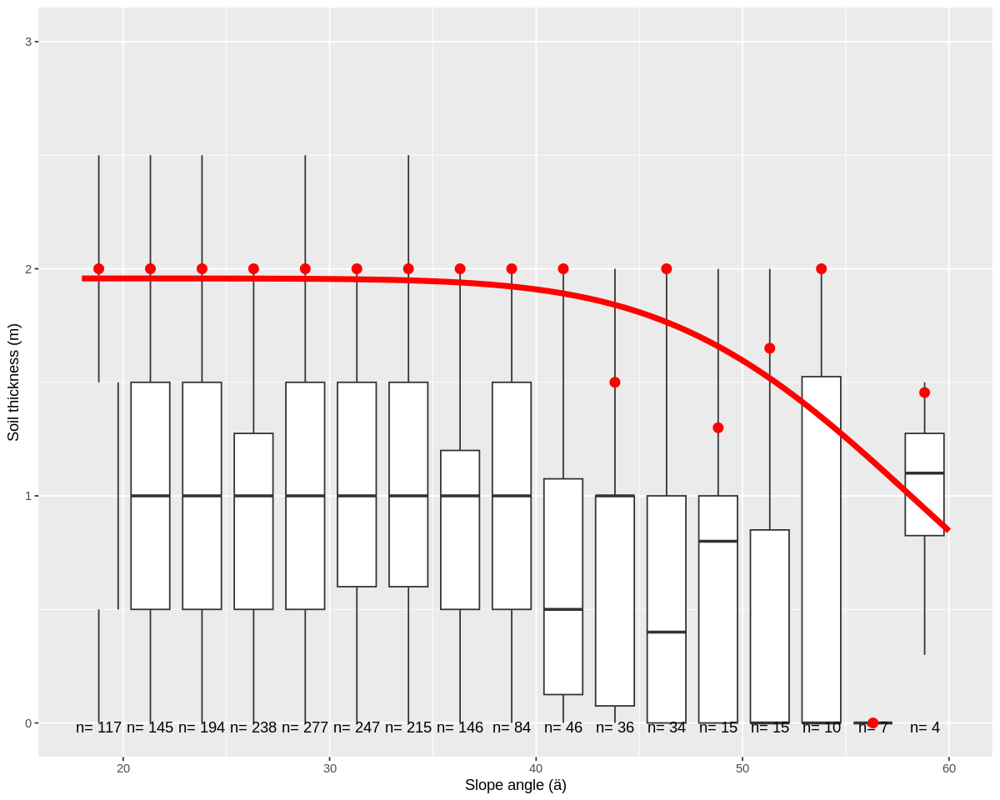

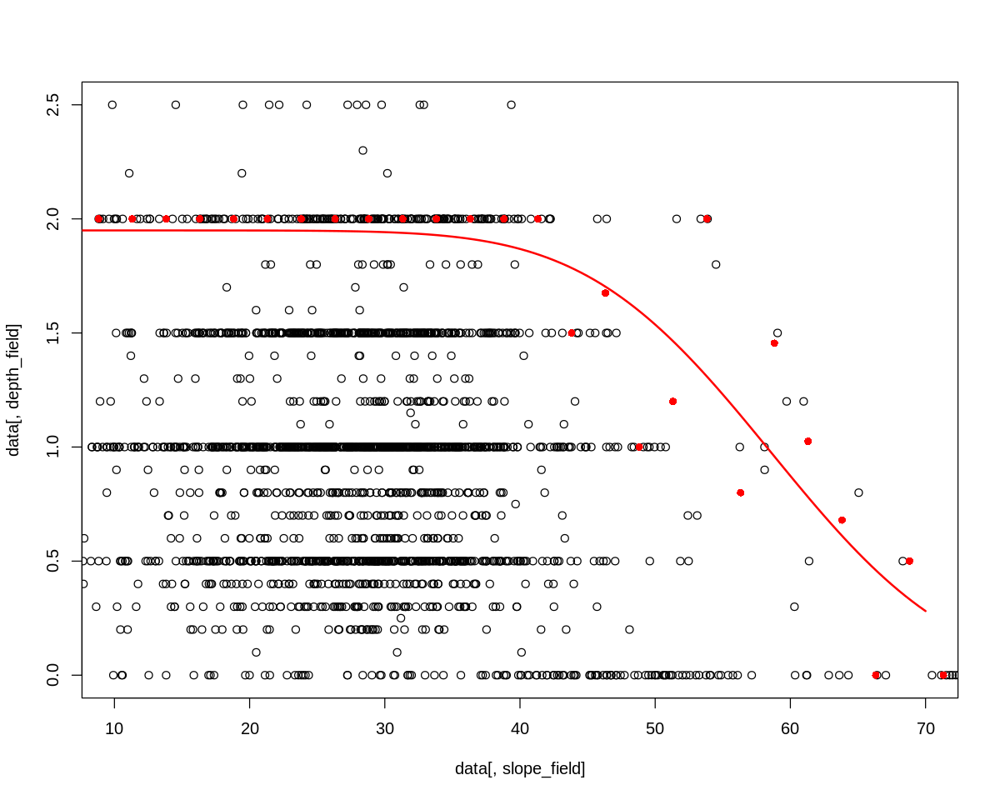

        a         b         c 
1.9476432 2.0211644 0.8695584 


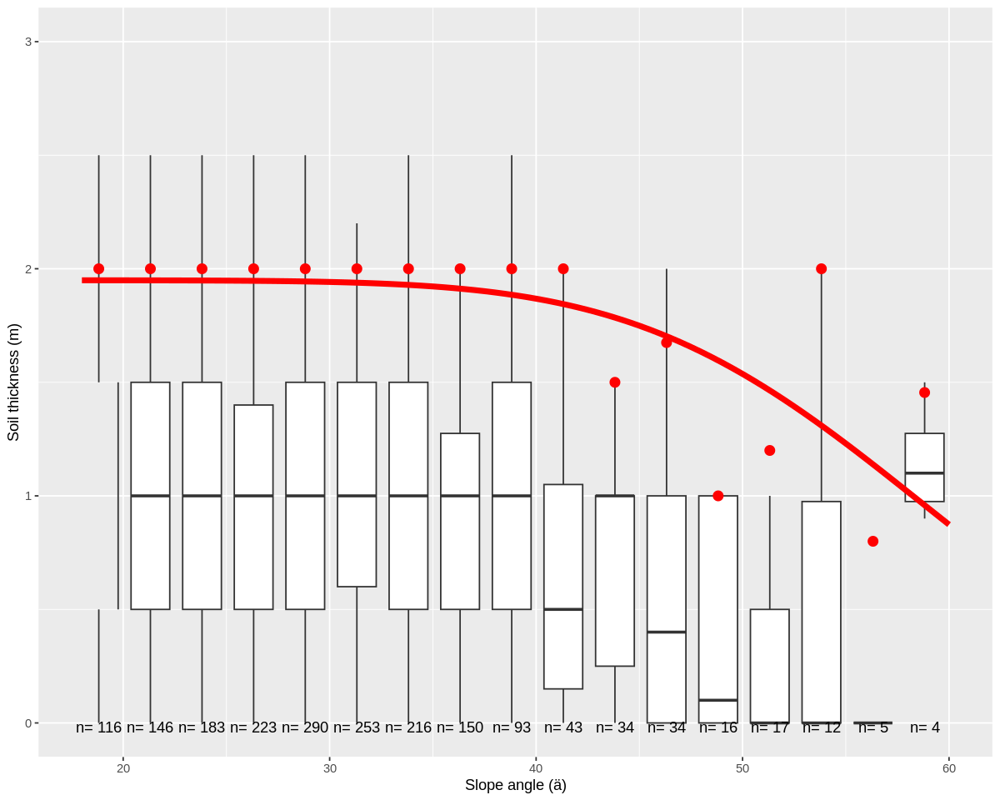

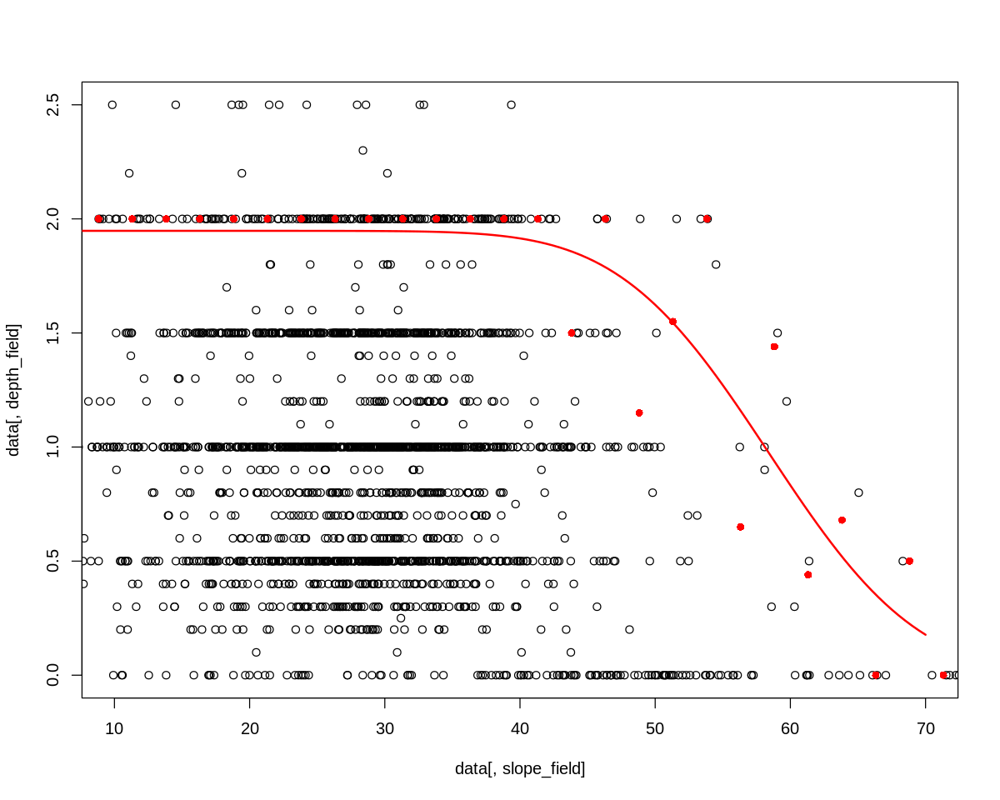

        a         b         c 
1.9365347 2.0425029 0.9159176 


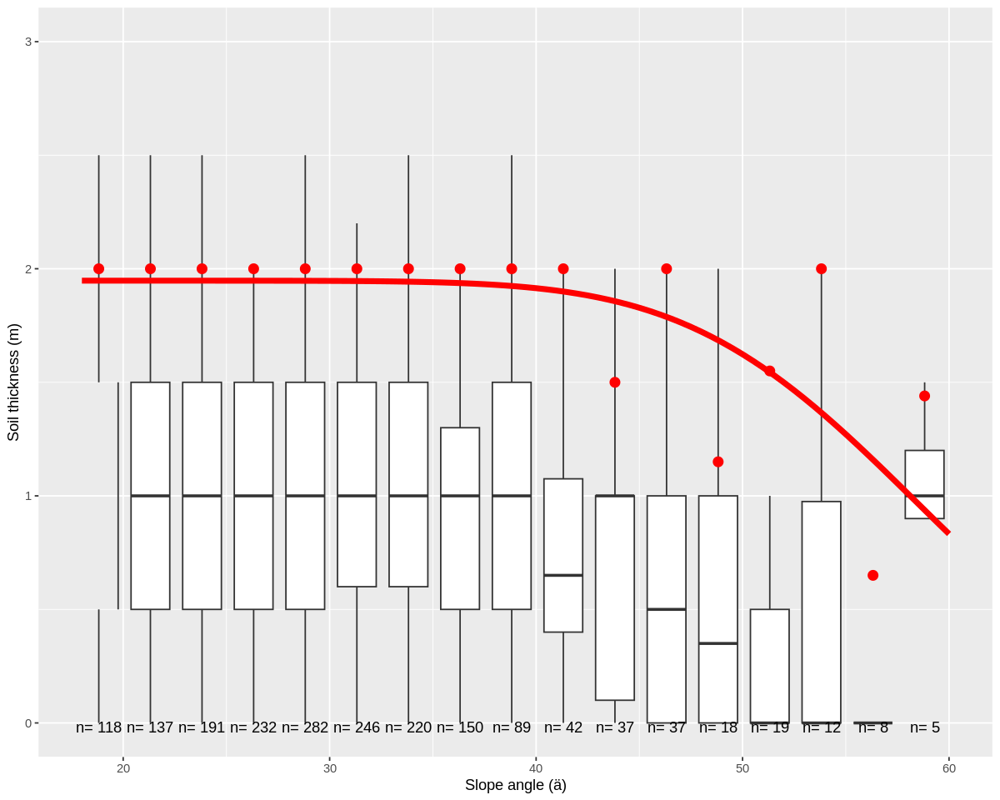

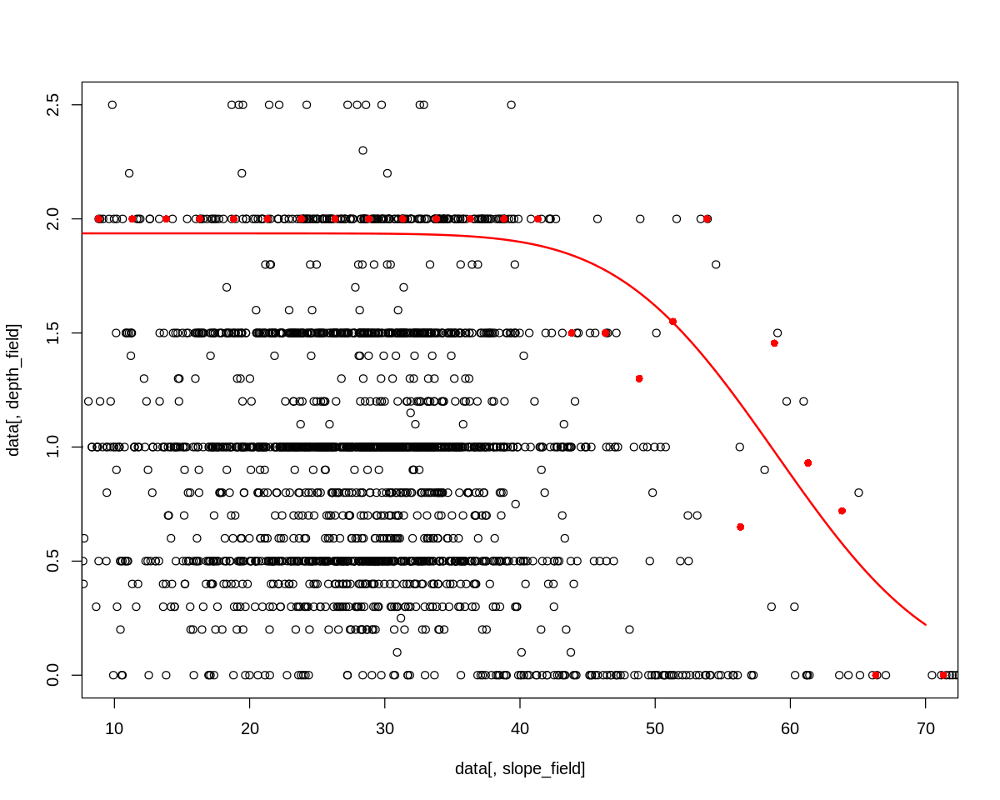

[1] "Best result : Nr.11"
        a         b         c 
1.1979324 1.3535349 0.6689535 


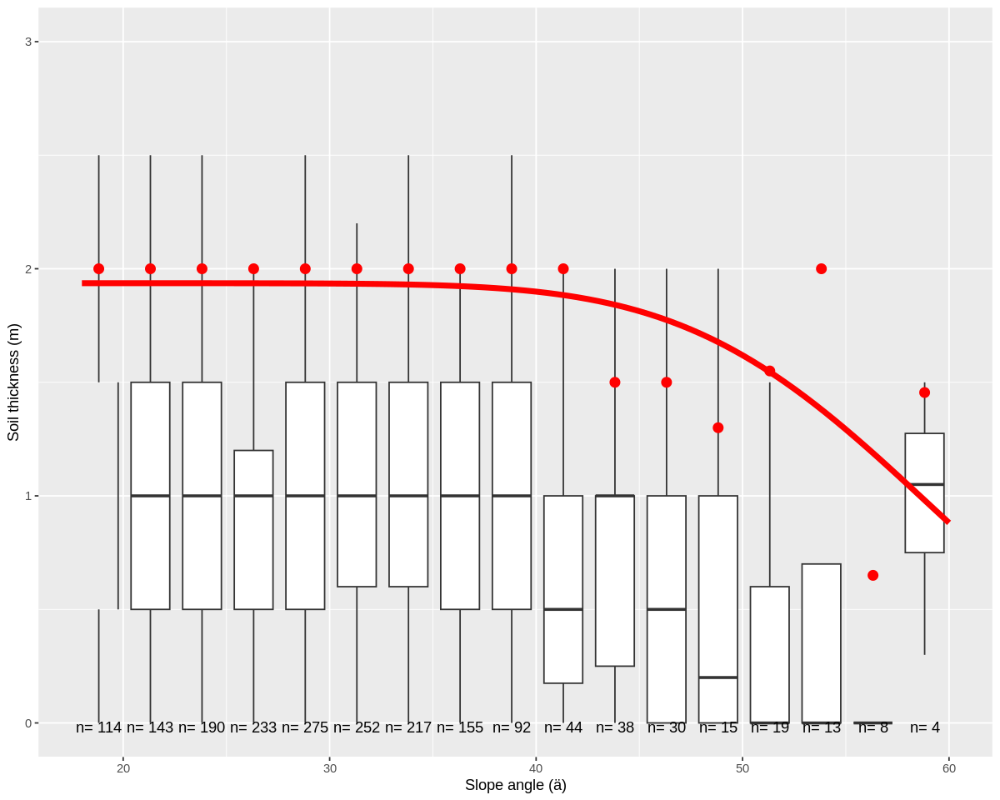

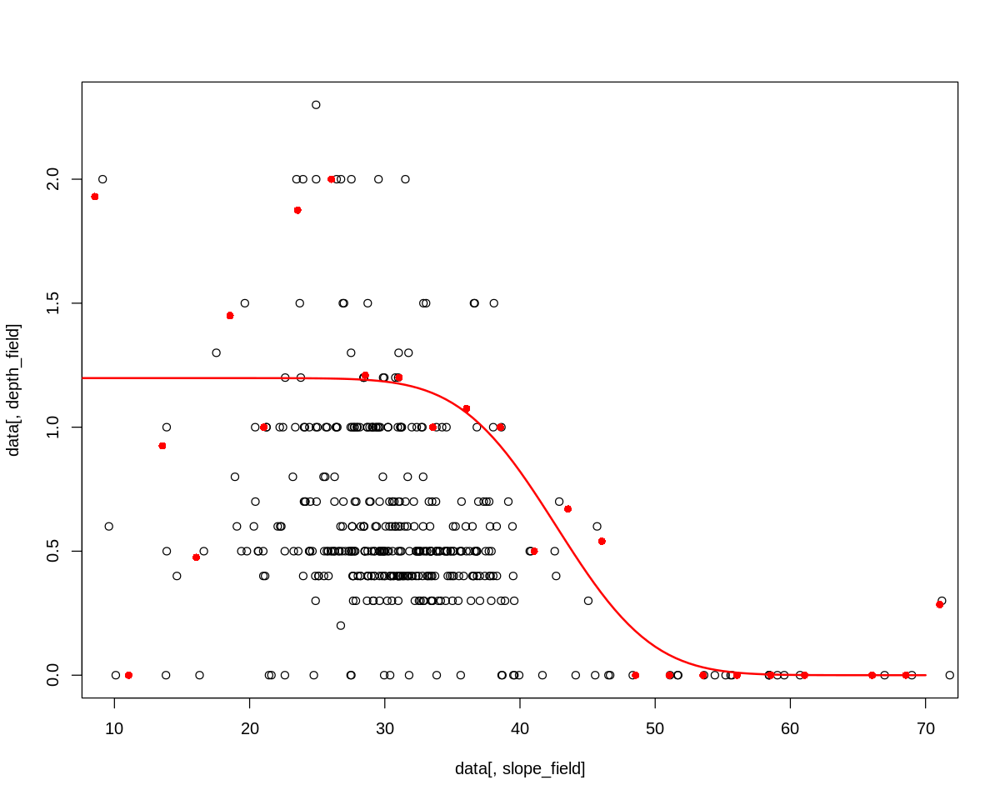

        a         b         c 
1.2612910 1.4110133 0.8663491 


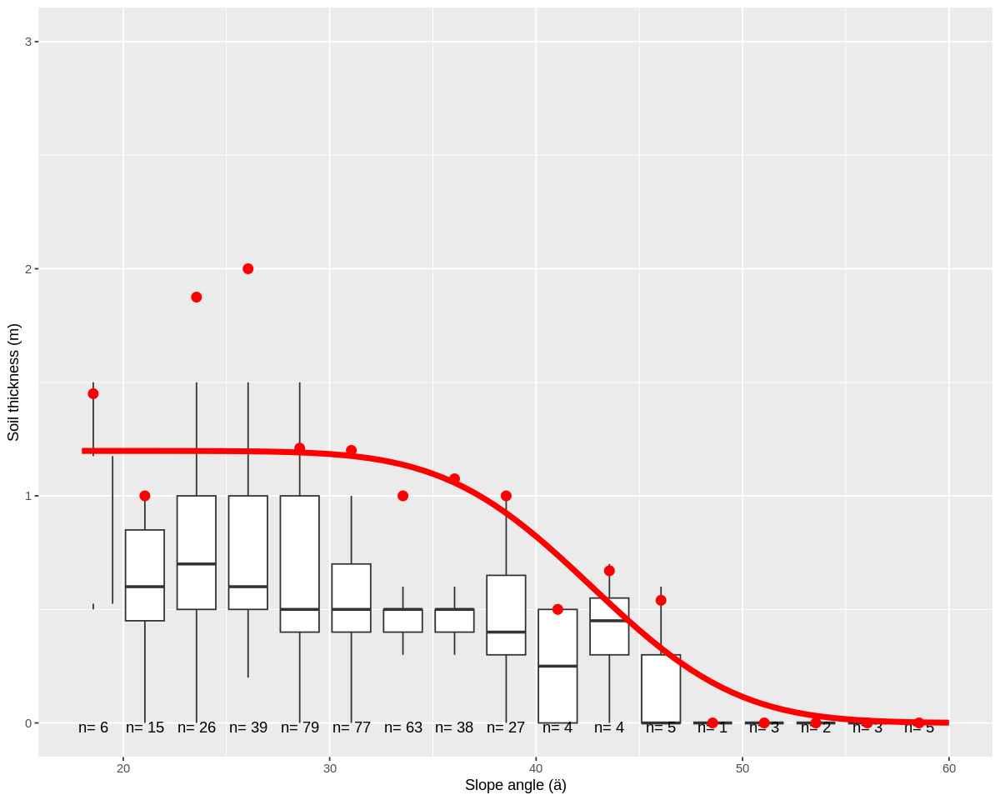

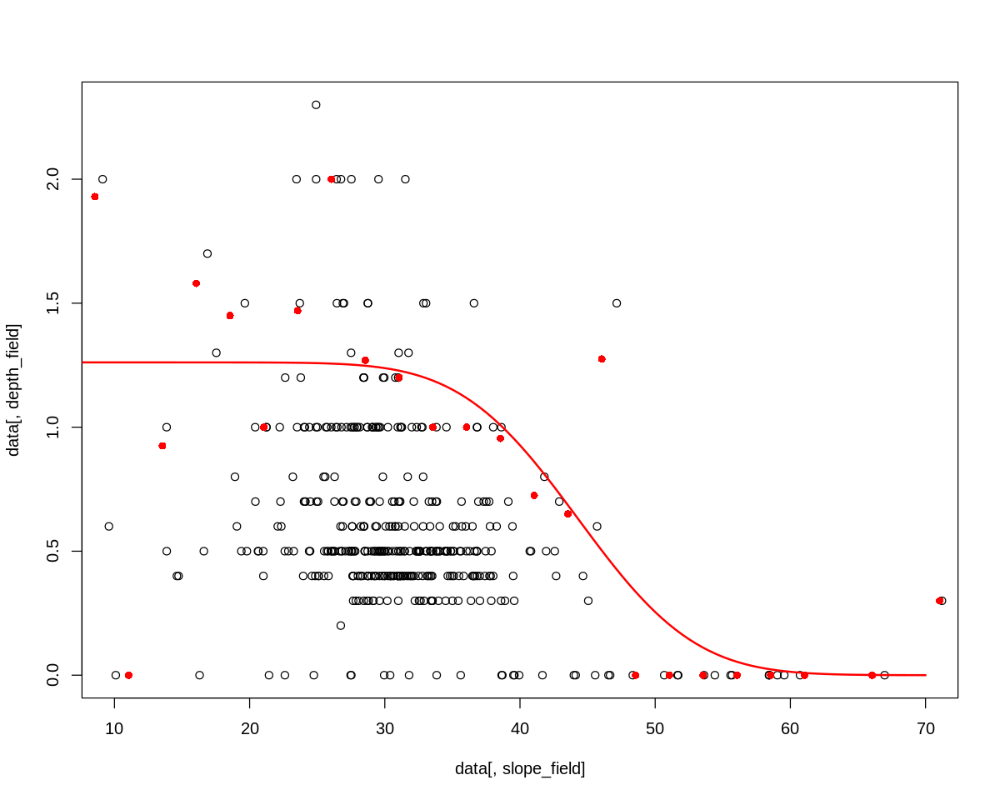

        a         b         c 
1.3167142 1.3891166 0.8576433 


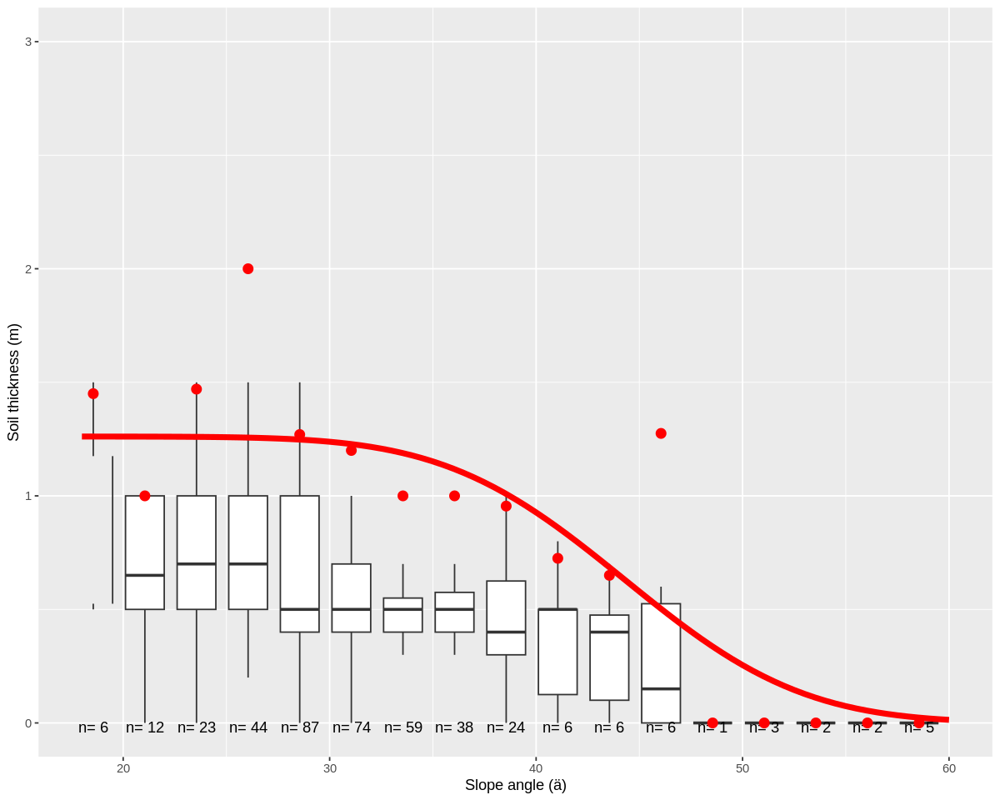

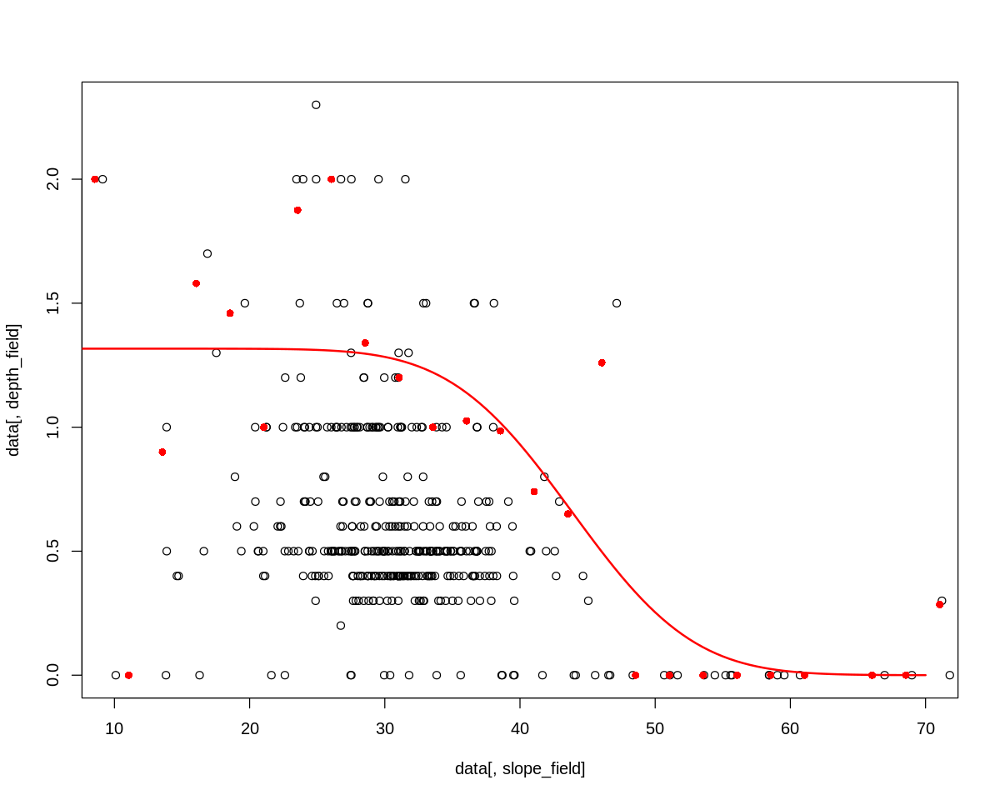

       a        b        c 
1.083214 1.514409 0.200000 


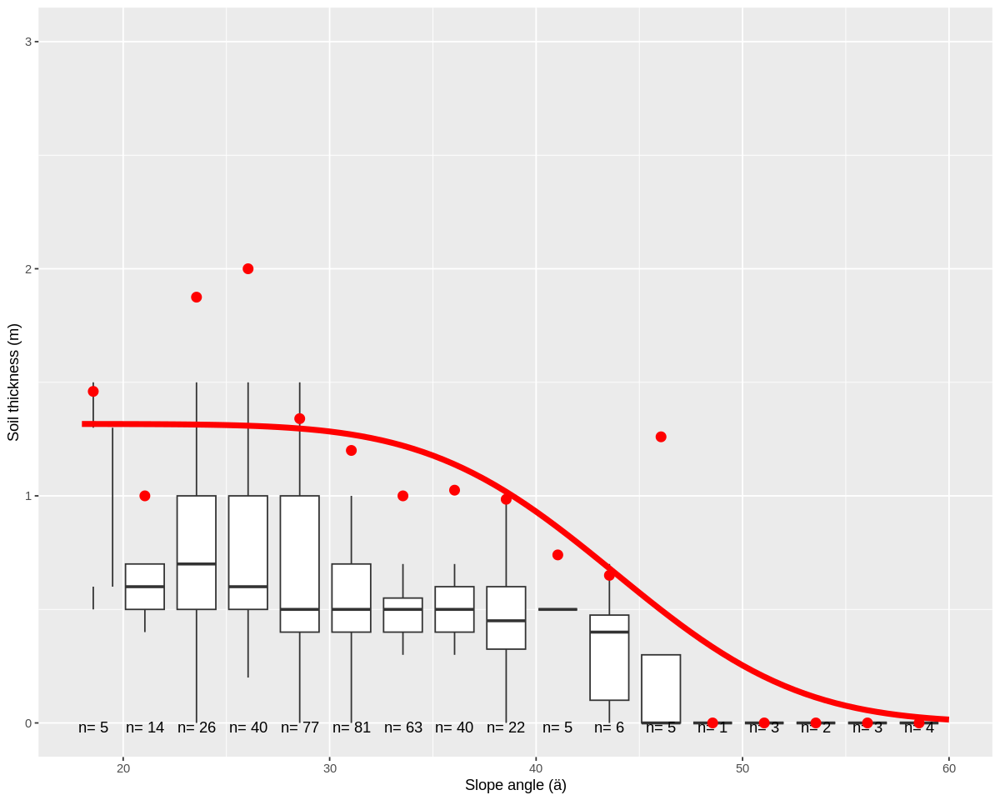

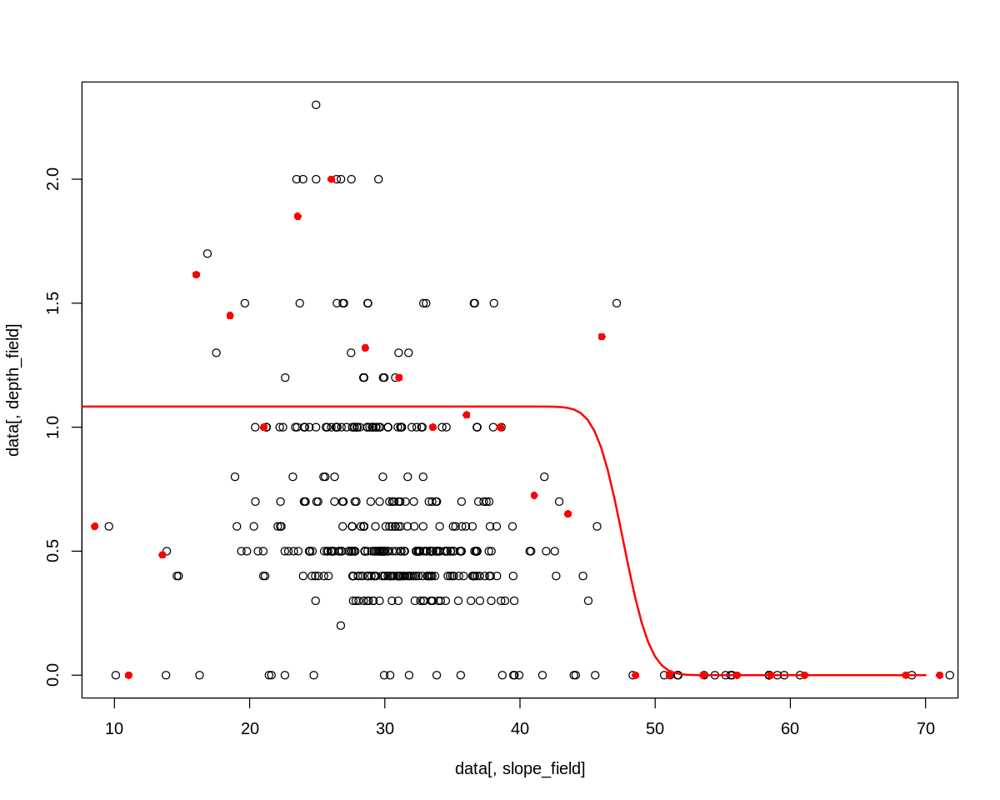

        a         b         c 
1.3101636 1.3988725 0.8357532 


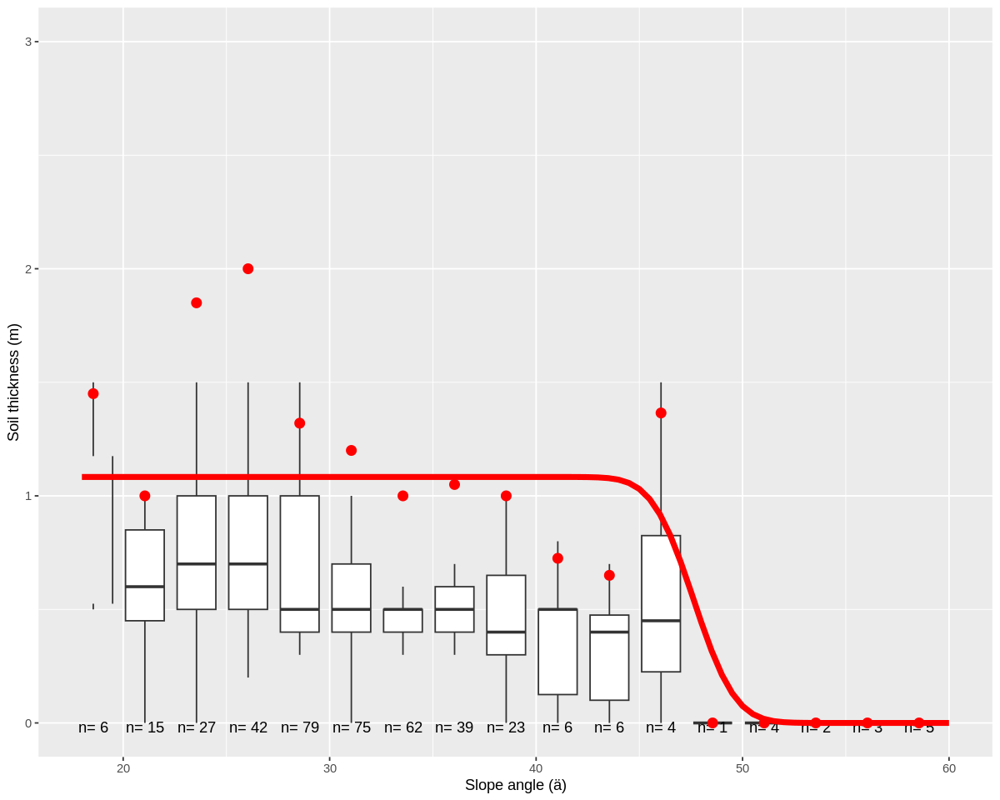

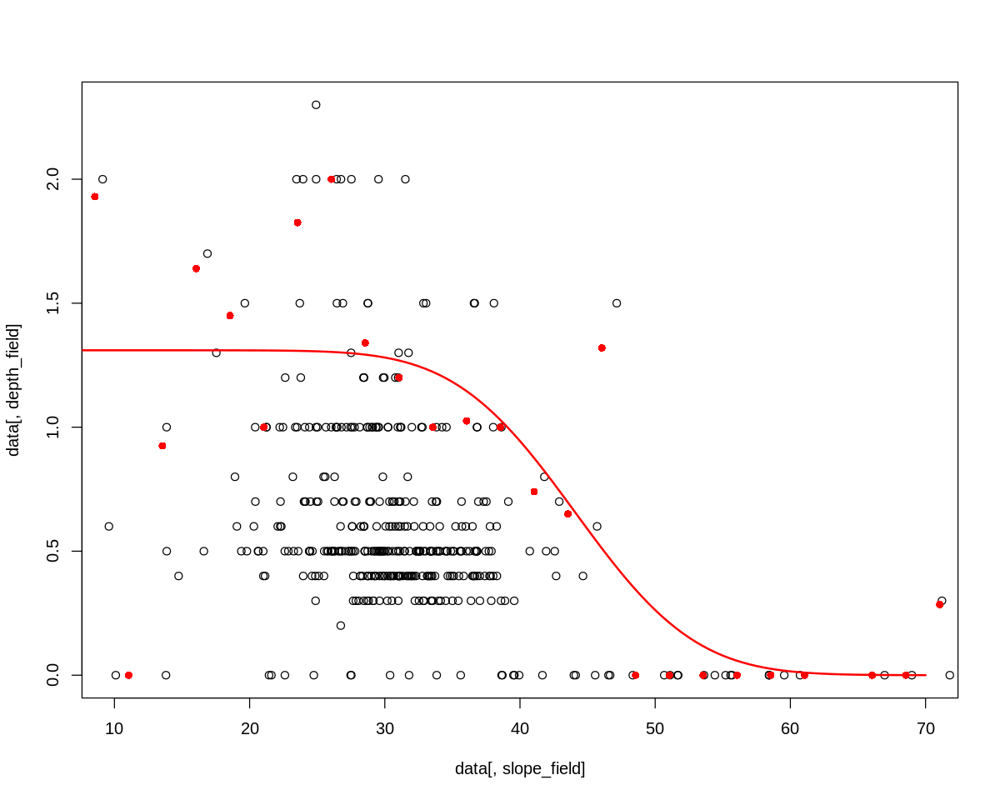

        a         b         c 
1.2473575 1.4182148 0.7635947 


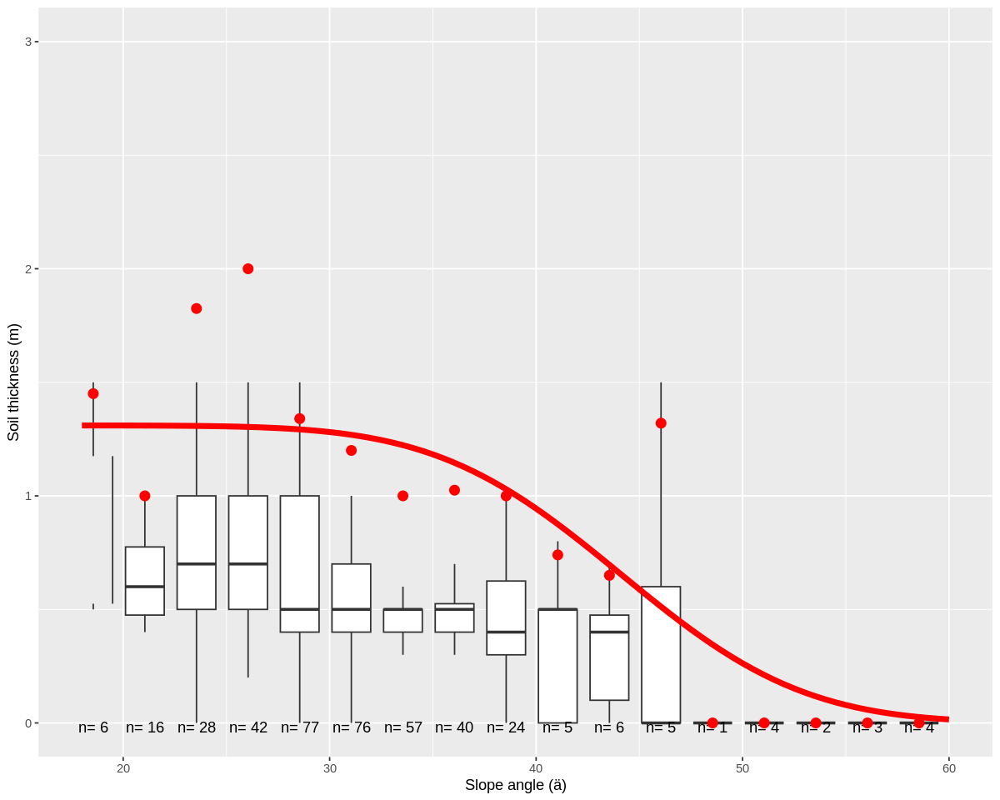

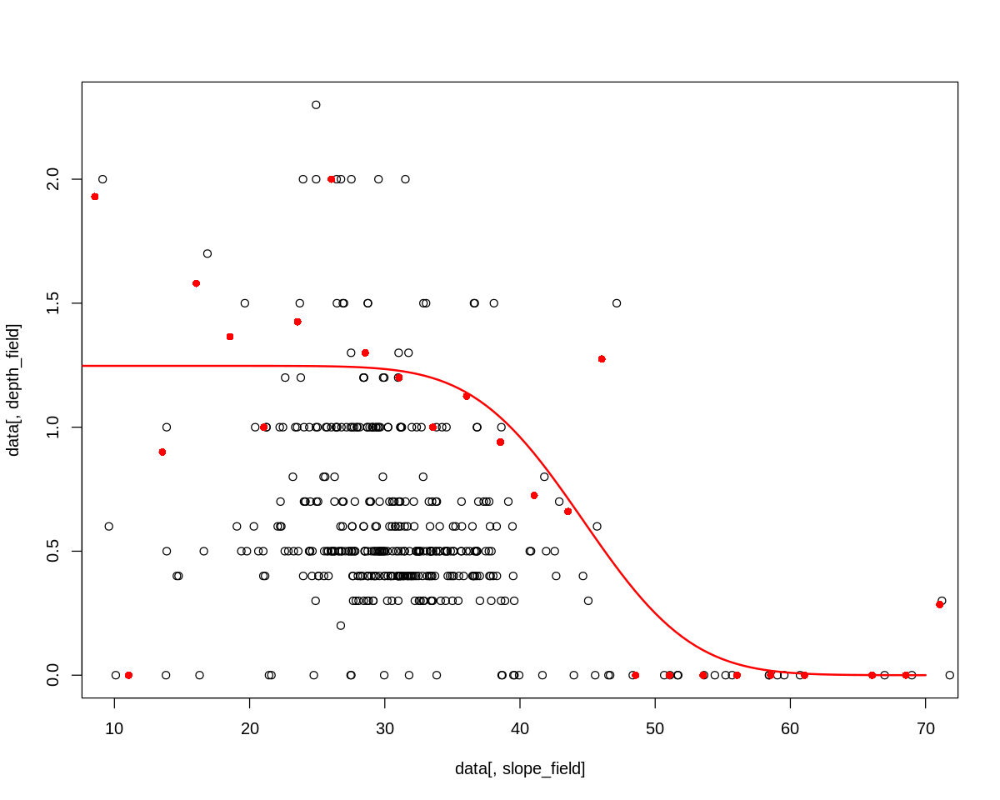

       a        b        c 
1.454144 1.344819 1.090445 


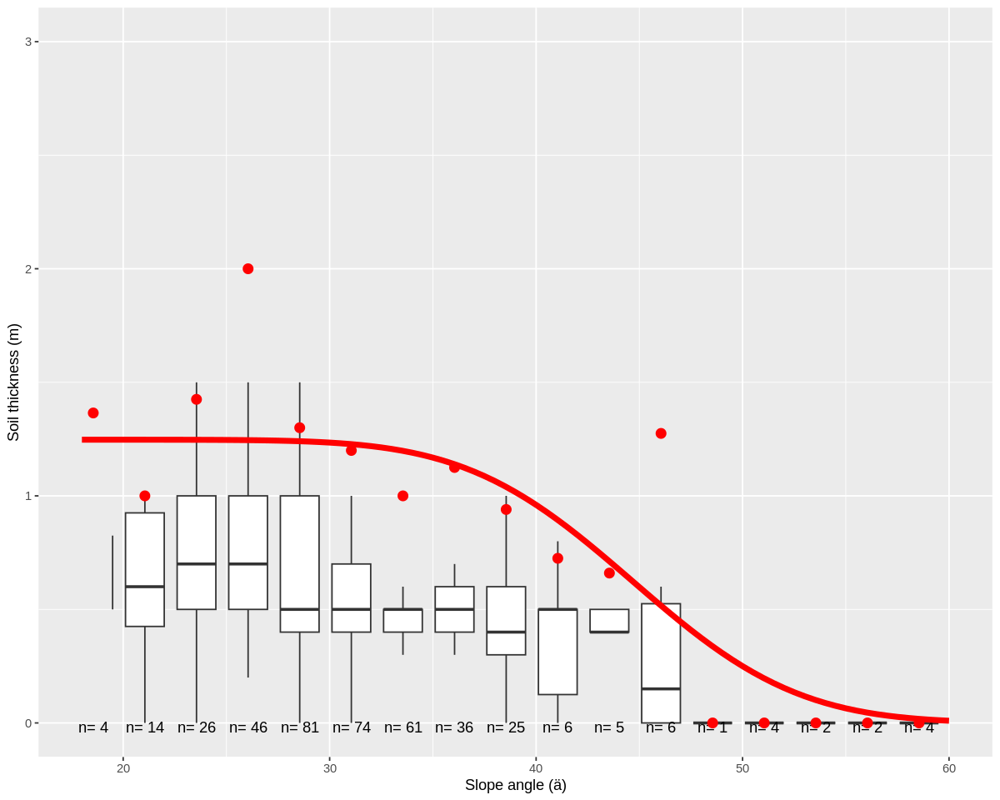

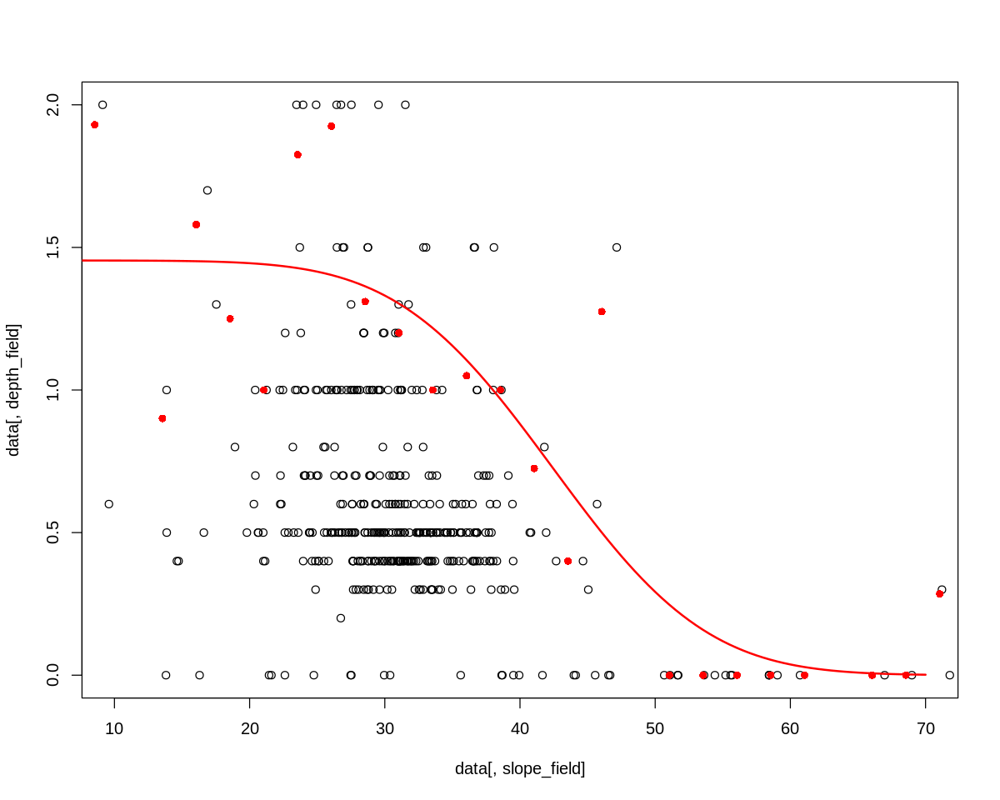

        a         b         c 
1.2979647 1.3916913 0.8069188 


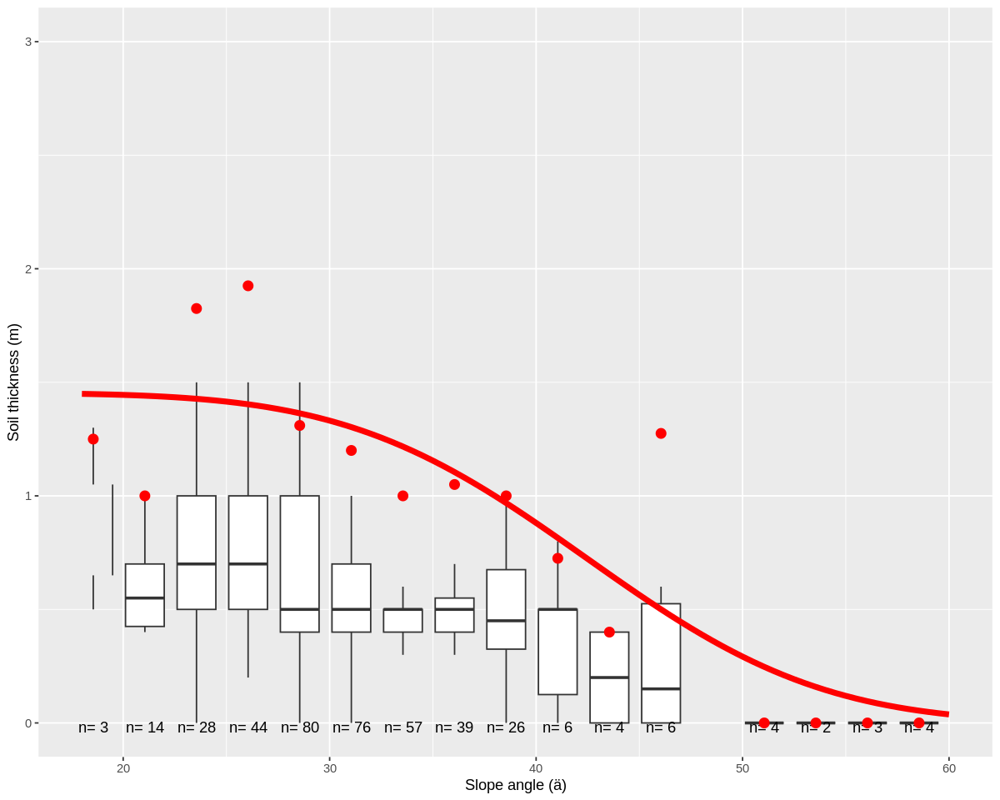

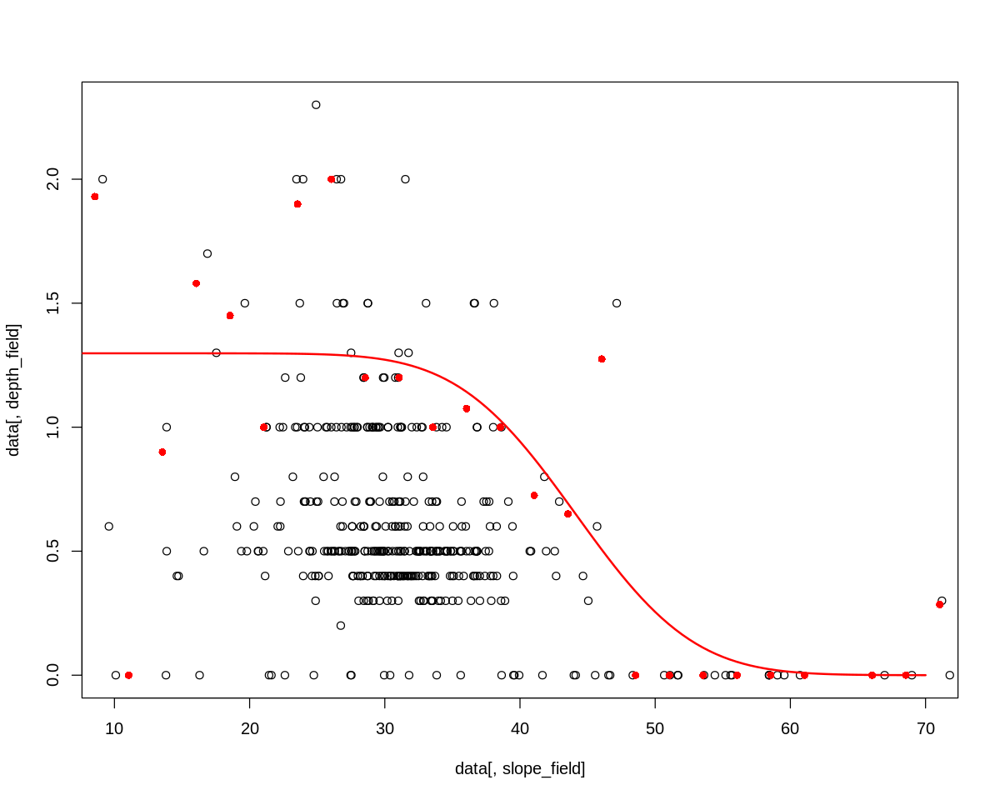

        a         b         c 
1.2403056 1.4601619 0.8684633 


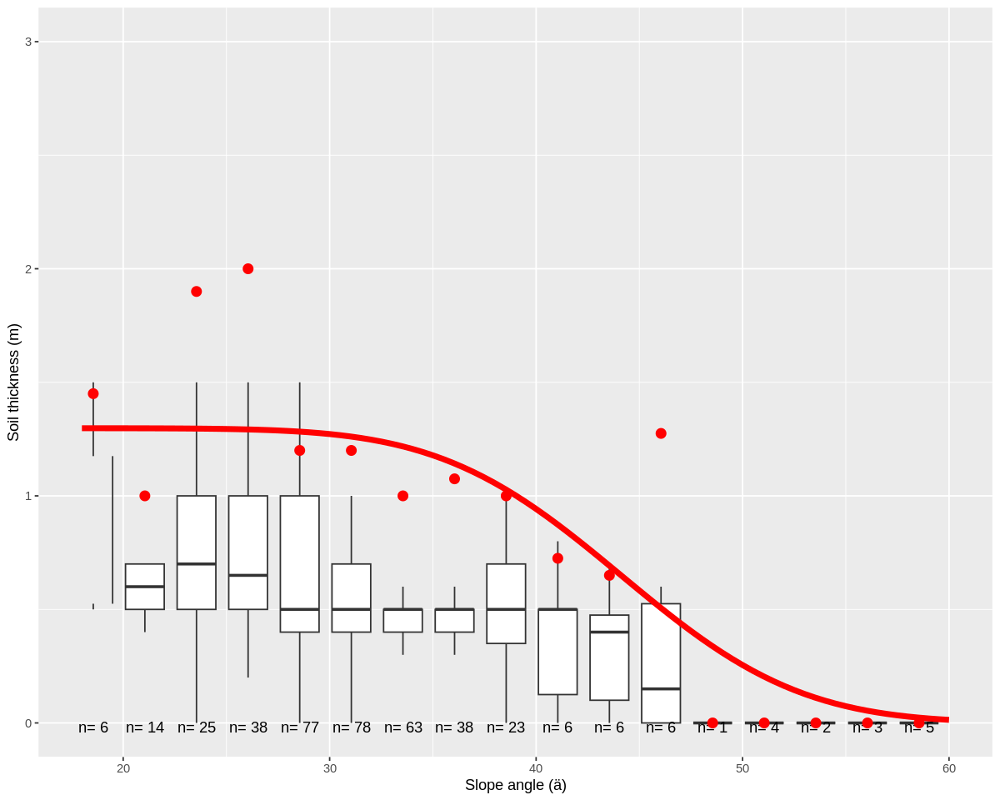

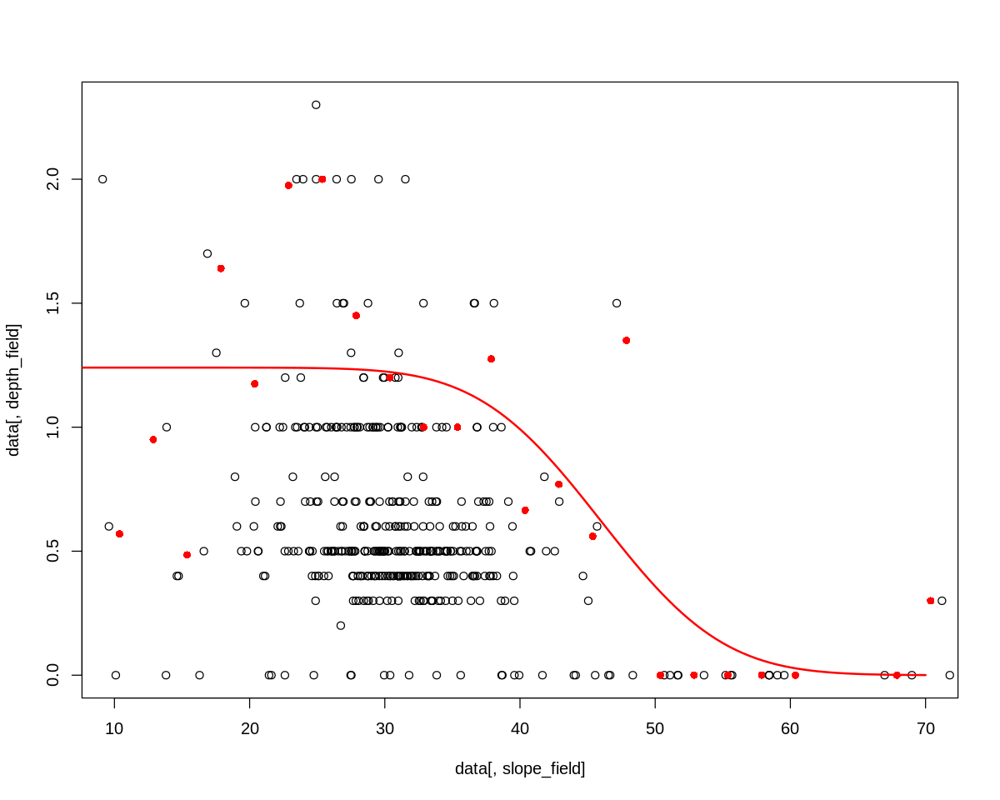

        a         b         c 
1.2901428 1.4043855 0.9079647 


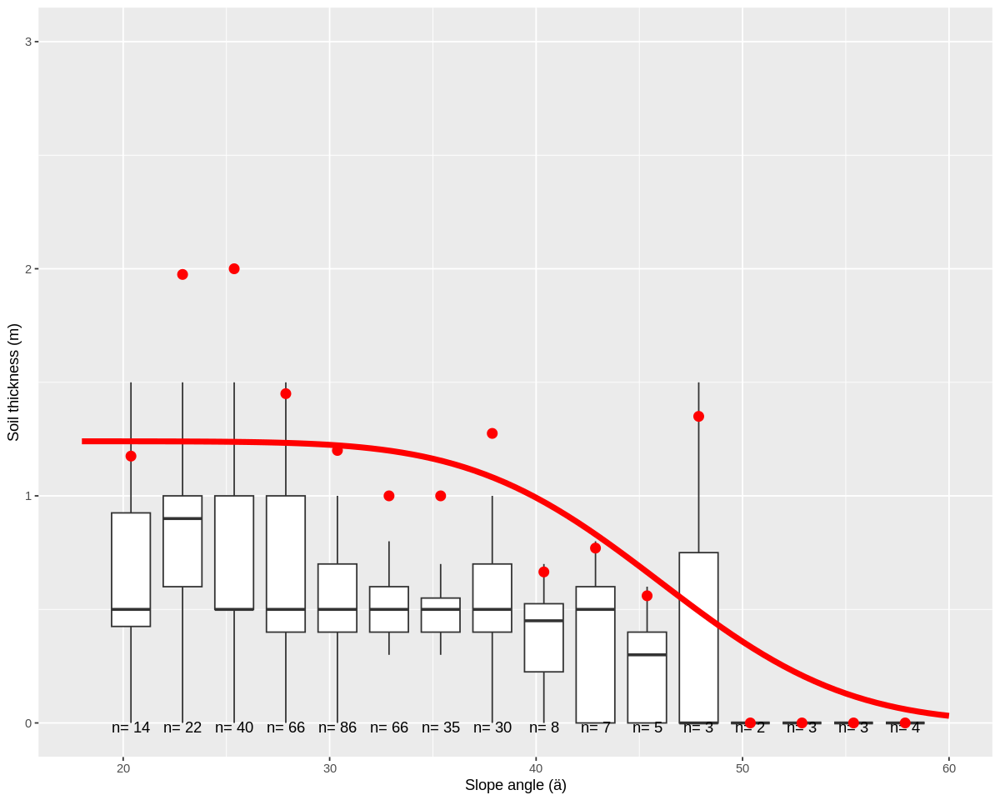

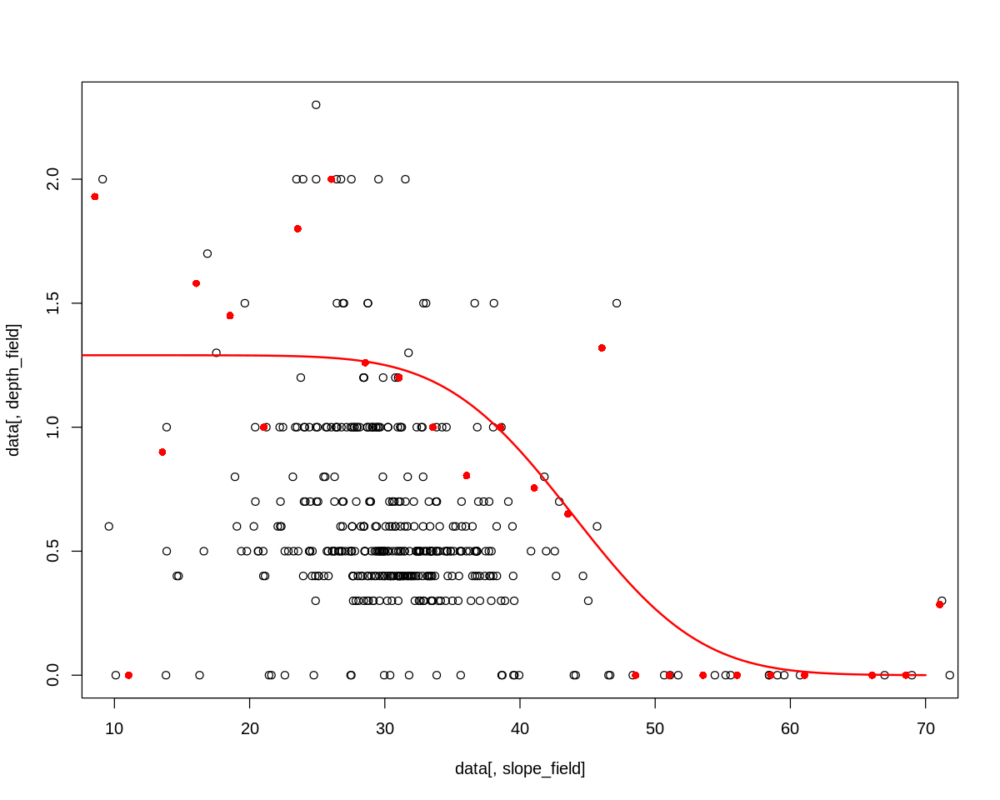

[1] "Best result : Nr.3"


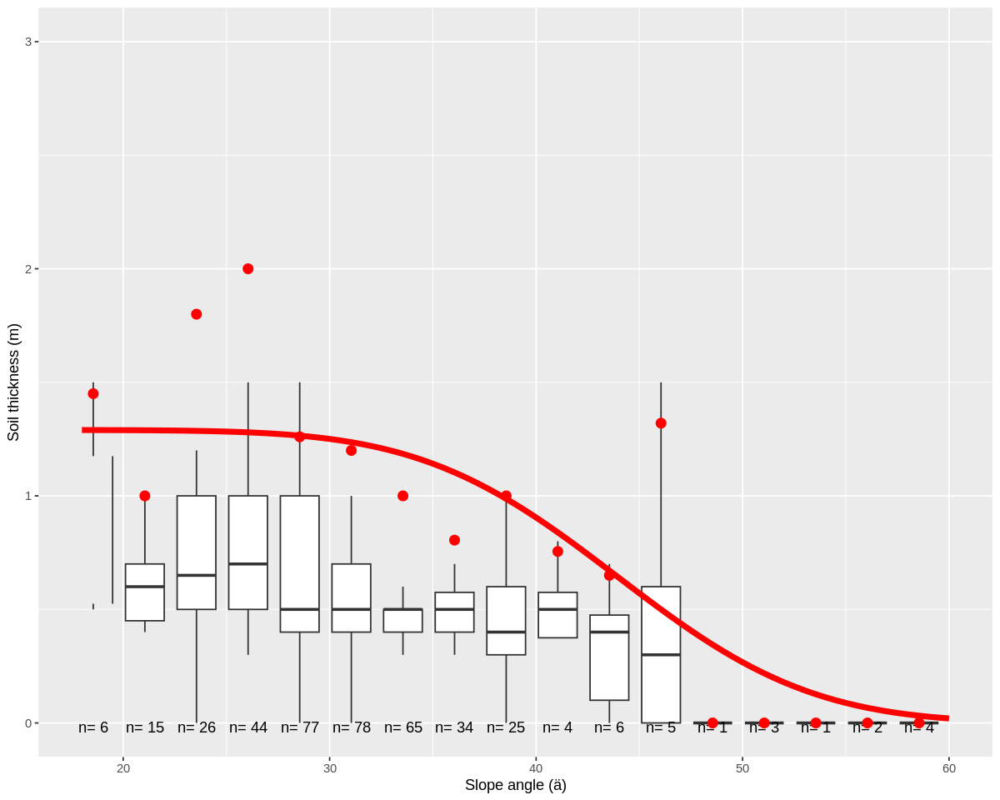

In [206]:
h_sfm_hmdb <- train_h_sfm_cv(data_train_hmdb)
h_sfm_storme <- train_h_sfm_cv(data_train_storme)
h_sfm_be <- train_h_sfm_cv(data_train_be)


In [207]:
sum(is.na(merged.df.hmdb$Failure_area))
sum(is.na(merged.df.hmdb$Failure_volume))
sum(is.na(merged.df.hmdb$Landslide_thickness))
sum(!is.na(merged.df.hmdb$Landslide_thickness)&is.na(merged.df.hmdb$Failure_volume))


[1] 92

[1] 45

[1] 0

[1] 45

        a         b         c 
1.0892146 1.5383394 0.7278966 


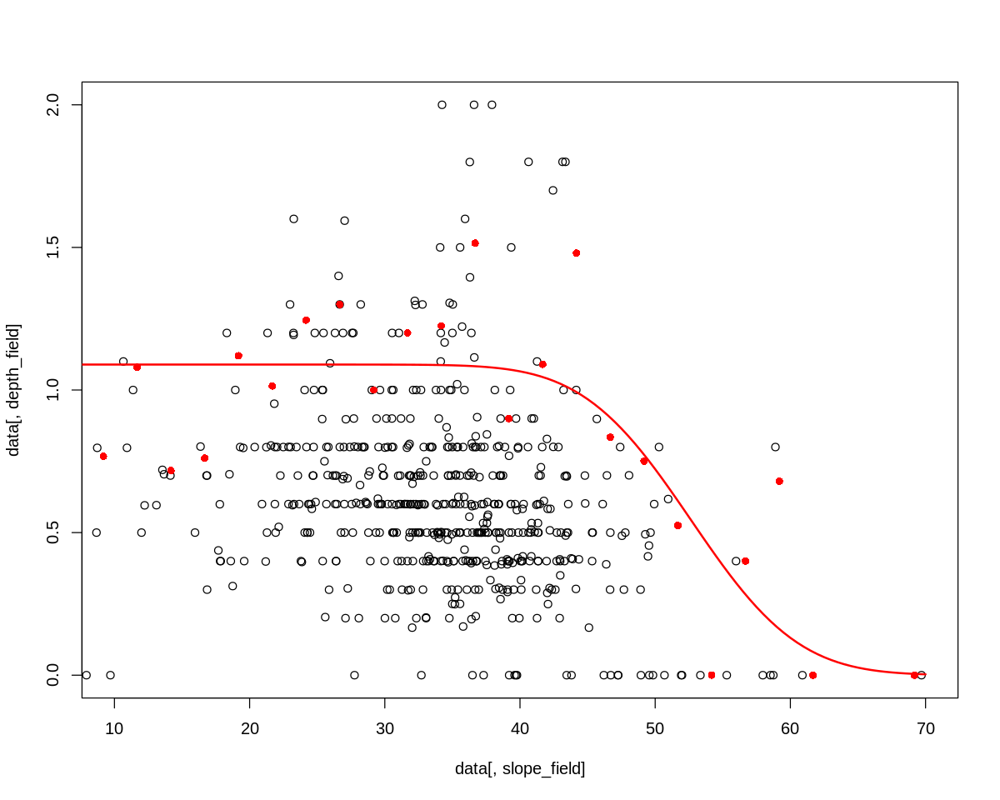

        a         b         c 
1.8901633 2.1090485 0.4093181 


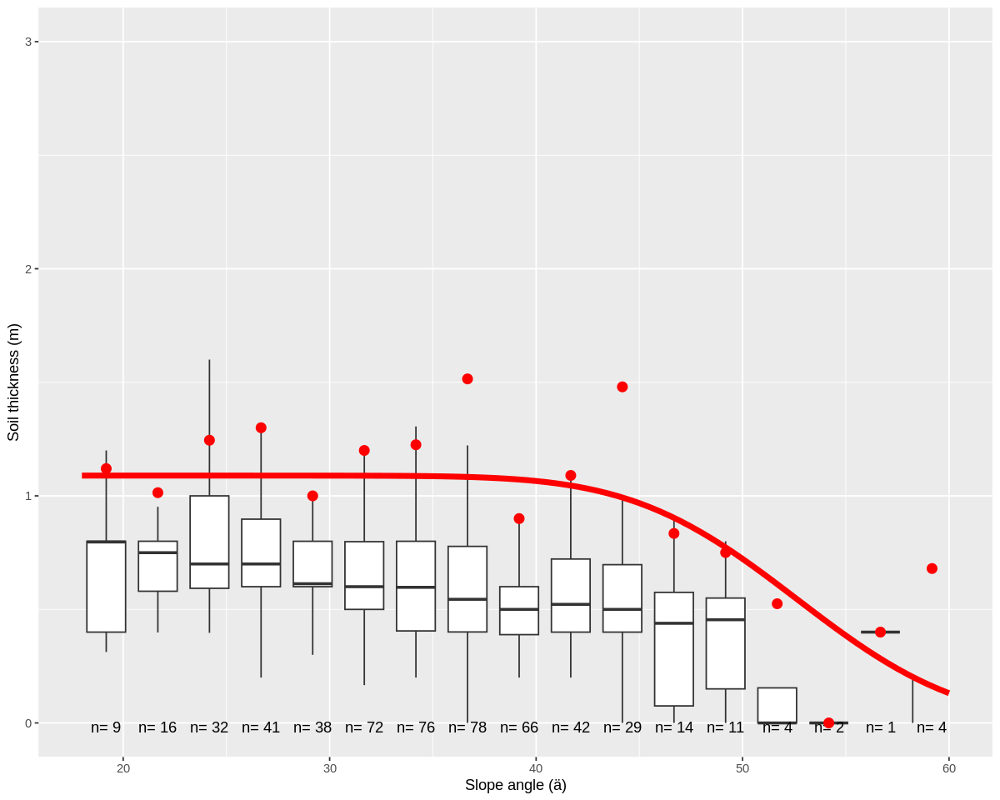

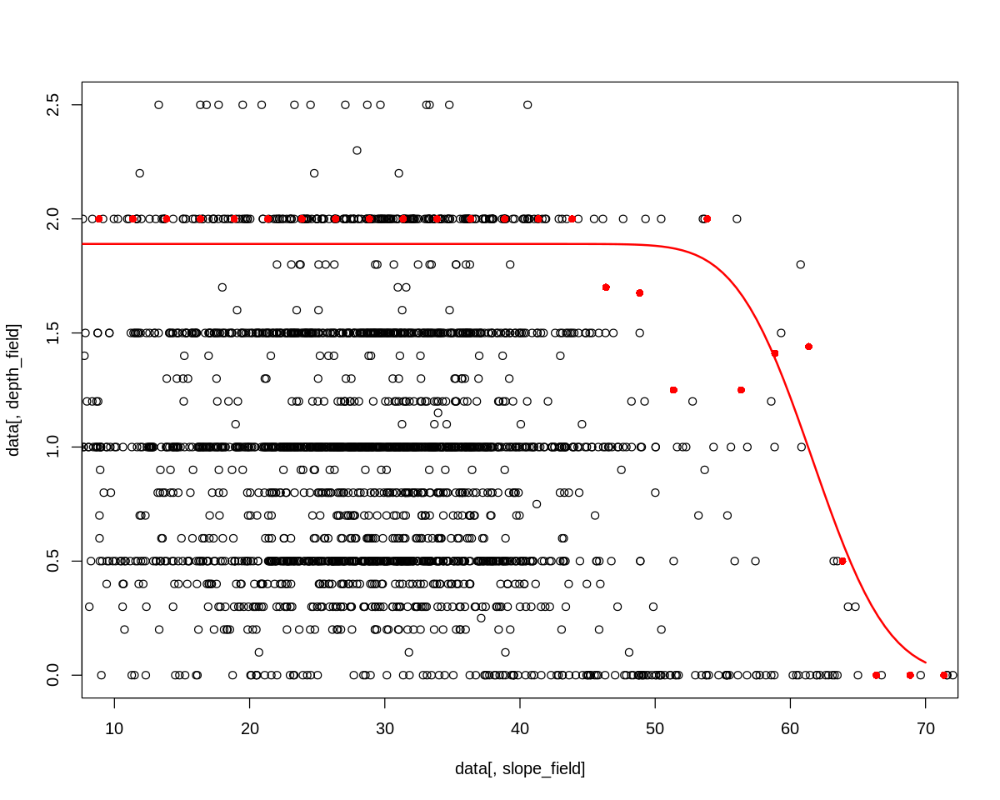

        a         b         c 
1.2197711 1.4586112 0.4866022 


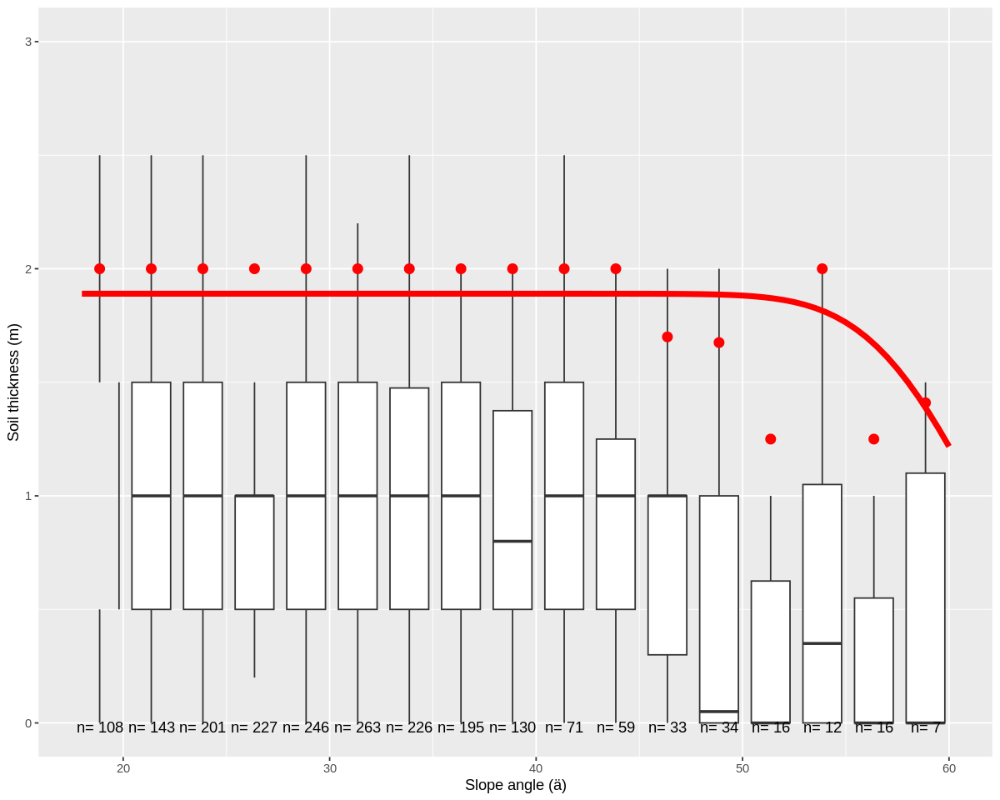

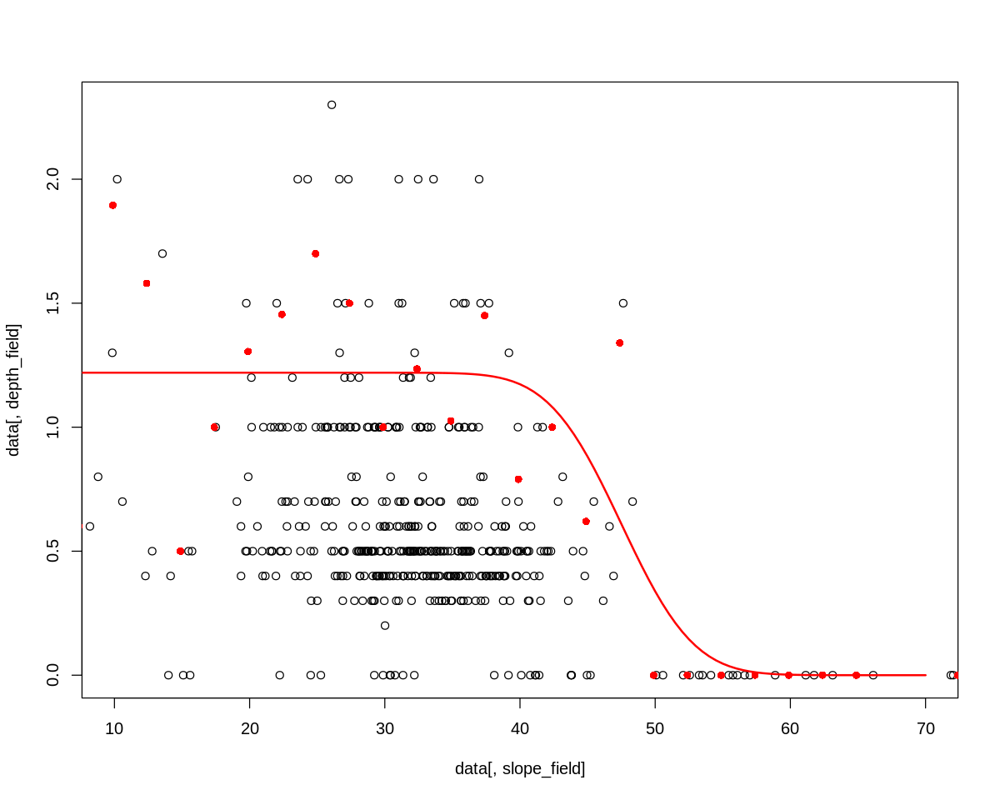

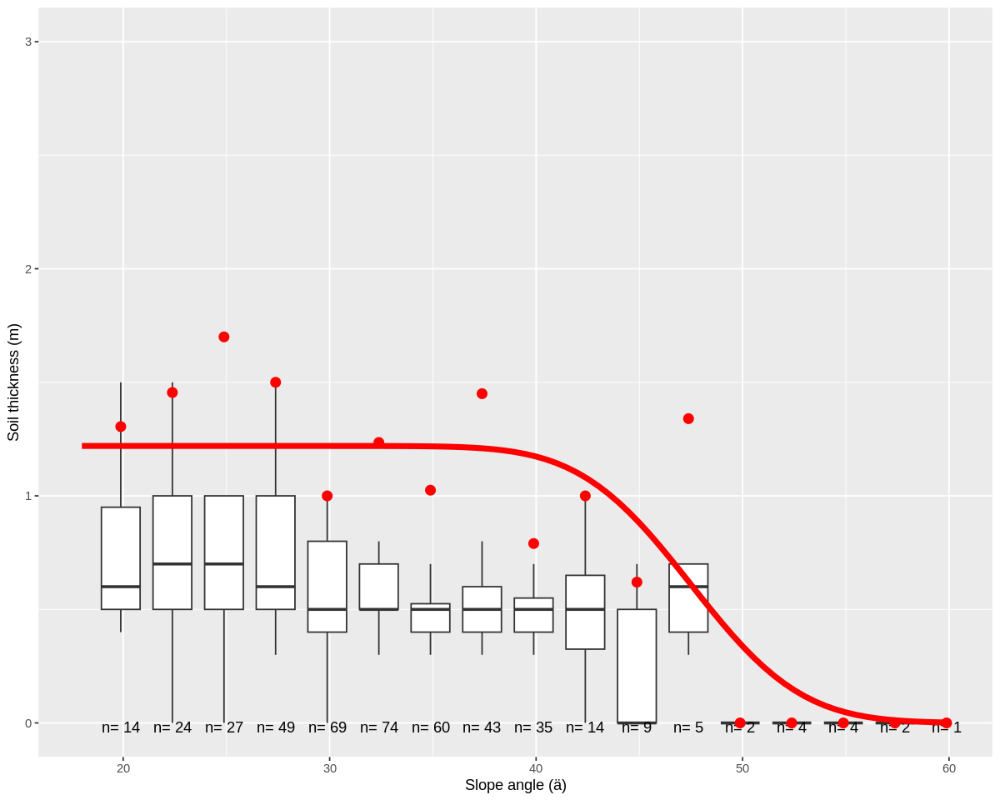

In [208]:
h_sfm_hmdb_5 <- fit_h_sfm(data_train_hmdb,seed=seed, slope_field="slope_5")
h_sfm_storme_5 <- fit_h_sfm(data_train_storme,seed=seed, slope_field="slope_5") 
h_sfm_be_5 <- fit_h_sfm(data_train_be,seed=seed, slope_field="slope_5")


        a         b         c 
1.0834001 1.4778888 0.5828395 


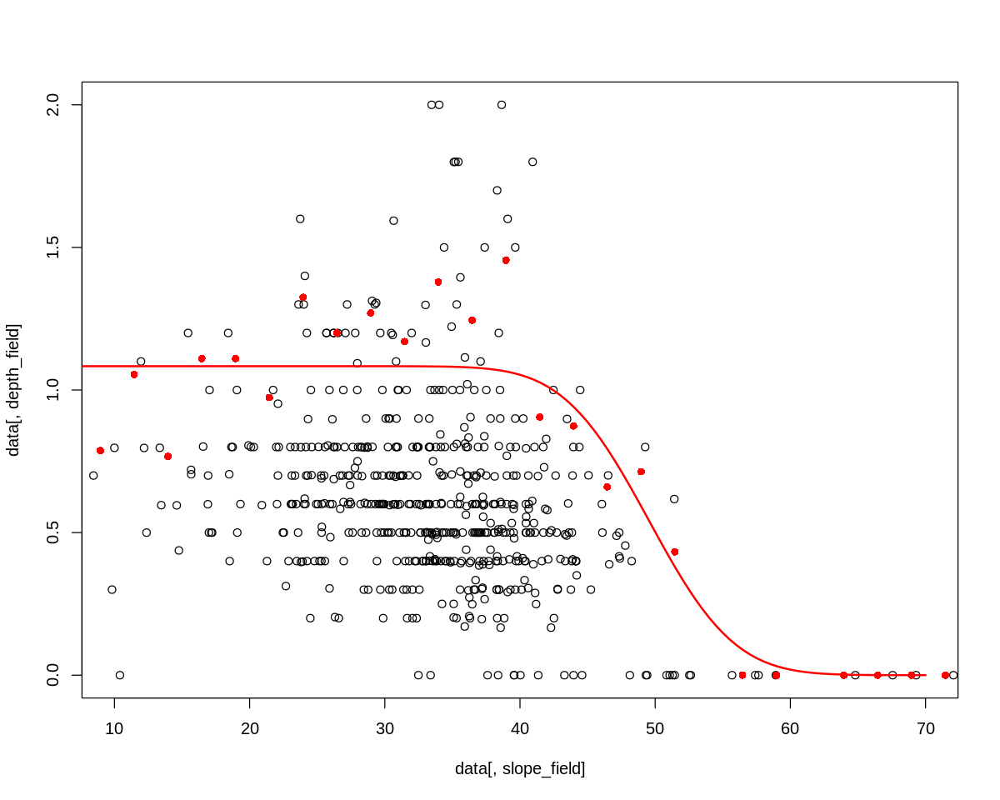

        a         b         c 
1.9392056 2.0574453 0.8984001 


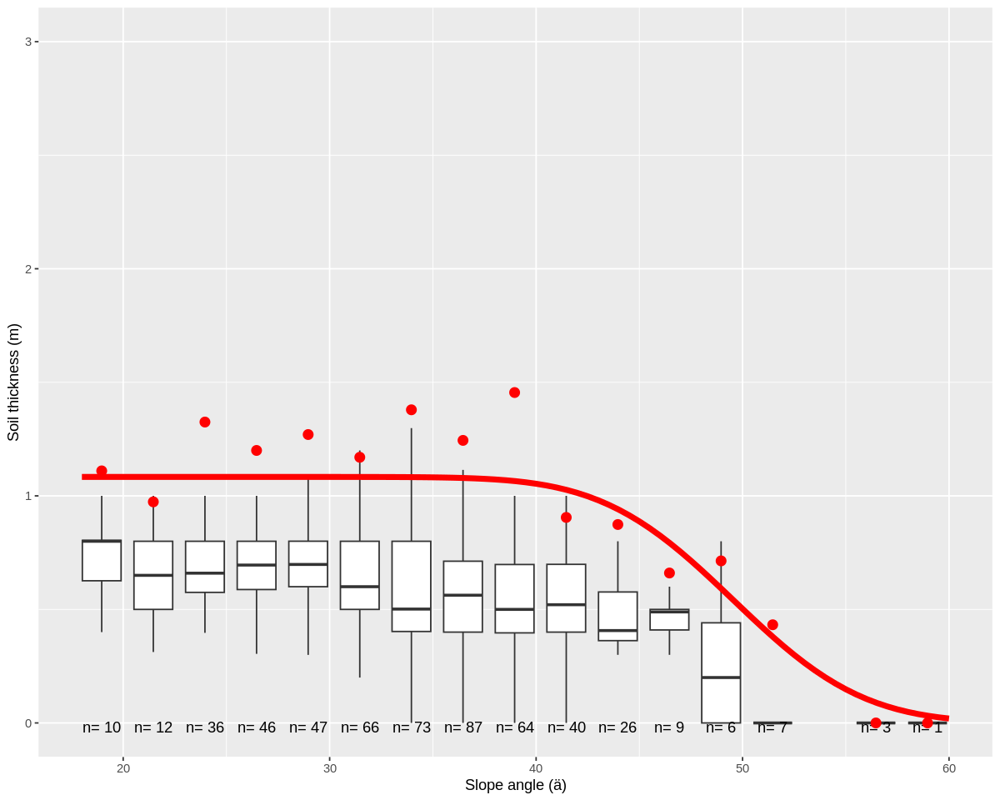

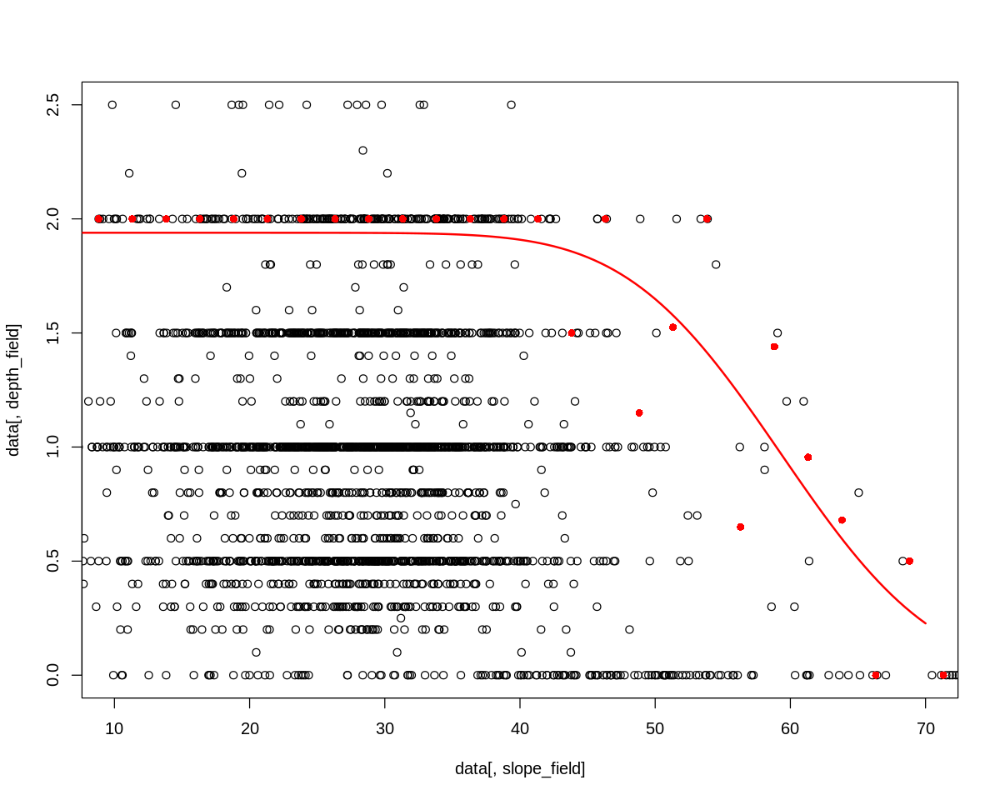

        a         b         c 
1.2927823 1.3987393 0.8480054 


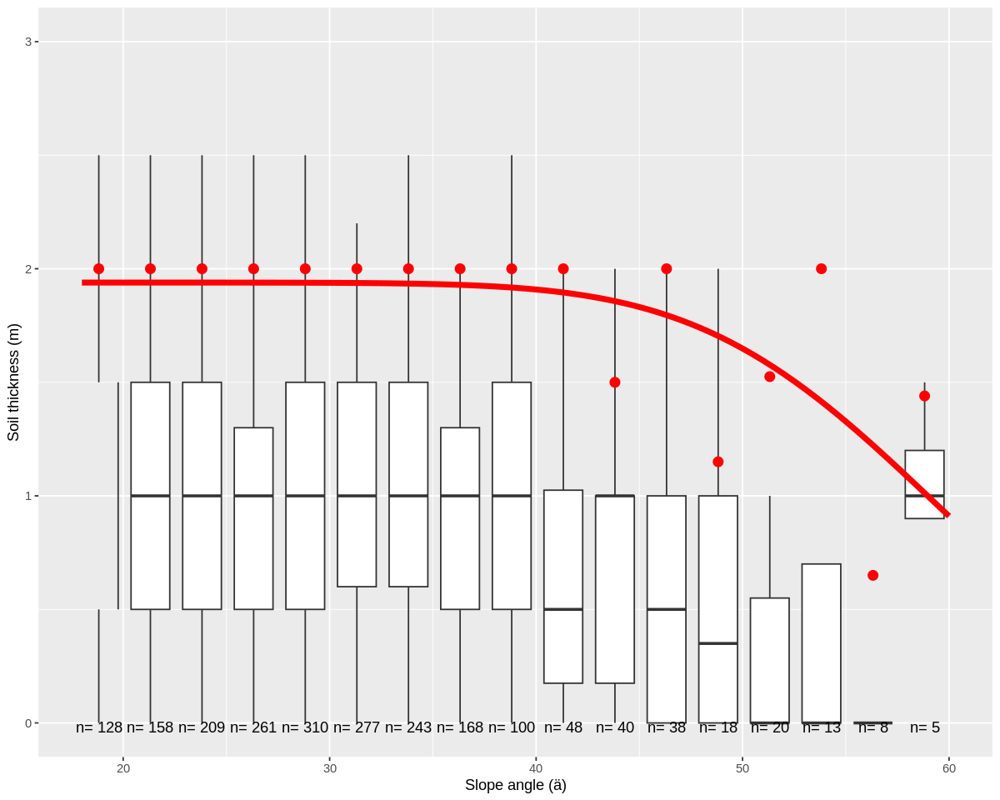

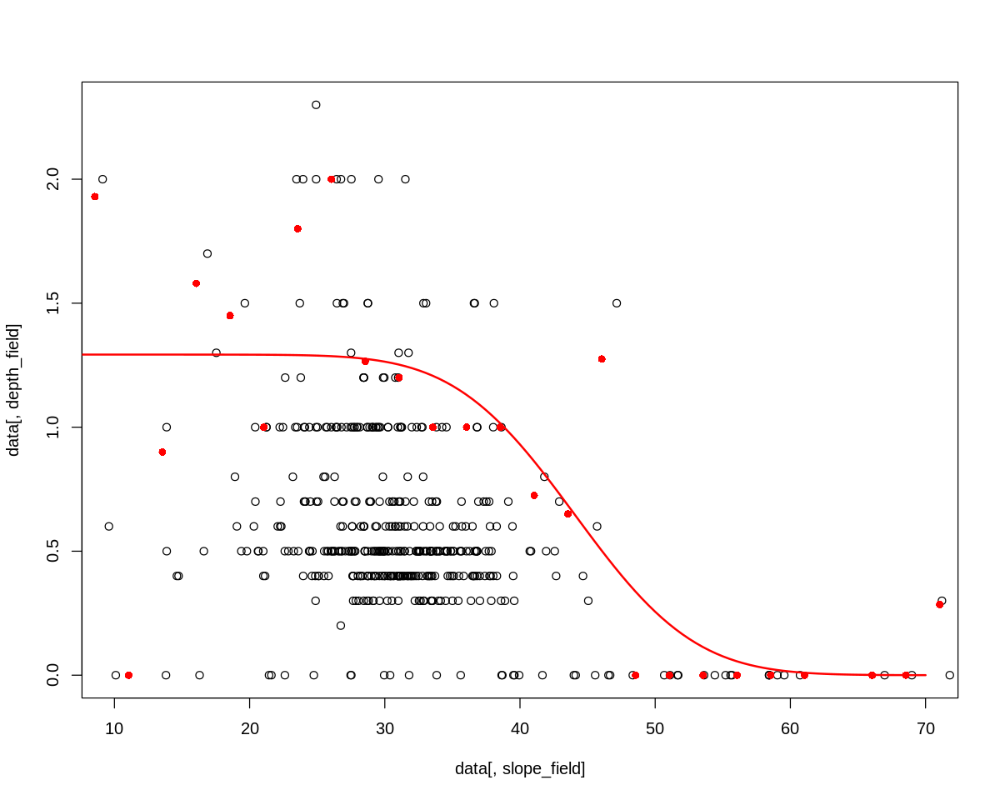

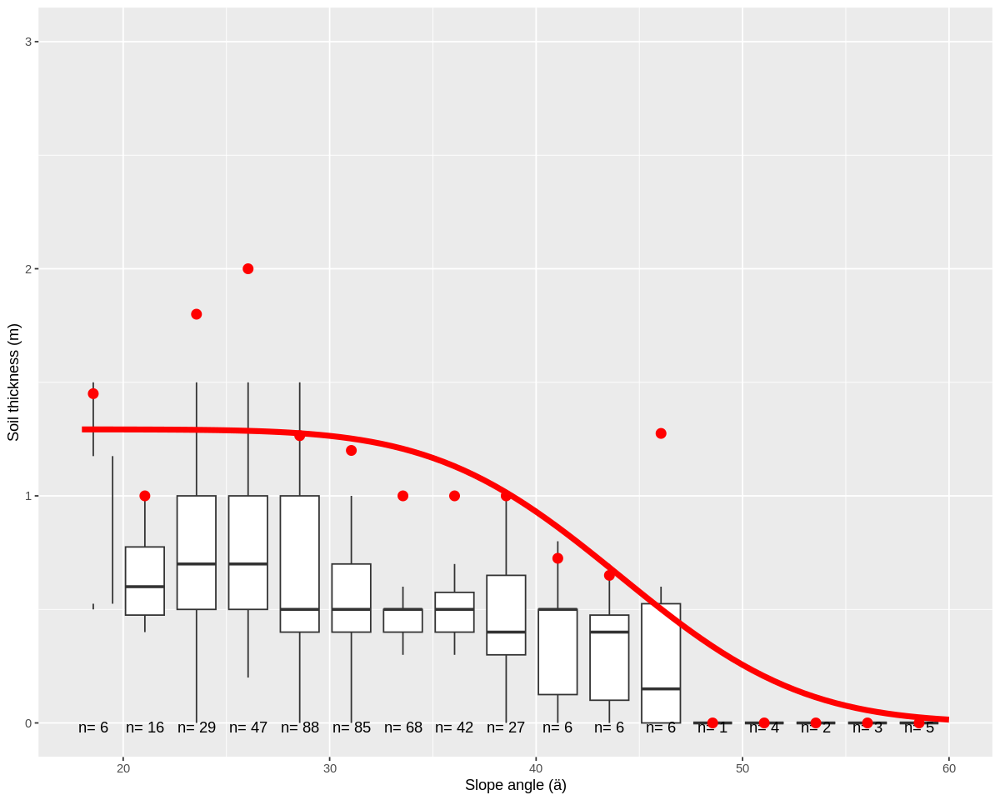

In [209]:
h_sfm_hmdb_10 <- fit_h_sfm(data_train_hmdb,seed=seed, slope_field="slope_10")
h_sfm_storme_10 <- fit_h_sfm(data_train_storme,seed=seed, slope_field="slope_10")
h_sfm_be_10 <- fit_h_sfm(data_train_be,seed=seed, slope_field="slope_10")


       a        b        c 
1.078147 1.510242 0.609120 


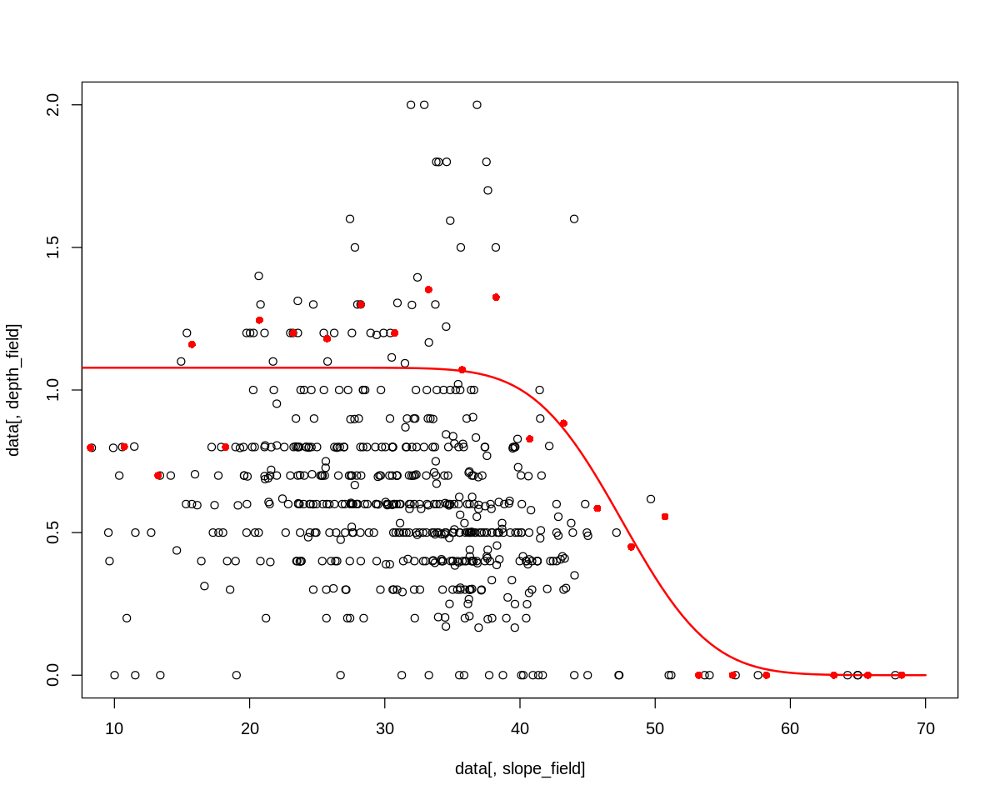

       a        b        c 
2.001290 1.941556 0.686507 


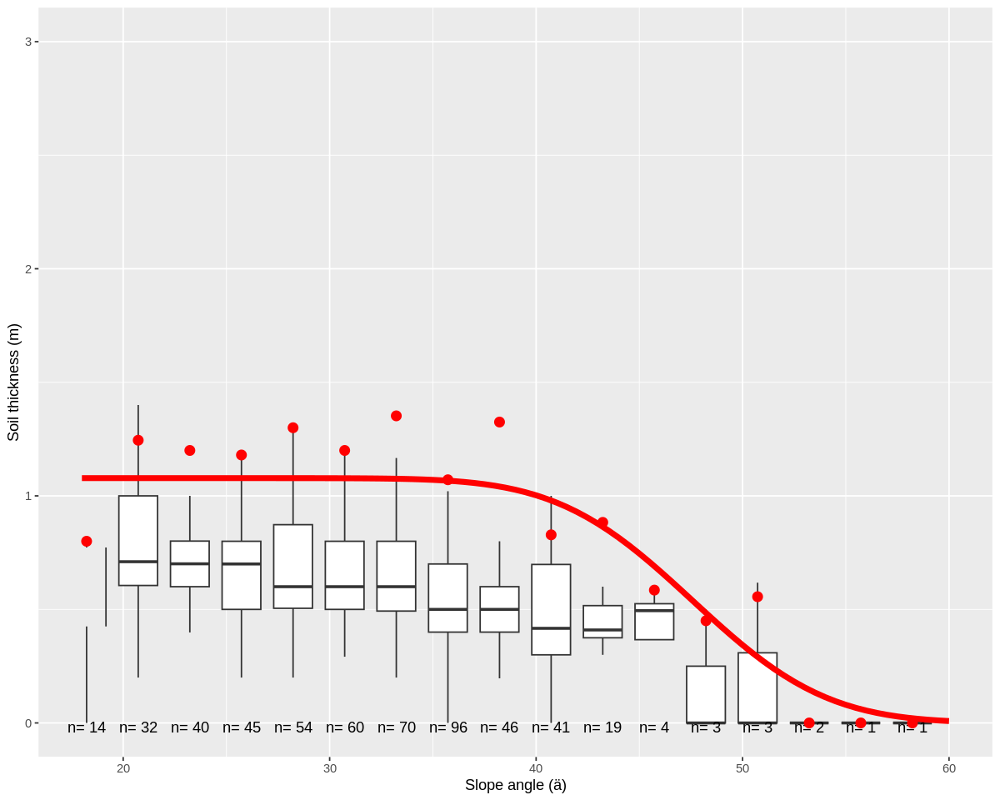

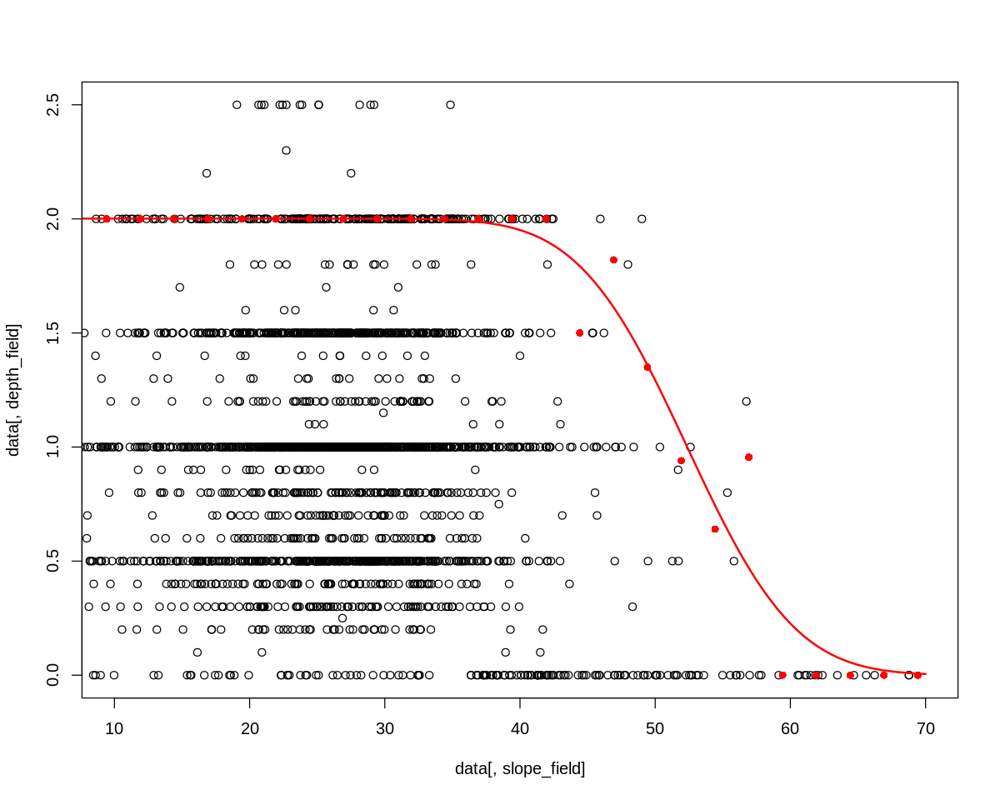

        a         b         c 
1.0943976 1.4459547 0.3112991 


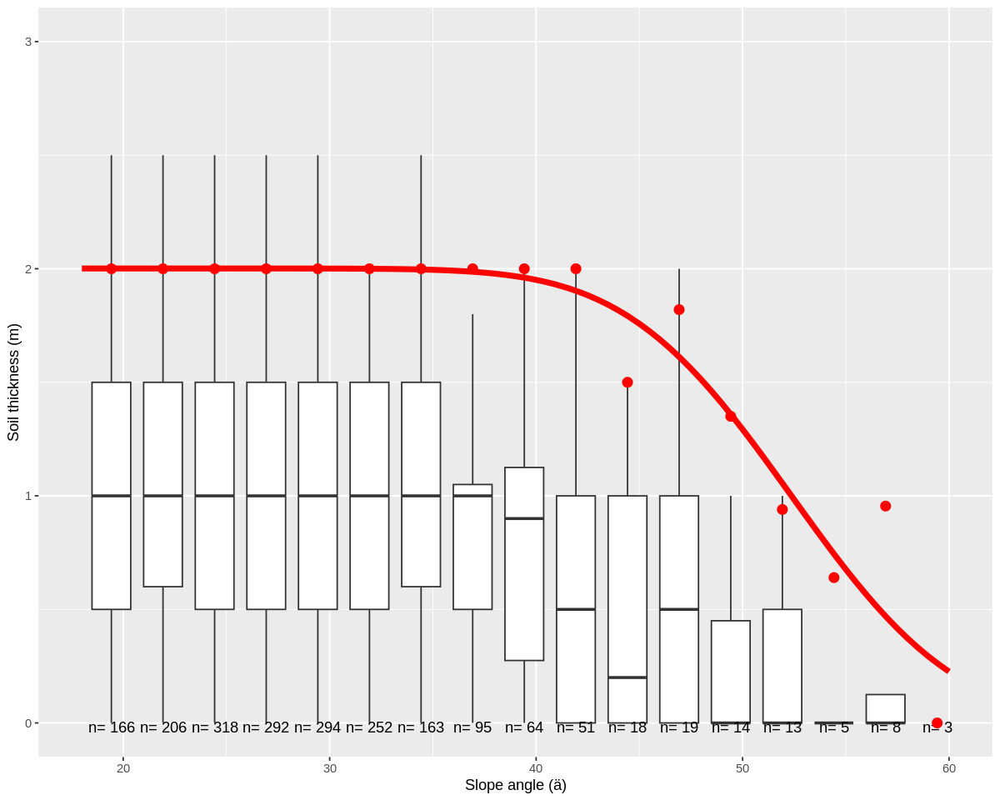

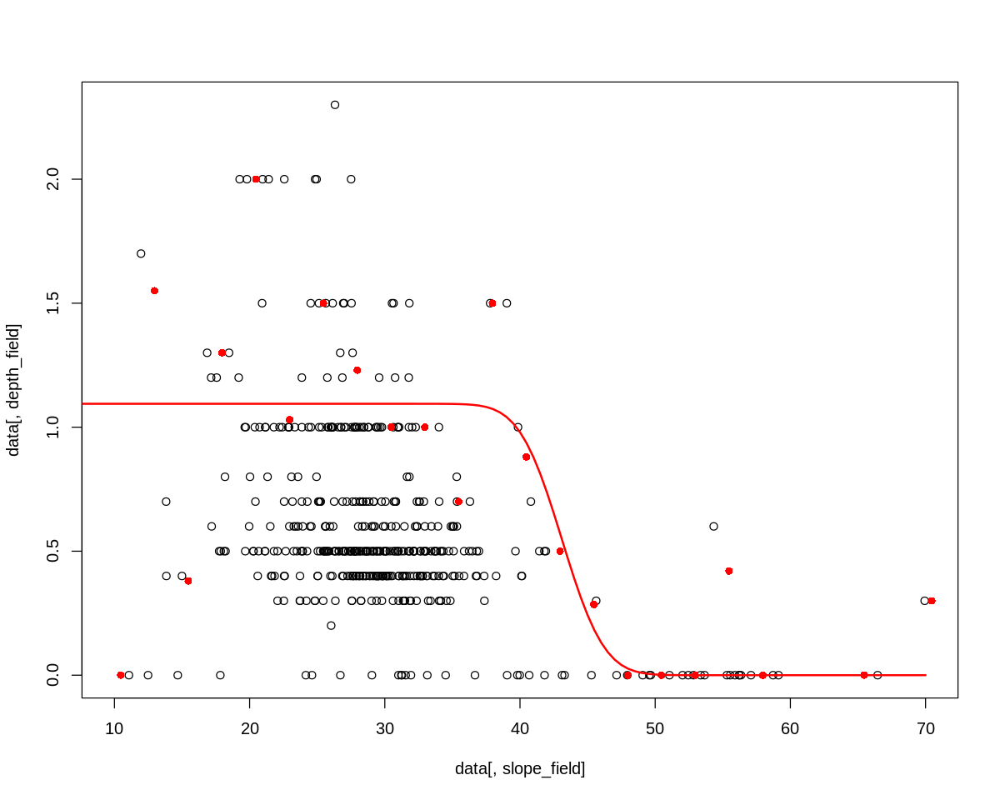

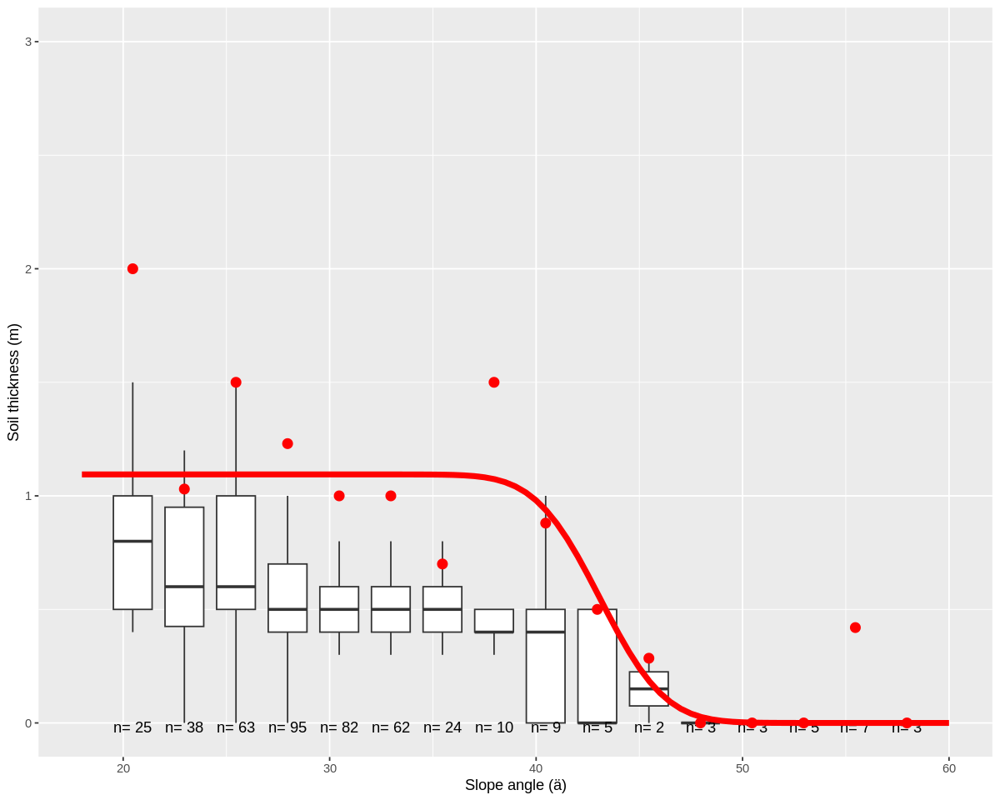

In [210]:
h_sfm_hmdb_25 <- fit_h_sfm(data_train_hmdb,seed=seed, slope_field="slope_25")
h_sfm_storme_25 <- fit_h_sfm(data_train_storme,seed=seed, slope_field="slope_25")
h_sfm_be_25 <- fit_h_sfm(data_train_be,seed=seed, slope_field="slope_25")


       a        b        c 
1.025409 2.064489 2.243768 


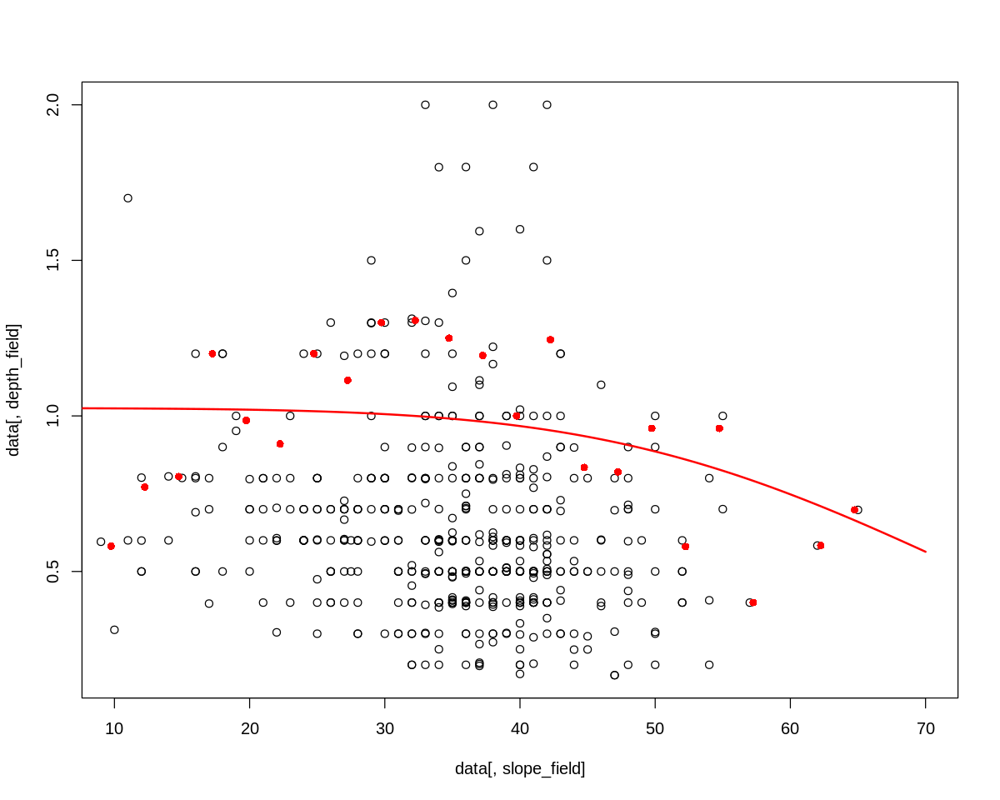

       a        b        c 
1.466411 1.427340 1.929875 


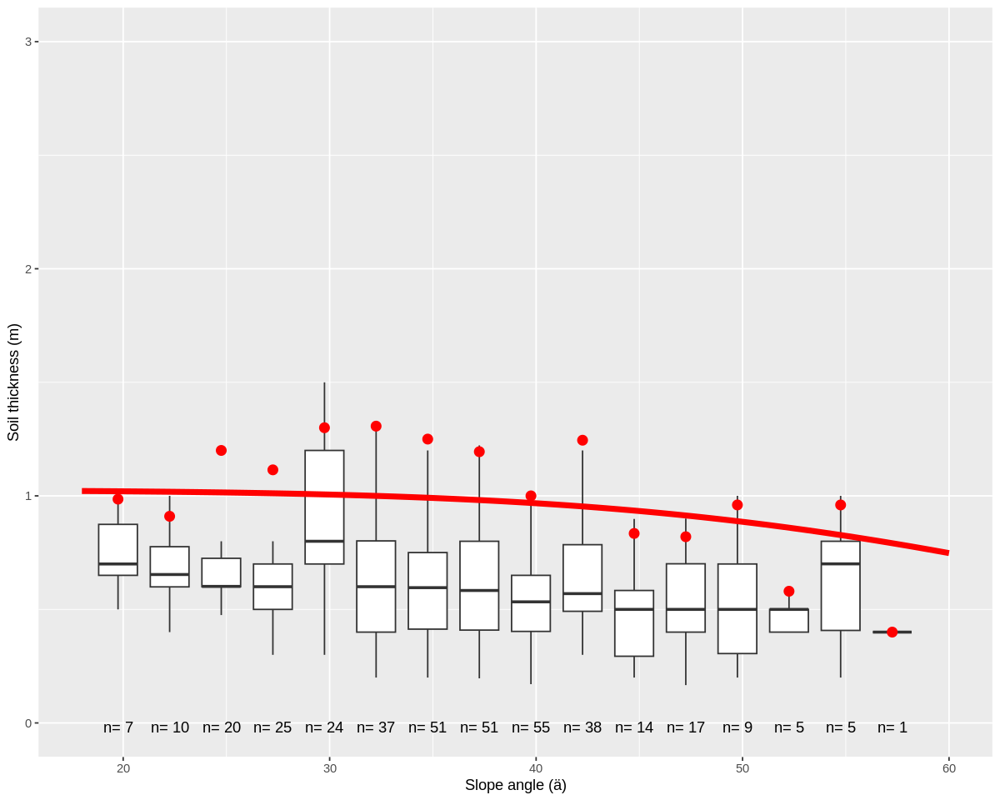

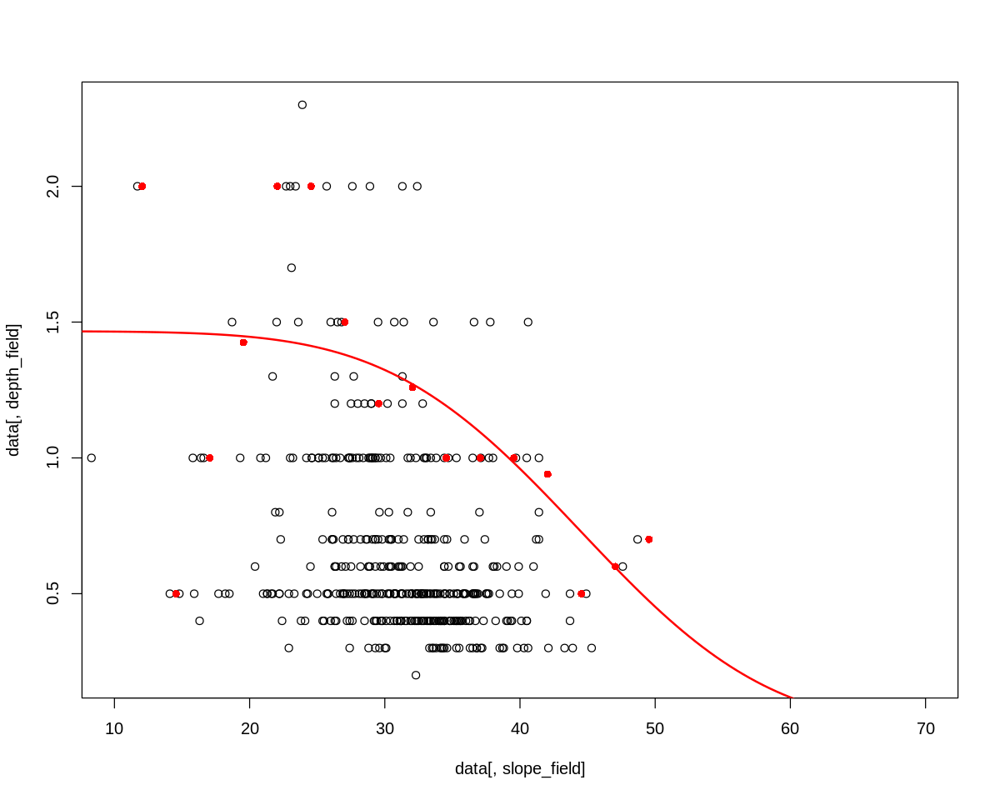

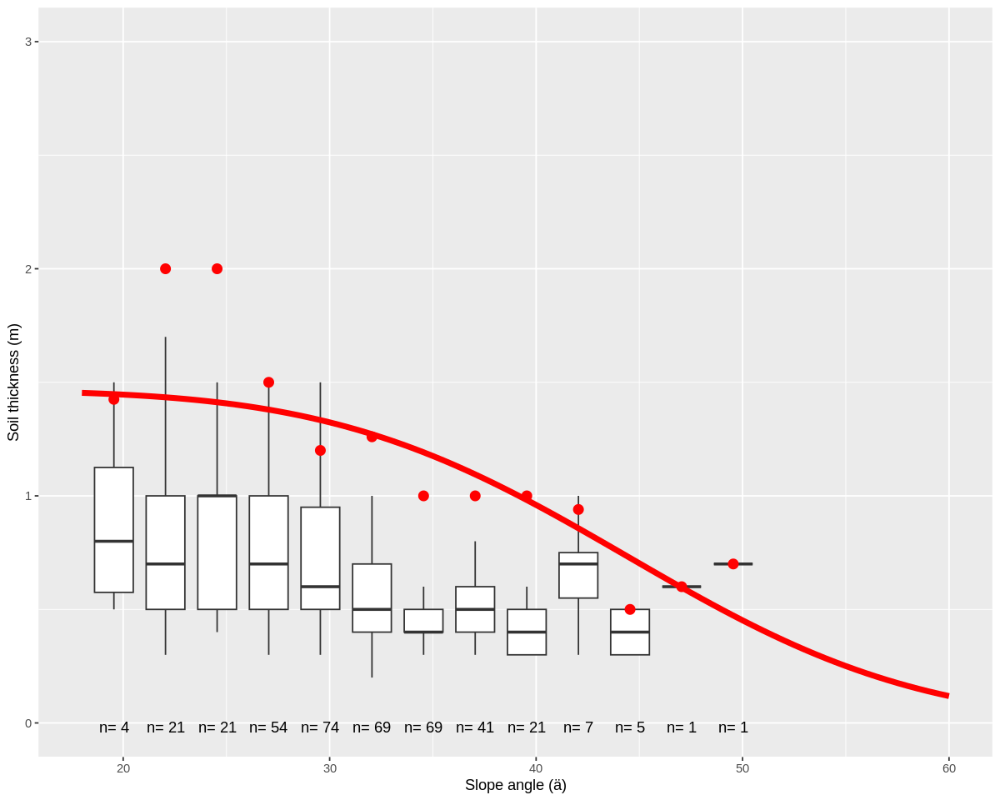

In [211]:
h_sfm_hmdb_db <- fit_h_sfm(data_train_hmdb,seed=seed, slope_field="Slope_DB")
# h_sfm_storme_db <- fit_h_sfm(data_train_storme,seed=seed, slope_field="Slope_DB") # not enough samples
h_sfm_be_db <- fit_h_sfm(data_train_be,seed=seed, slope_field="Slope_DB")


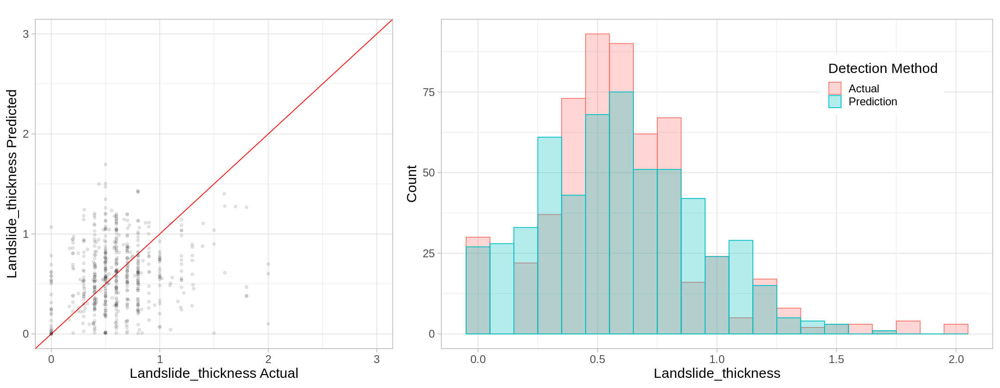

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
SFM,HMDB,HMDB,560,0.3271134,NA,0.6327581,0.4249196,0.02871086,1.592845e-06,⋯,0.3666306,NA,0.6327581,0.4829145,0.0003013359,0.01,1.431236,-0.9193901,1.79,0.7300202


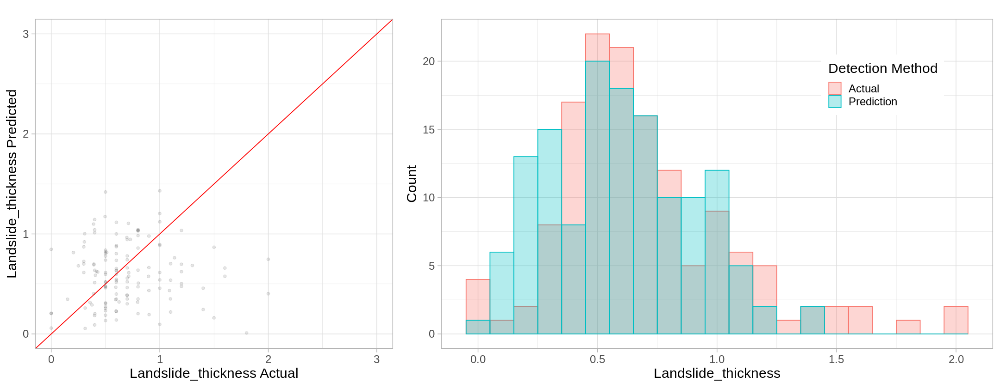

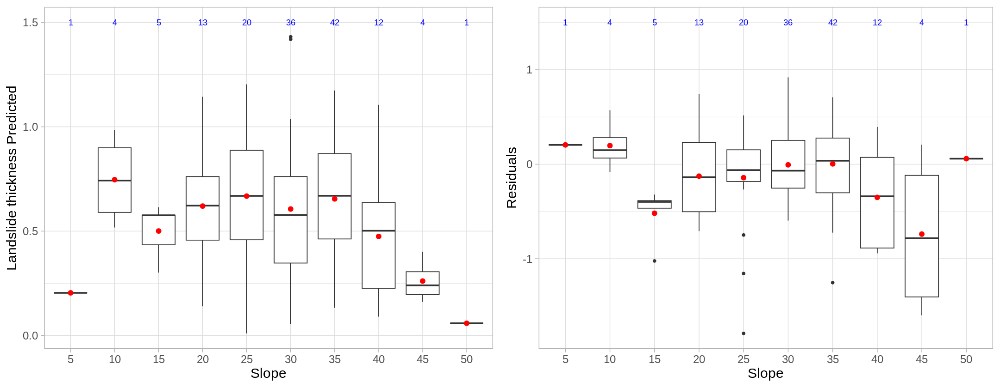

In [212]:
method_label <- "SFM"
train_label <- "HMDB"
test_label <- "HMDB"

pred_train_h_sfm_hmdb <- h_sfm_hmdb(data_train_hmdb$slope_10)
res_train <- score_model(data_train_hmdb_y,pred_train_h_sfm_hmdb,actual_label = y_column,plot=plot)

pred_test_h_sfm_hmdb <- h_sfm_hmdb(data_test_hmdb$slope_10)
res_test <- score_model(data_test_hmdb_y,pred_test_h_sfm_hmdb,actual_label = y_column,plot=plot)

res.h_sfm.hmdb <- merge_score_results(method_label, train_label, test_label, data_train_hmdb, res_train, data_test_hmdb, res_test) 
res.h_sfm.hmdb

model_box_plot(data_test_hmdb_y,pred_test_h_sfm_hmdb,data_test_hmdb$slope_10,bin_width=5,plot_resid=TRUE)


[1] "Cutoff 100 km"


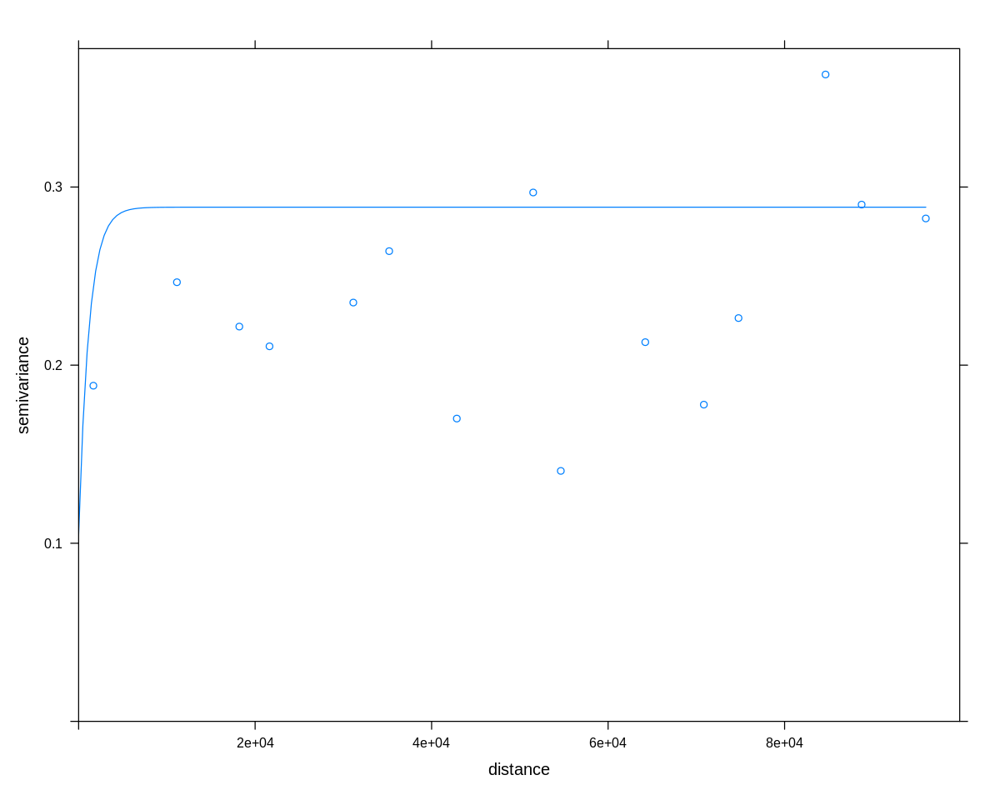


	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = 2.6835, p-value = 0.003642
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
     1.843420e-02     -7.299270e-03      9.195686e-05 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = 0.018434, observed rank = 969, p-value = 0.031
alternative hypothesis: greater


	Geary C test under randomisation

data:  spdf$resid 
weights: spdf.weights 

Geary C statistic standard deviate = 2.3098, p-value = 0.01045
alternative hypothesis: Expectation greater than statistic
sample estimates:
Geary C statistic       Expectation          Variance 
     0.9609239688      1.0000000000      0.0002862119 


	Monte-Carlo simulation of Geary C

data:  spdf$resid 
weights: spdf.weights 
number of simulations + 1: 1000 

statistic = 0.96092, observed rank = 20, p-

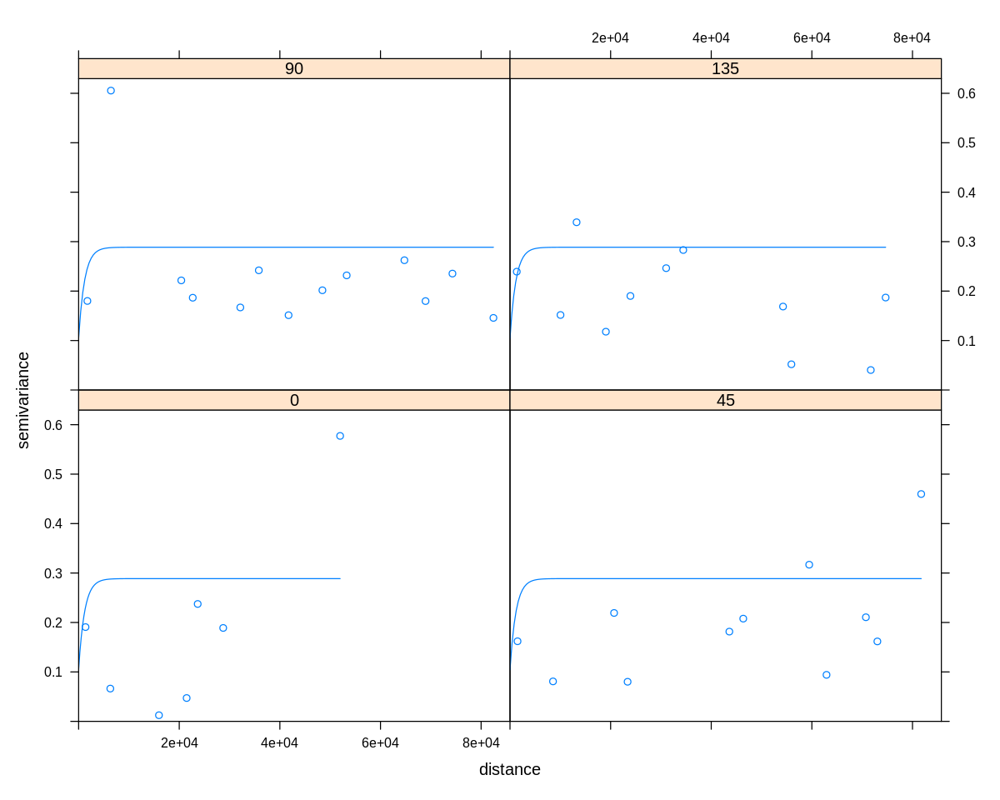

In [213]:
test_autocorrelation(data_test_hmdb.spdf,data_test_hmdb_y,pred_test_h_sfm_hmdb,cutoff=100000,model="Exp")

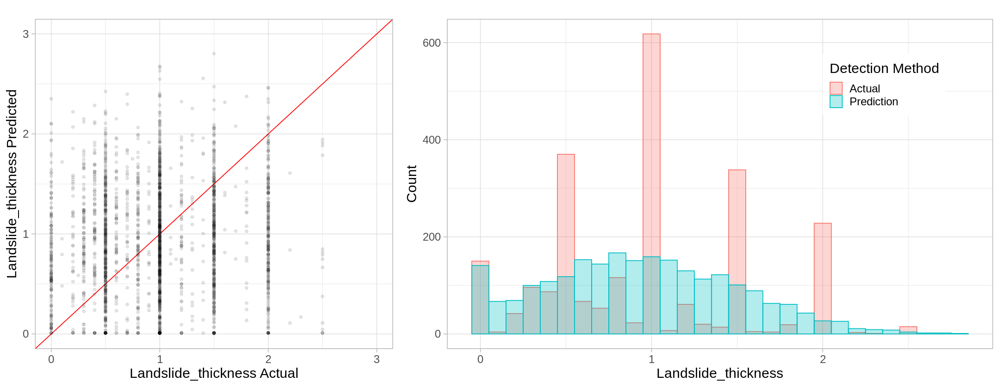

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
SFM,StorMe,StorMe,2341,0.6167757,NA,0.7699773,0.7638052,0.004029815,0.002038018,⋯,0.6219101,NA,0.7699773,0.7783897,0.0005520736,0.007871378,2.804235,-2.404235,2.49,1.312084


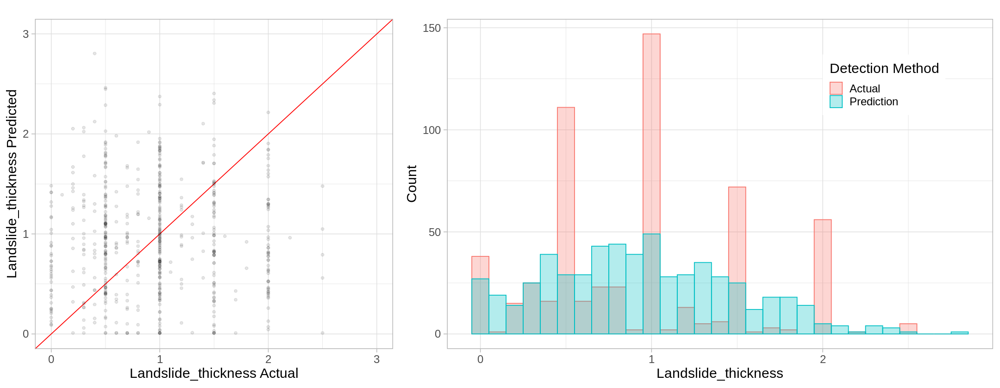

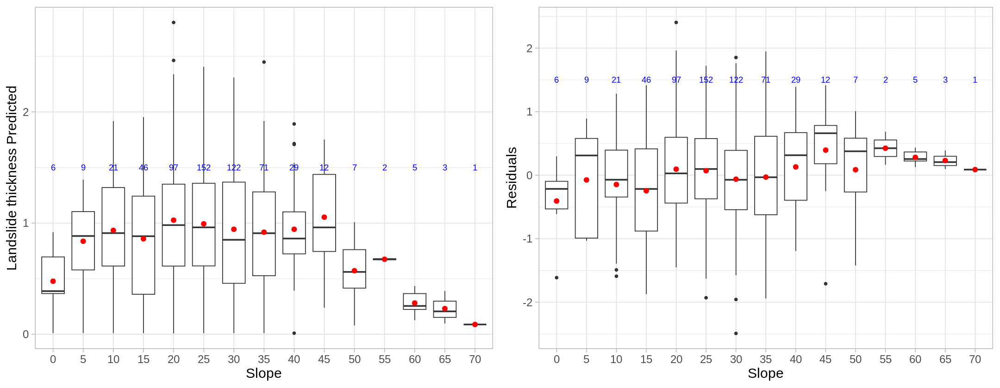

In [214]:
method_label <- "SFM"
train_label <- "StorMe"
test_label <- "StorMe"

pred_train_h_sfm_storme <- h_sfm_storme(data_train_storme$slope_10)
res_train <- score_model(data_train_storme_y,pred_train_h_sfm_storme,actual_label = y_column,plot=plot)

pred_test_h_sfm_storme <- h_sfm_storme(data_test_storme$slope_10)
res_test <- score_model(data_test_storme_y,pred_test_h_sfm_storme,actual_label = y_column,plot=plot)

res.h_sfm.storme <- merge_score_results(method_label, train_label, test_label, data_train_storme, res_train, data_test_storme, res_test) 
res.h_sfm.storme

model_box_plot(data_test_storme_y,pred_test_h_sfm_storme,data_test_storme$slope_10,bin_width=5,plot_resid=TRUE)


[1] "Cutoff 100 km"


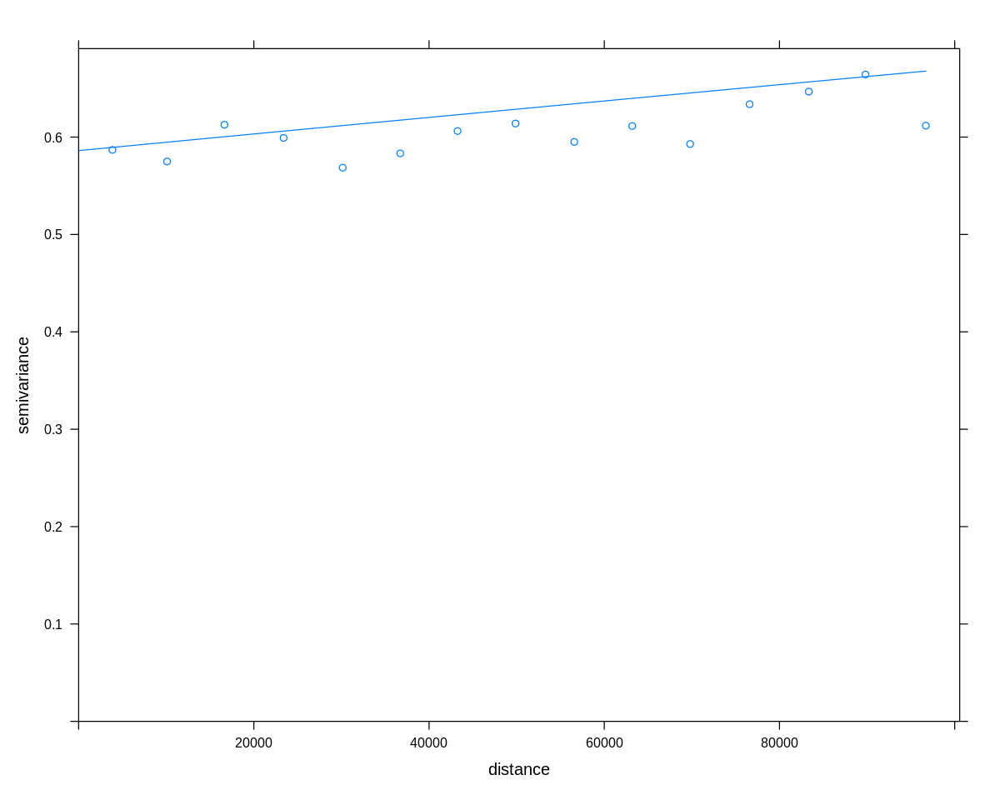


	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = 0.54461, p-value = 0.293
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
    -9.308316e-04     -1.718213e-03      2.090239e-06 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = -0.00093083, observed rank = 795, p-value = 0.205
alternative hypothesis: greater


	Geary C test under randomisation

data:  spdf$resid 
weights: spdf.weights 

Geary C statistic standard deviate = 0.076638, p-value = 0.4695
alternative hypothesis: Expectation greater than statistic
sample estimates:
Geary C statistic       Expectation          Variance 
     9.996131e-01      1.000000e+00      2.547989e-05 


	Monte-Carlo simulation of Geary C

data:  spdf$resid 
weights: spdf.weights 
number of simulations + 1: 1000 

statistic = 0.99961, observed rank = 467,

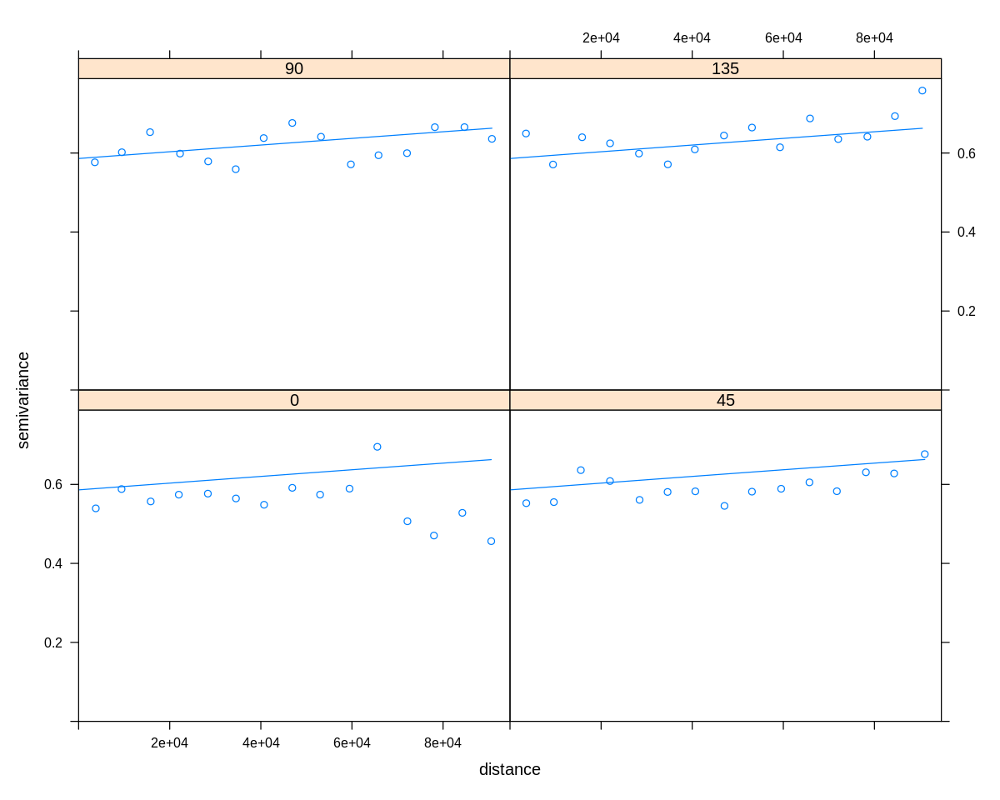

In [215]:
test_autocorrelation(data_test_storme.spdf,data_test_storme_y,pred_test_h_sfm_storme,cutoff=100000,model="Exp")

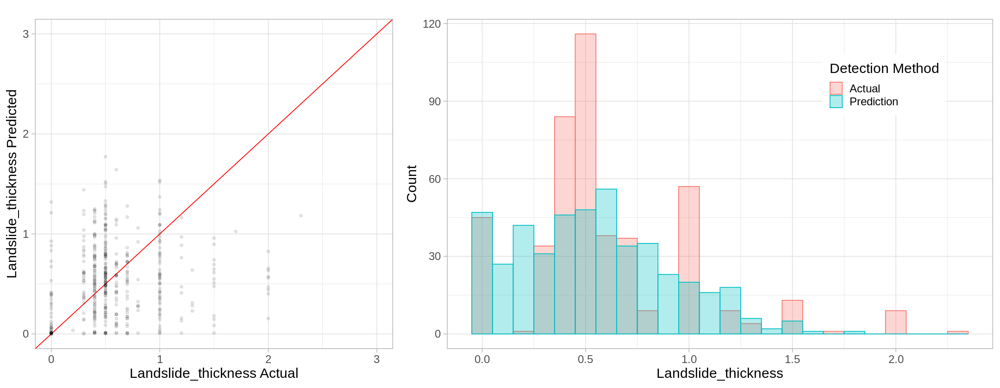

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
SFM,BE,BE,458,0.3813325,NA,0.8004973,0.5094729,0.01357441,1.019847e-06,⋯,0.3625675,NA,0.8004973,0.4950253,0.01538095,0.00230575,1.554597,-1.235787,1.754222,0.81374


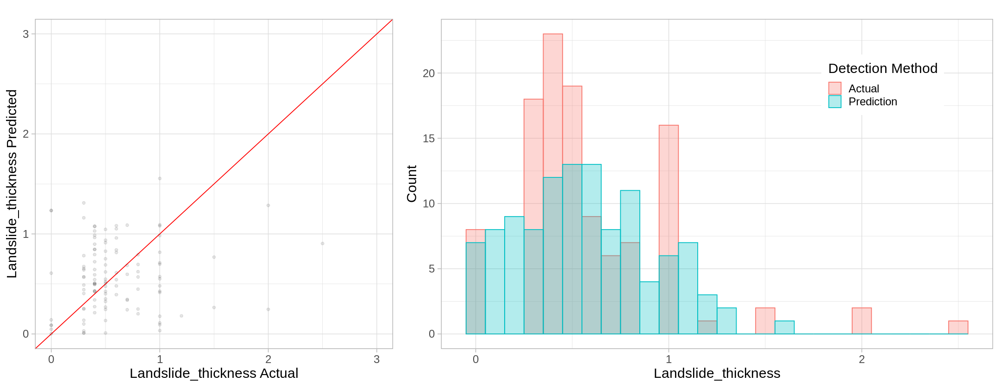

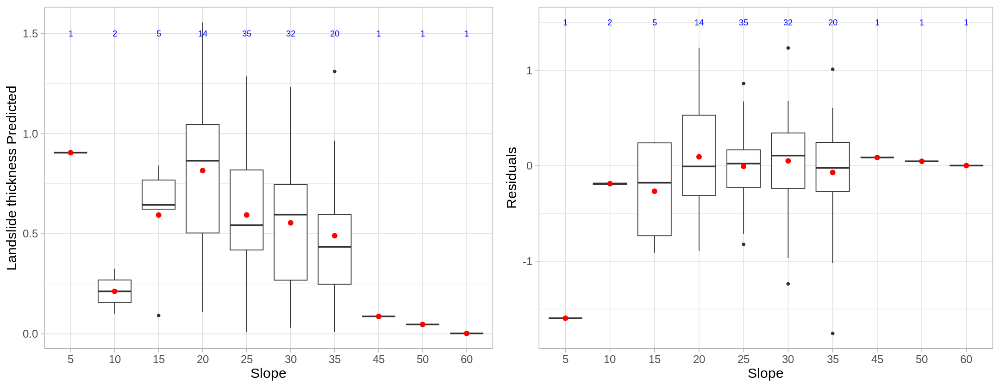

In [216]:
method_label <- "SFM"
train_label <- "BE"
test_label <- "BE"

pred_train_h_sfm_be <- h_sfm_be(data_train_be$slope_10)
res_train <- score_model(data_train_be_y,pred_train_h_sfm_be,actual_label = y_column,plot=plot)

pred_test_h_sfm_be <- h_sfm_be(data_test_be$slope_10)
res_test <- score_model(data_test_be_y,pred_test_h_sfm_be,actual_label = y_column,plot=plot)

res.h_sfm.be <- merge_score_results(method_label, train_label, test_label, data_train_be, res_train, data_test_be, res_test) 
res.h_sfm.be

model_box_plot(data_test_be_y,pred_test_h_sfm_be,data_test_be$slope_10,bin_width=5,plot_resid=TRUE)


[1] "Cutoff 100 km"


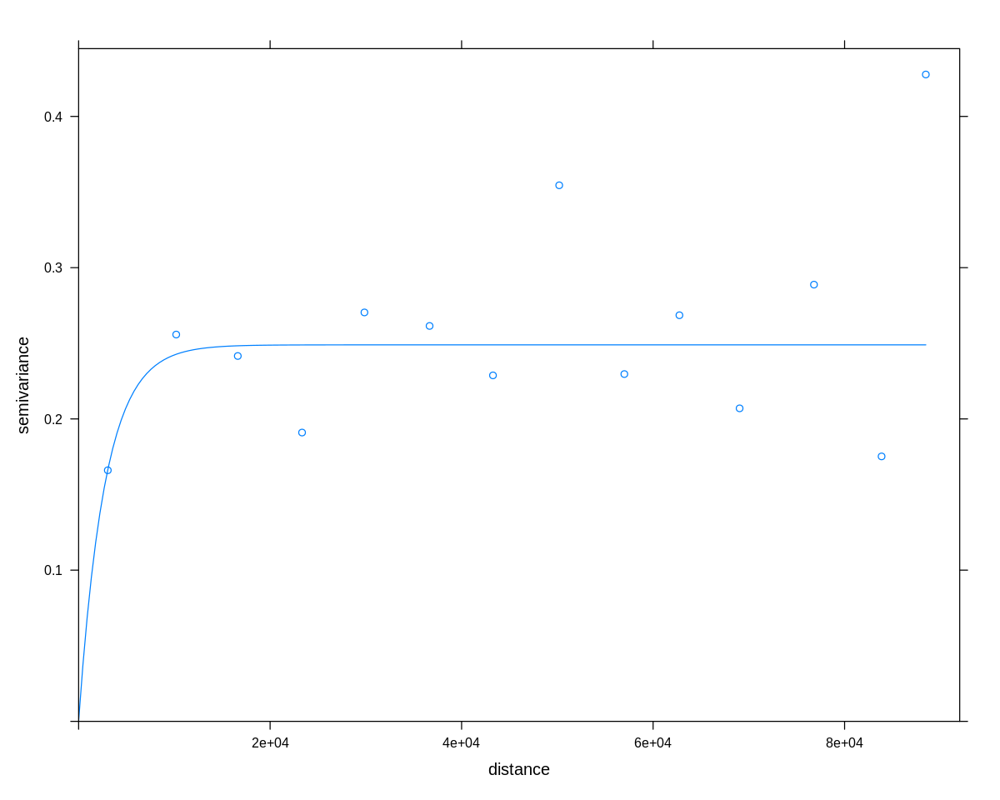


	Moran I test under randomisation

data:  spdf$resid  
weights: spdf.weights    

Moran I statistic standard deviate = NaN, p-value = NA
alternative hypothesis: greater
sample estimates:
Moran I statistic       Expectation          Variance 
    -9.009009e-03     -9.009009e-03     -6.364267e-17 


	Monte-Carlo simulation of Moran I

data:  spdf$resid 
weights: spdf.weights  
number of simulations + 1: 1000 

statistic = -0.009009, observed rank = 818, p-value = 0.182
alternative hypothesis: greater


	Geary C test under randomisation

data:  spdf$resid 
weights: spdf.weights 

Geary C statistic standard deviate = NaN, p-value = NA
alternative hypothesis: Expectation greater than statistic
sample estimates:
Geary C statistic       Expectation          Variance 
     1.000000e+00      1.000000e+00     -7.076799e-18 


	Monte-Carlo simulation of Geary C

data:  spdf$resid 
weights: spdf.weights 
number of simulations + 1: 1000 

statistic = 1, observed rank = 499.5, p-value = 0.4995
alte

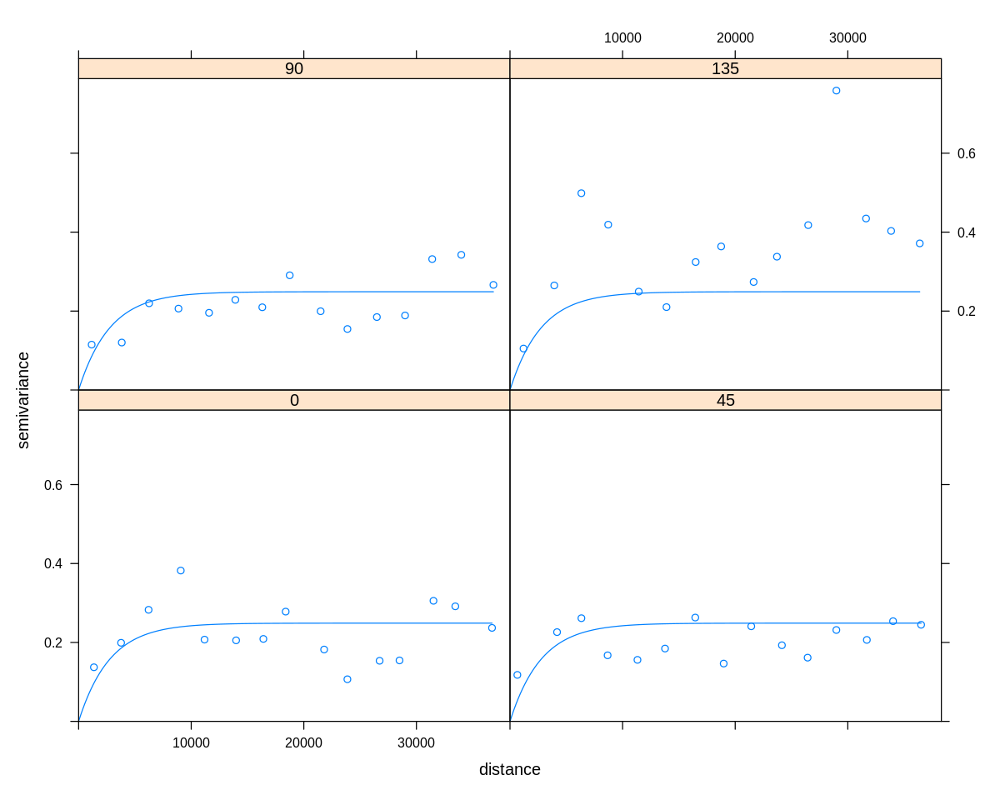

In [217]:
test_autocorrelation(data_test_be.spdf,data_test_be_y,pred_test_h_sfm_be,cutoff=100000,model="Exp")

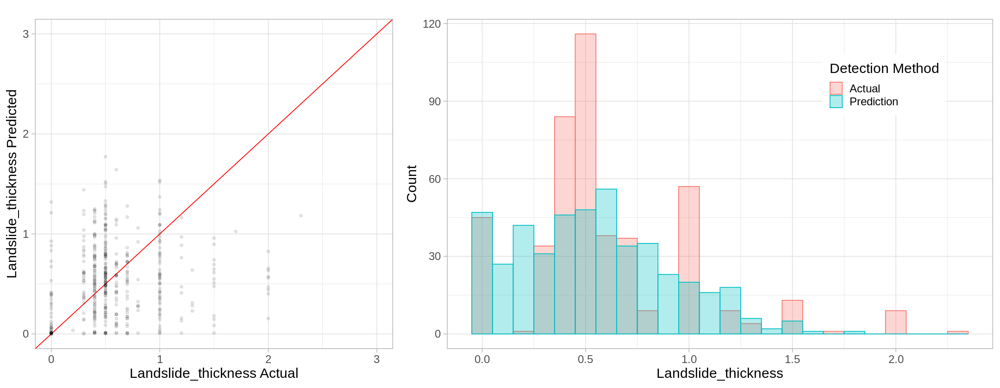

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
SFM,BE,HMDB,458,0.3813325,NA,0.8004973,0.5094729,0.01357441,1.019847e-06,⋯,0.3618457,NA,0.8004973,0.4747591,0.009466226,4.134079e-06,1.642725,-1.102335,1.99,0.7396645


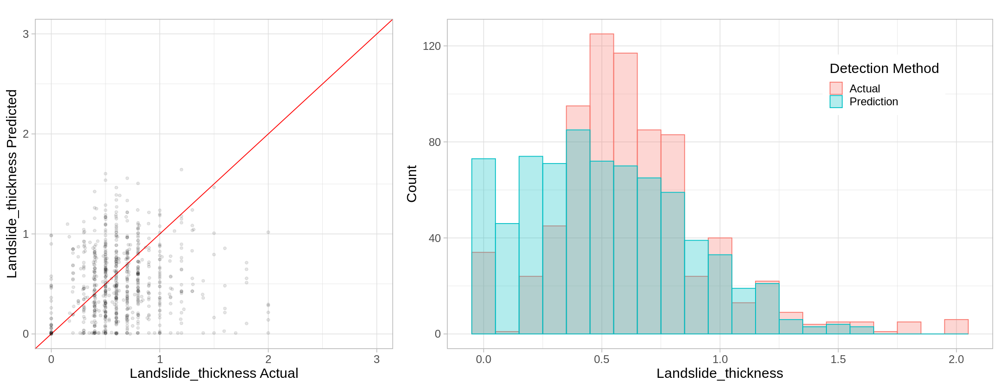

In [218]:
method_label <- "SFM"
train_label <- "BE"
test_label <- "HMDB"

pred_train_h_sfm_be_hmdb <- h_sfm_be(data_train_be_hmdb$slope_10)
res_train <- score_model(data_train_be_hmdb_y,pred_train_h_sfm_be_hmdb,actual_label = y_column,plot=plot)

pred_test_h_sfm_be_hmdb <- h_sfm_be(data_test_be_hmdb$slope_10)
res_test <- score_model(data_test_be_hmdb_y,pred_test_h_sfm_be_hmdb,actual_label = y_column,plot=plot)

res.h_sfm.be_hmdb <- merge_score_results(method_label, train_label, test_label, data_train_be_hmdb, res_train, data_test_be_hmdb, res_test) 
res.h_sfm.be_hmdb




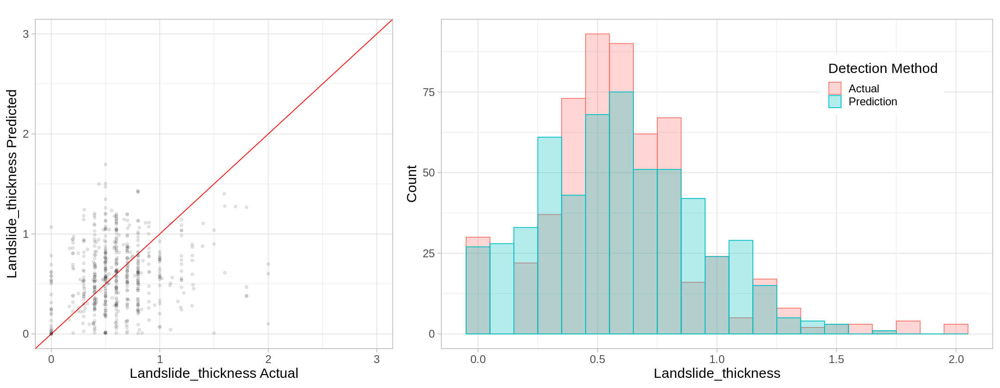

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
SFM,HMDB,BE,560,0.3271134,NA,0.6327581,0.4249196,0.02871086,1.592845e-06,⋯,0.3537681,NA,0.6327581,0.4638602,0.03955826,1.863939e-06,1.707635,-1.133886,1.565494,0.7707384


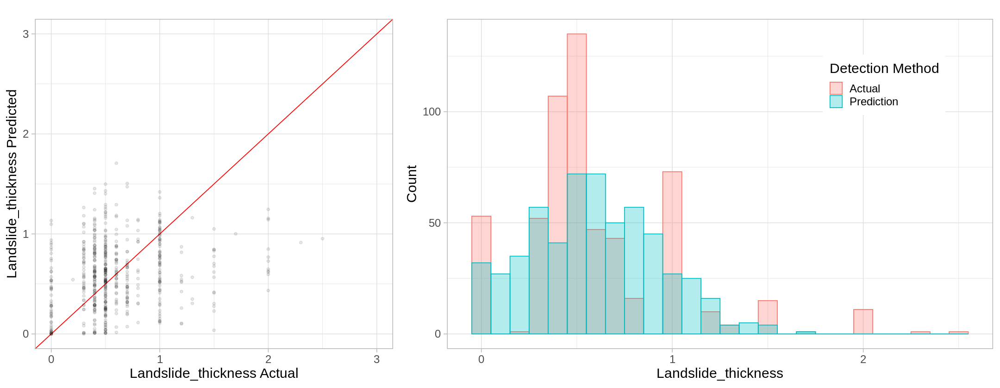

In [219]:
method_label <- "SFM"
train_label <- "HMDB"
test_label <- "BE"

pred_train_h_sfm_hmdb_be <- h_sfm_hmdb(data_train_hmdb_be$slope_10)
res_train <- score_model(data_train_hmdb_be_y,pred_train_h_sfm_hmdb_be,actual_label = y_column,plot=plot)

pred_test_h_sfm_hmdb_be <- h_sfm_hmdb(data_test_hmdb_be$slope_10)
res_test <- score_model(data_test_hmdb_be_y,pred_test_h_sfm_hmdb_be,actual_label = y_column,plot=plot)

res.h_sfm.hmdb_be <- merge_score_results(method_label, train_label, test_label, data_train_hmdb_be, res_train, data_test_hmdb_be, res_test) 
res.h_sfm.hmdb_be




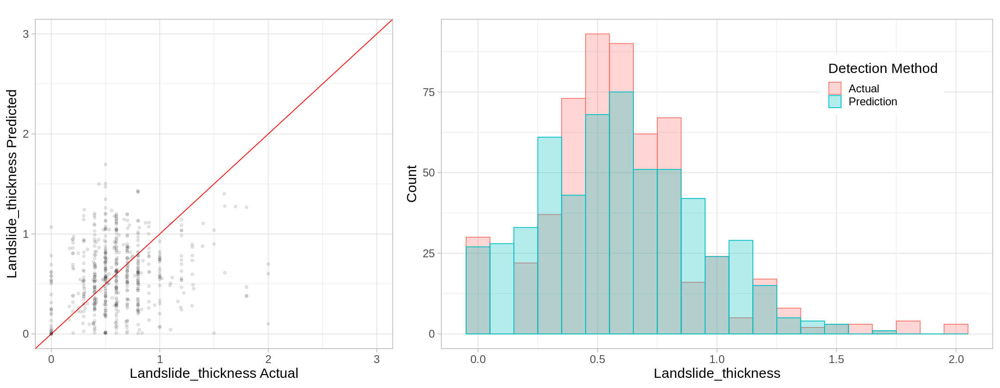

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
SFM,HMDB,StorMe,560,0.3271134,NA,0.6327581,0.4249196,0.02871086,1.592845e-06,⋯,0.5804339,NA,0.6327581,0.7392296,0.004939899,4.038791e-07,1.70763,-1.517942,2.49,1.272439


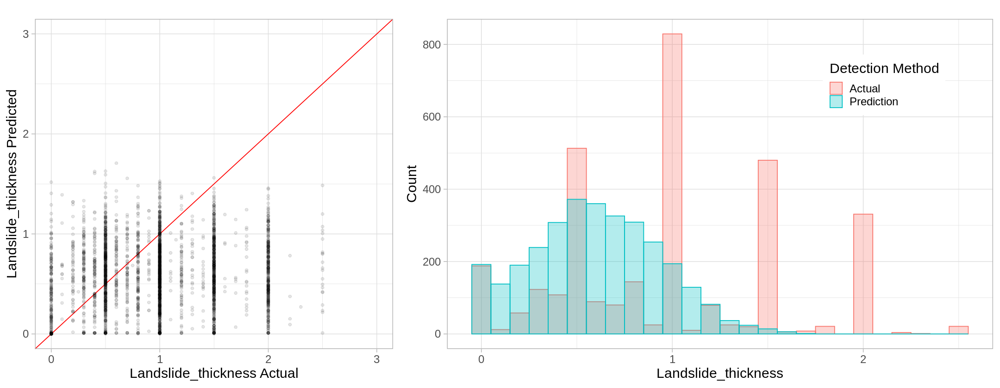

In [220]:
method_label <- "SFM"
train_label <- "HMDB"
test_label <- "StorMe"

pred_train_h_sfm_hmdb_storme <- h_sfm_hmdb(data_train_hmdb_storme$slope_10)
res_train <- score_model(data_train_hmdb_storme_y,pred_train_h_sfm_hmdb_storme,actual_label = y_column,plot=plot)

pred_test_h_sfm_hmdb_storme <- h_sfm_hmdb(data_test_hmdb_storme$slope_10)
res_test <- score_model(data_test_hmdb_storme_y,pred_test_h_sfm_hmdb_storme,actual_label = y_column,plot=plot)

res.h_sfm.hmdb_storme <- merge_score_results(method_label, train_label, test_label, data_train_hmdb_storme, res_train, data_test_hmdb_storme, res_test) 
res.h_sfm.hmdb_storme




<a id="Paper_Graphics"></a>
## Publication Graphics

<a id="Paper_Model_Result_Summary"></a>
### Result Summary

Summarize model results as table for the publication.

In [221]:
options(repr.matrix.max.rows=600, repr.matrix.max.cols=20)

In [222]:
result.df <- do.call("rbind",list(
    res.rf.hmdb,res.rf.be,res.rf.be_hmdb,res.rf.hmdb_be,
    res.gam.hmdb,res.gam.be,res.gam.be_hmdb,res.gam.hmdb_be, 
    res.lm.hmdb,res.lm.be,res.lm.be_hmdb,res.lm.hmdb_be,
    res.h_s.hmdb,res.h_s.be,res.h_s.be_hmdb,res.h_s.hmdb_be,
    res.h_z.hmdb,res.h_z.be,res.h_z.be_hmdb,res.h_z.hmdb_be,
    res.h_sfm.hmdb,res.h_sfm.be,res.h_sfm.be_hmdb,res.h_sfm.hmdb_be#,
    
))



result.df 

method,train_dataset,test_dataset,n_train,train_mae,train_mape,train_smape,train_rmse,train_r2,train_min_pred,⋯,test_mae,test_mape,test_smape,test_rmse,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Random Forest,HMDB,HMDB,560,0.1428479,NA,0.3198725,0.2099668,0.71248723,1.437605e-02,⋯,0.2535956,NA,0.3198725,0.3638145,0.0645772459,1.951438e-02,0.8391896,-0.5399454,1.4127336,0.5597222
Random Forest,BE,BE,458,0.1335114,NA,0.3681979,0.2108394,0.76885959,5.495427e-03,⋯,0.1877475,NA,0.3681979,0.3023669,0.4674086928,8.495427e-03,1.1255652,-0.5759328,1.6664931,0.3705817
Random Forest,BE,HMDB,458,0.1335114,NA,0.3681979,0.2108394,0.76885959,5.495427e-03,⋯,0.2549180,NA,0.3681979,0.3589404,0.0662842845,5.495427e-03,1.1644754,-0.6881773,1.6529972,0.5454216
Random Forest,HMDB,BE,560,0.1428479,NA,0.3198725,0.2099668,0.71248723,1.437605e-02,⋯,0.2863202,NA,0.3198725,0.3738933,0.1334415472,4.396218e-03,0.8873586,-0.7703911,1.8600576,0.5181365
GAM,HMDB,HMDB,560,0.2058405,NA,0.4096095,0.2902076,0.22434500,-2.058910e-01,⋯,0.2492609,NA,0.4096095,0.3587569,0.0899383085,7.693728e-02,0.7858869,-0.4815611,1.4852416,0.4988124
GAM,BE,BE,458,0.1961832,NA,0.4629394,0.2821881,0.48965793,-1.748368e-01,⋯,0.1983808,NA,0.4629394,0.3261354,0.3392230880,-1.845285e-01,1.1708287,-0.4216493,2.0514068,0.3908963
GAM,BE,HMDB,458,0.1961832,NA,0.4629394,0.2821881,0.48965793,-1.748368e-01,⋯,0.2585910,NA,0.4629394,0.3718696,0.0636896835,-2.955292e-01,2.7271866,-2.0545834,1.6020975,0.5680674
GAM,HMDB,BE,560,0.2058405,NA,0.4096095,0.2902076,0.22434500,-2.058910e-01,⋯,0.2691997,NA,0.4096095,0.3573741,0.1928428826,-2.869751e-01,0.8034294,-0.6438314,1.9774239,0.4214911
LM,HMDB,HMDB,560,0.2102958,NA,0.4138740,0.2962727,0.19031381,-2.236970e-01,⋯,0.2497297,NA,0.4138740,0.3588504,0.0869070051,1.556054e-01,0.8854671,-0.4128305,1.5059448,0.4941453


In [223]:
colnames(result.df)

[1] "method"         "train_dataset"  "test_dataset"   "n_train"       
 [5] "train_mae"      "train_mape"     "train_smape"    "train_rmse"    
 [9] "train_r2"       "train_min_pred" "train_max_pred" "train_min_err" 
[13] "train_max_err"  "train_ae_p90"   "n_test"         "test_mae"      
[17] "test_mape"      "test_smape"     "test_rmse"      "test_r2"       
[21] "test_min_pred"  "test_max_pred"  "test_min_err"   "test_max_err"  
[25] "test_ae_p90"

In [224]:
result.df <- result.df[,c(
    'method','train_dataset','test_dataset'
    # ,'n_train','train_mae','train_mape','train_r2'
    ,'n_test','test_mae',
    # 'test_mape',
    # 'test_smape',
    'test_r2'
    ,'test_min_pred','test_max_pred'
    ,'test_min_err','test_max_err','test_ae_p90'
    
)]

for (col in c(
    # 'train_mae','train_mape','train_r2',
              'test_mae',
                # 'test_mape',
                # 'test_smape',
                'test_r2'
                ,'test_min_pred','test_max_pred'
                ,'test_min_err','test_max_err','test_ae_p90')) {
  result.df[,col] <- round(result.df[,col],2)
}

result.df

stargazer::stargazer(result.df,
                     title="Modelling result summary",label="tab:modelling_summary",
                     rownames = FALSE,
                     type="latex",summary=FALSE)



method,train_dataset,test_dataset,n_test,test_mae,test_r2,test_min_pred,test_max_pred,test_min_err,test_max_err,test_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Random Forest,HMDB,HMDB,138,0.25,0.06,0.02,0.84,-0.54,1.41,0.56
Random Forest,BE,BE,112,0.19,0.47,0.01,1.13,-0.58,1.67,0.37
Random Forest,BE,HMDB,743,0.25,0.07,0.01,1.16,-0.69,1.65,0.55
Random Forest,HMDB,BE,570,0.29,0.13,0.00,0.89,-0.77,1.86,0.52
GAM,HMDB,HMDB,138,0.25,0.09,0.08,0.79,-0.48,1.49,0.50
GAM,BE,BE,112,0.20,0.34,-0.18,1.17,-0.42,2.05,0.39
GAM,BE,HMDB,743,0.26,0.06,-0.30,2.73,-2.05,1.60,0.57
GAM,HMDB,BE,570,0.27,0.19,-0.29,0.80,-0.64,1.98,0.42
LM,HMDB,HMDB,138,0.25,0.09,0.16,0.89,-0.41,1.51,0.49



% Table created by stargazer v.5.2.3 by Marek Hlavac, Social Policy Institute. E-mail: marek.hlavac at gmail.com
% Date and time: Mon, Apr 22, 2024 - 08:30:56 AM
\begin{table}[!htbp] \centering 
  \caption{Modelling result summary} 
  \label{tab:modelling_summary} 
\begin{tabular}{@{\extracolsep{5pt}} ccccccccccc} 
\\[-1.8ex]\hline 
\hline \\[-1.8ex] 
method & train\_dataset & test\_dataset & n\_test & test\_mae & test\_r2 & test\_min\_pred & test\_max\_pred & test\_min\_err & test\_max\_err & test\_ae\_p90 \\ 
\hline \\[-1.8ex] 
Random Forest & HMDB & HMDB & 138 & 0.25 & 0.06 & 0.02 & 0.84 & -0.54 & 1.41 & 0.56 \\ 
Random Forest & BE & BE & 112 & 0.19 & 0.47 & 0.01 & 1.13 & -0.58 & 1.67 & 0.37 \\ 
Random Forest & BE & HMDB & 743 & 0.25 & 0.07 & 0.01 & 1.16 & -0.69 & 1.65 & 0.55 \\ 
Random Forest & HMDB & BE & 570 & 0.29 & 0.13 & 0 & 0.89 & -0.77 & 1.86 & 0.52 \\ 
GAM & HMDB & HMDB & 138 & 0.25 & 0.09 & 0.08 & 0.79 & -0.48 & 1.49 & 0.5 \\ 
GAM & BE & BE & 112 & 0.2 & 0.34 & -0.18 & 1.

In [225]:
result.df <- do.call("rbind",list(
    res.rf.hmdb,res.rf.be,res.rf.be_hmdb,res.rf.hmdb_be,
    res.gam.hmdb,res.gam.be,res.gam.be_hmdb,res.gam.hmdb_be, 
    res.lm.hmdb,res.lm.be,res.lm.be_hmdb,res.lm.hmdb_be,
    res.h_s.hmdb,res.h_s.be,res.h_s.be_hmdb,res.h_s.hmdb_be,
    res.h_z.hmdb,res.h_z.be,res.h_z.be_hmdb,res.h_z.hmdb_be,
    res.h_sfm.hmdb,res.h_sfm.be,res.h_sfm.be_hmdb,res.h_sfm.hmdb_be#,
    
))


result.df <- result.df[,c(
    'method','train_dataset','train_dataset'
    # ,'n_train','train_mae','train_mape','train_r2'
    ,'n_train','train_mae',
    # 'train_mape',
    # 'train_smape',
    'train_r2'
    ,'test_min_pred','test_max_pred'
    ,'train_min_err','train_max_err','train_ae_p90'
)]

for (col in c(
    # 'train_mae','train_mape','train_r2',
              'train_mae',
                # 'train_mape',
                # 'train_smape',
                'train_r2'
            ,'test_min_pred','test_max_pred'
                ,'train_min_err','train_max_err','train_ae_p90')) {
  result.df[,col] <- round(result.df[,col],2)
}

result.df

# stargazer::stargazer(result.df,
#                      title="Modelling result summary",label="tab:modelling_summary",
#                      rownames = FALSE,
#                      type="latex",summary=FALSE)

method,train_dataset,train_dataset,n_train,train_mae,train_r2,test_min_pred,test_max_pred,train_min_err,train_max_err,train_ae_p90
<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Random Forest,HMDB,HMDB,560,0.14,0.71,0.02,0.84,-0.51,1.09,0.31
Random Forest,BE,BE,458,0.13,0.77,0.01,1.13,-0.53,1.15,0.29
Random Forest,BE,BE,458,0.13,0.77,0.01,1.16,-0.53,1.15,0.29
Random Forest,HMDB,HMDB,560,0.14,0.71,0.00,0.89,-0.51,1.09,0.31
GAM,HMDB,HMDB,560,0.21,0.22,0.08,0.79,-0.51,1.40,0.43
GAM,BE,BE,458,0.20,0.49,-0.18,1.17,-0.63,1.41,0.40
GAM,BE,BE,458,0.20,0.49,-0.30,2.73,-0.63,1.41,0.40
GAM,HMDB,HMDB,560,0.21,0.22,-0.29,0.80,-0.51,1.40,0.43
LM,HMDB,HMDB,560,0.21,0.19,0.16,0.89,-0.51,1.42,0.42


In [226]:
options(repr.matrix.max.rows=60, repr.matrix.max.cols=20)

<a id="Paper_Plots"></a>
### Plots

Generate graphics for publication.

In [227]:
merged.df.vis <- merged.df[(merged.df$Dataset=="HMDB") | (merged.df$Dataset=="KtBE") | (merged.df$Dataset=="StorMe"),]

nrow(merged.df)
nrow(merged.df.vis)

[1] 4214

[1] 4214

In [228]:
kt.tbl <- table(merged.df.vis$Kanton,merged.df.vis$Dataset)
ftable(kt.tbl)


                 HMDB KtBE StorMe
                                 
Appenzell A.Rh.   103    0     12
Appenzell I.Rh.     2    0      0
Bern              170  483   1980
Freiburg            0    1     14
Graubünden        106    0    410
Luzern             86   33     97
Nidwalden           0    0     53
Obwalden          240    0    232
Schwyz              0    0     60
Solothurn           0    0     29
Uri                 0    0     72
Waadt               1    0      0
Zug                 0    0     29
Zürich              1    0      0

In [229]:
summary(merged.df.hmdb$Landslide_thickness)
summary(merged.df.be$Landslide_thickness)
summary(merged.df.vis$Landslide_thickness)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 0.0000  0.4074  0.6000  0.6372  0.8000  2.0000 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 0.0000  0.4000  0.5000  0.5937  0.7000  2.5000 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 0.1000  0.5000  0.8970  0.9282  1.2000  2.5000 

In [230]:
summary(merged.df.hmdb$Failure_volume)
summary(merged.df.be$Failure_volume)
summary(merged.df.vis$Failure_volume)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
    0.0    32.0    65.0   143.5   144.0  3400.0      45 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
    0.0    32.0    80.0   208.5   220.0  4000.0 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
      1      40     100     474     300  100000     296 

In [231]:
merged.df.grouped <- group_by(merged.df.vis,Dataset) 
merged.df.summary <- summarise(merged.df.grouped
                            ,Count=n()
                            ,Min.Slope5=round(min(slope_5),1)
                            ,Median.Slope5=round(median(slope_5),1)
                            ,Min.Year=min(Year,na.rm=TRUE)
                            ,Max.Year=max(Year,na.rm=TRUE)
                            ,NA.Year=sum(is.na(Year))
                            ,Mean.Slope5=round(mean(slope_5),1)
                            ,Max.Slope5=round(max(slope_5),1)
                            ,SD.Slope5=round(sd(slope_5),1)
                            ,Min.Slope10=round(min(slope_10),1)
                            ,Median.Slope10=round(median(slope_10),1)
                            ,Mean.Slope10=round(mean(slope_10),1)
                            ,Max.Slope10=round(max(slope_10),1)
                            ,SD.Slope10=round(sd(slope_10),1)                          
                            ,Min.Slope25=round(min(slope_25),1)
                            ,Median.Slope25=round(median(slope_25),1)
                            ,Mean.Slope25=round(mean(slope_25),1)
                            ,Max.Slope25=round(max(slope_25),1)
                            ,SD.Slope25=round(sd(slope_25),1)
                            ,Min.h_5=round(min(h_5),0)
                            ,Median.h_5=round(median(h_5),0)
                            ,Mean.h_5=round(mean(h_5),0)
                            ,Max.h_5=round(max(h_5),0)
                            ,SD.h_5=round(sd(h_5),0)      
            )

merged.df.summary

Dataset,Count,Min.Slope5,Median.Slope5,Min.Year,Max.Year,NA.Year,Mean.Slope5,Max.Slope5,SD.Slope5,⋯,Min.Slope25,Median.Slope25,Mean.Slope25,Max.Slope25,SD.Slope25,Min.h_5,Median.h_5,Mean.h_5,Max.h_5,SD.h_5
<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
HMDB,709,6.0,34.3,Inf,-Inf,709,33.3,58.9,7.8,⋯,4.5,31.8,30.7,49.7,7.5,523,1188,1214,2257,290
KtBE,517,8.2,31.8,2005,2021,237,31.3,48.3,6.6,⋯,6.7,28.4,28.2,69.9,5.6,624,1283,1334,2288,369
StorMe,2988,0.0,28.8,1978,2022,35,28.2,64.8,9.5,⋯,0.0,26.5,26.1,56.7,7.8,395,1036,1075,2369,348


In [232]:
merged.df.grouped <- group_by(merged.df.vis,Dataset) 
merged.df.summary <- summarise(merged.df.grouped
                            ,Count=sum(!is.na(Landslide_thickness))
                            ,Count_Forest.yes = sum(gc_5f_12==1 | gc_5f_13==1)
                            ,Count_Forest.no = sum(gc_5f_12==0 & gc_5f_13==0)

                            ,Landslide_thickness.Min=round(min(Landslide_thickness,na.rm=TRUE),1)
                            ,Landslide_thickness.Median=round(median(Landslide_thickness,na.rm=TRUE),1)
                            ,Landslide_thickness.Mean=round(mean(Landslide_thickness,na.rm=TRUE),1)
                            ,Landslide_thickness.Max=round(max(Landslide_thickness,na.rm=TRUE),1)
                            ,Landslide_thickness.SD=round(sd(Landslide_thickness,na.rm=TRUE),1)

                            ,Failure_volume.count=sum(!is.na(Failure_volume))
                            ,Failure_volume.Min=round(min(Failure_volume,na.rm=TRUE),1)
                            ,Failure_volume.Median=round(median(Failure_volume,na.rm=TRUE),1)
                            ,Failure_volume.Mean=round(mean(Failure_volume,na.rm=TRUE),1)
                            ,Failure_volume.Max=round(max(Failure_volume,na.rm=TRUE),1)
                            ,Failure_volume.SD=round(sd(Failure_volume,na.rm=TRUE),1)

                               
                            ,SlopeDB.Count=sum(!is.na(Slope_DB))
                            ,SlopeDB.Count_Forest.yes = sum(!is.na(Slope_DB)&(gc_5f_12==1 | gc_5f_13==1))
                            ,SlopeDB.Count_Forest.no = sum(!is.na(Slope_DB)& (gc_5f_12==0 & gc_5f_13==0))

                            ,SlopeDB.Min=round(min(Slope_DB,na.rm=TRUE),1)
                            ,SlopeDB.Median=round(median(Slope_DB,na.rm=TRUE),1)
                            ,SlopeDB.Mean=round(mean(Slope_DB,na.rm=TRUE),1)
                            ,SlopeDB.Max=round(max(Slope_DB,na.rm=TRUE),1)
                            ,SlopeDB.SD=round(sd(Slope_DB,na.rm=TRUE),1)
                               
                                                             

                            ,Slope5.Min=round(min(slope_5),1)
                            ,Slope5.Median=round(median(slope_5),1)
                            ,Slope5.Mean=round(mean(slope_5),1)
                            ,Slope5.Max=round(max(slope_5),1)
                            ,Slope5.SD=round(sd(slope_5),1)
                            ,Slope10.Min=round(min(slope_10),1)
                            ,Slope10.Median=round(median(slope_10),1)
                            ,Slope10.Mean=round(mean(slope_10),1)
                            ,Slope10.Max=round(max(slope_10),1)
                            ,Slope10.SD=round(sd(slope_10),1)

                            ,Slope25.Min=round(min(slope_25),1)
                            ,Slope25.Median=round(median(slope_25),1)
                            ,Slope25.Mean=round(mean(slope_25),1)
                            ,Slope25.Max=round(max(slope_25),1)
                            ,Slope25.SD=round(sd(slope_25),1)
                                                          
                            ,Min.h_5=round(min(h_5),0)
                            ,Median.h_5=round(median(h_5),0)
                            ,Mean.h_5=round(mean(h_5),0)
                            ,Max.h_5=round(max(h_5),0)
                            ,SD.h_5=round(sd(h_5),0)      
                               
                            
            )

t(merged.df.summary)

stargazer::stargazer(t(merged.df.summary),
                     title="Summary statistics for landslide thicknesss and sampled slope values",label="tab:stat_summary",
                     rownames = TRUE,
                     type="latex",summary=FALSE)


Dataset,HMDB,KtBE,StorMe
Count,709,517,2988
Count_Forest.yes,319,20,837
Count_Forest.no,390,497,2151
Landslide_thickness.Min,0.1,0.2,0.1
Landslide_thickness.Median,0.6,0.5,1.0
Landslide_thickness.Mean,0.7,0.7,1.0
Landslide_thickness.Max,2.0,2.5,2.5
Landslide_thickness.SD,0.3,0.4,0.5
Failure_volume.count,664,517,2737
Failure_volume.Min,2,5,1



% Table created by stargazer v.5.2.3 by Marek Hlavac, Social Policy Institute. E-mail: marek.hlavac at gmail.com
% Date and time: Mon, Apr 22, 2024 - 08:30:56 AM
\begin{table}[!htbp] \centering 
  \caption{Summary statistics for landslide thicknesss and sampled slope values} 
  \label{tab:stat_summary} 
\begin{tabular}{@{\extracolsep{5pt}} cccc} 
\\[-1.8ex]\hline 
\hline \\[-1.8ex] 
Dataset & HMDB & KtBE & StorMe \\ 
Count &  709 &  517 & 2988 \\ 
Count\_Forest.yes & 319 &  20 & 837 \\ 
Count\_Forest.no &  390 &  497 & 2151 \\ 
Landslide\_thickness.Min & 0.1 & 0.2 & 0.1 \\ 
Landslide\_thickness.Median & 0.6 & 0.5 & 1.0 \\ 
Landslide\_thickness.Mean & 0.7 & 0.7 & 1.0 \\ 
Landslide\_thickness.Max & 2.0 & 2.5 & 2.5 \\ 
Landslide\_thickness.SD & 0.3 & 0.4 & 0.5 \\ 
Failure\_volume.count &  664 &  517 & 2737 \\ 
Failure\_volume.Min & 2 & 5 & 1 \\ 
Failure\_volume.Median &  72 & 100 & 120 \\ 
Failure\_volume.Mean & 150.8 & 229.9 & 598.5 \\ 
Failure\_volume.Max &   3400 &   4000 & 100000 \\ 

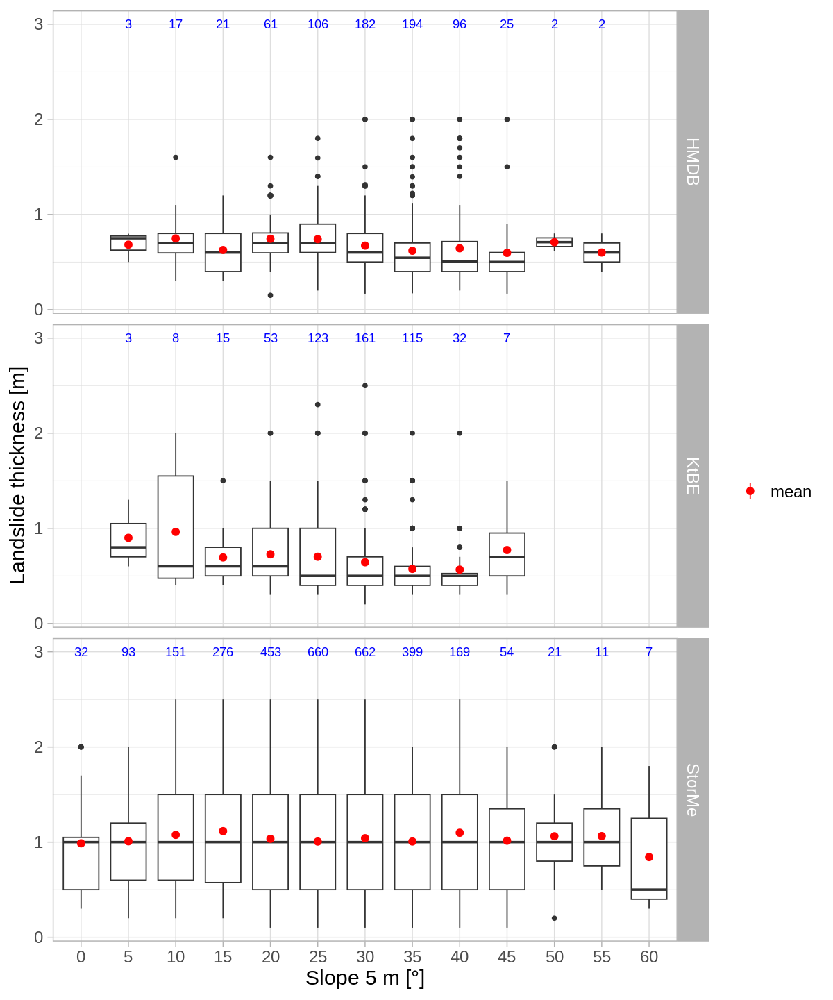

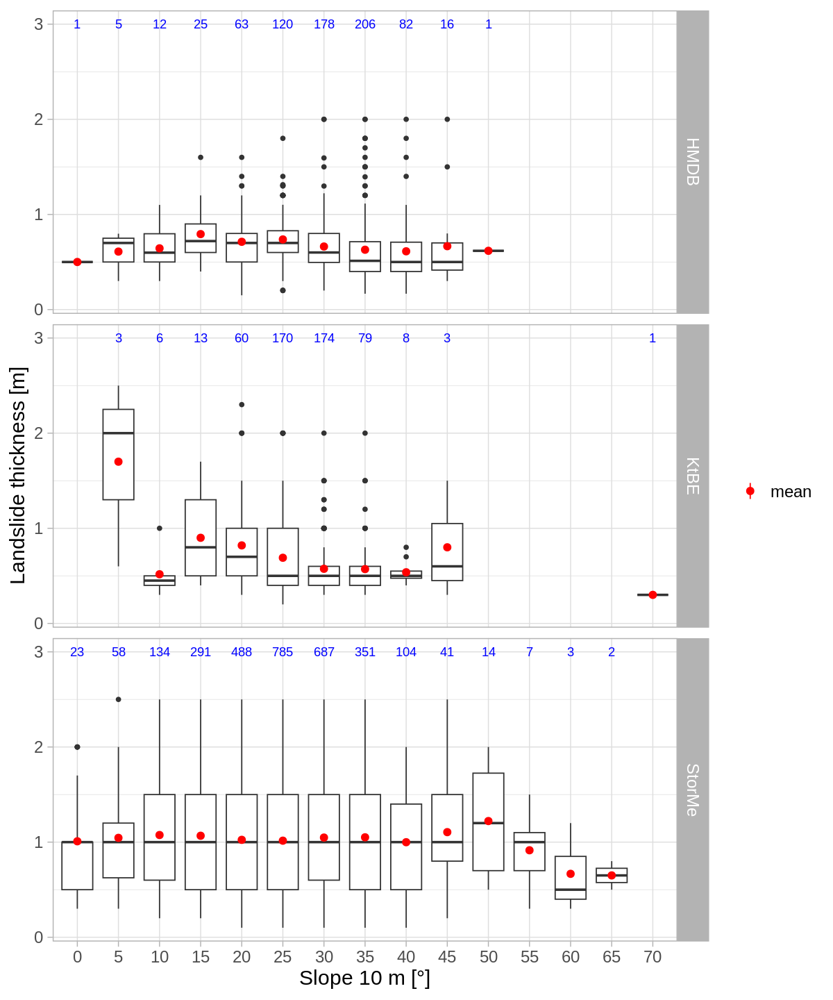

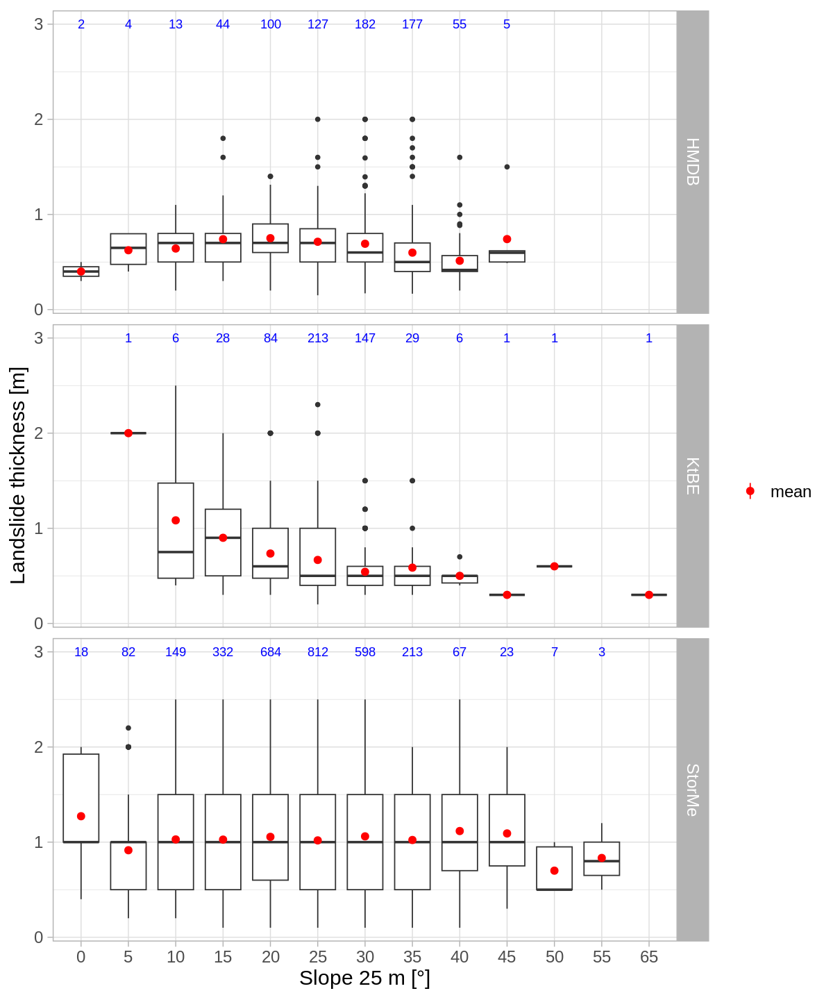

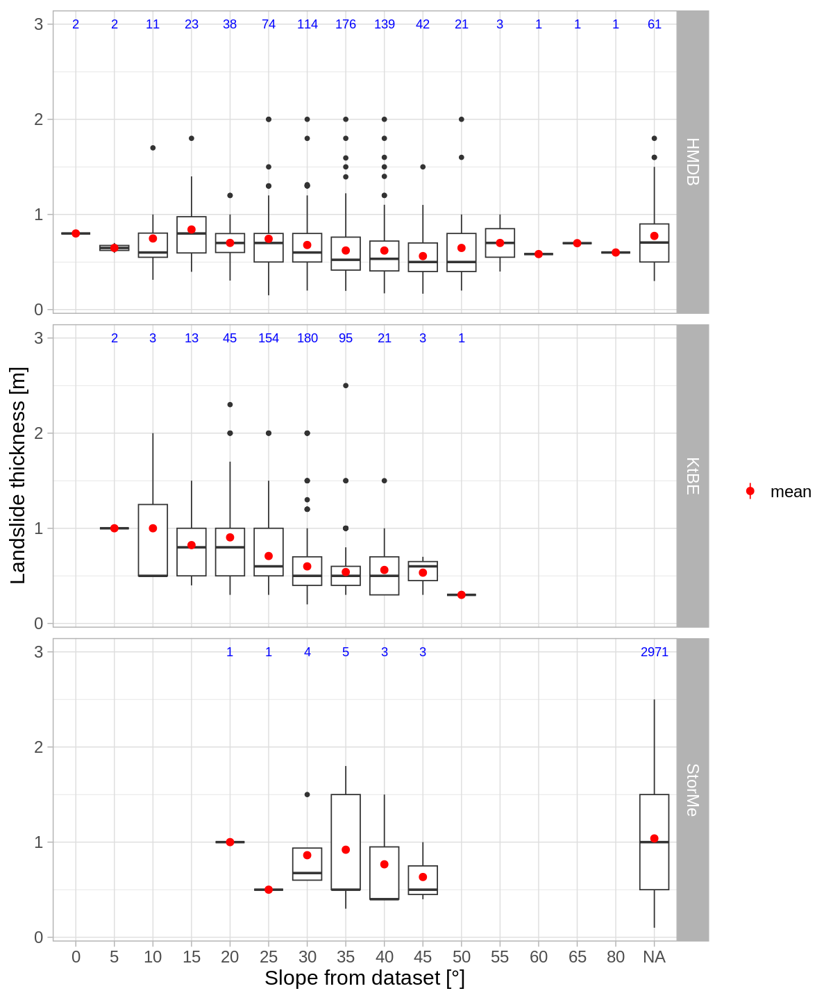

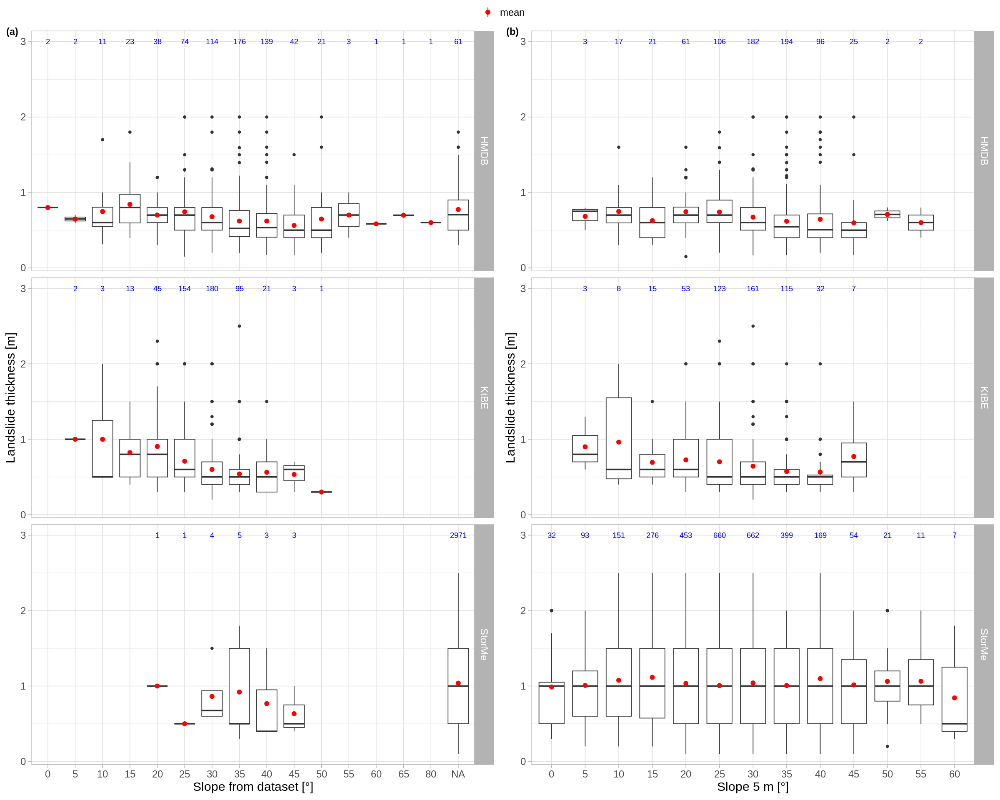

In [233]:
options(repr.plot.width=10, repr.plot.height=12)
font_base_size <- 18

give.n <- function(x){
   return(c(y = 3, label = length(x)))
}



gb5 <- ggplot(merged.df.vis, aes(x=slope_5_class, y=Landslide_thickness)) + 
  geom_boxplot() +
  facet_grid(Dataset ~ .)  +
  stat_summary(fun.y="mean",aes(color="red")) +
  stat_summary(fun.data = "give.n", geom = "text", color="blue")+
  theme_light(base_size = font_base_size) +
  scale_color_manual(name = "", values = c("red"), labels = c("mean")) +
  labs(x="Slope 5 m [°]", y="Landslide thickness [m]") 
gb5
# ggsave(filename = "box_Landslide_thickness_by_slope_5.png", width = 8, height = 10, device='png', dpi=300)

ggplot(merged.df.vis, aes(x=slope_10_class, y=Landslide_thickness)) + 
  geom_boxplot() +
 facet_grid(Dataset ~ .)  +
  stat_summary(fun.y="mean",aes(color="red")) +
  stat_summary(fun.data = "give.n", geom = "text", color="blue")+
  theme_light(base_size = font_base_size) +
  scale_color_manual(name = "", values = c("red"), labels = c("mean")) +
  labs(x="Slope 10 m [°]", y="Landslide thickness [m]") 
# ggsave(filename = "box_Landslide_thickness_by_slope_10.png", width = 8, height = 10, device='png', dpi=300)

ggplot(merged.df.vis, aes(x=slope_25_class, y=Landslide_thickness)) + 
  geom_boxplot() +
 facet_grid(Dataset ~ .)  +
  stat_summary(fun.y="mean",aes(color="red")) +
  stat_summary(fun.data = "give.n", geom = "text", color="blue")+
  theme_light(base_size = font_base_size) +
  scale_color_manual(name = "", values = c("red"), labels = c("mean")) +
  labs(x="Slope 25 m [°]", y="Landslide thickness [m]")  
# ggsave(filename = "box_Landslide_thickness_by_slope_25.png", width = 8, height = 10, device='png', dpi=300)

gbdb <- ggplot(merged.df.vis, aes(x=Slope_DB_class, y=Landslide_thickness)) + 
  geom_boxplot() +
 facet_grid(Dataset ~ .)  +
  stat_summary(fun.y="mean",aes(color="red")) +
  stat_summary(fun.data = "give.n", geom = "text", color="blue")+
  theme_light(base_size = font_base_size) +
  scale_color_manual(name = "", values = c("red"), labels = c("mean")) +
  labs(x="Slope from dataset [°]", y="Landslide thickness [m]") 
gbdb
# ggsave(filename = "box_Landslide_thickness_by_slope_db.png", width = 8, height = 10, device='png', dpi=300)



options(repr.plot.width=20, repr.plot.height=16)

ggarrange(gbdb, gb5,
          labels= c("(a)","(b)"),
          ncol = 2, nrow = 1, heights = c(0.95, 0.05), common.legend=TRUE)

ggsave(filename = "fig05.png", width = 20, height = 16, device='png', dpi=300, bg="white")


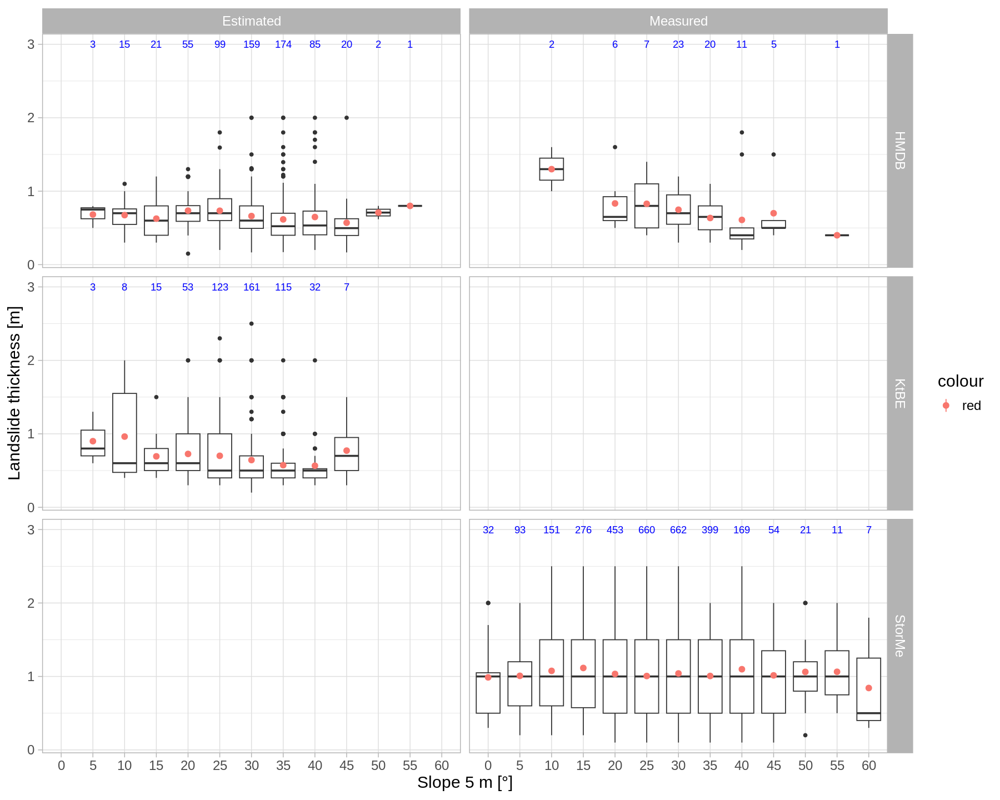

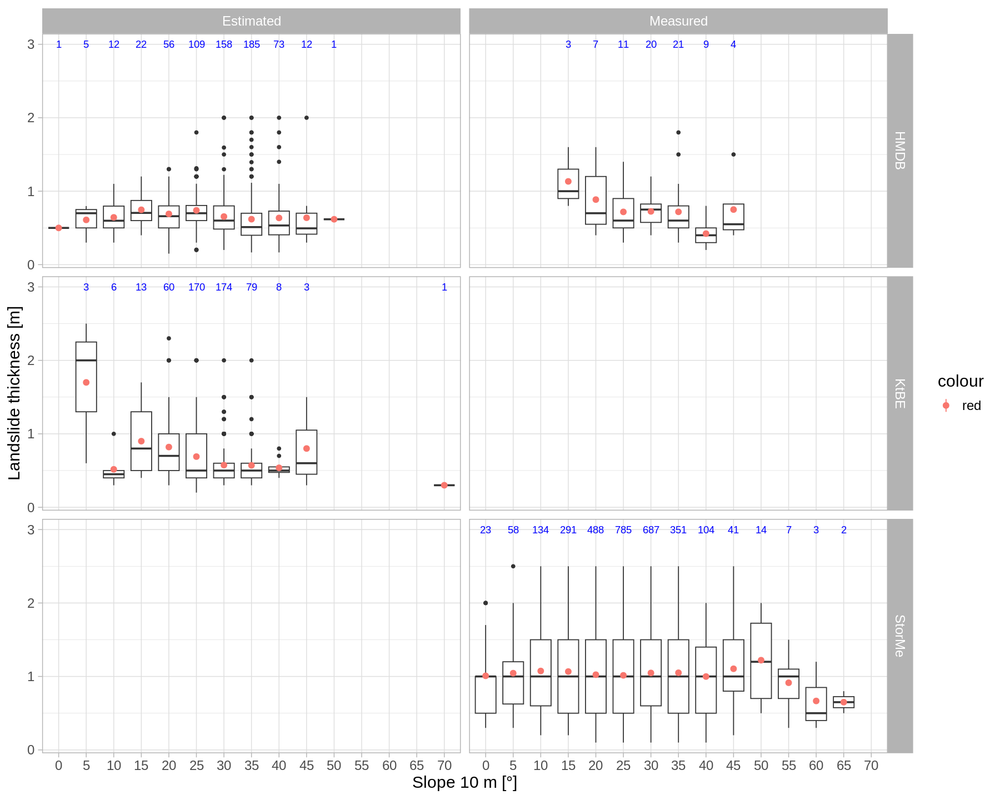

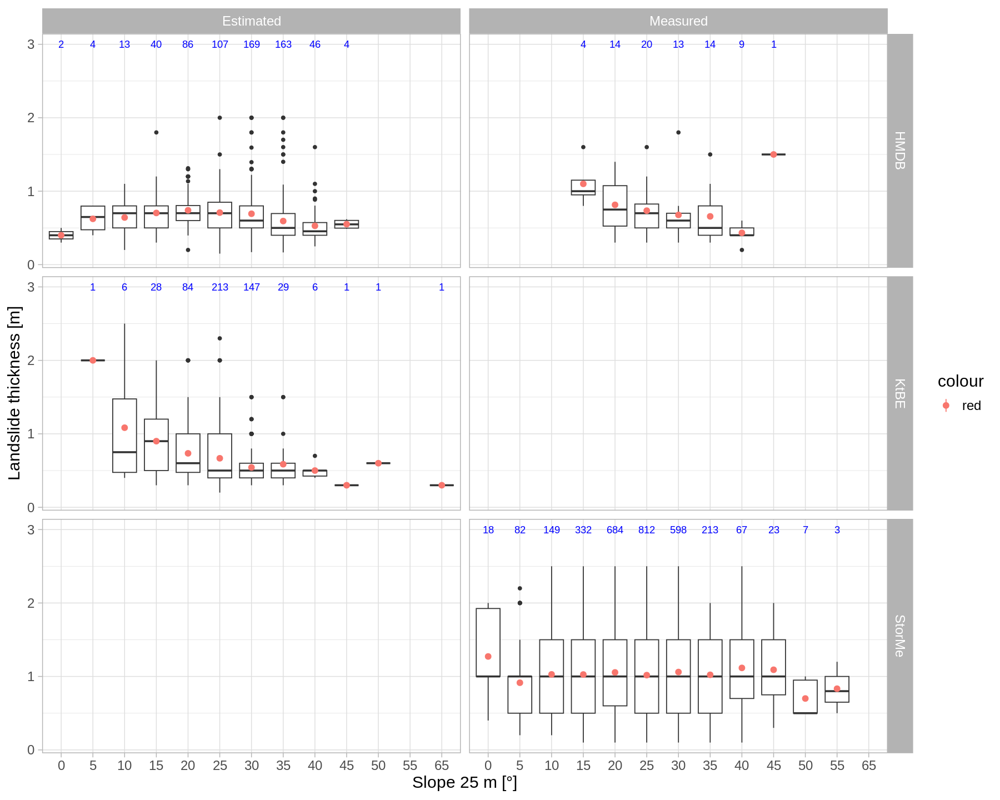

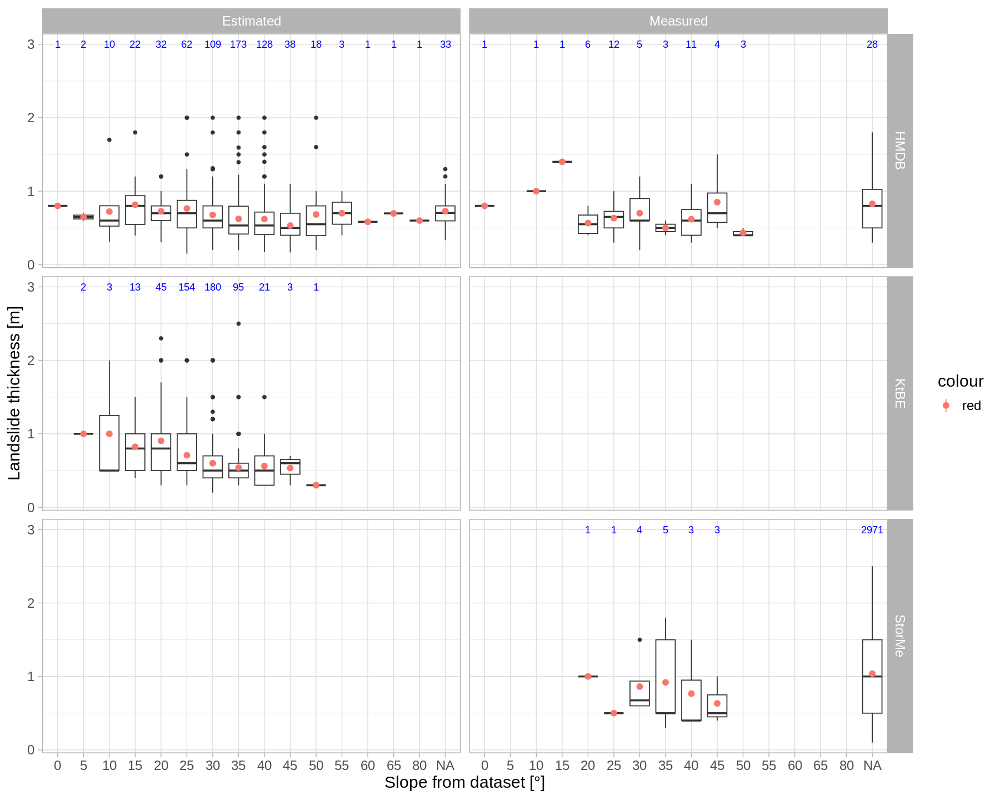

In [234]:
options(repr.plot.width=15, repr.plot.height=12)

ggplot(merged.df.vis, aes(x=slope_5_class, y=Landslide_thickness)) + 
  geom_boxplot() +
  facet_grid(Dataset ~ Landslide_thickness_MAO)  +
  stat_summary(fun.y="mean",aes(color="red")) +
  stat_summary(fun.data = "give.n", geom = "text", color="blue")+
  theme_light(base_size = font_base_size) +
  labs(x="Slope 5 m [°]", y="Landslide thickness [m]") 


ggplot(merged.df.vis, aes(x=slope_10_class, y=Landslide_thickness)) + 
  geom_boxplot() +
 facet_grid(Dataset ~ Landslide_thickness_MAO)  +
  stat_summary(fun.y="mean",aes(color="red")) +
  stat_summary(fun.data = "give.n", geom = "text", color="blue")+
  theme_light(base_size = font_base_size) +
  labs(x="Slope 10 m [°]", y="Landslide thickness [m]") 

ggplot(merged.df.vis, aes(x=slope_25_class, y=Landslide_thickness)) + 
  geom_boxplot() +
 facet_grid(Dataset ~ Landslide_thickness_MAO)  +
  stat_summary(fun.y="mean",aes(color="red")) +
  stat_summary(fun.data = "give.n", geom = "text", color="blue")+
  theme_light(base_size = font_base_size) +
  labs(x="Slope 25 m [°]", y="Landslide thickness [m]")  

ggplot(merged.df.vis, aes(x=Slope_DB_class, y=Landslide_thickness)) + 
  geom_boxplot() +
 facet_grid(Dataset ~ Landslide_thickness_MAO)  +
  stat_summary(fun.y="mean",aes(color="red")) +
  stat_summary(fun.data = "give.n", geom = "text", color="blue")+
  theme_light(base_size = font_base_size) +
  labs(x="Slope from dataset [°]", y="Landslide thickness [m]") 


Dataset,Count,Min.Slope25,Median.Slope25,Mean.Slope25,Max.Slope25,SD.Slope25,Min.SlopeDB,Median.SlopeDB,Mean.SlopeDB,⋯,Min.Landslide_thickness,Median.Landslide_thickness,Mean.Landslide_thickness,Max.Landslide_thickness,SD.Landslide_thickness,Min.h_5,Median.h_5,Mean.h_5,Max.h_5,SD.h_5
<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
HMDB,709,4.5,31.8,30.7,49.7,7.5,1.0,36.0,35.1,⋯,0.1,0.6,0.7,2.0,0.3,523,1188,1214,2257,290
KtBE,517,6.7,28.4,28.2,69.9,5.6,8.3,31.1,31.0,⋯,0.2,0.5,0.7,2.5,0.4,624,1283,1334,2288,369
StorMe,2988,0.0,26.5,26.1,56.7,7.8,20.0,35.0,35.5,⋯,0.1,1.0,1.0,2.5,0.5,395,1036,1075,2369,348


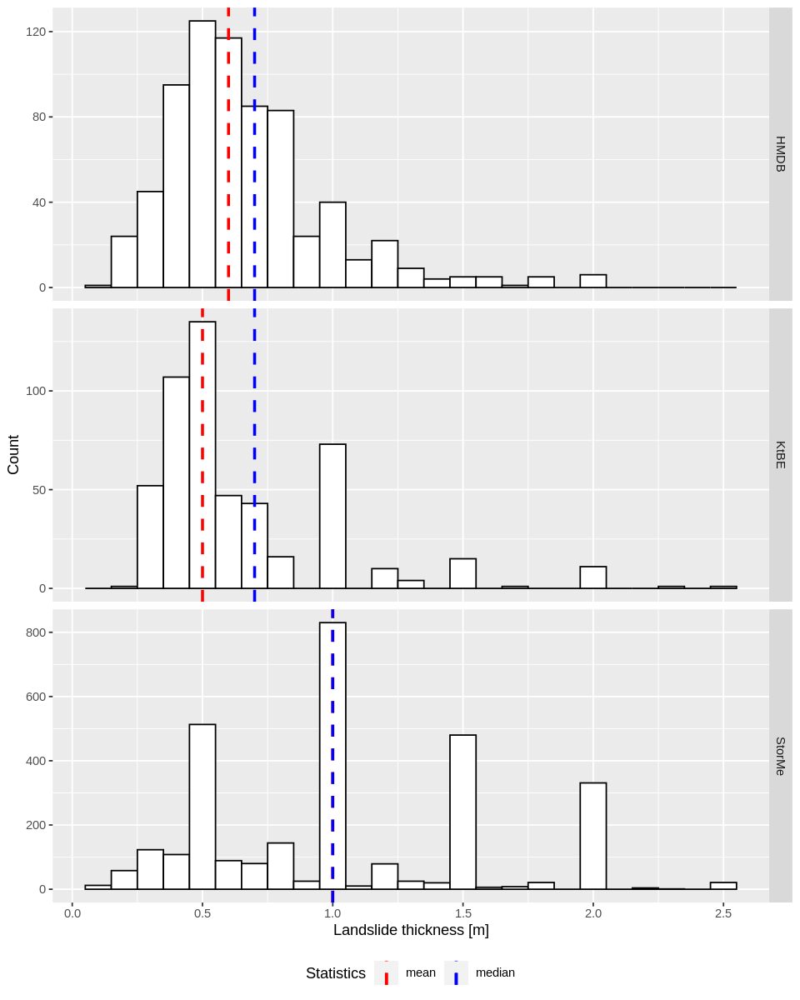

In [235]:
options(repr.plot.width=8, repr.plot.height=10)

merged.df.grouped <- group_by(merged.df.vis,Dataset) 
summary.df <- summarise(merged.df.grouped
                            ,Count=n()
                            ,Min.Slope25=round(min(slope_25),1)
                            ,Median.Slope25=round(median(slope_25),1)
                            ,Mean.Slope25=round(mean(slope_25),1)
                            ,Max.Slope25=round(max(slope_25),1)
                            ,SD.Slope25=round(sd(slope_25),1)
                            ,Min.SlopeDB=round(min(Slope_DB,na.rm=TRUE),1)
                            ,Median.SlopeDB=round(median(Slope_DB,na.rm=TRUE),1)
                            ,Mean.SlopeDB=round(mean(Slope_DB,na.rm=TRUE),1)
                            ,Max.SlopeDB=round(max(Slope_DB,na.rm=TRUE),1)
                            ,SD.SlopeDB=round(sd(Slope_DB,na.rm=TRUE),1)
                            ,Min.Slope5=round(min(slope_5),1)
                            ,Median.Slope5=round(median(slope_5),1)
                            ,Mean.Slope5=round(mean(slope_5),1)
                            ,Max.Slope5=round(max(slope_5),1)
                            ,SD.Slope5=round(sd(slope_5),1)
                            ,Min.Slope10=round(min(slope_10),1)
                            ,Median.Slope10=round(median(slope_10),1)
                            ,Mean.Slope10=round(mean(slope_10),1)
                            ,Max.Slope10=round(max(slope_10),1)
                            ,SD.Slope10=round(sd(slope_10),1)

                            ,Min.Landslide_thickness=round(min(Landslide_thickness,na.rm=TRUE),1)
                            ,Median.Landslide_thickness=round(median(Landslide_thickness,na.rm=TRUE),1)
                            ,Mean.Landslide_thickness=round(mean(Landslide_thickness,na.rm=TRUE),1)
                            ,Max.Landslide_thickness=round(max(Landslide_thickness,na.rm=TRUE),1)
                            ,SD.Landslide_thickness=round(sd(Landslide_thickness,na.rm=TRUE),1)
                                                                               
                            ,Min.h_5=round(min(h_5),0)
                            ,Median.h_5=round(median(h_5),0)
                            ,Mean.h_5=round(mean(h_5),0)
                            ,Max.h_5=round(max(h_5),0)
                            ,SD.h_5=round(sd(h_5),0)      

            )
summary.df

bin_width <- 0.1

hist_Landslide_thickness <- ggplot(merged.df.vis, aes(x=Landslide_thickness)) + 
 geom_histogram(binwidth=bin_width, colour="black", fill="white")  +
 geom_vline(data=summary.df, aes(xintercept=Median.Landslide_thickness, color="blue"), linetype="dashed", size=1) +
 geom_vline(data=summary.df, aes(xintercept=Mean.Landslide_thickness, color="red"), linetype="dashed", size=1) +
 facet_grid(Dataset ~ .,scales="free_y")  +
 scale_color_manual(name = "Statistics", values = c("red", "blue"), labels = c("mean", "median")) +
 scale_x_continuous(breaks=c(0,0.5,1,1.5,2,2.5,3)) +
 theme(legend.position = "bottom")+
 labs(x="Landslide thickness [m]", y="Count") 

hist_Landslide_thickness
# ggsave(filename = "histogram_Landslide_thickness.png", width = 8, height = 10, device='png', dpi=300)

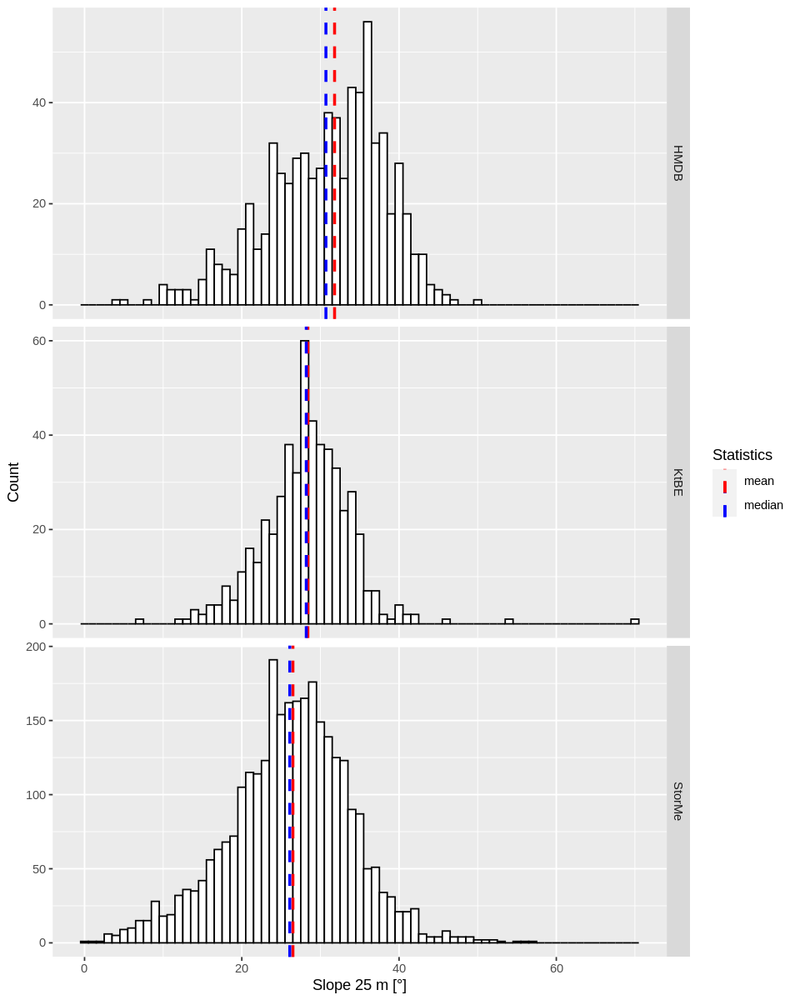

In [236]:
options(repr.plot.width=8, repr.plot.height=10)
ggplot(merged.df.vis, aes(x=slope_25)) + 
 geom_histogram(binwidth=1, colour="black", fill="white")  +
 geom_vline(data=summary.df, aes(xintercept=Median.Slope25, color="blue"), linetype="dashed", size=1) +
 geom_vline(data=summary.df, aes(xintercept=Mean.Slope25, color="red"), linetype="dashed", size=1) +
 facet_grid(Dataset ~ .,scales="free_y")  +
 scale_color_manual(name = "Statistics", values = c("red", "blue"), labels = c("mean", "median")) +
 labs(x="Slope 25 m [°]", y="Count") 
# ggsave(filename = "histogram_slope_25m.png", width = 8, height = 10, device='png', dpi=300)

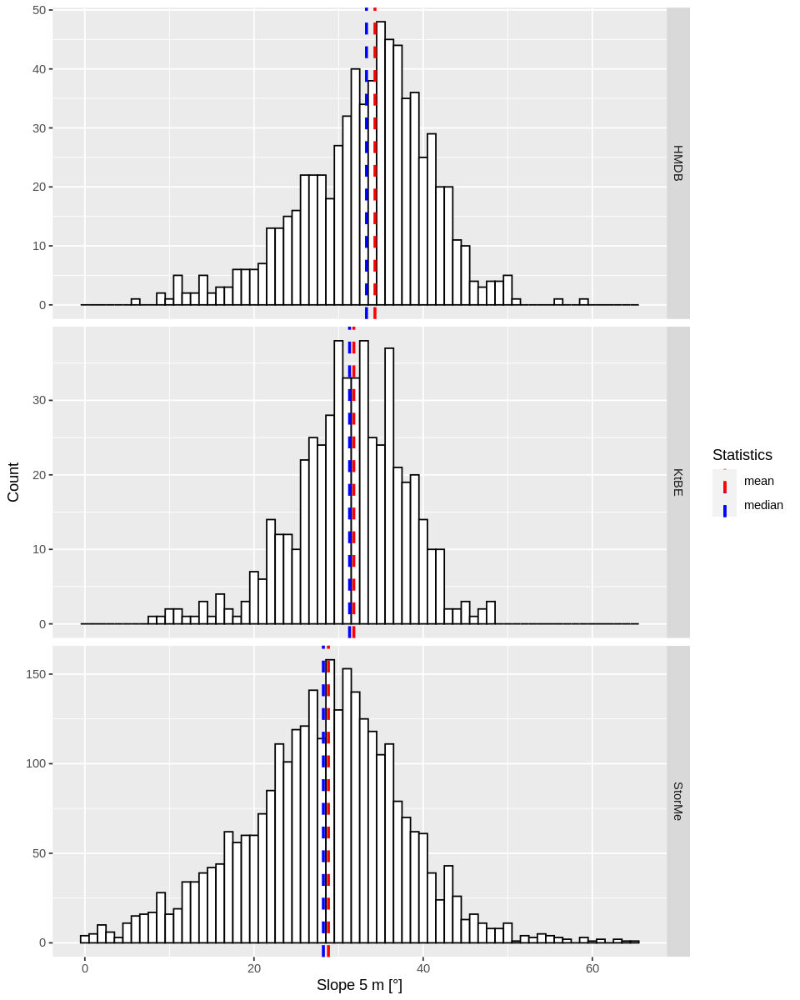

In [237]:
ggplot(merged.df.vis, aes(x=slope_5)) + 
 geom_histogram(binwidth=1, colour="black", fill="white")  +
 geom_vline(data=summary.df, aes(xintercept=Median.Slope5, color="blue"), linetype="dashed", size=1) +
 geom_vline(data=summary.df, aes(xintercept=Mean.Slope5, color="red"), linetype="dashed", size=1) +
 facet_grid(Dataset ~ .,scales="free_y")  +
 scale_color_manual(name = "Statistics", values = c("red", "blue"), labels = c("mean", "median")) +
 labs(x="Slope 5 m [°]", y="Count") 
# ggsave(filename = "histogram_slope_5m.png", width = 8, height = 10, device='png', dpi=300)

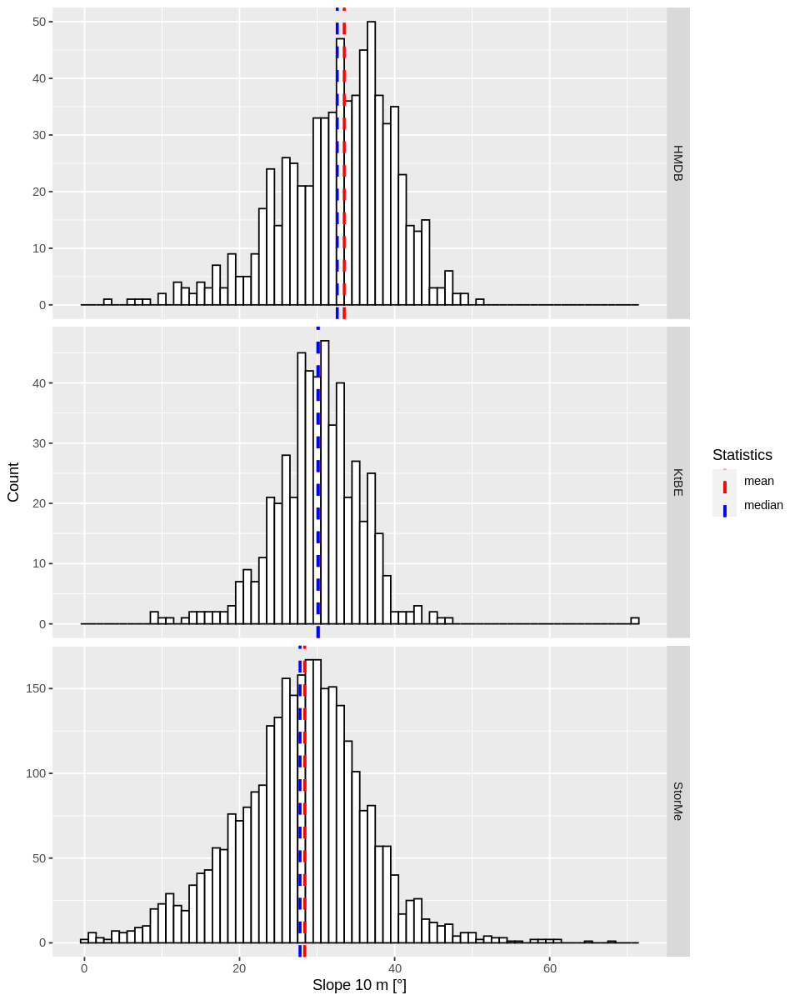

In [238]:
ggplot(merged.df.vis, aes(x=slope_10)) + 
 geom_histogram(binwidth=1, colour="black", fill="white")  +
 geom_vline(data=summary.df, aes(xintercept=Median.Slope10, color="blue"), linetype="dashed", size=1) +
 geom_vline(data=summary.df, aes(xintercept=Mean.Slope10, color="red"), linetype="dashed", size=1) +
 facet_grid(Dataset ~ .,scales="free_y")  +
 scale_color_manual(name = "Statistics", values = c("red", "blue"), labels = c("mean", "median")) +
 labs(x="Slope 10 m [°]", y="Count") 
# ggsave(filename = "histogram_slope_10m.png", width = 8, height = 10, device='png', dpi=300)

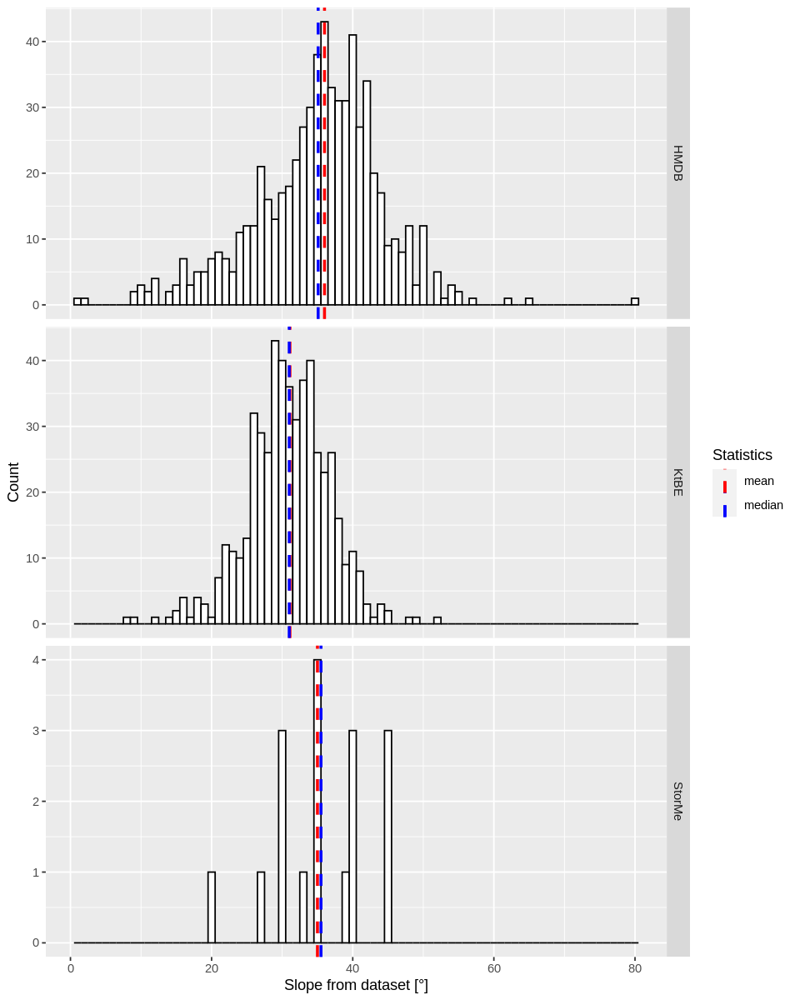

In [239]:
hist_slope_db <- ggplot(merged.df.vis, aes(x=Slope_DB)) + 
 geom_histogram(binwidth=1, colour="black", fill="white")  +
 geom_vline(data=summary.df, aes(xintercept=Median.SlopeDB, color="blue"), linetype="dashed", size=1) +
 geom_vline(data=summary.df, aes(xintercept=Mean.SlopeDB, color="red"), linetype="dashed", size=1) +
 facet_grid(Dataset ~ .,scales="free_y")  +
 scale_color_manual(name = "Statistics", values = c("red", "blue"), labels = c("mean", "median")) +
 labs(x="Slope from dataset [°]", y="Count")
hist_slope_db
# ggsave(filename = "histogram_slope_DB.png", width = 8, height = 10, device='png', dpi=300)

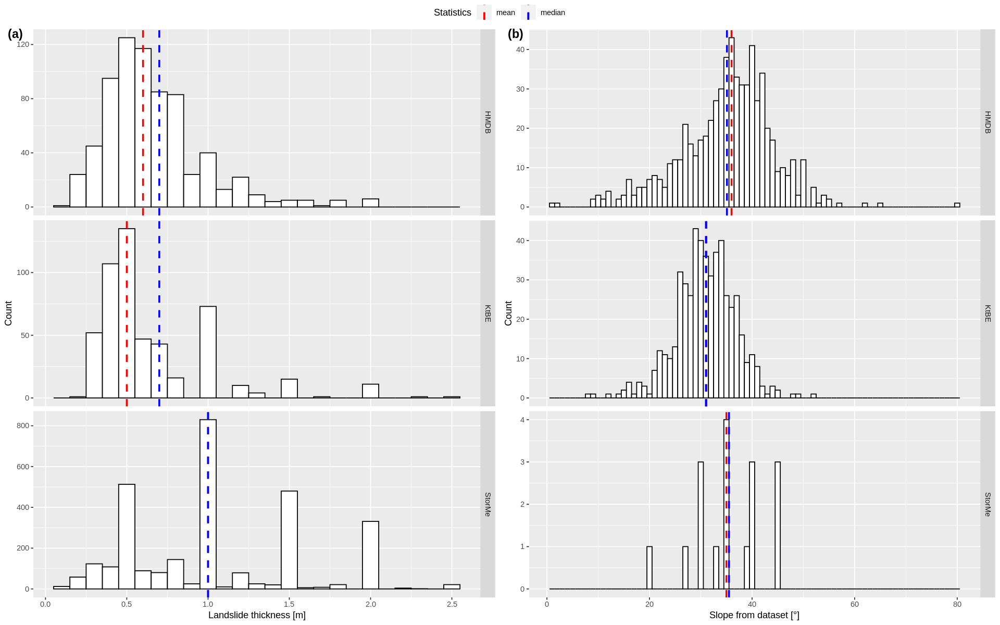

In [240]:
options(repr.plot.width=16, repr.plot.height=10)

ggarrange(hist_Landslide_thickness, hist_slope_db,
          labels= c("(a)","(b)"),
          ncol = 2, nrow = 1, heights = c(0.95, 0.05), common.legend=TRUE)

ggsave(filename = "fig04.png", width = 16, height = 10, device='png', dpi=300, bg="white")


In [241]:
for(ds in unique(merged.df.vis$Dataset)) {
    print(ds)
    df_filtered <- merged.df.vis[(merged.df.vis$Dataset==ds),]
    for (t in seq(0,2.5,0.5)) {
        df_filtered_t <- df_filtered[df_filtered$Landslide_thickness<=t,]
        print(paste("Up to ",t,"m:",nrow(df_filtered_t),"/",round(100*nrow(df_filtered_t)/nrow(df_filtered),0),"%"))
    }
    
}

[1] "HMDB"
[1] "Up to  0 m: 0 / 0 %"
[1] "Up to  0.5 m: 278 / 39 %"
[1] "Up to  1 m: 638 / 90 %"
[1] "Up to  1.5 m: 692 / 98 %"
[1] "Up to  2 m: 709 / 100 %"
[1] "Up to  2.5 m: 709 / 100 %"
[1] "StorMe"
[1] "Up to  0 m: 0 / 0 %"
[1] "Up to  0.5 m: 814 / 27 %"
[1] "Up to  1 m: 1982 / 66 %"
[1] "Up to  1.5 m: 2596 / 87 %"
[1] "Up to  2 m: 2962 / 99 %"
[1] "Up to  2.5 m: 2988 / 100 %"
[1] "KtBE"
[1] "Up to  0 m: 0 / 0 %"
[1] "Up to  0.5 m: 295 / 57 %"
[1] "Up to  1 m: 474 / 92 %"
[1] "Up to  1.5 m: 503 / 97 %"
[1] "Up to  2 m: 515 / 100 %"
[1] "Up to  2.5 m: 517 / 100 %"


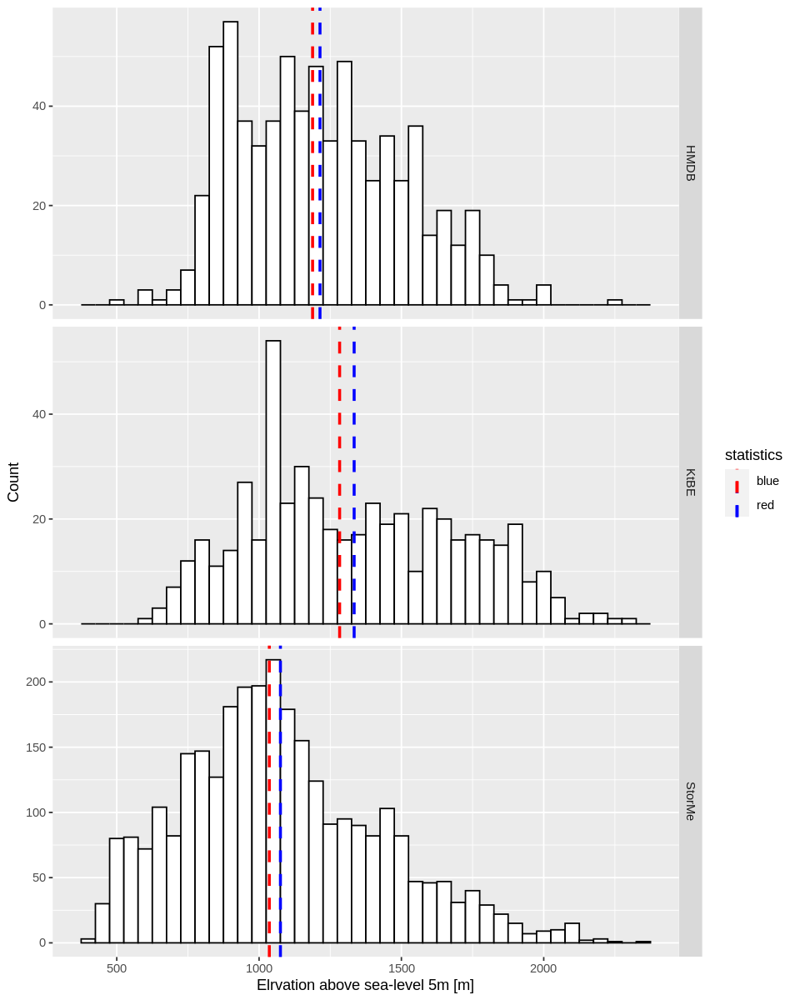

In [242]:

options(repr.plot.width=8, repr.plot.height=10)
ggplot(merged.df.vis, aes(x=h_5)) + 
 geom_histogram(binwidth=50, colour="black", fill="white")  +
 geom_vline(data=summary.df, aes(xintercept=Median.h_5,   color="blue"), linetype="dashed", size=1) +
 geom_vline(data=summary.df, aes(xintercept=Mean.h_5, color="red"), linetype="dashed", size=1) +
 facet_grid(Dataset ~ .,scales="free_y")  +
 scale_color_manual(name = "statistics", values = c("mean" <- "red", "median" <- "blue")) +
 labs(x="Elrvation above sea-level 5m [m]", y="Count") 
# ggsave(filename = "histogram_h5.png", width = 8, height = 10, device='png', dpi=300)

`summarise()` has grouped output by 'Dataset'. You can override using the
`.groups` argument.


Dataset,Landslide_thickness_MAO,Count,Min.Slope25,Median.Slope25,Mean.Slope25,Max.Slope25,SD.Slope25,Min.SlopeDB,Median.SlopeDB,⋯,Min.Slope10,Median.Slope10,Mean.Slope10,Max.Slope10,SD.Slope10,Min.Landslide_thickness,Median.Landslide_thickness,Mean.Landslide_thickness,Max.Landslide_thickness,SD.Landslide_thickness
<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
HMDB,Estimated,634,4.5,31.9,30.7,49.7,7.5,1.0,36.0,⋯,3.4,33.5,32.5,51.4,7.4,0.1,0.6,0.7,2.0,0.3
HMDB,Measured,75,16.1,29.7,30.7,45.7,7.2,2.0,31.0,⋯,15.6,33.3,33.7,48.9,7.3,0.2,0.6,0.7,1.8,0.4
KtBE,Estimated,517,6.7,28.4,28.2,69.9,5.6,8.3,31.1,⋯,9.1,30.2,30.1,71.2,5.8,0.2,0.5,0.7,2.5,0.4
StorMe,Measured,2988,0.0,26.5,26.1,56.7,7.8,20.0,35.0,⋯,0.0,28.4,27.8,68.3,8.5,0.1,1.0,1.0,2.5,0.5


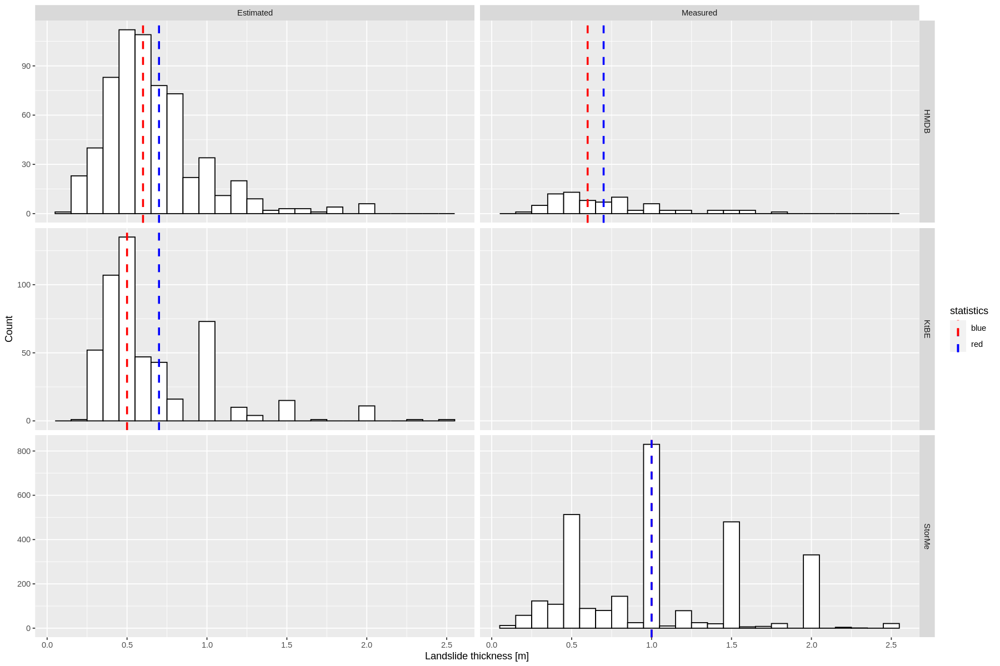

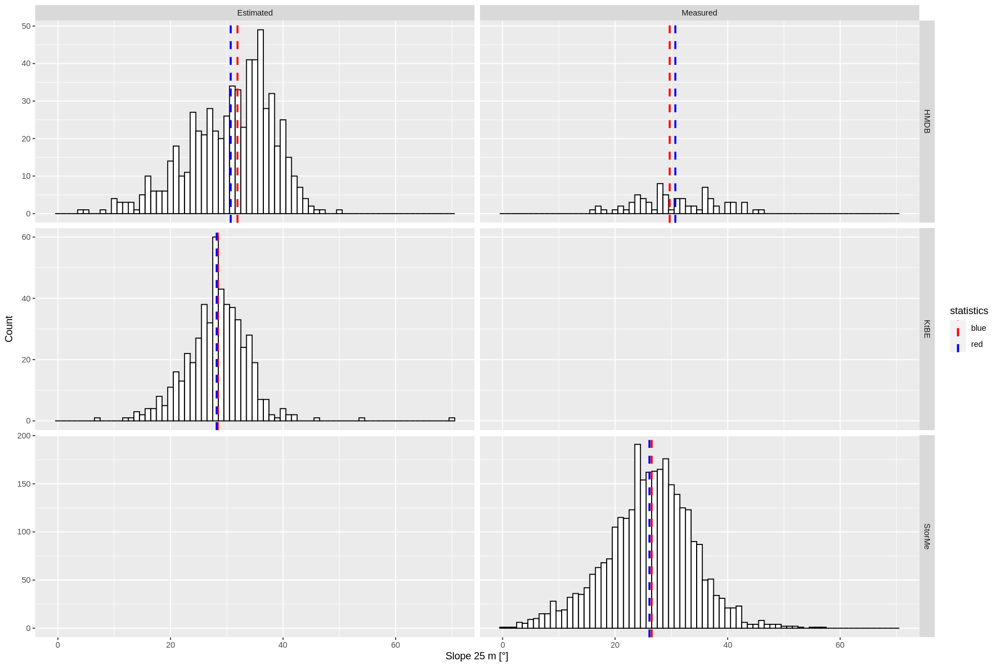

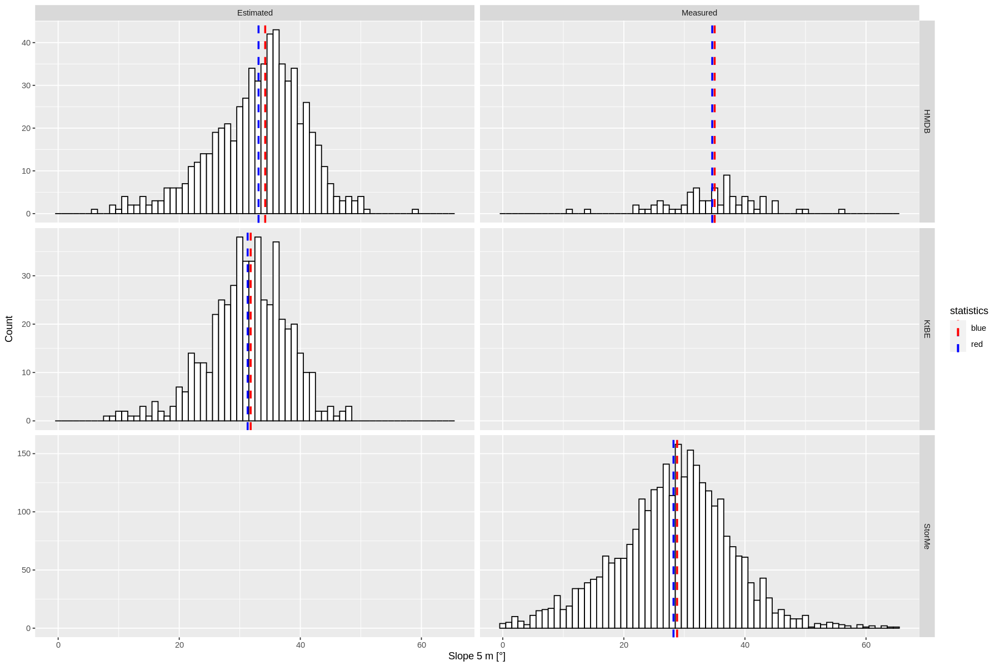

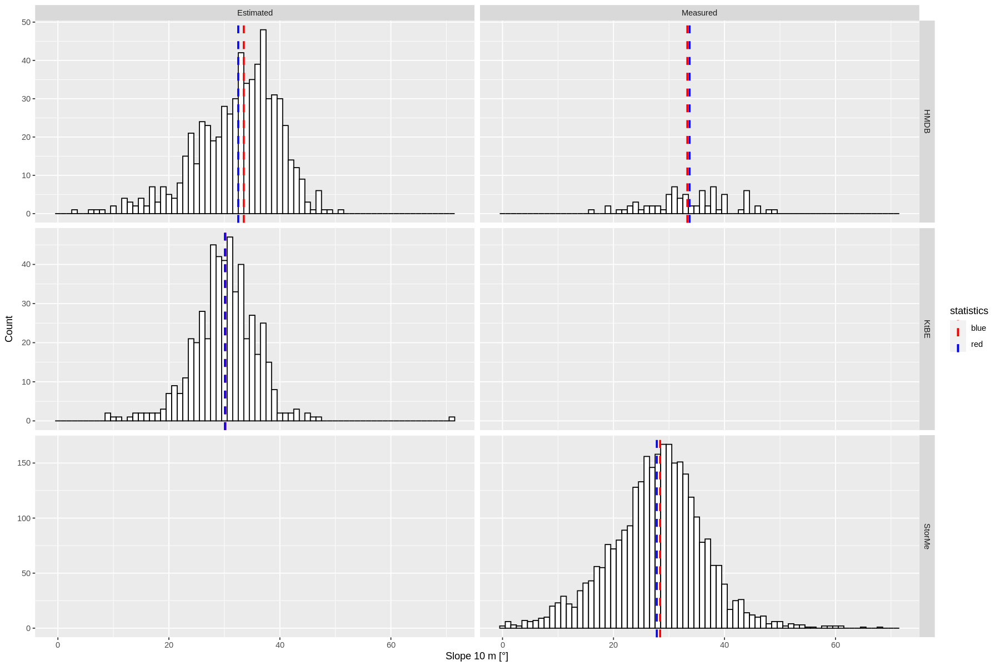

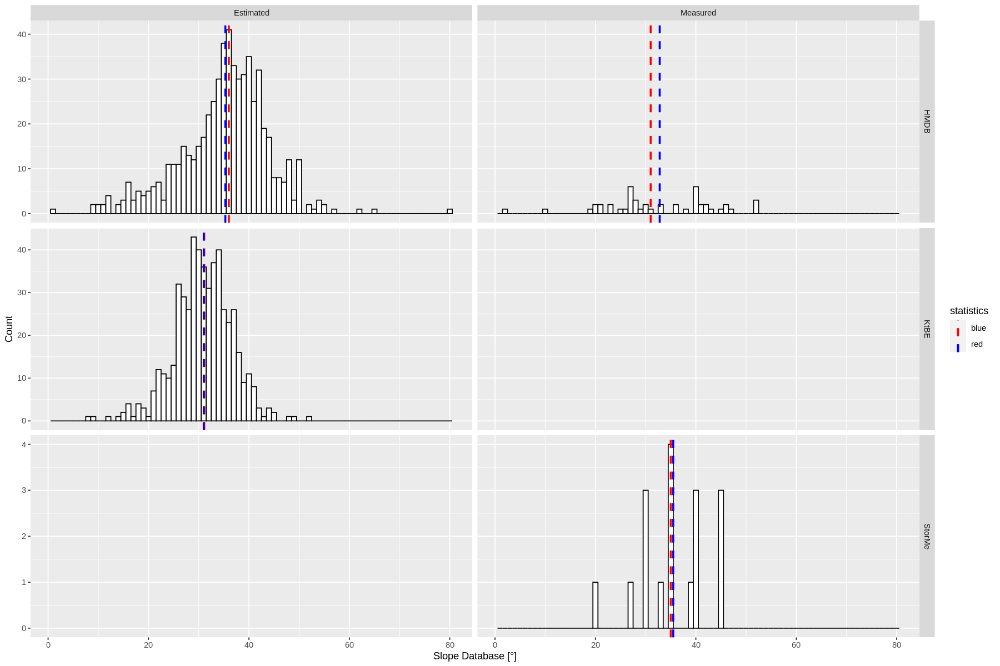

In [243]:
options(repr.plot.width=15, repr.plot.height=10)

merged.df.grouped <- group_by(.data=merged.df.vis,Dataset,Landslide_thickness_MAO) 

summary.df <- summarise(.data=merged.df.grouped
                            ,Count=n()
                            ,Min.Slope25=round(min(slope_25),1)
                            ,Median.Slope25=round(median(slope_25),1)
                            ,Mean.Slope25=round(mean(slope_25),1)
                            ,Max.Slope25=round(max(slope_25),1)
                            ,SD.Slope25=round(sd(slope_25),1)
                            ,Min.SlopeDB=round(min(Slope_DB,na.rm=TRUE),1)
                            ,Median.SlopeDB=round(median(Slope_DB,na.rm=TRUE),1)
                            ,Mean.SlopeDB=round(mean(Slope_DB,na.rm=TRUE),1)
                            ,Max.SlopeDB=round(max(Slope_DB,na.rm=TRUE),1)
                            ,SD.SlopeDB=round(sd(Slope_DB,na.rm=TRUE),1)
                            ,Min.Slope5=round(min(slope_5),1)
                            ,Median.Slope5=round(median(slope_5),1)
                            ,Mean.Slope5=round(mean(slope_5),1)
                            ,Max.Slope5=round(max(slope_5),1)
                            ,SD.Slope5=round(sd(slope_5),1)
                            ,Min.Slope10=round(min(slope_10),1)
                            ,Median.Slope10=round(median(slope_10),1)
                            ,Mean.Slope10=round(mean(slope_10),1)
                            ,Max.Slope10=round(max(slope_10),1)
                            ,SD.Slope10=round(sd(slope_10),1)

                            ,Min.Landslide_thickness=round(min(Landslide_thickness,na.rm=TRUE),1)
                            ,Median.Landslide_thickness=round(median(Landslide_thickness,na.rm=TRUE),1)
                            ,Mean.Landslide_thickness=round(mean(Landslide_thickness,na.rm=TRUE),1)
                            ,Max.Landslide_thickness=round(max(Landslide_thickness,na.rm=TRUE),1)
                            ,SD.Landslide_thickness=round(sd(Landslide_thickness,na.rm=TRUE),1)

            )
summary.df

bin_width <- 0.1

ggplot(merged.df.vis, aes(x=Landslide_thickness)) + 
 geom_histogram(binwidth=bin_width, colour="black", fill="white")  +
 geom_vline(data=summary.df, aes(xintercept=Median.Landslide_thickness, color="blue"), linetype="dashed", size=1) +
 geom_vline(data=summary.df, aes(xintercept=Mean.Landslide_thickness, color="red"), linetype="dashed", size=1) +
 facet_grid(Dataset ~ Landslide_thickness_MAO,scales="free_y")  +
 scale_color_manual(name = "statistics", values = c("mean" <- "red", "median" <- "blue")) +
 scale_x_continuous(breaks=c(0,0.5,1,1.5,2,2.5,3)) +
 labs(x="Landslide thickness [m]", y="Count") 

ggplot(merged.df.vis, aes(x=slope_25)) + 
 geom_histogram(binwidth=1, colour="black", fill="white")  +
 geom_vline(data=summary.df, aes(xintercept=Median.Slope25, color="blue"), linetype="dashed", size=1) +
 geom_vline(data=summary.df, aes(xintercept=Mean.Slope25, color="red"), linetype="dashed", size=1) +
 facet_grid(Dataset ~ Landslide_thickness_MAO,scales="free_y")  +
 scale_color_manual(name = "statistics", values = c("mean" <- "red", "median" <- "blue")) +
 labs(x="Slope 25 m [°]", y="Count") 

ggplot(merged.df.vis, aes(x=slope_5)) + 
 geom_histogram(binwidth=1, colour="black", fill="white")  +
 geom_vline(data=summary.df, aes(xintercept=Median.Slope5, color="blue"), linetype="dashed", size=1) +
 geom_vline(data=summary.df, aes(xintercept=Mean.Slope5, color="red"), linetype="dashed", size=1) +
 facet_grid(Dataset ~ Landslide_thickness_MAO,scales="free_y")  +
 scale_color_manual(name = "statistics", values = c("mean" <- "red", "median" <- "blue")) +
 labs(x="Slope 5 m [°]", y="Count") 

ggplot(merged.df.vis, aes(x=slope_10)) + 
 geom_histogram(binwidth=1, colour="black", fill="white")  +
 geom_vline(data=summary.df, aes(xintercept=Median.Slope10, color="blue"), linetype="dashed", size=1) +
 geom_vline(data=summary.df, aes(xintercept=Mean.Slope10, color="red"), linetype="dashed", size=1) +
 facet_grid(Dataset ~ Landslide_thickness_MAO,scales="free_y")  +
 scale_color_manual(name = "statistics", values = c("mean" <- "red", "median" <- "blue")) +
 labs(x="Slope 10 m [°]", y="Count") 

ggplot(merged.df.vis, aes(x=Slope_DB)) + 
 geom_histogram(binwidth=1, colour="black", fill="white")  +
 geom_vline(data=summary.df, aes(xintercept=Median.SlopeDB, color="blue"), linetype="dashed", size=1) +
 geom_vline(data=summary.df, aes(xintercept=Mean.SlopeDB, color="red"), linetype="dashed", size=1) +
 facet_grid(Dataset ~ Landslide_thickness_MAO,scales="free_y")  +
 scale_color_manual(name = "statistics", values = c("mean" <- "red", "median" <- "blue")) +
 labs(x="Slope Database [°]", y="Count") 


In [244]:
get_importance_paper <- function (model, name="Merged", useFinal=FALSE, digits=2) {
    
    if (useFinal){
        rf.fd <- varImp(model$finalModel, scale=FALSE)
        d.imp <- data.frame(variable = rownames(rf.fd), 
                            importance = round(rf.fd$Overall,digits))
    } else {
        rf.vi <- varImp(model)
        d.imp <- data.frame(variable = rownames(rf.vi$importance), 
                            importance = round(rf.vi$importance$Overall,digits))
    }
    d.imp <- d.imp[order(d.imp$importance, decreasing = T), ] 
    # d.imp$importance<-(d.imp$importance/max(d.imp$importance))*100
    d.imp$rank<- order(d.imp$importance)
    
    return (list(model=model, importance=d.imp, name=name ))
}



In [245]:
imp_rf_hmdb <- get_importance_paper(rf_model_hmdb, name="HMDB")
imp_rf_be <- get_importance_paper(rf_model_be, name="BE")

imp_list_rf <- list(imp_rf_hmdb,imp_rf_be)


imp_lm_hmdb <- get_importance_paper(lm_model_hmdb, name="HMDB")
imp_lm_be <- get_importance_paper(lm_model_be, name="BE")

imp_list_lm <- list(imp_lm_hmdb,imp_lm_be)


imp_gam_hmdb <- get_importance_paper(gam_model_hmdb, name="HMDB", useFinal=TRUE)
imp_gam_be <- get_importance_paper(gam_model_be, name="BE", useFinal=TRUE)

imp_list_gam <- list(imp_gam_hmdb,imp_gam_be)



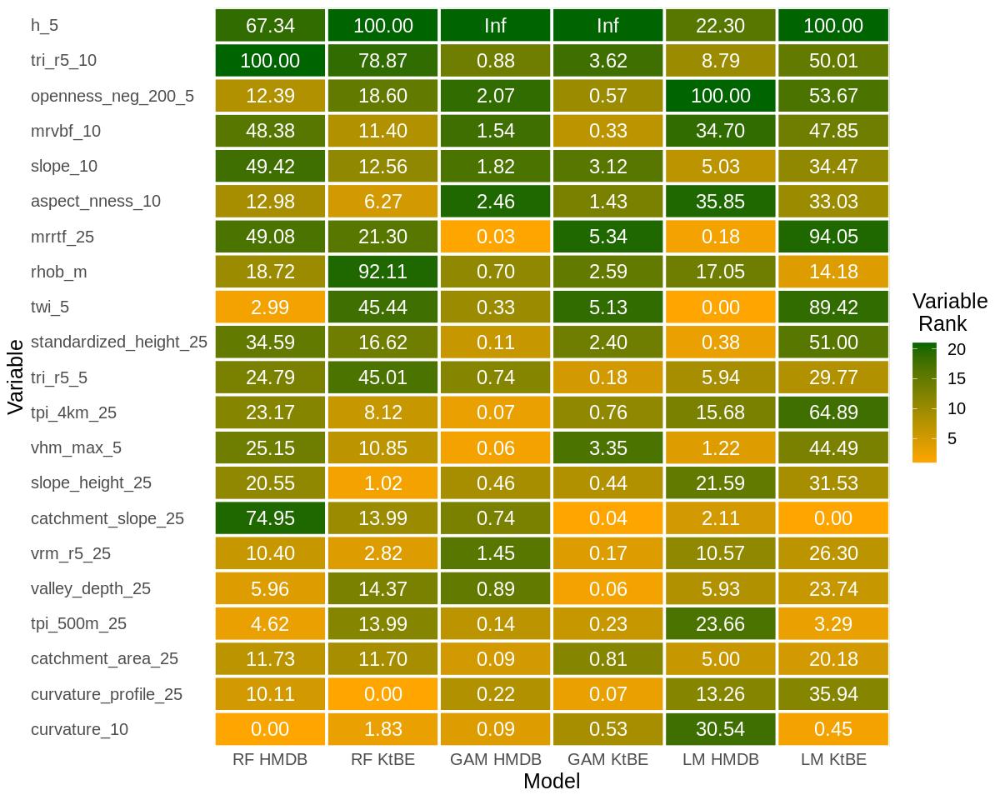

In [246]:
options(repr.plot.width=10, repr.plot.height=8)

df <- data.frame(Order_x = 0, Model="RF HMDB",Variable = imp_rf_hmdb$importance$variable, Importance = imp_rf_hmdb$importance$importance, Rank = imp_rf_hmdb$importance$rank)
df <- rbind(df,data.frame(Order_x = 1, Model="RF KtBE",Variable = imp_rf_be$importance$variable, Importance = imp_rf_be$importance$importance, Rank = imp_rf_be$importance$rank))
df <- rbind(df,data.frame(Order_x = 2, Model="GAM HMDB",Variable = imp_gam_hmdb$importance$variable, Importance = imp_gam_hmdb$importance$importance, Rank = imp_gam_hmdb$importance$rank))
df <- rbind(df,data.frame(Order_x = 3, Model="GAM KtBE",Variable = imp_gam_be$importance$variable, Importance = imp_gam_be$importance$importance, Rank = imp_gam_be$importance$rank))
df <- rbind(df,data.frame(Order_x = 4, Model="LM HMDB",Variable = imp_lm_hmdb$importance$variable, Importance = imp_lm_hmdb$importance$importance, Rank = imp_lm_hmdb$importance$rank))
df <- rbind(df,data.frame(Order_x = 5, Model="LM KtBE",Variable = imp_lm_be$importance$variable, Importance = imp_lm_be$importance$importance, Rank = imp_lm_be$importance$rank))

ggplot(df, aes(x = reorder(Model, Order_x), y = reorder(Variable, Rank), fill = Rank)) +
  geom_tile(colour = "white", linewidth = 1) +
  geom_text(aes(label = sprintf("%1.2f", Importance) ), hjust = 0.5, color = "white", size = 5) +
  scale_fill_gradient(low = "orange", high = "darkgreen", na.value = "grey80")+
  scale_x_discrete(expand = c(0, 0)) +
  scale_y_discrete(expand = c(0, 0)) +
  ylab("Variable") +
  xlab("Model") +
  labs(fill="Variable\n Rank") +
  theme(text = element_text(size = 15),  axis.ticks = element_blank(), axis.text.y = element_text(hjust = 0))

#ggsave(filename = "importance_heatmap.png", width = 10, height = 8, device='png', dpi=300, bg="white")


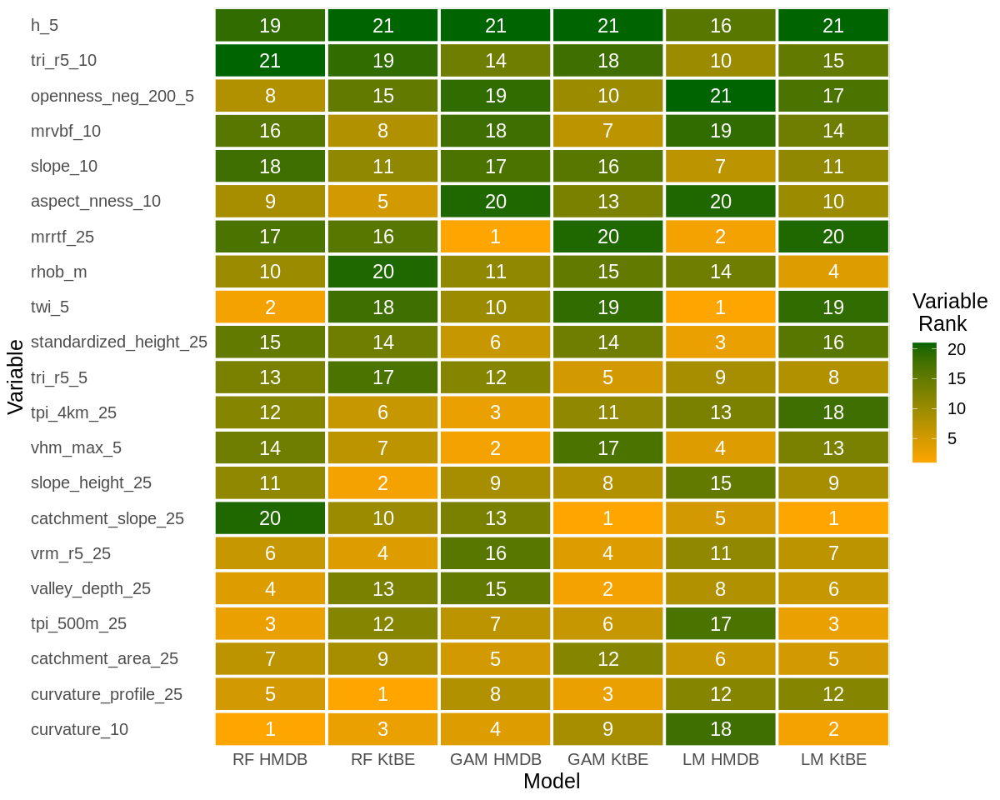

In [247]:
options(repr.plot.width=10, repr.plot.height=8)

df <- data.frame(Order_x = 0, Model="RF HMDB",Variable = imp_rf_hmdb$importance$variable, Importance = imp_rf_hmdb$importance$importance, Rank = imp_rf_hmdb$importance$rank)
df <- rbind(df,data.frame(Order_x = 1, Model="RF KtBE",Variable = imp_rf_be$importance$variable, Importance = imp_rf_be$importance$importance, Rank = imp_rf_be$importance$rank))
df <- rbind(df,data.frame(Order_x = 2, Model="GAM HMDB",Variable = imp_gam_hmdb$importance$variable, Importance = imp_gam_hmdb$importance$importance, Rank = imp_gam_hmdb$importance$rank))
df <- rbind(df,data.frame(Order_x = 3, Model="GAM KtBE",Variable = imp_gam_be$importance$variable, Importance = imp_gam_be$importance$importance, Rank = imp_gam_be$importance$rank))
df <- rbind(df,data.frame(Order_x = 4, Model="LM HMDB",Variable = imp_lm_hmdb$importance$variable, Importance = imp_lm_hmdb$importance$importance, Rank = imp_lm_hmdb$importance$rank))
df <- rbind(df,data.frame(Order_x = 5, Model="LM KtBE",Variable = imp_lm_be$importance$variable, Importance = imp_lm_be$importance$importance, Rank = imp_lm_be$importance$rank))

ggplot(df, aes(x = reorder(Model, Order_x), y = reorder(Variable, Rank), fill = Rank)) +
  geom_tile(colour = "white", linewidth = 1) +
  # geom_text(aes(label = sprintf("%1.2f", Importance) ), hjust = 0.5, color = "white", size = 5) +
  geom_text(aes(label = sprintf("%1i", Rank) ), hjust = 0.5, color = "white", size = 5) +
  scale_fill_gradient(low = "orange", high = "darkgreen", na.value = "grey80")+
  scale_x_discrete(expand = c(0, 0)) +
  scale_y_discrete(expand = c(0, 0)) +
  ylab("Variable") +
  xlab("Model") +
  labs(fill="Variable\n Rank") +
  theme(text = element_text(size = 15),  axis.ticks = element_blank(), axis.text.y = element_text(hjust = 0))

ggsave(filename = "figb01.png", width = 10, height = 8, device='png', dpi=300, bg="white")


In [248]:
df <- data.frame(Actual= data_test_hmdb_y, Prediction=pred_test_rf_hmdb$predictions, Residual=data_test_hmdb_y-pred_test_rf_hmdb$predictions, Slope = data_test_hmdb$Slope_DB, Slope_Class = data_test_hmdb$slope_10_class, Model = "(1) Random Forest", Dataset = "(a) HMDB>HMDB")
df <- rbind(df,data.frame(Actual= data_test_be_y, Prediction=pred_test_rf_be$predictions, Residual=data_test_be_y-pred_test_rf_be$predictions, Slope = data_test_be$Slope_DB, Slope_Class = data_test_be$slope_10_class, Model = "(1) Random Forest", Dataset = "(b) KtBE>KtBE"))
df <- rbind(df,data.frame(Actual= data_test_hmdb_be_y, Prediction=pred_test_rf_hmdb_be$predictions, Residual=data_test_hmdb_be_y-pred_test_rf_hmdb_be$predictions, Slope = data_test_hmdb_be$Slope_DB, Slope_Class = data_test_hmdb_be$slope_10_class, Model = "(1) Random Forest", Dataset = "(c) HMDB>KtBE"))
df <- rbind(df,data.frame(Actual= data_test_be_hmdb_y, Prediction=pred_test_rf_be_hmdb$predictions, Residual=data_test_be_hmdb_y-pred_test_rf_be_hmdb$predictions, Slope = data_test_be_hmdb$Slope_DB, Slope_Class = data_test_be_hmdb$slope_10_class, Model = "(1) Random Forest", Dataset = "(d) KtBE>HMDB"))

df <- rbind(df,data.frame(Actual= data_test_storme_y, Prediction=pred_test_rf_storme$predictions, Residual=data_test_storme_y-pred_test_rf_storme$predictions, Slope = data_test_storme$Slope_DB, Slope_Class = data_test_storme$slope_10_class, Model = "(1) Random Forest", Dataset = "(f) StorMe>StorMe"))
df <- rbind(df,data.frame(Actual= data_test_hmdb_storme_y, Prediction=pred_test_rf_hmdb_storme$predictions, Residual=data_test_hmdb_storme_y-pred_test_rf_hmdb_storme$predictions, Slope = data_test_hmdb_storme$Slope_DB, Slope_Class = data_test_hmdb_storme$slope_10_class, Model = "(1) Random Forest", Dataset = "(g) HMDB>StorMe"))

df <- rbind(df,data.frame(Actual= data_test_hmdb_y, Prediction=pred_test_gam_hmdb, Residual=data_test_hmdb_y-pred_test_gam_hmdb, Slope = data_test_hmdb$Slope_DB, Slope_Class = data_test_hmdb$slope_10_class, Model = "(2) GAM", Dataset = "(a) HMDB>HMDB"))
df <- rbind(df,data.frame(Actual= data_test_be_y, Prediction=pred_test_gam_be, Residual=data_test_be_y-pred_test_gam_be, Slope = data_test_be$Slope_DB, Slope_Class = data_test_be$slope_10_class, Model = "(2) GAM", Dataset = "(b) KtBE>KtBE"))
df <- rbind(df,data.frame(Actual= data_test_hmdb_be_y, Prediction=pred_test_gam_hmdb_be, Residual=data_test_hmdb_be_y-pred_test_gam_hmdb_be, Slope = data_test_hmdb_be$Slope_DB, Slope_Class = data_test_hmdb_be$slope_10_class, Model = "(2) GAM", Dataset = "(c) HMDB>KtBE"))
df <- rbind(df,data.frame(Actual= data_test_be_hmdb_y, Prediction=pred_test_gam_be_hmdb, Residual=data_test_be_hmdb_y-pred_test_gam_be_hmdb, Slope = data_test_be_hmdb$Slope_DB, Slope_Class = data_test_be_hmdb$slope_10_class, Model = "(2) GAM", Dataset = "(d) KtBE>HMDB"))

df <- rbind(df,data.frame(Actual= data_test_storme_y, Prediction=pred_test_gam_storme, Residual=data_test_storme_y-pred_test_gam_storme, Slope = data_test_storme$Slope_DB, Slope_Class = data_test_storme$slope_10_class, Model = "(2) GAM", Dataset = "(f) StorMe>StorMe"))
df <- rbind(df,data.frame(Actual= data_test_hmdb_storme_y, Prediction=pred_test_gam_hmdb_storme, Residual=data_test_hmdb_storme_y-pred_test_gam_hmdb_storme, Slope = data_test_hmdb_storme$Slope_DB, Slope_Class = data_test_hmdb_storme$slope_10_class, Model = "(2) GAM", Dataset = "(g) HMDB>StorMe"))


df <- rbind(df,data.frame(Actual= data_test_hmdb_y, Prediction=pred_test_lm_hmdb, Residual=data_test_hmdb_y-pred_test_lm_hmdb, Slope = data_test_hmdb$Slope_DB, Slope_Class = data_test_hmdb$slope_10_class, Model = "(3) LM", Dataset = "(a) HMDB>HMDB"))
df <- rbind(df,data.frame(Actual= data_test_be_y, Prediction=pred_test_lm_be, Residual=data_test_be_y-pred_test_lm_be, Slope = data_test_be$Slope_DB, Slope_Class = data_test_be$slope_10_class, Model = "(3) LM", Dataset = "(b) KtBE>KtBE"))
df <- rbind(df,data.frame(Actual= data_test_hmdb_be_y, Prediction=pred_test_lm_hmdb_be, Residual=data_test_hmdb_be_y-pred_test_lm_hmdb_be, Slope = data_test_hmdb_be$Slope_DB, Slope_Class = data_test_hmdb_be$slope_10_class, Model = "(3) LM", Dataset = "(c) HMDB>KtBE"))
df <- rbind(df,data.frame(Actual= data_test_be_hmdb_y, Prediction=pred_test_lm_be_hmdb, Residual=data_test_be_hmdb_y-pred_test_lm_be_hmdb, Slope = data_test_be_hmdb$Slope_DB, Slope_Class = data_test_be_hmdb$slope_10_class, Model = "(3) LM", Dataset = "(d) KtBE>HMDB"))

df <- rbind(df,data.frame(Actual= data_test_storme_y, Prediction=pred_test_lm_storme, Residual=data_test_storme_y-pred_test_lm_storme, Slope = data_test_storme$Slope_DB, Slope_Class = data_test_storme$slope_10_class, Model = "(3) LM", Dataset = "(f) StorMe>StorMe"))
df <- rbind(df,data.frame(Actual= data_test_hmdb_storme_y, Prediction=pred_test_lm_hmdb_storme, Residual=data_test_hmdb_storme_y-pred_test_lm_hmdb_storme, Slope = data_test_hmdb_storme$Slope_DB, Slope_Class = data_test_hmdb_storme$slope_10_class, Model = "(3) LM", Dataset = "(g) HMDB>StorMe"))


df <- rbind(df,data.frame(Actual= data_test_hmdb_y, Prediction=pred_test_h_s_hmdb, Residual=data_test_hmdb_y-pred_test_h_s_hmdb, Slope = data_test_hmdb$Slope_DB, Slope_Class = data_test_hmdb$slope_10_class, Model = "(4) Simple-S", Dataset = "(a) HMDB>HMDB"))
df <- rbind(df,data.frame(Actual= data_test_be_y, Prediction=pred_test_h_s_be, Residual=data_test_be_y-pred_test_h_s_be, Slope = data_test_be$Slope_DB, Slope_Class = data_test_be$slope_10_class, Model = "(4) Simple-S", Dataset = "(b) KtBE>KtBE"))
df <- rbind(df,data.frame(Actual= data_test_hmdb_be_y, Prediction=pred_test_h_s_hmdb_be, Residual=data_test_hmdb_be_y-pred_test_h_s_hmdb_be, Slope = data_test_hmdb_be$Slope_DB, Slope_Class = data_test_hmdb_be$slope_10_class, Model = "(4) Simple-S", Dataset = "(c) HMDB>KtBE"))
df <- rbind(df,data.frame(Actual= data_test_be_hmdb_y, Prediction=pred_test_h_s_be_hmdb, Residual=data_test_be_hmdb_y-pred_test_h_s_be_hmdb, Slope = data_test_be_hmdb$Slope_DB, Slope_Class = data_test_be_hmdb$slope_10_class, Model = "(4) Simple-S", Dataset = "(d) KtBE>HMDB"))

df <- rbind(df,data.frame(Actual= data_test_hmdb_y, Prediction=pred_test_h_z_hmdb, Residual=data_test_hmdb_y-pred_test_h_z_hmdb, Slope = data_test_hmdb$Slope_DB, Slope_Class = data_test_hmdb$slope_10_class, Model = "(5) Simple-Z", Dataset = "(a) HMDB>HMDB"))
df <- rbind(df,data.frame(Actual= data_test_be_y, Prediction=pred_test_h_z_be, Residual=data_test_be_y-pred_test_h_z_be, Slope = data_test_be$Slope_DB, Slope_Class = data_test_be$slope_10_class, Model = "(5) Simple-Z", Dataset = "(b) KtBE>KtBE"))
df <- rbind(df,data.frame(Actual= data_test_hmdb_be_y, Prediction=pred_test_h_z_hmdb_be, Residual=data_test_hmdb_be_y-pred_test_h_z_hmdb_be, Slope = data_test_hmdb_be$Slope_DB, Slope_Class = data_test_hmdb_be$slope_10_class, Model = "(5) Simple-Z", Dataset = "(c) HMDB>KtBE"))
df <- rbind(df,data.frame(Actual= data_test_be_hmdb_y, Prediction=pred_test_h_z_be_hmdb, Residual=data_test_be_hmdb_y-pred_test_h_z_be_hmdb, Slope = data_test_be_hmdb$Slope_DB, Slope_Class = data_test_be_hmdb$slope_10_class, Model = "(5) Simple-Z", Dataset = "(d) KtBE>HMDB"))

df <- rbind(df,data.frame(Actual= data_test_hmdb_y, Prediction=pred_test_h_sfm_hmdb, Residual=data_test_hmdb_y-pred_test_h_sfm_hmdb, Slope = data_test_hmdb$Slope_DB, Slope_Class = data_test_hmdb$slope_10_class, Model = "(6) SFM", Dataset = "(a) HMDB>HMDB"))
df <- rbind(df,data.frame(Actual= data_test_be_y, Prediction=pred_test_h_sfm_be, Residual=data_test_be_y-pred_test_h_sfm_be, Slope = data_test_be$Slope_DB, Slope_Class = data_test_be$slope_10_class, Model = "(6) SFM", Dataset = "(b) KtBE>KtBE"))
df <- rbind(df,data.frame(Actual= data_test_hmdb_be_y, Prediction=pred_test_h_sfm_hmdb_be, Residual=data_test_hmdb_be_y-pred_test_h_sfm_hmdb_be, Slope = data_test_hmdb_be$Slope_DB, Slope_Class = data_test_hmdb_be$slope_10_class, Model = "(6) SFM", Dataset = "(c) HMDB>KtBE"))
df <- rbind(df,data.frame(Actual= data_test_be_hmdb_y, Prediction=pred_test_h_sfm_be_hmdb, Residual=data_test_be_hmdb_y-pred_test_h_sfm_be_hmdb, Slope = data_test_be_hmdb$Slope_DB, Slope_Class = data_test_be_hmdb$slope_10_class, Model = "(6) SFM", Dataset = "(d) KtBE>HMDB"))

df$Dataset_model <- apply(df[,c("Model","Dataset")],1,function(x) paste(x[[1]],x[[2]]))
                          
df_original <- df
                          
df <- df[!(df$Dataset %in% c("(f) StorMe>StorMe","(g) HMDB>StorMe")),]

df_reduced <- df[df$Model %in% c("(1) Random Forest","(2) GAM","(3) LM"),]



In [249]:
df.grouped <- group_by(df_original,.by=df_original$Dataset_model) 
df.summary <- summarise(df.grouped,
                            ,Count=sum(!is.na(Actual))
                            ,Prediction.Min=round(min(Prediction,na.rm=TRUE),1)
                            ,Prediction.Max=round(max(Prediction,na.rm=TRUE),1)
                            # ,Prediction.Range=round(range(Prediction,na.rm=TRUE),1)
                            ,Residual.Min=round(min(Residual,na.rm=TRUE),1)
                            ,Residual.Max=round(max(Residual,na.rm=TRUE),1)
                            # ,Residual.Range=round(range(Residual,na.rm=TRUE),1)                               
                            
            )
df.summary$Prediction.Range <- df.summary$Prediction.Max - df.summary$Prediction.Min
df.summary$Residual.Range <- df.summary$Residual.Max - df.summary$Residual.Min
df.summary
# t(df.summary)


.by,Count,Prediction.Min,Prediction.Max,Residual.Min,Residual.Max,Prediction.Range,Residual.Range
<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
(1) Random Forest (a) HMDB>HMDB,138,0.0,0.8,-0.5,1.4,0.8,1.9
(1) Random Forest (b) KtBE>KtBE,112,0.0,1.1,-0.6,1.7,1.1,2.3
(1) Random Forest (c) HMDB>KtBE,570,0.0,0.9,-0.8,1.9,0.9,2.7
(1) Random Forest (d) KtBE>HMDB,743,0.0,1.2,-0.7,1.7,1.2,2.4
(1) Random Forest (f) StorMe>StorMe,583,0.0,1.3,-1.1,1.6,1.3,2.7
(1) Random Forest (g) HMDB>StorMe,3175,0.0,1.0,-0.9,1.9,1.0,2.8
(2) GAM (a) HMDB>HMDB,138,0.1,0.8,-0.5,1.5,0.7,2.0
(2) GAM (b) KtBE>KtBE,112,-0.2,1.2,-0.4,2.1,1.4,2.5
(2) GAM (c) HMDB>KtBE,570,-0.3,0.8,-0.6,2.0,1.1,2.6


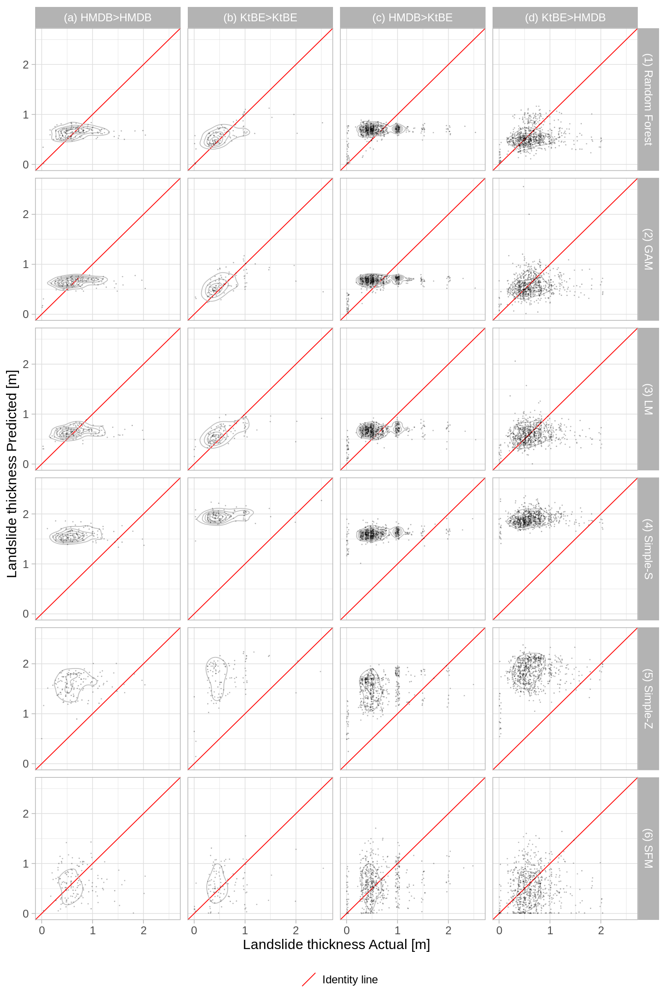

In [250]:
# df
options(repr.plot.width=12, repr.plot.height=18)

font_base_size <- 18

sc1 <- ggplot(df, aes(x=Actual, y=Prediction)) +
  # stat_density_2d(aes(fill = ..density..), geom = "raster", contour = FALSE)+
  facet_grid(Model~Dataset)+
  geom_abline(aes(intercept = 0, slope = 1, color="red")) +
  geom_density_2d(color="gray")+
  geom_jitter(width = 0.04, alpha=0.2, color="black", size=0.2) +
  xlim(0,2.6) +
  ylim(0,2.6) +
  theme_light(base_size = font_base_size) +
  scale_color_manual(name = "", values = c( "red"), labels = c("Identity line")) +
  theme(legend.position="bottom")+

  xlab("Landslide thickness Actual [m]") +
  ylab("Landslide thickness Predicted [m]") 

sc1
ggsave(filename = "fig06.png", width = 12, height = 18, device='png', dpi=300)


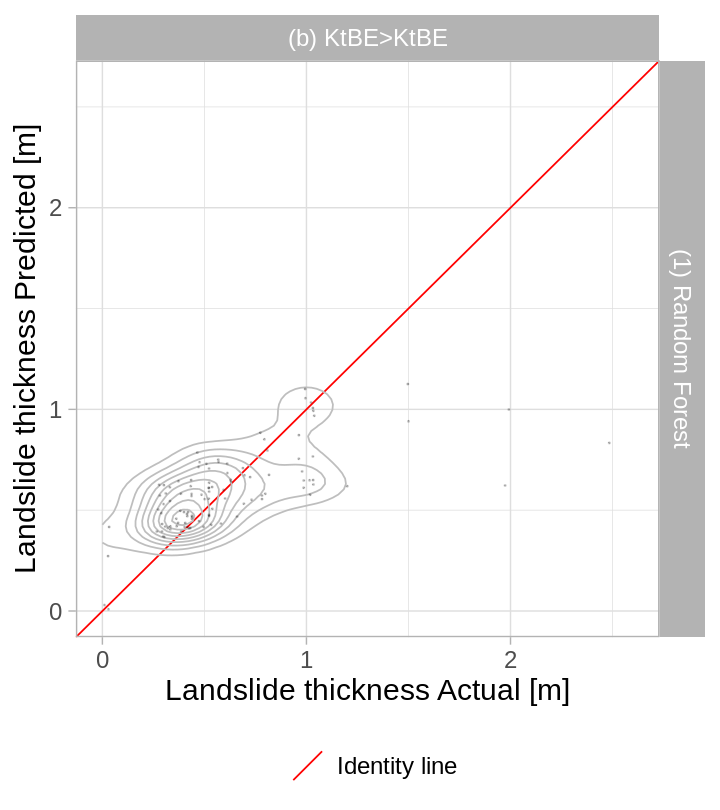

In [251]:
# df
options(repr.plot.width=6, repr.plot.height=6.75)

font_base_size <- 18

df_ga <- df[df$Model=="(1) Random Forest" & df$Dataset=="(b) KtBE>KtBE",]

sc1 <- ggplot(df_ga, aes(x=Actual, y=Prediction)) +
  # stat_density_2d(aes(fill = ..density..), geom = "raster", contour = FALSE)+
  facet_grid(Model~Dataset)+
  geom_abline(aes(intercept = 0, slope = 1, color="red")) +
  geom_density_2d(color="gray")+
  geom_jitter(width = 0.04, alpha=0.2, color="black", size=0.2) +
  xlim(0,2.6) +
  ylim(0,2.6) +
  theme_light(base_size = font_base_size) +
  scale_color_manual(name = "", values = c( "red"), labels = c("Identity line")) +
  theme(legend.position="bottom")+

  xlab("Landslide thickness Actual [m]") +
  ylab("Landslide thickness Predicted [m]") 

sc1
ggsave(filename = "fig_plot_graphical_abstract.png", width = 12, height = 18, device='png', dpi=300)


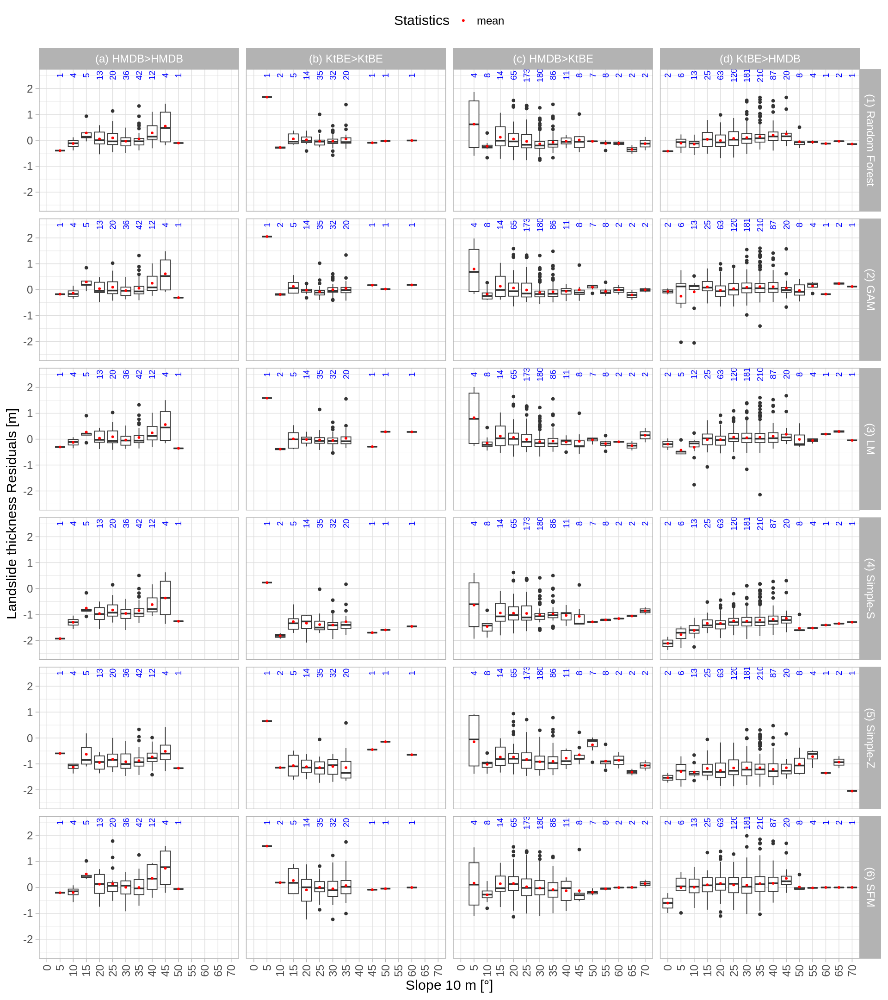

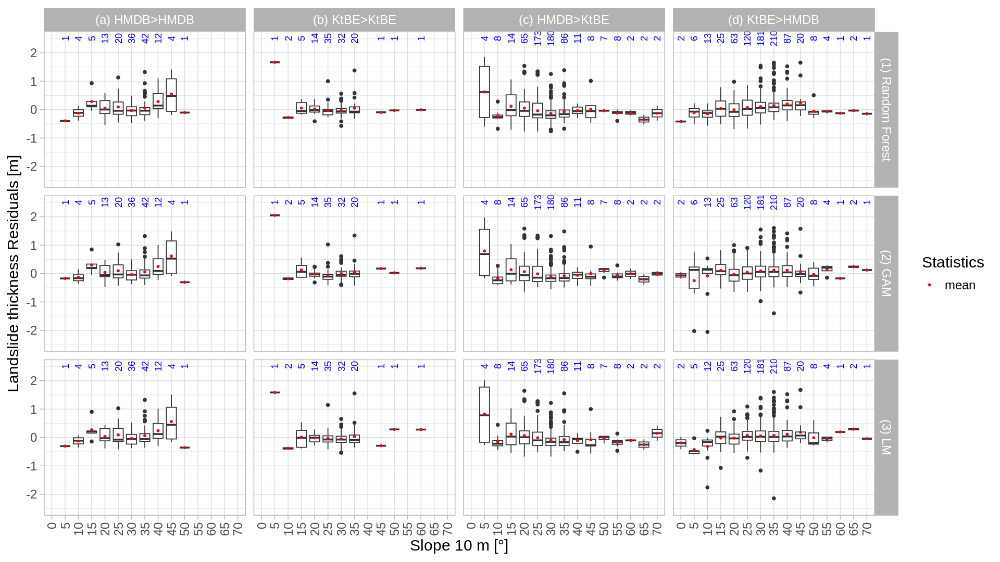

In [252]:
give.n <- function(x){
   return(c(y = 2.5, angle = 90, label = length(x)))
}

options(repr.plot.width=16, repr.plot.height=18)


p1 <- ggplot(df, aes(x=Slope_Class, y=Residual)) + 
  facet_grid(Model~Dataset)+
  geom_boxplot() +
  stat_summary(fun.y="mean",aes(color="red"), size=1, geom = 'point') +
  stat_summary(fun.data = give.n, geom = "text", color="blue")+
  theme_light(base_size = font_base_size)+
  theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1)) +
  theme(legend.position = "top")+
  ylim(-2.5,2.5) +
  scale_color_manual(name = "Statistics", values = c( "red"), labels = c("mean")) +
  xlab("Slope 10 m [°]") +
  ylab("Landslide thickness Residuals [m]")
p1
ggsave(filename = "figa01.png", width = 16, height = 18, device='png', dpi=300)

options(repr.plot.width=16, repr.plot.height=9)


p1 <- ggplot(df_reduced, aes(x=Slope_Class, y=Residual)) + 
  facet_grid(Model~Dataset)+
  geom_boxplot() +
  stat_summary(fun.y="mean",aes(color="red"), size=1, geom = 'point') +
  stat_summary(fun.data = give.n, geom = "text", color="blue")+
  theme_light(base_size = font_base_size)+
  theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1)) +
  ylim(-2.5,2.5) +
  scale_color_manual(name = "Statistics", values = c( "red"), labels = c("mean")) +
  xlab("Slope 10 m [°]") +
  ylab("Landslide thickness Residuals [m]")
p1
ggsave(filename = "fig07.png", width = 16, height = 9, device='png', dpi=300)




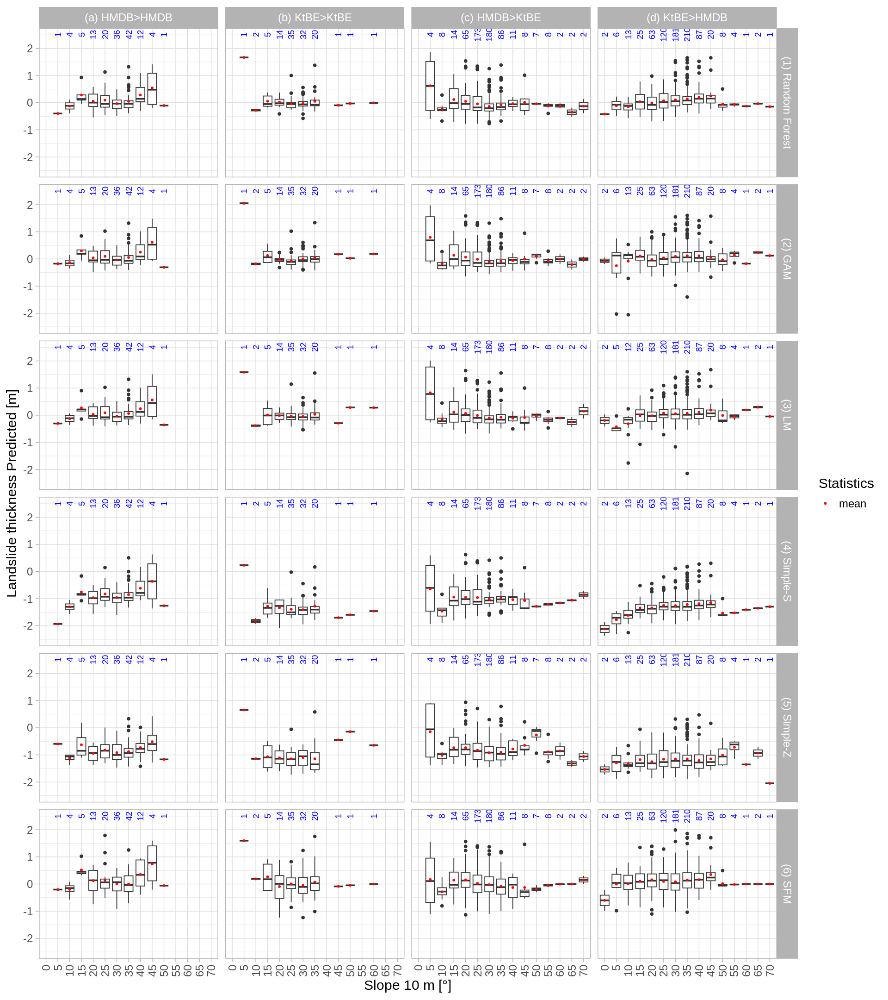

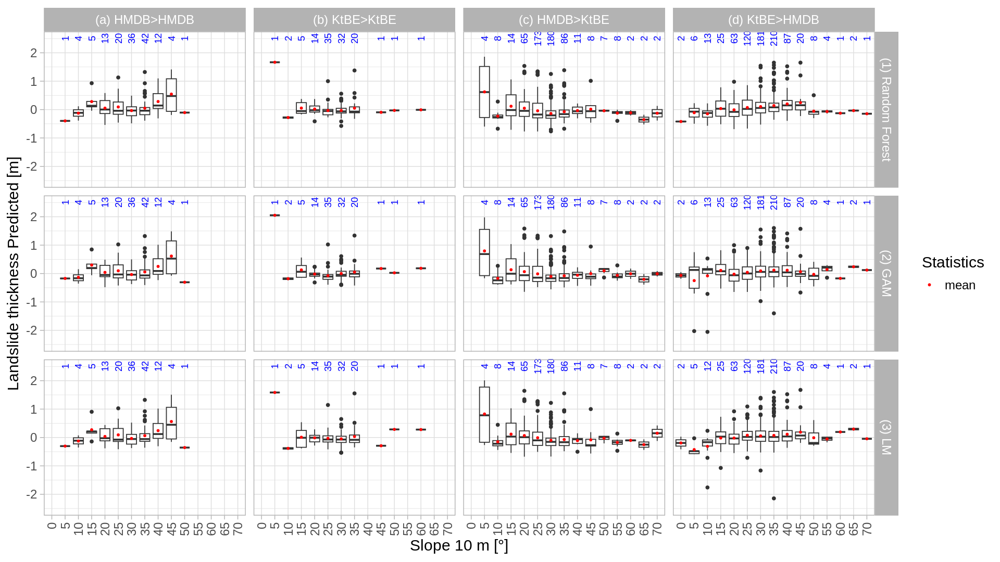

In [253]:
options(repr.plot.width=16, repr.plot.height=18)
p1 <- ggplot(df, aes(x=Slope_Class, y=Residual)) + 
  facet_grid(Model~Dataset)+
  geom_boxplot() +
  stat_summary(fun.y="mean",aes(color="red"), size=1, geom = 'point') +
  stat_summary(fun.data = give.n, geom = "text", color="blue")+
  theme_light(base_size = font_base_size)+
  theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1)) +
  ylim(-2.5,2.5) +
  scale_color_manual(name = "Statistics", values = c( "red"), labels = c("mean")) +
  xlab("Slope 10 m [°]") +
  ylab("Landslide thickness Predicted [m]")
p1
# ggsave(filename = "box_matrix_slope_predicted.png", width = 16, height = 18, device='png', dpi=300)


options(repr.plot.width=16, repr.plot.height=9)
p1 <- ggplot(df_reduced, aes(x=Slope_Class, y=Residual)) + 
  facet_grid(Model~Dataset)+
  geom_boxplot() +
  stat_summary(fun.y="mean",aes(color="red"), size=1, geom = 'point') +
  stat_summary(fun.data = give.n, geom = "text", color="blue")+
  theme_light(base_size = font_base_size)+
  theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1)) +
  ylim(-2.5,2.5) +
  scale_color_manual(name = "Statistics", values = c( "red"), labels = c("mean")) +
  xlab("Slope 10 m [°]") +
  ylab("Landslide thickness Predicted [m]")
p1
# ggsave(filename = "box_matrix_slope_predicted_reduced.png", width = 16, height = 9, device='png', dpi=300)

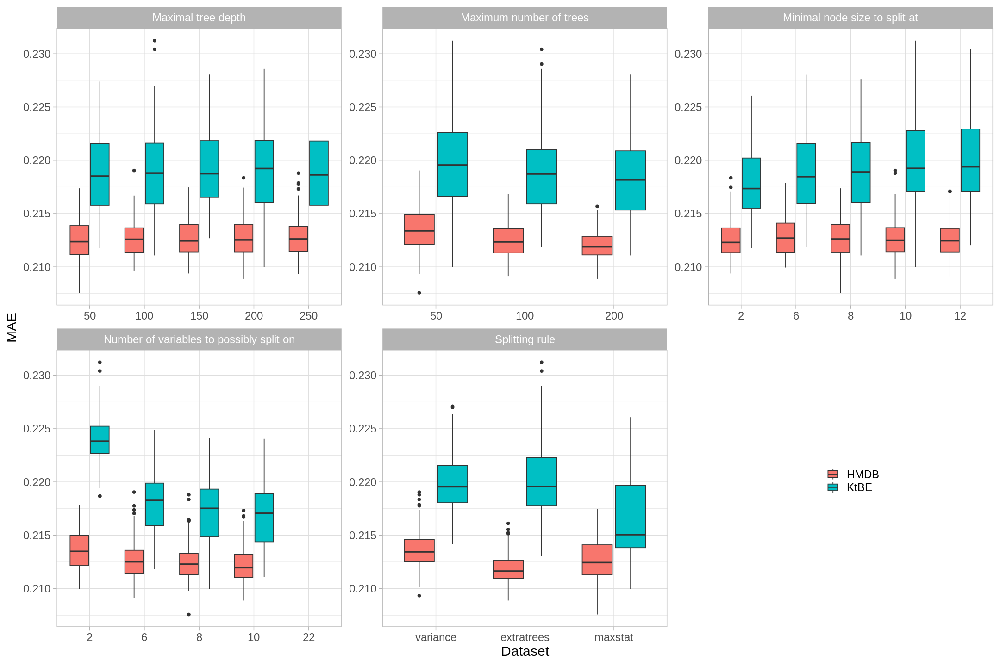

In [254]:
tune_res_hmdb <- rf_model_hmdb$results
tune_res_be <- rf_model_be$results


tune_res_df <- data.frame(MAE = tune_res_hmdb$MAE, variable = "Maximum number of trees", val = tune_res_hmdb$num.trees, dataset = "HMDB")
tune_res_df <- rbind(tune_res_df, data.frame(MAE = tune_res_hmdb$MAE, variable = "Maximal tree depth", val = tune_res_hmdb$max.depth, dataset = "HMDB"))
tune_res_df <- rbind(tune_res_df, data.frame(MAE = tune_res_hmdb$MAE, variable = "Minimal node size to split at", val = tune_res_hmdb$min.node.size, dataset = "HMDB"))
tune_res_df <- rbind(tune_res_df, data.frame(MAE = tune_res_hmdb$MAE, variable = "Number of variables to possibly split on", val = tune_res_hmdb$mtry, dataset = "HMDB"))
tune_res_df <- rbind(tune_res_df, data.frame(MAE = tune_res_hmdb$MAE, variable = "Splitting rule", val = tune_res_hmdb$splitrule, dataset = "HMDB"))

tune_res_df <- rbind(tune_res_df, data.frame(MAE = tune_res_be$MAE, variable = "Maximum number of trees", val = tune_res_be$num.trees, dataset = "KtBE"))
tune_res_df <- rbind(tune_res_df, data.frame(MAE = tune_res_be$MAE, variable = "Maximal tree depth", val = tune_res_be$max.depth, dataset = "KtBE"))
tune_res_df <- rbind(tune_res_df, data.frame(MAE = tune_res_be$MAE, variable = "Minimal node size to split at", val = tune_res_be$min.node.size, dataset = "KtBE"))
tune_res_df <- rbind(tune_res_df, data.frame(MAE = tune_res_be$MAE, variable = "Number of variables to possibly split on", val = tune_res_be$mtry, dataset = "KtBE"))
tune_res_df <- rbind(tune_res_df, data.frame(MAE = tune_res_be$MAE, variable = "Splitting rule", val = tune_res_be$splitrule, dataset = "KtBE"))

tune_res_df$val <- factor(tune_res_df$val, levels=c("2","6","8","10","12","22","50","100","150","200","250","variance","extratrees","maxstat"))


options(repr.plot.width=18, repr.plot.height=12)

ggplot(tune_res_df, aes(x=val, y=MAE, fill=dataset)) +
  geom_boxplot() +
  theme_light(base_size = font_base_size)+
  xlab("Dataset") +
  theme(legend.title = element_blank(),  legend.position=c(0.85
                                                           ,0.25))+
  facet_wrap(~variable, scales = "free")

ggsave(filename = "hyper_parameter_tuning.png", width = 18, height = 12, device='png', dpi=300)


In [255]:

df5 <- data.frame(Actual= data_test_hmdb_y, Prediction=pred_test_rf_hmdb$predictions, Residual=data_test_hmdb_y-pred_test_rf_hmdb$predictions, Slope = data_test_hmdb$Slope_DB, Slope_Class = data_test_hmdb$slope_5_class, Model = "(1) Random Forest", Dataset = "(a) HMDB>HMDB")
df5 <- rbind(df5,data.frame(Actual= data_test_be_y, Prediction=pred_test_rf_be$predictions, Residual=data_test_be_y-pred_test_rf_be$predictions, Slope = data_test_be$Slope_DB, Slope_Class = data_test_be$slope_5_class, Model = "(1) Random Forest", Dataset = "(b) KtBE>KtBE"))
df5 <- rbind(df5,data.frame(Actual= data_test_hmdb_be_y, Prediction=pred_test_rf_hmdb_be$predictions, Residual=data_test_hmdb_be_y-pred_test_rf_hmdb_be$predictions, Slope = data_test_hmdb_be$Slope_DB, Slope_Class = data_test_hmdb_be$slope_5_class, Model = "(1) Random Forest", Dataset = "(c) HMDB>KtBE"))
df5 <- rbind(df5,data.frame(Actual= data_test_be_hmdb_y, Prediction=pred_test_rf_be_hmdb$predictions, Residual=data_test_be_hmdb_y-pred_test_rf_be_hmdb$predictions, Slope = data_test_be_hmdb$Slope_DB, Slope_Class = data_test_be_hmdb$slope_5_class, Model = "(1) Random Forest", Dataset = "(d) KtBE>HMDB"))

df5 <- rbind(df5,data.frame(Actual= data_test_storme_y, Prediction=pred_test_rf_storme$predictions, Residual=data_test_storme_y-pred_test_rf_storme$predictions, Slope = data_test_storme$Slope_DB, Slope_Class = data_test_storme$slope_5_class, Model = "(1) Random Forest", Dataset = "(f) StorMe>StorMe"))
df5 <- rbind(df5,data.frame(Actual= data_test_hmdb_storme_y, Prediction=pred_test_rf_hmdb_storme$predictions, Residual=data_test_hmdb_storme_y-pred_test_rf_hmdb_storme$predictions, Slope = data_test_hmdb_storme$Slope_DB, Slope_Class = data_test_hmdb_storme$slope_5_class, Model = "(1) Random Forest", Dataset = "(g) HMDB>StorMe"))

df5 <- rbind(df5,data.frame(Actual= data_test_hmdb_y, Prediction=pred_test_gam_hmdb, Residual=data_test_hmdb_y-pred_test_gam_hmdb, Slope = data_test_hmdb$Slope_DB, Slope_Class = data_test_hmdb$slope_5_class, Model = "(2) GAM", Dataset = "(a) HMDB>HMDB"))
df5 <- rbind(df5,data.frame(Actual= data_test_be_y, Prediction=pred_test_gam_be, Residual=data_test_be_y-pred_test_gam_be, Slope = data_test_be$Slope_DB, Slope_Class = data_test_be$slope_5_class, Model = "(2) GAM", Dataset = "(b) KtBE>KtBE"))
df5 <- rbind(df5,data.frame(Actual= data_test_hmdb_be_y, Prediction=pred_test_gam_hmdb_be, Residual=data_test_hmdb_be_y-pred_test_gam_hmdb_be, Slope = data_test_hmdb_be$Slope_DB, Slope_Class = data_test_hmdb_be$slope_5_class, Model = "(2) GAM", Dataset = "(c) HMDB>KtBE"))
df5 <- rbind(df5,data.frame(Actual= data_test_be_hmdb_y, Prediction=pred_test_gam_be_hmdb, Residual=data_test_be_hmdb_y-pred_test_gam_be_hmdb, Slope = data_test_be_hmdb$Slope_DB, Slope_Class = data_test_be_hmdb$slope_5_class, Model = "(2) GAM", Dataset = "(d) KtBE>HMDB"))

df5 <- rbind(df5,data.frame(Actual= data_test_storme_y, Prediction=pred_test_gam_storme, Residual=data_test_storme_y-pred_test_gam_storme, Slope = data_test_storme$Slope_DB, Slope_Class = data_test_storme$slope_5_class, Model = "(2) GAM", Dataset = "(f) StorMe>StorMe"))
df5 <- rbind(df5,data.frame(Actual= data_test_hmdb_storme_y, Prediction=pred_test_gam_hmdb_storme, Residual=data_test_hmdb_storme_y-pred_test_gam_hmdb_storme, Slope = data_test_hmdb_storme$Slope_DB, Slope_Class = data_test_hmdb_storme$slope_5_class, Model = "(2) GAM", Dataset = "(g) HMDB>StorMe"))


df5 <- rbind(df5,data.frame(Actual= data_test_hmdb_y, Prediction=pred_test_lm_hmdb, Residual=data_test_hmdb_y-pred_test_lm_hmdb, Slope = data_test_hmdb$Slope_DB, Slope_Class = data_test_hmdb$slope_5_class, Model = "(3) LM", Dataset = "(a) HMDB>HMDB"))
df5 <- rbind(df5,data.frame(Actual= data_test_be_y, Prediction=pred_test_lm_be, Residual=data_test_be_y-pred_test_lm_be, Slope = data_test_be$Slope_DB, Slope_Class = data_test_be$slope_5_class, Model = "(3) LM", Dataset = "(b) KtBE>KtBE"))
df5 <- rbind(df5,data.frame(Actual= data_test_hmdb_be_y, Prediction=pred_test_lm_hmdb_be, Residual=data_test_hmdb_be_y-pred_test_lm_hmdb_be, Slope = data_test_hmdb_be$Slope_DB, Slope_Class = data_test_hmdb_be$slope_5_class, Model = "(3) LM", Dataset = "(c) HMDB>KtBE"))
df5 <- rbind(df5,data.frame(Actual= data_test_be_hmdb_y, Prediction=pred_test_lm_be_hmdb, Residual=data_test_be_hmdb_y-pred_test_lm_be_hmdb, Slope = data_test_be_hmdb$Slope_DB, Slope_Class = data_test_be_hmdb$slope_5_class, Model = "(3) LM", Dataset = "(d) KtBE>HMDB"))

df5 <- rbind(df5,data.frame(Actual= data_test_storme_y, Prediction=pred_test_lm_storme, Residual=data_test_storme_y-pred_test_lm_storme, Slope = data_test_storme$Slope_DB, Slope_Class = data_test_storme$slope_5_class, Model = "(3) LM", Dataset = "(f) StorMe>StorMe"))
df5 <- rbind(df5,data.frame(Actual= data_test_hmdb_storme_y, Prediction=pred_test_lm_hmdb_storme, Residual=data_test_hmdb_storme_y-pred_test_lm_hmdb_storme, Slope = data_test_hmdb_storme$Slope_DB, Slope_Class = data_test_hmdb_storme$slope_5_class, Model = "(3) LM", Dataset = "(g) HMDB>StorMe"))


df5 <- rbind(df5,data.frame(Actual= data_test_hmdb_y, Prediction=pred_test_h_s_hmdb, Residual=data_test_hmdb_y-pred_test_h_s_hmdb, Slope = data_test_hmdb$Slope_DB, Slope_Class = data_test_hmdb$slope_5_class, Model = "(4) Simple-S", Dataset = "(a) HMDB>HMDB"))
df5 <- rbind(df5,data.frame(Actual= data_test_be_y, Prediction=pred_test_h_s_be, Residual=data_test_be_y-pred_test_h_s_be, Slope = data_test_be$Slope_DB, Slope_Class = data_test_be$slope_5_class, Model = "(4) Simple-S", Dataset = "(b) KtBE>KtBE"))
df5 <- rbind(df5,data.frame(Actual= data_test_hmdb_be_y, Prediction=pred_test_h_s_hmdb_be, Residual=data_test_hmdb_be_y-pred_test_h_s_hmdb_be, Slope = data_test_hmdb_be$Slope_DB, Slope_Class = data_test_hmdb_be$slope_5_class, Model = "(4) Simple-S", Dataset = "(c) HMDB>KtBE"))
df5 <- rbind(df5,data.frame(Actual= data_test_be_hmdb_y, Prediction=pred_test_h_s_be_hmdb, Residual=data_test_be_hmdb_y-pred_test_h_s_be_hmdb, Slope = data_test_be_hmdb$Slope_DB, Slope_Class = data_test_be_hmdb$slope_5_class, Model = "(4) Simple-S", Dataset = "(d) KtBE>HMDB"))

df5 <- rbind(df5,data.frame(Actual= data_test_hmdb_y, Prediction=pred_test_h_z_hmdb, Residual=data_test_hmdb_y-pred_test_h_z_hmdb, Slope = data_test_hmdb$Slope_DB, Slope_Class = data_test_hmdb$slope_5_class, Model = "(5) Simple-Z", Dataset = "(a) HMDB>HMDB"))
df5 <- rbind(df5,data.frame(Actual= data_test_be_y, Prediction=pred_test_h_z_be, Residual=data_test_be_y-pred_test_h_z_be, Slope = data_test_be$Slope_DB, Slope_Class = data_test_be$slope_5_class, Model = "(5) Simple-Z", Dataset = "(b) KtBE>KtBE"))
df5 <- rbind(df5,data.frame(Actual= data_test_hmdb_be_y, Prediction=pred_test_h_z_hmdb_be, Residual=data_test_hmdb_be_y-pred_test_h_z_hmdb_be, Slope = data_test_hmdb_be$Slope_DB, Slope_Class = data_test_hmdb_be$slope_5_class, Model = "(5) Simple-Z", Dataset = "(c) HMDB>KtBE"))
df5 <- rbind(df5,data.frame(Actual= data_test_be_hmdb_y, Prediction=pred_test_h_z_be_hmdb, Residual=data_test_be_hmdb_y-pred_test_h_z_be_hmdb, Slope = data_test_be_hmdb$Slope_DB, Slope_Class = data_test_be_hmdb$slope_5_class, Model = "(5) Simple-Z", Dataset = "(d) KtBE>HMDB"))

df5 <- rbind(df5,data.frame(Actual= data_test_hmdb_y, Prediction=pred_test_h_sfm_hmdb, Residual=data_test_hmdb_y-pred_test_h_sfm_hmdb, Slope = data_test_hmdb$Slope_DB, Slope_Class = data_test_hmdb$slope_5_class, Model = "(6) SFM", Dataset = "(a) HMDB>HMDB"))
df5 <- rbind(df5,data.frame(Actual= data_test_be_y, Prediction=pred_test_h_sfm_be, Residual=data_test_be_y-pred_test_h_sfm_be, Slope = data_test_be$Slope_DB, Slope_Class = data_test_be$slope_5_class, Model = "(6) SFM", Dataset = "(b) KtBE>KtBE"))
df5 <- rbind(df5,data.frame(Actual= data_test_hmdb_be_y, Prediction=pred_test_h_sfm_hmdb_be, Residual=data_test_hmdb_be_y-pred_test_h_sfm_hmdb_be, Slope = data_test_hmdb_be$Slope_DB, Slope_Class = data_test_hmdb_be$slope_5_class, Model = "(6) SFM", Dataset = "(c) HMDB>KtBE"))
df5 <- rbind(df5,data.frame(Actual= data_test_be_hmdb_y, Prediction=pred_test_h_sfm_be_hmdb, Residual=data_test_be_hmdb_y-pred_test_h_sfm_be_hmdb, Slope = data_test_be_hmdb$Slope_DB, Slope_Class = data_test_be_hmdb$slope_5_class, Model = "(6) SFM", Dataset = "(d) KtBE>HMDB"))

df5$Dataset_model <- apply(df5[,c("Model","Dataset")],1,function(x) paste(x[[1]],x[[2]]))
                          
df5_original <- df5
                          
df5 <- df5[!(df5$Dataset %in% c("(f) StorMe>StorMe","(g) HMDB>StorMe")),]

df5_reduced <- df5[df5$Model %in% c("(1) Random Forest","(2) GAM","(3) LM"),]



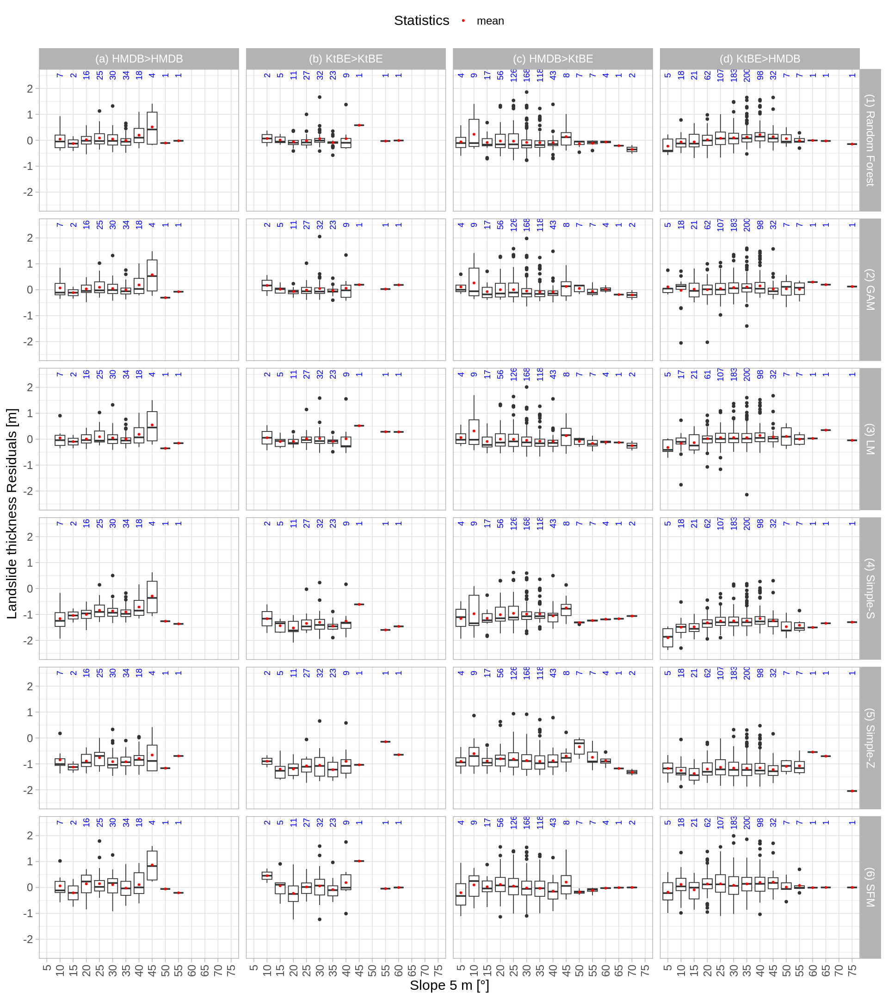

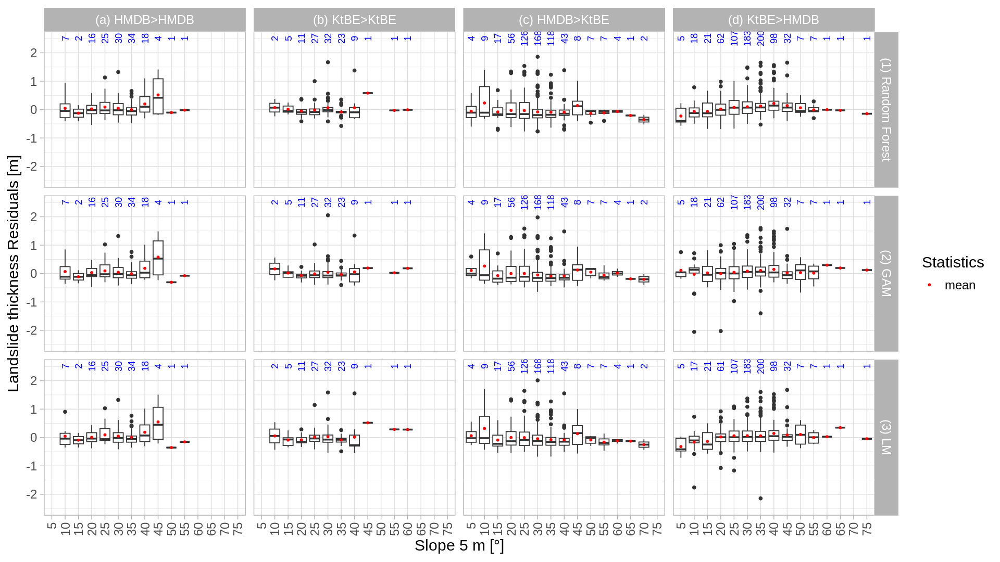

In [256]:
give.n <- function(x){
   return(c(y = 2.5, angle = 90, label = length(x)))
}

options(repr.plot.width=16, repr.plot.height=18)


p1 <- ggplot(df5, aes(x=Slope_Class, y=Residual)) + 
  facet_grid(Model~Dataset)+
  geom_boxplot() +
  stat_summary(fun.y="mean",aes(color="red"), size=1, geom = 'point') +
  stat_summary(fun.data = give.n, geom = "text", color="blue")+
  theme_light(base_size = font_base_size)+
  theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1)) +
  theme(legend.position = "top")+
  ylim(-2.5,2.5) +
  scale_color_manual(name = "Statistics", values = c( "red"), labels = c("mean")) +
  xlab("Slope 5 m [°]") +
  ylab("Landslide thickness Residuals [m]")
p1
ggsave(filename = "figa01b.png", width = 16, height = 18, device='png', dpi=300)

options(repr.plot.width=16, repr.plot.height=9)


p1 <- ggplot(df5_reduced, aes(x=Slope_Class, y=Residual)) + 
  facet_grid(Model~Dataset)+
  geom_boxplot() +
  stat_summary(fun.y="mean",aes(color="red"), size=1, geom = 'point') +
  scale_color_manual(name = "Statistics", values = c( "red"), labels = c("mean")) +
  stat_summary(fun.data = give.n, geom = "text", color="blue")+
  theme_light(base_size = font_base_size)+
  theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1)) +
  ylim(-2.5,2.5) +
  xlab("Slope 5 m [°]") +
  ylab("Landslide thickness Residuals [m]")
p1
ggsave(filename = "fig07b.png", width = 16, height = 9, device='png', dpi=300)


